In [ ]:
# Cranfiel
import gdown
!gdown 1D48c_crSg6ia_OqZ5HoJmVmDLgn-iqq5
!gdown 1g0JYIiu-l6dSo5BpOuAeem2rVCkxNHjE

Downloading...
From: https://drive.google.com/uc?id=1D48c_crSg6ia_OqZ5HoJmVmDLgn-iqq5
To: /content/Cranfield.zip
100% 851k/851k [00:00<00:00, 36.7MB/s]
Downloading...
From: https://drive.google.com/uc?id=1g0JYIiu-l6dSo5BpOuAeem2rVCkxNHjE
To: /content/TEST.zip
100% 49.9k/49.9k [00:00<00:00, 160MB/s]


In [ ]:
# Mô hình vector + Latent Semantic Index (LSI)

# Import cell

In [ ]:
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

import string
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
import re
import numpy as np
import math

import string

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


# Cranfield - Reading data

In [ ]:
!unzip 'Cranfield.zip'

Archive:  Cranfield.zip
   creating: Cranfield/
  inflating: Cranfield/1.txt         
  inflating: Cranfield/10.txt        
  inflating: Cranfield/100.txt       
  inflating: Cranfield/1000.txt      
  inflating: Cranfield/1001.txt      
  inflating: Cranfield/1002.txt      
  inflating: Cranfield/1003.txt      
  inflating: Cranfield/1004.txt      
  inflating: Cranfield/1005.txt      
  inflating: Cranfield/1006.txt      
  inflating: Cranfield/1007.txt      
  inflating: Cranfield/1008.txt      
  inflating: Cranfield/1009.txt      
  inflating: Cranfield/101.txt       
  inflating: Cranfield/1010.txt      
  inflating: Cranfield/1011.txt      
  inflating: Cranfield/1012.txt      
  inflating: Cranfield/1013.txt      
  inflating: Cranfield/1014.txt      
  inflating: Cranfield/1015.txt      
  inflating: Cranfield/1016.txt      
  inflating: Cranfield/1017.txt      
  inflating: Cranfield/1018.txt      
  inflating: Cranfield/1019.txt      
  inflating: Cranfield/102.txt       
  

In [ ]:
!unzip 'TEST.zip'

Archive:  TEST.zip
  inflating: query.txt               
   creating: RES/
  inflating: RES/1.txt               
  inflating: RES/10.txt              
  inflating: RES/100.txt             
  inflating: RES/101.txt             
  inflating: RES/102.txt             
 extracting: RES/103.txt             
  inflating: RES/104.txt             
  inflating: RES/105.txt             
  inflating: RES/106.txt             
  inflating: RES/107.txt             
  inflating: RES/108.txt             
  inflating: RES/109.txt             
  inflating: RES/11.txt              
  inflating: RES/110.txt             
  inflating: RES/111.txt             
 extracting: RES/112.txt             
  inflating: RES/113.txt             
  inflating: RES/114.txt             
  inflating: RES/115.txt             
  inflating: RES/116.txt             
 extracting: RES/117.txt             
  inflating: RES/118.txt             
 extracting: RES/119.txt             
  inflating: RES/12.txt              
  inflating: 

In [ ]:
# Reading the Cranfield's documents
import os

directory = '/content/Cranfield'  # Update with the path to your text files
file_extension = '.txt'  # Update with the file extension of your text files

text_files = [file for file in os.listdir(directory) if file.endswith(file_extension)]

CranfieldDocs = {}

for file_name in text_files:
    file_path = os.path.join(directory, file_name)
    with open(file_path, 'r') as file:
        contents = file.read()
        key = int(os.path.splitext(file_name)[0])  # Remove the file extension from the key
        CranfieldDocs[key] = contents

# Now you have the contents of each text file stored in the 'data_dict' dictionary

CranfieldDocs = dict(sorted(CranfieldDocs.items()))

In [ ]:
# Loading the queries of Cranfield
def load_queries(file_path):
    queries = {}
    with open(file_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            key, value = line.strip().split('\t')
            queries[int(key)] = value
    return queries

CranfieldQueries = load_queries('/content/query.txt')
CranfieldQueries

{1: 'what similarity laws must be obeyed when constructing aeroelastic models of heated high speed aircraft .',
 2: 'what are the structural and aeroelastic problems associated with flight of high speed aircraft .',
 3: 'what problems of heat conduction in composite slabs have been solved so far .',
 4: 'can a criterion be developed to show empirically the validity of flow solutions for chemically reacting gas mixtures based on the simplifying assumption of instantaneous local chemical equilibrium .',
 5: 'what chemical kinetic system is applicable to hypersonic aerodynamic problems .',
 6: 'what theoretical and experimental guides do we have as to turbulent couette flow behaviour .',
 7: 'is it possible to relate the available pressure distributions for an ogive forebody at zero angle of attack to the lower surface pressures of an equivalent ogive forebody at angle of attack .',
 8: 'what methods -dash exact or approximate -dash are presently available for predicting body pressures at

In [ ]:
## Loading the 'Gold' result
import os

folder_path = '/content/RES'
CranfieldTrue = {}

for file_name in os.listdir(folder_path):
    if file_name.endswith('.txt'):
        file_path = os.path.join(folder_path, file_name)
        with open(file_path, 'r') as file:
            lines = file.readlines()
            second_column = [int(line.split()[1]) for line in lines]
            key = int(file_name[:-4])  # Remove the '.txt' extension and convert to int
            CranfieldTrue[key] = second_column

CranfieldTrue = dict(sorted(CranfieldTrue.items()))

# Main Functions

## Porter Stemmer

In [ ]:
def preprocessPorterStemmerOnly(docs):
    # docs is a dict {id: doc}
    porter_stemmer = PorterStemmer()
    terms = set()
    modified_docs = {}

    for i, doc in enumerate(docs):
        modified_doc = docs[doc].lower()
        modified_doc = re.sub(r'[^a-z0-9\s]', '', modified_doc)
        # use nltk to tokenize and filter the punctuation
        words = word_tokenize(modified_doc)
        sentence = ""
        for word in words:
            if word.isdigit() or word.isnumeric():
                continue
            if not word.isalnum():
                continue
            word = porter_stemmer.stem(word)
            terms.add(word)
            sentence += " " + word
        modified_docs[doc] = sentence

    return modified_docs, terms

In [ ]:
# Porter Stemmer version of the Preprocess
def preprocessPorterStemmer(docs):
    # docs is a dict {id: doc}
    porter_stemmer = PorterStemmer()
    stop_words = set(stopwords.words('english'))
    terms = set()
    modified_docs = {}

    for i, doc in enumerate(docs):
        modified_doc = docs[doc].lower()
        modified_doc = re.sub(r'[^a-z0-9\s]', '', modified_doc)
        # use nltk to tokenize and filter the punctuation
        words = word_tokenize(modified_doc)
        sentence = ""
        for word in words:
            if word not in string.punctuation and word not in stop_words:
                if word.isdigit() or word.isnumeric():
                    continue
                if not word.isalnum():
                    continue
                word = porter_stemmer.stem(word)
                terms.add(word)
                sentence += " " + word
        modified_docs[doc] = sentence

    return modified_docs, terms

# docs, terms = preprocessPorterStemmer(CranfieldDocs)

## Lemmatizer

In [ ]:
def preprocessLematizerOnly(docs):
    # docs is a dict {id: doc}
    lemmatizer = WordNetLemmatizer()
    terms = set()
    modified_docs = {}

    for i, doc in enumerate(docs):
        modified_doc = docs[doc].lower()
        modified_doc = re.sub(r'[^a-z0-9\s]', '', modified_doc)
        # use nltk to tokenize and filter the punctuation
        words = word_tokenize(modified_doc)
        sentence = ""
        for word in words:
            if word.isdigit() or word.isnumeric():
                continue
            if not word.isalnum():
                continue
            word = lemmatizer.lemmatize(word)
            terms.add(word)
            sentence += " " + word
        modified_docs[doc] = sentence

    return modified_docs, terms


In [ ]:
def preprocessLematizer(docs):
    # docs is a dict {id: doc}
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))
    terms = set()
    modified_docs = {}

    for i, doc in enumerate(docs):
        modified_doc = docs[doc].lower()
        modified_doc = re.sub(r'[^a-z0-9\s]', '', modified_doc)
        # use nltk to tokenize and filter the punctuation
        words = word_tokenize(modified_doc)
        sentence = ""
        for word in words:
            if word not in string.punctuation and word not in stop_words:
                if word.isdigit() or word.isnumeric():
                    continue
                if not word.isalnum():
                    continue
                word = lemmatizer.lemmatize(word)
                terms.add(word)
                sentence += " " + word
        modified_docs[doc] = sentence

    return modified_docs, terms


## Indexing

In [ ]:
def indexing(docs, terms):
    # docs is a dict which {id: doc}
    # terms is the set word not include punctuation
    # indexs is a dict {'word': set of doc_id}
    # order_term is a dict {'word': order in term}

    inverted_index = {}
    for doc_id, doc in docs.items():
        words = re.findall(r'\b\w+\b', doc)
        words = [word for word in words if word in terms]
        for word in words:
            if word in inverted_index:
                inverted_index[word].add(doc_id)
            else:
                inverted_index[word] = {doc_id}

    order_term = {}
    inverse_order_term = {}
    for i, word in enumerate(terms):
        order_term[word] = i
        inverse_order_term[i] = word
    return inverted_index, order_term, inverse_order_term
# indexs, order_term, inverse_order_term = indexing(docs, terms)

## Max ID

In [ ]:
def find_max_id(docs):
    max_id = 0
    for doc in docs:
        max_id = max(max_id, doc)
    return max_id

# max_id = find_max_id(docs)
# print(f'The max of doc_id: {max_id}')


## Build Binary Matrix

In [ ]:
def build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id):
    # docs is a dict which {id: doc}
    # terms is the set word not include punctuation
    # indexs is a dict {'word': set of doc_id}
    # order_term is a dict {'word': order in term}
    # inverse_order_term is a dict {order in term: 'word'}

    num_docs  = max_id
    num_terms = len(terms)
    binary_matrix = np.zeros((num_terms, num_docs), dtype=int)
    for doc_id, doc in docs.items():
        for term in doc.split():
            if term in terms:
                term_index = order_term[term]
                binary_matrix[term_index, doc_id - 1] = 1
    return binary_matrix

## Build Frequency Matrix

In [ ]:
def build_frequency_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id):
    num_docs  = max_id
    num_terms = len(terms)
    frequency_matrix = np.zeros((num_terms, num_docs), dtype=int)
    # print(frequency_matrix)
    for doc_id, doc in docs.items():
        for term in doc.split():
            if term in terms:
                term_index = order_term[term]
                frequency_matrix[term_index, doc_id - 1] += 1
    return frequency_matrix

## Build TF-IDF Matrix

In [ ]:
def build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id):
    num_docs    = max_id
    num_terms = len(terms)
    tf_idf_matrix  = np.zeros((num_terms, num_docs), dtype=float)
    frequency_matrix = build_frequency_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)
    for doc_id in range(1, num_docs + 1):
        for term_index in range(num_terms):
            term = inverse_order_term[term_index]
            if term in indexs:
                term_idf = len(indexs[term])
                tfik = frequency_matrix[term_index, doc_id - 1]
                idf = math.log10(num_docs / (1 + term_idf))
                tf_idf_matrix[term_index, doc_id - 1] = tfik * idf

    return tf_idf_matrix
# mt = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

In [ ]:

def build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id):
    num_docs = max_id
    num_terms = len(terms)
    tf_idf_matrix = np.zeros((num_terms, num_docs), dtype=float)
    binary_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

    for doc_id in range(1, num_docs + 1):
        for term_index in range(num_terms):
            term = inverse_order_term[term_index]
            if term in indexs:
                term_idf = len(indexs[term])
                tfik = binary_matrix[term_index, doc_id - 1]
                rel_docs = np.sum(binary_matrix[term_index])
                idf = np.log(num_docs / rel_docs)
                tf_idf_matrix[term_index, doc_id - 1] = tfik * idf

    for doc_id in range(num_docs):
        doc_vector = tf_idf_matrix[:, doc_id - 1]
        sum_w = np.sum(doc_vector ** 2)
        if sum_w != 0:
            tf_idf_matrix[:, doc_id - 1] /= sum_w

    return tf_idf_matrix
# build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

## Preprocess Query

In [ ]:
def preprocess_query(query, indexs):
    # Preprocess the query and transform it into a numerical vector
    query_terms = query.split()
    preprocessed_query = np.zeros(len(indexs))
    for term in query_terms:
        if term in indexs:
            term_indices = indexs[term]
            for term_index in term_indices:
                preprocessed_query[term_index] += 1
    return preprocessed_query

In [ ]:
def apply_stemming_or_lemmatization(sentence, remove_stopwords=False, use_stemmer=True, use_lemmatizer=False):
    if use_stemmer:
        stemmer = PorterStemmer()
    elif use_lemmatizer:
        lemmatizer = WordNetLemmatizer()

    stop_words = set(stopwords.words('english'))
    words = word_tokenize(sentence)

    if remove_stopwords:
        words = [word for word in words if word.lower() not in stop_words]

    if use_stemmer:
        stemmed_words = [stemmer.stem(word) for word in words]
        filtered_sentence = " ".join(stemmed_words)
    elif use_lemmatizer:
        lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
        filtered_sentence = " ".join(lemmatized_words)
    else:
        filtered_sentence = " ".join(words)

    return filtered_sentence

## Calculate Similarity/LSI Model

In [ ]:
## Base Code - No remove stopwords, no Stem - Base Code from Đạt

def calculate_similarity_NoProcess(docs, indexs, order_term, inverse_order_term, query, s, z, ut, n_top = 4):
    # docs is a dict which {id: doc}
    # indexs is a dict which {word: set of id_doc}
    # max_id is the bigger id
    # query is a sentence

    words = re.findall(r'\b\w+\b', query)
    words = [word for word in words if word in terms]
    len_query = len(words)

    query = ""
    for word in words:
        query = query + " " + word

    # max_id = find_max_id(docs)
    # frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

   # calculate svd with the matrix
    # s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

    # truncate the s
    s = np.array(s)[:, :len_query]
    # truncate the z
    z = np.diag(z)[:len_query, :len_query]
    # truncate the ut
    ut = np.array(ut)[:len_query, :]

    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # get the vector of query
    order = [order_term[word] for word in words]
    query_arr = k[order]
    query_arr = np.sum(query_arr, axis=0)

    # caluculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    # results = np.nan_to_num(results, nan=0)
    # results = np.nan_to_num(results, nan=-np.inf)
    return results

In [ ]:
## Porter Stemming only - Keeping stopwords

def calculate_similarity_PorterStemmerOnly(docs, indexs, order_term, inverse_order_term, words, s, z, ut, n_top=4):
    # # Initialize PorterStemmer
    # porter_stemmer = PorterStemmer()

    # # Apply Porter stemming to the query words
    # words = re.findall(r'\b\w+\b', query)
    # words = [porter_stemmer.stem(word) for word in words if word in terms]
    len_query = len(words)

    query = ""
    for word in words:
        query = query + " " + word

    # truncate the s
    s = np.array(s)[:, :len_query]
    # truncate the z
    z = np.diag(z)[:len_query, :len_query]
    # truncate the ut
    ut = np.array(ut)[:len_query, :]
    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)
    # get the vector of query
    order = [order_term[word] for word in words if word in order_term]
    query_arr = k[order]


    query_arr = np.sum(query_arr, axis=0)
    # caluculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)
    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    return results

In [ ]:
## Currently working code for Porter Stemmer and Remove Stopwords

def calculate_similarityPSRemoveStop(docs, indexs, order_term, inverse_order_term, query, s, z, ut, n_top=4):
    # docs is a dict which {id: doc}
    # indexs is a dict which {word: set of id_doc}
    # max_id is the bigger id
    # query is a sentence

    # Initialize Porter stemmer and stopwords
    stemmer = PorterStemmer()
    stop_words = set(stopwords.words('english'))

    # Preprocess the query
    words = re.findall(r'\b\w+\b', query)
    words = [word for word in words if word in terms]
    words = [stemmer.stem(word) for word in words if word not in stop_words]
    len_query = len(words)
    query = ""
    for word in words:
        query = query + " " + word

    # max_id = find_max_id(docs)
    # frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

    # calculate svd with the matrix
    # s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

    # truncate the s
    s = np.array(s)[:, :len_query]
    # truncate the z
    z = np.diag(z)[:len_query, :len_query]
    # truncate the ut
    ut = np.array(ut)[:len_query, :]

    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # get the vector of query
    order = [order_term[word] for word in words if word in order_term]
    query_arr = k[order]
    query_arr = np.sum(query_arr, axis=0)

    # calculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    # results = np.nan_to_num(results, nan=0)
    # results = np.nan_to_num(results, nan=-np.inf)
    return results

In [ ]:
# Lemmatizer Only - Keeping Stopwords

def calculate_similarity_LemmatizeOnly(docs, indexs, order_term, inverse_order_term, query, s, z, ut, n_top=4):
    # Initialize WordNetLemmatizer
    lemmatizer = WordNetLemmatizer()

    # Lemmatize the query words
    words = re.findall(r'\b\w+\b', query)
    words = [lemmatizer.lemmatize(word) for word in words if word in terms]
    len_query = len(words)

    query = ""
    for word in words:
        query = query + " " + word

    # truncate the s
    s = np.array(s)[:, :len_query]
    # truncate the z
    z = np.diag(z)[:len_query, :len_query]
    # truncate the ut
    ut = np.array(ut)[:len_query, :]

    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # get the vector of query
    order = [order_term[word] for word in words if word in order_term]
    query_arr = k[order]
    query_arr = np.sum(query_arr, axis=0)

    # caluculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    return results

In [ ]:
# Lemmatizing and Removing Stopwords

def calculate_similarity_Lemmatize_Stopwords(docs, indexs, order_term, inverse_order_term, query, s, z, ut, n_top=4):
    # Initialize WordNetLemmatizer
    lemmatizer = WordNetLemmatizer()

    # Get the list of stopwords
    stop_words = set(stopwords.words('english'))

    # Lemmatize and remove stopwords from the query
    words = re.findall(r'\b\w+\b', query)
    words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words and word in terms]
    len_query = len(words)

    query = ""
    for word in words:
        query = query + " " + word

    # truncate the s
    s = np.array(s)[:, :len_query]
    # truncate the z
    z = np.diag(z)[:len_query, :len_query]
    # truncate the ut
    ut = np.array(ut)[:len_query, :]

    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # get the vector of query
    order = [order_term[word] for word in words]
    query_arr = k[order]
    query_arr = np.sum(query_arr, axis=0)

    # caluculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    return results

In [ ]:
def calculate_similarityPSRemoveStopUpgrade(docs, indexs, order_term, inverse_order_term, query, s, z, ut, n_top=4):
    # Initialize Porter stemmer and stopwords
    stemmer = PorterStemmer()
    stop_words = set(stopwords.words('english'))

    # Precompile the regular expression pattern
    word_pattern = re.compile(r'\b\w+\b')

    # Preprocess the query
    words = word_pattern.findall(query)
    words = [stemmer.stem(word) for word in words if word in terms and word not in stop_words]
    len_query = len(words)
    query = " ".join(words)

    # max_id = find_max_id(docs)
    # frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

    # Calculate SVD with the matrix
    # s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

    # Truncate the matrices
    s = s[:, :len_query]
    z = np.diag(z[:len_query])
    ut = ut[:len_query, :]

    k = s @ z
    d = z @ ut

    # Calculate Euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # Get the vector of query
    order = [order_term[word] for word in words if word in order_term]
    query_arr = k[order].sum(axis=0)

    # Calculate Euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # Calculate the cosine similarity using matrix multiplication and element-wise operations
    results = (query_arr @ d) / (docs_ec * query_ec)
    # results = np.abs(results)

    return results

## Calculate MAP/AP of the query

In [ ]:
def precision(y_true, y_pred):
  prec_list = []
  rec_list = []
  count = 0
  for i in range(len(y_pred)):
    if y_pred[i] in y_true:
      count += 1
      prec_list.append(count/(i+1))
      rec_list.append(count/len(y_true))
  return prec_list, rec_list
# list prec nội suy nè
def prec_in(prec_list, rec_list):
  prec_list_in = []
  for i in range(11):
    rec = i/10
    # prec_rec = max(rec->all)
    # lấy max từ prec_rec_in
    prec_rec_in = next((x[0] for x in enumerate(rec_list) if x[1] >= rec),-1)
    # print('rec_in:', prec_rec_in)
    prec_rec = 0
    if prec_rec_in != -1:
      prec_rec = max(prec_list[prec_rec_in:])
    prec_list_in.append(prec_rec)
  return prec_list_in

In [ ]:
def MAP(list_y_true, list_y_pred, noisuy=True):
    common_keys = set(list_y_true.keys()).intersection(set(list_y_pred.keys()))
    result_dict = {}

    if noisuy:
        prec_in_data = {}
        for key in common_keys:
            prec_list, rec_list = precision(list_y_true[key], list_y_pred[key])
            prec_in_list = prec_in(prec_list, rec_list)
            # print('prec_list', prec_list)
            # print('rec_list', rec_list)
            # print('prec_list_in', prec_in_list)
            result_dict[key] = sum(prec_in_list) / len(prec_in_list)
            prec_in_data[key] = prec_in_list
        return prec_in_data, result_dict, sum(result_dict.values()) / len(result_dict.values())
    else:
        for key in common_keys:
            prec_list, rec_list = precision(list_y_true[key], list_y_pred[key])
            if len(prec_list) != 0:
                result_dict[key] = sum(prec_list) / len(prec_list)
            else:
                result_dict[key] = 0

    return result_dict, sum(result_dict.values()) / len(result_dict.values())

In [ ]:
def count_P_R(list_y_true, list_y_pred):
  common_keys = set(list_y_true.keys()).intersection(set(list_y_pred.keys()))
  result_P_dict = {}
  result_R_dict = {}
  for key in common_keys:
      count = 0
      for i in range(len(list_y_pred[key])):
        if list_y_pred[key][i] in list_y_true[key]:
          count += 1
      if len(list_y_pred[key])!=0:
        result_P_dict[key] = count / len(list_y_pred[key])
      else:
        result_P_dict[key] = 0
      result_R_dict[key] = count / len(list_y_true[key])
  return result_P_dict, result_R_dict, sum(result_P_dict.values()) / len(result_P_dict.values()), sum(result_R_dict.values()) / len(result_R_dict.values())

In [ ]:
def trec_11(prec_in_data):
  trec_11 = {}
  for i in range(11):
    trec_11[i/10] = 0
    for j in prec_in_data:
      trec_11[i/10]+=prec_in_data[j][i]/len(prec_in_data)
  return trec_11

# TF-IDF Best Combination from Vector Space (Binary, Inverse, Cosine)

## Running Cranfield Base - Keep stopwords, No Stemming

In [ ]:
def preprocess(docs):
    # docs is a dict {id: doc}
    terms = set()
    modified_docs = {}

    for i, doc in enumerate(docs):
        modified_doc = docs[doc].lower()
        modified_doc = re.sub(r'[^a-z0-9\s]', '', modified_doc)
        # use nltk to tokenize and filter the punctuation
        words = word_tokenize(modified_doc)
        sentence = ""
        for word in words:
            if word not in string.punctuation:
                terms.add(word)
                sentence += " " + word
        modified_docs[doc] = sentence

    return modified_docs, terms


In [ ]:
import time

start_time = time.time()
docs, terms = preprocess(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeBaseIndex_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeBaseIndex_TFIDFBest)

Total execution time: 122.68326449394226


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')

number of word in terms: 7908
number of word in indexs: 7908
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (7908, 1400)


In [ ]:
from tqdm import tqdm

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_NoProcess(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeBaseQuery_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeBaseQuery_TFIDFBest)

APTrecList_Base_TFIDFBest, APList_Base_TFIDFBest, MAP_Base_TFIDFBest = MAP(CranfieldTrue, retrievalResult)
APList_Base_TFIDFBest_NoInter, MAP_Base_TFIDFBest_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p1, l_r1, p1, r1 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Base_TFIDFBest)
print(MAP_Base_TFIDFBest_NoInter)
print(p1, r1)


Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-21-5f1ed83c0395>:45: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:20<00:00, 10.79it/s]


Total execution time: 20.865894079208374


0.06573109739743765
0.05729513146269029
0.005831746031746031 1.0


## Running Cranfield Porter Stem + Remove Stopwords


In [ ]:
start_time = time.time()

docs, terms = preprocessPorterStemmer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

total_timePSStopIndex_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timePSStopIndex_TFIDFBest)

Total execution time: 69.36653900146484


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4556
number of word in indexs: 4556
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4556, 1400)


In [ ]:
from tqdm import tqdm

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarityPSRemoveStop(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timePSStopQuery_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timePSStopQuery_TFIDFBest)

APTrecList_PorStemRemoveStop_TDIDFBest, APList_PorStemRemoveStop_TDIDFBest, MAP_PorStemRemoveStop_TDIDFBest = MAP(CranfieldTrue, retrievalResult)
APList_PorStemRemoveStop_TDIDFBest_NoInter, MAP_PorStemRemoveStop_TDIDFBest_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p2, l_r2, p2, r2 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStemRemoveStop_TDIDFBest)
print(MAP_PorStemRemoveStop_TDIDFBest_NoInter)
print(p2, r2)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-23-74b0e13f5263>:56: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   2%|▏         | 4/225 [00:00<00:07, 31.12it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['must', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flight', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'far']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'show', 'flow', 'local', 'equilibrium']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['system']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'behaviour']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['zero', 'attack', 'lower', 'attack']


Processing Queries:   5%|▌         | 12/225 [00:00<00:06, 33.69it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dash', 'exact', 'dash', 'attack']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slip', 'flow', 'heat', 'transfer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['real', 'transport', 'air', 'wide']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'similar', 'strong', 'blast', 'wave', 'problem', 'newtonian']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['channel', 'flow', 'ground', 'effect']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic', 'aileron', 'buzz']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shock', 'sound', 'wave']


Processing Queries:   9%|▉         | 20/225 [00:00<00:05, 34.45it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'problem', 'flow', 'two', 'problem']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'good', 'basic', 'treatment']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['current', 'free']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fail', 'high', 'speed', 'data', 'helium', 'air']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['discov', 'skin', 'friction']


Processing Queries:  12%|█▏        | 28/225 [00:00<00:05, 35.55it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['progress', 'made', 'research']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'invert']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'follow', 'blade']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['formula', 'laminar', 'layer', 'flow', 'flat', 'plate']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'ring', 'part', 'ring', 'linear']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['linear', 'design']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cross', 'shape', 'flow', 'delta', 'sharp']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'slender']


Processing Queries:  14%|█▍        | 32/225 [00:00<00:05, 34.52it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['size', 'end', 'plate', 'two', 'flow', 'bluff', 'aspect', 'ratio']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'slender', 'thin', 'wing']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'made', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wave']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'wall']


Processing Queries:  16%|█▌        | 36/225 [00:01<00:05, 32.99it/s]

(4556, 3)
(3, 3)
(3, 1400)


Processing Queries:  18%|█▊        | 40/225 [00:01<00:05, 33.03it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['base']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wake', 'depend', 'size']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['model', 'vortex', 'wake', 'behind', 'cruciform', 'wing']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'flow', 'around', 'airfoil', 'round', 'flow']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'around', 'smooth', 'thin', 'airfoil', 'way']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['chapman', 'enskog']


Processing Queries:  21%|██▏       | 48/225 [00:01<00:05, 35.33it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'mass', 'transfer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'heat', 'mass', 'transfer', 'flow']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flat', 'plate']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'point', 'problem', 'without']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'slender']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'continuum', 'flow', 'effect']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'slight', 'layer', 'slip', 'effect']


Processing Queries:  25%|██▍       | 56/225 [00:01<00:04, 35.65it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'flow', 'field', 'field']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'downstream', 'mass', 'transfer', 'region', 'mass', 'transfer', 'nose', 'cone']
(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent', 'state', 'data', 'predict', 'flutter']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'flow', 'affect', 'flutter']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'non', 'circular', 'cross', 'section', 'fluid', 'flow', 'along']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['much', 'known', 'layer', 'along', 'non', 'circular']


Processing Queries:  28%|██▊       | 64/225 [00:01<00:04, 33.65it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'problem', 'e', 'problem', 'three', 'point']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'form', 'local', 'heat', 'transfer', 'around', 'cylind']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'around', 'cylind', 'flow', 'layer', 'linear', 'function', 'around', 'cylind']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'data', 'swept']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['static', 'flutter', 'place']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'flat', 'plate', 'shear', 'flow', 'gradient']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['inner', 'outer', 'flow', 'problem', 'main', 'stream', 'shear', 'flow']


Processing Queries:  30%|███       | 68/225 [00:02<00:04, 32.48it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['found', 'layer', 'flat', 'plate', 'shear', 'flow']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'exact', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['done', 'low', 'number', 'high', 'mach']


Processing Queries:  32%|███▏      | 72/225 [00:02<00:04, 32.56it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['role', 'effect', 'reaction', 'equilibrium', 'play', 'slender']


Processing Queries:  34%|███▍      | 76/225 [00:02<00:04, 32.83it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'stream', 'respect', 'high', 'wind']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['among', 'current', 'effect', 'point', 'heat', 'transfer', 'result', 'law']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'one', 'linear', 'shock', 'layer', 'low', 'number']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['close', 'comparison', 'shock', 'layer', 'low', 'number', 'layer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kink', 'line', 'multi', 'stage', 'axial', 'compressor']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mach', 'comparison', 'made', 'work']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)


Processing Queries:  37%|███▋      | 84/225 [00:02<00:04, 32.04it/s]

(1400,)
(1400, 1400)
['could', 'use', 'short', 'time']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel', 'two', 'aerofoil', 'tunnel']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kuchemann', 'lift', 'swept', 'flow', 'experi']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['present', 'state', 'quasi']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'laminar', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'flow', 'model', 'wind', 'tunnel']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'sting', 'wind']


Processing Queries:  41%|████      | 92/225 [00:02<00:04, 32.38it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'basic', 'inviscid', 'flow', 'behind', 'shock', 'corner']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['orbit', 'contract', 'action', 'air', 'drag', 'scale', 'height']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'delta', 'wing', 'sweptback', 'wing']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['recent', 'data', 'shock', 'layer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'freedom', 'design', 'would', 'order', 'sonic', 'boom', 'limit']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['air', 'product', 'test', 'medium', 'predict', 'within', 'air']


Processing Queries:  43%|████▎     | 96/225 [00:02<00:03, 32.52it/s]

(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'rate', 'point', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'around']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lift', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['forward', 'apex', 'low']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'predict', 'motion']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['axial', 'compress']


Processing Queries:  46%|████▌     | 104/225 [00:03<00:03, 34.22it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plastic', 'stress', 'strain', 'relationship', 'differ']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['sandwich', 'sphere']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['load', 'beam', 'non', 'uniform', 'present']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'liquid', 'column', 'shell']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'behaviour', 'aircraft', 'environ', 'develop', 'design']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data']


Processing Queries:  50%|████▉     | 112/225 [00:03<00:03, 34.90it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'beyond', 'mode']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['restraint', 'previou', 'panel', 'flutter']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'problem', 'two']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data', 'control', 'mach']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'planform', 'flow', 'particular', 'planform', 'rectangular', 'one', 'method']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow', 'previou']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)

Processing Queries:  53%|█████▎    | 120/225 [00:03<00:02, 35.01it/s]


(1400,)
(1400, 1400)
['lift', 'cone', 'portion', 'cone', 'cylind']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['boat', 'tail', 'normal', 'variou']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fin', 'lift', 'lift', 'fin']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'non', 'linear', 'load']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'thermal', 'circular', 'even', 'due', 'mode']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['either', 'thermal', 'due']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'experi']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'flow', 'straight', 'channel']


Processing Queries:  57%|█████▋    | 128/225 [00:03<00:02, 35.36it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['low', 'wind', 'tunnel', 'flow', 'slender', 'problem', 'made', 'experi']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet', 'flow', 'dash']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['thrust', 'vector', 'control', 'fluid', 'dash']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['obtain', 'heat', 'time', 'heat', 'input']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'method', 'high', 'speed']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'three', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'skin', 'x']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['agreement', 'found', 'creep']


Processing Queries:  60%|██████    | 136/225 [00:03<00:02, 35.77it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'within', 'framework']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'round']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'creep', 'long', 'circular', 'shell', 'creep', 'well', 'variou']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'circular']


Processing Queries:  62%|██████▏   | 140/225 [00:04<00:02, 32.59it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'due', 'circular']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dome']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pure', 'wall', 'shape', 'insight', 'behaviour', 'wall']


Processing Queries:  66%|██████▌   | 148/225 [00:04<00:02, 30.32it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'data', 'small']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'behaviour']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['core', 'sandwich']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'sandwich']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['behaviour']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['second', 'order', 'wing', 'high', 'mach', 'number']


Processing Queries:  69%|██████▉   | 156/225 [00:04<00:02, 31.31it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'method', 'wing']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'wing']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['navier']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'linear']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['report', 'flight']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['research']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'blunt', 'experi', 'wide', 'free', 'stream']


Processing Queries:  71%|███████   | 160/225 [00:04<00:02, 30.91it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['high', 'air']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'launch']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell', 'reveal', 'shell']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'give', 'method', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['onset', 'shock', 'layer']


Processing Queries:  75%|███████▍  | 168/225 [00:05<00:02, 28.07it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave', 'known']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'mass', 'loss', 'high', 'flight', 'environ']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'direct', 'problem', 'flow', 'throat', 'e', 'flow', 'given']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'indirect', 'problem', 'flow', 'throat', 'e', 'given', 'axial']


Processing Queries:  76%|███████▌  | 171/225 [00:05<00:01, 27.53it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pitot', 'static', 'often', 'find', 'appear', 'b', 'low']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['comparison', 'made', 'free', 'drag', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'three', 'point']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lyapunov', 'method', 'linear']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)


Processing Queries:  79%|███████▉  | 178/225 [00:05<00:01, 26.54it/s]

(1400,)
(1400, 1400)
['obtain', 'contain', 'shock', 'data']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'flow', 'low']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'biot']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mode', 'stage', 'axial', 'compressor']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'axial', 'compressor', 'line']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['quasi', 'upwash', 'apart', 'function', 'co', 'form']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['scale', 'height']


Processing Queries:  83%|████████▎ | 186/225 [00:05<00:01, 29.03it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'planform', 'mach', 'less']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shown', 'sonic', 'boom', 'strength']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'small']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'flow', 'field']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['circular']


Processing Queries:  86%|████████▌ | 194/225 [00:05<00:00, 32.14it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'environ']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'method', 'thermal', 'variou']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter', 'prove', 'minimum', 'number', 'need']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'true', 'panel', 'flutter', 'small']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['strength', 'uniform', 'circular', 'cylind', 'axial', 'compress', 'lower', 'load']
(4556, 8)
(8, 8)
(8, 1400)


Processing Queries:  88%|████████▊ | 198/225 [00:06<00:00, 31.57it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'strength', 'uniform', 'circular', 'axial', 'compress', 'linear', 'help', 'non', 'linear', 'one']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['normal', 'long', 'hand', 'method']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['variou']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shell']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pre', 'must', 'resort']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['nonequilibrium', 'shock', 'layer', 'ahead', 'blunt']


Processing Queries:  92%|█████████▏| 206/225 [00:06<00:00, 33.28it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['use']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['whether', 'laminar', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'data', 'new', 'langley', 'tunnel', 'similar', 'data']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['new', 'mass', 'ratio', 'affect', 'wing', 'flutter']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shape', 'drag', 'polar', 'spacecraft', 'amount', 'maximum']


Processing Queries:  95%|█████████▌| 214/225 [00:06<00:00, 33.42it/s]

(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['soft', 'strength', 'non', 'uniform']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'uniform']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'thermal', 'strength', 'ring']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cylind', 'stress', 'system', 'axial']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shallow', 'shell', 'use', 'matrix']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['predict', 'shape', 'shroud', 'allow', 'nose', 'region', 'flow', 'field', 'sphere', 'flow']


Processing Queries:  97%|█████████▋| 218/225 [00:06<00:00, 32.69it/s]

(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'wave', 'system', 'static', 'liquid']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shock', 'heat', 'transfer', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'blunt']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'number', 'small']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'laminar', 'layer', 'flow', 'good', 'time']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'laminar', 'flow', 'gradient']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear']


Processing Queries: 100%|██████████| 225/225 [00:06<00:00, 32.52it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear', 'rectangular', 'shear']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['close', 'flow', 'shock', 'tube', 'nitrogen', 'non', 'equilibrium']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'control', 'lift', 'drag', 'mach']
(4556, 5)
(5, 5)
(5, 1400)
Total execution time: 6.932830095291138




0.03284827045018262
0.03182933475669281
0.006729100529100528 0.8982222222222221


## Running Cranfield Lemmatizer + Remove Stopwords

In [ ]:
start_time = time.time()

docs, terms = preprocessLematizer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeLemmaStopIndex_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeLemmaStopIndex_TFIDFBest)


Total execution time: 99.44437170028687


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6424
number of word in indexs: 6424
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6424, 1400)


In [ ]:
retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_Lemmatize_Stopwords(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeLemmaStopQuery_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeLemmaStopQuery_TFIDFBest)

APTrecList_LemmaRemoveStop_TFIDFBest, APList_LemmaRemoveStop_TFIDFBest, MAP_LemmaRemoveStop_TFIDFBest = MAP(CranfieldTrue, retrievalResult)
APList_LemmaRemoveStop_TFIDFBest_NoInter, MAP_LemmaRemoveStop_TFIDFBest_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p3, l_r3, p3, r3 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_LemmaRemoveStop_TFIDFBest)
print(MAP_LemmaRemoveStop_TFIDFBest_NoInter)
print(p3, r3)


Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-25-be6c1fb915b6>:41: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:13<00:00, 16.55it/s]


Total execution time: 13.603076219558716


0.06124865795416071
0.05446017650804054
0.005831746031746031 1.0


## Running Cranfield Lemmatizer

In [ ]:
start_time = time.time()

docs, terms = preprocessLematizerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeLemmaIndex_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeLemmaIndex_TFIDFBest)

Total execution time: 100.56684041023254


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6537
number of word in indexs: 6537
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6537, 1400)


In [ ]:

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_LemmatizeOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeLemmaQuery_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timeLemmaQuery_TFIDFBest)

APTrecList_Lemma_TFIDFBest, APList_Lemma_TFIDFBest, MAP_Lemma_TFIDFBest = MAP(CranfieldTrue, retrievalResult)
APList_Lemma_TFIDFBest_NoInter, MAP_Lemma_TFIDFBest_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p4, l_r4, p4, r4 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Lemma_TFIDFBest)
print(MAP_Lemma_TFIDFBest_NoInter)
print(p4, r4)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-24-88eb44addeee>:38: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:12<00:00, 18.21it/s]


Total execution time: 12.366604804992676


0.06152031444233012
0.053423936734846446
0.005831746031746031 1.0


## Running Cranfield PorterStemmer

In [ ]:
start_time = time.time()

docs, terms = preprocessPorterStemmerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrixBest(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

total_timePSIndex_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timePSIndex_TFIDFBest)

Total execution time: 72.0070960521698


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4665
number of word in indexs: 4665
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4665, 1400)


In [ ]:
retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_PorterStemmerOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timePSQuery_TFIDFBest = time.time() - start_time
print("Total execution time:", total_timePSQuery_TFIDFBest)

APTrecList_PorStem_TDIDFBest, APList_PorStem_TDIDFBest, MAP_PorStem_TDIDFBest = MAP(CranfieldTrue, retrievalResult)
APList_PorStem_TDIDFBest_NoInter, MAP_PorStem_TDIDFBest_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p5, l_r5, p5, r5 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStem_TDIDFBest)
print(MAP_PorStem_TDIDFBest_NoInter)
print(p5,r5)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what similarity laws must be obeyed when constructing aeroelastic models of heated high speed aircraft .
(4665, 104)
(104, 104)
(104, 1400)
(4665, 104)
(104, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 3.22452551e-03  1.63781397e-03 -6.35030835e-04 ...  9.34218603e-04
   1.44157068e-03 -2.09741645e-03]
 [ 2.08610311e-03  1.75019574e-04  1.50243218e-03 ...  1.80254467e-03
  -2.71192182e-03  1.04396926e-03]
 [ 3.84513351e-03 -5.69740464e-05 -1.70578517e-04 ...  2.41693354e-03
   5.64518453e-04 -1.26198771e-03]]
0.02186564398386333 0.019806919740587823 0.13044631363086254 0.07385175920562315 0.05034280239995793 0.01676886367081229 0.010835722225382444 0.015377596392274668 0.0

<ipython-input-22-c0e0eb3f6ecd>:52: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   0%|          | 1/225 [00:00<00:51,  4.37it/s]

0.010051060218665791 0.02836541754687288 0.007471957984096295 0.020529241390704566 0.011829153011162505 0.015270540520973737 0.014262575214450648 0.013469797239756283 0.01056645760653545 0.01638888820856402 0.017267365083796386 0.04168526765348051 0.0223616566824198 0.011512605090176016 0.04778046580999496 0.013556184378572558 0.02642045115575973 0.025145828338586907 0.015105280191316293 0.011149114754109738 0.024632923572137828 0.018279929855883663 0.022653143391005503 0.02468770541643785 0.06598536298355291 0.05065670410442586 0.008792034687010671 0.02543374572403492 0.011842468336784559 0.010146582822407263 0.032753314085882494 0.01800604634522452 0.022783777541371456 0.016386567434962755 0.05594296925076379 0.010366295397830233 0.013556453004383717 0.010974358397949274 0.011703758774180421 0.018107257750605857 0.018451278839269697 0.021866380680971804 0.01754211177765163 0.062139448099402216 0.019484577634572148 0.013724055474056836 0.022497288442669124 0.01636391119453389 0.017277

Processing Queries:   1%|          | 2/225 [00:00<01:30,  2.47it/s]

 0.03520300283673524 0.013181528505772441 0.020786947957681993 0.02160424700856556 0.014405262325136071 0.019240189129695183 0.03909357945032971 0.014975771520904128 0.03187425120567817 0.026470318660501146 0.01965525466186458 0.011022294098628612 0.013841056860082145 0.016495424916441747 0.009903125954696909 0.027444657150497275 0.007438878778784701 0.020196487852525223 0.011492167513135778 0.015143336367026574 0.01409965167198993 0.012825117769080232 0.010346560573182053 0.016055412946616172 0.016773570411299503 0.04083458175202461 0.02175016134468298 0.011057932698749117 0.04527393884384161 0.013367795308225655 0.026195619178336713 0.024959738763022772 0.014621499222971608 0.010798871790314043 0.02412059922171452 0.018191075456737944 0.02229802836300135 0.02435064888283796 0.06515962609384235 0.0492667859455293 0.00875851231251773 0.024045951450824925 0.011518923591086217 0.009960655768347058 0.03187370417169791 0.01777554447193301 0.022582706282811605 0.015374086979855503 0.0539639

Processing Queries:   1%|▏         | 3/225 [00:00<01:05,  3.40it/s]

 0.007188683654677834 0.00713799257389945 0.029439514043007677 0.04887651109984086 0.01447164784090143 0.011350762434527373 0.01424876507216977 0.007272490449140562 0.016320311017162498 0.0191758315560804 0.009885289375289916 0.017750409146621116 0.016574785727393994 0.07251873193003819 0.014204303218146029 0.01883654814018797 0.01596818967764588 0.014039338601905618 0.03955207708474549 0.020519217381985134 0.012531111123647933 0.01029639994560518 0.013039092703125126 0.021742593085816553 0.011561722705660884 0.048284397105343255 0.008448996919494186 0.015705717347218703 0.030410873833804156 0.017134140038671346 0.019217369016488288 0.04250890484797178 0.010940076498578631 0.02141363224061109 0.03562527890482468 0.012260803287104839 0.022075589108086723 0.023577285926611378 0.021370284111445755 0.015278084345609034 0.020133560550340768 0.015777517526859998 0.017329672672453115 0.01614737142210843 0.025067741735503225 0.025065893300181077 0.036156295169530284 0.01344872620927912 0.03016

Processing Queries:   2%|▏         | 4/225 [00:01<01:16,  2.89it/s]

0.009194624730807038 0.06131302432486877 0.04488548726800482 0.056661380677061834 0.02170116288254922 0.011754397629440414 0.02235282709386702 0.04332110163264159 0.02681534498728195 0.01439821099146666 0.01657317862184636 0.03087172541194863 0.01783506645354827 0.0621436123947101 0.009979344663887673 0.0515777698357361 0.04695463268336938 0.024514363131482367 0.020230934977571995 0.016530607661307185 0.05097267526856518 0.023215701045201688 0.03793211325581323 0.04478924714376234 0.026761185011752273 0.013566076536452549 0.0625850241970504 0.04569480025887426 0.02634124861978591 0.07233026707303938 0.019555995969770253 0.038239241237557224 0.03001228339702294 0.02020258756434413 0.02810932650764815 0.019357913632025704 0.05528940285830191 0.06199063214869192 0.050040078253133516 0.045581060712159734 0.018879723256690073 0.01140843709927564 0.02037756961171172 0.03672370812365645 0.02842673160434119 0.014921424757959772 0.028351079267069135 0.0191418674419251 0.016859919672210216 0.009

Processing Queries:   2%|▏         | 5/225 [00:01<01:11,  3.08it/s]

0.01963778565878813 0.01445634970065566 0.011576102323035782 0.010496233213724147 0.0571035901292458 0.033215317628699045 0.03174710853056742 0.022161809771952125 0.06029966252017322 0.01079439178358093 0.020737442359780416 0.020093317455579185 0.02178531047247809 0.016750277208947957 0.017284392585799547 0.01545408860657033 0.01667125921138593 0.005727310155782276 0.011642254254657008 0.015137383067912692 0.02007985822861408 0.02777171908987263 0.020082817473605095 0.03583204846447161 0.02137638992661818 0.01611345878934737 0.03215816592233338 0.014185985945153886 0.0129754298710204 0.021421819977540064 0.013328235983994918 0.02001645726029046 0.01105884689580432 0.02754379157500073 0.005288797728284276 0.010818581923625724 0.00904936048322308 0.009335299120856027 0.01265287066667599 0.013695590666057349 0.011689565788724512 0.015161626435833696 0.017937410865028935 0.024134639894173443 0.012556829340510474 0.038609505067713094 0.043112849357236346 0.018561510799425744 0.0212466156465

Processing Queries:   3%|▎         | 6/225 [00:01<01:13,  2.96it/s]

0.01458237613212231 0.011997460487380528 0.008690954490555845 0.006978239683359642 0.006874860441459687 0.00873167875369034 0.015874937977676685 0.05225201523501646 0.018567539213831648 0.02281891113596947 0.005970183152452466 0.01463035667339927 0.04837694969938779 0.02890862290732609 0.019625815197820303 0.013364361557804424 0.010187134299288032 0.016526278545457816 0.017534778237969725 0.021806849336323052 0.013019050966589046 0.022530827566862702 0.029053467970242813 0.022945113963518983 0.016073258334878555 0.019323889268925934 0.011634743149357155 0.02157569850670649 0.04069972628802699 0.012535995156248493 0.009307576312521021 0.012624372320145419 0.01851105079876083 0.020234241880757457 0.01858563715949775 0.013329138387589505 0.024003930488786455 0.009275654782637067 0.009133558674698915 0.012671632511082703 0.010594564148155976 0.009319056323591254 0.011819054410253911 0.013217142418614849 0.023222759483419037 0.010933380131631415 0.03041299453831975 0.024616245797121523 0.01

Processing Queries:   3%|▎         | 7/225 [00:02<01:25,  2.56it/s]

0.01910417756799986 0.020640100237931808 0.014579678523709045 0.0664733876161259 0.04364852534406184 0.009676366068761674 0.03856086315440862 0.021744864571513416 0.007439551309843238 0.07282656720024432 0.017024591305516232 0.02596371097584 0.021872233825128352 0.011157919054717599 0.013396230868176396 0.016781493905872157 0.012056111045341003 0.01099685832006848 0.016875743663169865 0.016945168073087036 0.01799708809229619 0.01860275054895116 0.015352794980593705 0.03302118940892949 0.021371539976933845 0.021208556286820893 0.021254761269087936 0.023383102627776906 0.02126463868299533 0.02864885426236209 0.025132808130342483 0.02412067495699358 0.026029130219441112 0.024700052425637494 0.013572699973841168 0.0203131396988912 0.02225413854836376 0.015269243869497493 0.0143375096734351 0.01518861572296401 0.041484920301770443 0.02328958344851274 0.031269053538196895 0.01853366831651534 0.020098957521180478 0.0368918232771957 0.028697749502278342 0.03620359132002812 0.016744494489543984

Processing Queries:   4%|▎         | 8/225 [00:02<01:15,  2.89it/s]

0.00966479850761999 0.011594388206623034 0.012871047542768282 0.010155997800377825 0.009355360867841594 0.013306476262985846 0.014167491815082107 0.016074896054695198 0.015576543071900739 0.012805514107273909 0.02649739553843483 0.01731827165187094 0.017086960436864182 0.017227562216639337 0.020327675941926453 0.01832734931968688 0.02545425723150239 0.021326368084502664 0.02203891182035752 0.019846194443188324 0.02089046909248309 0.01151548645424523 0.018217740243167316 0.01881644524520586 0.013290469232859379 0.011924027199414091 0.012812856382422638 0.03583100357995598 0.02108685640561904 0.027193966822164146 0.01670996828914159 0.017521501150259817 0.029658117754305817 0.02407617127739272 0.03256454170278256 0.014694561092730766 0.05251733916796946 0.06397989872618304 0.02874775741030482 0.019817834229070415 0.02024743425612869 0.02057221380565275 0.023773402040286707 0.022763552276645477 0.012602067010795512 0.021651668452084147 0.03334898427193775 0.03347102289397378 0.01456118089

Processing Queries:   4%|▍         | 9/225 [00:03<01:19,  2.73it/s]

0.20862473931651004
(4665, 4665)
(1400,)
(1400, 1400)
are real-gas transport properties for air available over a wide range of enthalpies and densities .
(4665, 99)
(99, 99)
(99, 1400)
(4665, 99)
(99, 1400)
[[-0.01072526 -0.01125084 -0.0345153  ... -0.01033122 -0.01110462
  -0.00814138]
 [ 0.0048612  -0.00706634 -0.08374253 ... -0.00029606 -0.00341921
  -0.00241159]
 [-0.00068762 -0.00235496 -0.0025792  ...  0.00984202  0.01308028
   0.01099494]
 ...
 [ 0.00110177  0.00025327 -0.0024648  ... -0.00027059  0.00187211
   0.00125482]
 [ 0.00263743  0.00201182 -0.0010038  ... -0.00041203 -0.00328888
   0.00371803]
 [-0.00196021  0.00151014  0.00079895 ... -0.00197466 -0.00238308
  -0.00300827]]
0.02100415610217092 0.019705745299592008 0.1304291726382045 0.07361731168115071 0.04971367804028258 0.016533736578263628 0.010503237638839064 0.015203191259385684 0.01264353341376411 0.07916266880609019 0.016680858061243507 0.012180079984392354 0.018886186395403463 0.00954067801954011 0.0220795991447

Processing Queries:   4%|▍         | 10/225 [00:03<01:23,  2.57it/s]

0.018316945609792242 0.010797557322461102 0.010334396656102729 0.020468892374388207 0.015642665205558084 0.01838426673918656 0.017779519104002935 0.016238718807214194 0.01516838435836317 0.021427413428490853 0.028260732030535637 0.034886696039576774 0.0209023019780539 0.013689658532135862 0.01651273209129092 0.01226459300910018 0.06070726907401921 0.035258437322489185 0.008392768314596205 0.0259503441801412 0.01716807023210624 0.005937417617194918 0.06420675900807041 0.013038345318506547 0.021459653346829498 0.018039305149616765 0.00904107367496412 0.011204727138597962 0.01244546967473937 0.009573026342856486 0.008868373023639709 0.012276863478290587 0.013093130196141669 0.015259569553127461 0.01468529449060865 0.012143952101188136 0.02485450042765425 0.015374198938151389 0.016572991530848687 0.01543278741495754 0.01946924775226793 0.017545742090327082 0.024067208556378793 0.020850526809823473 0.02162976802399716 0.019267929347036247 0.020178000299022534 0.011071928460065418 0.01722016

Processing Queries:   5%|▍         | 11/225 [00:03<01:14,  2.88it/s]

 0.0215510657118139 0.01212071037157092 0.057156043824577576 0.04142508867987791 0.022319798139962887 0.06947325024127271 0.015402021060822923 0.032710599257000345 0.024854550485396525 0.016895358574228834 0.02384922998582629 0.01753205153862211 0.04898723282368723 0.054493573205285244 0.04516271358463854 0.037212124401834856 0.014750663099400999 0.009652407643023867 0.01637402889777432 0.028232262734929278 0.023966181274296932 0.012870284487549179 0.021806825336235305 0.01608543238995829 0.014874177665618977 0.006934396896812675 0.008618473136221948 0.01649868658759857 0.042416560684326074 0.01787608540982527 0.012696642820545357 0.020478168167721956 0.01653446536010526 0.014764703351723607 0.02108280737379903 0.019473447606820477 0.026172872383588196 0.01592283195362009 0.03738934939327499 0.01636886796432418 0.04421270398251226 0.02867506376884661 0.009163180821739066 0.016906569165673575 0.03123607895770564 0.04065097759550081 0.015669885812188113 0.04699923817785005 0.016309830899

Processing Queries:   5%|▌         | 12/225 [00:04<01:18,  2.71it/s]

0.01432053814567363 0.013961466020065916 0.012382745612641436 0.01469175459315778 0.05657297985025435 0.01690217593122945 0.0065509833841424815 0.02542758931921704 0.013601373554634298 0.034318994156367306 0.024161473210120663 0.012923620269276766 0.06204764481018374 0.013729640322836478 0.01402395134483824 0.01254239990487131 0.01684972289302248 0.009539132246225886 0.01986926914843509 0.01246261972451992 0.028563243135211545 0.05967644186251942 0.020259376910426116 0.03552242952613715 0.012130335704866105 0.024872997196502208 0.024451347198559154 0.07072117601042105 0.014747022145383424 0.03452711947515818 0.011954768339368961 0.02659988894541372 0.011656862963549485 0.038253541657130824 0.008613372312672996 0.025869064642582956 0.0162192303693936 0.024151905507896424 0.02109865795634489 0.010694360076151625 0.01392849476620396 0.014217890571848732 0.016271709541330635 0.014704960180367915 0.05880178703781834 0.014294375097901107 0.01360408227817809 0.02676717898521092 0.012992978890

Processing Queries:   6%|▌         | 13/225 [00:04<01:30,  2.33it/s]

0.010037732059749605 0.00888356457240044 0.017389904975919683 0.01605961355140216 0.013909385184828007 0.01626114544118998 0.010324929165612253 0.024024743748647066 0.013966289597561287 0.014888666846771164 0.012510357720464937 0.014602750546872953 0.014694692080265344 0.014586839773967878 0.022179804300867356 0.014263035804167375 0.020851764901894325 0.021916464626478296 0.04454133195752789 0.021593400635054216 0.030326299434659688 0.025441798592460027
(1400,)
[1575, 2670, 3823, 3161, 3603, 2907, 3161, 2670, 2212, 4617, 3823, 2907, 3603, 611, 4023, 2212, 611, 2670, 3823, 29, 3603, 2907, 4023, 4227, 551, 3161, 2670, 2212, 3161, 1965, 3823, 29, 2907, 4227, 29, 3603, 611, 3823, 3603, 3289, 2212, 1965, 4227, 29, 4617, 3450, 445, 445]
[-1.46865648e-01  8.73531582e-03  1.09196451e-02 -4.98730293e-02
 -3.68993683e-02 -3.12219909e-03  1.04269340e-02 -3.62130935e-02
  1.57453935e-02 -1.26335265e-02  2.45209005e-02  3.69117949e-02
 -2.20194905e-02 -3.63946627e-02 -1.66484362e-02  4.56783105e-03

Processing Queries:   6%|▌         | 14/225 [00:05<01:27,  2.41it/s]

0.014557694315223763 0.007479385500158916 0.009071852078856748 0.009239341796958962 0.0075523300507580335 0.007359836083019939 0.009462672011092918 0.009688765677017127 0.011444473726171482 0.012034092924741587 0.010072261927670087 0.014437041258973167 0.01152381741091346 0.013653322313564243 0.011946194150537158 0.0157368103785062 0.014339119819144878 0.019938665993631366 0.015883112561279375 0.018468815787323952 0.011492710620770091 0.01573544833362154 0.009063791074877304 0.014575472264806296 0.013066437918213825 0.007922955716614524 0.00765163857437485 0.01025433899080904 0.021513940320136923 0.01738491258100237 0.021068512522903964 0.014383682580418599 0.014568908798612518 0.01940720512767064 0.015876755580557938 0.02673888891256903 0.012549829524217744 0.048108297012596675 0.059359282698503185 0.02127548773130136 0.013760617911564355 0.014176405823277177 0.015997307165950284 0.017246203995113226 0.016256572712129387 0.00940409904885775 0.01689712672331598 0.01635619303244254 0.02

Processing Queries:   7%|▋         | 15/225 [00:05<01:17,  2.71it/s]

[-0.12894053  0.01268986  0.00678361 -0.03587802 -0.03071608 -0.0033829
  0.01202946 -0.04055845  0.01209965 -0.00549354  0.02186363  0.02413068
 -0.01638947 -0.03748494 -0.01743863  0.00643419  0.00422378  0.00721241
 -0.03844589  0.01522875  0.00631981  0.00304966  0.00593451 -0.00453219
  0.00370796  0.02833775 -0.00181609 -0.00062197  0.00800495  0.00070808
 -0.01292406 -0.0455627  -0.02635247  0.0288825  -0.00571159  0.00770621
 -0.0396771  -0.0035973  -0.00450531 -0.00896584  0.02364287  0.00208775
  0.03712603 -0.0473605   0.04307981 -0.00402442  0.0274696 ]
0.1981249304646558
(4665, 4665)
(1400,)
(1400, 1400)
can the transverse potential flow about a body of revolution be calculated efficiently by an electronic computer .
(4665, 114)
(114, 114)
(114, 1400)
(4665, 114)
(114, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159

Processing Queries:   7%|▋         | 16/225 [00:05<01:15,  2.77it/s]

 0.013479873218292636 0.02462446448209913 0.01599729504980176 0.0187059623914468 0.010538260347985034 0.015552669410467037 0.017730326651667128 0.020037674022385713 0.0 0.017847683881926386 0.022049401071970655 0.027195796309256306 0.03265259935452697 0.018893273177078087 0.024567448465302788 0.018421150101726954 0.03034547637692652 0.024014835357462565 0.026137081667899374 0.04434073701149039 0.02446135360711902 0.038213122375145035 0.02442882697986957 0.022211926325388775 0.035462650397790244 0.0207202015179291 0.017897016739556102 0.036606736919325485 0.020076049249158703 0.02023914332498574 0.018267345313785932 0.02396753821224449 0.014678982072098836 0.025221625752265414 0.04907080243614149 0.02795642681190633 0.05122212970318942 0.018285768018264956 0.013729829045900586 0.047944613188808397 0.019707698746559907 0.016175891819068706 0.04208755324186786 0.0488967570183372 0.020513361376971965 0.018500867419542138 0.01778734626709456 0.01720035212189513 0.011841193702733342 0.011084

Processing Queries:   8%|▊         | 17/225 [00:06<01:10,  2.94it/s]

0.0207064832545289 0.02549647041814688 0.00688614594781511 0.015899689933829796 0.05476946920689277 0.031599678628360044 0.02140485931739951 0.015290484743242076 0.01159288377877838 0.018257085353858064 0.019364732101616364 0.026232091911143257 0.014080620934747672 0.025936699890434043 0.03399474516313224 0.027348013742832123 0.01841767989197791 0.021712017910306476 0.014056159670427348 0.024693607190131056 0.04471247537119046 0.014236370040896791 0.01115096724894658 0.013899288767560346 0.02032554192594508 0.02395245636931923 0.02025915730250941 0.014655133708903093 0.026884019731318435 0.010316323618772851 0.010741885712642908 0.014578834153305529 0.011320217975496 0.010631090020091008 0.014214135679461974 0.014307367133686546 0.02697250816532881 0.012237698604060133 0.03582355267936618 0.029203774839532896 0.016051510800455634 0.021863288831407764 0.014477400938097374 0.022797084080563978 0.01964783391645619 0.01737163660854635 0.012727981713245887 0.015701937610532297 0.01242278206

Processing Queries:   8%|▊         | 18/225 [00:06<01:17,  2.67it/s]

0.011718439187093725 0.022410126490435757 0.03871912794839826 0.012836928722701662 0.02449896669939324 0.02599405284571674 0.02559990492325225 0.015702021172736308 0.020825788299488557 0.016676566152002303 0.018438000057039394 0.017161184010321105 0.02691589876707508 0.026645103627946788 0.03943001101312428 0.01463082856140656 0.032111569652434724 0.021032239391407866 0.01835376307272537 0.012165375245604335 0.02434022691587346 0.020711335390721203 0.018550834264075586 0.009359974248424592 0.056537314980851905 0.010997273306050973 0.06139962597402225 0.01712072872812384 0.028206087650407073 0.008595553170914948 0.015833670506173084 0.03343758043699027 0.03290267462013032 0.02568736424428722 0.035732002477800284 0.021903515245090623 0.013781698755261543 0.008759074933802496 0.019289137945504808 0.02421024101485202 0.022627037838278217 0.01324233612911836 0.022660907428828675 0.01479274924627347 0.01873547389524684 0.026506210211103873 0.019134014361121682 0.009482636241443704 0.01282784

Processing Queries:   8%|▊         | 19/225 [00:06<01:18,  2.64it/s]

(4665, 4665)
(1400,)
(1400, 1400)
has anyone formally determined the influence of joule heating,  produced by the induced current,  in magnetohydrodynamic free convection flows under general conditions .
(4665, 169)
(169, 169)
(169, 1400)
(4665, 169)
(169, 1400)
[[-0.01072526 -0.01125084 -0.0345153  ... -0.01033122 -0.01110462
  -0.00814138]
 [ 0.0048612  -0.00706634 -0.08374253 ... -0.00029606 -0.00341921
  -0.00241159]
 [-0.00068762 -0.00235496 -0.0025792  ...  0.00984202  0.01308028
   0.01099494]
 ...
 [-0.00081661 -0.00025727  0.00091056 ... -0.00200105 -0.00649811
  -0.00103314]
 [-0.00201965  0.00044088 -0.00080503 ...  0.00073044 -0.00082057
  -0.00019445]
 [ 0.00108536  0.00270723  0.00137999 ...  0.00133494 -0.0030455
  -0.00014608]]
0.02567558903456548 0.021433158961930956 0.13084982166455983 0.07693454824267949 0.055572574931218865 0.02009985478578878 0.013668217163599162 0.01875530153706585 0.014394629897217567 0.081872950822892 0.021452736260225598 0.014858950854825711 0.

Processing Queries:   9%|▉         | 20/225 [00:07<01:25,  2.40it/s]

 0.02170188748789308 0.011881504888535564 0.035185745464918934 0.01625125510252186 0.05008840894061355 0.014287663820200878 0.012261611846066799 0.019548770841096973 0.014000403589355361 0.018702346700031323 0.018607952811800683 0.01858215762362218 0.03945776112340462 0.08481874946099399 0.025364918974400404 0.011896997177337278 0.025054459577709364 0.02260194598767878 0.015368166749493989 0.05293136738252673 0.027202937080017964 0.034466417916892825 0.04138821432111241 0.03200965028604105 0.028636345357573412 0.016659504416782885 0.01898117972265821 0.018468017509349188 0.025448574637855697 0.04385699885762558 0.023376025052274648 0.041373121010409214 0.032666413854216536 0.02228554052851756 0.0654810783789707 0.07014715232618782 0.036556210216795 0.016488708515693673 0.023116023150726292 0.021521327293154594 0.014294239594732245 0.019757470842329428 0.03904430062385346 0.06557213719772573 0.03314834024499578 0.05763495941630542 0.01147858277831796 0.019212382357556835 0.0144848688358

Processing Queries:   9%|▉         | 21/225 [00:08<01:34,  2.16it/s]

0.023102000273496945 0.014399757763267285 0.02406943448784743 0.04744572915487412 0.02730002125293069 0.05052017777397964 0.01740164203885096 0.013198863135382594 0.0474714743441263 0.01923240174020606 0.01572764953971676 0.03955210936481626 0.04773349828928403 0.019730173608820335 0.017904122254134333 0.01681693436367503 0.017039049375555813 0.01127895994684412 0.010721490836913332 0.027934234493772244 0.03348820775718904 0.019168514869614 0.009516422173898035 0.014795282256005038 0.019913507259463857 0.018198895035783688 0.019150740525527638 0.11143059025711562 0.04608889501819055 0.007390853030824187 0.056398380334932566 0.03499862817203338 0.05278469055026976 0.017401876288185923 0.009351375945807937 0.01721769880452579 0.03698253683135662 0.020760965554489634 0.01201904009202816 0.013111310569265315 0.022780082397521734 0.014779181122958484 0.05545389938171719 0.008576053100066145 0.04413325984091506 0.03936452204254604 0.01973280999168756 0.016462055529661977 0.014386085433327684

Processing Queries:  10%|▉         | 22/225 [00:08<01:28,  2.31it/s]

 0.023794436545035207 0.011498293286461103 0.014359352975937479 0.028447227604274292 0.01838161411599899 0.021806361155886224 0.011067927923512997 0.016518687898085575 0.018772590345916138 0.021771561167163105 0.0 0.018868148449932273 0.02408303441663126 0.030880134521460087 0.035541615781501085 0.020037567668978996 0.026174270815532294 0.020278646544426918 0.03308420259207583 0.025443181616511 0.027883681296494305 0.04734182009791966 0.026803741919545678 0.040191729324197144 0.026022620608472078 0.02461018887320589 0.03765601799048166 0.022497954197570412 0.019338174086901937 0.043453938442458775 0.0213398683007391 0.022315823899828467 0.02019769735110422 0.0267650295557172 0.015328473972521022 0.027299689316255323 0.05262151914915754 0.03038015138614802 0.05285607658040336 0.01943588177236231 0.014812512036053029 0.05084759831054673 0.02090616961450658 0.017148020197170294 0.04692878668167513 0.052849663230693934 0.02215106997665057 0.021039374668376992 0.020908462483163463 0.0182442

Processing Queries:  10%|█         | 23/225 [00:08<01:37,  2.07it/s]

 0.017907093879596974 0.020302313046071746 0.03711023308254894 0.018317115584347565 0.010754430339578104 0.034511217259213155 0.03434135890252793 0.01804501365814701 0.0650660798345477 0.01364350075837291 0.028293696159235188 0.018335128612024736 0.01353839727153005 0.02119545039752565 0.015528894716926523 0.039447597807668995 0.03889318810404043 0.03602704346898615 0.031745758920893354 0.013044748688542563 0.008511252546341606 0.012303059985640939 0.018362306095773436 0.016241345817899544 0.010871463175984713 0.018139801169056894 0.011985698261123142 0.011927223750192974 0.0057304171061276065 0.007446369572413597 0.013456436782355878 0.026370652107688835 0.014822764224774453 0.010466444380367873 0.013563602301909674 0.011222182577527042 0.013405421661594212 0.016487991539781848 0.01603468997391895 0.022424210635687933 0.014322509549798523 0.02999636054300304 0.014239167570033235 0.034329616383271644 0.024412650329698554 0.007378926744869542 0.01552910177114429 0.026484006701407273 0.0

Processing Queries:  11%|█         | 24/225 [00:09<01:31,  2.19it/s]

0.034475649668682676 0.024503812050832866 0.010956387939398122 0.026130780862466615 0.02380597993546743 0.01975752293768181 0.01458237613212231 0.011997460487380528 0.008690954490555845 0.006978239683359642 0.006874860441459687 0.00873167875369034 0.015874937977676685 0.05225201523501646 0.018567539213831648 0.02281891113596947 0.005970183152452466 0.01463035667339927 0.04837694969938779 0.02890862290732609 0.019625815197820303 0.013364361557804424 0.010187134299288032 0.016526278545457816 0.017534778237969725 0.021806849336323052 0.013019050966589046 0.022530827566862702 0.029053467970242813 0.022945113963518983 0.016073258334878555 0.019323889268925934 0.011634743149357155 0.02157569850670649 0.04069972628802699 0.012535995156248493 0.009307576312521021 0.012624372320145419 0.01851105079876083 0.020234241880757457 0.01858563715949775 0.013329138387589505 0.024003930488786455 0.009275654782637067 0.009133558674698915 0.012671632511082703 0.010594564148155976 0.009319056323591254 0.011

Processing Queries:  11%|█         | 25/225 [00:09<01:22,  2.42it/s]

0.04311389003765635 0.015905731233611973 0.0367768035123812 0.0284749090418349 0.02055931241857256 0.01156097509415547 0.01566419884741836 0.017917500773972632 0.01060265285435121 0.030254637718582354 0.0076920598248694655 0.0226987779894109 0.012379039974012237 0.016802134284699576 0.01460850251081305 0.014556093795497356 0.011207600846246052 0.017373868736964934 0.01906759156881912 0.043634741263187775 0.023777810141711053 0.012170087239749024 0.052671690297913784 0.014495974735088927 0.027648356963521723 0.026578152278218838 0.01662660862941688 0.011462873862464066 0.027509856748982774 0.01912953338151215 0.023875500857657196 0.026374061686148077 0.06892111257123178 0.052957961469400065 0.009603238469610746 0.02733989193905623 0.012962723288362201 0.01060705354719425 0.03586735144187122 0.01878691761006144 0.02412681907941687 0.01895531228745192 0.058218959094409925 0.011191371585551845 0.014019188863463225 0.011783218421043677 0.012578619214207732 0.018480182567095473 0.01982788592

Processing Queries:  12%|█▏        | 26/225 [00:10<01:21,  2.43it/s]

 0.0717827657781711 0.01669895229139117 0.019241789363735527 0.029768750185667634 0.014642011940523019 0.012142994548964498 0.02180712731330561 0.017029364118767158 0.009421634392216422 0.045384013775764794 0.025020115130704835 0.01506380533310304 0.015584219820024024 0.018575363179037536 0.02029956326203653 0.01166924581796336 0.009461774240055305 0.016961838155417276 0.010351455902661219 0.0143013528288473 0.0271118245878948 0.03767873425680838 0.013307977552501318 0.028005419245312507 0.012882728218765816 0.009502683186985734 0.01058499075238878 0.02049353188605443 0.01949010277313147 0.06504597132994516 0.06718240329280302 0.014557992277637244 0.060246837172142804 0.015754584282911814 0.0354041047495226 0.014841012304242604 0.01740159629058189 0.03182210909137716 0.029261546095112854 0.028531776641723506 0.020168009613439553 0.025467089255042628 0.01791508247432752 0.010378010044148367 0.05081254804352855 0.01759784442250439 0.01942305490949096 0.0354634849991262 0.0358331940618065

Processing Queries:  12%|█▏        | 27/225 [00:10<01:16,  2.58it/s]

0.04306237852159958 0.01549128077669828 0.02354034346085446 0.024946666808292033 0.011308045260736237 0.02380244307156249 0.052897181206525666 0.011663063795663474 0.022252969670047754 0.010112295381764834 0.01486487352735796 0.03182085202881056 0.025525483858367913 0.016416136199801316 0.017212582790551805 0.043588272395893 0.007906933049227667 0.013791857641512199 0.009475520439935022 0.010485608977208474 0.025443937057309858 0.0169218024427694 0.016420246251570847 0.03438632406488444 0.03631689682055488 0.013979056210542639 0.008067888027993861 0.02896928036345676 0.06859552681303373 0.008863774636354505 0.012104046962830094 0.030348560970753655 0.013662438505350618 0.022134317875051372 0.044434221720923296 0.017103130144702838 0.018620936065261797 0.032062830985848376 0.016482184087239327 0.020154983910294657 0.03138598238151803 0.024133222078123392 0.01024290760637588 0.025722016923997212 0.022412347498202784 0.018888662066207894 0.013705122631231567 0.01136929298142543 0.00814375

Processing Queries:  12%|█▏        | 28/225 [00:10<01:20,  2.46it/s]

0.009597178207746807 0.009160656903439288 0.01825720444046334 0.01279212876208217 0.01681545316902526 0.016161270237514513 0.014240636852226983 0.013672000935244897 0.01912948724203149 0.022000546365235688 0.026113910089006796 0.019270482142683176 0.01015780076017492 0.014618653482949107 0.011248108062104552 0.05465295134515844 0.029588448403499897 0.007631129562591374 0.020483385950216107 0.016116052206793807 0.005446981236717629 0.05298704450635387 0.011510695937340476 0.01865153856215273 0.015563596282588956 0.008333770001512418 0.01002124499023816 0.010791025764359082 0.00838781535332319 0.008058720408402071 0.010794541311021009 0.010854652652325264 0.012791815274188267 0.013551380450878047 0.010925559340119625 0.017919281313899884 0.012924977979436376 0.01483514938275847 0.01330998623850263 0.017200117506344998 0.015510626780647145 0.022017137878708834 0.01915669231268409 0.019820667846339134 0.014539930236515683 0.01796702243053653 0.009828292370693409 0.015813447156107094 0.0153

Processing Queries:  13%|█▎        | 29/225 [00:11<01:10,  2.77it/s]

0.04561967407325287 0.01982026070664797 0.028799664442175427 0.03961591546855506 0.020855554920213785 0.011724386651810689 0.053623293870856244 0.03975084562256166 0.0216246770441794 0.06879243461876551 0.014831434402753162 0.03153662037044797 0.023090669708312875 0.01649413656441092 0.02318101035981612 0.01696446365953149 0.047257075959433195 0.05133743942656846 0.04262332939765001 0.035749159871664334 0.014203954052733024 0.009521182672870481 0.01497393590653679 0.026452262824119686 0.02298537878793626 0.012636907887595633 0.020660572174286334 0.015039735004656468 0.014425346742084079 0.006359079309963645 0.008228685124255185 0.015570641129584398 0.038913209572554286 0.016732049829475574 0.011961922190973027 0.017147286768177145 0.015326976386680652 0.01429701320061683 0.020008978553713426 0.0183081640312087 0.025755690224510137 0.01569807903652668 0.03588066533581874 0.015854746428258914 0.0427952405954999 0.02701776275427787 0.00848761676202934 0.01646767339906363 0.029913307389001

Processing Queries:  13%|█▎        | 30/225 [00:11<01:22,  2.36it/s]

0.017402433397691066 0.016518434199197154 0.0248329508520546 0.01076318471017166 0.011555171567879583 0.021126435732445124 0.017726914284722305 0.0209489908562649 0.011854010571956916 0.02602145521056674 0.014281562429523036 0.014932339530856095 0.011664518509383891 0.009185962776702309 0.019888079585206355 0.012438168088378644 0.03543450872522067 0.010028516833922847 0.009244097781299096 0.01611684569212365 0.011188040744383213 0.014005517515467865 0.014151177321297035 0.012777038662754356 0.026008547749004653 0.0790316986546939 0.01740712975049522 0.006323513925494474 0.013228369367951128 0.01592905661729693 0.012067054547176015 0.03681506220832751 0.0193900051836428 0.01971728843493595 0.026922853244716716 0.022042325545267385 0.021860588681078624 0.012789136226676998 0.013707042218562462 0.013810194058224297 0.015957325890173624 0.026256157261609014 0.012126374531879603 0.030677672745645448 0.025715872282642785 0.017066535124462226 0.049388749998502034 0.06018111150549439 0.0212338

Processing Queries:  14%|█▍        | 31/225 [00:11<01:13,  2.66it/s]

0.011144449185414695 0.03116613017632231 0.007965584551163848 0.02341583685367676 0.01265852410525588 0.01746918628323769 0.014957812882419059 0.015376851214262017 0.011528791157639925 0.017721678857944876 0.019405421661210495 0.04478196761306914 0.024534823245500565 0.012476124647131062 0.054542313495005566 0.014852596811400236 0.02818201260606377 0.0275953736969722 0.017259907323201096 0.01176199969772611 0.028318111899694402 0.019752870265509967 0.024403500738359226 0.027158825533860353 0.07048685522182634 0.053989756508533396 0.009742147427160286 0.028383299230676326 0.013660377322884746 0.011024655174356749 0.03656788920661417 0.01927337258998149 0.024830746719424174 0.02088072739338191 0.05922040805246541 0.011777488553926307 0.014487399110034927 0.011953636931061249 0.012966016569936453 0.0189720617217517 0.020251641745898056 0.0249650049352997 0.01888528356148672 0.06420579149951984 0.02212556000774683 0.015019446262138829 0.026596544894828864 0.017751501807958498 0.01805833702

Processing Queries:  14%|█▍        | 32/225 [00:12<01:17,  2.48it/s]

0.013720785159369206 0.04088384830549771 0.018545851119000912 0.023511525672691824 0.03822614103225899 0.01914516621115684 0.011180894856571285 0.04048332130566285 0.035851750203902494 0.01915737213164276 0.06686989478340119 0.01416762727553137 0.02993466857488486 0.019225880670671384 0.014200329987304743 0.021588672320348685 0.015968974240589236 0.041422436762575246 0.04326351522019048 0.03876759978906802 0.032698132361559426 0.013549430795374545 0.008770002591143345 0.012788687134761738 0.019904018704318415 0.018371959314822255 0.011438694103419121 0.01856994258814707 0.012951485522301198 0.012819232261218918 0.005910418905728107 0.007673434801374524 0.014092680473804903 0.030143119604879857 0.01535531650916389 0.011073806790754441 0.014313187413777824 0.0125145818057751 0.013588849979492572 0.01754813123207165 0.016743187622293564 0.022811724759826388 0.014996053932478182 0.031320064772418485 0.014983871644065437 0.0386287843943254 0.02504659963884944 0.007747312928477786 0.01568502

Processing Queries:  15%|█▍        | 33/225 [00:12<01:12,  2.63it/s]

 0.052776503640584144 0.022644584021191322 0.016359922481871295 0.023642770803586084 0.021153212374547318 0.02167233725368521 0.03175174322017147 0.009149823042711076 0.00899932366929201 0.039771390274129716 0.05800100752161969 0.018916342997149446 0.014287873271999776 0.017753018803622792 0.009532964773789988 0.02298945417450002 0.023763690899885434 0.012024168101069684 0.023644592042282062 0.019697922533532506 0.07925262265218276 0.017760323770720066 0.024945016952011803 0.019472939176321372 0.016359474861979657 0.049496395058959225 0.026615222426023252 0.014798397578325243 0.011331309360457233 0.017342982911586365 0.02898580485627038 0.01660017694903398 0.05719660584229439 0.00971857268908307 0.01942953212492116 0.04287081047459263 0.020982672223301125 0.023431964748452532 0.052626774897662924 0.014049397305286248 0.027690905144047054 0.045792435255085556 0.015358434354862959 0.029026682552960058 0.03234537927496119 0.03576636945614738 0.01775472447101531 0.023508007893724963 0.0197

Processing Queries:  15%|█▌        | 34/225 [00:13<01:08,  2.81it/s]

(4665, 4665)
(1400,)
(1400, 1400)
are there any papers dealing with acoustic wave propagation in reacting gases .
(4665, 79)
(79, 79)
(79, 1400)
(4665, 79)
(79, 1400)
[[-0.01072526 -0.01125084 -0.0345153  ... -0.01033122 -0.01110462
  -0.00814138]
 [ 0.0048612  -0.00706634 -0.08374253 ... -0.00029606 -0.00341921
  -0.00241159]
 [-0.00068762 -0.00235496 -0.0025792  ...  0.00984202  0.01308028
   0.01099494]
 ...
 [ 0.00066154 -0.00071636 -0.00274728 ... -0.00150457 -0.00156329
  -0.00050637]
 [ 0.00171712 -0.00097327  0.00088383 ...  0.00180994 -0.0001699
  -0.00040275]
 [-0.00199702  0.00141808 -0.00102637 ... -0.00079544  0.0044211
   0.00058826]]
0.018841284505270856 0.019053353349093173 0.13023600230602372 0.07113625649424714 0.04511017470369993 0.015524452353837564 0.009643055100838698 0.01430334033356037 0.012248396760817007 0.07788289604983265 0.015739620574654386 0.01098445699027856 0.01751713634873668 0.009133448372417878 0.02034715687841594 0.017538662968429864 0.0162658189165

Processing Queries:  16%|█▌        | 35/225 [00:13<01:13,  2.60it/s]

0.01235811468801489 0.01088072309861593 0.011276713058179183 0.018343546470061048 0.024360099978508763 0.03959761102823402 0.019495084473907087 0.0467329240172628 0.026736160769917472 0.009605908202705673 0.02389259262134656 0.014907204077595474 0.017180882945598722 0.044578287921479276 0.025302461360267668 0.03180213328142934 0.00908103470748538 0.04553877178395263 0.015639452165434373 0.041954020804801345 0.024195950838972326 0.014463321279609821 0.017979190770961866 0.02777416770058217 0.03161179665863831 0.02182894657151803 0.01826853702028792 0.021726250134287202 0.01193012232497018 0.019767747999112423 0.020170346653665343 0.06933451993387398 0.01281467436495508 0.01823137694766902 0.01420678096964756 0.015404050391656073 0.01720758187044255 0.015719492015779202 0.014784570178300146 0.05900759221889601 0.0178608049560207 0.010072860886974963 0.016617372294027693 0.011778935748091407 0.01854478961177205 0.020151050805660313 0.026983344932906897 0.022307541211423875 0.0338721755739

Processing Queries:  16%|█▌        | 36/225 [00:14<01:19,  2.38it/s]

0.007901782833544195 0.01792110978875736 0.020156850426471386 0.010352679254216334 0.019540314477606343 0.0168971420361571 0.07630199337938308 0.014876786529947946 0.019815770314423043 0.016667341214915716 0.014650768424099337 0.04414969554885415 0.021357275286410075 0.013147577740886584 0.010561027604348502 0.013505854250438577 0.024357704612483964 0.012599287713565707 0.05101191579153558 0.008663061510380347 0.01668543996699313 0.032708739537509426 0.01774990953259784 0.020385942118008298 0.04642633122534475 0.011720076756112948 0.022717825183322347 0.038751617830670985 0.012908609554137035 0.024510084466191216 0.026000607933117332 0.025628457116521723 0.015715326113954688 0.02086638412514031 0.01682746232129899 0.018450983108922885 0.01717358463545852 0.0270369132021138 0.0268251178033884 0.039452822978041924 0.014936190200564208 0.032176082496020976 0.021068436623472304 0.01835599844400723 0.012168738903767243 0.02434039146547925 0.02080104881184623 0.018587135742189616 0.009380573

Processing Queries:  16%|█▋        | 37/225 [00:14<01:21,  2.30it/s]

0.022595191582411335 0.048349986893698724 0.010984104502431572 0.021088021689433332 0.009467375961835334 0.013216246232984664 0.029863682836076114 0.023918105797537517 0.01551510974045171 0.015630119809490556 0.0395450992836374 0.007326283023419746 0.0121513530374745 0.008706074568181031 0.010143821236482137 0.022782767753236264 0.015296759232481175 0.01423502792234073 0.03173401389568956 0.02866120798042297 0.013217112631410453 0.0069035177539775346 0.026736516920764182 0.0669035097176606 0.008346808506470493 0.011077290982724867 0.027907408247768647 0.01138839027033209 0.020801824506726477 0.03367041717695767 0.015364179625435716 0.017707661686223657 0.02819064978590722 0.015475724467855957 0.01906594061629539 0.028470584480091862 0.02207574122858603 0.009164727113173171 0.023579929735368627 0.019674726449750907 0.01727042989245491 0.012022117339253787 0.010442728795844009 0.007172020966585302 0.006281120194333358 0.005886845464182919 0.007450984948463742 0.013837859974544264 0.04801

Processing Queries:  17%|█▋        | 38/225 [00:14<01:16,  2.44it/s]

0.016476227331832065 0.005544918420893355 0.05543836620470101 0.011954388635092891 0.01913761736571999 0.016025186888624754 0.008554371773891853 0.01030786463839722 0.011187722741458654 0.008598844856289142 0.008244680800799105 0.011090678852365383 0.011435937524190448 0.01343878957111294 0.0136498511666408 0.011127945581745416 0.020723337321033472 0.01410339052939194 0.015205135784031753 0.014330821968491515 0.017917969895084155 0.01609568679550431 0.02249710724134214 0.01962990244902755 0.020361569542750268 0.01636813803726457 0.01878064494998107 0.01009577959907821 0.016416299234537097 0.01618430250751207 0.009951135784787157 0.010083785151855984 0.011501818472792916 0.02795125394393591 0.019319415099981314 0.02449941192690745 0.015384740257653899 0.015654218116376024 0.02422903703376556 0.019307157575287066 0.02941903028423988 0.013473870976373698 0.05029331934394902 0.062170904871686854 0.026139093080901517 0.017232822130569158 0.016845110398190217 0.018073400846414758 0.020558292

Processing Queries:  17%|█▋        | 39/225 [00:15<01:10,  2.65it/s]

 0.012536041697883128 0.04025690038830794 0.015777916889548105 0.012678987119686111 0.017909262691903603 0.01510787784618221 0.014015949118482019 0.01839210503275992 0.006573528159055978 0.006598338182924304 0.025522934488397285 0.041267235315499654 0.01282035940850184 0.010386455386179308 0.012594434412014051 0.006821685456452398 0.014649140866897352 0.018288731019960657 0.00956118867934201 0.016938380358134372 0.016019030287403622 0.06870751343881659 0.01337240246136315 0.017775128856281915 0.014209307039500546 0.012944941340236216 0.034963713291536816 0.019264646319934447 0.011930773875377823 0.00990721528486048 0.011848988599351585 0.020420940091132853 0.010459422731532504 0.04252935386279587 0.008198785129428192 0.014810593883619766 0.027887471834522257 0.016453269571618946 0.017538546349146405 0.03525848588003672 0.010664073639808888 0.020009116451503446 0.032748499319015335 0.011088352082390635 0.019781326999614508 0.02032658989991599 0.01940733685913949 0.013880456592683948 0.0

Processing Queries:  18%|█▊        | 40/225 [00:15<01:03,  2.90it/s]

0.04424632859435563 0.08765383989061638 0.011641528771261199 0.06580231043529959 0.011567704770155358 0.01700611799240204 0.00795906747163007 0.007039987859655099 0.018423557443538796 0.013792480151710586 0.07918717161880123 0.014683801156439249 0.018831147500897066 0.02353513167699636 0.018486840594707597 0.01616846021575826 0.019531094234959682 0.005854563940768248 0.020817924497359645 0.013229669774063403 0.04231119882135835 0.03391732751371154 0.015111047940545045 0.01904575658526771 0.01005088826471821 0.11778772321989817 0.015704493793065773 0.02869715820857585 0.009575931899128774 0.015351489509820347 0.06550695549327244 0.028130334535365332 0.03346492290480629 0.0131830382287808 0.023936064491732585 0.024656053932462806 0.008631553822069428 0.026673675532077452 0.011080046799761909 0.010336707705554088 0.010812541321309247 0.016858491904960356 0.022540861492360474 0.036359828518022566 0.01791821242057691 0.042763705376358374 0.025007271805196137 0.00886326338064402 0.0207739588

Processing Queries:  18%|█▊        | 41/225 [00:16<01:17,  2.37it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what is a criterion that the transonic flow around an airfoil with a round leading edge be validly analyzed by the linearized transonic flow theory .
(4665, 149)
(149, 149)
(149, 1400)
(4665, 149)
(149, 1400)
[[-0.01072526 -0.01125084 -0.0345153  ... -0.01033122 -0.01110462
  -0.00814138]
 [ 0.0048612  -0.00706634 -0.08374253 ... -0.00029606 -0.00341921
  -0.00241159]
 [-0.00068762 -0.00235496 -0.0025792  ...  0.00984202  0.01308028
   0.01099494]
 ...
 [ 0.00210871  0.00189655  0.00065076 ... -0.00305282  0.00249665
  -0.00011186]
 [-0.00124617  0.00099731  0.00242126 ...  0.00352898  0.00252985
  -0.00108785]
 [ 0.0002535   0.00071901  0.00233286 ...  0.00047932  0.0001939
  -0.00138701]]
0.024710058290787578 0.021035680978007596 0.1307874578575843 0.07627897819135776 0.05395188282399579 0.018594339487298536 0.012553178979604025 0.01780444690456738 0.013995081829040253 0.08134724576976801 0.020578072657117814 0.014295197411374898 0.02239088707131998 

Processing Queries:  19%|█▊        | 42/225 [00:16<01:19,  2.30it/s]

 0.01588241640164095 0.018453627185048744 0.01928632002894425 0.016751320031970465 0.02986828482565369 0.017288931264068746 0.02866822382190925 0.02740200819086726 0.04999605573171674 0.027805212375941562 0.03733941355712227 0.029170330443347343
(1400,)
[1575, 2670, 3823, 3161, 3603, 2907, 3823, 611, 1965, 3603, 3161, 2212, 1965, 3603, 4227, 29, 3161, 2670, 3823, 3161, 3161, 2670, 2212, 3161, 1965, 3823, 29, 2907, 4227, 29, 3603, 611, 551, 3289, 4227, 1575, 3823, 1965, 4227, 3450, 29, 425, 3823, 29, 3823, 3603, 1965, 551, 4227, 3603, 3289, 1575, 3603, 3161, 2670, 3823, 1965, 4227, 3450, 29, 425, 3289, 2212, 3823, 425, 3603, 29, 642, 2212, 425, 642, 2212, 4617, 2212, 4179, 3823, 3289, 3603, 425, 3289, 377, 3823, 29, 3823, 3289, 377, 445, 2212, 425, 4617, 377, 3161, 2670, 2212, 3289, 3603, 29, 2212, 3823, 1965, 3603, 445, 2212, 425, 3161, 1965, 3823, 29, 2907, 4227, 29, 3603, 611, 551, 3289, 4227, 1575, 3161, 2670, 2212, 4227, 1965, 377]
[-3.58791186e-01  2.09129927e-02  3.47672329e-02 -

Processing Queries:  19%|█▉        | 43/225 [00:16<01:07,  2.69it/s]

0.022127588301177056 0.014867819064654368 0.019478245574011226 0.04119539763041433 0.015109758695535323 0.03274742568594853 0.027126115287670286 0.019718488623934407 0.011148828136145865 0.014325782123189737 0.016920141625404183 0.010051060218665791 0.02836541754687288 0.007471957984096295 0.020529241390704566 0.011829153011162505 0.015270540520973737 0.014262575214450648 0.013469797239756283 0.01056645760653545 0.01638888820856402 0.017267365083796386 0.04168526765348051 0.0223616566824198 0.011512605090176016 0.04778046580999496 0.013556184378572558 0.02642045115575973 0.025145828338586907 0.015105280191316293 0.011149114754109738 0.024632923572137828 0.018279929855883663 0.022653143391005503 0.02468770541643785 0.06598536298355291 0.05065670410442586 0.008792034687010671 0.02543374572403492 0.011842468336784559 0.010146582822407263 0.032753314085882494 0.01800604634522452 0.022783777541371456 0.016386567434962755 0.05594296925076379 0.010366295397830233 0.013556453004383717 0.010974

Processing Queries:  20%|█▉        | 44/225 [00:17<01:11,  2.54it/s]

 0.012994001561940253 0.029423087334944375 0.01715970678564746 0.01721030657723254 0.014314472518784425 0.01013614285933568 0.023159423921837088 0.013550778017294896 0.04267465091252761 0.011470474420119867 0.010230267593996176 0.01711461135413818 0.01223045140290403 0.015477144518322203 0.015633809126410974 0.014147816849687798 0.03246844259192518 0.08281347403968094 0.020055838437852275 0.0081404804717604 0.015787817821685278 0.018234169992961968 0.012571379667370028 0.04228622136721531 0.02200478353772946 0.023675473157655717 0.031622412118098416 0.024569383788587223 0.02367804368017884 0.013750713904997743 0.015324326443417127 0.015165611641345505 0.019622615669651264 0.03361004379333418 0.015203706271104235 0.03380598189386013 0.02760359338421564 0.018194285165157434 0.05719988843243151 0.06464340594882259 0.02448193455953008 0.013855505926284865 0.017926328149073613 0.01681663026238298 0.012451446889693558 0.014530777741940996 0.03013231330162377 0.05670699120937442 0.02590012399

Processing Queries:  20%|██        | 45/225 [00:17<01:14,  2.42it/s]

 0.029256999219039962 0.030945629698806546 0.013429132440531687 0.016261764871637965 0.015900941264785782 0.017326471041242963 0.010542830402738308 0.01816982947645947 0.014753544639601773 0.018976500619993706 0.025276970732167107 0.030613154165776525 0.01257380817097939 0.009462169283718982 0.01912460604277634 0.017336774738406818 0.016197917537119043 0.01890404092209856 0.012168704102655376 0.027194744888352287 0.01517125750253138 0.017107577682886396 0.013977881016563888 0.016384536494769647 0.017107328538680754 0.01543476933964299 0.025520511324538222 0.0157951175613975 0.024119656203712828 0.02419485494119905 0.04668169763921422 0.02503868110568004 0.03361477309721044 0.026762569050912243
(1400,)
[2670, 3823, 2907, 3823, 29, 377, 4227, 29, 2212, 3603, 29, 4179, 2212, 2907, 3161, 3603, 642, 3823, 3161, 2212, 425, 3161, 2670, 2212, 2212, 551, 551, 2212, 611, 3161, 4227, 551, 2907, 3450, 1965, 551, 3823, 611, 2212, 4023, 3823, 2907, 2907, 3161, 1965, 3823, 29, 2907, 551, 2212, 1965, 

Processing Queries:  20%|██        | 46/225 [00:17<01:05,  2.75it/s]

 0.005794175343830296 0.060197194316171654 0.012483433258912071 0.01995055815271239 0.016900863059456383 0.008775550465441451 0.01057933049871492 0.011806819017914364 0.009252812314774827 0.008373621329366573 0.01146573936365609 0.012000038218474007 0.01403477127641756 0.013922815206145115 0.01162827501244813 0.022760953488110556 0.014600433614467917 0.01585703587875674 0.014680091465432893 0.018879179511989502 0.016588051199908475 0.02336655698984607 0.020214444875923724 0.02097147451554794 0.01824207134104408 0.01943719999179532 0.010530222220236364 0.016778392607999335 0.017086855217893816 0.010984382306982439 0.010604028637403201 0.011785372570469002 0.030573730691085415 0.01966408134089906 0.02534508947193464 0.01567182469356461 0.01618964487526673 0.025184837755099946 0.020465632535271422 0.03071134157402552 0.013725933032899845 0.051033420597184714 0.062385312275189016 0.026794030115365783 0.017612679578031434 0.01795131045597143 0.018554896025138167 0.021096479785570076 0.02024

Processing Queries:  21%|██        | 47/225 [00:18<01:07,  2.62it/s]

0.027778409811319345 0.013535361743546375 0.02445057419191439 0.02524097398023258 0.028997038216504754 0.013283707704271636 0.022654833342618464 0.028379671936499717 0.017052107366527635 0.016419119577654073 0.01973955725127685 0.013475438433167633 0.026951174138507148 0.0255990623172605 0.01438129444295931 0.013294618342664558 0.011807164780937346 0.010291279417416161 0.03340884638145834 0.014011001547913 0.01688597510180593 0.01171776244073573 0.01826631952574458 0.017024344265890952 0.025953499317976598 0.016101892862033076 0.02106053085516817 0.009969378039687246 0.004560486171778806 0.013556947243931377 0.01348387320068161 0.012505302701938252 0.014171318503649171 0.016330043890878613 0.009381174705437008 0.016887213281706823 0.020794924701268255 0.01503691362456665 0.036036781405970594 0.013110412317219263 0.013476953863288923 0.01083128297814428 0.011132953760042202 0.020376659786211 0.0122732894978234 0.05899779576217476 0.03955577324136754 0.019665943585073203 0.00969280493076

Processing Queries:  21%|██▏       | 48/225 [00:18<01:08,  2.57it/s]

 0.008246403754812153 0.010071919171696267 0.027780986631802066 0.01112938706222174 0.020543076546239648 0.027435021873273974 0.015064573747674706 0.01766904274932532 0.026591900148975545 0.01500146152241039 0.018372802826512186 0.027758580275458522 0.02148743750301446 0.008967796861684045 0.022978882456835294 0.019386921035975366 0.017144723371292303 0.011959381189570347 0.010336425779464139 0.006963323514621685 0.00610414144206662 0.005710442036610518 0.0073189822494373535 0.012348267302678495 0.0473270721320724 0.017253490613441058 0.020693842705744356 0.005124376668774654 0.013618248639608664 0.04331894680716927 0.02535575280537585 0.017772112636412582 0.012052356321147612 0.008960549215187519 0.01448889912898672 0.01535036251254047 0.01770846668985788 0.010897586809295009 0.019275535735722937 0.025452066916057062 0.020470603983379843 0.014557534640019448 0.016270341926603735 0.00972020452938051 0.018319317824355783 0.03436461694223263 0.011055962658758122 0.008477400962081221 0.01

Processing Queries:  22%|██▏       | 49/225 [00:19<01:10,  2.48it/s]

0.015118369036664397 0.013221080860191548 0.01379398606969755 0.02233140641274537 0.01389245711218979 0.06538932254428455 0.04665220943079358 0.026903606644242947 0.011635704196449092 0.014072025313225949 0.015591384692153721 0.02964453651712799 0.019044913589151922 0.022462535910071656 0.017718412486308288 0.04736696739978739 0.016344569615569144 0.014963545015988072 0.046715320779644236 0.025037017889940876 0.03827752130465219 0.04853198275242338 0.03914617409899174 0.016500421111003912 0.02722654955394053 0.027761489514649646 0.012514094645051642 0.01517530133448095 0.027283623140637762 0.029339242022798574 0.0178111836100559 0.0415556351492519 0.020494206052346295 0.04159518394716345 0.014699370658360496 0.02916089488948903 0.02197402884169133 0.01302242690113855 0.03204011994440259 0.037484806670005255 0.040607176938879094 0.020177299282608283 0.03699978361558992 0.009204919192425784 0.07292597880380147 0.05001868336482086 0.06466401154880216 0.01602670577421086 0.0137351262993224

Processing Queries:  22%|██▏       | 50/225 [00:19<01:12,  2.42it/s]

0.024158539673302986 0.025513639273783844 0.014038157931170577 0.03308767342999841 0.022117313407407944 0.021269920724710123 0.01938665269103525 0.011101371046376735 0.029715339852415795 0.015267344456739357 0.048213207887098875 0.013555510093676077 0.01141315130494551 0.018771947991203235 0.013576218922101736 0.017533225989053554 0.017841286257527376 0.01736012789007333 0.036855209518674915 0.08424082856945088 0.023415276197411638 0.010483815632750207 0.021086282410498768 0.020190178097439306 0.014287540793517252 0.04926452908517967 0.025105776669057746 0.030810580561045707 0.03681283011678634 0.02816398495921978 0.026863757480147275 0.01545641379263559 0.0174541456675589 0.017224181287198565 0.022817253456167804 0.04179329064817015 0.02105715150574065 0.039207244496186254 0.02990234670302324 0.02127422088288199 0.06276145629652846 0.06820824035021801 0.032833357199845856 0.015513629132527466 0.021314823147208544 0.020273788709260727 0.013395405822741359 0.01749183292760438 0.03579884

Processing Queries:  23%|██▎       | 51/225 [00:20<01:15,  2.32it/s]

0.02500228786630232 0.03178085827922864 0.047850491376219134 0.016954128144834726 0.05207474538288221 0.021933201130666293 0.01622701914109288 0.02316734785269489 0.021073202257800152 0.020794589422813384 0.03130381358936642 0.008888523528018331 0.008902812323704034 0.03906722576642277 0.05773293955753681 0.018732316075185496 0.014214241735280153 0.016996449692986235 0.009443062195629131 0.022247544751009492 0.022902387883296745 0.011814489234784478 0.02291201763915241 0.019429171776996428 0.07896595545753403 0.017153106926799343 0.024399123938394638 0.019170986435978064 0.016177409162426864 0.048807898287848824 0.026199283597231917 0.01461324641689427 0.011245495586994775 0.01667578098259183 0.028434278376139863 0.016119331078656363 0.05690888951582921 0.009656940071282677 0.01908405943996906 0.04198348632163121 0.020690939021344803 0.023146484156546427 0.05202722513091686 0.013892732971097558 0.026741269967251777 0.04540693616945028 0.014962765882170773 0.028213610452797456 0.0317535

Processing Queries:  23%|██▎       | 52/225 [00:20<01:10,  2.44it/s]

0.026105540556742822 0.01556427419945804 0.02463066847611151 0.01639915974992286 0.020413012701025364 0.02963627593758725 0.021627857595213733 0.010679176631552094 0.0136777650091961 0.02560255161964632 0.016655077258237744 0.019481757154068614 0.010700666649077652 0.016095948209908607 0.018012312034685347 0.020537223720083247 0.0 0.01816147384875427 0.022665955869372402 0.028296429881243004 0.03363781046397785 0.01911819604112548 0.02511661093794826 0.018931677576972873 0.031149045865285455 0.024351251511585518 0.0266855360840797 0.04472025013898382 0.02486292522842 0.03883468464159764 0.025132581138669067 0.023041490817479533 0.03612462739669214 0.02128751485451542 0.01863009673533839 0.039764018682943277 0.02038915652188889 0.02137592916910455 0.019099841285446985 0.024936331182523246 0.01484488770433692 0.02595461432656756 0.05035892455477961 0.028968825546890727 0.051796961411263734 0.01876558974977523 0.01415093537599157 0.0494500991125733 0.020073285516954566 0.0165044002600574 

Processing Queries:  24%|██▎       | 53/225 [00:20<01:13,  2.33it/s]

0.04874727775129829 0.043902091959007135 0.022047041349096082 0.018701218068013562 0.015709881634205787 0.04919957528398437 0.021662406125995515 0.03259256052583136 0.041934206657366406 0.02378870580921595 0.012745818774771196 0.060218638660022916 0.04362178469857015 0.024458315602322173 0.07097411574863774 0.01723813139191341 0.03518228227340876 0.02658979807189889 0.01817872369577144 0.025662376314506286 0.018249052752011885 0.05294503521507828 0.05854317187446325 0.04772446672541956 0.0413200869420913 0.016653273416195 0.010270907542427724 0.017634967614585172 0.03207174559316013 0.02492580665938735 0.013699487860956854 0.025316316598586918 0.01753036107779267 0.015719949304220514 0.00777012762952219 0.00926760429702034 0.017909655285693334 0.04700182147126299 0.019646210393335303 0.014299477217597495 0.024792627932673537 0.01875163842481674 0.01550836552074096 0.022874397080727627 0.021172841480601147 0.02804149568024006 0.016997491740821182 0.04138879280004509 0.017588599420586368

Processing Queries:  24%|██▍       | 54/225 [00:21<01:23,  2.05it/s]

0.029122399898504445 0.06995919571362585 0.03807834233379983 0.01495532517152546 0.0323662135131191 0.013129297870852588 0.026827821289733263 0.04051140464903135 0.022750447228654685 0.03282667540094282 0.041542355559603575 0.018923478711253154 0.01657849039281323 0.01708447377046355 0.0215818908220779 0.021682535778209496 0.01837660833174427 0.025645794696764836 0.021824547412148596 0.029166765080715522 0.043532072862307564 0.01574450927668086 0.04863152439435753 0.019039516117241785 0.014960863041873329 0.021810935362591495 0.019177416653256882 0.019654173175549128 0.027530945211081657 0.008195174760822013 0.007987458130870699 0.035886274942205365 0.05619301952232221 0.016975928562362727 0.013021743055552419 0.015699953164938323 0.008595411335987112 0.020266867255535784 0.021061163678785584 0.01088279190039855 0.021044030078712615 0.018633556366143972 0.07753771420806588 0.01592583949770874 0.022480338067914097 0.018204554383823332 0.01527648633670335 0.047504765469669405 0.022850946

Processing Queries:  24%|██▍       | 55/225 [00:21<01:12,  2.35it/s]

 0.013741518684776525 0.022446985626198894 0.03643029889816323 0.03582221119934356 0.01646122536051201 0.01777695712957052 0.01880661391983461 0.01935889969750718 0.011846557171164817 0.020368694360969854 0.01598352373158016 0.022247613169018153 0.028802929404979954 0.035257884547838805 0.01445498926618528 0.009970677382300019 0.020744359093848322 0.02019850581725235 0.018020479201327176 0.021297915778312314 0.014840311785241844 0.030422250775612256 0.016059901832711613 0.019857745113402294 0.015670839234104082 0.018361624498394676 0.019275047102808394 0.016599083621052686 0.029347589729615577 0.017177408366993985 0.0285767470973092 0.02701281393879478 0.04889126517497528 0.027274501719170632 0.037076766688296715 0.028944154815331812
(1400,)
[3161, 4227, 1575, 2670, 3823, 3161, 2212, 147, 3161, 2212, 29, 3161, 611, 3823, 29, 3161, 2670, 2212, 3823, 4179, 3823, 3603, 3289, 3823, 4617, 3289, 2212, 3603, 29, 551, 4227, 1965, 4023, 3823, 3161, 3603, 4227, 29, 551, 4227, 1965, 3603, 29, 611

Processing Queries:  25%|██▍       | 56/225 [00:22<01:05,  2.59it/s]

 0.027210343771020818 0.024009336775069886 0.025040397985590077 0.013961204147611692 0.03293531403685488 0.02150150006686108 0.02115047829991434 0.019185485346209813 0.011052418405785143 0.02940096613196971 0.015080808553523973 0.04802257024411627 0.013442047914914039 0.011331518172615788 0.018684717436210353 0.013518314591573485 0.01735879954192471 0.017745538231434932 0.01731729601570107 0.036267340551861434 0.08415696519782373 0.022934807145033934 0.01030049567351836 0.02037776783215803 0.020121274636595157 0.014173334323585174 0.048708427837104794 0.025007707577061083 0.029876362757617108 0.036399948999391404 0.027786227483493353 0.026650713829603837 0.015409513343200305 0.01723837175739032 0.017054947201101043 0.022434324741340533 0.04134517853519169 0.02044046367214261 0.03872470417668522 0.029723415863584124 0.02090062575041514 0.06241548129443276 0.06769838635637462 0.03149346816984237 0.01547958969984567 0.021167691254750685 0.020143843787559217 0.01331919887294463 0.017176202

Processing Queries:  25%|██▌       | 57/225 [00:22<01:06,  2.53it/s]

0.01708012879886228 0.034487061725305926 0.01804180797750059 0.020591616120232487 0.046660946997513005 0.012085109117452223 0.02304178911612209 0.03981875996437531 0.013119203152860644 0.02464234858259004 0.02747048523745881 0.026902971496088054 0.015873416541651492 0.02124924792837477 0.01755792905574908 0.018812533886068298 0.017678637554399145 0.028131108137936938 0.027551219131778146 0.040582628841518906 0.015520656839695175 0.03313114321360744 0.02119184986538092 0.019052403655422948 0.012698001691993767 0.0256993483095531 0.021152147934572665 0.018673428107564203 0.009597507074841133 0.05787570258904805 0.011099194658252869 0.06186179303558199 0.017355179345462348 0.028978466225321655 0.008807988356440198 0.01644876198635851 0.034134024200511974 0.033661432383234775 0.026202535892431673 0.03732442515938609 0.022931839088644292 0.01391398188494964 0.00885654428860596 0.020014721139414337 0.025820523201429486 0.023975852991521305 0.013901243372867987 0.023145960963500405 0.01542562

Processing Queries:  26%|██▌       | 58/225 [00:22<01:09,  2.39it/s]

0.03332776985913605 0.028317277264405742 0.016868899938056955 0.02873674558928897 0.017896005514806895 0.023153911732173155 0.03447760578914249 0.025026471756255785 0.012398615101448995 0.015081573593967498 0.029856520559547337 0.019561732370714714 0.02342947703668584 0.011422150418896455 0.016775580458860746 0.019248614576044647 0.02272666356788702 0.0 0.02000232016810329 0.025225478818290268 0.03287911169204684 0.036759301469485514 0.020805199216895623 0.027270275147053456 0.021031756904517626 0.034438980467996365 0.02711202443087348 0.028761423782932217 0.048972214429845194 0.028074890063953344 0.041871642330818026 0.027952072071586703 0.025071063381702768 0.03880190309506878 0.023720087072951052 0.020569404589783073 0.046290935076553796 0.022452391519563172 0.02372357682683827 0.02104631204615945 0.028026248118241177 0.016083879102242994 0.028035471521354594 0.053216455575414365 0.03159251239254681 0.05380610783868249 0.019912680773256874 0.015714686926116106 0.05322876090928087 0.

Processing Queries:  26%|██▌       | 59/225 [00:23<01:01,  2.68it/s]

0.010201589340001253 0.027418533768540896 0.02241005236814737 0.014299010448768593 0.020142711068810822 0.012242742326638441 0.018545007379904086 0.01705116827709615 0.014225836989803434 0.011504952536189692 0.012995553296949604 0.01101107029139088 0.030694032579214017 0.024466039557347656 0.013677118734941292 0.009374173474141077 0.01941885692525389 0.013610599716590947 0.03862074416851234 0.030701031734055948 0.012647687115036345 0.01913619879676816 0.02008649060998984 0.012099746417828558 0.017727412323238337 0.035602855328270164 0.014321249610462938 0.029256631358802358 0.023526440231435457 0.01841133789759436 0.01053338578145535 0.013288837696710472 0.015111313645748593 0.009492847383878802 0.025954625540036136 0.007216064321754527 0.018908347595356756 0.01113427966984125 0.014321764563004604 0.013683932452237969 0.012013495079188596 0.009368276396443442 0.015374787328244065 0.015778333252971555 0.03877313726100635 0.020078937389798372 0.010623971078901059 0.03895584683198466 0.01

Processing Queries:  27%|██▋       | 60/225 [00:23<01:04,  2.57it/s]

0.026143097677261477 0.017861426966202673 0.017276441657134354 0.010966673180738948 0.013398776817285664 0.01850014715705021 0.014836373653526828 0.02153528421446055 0.02306206770777729 0.03372521418083344 0.02317187369151032 0.029901172819126704 0.01755158408772888 0.02558447125860147 0.01985502835432821 0.013370446034985599 0.012531677307748889 0.06399291112585923 0.043995680820090095 0.03846377634078587 0.02972876424014692 0.06666378099841193 0.012810103753270718 0.02657035727770793 0.025068905436150004 0.03359367898487346 0.020046079325646338 0.020879407417218807 0.017472353565067794 0.020341538275424887 0.007215434795235995 0.016324053822962478 0.018703437228546664 0.025001505511508884 0.039279451180234064 0.026048051078765254 0.04530025938077454 0.025827815936513943 0.020212738040852937 0.03866847021704312 0.020606049219564083 0.016587440995429026 0.02861413044527153 0.017046897493952974 0.027500120971535404 0.01437481754965606 0.03988066539169148 0.006658125726201641 0.016210554

Processing Queries:  27%|██▋       | 61/225 [00:24<01:08,  2.40it/s]

0.025894632992703236 0.03144748358969137 0.01750023954462292 0.02378978048755274 0.017969135381219893 0.027824508180797375 0.022986686061868093 0.024481773145351618 0.04292087997198509 0.023002495340972928 0.03625130397942292 0.02365001799607317 0.021515076313481398 0.03290331759916464 0.020127478270713556 0.017143171751031108 0.03451063566050855 0.019138298643895928 0.018745530951269247 0.017360260402940853 0.022558774643420477 0.014282646882577672 0.02367620500977515 0.046797607777243 0.026985441077160936 0.049652135580766615 0.017048876225162785 0.013013043095799384 0.04690117969192668 0.018943492293156294 0.015623911010171585 0.038922024349253626 0.04587619001496197 0.019458622175352353 0.017319448027104424 0.016412042503026057 0.01682375262226841 0.01102273808251108 0.0105795792644946 0.027217861428949407 0.032414438653992315 0.018907102454069392 0.009384687991039014 0.014646581128323621 0.01952057706548853 0.017881354806832145 0.018438067283937647 0.11129572606027588 0.0451730649

Processing Queries:  28%|██▊       | 62/225 [00:24<01:08,  2.37it/s]

(4665, 4665)
(1400,)
(1400, 1400)
where can i find pressure data on surfaces of swept cylinders .
(4665, 63)
(63, 63)
(63, 1400)
(4665, 63)
(63, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [-1.29969449e-03 -3.89434860e-04  1.75253483e-04 ... -9.49003776e-04
   3.90387893e-03 -1.74324310e-03]
 [ 1.62794574e-03 -9.50848806e-04  1.44470198e-03 ... -2.97425117e-03
  -2.56098401e-03 -9.16882708e-04]
 [-2.18032147e-03 -9.03817360e-05  4.60325364e-04 ...  5.54762522e-03
   2.27950641e-03  1.76427830e-04]]
0.018009260575744607 0.01845289846792884 0.1299809571029102 0.06937578471261371 0.04360541904593826 0.014563257018550073 0.009279041570568617 0.013022383305684398 0.011585691635336867 0.07500125850341731 0.0142768

Processing Queries:  28%|██▊       | 63/225 [00:25<01:10,  2.29it/s]

0.010404935445595273 0.007104407291848434 0.006254682818117298 0.005886820388877663 0.007448133320067448 0.013510568213631764 0.04798058375028044 0.017405466472620347 0.0208502228238461 0.00522191551028866 0.013863588611832742 0.044376742848078944 0.025699244251448587 0.01797523216994667 0.012169588369621639 0.009081281955365788 0.014614065537912042 0.015537812343846154 0.017956694477474153 0.011506986076756017 0.020024080630226596 0.025696829217558812 0.020785470096393185 0.014782267728968498 0.016979340445832217 0.009805087010360234 0.018488994563596328 0.03500642133674221 0.011105291089650183 0.008564164681386204 0.011269651447734315 0.01570333259867798 0.018057018337744552 0.017025809681555995 0.012287798864495431 0.021789906688920953 0.008669865091875043 0.008305133496004913 0.011465615263465687 0.010039728237943212 0.008221419578207797 0.010712802610030681 0.012192488643629333 0.020238767491640965 0.00950910477061823 0.025790812420545935 0.021759695010177073 0.013966112712427804 

Processing Queries:  28%|██▊       | 64/225 [00:25<01:03,  2.52it/s]

 0.01886291224910141 0.0169120413667726 0.017372191979608948 0.025128858849749393 0.022248872360747574 0.052216455523799395 0.020507668789763275 0.020298969729010963 0.02826888128872734 0.028462242578778787 0.06620680863148941 0.028745807481785107 0.02657280880509836 0.02013554407825959 0.016038832903441012 0.04320831402035611 0.013497652037631917 0.023717520263653282 0.020479554170564674 0.0395752215074085 0.010837468836689169 0.016791358623331434 0.08079403735050382 0.03334818894007777 0.020069168144432565 0.05633134354291883 0.017335855278374283 0.030328605166540668 0.016849394196970912 0.04417171816953025 0.04037136890317279 0.03577912779986797 0.029202333445755443 0.020248684372709904 0.024227626631584245 0.020575416645528408 0.05971163498684197 0.05038207355241805 0.023143690490154953 0.011681376645457719 0.0269803539527564 0.010588161509369847 0.028204900036076244 0.02462619542556318 0.08534420472822449 0.02887142116562503 0.06477510492764012 0.04779971025105338 0.03343196559531

Processing Queries:  29%|██▉       | 65/225 [00:25<01:08,  2.35it/s]

0.023913214639609316 0.013135393179558532 0.03303072988268036 0.02372692434269659 0.01235951363150934 0.06126018848714923 0.013590831905681383 0.013772739165998025 0.012284323388147243 0.016586115394550467 0.009379105161839561 0.019344614538388278 0.012410286091198946 0.0280435654564959 0.05878984954856447 0.02005564400305495 0.03502452243548888 0.011987318772566171 0.024429957479147887 0.02308748987052769 0.06985700651173239 0.0142423300616203 0.03421044438012593 0.011850585286711283 0.026297776471188843 0.011538221976030012 0.03694405468234669 0.008451850397332292 0.025701676493792593 0.01598793226702122 0.023731009402850025 0.02081239718600249 0.010522807341968147 0.013874493745525098 0.013620957595403231 0.01602678222260531 0.014556078124110337 0.05798490684287866 0.01409397912302349 0.013432665296234074 0.0261192079269847 0.012896768002779046 0.023222067025010628 0.02416518712528646 0.027995638142076062 0.012862701662651615 0.021632530613475334 0.02738946617353976 0.01670406112973

Processing Queries:  29%|██▉       | 66/225 [00:26<01:01,  2.59it/s]

0.01332394135913389 0.01719299168216332 0.035183524298062006 0.062210488086707386 0.031201710748550732 0.054901090199168695 0.010079620955200194 0.016376887937559634 0.013056668814445218 0.0245538069771431 0.010623678932498668 0.012129786305136005 0.021009696241996157 0.0183992810043792 0.020650991112101065 0.011370449637711366 0.019532085463181113 0.02013793000235731 0.05999686241500189 0.029947239379413952 0.07030375174831283 0.03948754873857297 0.015423425086781207 0.03374751501203926 0.013298620247336263 0.027829607696595694 0.04380047327939134 0.023439303113783394 0.03342575831551611 0.042249274290559635 0.01939202772371526 0.01705250898564205 0.017510395528780722 0.022625150897467288 0.022043166297790063 0.018517318814117365 0.02606889165923565 0.023267401374840867 0.029623470234135668 0.04437255637972663 0.016169580518373153 0.05041645564056248 0.020656104764665336 0.01523582137183268 0.0222210926764353 0.019917882532026712 0.02015429452834449 0.028740869223857577 0.008333165894

Processing Queries:  30%|██▉       | 67/225 [00:26<01:04,  2.44it/s]

 0.03085839995763469 0.024792994933954333 0.019067899458354878 0.010816163027564236 0.013603197220521486 0.0157777281421268 0.009741214878248488 0.026878918572741845 0.007333431289094925 0.019576687428431754 0.011364603898188743 0.014950545885579284 0.013928530439002705 0.012452419903378358 0.010079814918768422 0.015744394975262827 0.016148554644823853 0.03994693260608321 0.021287264821305836 0.010867230503190087 0.042449777326729256 0.01272275584814793 0.025783022669985993 0.024339689460189686 0.013589657956766208 0.010623929067148093 0.02368505774400704 0.01799926571798124 0.021757583360826747 0.02360305503313131 0.06412865077691066 0.048478764686363154 0.008664928577451117 0.02253598945312297 0.01099762459502329 0.009676849543003855 0.028283391423111037 0.01758644978917047 0.021682634961429997 0.014721679765093665 0.05254393082140938 0.009801856912854583 0.01320903068430848 0.009903250848395757 0.011372199751454185 0.017621193314509755 0.017177773293538003 0.019980817976897745 0.016

Processing Queries:  30%|███       | 68/225 [00:27<01:04,  2.44it/s]

0.02129015983158666 0.020295684542244292 0.0314254441711667 0.02941028163273296 0.044533845498673695 0.018955984861407846 0.038029653984958035 0.022561369949327677 0.020981638642697156 0.014088355995347796 0.027864689076225014 0.024000884784047754 0.02070222190496969 0.010144093098393174 0.06207118968036927 0.012132894000753357 0.06523116993946307 0.01866058682016213 0.032675688386472355 0.010054598452228936 0.01968589255178309 0.03557920254423565 0.03763267386715814 0.028337545029346826 0.04104873909085137 0.026686311047518035 0.01601913371873824 0.009576321038353729 0.022109083833074514 0.030469335377487094 0.026994387451760967 0.016273465856183767 0.027088338815602176 0.01719059729583187 0.021309945704569334 0.032007398980692846 0.023637753188805125 0.011411063055682968 0.014312989486796192 0.02817394048126194 0.01808308001614733 0.0215878366248484 0.010883270194795734 0.01651132898846475 0.01874161178008188 0.021716390006293575 0.0 0.018815024694664458 0.023713094614527107 0.030591

Processing Queries:  31%|███       | 69/225 [00:27<01:04,  2.43it/s]

0.019273853499488902 0.017734418808333662 0.016756858946450806 0.020570518973152527 0.019117677708735546 0.02529740375900017 0.03722321628060566 0.014060517836034576 0.043833988693728586 0.016693616982911098 0.013588779721092011 0.019828965984893813 0.01702803429374939 0.016708200774068597 0.023115442695084927 0.0073313596448888645 0.007239649686882443 0.030789647037989188 0.04991990499141612 0.015237142185193165 0.0115691401355094 0.014282457285172015 0.0075316536307709235 0.01709499109115173 0.019690260270448984 0.010124871229211465 0.018404358514499126 0.016777189869571062 0.07361986380118755 0.014356144968936623 0.019447888814314567 0.01609842058647027 0.014281632916862552 0.0423135091285852 0.020891451812272196 0.012810116662688184 0.010438887777246457 0.01327262488638342 0.02264385073896588 0.01211722856213291 0.049799995249112855 0.008565037559550747 0.0161453983441177 0.03100538046817742 0.017404083746903037 0.01961063433721636 0.044331383789493556 0.011251130015226896 0.021610

Processing Queries:  31%|███       | 70/225 [00:27<01:08,  2.26it/s]

0.03811388588053829 0.019366222622796317 0.010084246566081694 0.03319073709209074 0.011266945074270516 0.023928096067477415 0.022462881181125625 0.01230175397213368 0.009861102658807686 0.019772784677470005 0.016938405005415554 0.0199828753514846 0.021197414474320643 0.05993306260372025 0.04300101995465523 0.008342151632787018 0.018740181517509075 0.009497289979052293 0.009362759704478633 0.023077099770917205 0.016593235350139967 0.01982748897491957 0.014043952195859053 0.043617345420469376 0.008893447052756508 0.012230469015035939 0.009077526456751618 0.010980930591416724 0.01639890664715431 0.016159145309454642 0.017250442968394016 0.014921430915356594 0.04850146892196834 0.016134361971698975 0.011958757931155433 0.018073461989640223 0.014557023971949508 0.015657459051163093 0.014308006805401898 0.01970065253994301 0.03161808790175328 0.01333569430273529 0.015958051314939405 0.009597178207746807 0.009160656903439288 0.01825720444046334 0.01279212876208217 0.01681545316902526 0.016161

Processing Queries:  32%|███▏      | 71/225 [00:28<00:58,  2.64it/s]

0.01771667031625781 0.01262256449486776 0.050758982500790015 0.00773995628190428 0.0344572273089719 0.029995302281535047 0.015370021561600484 0.012942701429053774 0.012997246823619914 0.03760876740709738 0.016915000090880202 0.019335178649584093 0.036654569048446835 0.017287568384476208 0.010588942329727654 0.030039447816985244 0.03217211410528938 0.017599926551535184 0.06389878932304441 0.013010595217544585 0.027061735405910517 0.016726957096103515 0.012159043362436997 0.02002440142201769 0.014888015299040852 0.037804560355824704 0.03360750593630685 0.03542061561501717 0.03006900057148481 0.012372165108315339 0.00814368414336732 0.011277434781050913 0.016450385956364975 0.015578300446352583 0.010659128170463826 0.01693113798418215 0.011502632898479867 0.011460132479988169 0.005502619281287676 0.007120331178259772 0.012611392575728419 0.025109176190755745 0.014212226984662166 0.00996304102287896 0.01279705378039028 0.009988086488320367 0.01320927772870421 0.015954632196566402 0.0153439

Processing Queries:  32%|███▏      | 72/225 [00:28<01:02,  2.43it/s]

0.019539961795605264 0.018988512624394317 0.017389414094325647 0.016254977626176132 0.023124498350625845 0.03101081424501235 0.03994728404636306 0.02210657876328418 0.0147900264366762 0.01797447903201921 0.012979970396405692 0.06340602231758465 0.038838404941392735 0.008999880558616025 0.02840412581471065 0.01874052580255129 0.006344285764002561 0.06811950029545394 0.014312456116874307 0.022682165241782584 0.018805871806717715 0.009849952740986233 0.01171501751632544 0.012938557834845068 0.010448057516759706 0.009423172503055605 0.013739939783591585 0.01432504070608468 0.016196872599376917 0.015776491399592304 0.013065140681899708 0.026795398851082543 0.017521367441103212 0.01737073043469028 0.017634996576440624 0.02034157065319936 0.018493602581042285 0.02558200275503461 0.021342934847945343 0.022100934721815072 0.020001759951274574 0.021214309204216464 0.011689459002424522 0.018309586555314984 0.018929739350807676 0.013360584370560338 0.012000975394776042 0.01295553759861435 0.035989

Processing Queries:  32%|███▏      | 73/225 [00:29<01:03,  2.41it/s]

0.0288752028525901 0.02195748061784031 0.013020719312096255 0.032029244731484774 0.03744839033232393 0.040606328448200994 0.02013678456382901 0.036102733435747915 0.009204918475586604 0.07292589175671421 0.04992128730341807 0.06461352674307219 0.016021883241086426 0.013515777888724883 0.017332322152657686 0.025780674336980704 0.01937182751275236 0.015884757607949124 0.0215848222018541 0.01996933450937125 0.020245673641670982 0.016813441997966562 0.017917312210820803 0.016984449731438228 0.025052006229314056 0.018635322355638383 0.0482702552420912 0.007841848329599704 0.02905092521863815 0.01754405401529738 0.03088960207979885 0.015929249503415847 0.014008723584624242 0.010395417496853406 0.015050405471839114 0.022471588733869508 0.02533649539628914 0.03109962084981474 0.0423173885685534 0.011176380355513436 0.011888089305833491 0.017645397765098263 0.0329563789915421 0.023258481361653448 0.04086374190848572 0.016461611496503076 0.01578198878079177 0.029728762719826992 0.026010532677391

Processing Queries:  33%|███▎      | 74/225 [00:29<01:00,  2.50it/s]

 0.022148627862772958 0.03966610624217483 0.01602039889999779 0.015236399832962802 0.028790553350652937 0.02516358431836259 0.026429738799728198 0.014527774552404952 0.03380876743901252 0.0233351589402508 0.022810377255213052 0.021027328250296448 0.011548148907309767 0.032698410924447634 0.016052728990405354 0.04949361070764648 0.014013853209952465 0.012037484062907455 0.019412218814279732 0.01389796386807983 0.018335027217942314 0.01845051386728478 0.018177445788880392 0.038545643299554046 0.08461941148534177 0.024908708251948648 0.011389146673229489 0.023884205034992022 0.021300644150630925 0.014963812238120825 0.05183991715115499 0.02667641435304526 0.03295325349943865 0.04026660441774472 0.03095512681973174 0.02830124718398676 0.016486625744803883 0.01835277907951746 0.01808155277558372 0.0245965584020958 0.04336330034847659 0.022594070459475257 0.04086920860184807 0.031927426806569015 0.022131488037364595 0.06483180254179151 0.06972548865905583 0.03616052452338688 0.01616119257912

Processing Queries:  33%|███▎      | 75/225 [00:29<00:59,  2.52it/s]

0.028912526265756272 0.016153402036688882 0.03385903681047744 0.02765878999019535 0.07470777638035223 0.016881037916275595 0.02376960495441474 0.020150267526900818 0.02046898925397226 0.022126891972682687 0.021015229981074215 0.022401040822869905 0.0656128886350759 0.022353222321710303 0.01344126295226476 0.019437486791248945 0.014306270642081021 0.022390936510188697 0.02625292374960716 0.035964598120282666 0.02888519401840022 0.04435634147428459 0.01913333433265416 0.048396944713822734 0.02085301639724433 0.013816322828163021 0.027117067418367634 0.018416141579261424 0.01872198640806625 0.011225892898430385 0.014357493122738969 0.019410005890326938 0.015482469373812266 0.02268203013415548 0.024700884057975995 0.035792400391349004 0.024904031093722145 0.03236297706749374 0.018662666320803652 0.026995120816866048 0.02165539128407358 0.013776141818708842 0.012937208945073674 0.06494121028552043 0.04780023566293532 0.040247183483448475 0.0305030357110959 0.0678735943708785 0.0132780882108

Processing Queries:  34%|███▍      | 76/225 [00:30<00:59,  2.51it/s]

0.017215811174771587 0.02158414457685895 0.032500035004199165 0.023794436545035207 0.011498293286461103 0.014359352975937479 0.028447227604274292 0.01838161411599899 0.021806361155886224 0.011067927923512997 0.016518687898085575 0.018772590345916138 0.021771561167163105 0.0 0.018868148449932273 0.02408303441663126 0.030880134521460087 0.035541615781501085 0.020037567668978996 0.026174270815532294 0.020278646544426918 0.03308420259207583 0.025443181616511 0.027883681296494305 0.04734182009791966 0.026803741919545678 0.040191729324197144 0.026022620608472078 0.02461018887320589 0.03765601799048166 0.022497954197570412 0.019338174086901937 0.043453938442458775 0.0213398683007391 0.022315823899828467 0.02019769735110422 0.0267650295557172 0.015328473972521022 0.027299689316255323 0.05262151914915754 0.03038015138614802 0.05285607658040336 0.01943588177236231 0.014812512036053029 0.05084759831054673 0.02090616961450658 0.017148020197170294 0.04692878668167513 0.052849663230693934 0.02215106

Processing Queries:  34%|███▍      | 77/225 [00:30<01:02,  2.36it/s]

0.016309682412184178 0.028508880954464928 0.016890885041292644 0.02745318143401298 0.02617791277717356 0.048181356885237156 0.02615718091039883 0.035858920120709355 0.028444206117722522
(1400,)
[2670, 4227, 1575, 611, 3289, 4227, 2907, 2212, 3603, 2907, 3161, 2670, 2212, 611, 4227, 4023, 2947, 3823, 1965, 3603, 2907, 4227, 29, 4227, 551, 3161, 2670, 2212, 2907, 2670, 4227, 611, 1822, 3289, 3823, 377, 2212, 1965, 3161, 2670, 2212, 4227, 1965, 377, 1575, 3603, 3161, 2670, 2212, 147, 3603, 2907, 3161, 3603, 29, 642, 2212, 147, 2947, 2212, 1965, 3603, 4023, 2212, 29, 3161, 2907, 3603, 29, 3161, 2670, 2212, 3289, 4227, 1575, 1965, 2212, 377, 29, 4227, 3289, 425, 2907, 29, 3450, 4023, 4617, 2212, 1965, 4023, 2212, 1965, 642, 2212, 425, 3289, 3823, 377, 2212, 1965, 1965, 2212, 642, 3603, 4023, 2212]
[-0.31415939  0.05118904  0.00948968 -0.1075712  -0.0831303  -0.00869458
  0.02067443 -0.10032318  0.03543242 -0.01885029  0.06205005  0.06632936
 -0.06178791 -0.11061357 -0.02263399  0.00579052  

Processing Queries:  35%|███▍      | 78/225 [00:30<00:53,  2.73it/s]

0.016350145685453493 0.034362045693978924 0.03602032758958769 0.013950649825495265 0.007517238339973864 0.028672180142279454 0.06838061216872127 0.008785161005031674 0.011906011563059557 0.02952861368467943 0.013642552179305888 0.021977673531518138 0.04426288302887185 0.01708922666161262 0.01852557652147749 0.030777008096573667 0.01642360112426091 0.020078434928687314 0.031251451722680366 0.024074657976022696 0.010047932134363568 0.025704137967852 0.021193123874586023 0.018480370297359945 0.013175010047275828 0.011239359015777186 0.007851120696704211 0.006720697221026762 0.006382988595914269 0.008267606962351268 0.014653330856609328 0.05082541323854148 0.018147427969632826 0.02226535771983966 0.005658886205052404 0.014437872607254341 0.04721506562648383 0.027815648655883096 0.019081485885288855 0.01308040859067302 0.009798581335769597 0.015730866920633118 0.016743609943409937 0.0212222634241357 0.012615484309411288 0.021650808059677656 0.02733219022010558 0.022306947458392304 0.0156871

Processing Queries:  35%|███▌      | 79/225 [00:31<00:59,  2.47it/s]

0.018503177253922184 0.010090863403788113 0.021205656132326566 0.015112445383384706 0.05146292613416818 0.03803997371503614 0.013685025736767054 0.022975834461085014 0.022874474944943747 0.015552735969113428 0.020865186651073963 0.04262267779026672 0.015785600627308997 0.036157968328241696 0.028395056584679005 0.020440964255947 0.011480410102163855 0.015446273915233816 0.0176214604636753 0.010538122984371845 0.029908446632453452 0.007627901376422565 0.022204929266331844 0.012164777350062255 0.016467030250004205 0.014572999845812817 0.014497830634646392 0.011068262373195751 0.017154926624861812 0.018841245409137352 0.043072123768007044 0.023472801416244263 0.012019177457833322 0.05229071487247418 0.014258052215692261 0.02751886903903836 0.026516235233388596 0.016298949392633412 0.01139329809816739 0.02669223891696944 0.018979101244760516 0.023508072054101038 0.02595193133079934 0.0686837322172675 0.05276682573221211 0.00940823210976473 0.02639068027435107 0.012807667191552094 0.01048001

Processing Queries:  36%|███▌      | 80/225 [00:31<01:04,  2.27it/s]

0.03998312349532314 0.02211171364465284 0.014797801234912833 0.018010487854090967 0.012987913531692454 0.06340813798306376 0.039047342941598825 0.009002534487118378 0.02848530770930101 0.018748876570632376 0.006421938150376159 0.06812117585895135 0.014312469839154155 0.022691553719538952 0.018820587122883592 0.009879805275544528 0.011749061037189078 0.012949462065348543 0.010451646756011004 0.00945704683434686 0.013740417390620801 0.014424229994217039 0.016238353933913076 0.015852043546600674 0.013108660199534841 0.026815042949592364 0.017542273233386 0.01737356661976611 0.01766907637683915 0.020343592013558263 0.018498088739808828 0.02559117876068335 0.021345302671424475 0.02213253554303104 0.02021117109775128 0.02154657938346756 0.01170717098167583 0.018312044209785164 0.019089334476491852 0.013375711471010394 0.012024969426105831 0.013040642440232708 0.03603507565241648 0.021156875196696533 0.02745180945666348 0.016887330048457126 0.01765997294643935 0.030020051384638244 0.024437961

Processing Queries:  36%|███▌      | 81/225 [00:32<01:00,  2.36it/s]

 0.015025022891125164 0.015957191400089523 0.01978586002634729 0.019405562505844257 0.017612330270878197 0.023090269725310204 0.019718534511082846 0.02706507239199029 0.039267372126406935 0.014773909046685876 0.04576346743302901 0.017630542288804365 0.014050022455685809 0.020509873953436418 0.018376505311415842 0.017482073407270385 0.024714968013115103 0.007638812590470525 0.007406163330139521 0.03249986880557901 0.05172209291490355 0.0157852288324239 0.01197471761218698 0.014576012303995871 0.007902622016191121 0.017926711221243796 0.020187128285975058 0.010358560494205018 0.019579605470336155 0.01696010464800804 0.0763597752594033 0.014955210834520578 0.01988590719758835 0.01667435754306901 0.014651784381256071 0.044423622630553605 0.02152141898511731 0.013147578739368974 0.010562847448413109 0.013529903709443696 0.02435928254882004 0.01260142429016391 0.05105346020965845 0.008741954929678863 0.016725282079653944 0.03290569073902417 0.017750163414445568 0.020481661940528507 0.0464829

Processing Queries:  36%|███▋      | 82/225 [00:32<00:57,  2.47it/s]

 0.04148382580761477 0.027263719327351964 0.016222833464368806 0.009751314403270794 0.022482462994100404 0.03191319465605721 0.02764711468802506 0.016602416760269252 0.02769973875749222 0.01748081726720566 0.022041017457802292 0.03318251925844239 0.024070321005444376 0.011891628865913564 0.014705708830049213 0.02913260971335912 0.01888502106172226 0.022500804062612203 0.011188990882402999 0.01660006276395805 0.018939751894697324 0.02212147907984377 0.0 0.01950599531775025 0.024469247399202868 0.03182256295052425 0.03587459258338755 0.02022515902959373 0.026583540774207194 0.020593908821229134 0.03377120368747575 0.025750962697851983 0.028321434926281 0.04765711016427822 0.027533170483870162 0.041339896439787575 0.026697768137698502 0.024760409006546028 0.038013037984069124 0.02324494399005351 0.019461683833346614 0.04405285406342076 0.021756529547216085 0.02283627188066404 0.020610428434957615 0.027202048472438414 0.01568186087349726 0.027465976892618763 0.05281333281014095 0.030769929

Processing Queries:  37%|███▋      | 83/225 [00:33<00:59,  2.39it/s]

 0.010749053581697827 0.01130255556644349 0.01849804732055613 0.013162754502281925 0.05103922833302773 0.007851476771037936 0.03632337253991765 0.03225060755997005 0.015712483061296998 0.013563562775853976 0.013515751121843986 0.03882334370947851 0.017870422535497258 0.020260788404220187 0.03699327559880842 0.018114450301795385 0.010753859184325492 0.033876595929754894 0.03420621796485953 0.018023398846411184 0.06490731618948668 0.013518546694359259 0.02810772283447742 0.01767185089662515 0.01343126771871739 0.02103509670839478 0.015468247720312685 0.03933869687663118 0.037028527591549065 0.03590004859036187 0.0316739742721269 0.012625217628781386 0.008380182826393062 0.012235590769566792 0.017864033899182116 0.016189239466755184 0.010823207094355107 0.017668044666472156 0.011743649282120606 0.011679507224458823 0.005698583673224571 0.007440300644249058 0.013357487956027697 0.02616936950904035 0.014815725383495428 0.010405032520757796 0.013104973535923044 0.01056753064893551 0.01340191

Processing Queries:  37%|███▋      | 84/225 [00:33<01:00,  2.32it/s]

 0.02123333720149442 0.02375863703687383 0.04141209015657319 0.049762769609206746 0.016640436932843138 0.009468857320333805 0.03286384851107048 0.07244699627086806 0.00974875394031423 0.016102018752841344 0.034112055593153764 0.016351063042730794 0.02436196176952842 0.05816543505765287 0.02093571149934767 0.021735763120284093 0.038574203724870165 0.01866424987711183 0.02243120039162161 0.04065642909412194 0.029105090574503934 0.01254066450550184 0.028693979679080692 0.026908240418806604 0.0224577883277202 0.016605572705509025 0.01404455829991777 0.010207554092613529 0.008288459607572438 0.007868378162925153 0.010127975361314389 0.019035235568984458 0.05731118903828951 0.02100133939954779 0.025872397519398353 0.0071903503970550614 0.016159016839781777 0.05532839980382299 0.03260675343905652 0.022086362920805125 0.015808412329006722 0.011744302714090913 0.018404737626905726 0.019792744566240802 0.027135910610983194 0.014805854639513283 0.0261126282264879 0.03444757529051187 0.02795588283

Processing Queries:  38%|███▊      | 85/225 [00:34<01:14,  1.87it/s]

0.01794297767956903 0.02247654057143304 0.015755248390027406 0.038566781953395315 0.013796160775415204 0.013858338379640261 0.011422672359675848 0.012086956011922226 0.0209057764967062 0.012541063624837015 0.06087879681460165 0.0422374380311793 0.02134444235282838 0.010238222285767479 0.012487129287808705 0.014098476689425498 0.025339202034288227 0.016638751984279252 0.020296169874517447 0.015265911025631837 0.03614012075757419 0.01461151125511834 0.012709312618209888 0.04145652967072834 0.020493900550405997 0.03145158526436592 0.0376860755907723 0.034748688312148654 0.014008304521091898 0.024484033107092403 0.02324173221669745 0.011156415589829808 0.013461289961821513 0.022671686718943374 0.02596573747891633 0.015904586623962255 0.03516861434992866 0.01779053054991809 0.03761639600688516 0.013248003529912669 0.025329434427278766 0.019936719391860355 0.011367403757959317 0.025766618067692995 0.03297669156852264 0.03451424283551195 0.017554847378735073 0.031588154930915394 0.00838131316

Processing Queries:  38%|███▊      | 86/225 [00:34<01:03,  2.19it/s]

0.014347486915326812 0.029499623720329562 0.01922869833332222 0.019262647986515283 0.01913875789179317 0.0219461198522496 0.01949647391488879 0.027100716039397406 0.02267823358295515 0.022836933777087908 0.023066435284075756 0.022680657551101265 0.01259446393183274 0.019347552382091675 0.02093790052068527 0.01426698412013577 0.012802519563236922 0.01413561334710837 0.03869812268915828 0.02212553698294769 0.029557024280620604 0.017559178843761968 0.01835351934396 0.034685121907586824 0.026726150035554105 0.03431775078673748 0.015669678973042805 0.05341476829811977 0.06508398781973863 0.031099766308029964 0.021750354266025927 0.02270571304885919 0.021961848146621537 0.02544012191460664 0.024755889435882437 0.014480336648818273 0.022814742213382817 0.03706131766267699 0.037771323777376686 0.016980316580673626 0.017895776056661514 0.01913181945791925 0.0198780822016049 0.011997028784450602 0.021287697993438874 0.016136656108100906 0.02356777172354942 0.029331034019703703 0.0365791181200765

Processing Queries:  39%|███▊      | 87/225 [00:35<01:03,  2.18it/s]

0.010496662826833555 0.021648045917363704 0.01574407356970171 0.05254647416431089 0.03932095552854372 0.014085569796454516 0.02436218164019483 0.02347629582085696 0.016142024407230643 0.0217023112644581 0.043811325935151656 0.016127419887085208 0.037732019872467076 0.029418151251970722 0.020910371471240485 0.011718963090871153 0.01618571229047518 0.018186047042686466 0.010990362640247312 0.031032031028813696 0.007905594820347294 0.023376972835167948 0.012612517505001409 0.01745869441270865 0.014780241961609545 0.015335526903054874 0.011500635065796502 0.017676817417009397 0.01938322743401178 0.04477504983291101 0.024202900747274044 0.012277425582175275 0.05434259641398974 0.014844632021868287 0.028120872383850717 0.027394390238762466 0.0171940558938529 0.011667607557873412 0.027865094235357445 0.01973448002237431 0.02436329803258718 0.02713648966401731 0.0702648531078193 0.05371081865293531 0.00970174254020725 0.028361898164690386 0.013483423034515255 0.01089426152988889 0.036454557050

Processing Queries:  39%|███▉      | 88/225 [00:35<01:04,  2.13it/s]

0.035916524297202185 0.02733170546552473 0.04035041720352861 0.025344719301480887 0.015239329789838482 0.00947736385316306 0.021604592199086607 0.02934621179525168 0.026441895075548255 0.015814975673385183 0.025688601174246123 0.016570151662938053 0.020592948051016535 0.029869410336548673 0.02210655979165559 0.010935885618586669 0.013871256560993863 0.02621804639818849 0.016951044269742907 0.020373620100570988 0.010748780250716973 0.016288079407792342 0.018122611305502294 0.020996233867490693 0.0 0.018263061737465072 0.02299799140704834 0.028737548755984957 0.0338814258236374 0.019204249223821596 0.02538479203396437 0.019096082244660487 0.031653339968819014 0.02465498457967026 0.027051294805676387 0.04587883069603785 0.024923720548710424 0.039375657584147294 0.025257468023035683 0.023507196620843943 0.03634511699407741 0.02181612786161802 0.01883121925126224 0.04125141600167367 0.021072258201465553 0.021889610657574866 0.01935456614656485 0.02543509603105396 0.014943146015047218 0.0266

Processing Queries:  40%|███▉      | 89/225 [00:35<00:55,  2.47it/s]

0.020831615552211608 0.03629154090105292 0.017501167867530868 0.021855953317725337 0.03758455666202615 0.02798211775907892 0.011777540864558022 0.027259954127295843 0.026199822561075968 0.021905707669894813 0.016179081620302474 0.013144407964143727 0.009938037049757374 0.007771804551968463 0.0073906947298043625 0.009698859933396179 0.01787601655480771 0.05582309250003614 0.02010356800866511 0.02504036755703329 0.006451221127992435 0.015564257288293009 0.053261675316626435 0.0307246366437466 0.021028830806739958 0.014385233119436637 0.011304515848268198 0.017406685309604954 0.019076474878438533 0.024925516712127047 0.01372554562083861 0.025138537282767166 0.03194689141437256 0.0258892718660225 0.017691381507819265 0.021304466052388955 0.013085269027611552 0.02361009447852546 0.04315333238845493 0.013829081419560019 0.010368120845146765 0.013567194485268913 0.02009095870287833 0.02271527903727305 0.019808919352889018 0.014239787401362003 0.025995920292855194 0.009883899957006018 0.010326

Processing Queries:  40%|████      | 90/225 [00:36<00:55,  2.44it/s]

0.009793497022459515 0.0208626335936952 0.014837075264673398 0.012953278314440094 0.02643713169354174 0.02484892108148666 0.012739414194706046 0.006787008139674793 0.025821308835305645 0.06574567235841583 0.008136929542005211 0.009927683490958458 0.02760750471483789 0.010540222360078214 0.01988136852646727 0.027011753029543204 0.01467311550694195 0.017615830886639258 0.026323290455696504 0.014934689656336276 0.01800207900947742 0.027698153762117348 0.021139389446081742 0.008922746359868927 0.022623824600554236 0.019074630587902344 0.016696123605288653 0.011871362440950576 0.010222968285702464 0.006959427639240005 0.006048592583986893 0.005670794422525541 0.007157839902629364 0.012211430982125392 0.04638207484171146 0.016862427688600905 0.020527275887395682 0.005090116760519931 0.013585279227696437 0.04198000687546244 0.025217884202645077 0.017618849037432122 0.011919658372211785 0.00889253306107745 0.014161891555180363 0.015252073067513179 0.01743707641858284 0.010800789392489261 0.019

Processing Queries:  40%|████      | 91/225 [00:36<00:53,  2.50it/s]

0.014148828465452755 0.008760492446416825 0.011749865901684173 0.020579615445208428 0.03107076153897931 0.0104747833133321 0.02097744645545226 0.010827555867032114 0.007245846264845137 0.008362235260233173 0.015224269629518615 0.014748085354365791 0.05158541564339371 0.06502823777239522 0.012612355313460616 0.046863594299725184 0.012359406953229433 0.027900110668380624 0.011405601564502061 0.01385687628180955 0.022507977450011117 0.0246202312417187 0.019400628282106886 0.01748526403881549 0.019204158196093318 0.013818174022486716 0.008169867821246766 0.03315164327490096 0.012636941176029782 0.015954592754949024 0.022944802549417977 0.02283808840189328 0.028135820962333247 0.004298678668846056 0.01603350674314814 0.015938690301758533 0.016144698248889186 0.03484795671359287 0.014258755369281152 0.03925778610384685 0.017873382312751304 0.011778369340457399 0.008832121351520292 0.0385112263706033 0.013749687155434055 0.022633615998590668 0.01358251099421789 0.018592967121485237 0.01085831

Processing Queries:  41%|████      | 92/225 [00:37<00:56,  2.37it/s]

 0.04275411894376338 0.03691641382012848 0.03124321121455186 0.021584429428999883 0.025107345757037724 0.022249985640903858 0.06100186164920462 0.05474590964986186 0.025602264533044674 0.012287076817391326 0.02986541567155968 0.011620194041154762 0.02988637215683818 0.027883705792590332 0.0859645396645085 0.031181939867537742 0.06666875123274064 0.04986406538359567 0.037509861916629667 0.014135291008455179 0.06783448894727787 0.04222769310294858 0.01651256774584561 0.01309359581928139 0.014768531243357733 0.03245265409452357 0.02819470943444885 0.05332217965628584 0.021473505636286916 0.0453827775285282 0.04542372883302229 0.038591240006974975 0.020841403841636026 0.06154518057506328 0.05198749022617238 0.019484623995520606 0.019328731387758744 0.035496501350548555 0.0057916905134374405 0.024125155646153536 0.023296665826572364 0.029972618495266393 0.044063291632182776 0.017301680481987776 0.06006945928561908 0.018226329226645816 0.024912828437403455 0.022236421483912392 0.031472599289

Processing Queries:  41%|████▏     | 93/225 [00:37<00:57,  2.31it/s]

0.018755564907021936 0.023155588001897563 0.015149133708910115 0.030925776355676393 0.029120059489871467 0.015671786542222264 0.01499136801902663 0.013962865709059682 0.011812355908985364 0.03915808089339836 0.015198639253096733 0.01853753194594907 0.013958423311536716 0.01988895984363091 0.019136992589298654 0.032349362899222404 0.019145205390278062 0.025411212498184444 0.010880241915895605 0.005263870471804965 0.015281160054620184 0.014887701472410027 0.01328841149592645 0.01588989590419913 0.01912423025949622 0.010587741795269721 0.019390920173800934 0.024782877957835615 0.01638231474993016 0.04150737025726731 0.014294410668398476 0.01457968355859847 0.012464263591465019 0.013158139112648425 0.021599709631054655 0.013301414606561873 0.06277084902963725 0.04468842114383632 0.024233342119136813 0.010918382290919789 0.013432948730368254 0.015015527669770273 0.02718788621957034 0.018042127354014403 0.02130117551777131 0.016589638242311883 0.04309844033185928 0.015542645898736326 0.01368

Processing Queries:  42%|████▏     | 94/225 [00:37<00:51,  2.57it/s]

0.022432772347659845 0.023533191444382328 0.04156144280649079 0.02222020030139515 0.033956549510580615 0.023410883845479163 0.021166553599967972 0.03219932581737802 0.019585362889376817 0.016660749920623587 0.032571986635066934 0.018884225422848473 0.01791371275212555 0.01685589917996367 0.021728094331954207 0.013946666052608508 0.02317079532622525 0.04601572811191179 0.02672194919600367 0.04882767853843962 0.016732397347396934 0.012604614975475461 0.0459239153694698 0.01820827764195993 0.015060765049976197 0.03760906235162781 0.045189895643122875 0.018880787209798012 0.016469764362497103 0.015072926561352732 0.01611929801398434 0.010809963805995025 0.010016829521257297 0.026556859696500998 0.031153156389093935 0.017559093687954056 0.009110491249131667 0.013956072332336113 0.01894523398509584 0.017036991629420153 0.017977727521029864 0.11104273984907756 0.04380064038761418 0.007088409212464403 0.05580393428771599 0.031094106382538435 0.05138448599164051 0.01625772827561107 0.0089092122

Processing Queries:  42%|████▏     | 95/225 [00:38<00:51,  2.53it/s]

 0.024257758077058076 0.010983418947149725 0.022873068200994003 0.05002554610631282 0.011200732917703892 0.021924576125899105 0.00977194050552854 0.013926366072795137 0.03092998216906318 0.02468031154004253 0.01606247342412226 0.01642827958127896 0.041715627823862074 0.007449647889816945 0.012676340148000379 0.008864393332975597 0.010285540975059067 0.02391343565266002 0.015745779267765575 0.015202955967724972 0.03266002103990834 0.03190999642083481 0.013507062443930686 0.007237575443599242 0.02744083901386803 0.06765868269067646 0.008483622892108768 0.011584546188242974 0.02814192453873339 0.012608838107868251 0.021307632365107083 0.03859494966459441 0.01629700161765869 0.018178184737717845 0.028842604951464595 0.01604460074187195 0.019365549313831824 0.02957374330296498 0.023071521219209686 0.009519863714550322 0.02471073652473831 0.02045104852554217 0.017746965109769905 0.012251129092449273 0.01063664674320514 0.007392622792960547 0.006512132741621082 0.006000224920019367 0.00791169

Processing Queries:  43%|████▎     | 96/225 [00:38<00:52,  2.46it/s]

 0.01598935461317 0.00978831220388118 0.02706891854058739 0.007389476017950758 0.01974412998134343 0.011455407569284475 0.01504578941751253 0.01394953394326361 0.012631677295060111 0.010135124868775911 0.015761556758941843 0.016403204564025647 0.04032607460398248 0.021457573952172772 0.010912882430285492 0.0443536198109479 0.013049425422436157 0.025819475077190394 0.024887038834026723 0.01370177523868528 0.010679954100197685 0.02370757898933337 0.01804203313529623 0.022121790439445232 0.02384562854772091 0.06423590086882776 0.048982221874438 0.008691292967399237 0.022873600959882192 0.011073631176771978 0.009755667830804546 0.029002197583691786 0.017647673043405983 0.022469284572170487 0.01485710785666382 0.05275059783995619 0.009902378841962423 0.013271495792129377 0.010254474074139283 0.01142055622631757 0.017626230931872593 0.01745284298710564 0.0209330504139054 0.016753449283702277 0.05947027896099209 0.018497069278517735 0.013356453663906556 0.020573868140211806 0.0157681125126335

Processing Queries:  43%|████▎     | 97/225 [00:39<00:55,  2.33it/s]

0.011178894384122031 0.014668587979485316 0.017132724131921906 0.010219362247974172 0.028554268959477876 0.007517239327478726 0.020975390436627325 0.01193955069689591 0.015789171170001996 0.014395248801572995 0.014097585388863305 0.010665776472391447 0.016449831418867075 0.0174389395753454 0.04182495907459921 0.022672858166508533 0.011651717194032454 0.048966101401368554 0.01382942628517169 0.0264904223676443 0.025339921214772396 0.015411832361149734 0.011202231910389516 0.024983338582705985 0.018582168854380125 0.022804143257387905 0.024746208821491443 0.06655706631600822 0.05093982325101306 0.008882048554753493 0.025894766162291926 0.012300825562345841 0.010286842288431783 0.03303951687013921 0.018087479810791854 0.023016078614862 0.017117374406136206 0.05623141197065699 0.010569553123112809 0.013613348687682412 0.010999787959641238 0.011833494234425097 0.018233024140314576 0.01848183361096577 0.02211376048207091 0.017693723707326303 0.06236375744605522 0.01963984183090483 0.01391789

Processing Queries:  44%|████▎     | 98/225 [00:39<00:56,  2.26it/s]

0.022353926279988456 0.02116614208870186 0.02196739751917628 0.01203059224807394 0.018923404575798913 0.019587504262322204 0.013838309372297988 0.012199974123499782 0.01340131001236873 0.037054329686197554 0.02159369263530898 0.028478046036760518 0.017110703604312046 0.01808810985665644 0.031544856367419334 0.024936762232961422 0.03374014937298479 0.015252881643581514 0.053108465116460515 0.06448895531820718 0.029682676765042725 0.020868089618425217 0.022077287173687996 0.021549593704674654 0.024854945466080178 0.023613220565935022 0.013517449214880711 0.022101469021693958 0.03600342150371896 0.0354982064958804 0.016087680324852385 0.01773202436378176 0.018617741455963073 0.018617393526284127 0.011767598499923907 0.02005488608319278 0.01583936345342221 0.022121384269332092 0.028331218997164946 0.03444794900029592 0.014332970418483552 0.009940522786764381 0.020690932514430334 0.019766125973851356 0.017781418418034226 0.021025986746302683 0.014407957941015627 0.030183040216519484 0.01597

Processing Queries:  44%|████▍     | 99/225 [00:40<00:54,  2.33it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what are the effects of initial imperfections on the elastic buckling of cylindrical shells under axial compression .
(4665, 117)
(117, 117)
(117, 1400)
(4665, 117)
(117, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [-1.80763356e-03  5.62254625e-04 -3.73175520e-03 ...  6.23460263e-05
   3.85205897e-03  1.22445081e-04]
 [ 4.85928896e-04  5.98538128e-04 -1.40480219e-04 ... -9.95354896e-04
   4.10556961e-03 -1.30830078e-03]
 [-2.38018966e-03 -3.02000779e-04 -7.86003288e-04 ... -2.13789671e-03
   5.01955726e-04 -3.05205987e-04]]
0.02290133083048699 0.02007924831610776 0.1306246879543074 0.07435876823301504 0.05103005436334057 0.01747627733978455 0.011274462216039623 0.01593452098

Processing Queries:  44%|████▍     | 100/225 [00:40<00:48,  2.56it/s]

 0.016565446831820017 0.08280474905830648 0.01623771420062004 0.022084825681710406 0.031394579034953254 0.022126307232141897 0.019135516252059608 0.025500963051191473 0.00665599296926703 0.025374268835249143 0.01711493997894576 0.058364103262918195 0.0406595492957837 0.01796047881323566 0.025277132383183763 0.01329745396404743 0.11830703578604766 0.019550047109679863 0.03979380946292949 0.01367090627993879 0.017933868181922764 0.06741493632153124 0.033330775984957324 0.039813541791192966 0.016022206155367726 0.03031152985617167 0.03198334233827525 0.01012725337896709 0.03228075802831216 0.01460518696577343 0.012217368440571915 0.01240371066322536 0.020666385362774757 0.029559408084353152 0.044084335066196745 0.02265813063468135 0.050785817624463575 0.029304098198790113 0.010660142857714222 0.027644449399919648 0.016313167726591218 0.019846645975582902 0.049966915331850804 0.030360876759845792 0.03613769982732718 0.00993641444231416 0.0523666209265075 0.016896975405360778 0.047558976388

Processing Queries:  45%|████▍     | 101/225 [00:40<00:52,  2.38it/s]

 0.012536081496507933 0.012509320563897182 0.03125454854025983 0.038276925849316704 0.02132030380687212 0.010194676774361028 0.016483631538475024 0.022896594807648243 0.02034703604644214 0.022047513773339054 0.11209892129327043 0.05184787734754221 0.00825829349098755 0.058995532116211474 0.04143945943154162 0.05524487099620415 0.01936227223870322 0.010661122484007406 0.019910366104560307 0.04073788767885886 0.02373641771529365 0.013570655955793971 0.01487669120495256 0.027399594740998318 0.01626254981840796 0.059554477696452196 0.00910387210011649 0.04834488485255134 0.04339143392045612 0.021944079000382446 0.018610012183511205 0.015654662095297138 0.04891703441082091 0.021309802646596404 0.032433427919816904 0.04156172555019751 0.023276255700928374 0.012732260322503205 0.06011451460347043 0.04342081748630563 0.02388038804013323 0.07078716373668714 0.017031539176617275 0.034828831851874006 0.026430910703712014 0.018036326602153364 0.025429908209577905 0.018211585535037995 0.05241811482

Processing Queries:  45%|████▌     | 102/225 [00:41<00:53,  2.30it/s]

 0.012676340148000379 0.008864393332975597 0.010285540975059067 0.02391343565266002 0.015745779267765575 0.015202955967724972 0.03266002103990834 0.03190999642083481 0.013507062443930686 0.007237575443599242 0.02744083901386803 0.06765868269067646 0.008483622892108768 0.011584546188242974 0.02814192453873339 0.012608838107868251 0.021307632365107083 0.03859494966459441 0.01629700161765869 0.018178184737717845 0.028842604951464595 0.01604460074187195 0.019365549313831824 0.02957374330296498 0.023071521219209686 0.009519863714550322 0.02471073652473831 0.02045104852554217 0.017746965109769905 0.012251129092449273 0.01063664674320514 0.007392622792960547 0.006512132741621082 0.006000224920019367 0.007911699002201185 0.014234726752878448 0.049271300621650894 0.01780231781184229 0.021700601975126618 0.005306327734481202 0.014360302420210002 0.044844070501074786 0.026044076457680795 0.018597268985051412 0.012472406535776808 0.009431418216261114 0.014896468897824545 0.016558885051421505 0.019

Processing Queries:  46%|████▌     | 103/225 [00:41<00:46,  2.63it/s]

0.01687065938923171 0.020008216303751544 0.014055730910513781 0.04555922086789771 0.008912859576265121 0.012241563215383357 0.009179819610456249 0.010993111930228007 0.01640864329650292 0.01618156406814757 0.017880383636686197 0.014994319025018441 0.048617564401201234 0.01623416748983856 0.01232957383434918 0.01809733288640008 0.014657049924993937 0.016105441206556236 0.014714523164419598 0.019822072995236074 0.0320426834864998 0.013740956420518194 0.016017246255692626 0.009665573354123897 0.009205060852172223 0.01847345190310503 0.013068652743924098 0.016838557354299632 0.016197993152181404 0.014251238620193242 0.013721770413546146 0.019215759485118646 0.02204644337151618 0.02621091186672326 0.01932314649212727 0.010248837764007188 0.0146641141392978 0.011333692616548563 0.055022894479175535 0.029637626113951914 0.007635332712219881 0.020519619406717874 0.016169574310291285 0.005457806094332721 0.05351484278140463 0.011512155341231097 0.01880449863500715 0.015599731385605716 0.0083981

Processing Queries:  46%|████▌     | 104/225 [00:42<00:47,  2.54it/s]

0.010781916403846832 0.012355087958638485 0.02143585753928257 0.018649389272247713 0.021358317567029342 0.011872397581698195 0.02047192631294943 0.020615719563212703 0.061399774374481644 0.03070365684450267 0.07067592272095564 0.040409556990715426 0.015749885671142796 0.03456373184200766 0.013699662156606842 0.02857775152143491 0.044487168833488154 0.02402375012787448 0.03394961644262335 0.04300535077164244 0.01959715432556459 0.017405456838236223 0.01780655621662323 0.023032035598593334 0.022404905805300548 0.019012373133297705 0.027317256843902314 0.023809463045747496 0.030124049197317024 0.047243062053106126 0.016526524065111955 0.05093893470939857 0.021184018028473348 0.01593451216190889 0.022615919876812135 0.020748051069205783 0.020397955856707426 0.029671083193875403 0.008570019528308975 0.008511600228621442 0.038259659250567575 0.05715532107726456 0.01804636069163447 0.01395675682882919 0.01644947636053533 0.009182640670946597 0.021740705851193542 0.02205873840562966 0.01156243

Processing Queries:  47%|████▋     | 105/225 [00:42<00:48,  2.49it/s]

0.02280443436515394 0.039116367060953706 0.021818723710535868 0.031408069151510155 0.04034384194574662 0.01767239410387495 0.01528991119770627 0.0160104122212864 0.020659035685073476 0.0197903293161265 0.01767245611534108 0.023949259384802656 0.020456619358151074 0.027698657544050095 0.0400418293781795 0.014889700983856594 0.046158034303990535 0.017848313847200165 0.01423673420344778 0.020886058875865744 0.018689781609529606 0.017618888740304574 0.02496117744540104 0.007737259359099377 0.007516687968721819 0.03302371771135252 0.05223849466166679 0.01586548309819039 0.012359280699654819 0.014613126022927215 0.008073509736863117 0.017981898206395633 0.020545095869481975 0.010523025161227984 0.019897440276582537 0.017117781212724975 0.07651526151717332 0.015019186100609752 0.02052693247374299 0.016941765726685425 0.014803550631190031 0.04475676083854123 0.021547011227257624 0.01328429536896752 0.010633424787957401 0.013681722009059372 0.024755057019026843 0.012988676102602098 0.0516933924

Processing Queries:  47%|████▋     | 106/225 [00:42<00:42,  2.77it/s]

0.03999313537163155 0.024274595127860357 0.0453377157333414 0.015035159387840898 0.011308234132834586 0.04052329012946244 0.016226631040759096 0.013146373352449722 0.028379356012885812 0.038441914577150266 0.016004989245149138 0.012962752861242433 0.01156753742674579 0.014625572813321963 0.009821497766925614 0.007989313578029702 0.023336915865444435 0.025951331047927573 0.014536983278670337 0.008306983032540146 0.011649147476461829 0.015047629191580248 0.014908480953935878 0.014908649245398352 0.11004938738861128 0.0349325610051922 0.006560924042036897 0.04810336726384093 0.020435307424980124 0.042597093951631596 0.01353282245952034 0.007726968695109408 0.013871011882147592 0.030943260127660827 0.01746802117206659 0.01005076567767112 0.009925761247047098 0.01616414689817996 0.01229324608572474 0.04718793023891756 0.007583411090917289 0.032611762335165474 0.02602185799880867 0.013787845114944214 0.012173646837857788 0.012586033874711484 0.03662341447589065 0.01654459677146285 0.01744617

Processing Queries:  48%|████▊     | 107/225 [00:43<00:45,  2.61it/s]

 0.03402589436245186 0.022730743337688913 0.02711411577078068 0.042859690230024866 0.05485061088304904 0.01749011299443812 0.01003757946099199 0.03411916138219316 0.0731930466556731 0.010082921899231812 0.017670593831649678 0.03591610661476511 0.017282789769289486 0.025436559239313712 0.06039502626597577 0.022081019957332224 0.022638001237986764 0.04133875808373701 0.01983123802377288 0.02366908845686725 0.04562283760825226 0.030659677684590696 0.013222048871675973 0.03090111448688152 0.02918083905890391 0.024116575351719252 0.017346883785681978 0.015291170139777543 0.011184733952735877 0.008867030775673154 0.008213797778560116 0.010606797897883827 0.02063646872859508 0.058385470849059415 0.021950674439960204 0.027560008202413208 0.007839871154723524 0.0169169580881825 0.058223906404546284 0.03467254367370045 0.02308545432139086 0.01665851668093827 0.012335085478280586 0.019410063000619003 0.020312686307837606 0.029349027353189627 0.015972032207820164 0.026900763105157335 0.03635715453

Processing Queries:  48%|████▊     | 108/225 [00:43<00:48,  2.41it/s]

0.010639245742200628 0.05811253849583448 0.01639104875286738 0.02720885800744679 0.007716514325084455 0.013602497516845382 0.031169731317771652 0.03133604022808136 0.023436534506322926 0.032840382590868154 0.020395540323533152 0.012851065727357279 0.00810675813708522 0.0185181988721195 0.022102918448131673 0.021196427975014878 0.012143461349231588 0.020923369644434666 0.013588423562639665 0.016528355608430648 0.022228463500093852 0.017407506810223426 0.008768469553941288 0.011829174483460436 0.01795437791451155 0.013056509403771729 0.015613404190583314 0.009434680060191788 0.01406317441048986 0.016542170080727288 0.01702765002961951 0.0 0.015699183359827347 0.018536117615390348 0.023586557679864378 0.029261695186840415 0.016381259705718576 0.022546027176359246 0.016965038913234982 0.0260975690935471 0.021284722814670913 0.02251113814939863 0.03936683888748505 0.020864392805855836 0.03187653637726773 0.021901525319525737 0.02043233845511086 0.029241618704283674 0.019013853195868367 0.01

Processing Queries:  48%|████▊     | 109/225 [00:44<00:47,  2.45it/s]

0.012158978285758619 0.014156968570967583 0.02374610639492946 0.011571582813033617 0.029571748790271062 0.025036733456967764 0.016392809431603643 0.04460496181624502 0.05706248452472851 0.020098045913563557 0.011185495220791814 0.014241447672055884 0.013806601571911816 0.010619724229604369 0.01127184421158901 0.024753010948836585 0.035609806672970805 0.021969590381142722 0.0362048714589044 0.006424433456513829 0.010350833496428558 0.008527324455164213 0.015247131151692706 0.008032439628044258 0.009251576221154892 0.011090462214281243 0.013140564389000221 0.013574848199485458 0.009220981381126826 0.01136286108965642 0.013459133308079293 0.03663246139725248 0.019179487243073483 0.04591903843079481 0.01917547085078275 0.010462063423729679 0.014962591217211196 0.008862683712642452 0.011744009017893362 0.02979333400342802 0.01768930008992507 0.024686660495616946 0.033118755201641766 0.015303101139590797 0.012192201538295751 0.013239599851525315 0.015240071701078392 0.01372684977202091 0.014

Processing Queries:  49%|████▉     | 110/225 [00:44<00:47,  2.43it/s]

 0.01881226781227061 0.021417128923680636 0.025803990950270344 0.0345032349247026 0.009657519811876252 0.009918437926970619 0.01403881587366034 0.025104008038444346 0.01986131275676548 0.03402436984843987 0.013511948137321267 0.014033168115940424 0.025291915877914135 0.022183888236981517 0.024296481016565872 0.013511453594968036 0.03155621531148191 0.019499491125719665 0.019690906210715627 0.016218290831487455 0.010605438460865849 0.025456591688606405 0.014445239863992279 0.04532004986954372 0.012445258117033972 0.010811213400182101 0.017835178059810212 0.012975698605909225 0.016188959211260703 0.01672794137227497 0.016232065945519885 0.03385421562857685 0.08362020247264298 0.021258660350362123 0.008887242365315816 0.018852629332206237 0.018864961339613184 0.013335240086933512 0.045978627842075744 0.023570324416716536 0.025970626639035328 0.03437280831743829 0.026440407690660805 0.024868391520343987 0.014410966699632469 0.01627808343313908 0.016359099607535153 0.020666333312155647 0.03

Processing Queries:  49%|████▉     | 111/225 [00:44<00:49,  2.32it/s]

 0.01626523178747811 0.01893959120174609 0.012245816049009045 0.027464925428175333 0.015289009266001546 0.01744277421483099 0.013990569242652316 0.016421115332183028 0.01735090055788744 0.015599132572664454 0.02566838943545318 0.01588201740664684 0.024590954350720933 0.024423798498656554 0.04688626945281641 0.025121262113090587 0.033910964870387826 0.027215493629044366
(1400,)
[2670, 3823, 4179, 2212, 3161, 2670, 2212, 2212, 551, 551, 2212, 611, 3161, 2907, 4227, 551, 3823, 29, 2212, 3289, 3823, 2907, 3161, 3603, 611, 2212, 425, 642, 2212, 1965, 2212, 2907, 3161, 1965, 3823, 3603, 29, 3161, 4617, 2212, 2212, 29, 611, 4227, 29, 2907, 3603, 425, 2212, 1965, 2212, 425, 3603, 29, 2947, 1965, 2212, 4179, 3603, 4227, 3450, 2907, 2947, 3823, 2947, 2212, 1965, 2907, 4227, 29, 2947, 3823, 29, 2212, 3289, 551, 3289, 3450, 3161, 3161, 2212, 1965]
[-0.246885    0.02445807  0.03110137 -0.10497496 -0.05917142 -0.00348746
  0.01555081 -0.08583393  0.03803464 -0.01932357  0.05617516  0.05344516
 -0.04

Processing Queries:  50%|████▉     | 112/225 [00:45<00:50,  2.24it/s]

 0.018841441038787765 0.0329007510420274 0.010193743794391107 0.019921701756411385 0.03618294729043873 0.03805803157439869 0.028780756655494264 0.04118549452337635 0.027046023429854543 0.016160153941170034 0.0096604106252524 0.02233318628617824 0.031128560627365593 0.027537082672589565 0.016510149476967804 0.027516589225522647 0.0173423911010317 0.021936987328118194 0.03283854772124091 0.023920227057832835 0.011785581238775147 0.01448275805901661 0.02882241217986074 0.018690224299690462 0.022045575448835057 0.011136764887607124 0.01656695800591077 0.01889560120074876 0.02187334214878807 0.0 0.019458324995659936 0.02441534906746037 0.031281581167816506 0.035725281626126634 0.020183222885128475 0.026459233513995085 0.0203632050066897 0.03325804919931365 0.025611920685836304 0.02809418938487442 0.04759516134711705 0.027024572022168784 0.0411348994290943 0.0262074611201349 0.02464931689778003 0.03789474297950451 0.022838817759045487 0.019409860254950437 0.04393534348397802 0.02143191695700

Processing Queries:  50%|█████     | 113/225 [00:45<00:54,  2.06it/s]

 0.03389279147849711 0.05252895098173172 0.01699537905691405 0.009227381602680855 0.017119089956878178 0.03629820792983789 0.020405175958169323 0.011968000597727284 0.012848824257315372 0.022709744124167746 0.014710673978687538 0.05533315206655427 0.00849241734416112 0.044031399186419254 0.03811502211807836 0.019626261777626504 0.015869709364232785 0.014310582158825837 0.044580568145785336 0.019540604053647135 0.027251317992567987 0.03901929301382528 0.020343898063356184 0.011534922299168021 0.050760632273717826 0.038490011163877826 0.021138084046865343 0.0682234219880348 0.014685017588601778 0.03128937852211977 0.02192256263553967 0.015875610013849344 0.022679757988991467 0.016450160267971133 0.0448810459291642 0.04920175229901489 0.041252072278182325 0.03549328408918215 0.013982848259080128 0.009285926586680406 0.014613746236345962 0.024792603925733903 0.02236270996291074 0.012459726146644218 0.020326167735833088 0.014664665157254949 0.014116638807027158 0.006232282536462822 0.008139

Processing Queries:  51%|█████     | 114/225 [00:46<00:50,  2.21it/s]

0.0582386798804993 0.03672312292753603 0.035201159129541505 0.030868657050206114 0.03356437264930588 0.040723732958561805 0.03193093471798142 0.02701932381379311 0.010084178825873718 0.02720418894461602 0.04135286164341611 0.02251753066930149 0.01846378458278117 0.016758569381407105 0.01913764377762194 0.06282524349951095 0.02782898928478215 0.008621224625787141 0.03863755081104845 0.02120906229123894 0.05087795466227279 0.03143543580703538 0.0222612412364623 0.06962896491088538 0.02032209805490443 0.022590883607887403 0.01697507869634473 0.025186809278432167 0.01308708346396055 0.02814930757526275 0.01679404028960692 0.039587509898843465 0.0676372238244222 0.03335312449433088 0.046200344438439046 0.015894523523129245 0.03894160598139589 0.03824750670714695 0.07761303880471973 0.025249235274987587 0.048145018729917936 0.015362666126530988 0.03619654719113128 0.015420938650356555 0.05531385780975456 0.0115787951380321 0.044400253184406886 0.02240694063417995 0.035944469581674424 0.03627

Processing Queries:  51%|█████     | 115/225 [00:46<00:52,  2.08it/s]

0.01975854958092584 0.011981929454007424 0.02103862263632903 0.01603143546093439 0.023327788545640233 0.028959456083846404 0.03578495654742371 0.014619469669295171 0.010101459525970637 0.020988057815514983 0.020578647011085794 0.01837593473603865 0.021570588848230147 0.015110889307114442 0.03070356523524454 0.01627192660235552 0.020205648172178105 0.0158989289010788 0.018458709100575937 0.019287008000604774 0.016754000477244145 0.02987301429727144 0.017293034506456802 0.02873204204117604 0.027490040859813478 0.05000337638916775 0.02784188052941876 0.03739342177642552 0.029195740054110395
(1400,)
[3603, 2907, 3161, 2670, 2212, 2947, 1965, 4227, 4617, 3289, 2212, 4023, 4227, 551, 2907, 3603, 4023, 3603, 3289, 3823, 1965, 3603, 3161, 377, 551, 4227, 1965, 1965, 2212, 2947, 1965, 2212, 2907, 2212, 29, 3161, 3823, 3161, 3603, 4179, 2212, 3603, 29, 4179, 2212, 2907, 3161, 3603, 642, 3823, 3161, 3603, 4227, 29, 2907, 4227, 551, 3823, 2212, 1965, 4227, 2212, 3289, 3823, 2907, 3161, 3603, 611, 

Processing Queries:  52%|█████▏    | 116/225 [00:47<00:45,  2.41it/s]

0.021594248874653887 0.017672901412196833 0.019539961795605264 0.018988512624394317 0.017389414094325647 0.016254977626176132 0.023124498350625845 0.03101081424501235 0.03994728404636306 0.02210657876328418 0.0147900264366762 0.01797447903201921 0.012979970396405692 0.06340602231758465 0.038838404941392735 0.008999880558616025 0.02840412581471065 0.01874052580255129 0.006344285764002561 0.06811950029545394 0.014312456116874307 0.022682165241782584 0.018805871806717715 0.009849952740986233 0.01171501751632544 0.012938557834845068 0.010448057516759706 0.009423172503055605 0.013739939783591585 0.01432504070608468 0.016196872599376917 0.015776491399592304 0.013065140681899708 0.026795398851082543 0.017521367441103212 0.01737073043469028 0.017634996576440624 0.02034157065319936 0.018493602581042285 0.02558200275503461 0.021342934847945343 0.022100934721815072 0.020001759951274574 0.021214309204216464 0.011689459002424522 0.018309586555314984 0.018929739350807676 0.013360584370560338 0.01200

Processing Queries:  52%|█████▏    | 117/225 [00:47<00:45,  2.40it/s]

0.020303459641133042 0.019408997178920535 0.01766465751859128 0.020644834229842028 0.014152469928463187 0.029974838995085733 0.01585628126586832 0.01929836092496066 0.015073158854546135 0.01764976239132207 0.01871358714503146 0.01632343740475598 0.028569890715593488 0.01689314459752043 0.027472740255678873 0.02618026036605291 0.04818195212839985 0.026247337947558368 0.03598732196038282 0.028449766634184873
(1400,)
[3603, 2907, 3161, 2670, 2212, 1965, 2212, 3823, 29, 377, 3603, 29, 551, 4227, 1965, 4023, 3823, 3161, 3603, 4227, 29, 4227, 29, 2670, 4227, 1575, 3161, 2670, 2212, 3823, 425, 425, 3603, 3161, 3603, 4227, 29, 4227, 551, 3823, 4617, 4227, 3823, 3161, 3161, 3823, 3603, 3289, 3823, 551, 551, 2212, 611, 3161, 2907, 3161, 2670, 2212, 29, 4227, 1965, 4023, 3823, 3289, 551, 4227, 1965, 611, 2212, 4227, 29, 3161, 2670, 2212, 4617, 4227, 425, 377, 4227, 551, 4179, 3823, 1965, 3603, 4227, 3450, 2907, 3823, 29, 642, 3289, 2212, 2907, 4227, 551, 3603, 29, 611, 3603, 425, 2212, 29, 611, 2

Processing Queries:  52%|█████▏    | 118/225 [00:48<00:44,  2.40it/s]

0.02876743497783324 0.023496333386051674 0.025532965800543272 0.04341101478034833 0.02367089484217144 0.036781186073285885 0.024004663672115033 0.021699771942881852 0.033870797169927816 0.020184632330482098 0.017429467556785518 0.0352714373345835 0.019609746240494334 0.019605768892388957 0.01764998206219328 0.02314885912745984 0.014433601307356096 0.024306919331778865 0.04746355981856668 0.02730022013559302 0.050568471040338105 0.01740875054684243 0.013290798406813627 0.04752042641868062 0.019238254056981204 0.01579944984496569 0.039968739483225685 0.04777234372619368 0.019770961750870016 0.01793870313251114 0.017014125034770854 0.0170911029974694 0.011420309837831622 0.010723222350402796 0.02793529492405357 0.033677236363797755 0.019228649954852496 0.009531765682325544 0.014848756861672892 0.020081616363983756 0.018207435077632873 0.019163797733279656 0.1114330697935176 0.046297029559852154 0.00739181754106491 0.056454748036504694 0.035577072722736955 0.05280179269134704 0.01745081230

Processing Queries:  53%|█████▎    | 119/225 [00:48<00:47,  2.24it/s]

(4665, 4665)
(1400,)
(1400, 1400)
are previous analyses of circumferential thermal buckling of circular cylindrical shells unnecessarily involved or even inaccurate due to the assumed forms of buckling mode .
(4665, 174)
(174, 174)
(174, 1400)
(4665, 174)
(174, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 1.81388296e-03 -1.50942973e-03 -1.63324149e-03 ...  4.28661050e-05
  -4.19087782e-04 -9.46247205e-04]
 [-6.04234373e-04  1.24328870e-03  4.90753623e-04 ... -3.09048204e-03
  -3.22119996e-04 -2.89377752e-03]
 [-8.65318720e-04  5.06810104e-05 -4.45219396e-04 ... -2.01043900e-03
   1.74454821e-03  1.97124165e-03]]
0.02633796253392357 0.021558052086479006 0.13087980191131895 0.07700244524034257 0.0558111138649

Processing Queries:  53%|█████▎    | 120/225 [00:48<00:46,  2.26it/s]

0.010757401845969086 0.018650464402866097 0.034179299611381136 0.02649745522211998 0.01436811115779349 0.026979187133284344 0.018158906855311106 0.016132451989515264 0.008518111312278318 0.009824372323638775 0.019822056000688985 0.04918500681812267 0.02091498443846609 0.014932437531664993 0.02842767457001343 0.02007540439356528 0.016383475496133167 0.024770306153486302 0.021842284726108278 0.029058639609655726 0.017528283033364126 0.042873338268886285 0.01879369540292379 0.05098309212159653 0.03112044500143153 0.010401090194577592 0.020545801507616066 0.03379881902217631 0.04386314102979738 0.01764433774391503 0.05038709519630906 0.01761284445116355 0.03553384285526904 0.03096422727627788 0.013752335526822245 0.02805441555214515 0.06036272957153649 0.014412534101675242 0.02676811557355547 0.011991635594434624 0.020188416815116333 0.03656508929453409 0.029863117669099843 0.020042225407714543 0.02099581827596468 0.05091245428821039 0.009558199914149627 0.01841481751702058 0.0118709837433

Processing Queries:  54%|█████▍    | 121/225 [00:49<00:46,  2.24it/s]

 0.013735486296583738 0.02084486460863731 0.01886500724225902 0.016329123441583777 0.012327765318015237 0.014898461399655219 0.012073693961306718 0.03410491602879719 0.026494999273095017 0.017811887125683913 0.009956198479327782 0.020916465190211935 0.014895657631712559 0.05031657330538961 0.03697741082093735 0.013498856741369998 0.022251640584919994 0.022562933835501117 0.015159032211702648 0.01987165217793828 0.04201230444645508 0.015413462902213532 0.03489597326317462 0.02763332177080383 0.02016881700168158 0.01133448180205509 0.01506635745876615 0.017198492122997924 0.010267521605905973 0.029708365183089645 0.007581120472022884 0.02136570430100973 0.012029189755164526 0.016089025248505497 0.014549648780982478 0.01425852497517365 0.010932516493757795 0.016733573943784927 0.018127845471638634 0.04254116138074856 0.02289353012730698 0.011783997120243837 0.04986847562932049 0.013993760178871556 0.02698854205484094 0.025693090789775854 0.01570836560612283 0.011314488115873525 0.02562031

Processing Queries:  54%|█████▍    | 122/225 [00:49<00:43,  2.37it/s]

 0.011299580197329023 0.021737740135832996 0.01819170816247717 0.01990181495476367 0.019375800364348477 0.01751900752825891 0.016318187946523035 0.023558426376907846 0.03189038462526783 0.0409966985137868 0.02218077933331948 0.014872278972735048 0.018040223331859475 0.013057936274715139 0.06348602795057783 0.03940693503700339 0.009014101986939183 0.028764477677333006 0.01896920292211372 0.006494930478211268 0.06866125703235822 0.014385053647473126 0.022800287905230605 0.01918424792391268 0.009897155231417707 0.01185904438183731 0.01306267506565009 0.01059183630044724 0.009508052494777236 0.013792344680890016 0.014510398412195367 0.01627145627731359 0.015987833305279787 0.013176247203494997 0.027050046869691813 0.01768663239017149 0.01763413521270585 0.017750975116402442 0.02040962749698335 0.018519225824333466 0.02564799725472106 0.021369761285441283 0.022180937202416644 0.02038794826799386 0.021703296336059615 0.01176737222020564 0.01832865176438584 0.01918957238934043 0.0134539424034

Processing Queries:  55%|█████▍    | 123/225 [00:50<00:39,  2.61it/s]

 0.03477235461143013 0.05259983739304944 0.017367231225316953 0.009242508567917458 0.017191711915916244 0.036652774234621696 0.020748813701182835 0.01201201734020935 0.01291963866124164 0.02277955980187078 0.014778377955363508 0.05544923975551208 0.008560669441754418 0.044106415256170116 0.03881203005876914 0.01971301050927289 0.01645619176342672 0.014357098152366798 0.04467112722628634 0.019572186706361665 0.027785109946862153 0.03915268932867797 0.02042432235348699 0.011666660837383247 0.05094469623047133 0.038890832189825156 0.021424910626136925 0.0685780162972256 0.014734848408033366 0.03139590031371148 0.022157004353488892 0.016142310271174576 0.02306363528004118 0.01670803686472735 0.045242476868478786 0.050000407059685205 0.041850150351441455 0.035622057925106185 0.014014527929596997 0.009463204313284993 0.014837981069453474 0.02553955631448759 0.0228330963002604 0.012536865810149945 0.02041996773956503 0.01483010312402418 0.014241803794957182 0.006299257583840552 0.008193187985

Processing Queries:  55%|█████▌    | 124/225 [00:50<00:43,  2.31it/s]

 0.02517093047304567 0.030611414864470367 0.02903906211842381 0.017418202024344135 0.025970317106815126 0.04572540047682663 0.04359874547064343 0.023109349737266895 0.020378786362555433 0.02298701414032515 0.023752812113019536 0.014488656849438387 0.024342928317922233 0.018082417655637863 0.03382972501962736 0.034928541571001226 0.04098834490492403 0.01796493319380256 0.012041259770651899 0.02395715765263266 0.023445535666322112 0.022143662293584266 0.02531392066551725 0.01877248759019193 0.03362810972454883 0.01957704949645121 0.024381950759687226 0.020308579531917274 0.022090781029155782 0.021896921157956464 0.018838834107892558 0.03527491891572808 0.019088125623176546 0.03499180056686405 0.03181684240353799 0.05264735075859797 0.03188601207930077 0.043166335691082025 0.0332549904851855
(1400,)
[3603, 29, 1575, 2670, 3823, 3161, 3823, 1965, 2212, 3823, 2907, 4227, 3161, 2670, 2212, 1965, 3161, 2670, 3823, 29, 3289, 4227, 1575, 425, 2212, 29, 2907, 3603, 3161, 377, 1575, 3603, 29, 425

Processing Queries:  56%|█████▌    | 125/225 [00:50<00:37,  2.66it/s]

 0.019875320738149908 0.06513044553067047 0.01384325082235126 0.03163416408133217 0.01122084982719599 0.023927079088569003 0.011099737504080808 0.03518532509064808 0.00804686277775119 0.024163834330693953 0.015130999639861085 0.021795379965102675 0.019001617121420143 0.010022401789544833 0.013397291808133056 0.012509165827649204 0.015315144304515207 0.014154219973599669 0.04843579391878469 0.013661408672944063 0.01295215898706743 0.022081841093050687 0.012238313159304027 0.02214630175795349 0.023204964670416144 0.026974185370207637 0.011927512184932413 0.02055432965615866 0.025591028979984408 0.015482495341180472 0.015100072610332888 0.017895679145079883 0.012157135298070556 0.022877736276283107 0.022429657572815044 0.013692576496687574 0.012412233928600976 0.009937161018800175 0.009123966645334006 0.029250878356714565 0.012500245071008576 0.015122075194620834 0.01076303417004408 0.016767852388965727 0.015590834809531797 0.022151315971549575 0.013122215051513708 0.0164592840205676 0.00

Processing Queries:  56%|█████▌    | 126/225 [00:51<00:38,  2.59it/s]

 0.01086491718245094 0.017335312976605587 0.018370982716995516 0.024212910755414197 0.020471023508957287 0.030620863874726026 0.015313777304599872 0.03408378035646762 0.01590591689983944 0.011267852417706333 0.017387346726225123 0.012819491041335118 0.01324444727896767 0.009130651827138894 0.008696719469832763 0.013775925310718279 0.010948436797399432 0.016407634778470574 0.01462245299831705 0.021658988469263795 0.0163540992900921 0.021711816483379102 0.01222770812267284 0.01758606088023533 0.013382248482436259 0.010743780956490971 0.009442721128988866 0.05177088948135506 0.028392060173787568 0.02843121636391957 0.019833649664344442 0.05283213222282955 0.010020220111245008 0.01759224551199608 0.017905761877654178 0.01856316820297129 0.015123394896568963 0.015350607968420596 0.013858406740688133 0.015340399872933917 0.005397625193324447 0.010501673326218043 0.012931872993795713 0.018652853193595338 0.023878259190335795 0.018825023988938868 0.031178511460710805 0.01932110686984511 0.0148

Processing Queries:  56%|█████▋    | 127/225 [00:51<00:42,  2.28it/s]

0.021675032194837966 0.01922581818971146 0.02502924259916187 0.01492400132523678 0.02629992476534431 0.050690843766335585 0.029006331618475396 0.05194867160966192 0.018855391569371167 0.014208125824781271 0.049723345370719964 0.020114085410906948 0.016550489347307563 0.044667406723654934 0.050752278297618685 0.021334241638989965 0.019906705441915695 0.0189932046683546 0.017568366308933873 0.012149424054384895 0.01124810563779272 0.029827300878028273 0.0362566609932509 0.02049452166953403 0.009896128327454238 0.015917856988442503 0.02153249896704892 0.01912386812290028 0.020528540395606316 0.11184285297444352 0.04932189552462088 0.00801387079258773 0.058494999091512186 0.039125086660490686 0.054364203009485905 0.018621910068711466 0.009883522689422254 0.019031373315657598 0.03924046252516557 0.02210291747734273 0.01301812229858491 0.014027844439459413 0.0258214953223163 0.015528277334667188 0.05768765898207234 0.00881922678149019 0.04729939769255257 0.04254831928628713 0.021037645052035

Processing Queries:  57%|█████▋    | 128/225 [00:52<00:40,  2.37it/s]

0.00950678589412199 0.01959742460246983 0.014309860748718126 0.017232744581078204 0.016714616931166753 0.015324445931127958 0.014226831376665344 0.020440852443650404 0.023846428284716063 0.030465157030307364 0.01975588103667856 0.011353989794181564 0.015300619712641917 0.011544855132141409 0.05772584390303384 0.032164466457964495 0.008006088485594948 0.022796883069607025 0.016714161637842135 0.005728174684226011 0.05793404056487405 0.012207001636266037 0.019829484189682604 0.016884576906680434 0.008701391974128643 0.01048793610639365 0.01153643269046988 0.009093729091771923 0.008317925088279337 0.011242218247755419 0.011733111656602836 0.013723165774980086 0.01386115895887894 0.011509391890241225 0.02204996342633796 0.014341053483238698 0.015712596004060095 0.014573976343950277 0.018730009713959182 0.016555097210607647 0.023147724864911956 0.020158141569187285 0.020820503107850843 0.01760778807312149 0.019256956915435303 0.010329777503029098 0.01670572889434364 0.016913091502825998 0.0

Processing Queries:  57%|█████▋    | 129/225 [00:52<00:37,  2.54it/s]

 0.07057267148676573 0.03979439935234008 0.015517823494345865 0.03430198570166275 0.013334227397499048 0.028375849180644376 0.044230684649665196 0.023892613708341927 0.03373095112201242 0.04254696542747129 0.019463448981156414 0.01721820971250315 0.01758190062842973 0.022915064027726334 0.022351219848695265 0.018668918124782243 0.0264719314361291 0.02334997375596855 0.029899122794128395 0.04576877053017337 0.016260444940008174 0.05073528673836807 0.02081714449846476 0.015539348057851418 0.02240440585834086 0.02013235789052429 0.020293846867413225 0.029055678913138688 0.008425801156369688 0.008235324347464122 0.037458026260125336 0.05684411033208792 0.017380902130166916 0.013611531936142014 0.016227199011915334 0.008988538170234393 0.02149015149182528 0.021728440709780562 0.011269493572268576 0.02190798716452324 0.019016474156104083 0.07845166986109314 0.01649251362840959 0.023085058742160162 0.01880691815865324 0.015807174114389026 0.04807250971519433 0.02443106863049488 0.014251709587

Processing Queries:  58%|█████▊    | 130/225 [00:53<00:40,  2.33it/s]

0.020699882393761967 0.018935089877506778 0.02600400572447702 0.021793502054933227 0.022330593102040427 0.020970495168608244 0.02186775748957664 0.012022285636744078 0.018788345400792026 0.019509926042473973 0.013788072165973006 0.012159854246069933 0.013353913267093419 0.03675807170177755 0.021585379181994085 0.028317857435870643 0.017047858287105054 0.01802117396902399 0.031409621963563346 0.024837660877962815 0.03355267597784957 0.015132327415460008 0.05310807718285752 0.06438142642536401 0.029334942489227824 0.02083224619257232 0.021266016055488054 0.02142695930870986 0.024806359220400725 0.023423132574248023 0.013448996909533295 0.022082406513564655 0.03591518224219394 0.03516511869165935 0.015824944444807768 0.017568644483143374 0.018598607569390985 0.018610447884223648 0.011674593098120762 0.02004902881133167 0.015829126293723114 0.021933314622451912 0.028182330528615043 0.03442392529681042 0.014328517134331498 0.009926798658650074 0.020643945064116685 0.019628755952396142 0.017

Processing Queries:  58%|█████▊    | 131/225 [00:53<00:34,  2.73it/s]

 0.11210260093706788 0.051939651081898304 0.008284883757756439 0.05917068968170517 0.041538924720630734 0.05525696741360391 0.019374918945875935 0.0106835371439039 0.020004928212541868 0.04077638121875151 0.023832681575519314 0.013575592606308192 0.014948779828964734 0.027620616704118087 0.01632995221564936 0.05966425550052883 0.009138790062247042 0.0485011076392556 0.04349588859495525 0.022032052534602817 0.018620677013631876 0.015675914000937385 0.04909814586158448 0.021513395156058657 0.032459956653012226 0.0415929306272369 0.023661559024538335 0.01274220784958854 0.06011774350792421 0.04350404647415755 0.024354506401822247 0.07086901848795273 0.01707288142851088 0.034959944785663694 0.026565415618015516 0.01810336355727832 0.025454249378770753 0.018216418568227317 0.05266160964410016 0.05808644787734698 0.047496516213955786 0.040983406896340974 0.01658546659799101 0.010148975806025286 0.01756961052472526 0.031927330347345 0.024873462034059348 0.013621292319858876 0.0253007481752198

Processing Queries:  59%|█████▊    | 132/225 [00:53<00:37,  2.49it/s]

0.014419743911900073 0.011615276495858938 0.01652486841857497 0.013594304647085607 0.01154377479822409 0.015850922887712185 0.006202386519702464 0.0058093965175453595 0.021006747589501943 0.027508634149426434 0.010850197085293401 0.00889535832786207 0.010387583134107483 0.006119034907025195 0.012338593035344859 0.016711841482233432 0.009073089906643565 0.015379480959386814 0.014143416693512356 0.06179312953127084 0.012235193870550394 0.016351109941910226 0.012458133421264051 0.011714508369051246 0.02876532574285021 0.017880549158058413 0.011333556244067528 0.009478707520985206 0.011085932704614058 0.018378016093269632 0.007958127095408126 0.038399974737099704 0.007267155652919282 0.013396737661475025 0.024410285905438207 0.015469918308775482 0.01574284904979696 0.03112422903209748 0.009741810538444298 0.018481589743887184 0.025079090195933965 0.009930163430607753 0.017337451006156968 0.01769938028162771 0.01770978442026531 0.013195496425589127 0.018859532933276368 0.013225833902432971 

Processing Queries:  59%|█████▉    | 133/225 [00:54<00:36,  2.55it/s]

0.009964493308844425 0.015424666931120193 0.014262503814055172 0.018025050448564974 0.0107286996104404 0.012907060265490463 0.008825719884638998 0.0035370735304000337 0.010882582492649517 0.010722570628097667 0.01050302353642549 0.010856458258940367 0.011403899463221645 0.006639159321390164 0.011166875645271 0.014450718885673662 0.011008701737037236 0.022682951653004935 0.010052243793492668 0.011423444519631662 0.00902263370892298 0.008549263539936885 0.018142981702659478 0.010820188571404973 0.04819531026469674 0.029090565463943098 0.014203275420857722 0.007334793091612465 0.010502920352445147 0.011773807359780702 0.018820104911606655 0.013161290831287545 0.01529286680446308 0.01054419222679836 0.014987829207358213 0.010931542000905525 0.009728770885316573 0.027589130833559728 0.014021662518537953 0.020743390017029517 0.017977740146596324 0.02239884501653977 0.011285016697972135 0.017238539000625355 0.016873340898538168 0.007989334800769694 0.01169398824778731 0.013521195486830792 0.0

Processing Queries:  60%|█████▉    | 134/225 [00:54<00:35,  2.57it/s]

0.023247572732727966 0.029115029780327126 0.03417992566752614 0.019341498168035494 0.02545042149870822 0.019372775784544286 0.03202603548534295 0.024789565093170617 0.027109443810748788 0.04641219916589313 0.025339075109811034 0.03956357052329234 0.025325210726739062 0.023710384543034552 0.03692288527098568 0.022150895831918288 0.018966614692989242 0.04188781929583798 0.021165848471097825 0.021937844129395784 0.019659428305725226 0.025588821372928054 0.015005384671815903 0.026761137610420694 0.05139017612534768 0.02972259990192291 0.05240023315197305 0.019248201984160586 0.014352111573314561 0.05027336208960015 0.020440062950428054 0.01665316785249485 0.04603537406929093 0.05220069053043988 0.021462604309155264 0.020181917221267855 0.01965645176014166 0.017795224869574786 0.012263340285028677 0.01136968429155143 0.030035936025951268 0.03673721150095472 0.02073633655061776 0.009925397250678243 0.016118066265787722 0.021759973601414965 0.019372825471173565 0.02084396891795101 0.111907255

Processing Queries:  60%|██████    | 135/225 [00:55<00:39,  2.30it/s]

0.0507136807794352 0.02488179489603469 0.06396907197245448 0.027836388884239095 0.01242510142146798 0.021496014988435966 0.010651947683683202 0.018901154969616245 0.035860918887196336 0.020017719030788923 0.027498610212265205 0.03773854193660135 0.016698506032623288 0.013705323420031034 0.01504077608917056 0.017465884214090097 0.016263134118209305 0.015925016368845833 0.018552759997244428 0.018084610440738023 0.023978555143495058 0.03301809783870614 0.013048819017607823 0.041690963438787844 0.016253613554749118 0.013052520604649953 0.018646640114722536 0.015491065836466167 0.014475987396139367 0.021651196285357943 0.006977625950531257 0.00679741463747279 0.02762799304885769 0.0438975986551825 0.013668922209835276 0.010972711115854197 0.012964564831484957 0.0070934256434244305 0.015769648640719974 0.018972038240693555 0.009718507113641394 0.017332052605224697 0.01632478554500792 0.07053435699692774 0.013538108309799493 0.018441038041808737 0.014655958596682936 0.013199575100903546 0.036

Processing Queries:  60%|██████    | 136/225 [00:55<00:34,  2.58it/s]

0.020070255637311935 0.01807995828271026 0.009223982497134372 0.05511144139115464 0.01084628951164732 0.05965947386411896 0.016915161971052375 0.02787740253945666 0.008002330426505411 0.014568461619326333 0.032452124473076986 0.032607198554783286 0.024755099707115615 0.035004763687260264 0.02119900143428812 0.013430070195759633 0.008512747071149405 0.019128229881386676 0.022949950787362925 0.021738576451044957 0.013001476163604015 0.022288597416802884 0.014384266460807609 0.01787097062478426 0.02454636181894122 0.018293620688006225 0.009215730344113477 0.012392677472707532 0.02127108015211096 0.014371452717099298 0.016329115361593222 0.009909578561387434 0.014600213814311423 0.01709591309911051 0.018050985671631815 0.0 0.016258659514556243 0.019967062900779188 0.025301070432942798 0.030992140605669943 0.017326201747534804 0.023446259864151917 0.01759404292703227 0.02724414565975682 0.022432772347659845 0.023533191444382328 0.04156144280649079 0.02222020030139515 0.033956549510580615 0.

Processing Queries:  61%|██████    | 137/225 [00:55<00:40,  2.18it/s]

 0.02623484127538937 0.025542358222264337 0.024918209387253355 0.02263882969650283 0.019576214665905915 0.03071423318015457 0.04570170162854404 0.05614648357803584 0.02702398604143028 0.023882200657992948 0.02293988009600833 0.01608977736541897 0.06816657822126894 0.0469632578343046 0.01041537601372217 0.045155982059101894 0.02425336543342132 0.008694425058841201 0.0739999901611938 0.020319468500270107 0.02822842796078275 0.024816829039204156 0.012738735449867285 0.01484255328524315 0.0206471172712853 0.013573897857182935 0.012370590717165278 0.01903105309223707 0.019334330048889074 0.0204436854160579 0.020922412445547645 0.01743081866893449 0.036964579697665964 0.025661991621163067 0.023562617305849787 0.025634268971602227 0.025803031392859877 0.024280798409973794 0.031572236408136424 0.028152420688811786 0.02595410819894248 0.030810679531820175 0.02723626940569051 0.015360423530911858 0.02306781662615941 0.025335577505828568 0.017447038785632862 0.016993061270832263 0.017885706901956

Processing Queries:  61%|██████▏   | 138/225 [00:56<00:38,  2.25it/s]

0.01572597887075423 0.03614622436464932 0.028351748358209992 0.02042676687566247 0.01147901499811787 0.015428169619859928 0.01756843354338521 0.010533067609354997 0.029896995697679386 0.007627120756514041 0.021911336666838886 0.012164728330019487 0.016459481384177736 0.014570235011395009 0.01448770526509562 0.01104981355613384 0.017109087934820376 0.018657403399622383 0.04300958528828155 0.02338516632296777 0.011989934268958502 0.05219147543453411 0.014257129626485303 0.027385832922681274 0.02624210582871069 0.016218461882104938 0.011391740533801256 0.026422069790928565 0.018876226755347163 0.02350746198347887 0.0259083102388699 0.06861010168444742 0.05273490977428163 0.009323808376283977 0.026378744681987386 0.012778729592635573 0.010442768841792594 0.0352951966416347 0.018635328241702994 0.02392277590260458 0.018622198391553102 0.057871735407409565 0.01100180919837493 0.013793698536459238 0.011725688036255408 0.012507673540976233 0.018330831326101863 0.019194510763485054 0.0236595359

Processing Queries:  62%|██████▏   | 139/225 [00:56<00:36,  2.35it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what are the discontinuity stresses at junctions in pressurized structures .
(4665, 76)
(76, 76)
(76, 1400)
(4665, 76)
(76, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 8.02982106e-04 -7.03268885e-04  3.05380149e-03 ...  2.33565211e-03
   1.93516155e-03 -5.31497685e-04]
 [ 1.60039795e-04 -1.50824375e-03  1.23378321e-03 ... -1.41643583e-03
   1.34218664e-03 -1.32348223e-03]
 [-2.53059617e-03  5.72357311e-04  1.49405126e-03 ... -5.48913295e-03
   2.08169863e-03 -2.47922267e-06]]
0.018644565032303138 0.018962038607103538 0.1301999775953629 0.07107330738470519 0.04453121646022462 0.015025361778805124 0.009611661557423153 0.014270988562242848 0.01213142368976677 0.07773281023874

Processing Queries:  62%|██████▏   | 140/225 [00:57<00:41,  2.04it/s]

0.02030177488778254 0.03456345094388318 0.01462302511581379 0.016779580592459452 0.010069937312307098 0.009485525785669694 0.019495672785062267 0.014043924341483632 0.01707715680383558 0.016712938700318546 0.015318536103920134 0.014024586548488632 0.02042813774939956 0.023773763088491117 0.030271704407386055 0.01973354678767022 0.010969266473194149 0.015152268668364506 0.011498004141324934 0.057560715563530936 0.031538102592735026 0.007993021853476175 0.02246228184595566 0.016711251996715675 0.005716591318056737 0.05770691747823168 0.01215327833023865 0.019827152766562578 0.016570966334678056 0.008637541051608 0.010474375508157623 0.011523430162477423 0.008987784529373431 0.008303056503347298 0.011179148069248027 0.011705536317753356 0.013632597169620893 0.0138474850002608 0.01133760736394234 0.021632913710322735 0.014331188805887393 0.0156760113857727 0.014561403270053569 0.018599352312469047 0.016235909290421027 0.022701057007817414 0.020068785569124913 0.020723848146156524 0.0171395

Processing Queries:  63%|██████▎   | 141/225 [00:57<00:36,  2.28it/s]

 0.018393127708013383 0.05559275401530936 0.02729458577539196 0.0675392522192915 0.030819998574688506 0.01334862918770109 0.025438243239915774 0.011878434237878557 0.022043061910020798 0.03835412547327766 0.021562988431526105 0.029615041643960963 0.03936939275661156 0.01727131468586842 0.014742366881526468 0.01582523193199933 0.019390688381792788 0.01868779282410559 0.01708132735244994 0.021474287869591 0.019619715582928986 0.026495752433446648 0.03814393214455645 0.01436650982069089 0.04481150625023043 0.01713762909737759 0.01367370255306995 0.01999574497571791 0.017422573025237354 0.017002276455646295 0.02346070711335191 0.007526845500740433 0.007341516357101395 0.03221252561849887 0.051330129228802736 0.015472529294905361 0.011744006441251398 0.014413566155025613 0.0077455772019553795 0.017556121337103783 0.01993093196094064 0.010291776460894384 0.018816493292479593 0.016849038192513897 0.07579574005781228 0.014637709353036632 0.019775784021197392 0.01652732680777018 0.0144360732509

Processing Queries:  63%|██████▎   | 142/225 [00:58<00:35,  2.33it/s]

 0.025860799909229105 0.02125734022698943 0.01877617601775641 0.009615362359053121 0.058017580633045664 0.011124042848242652 0.06200013570819476 0.017375722650538925 0.02929896895839615 0.008830318752067325 0.016686147620873285 0.034176984648015295 0.03382768889667785 0.02630258304004031 0.037377228840906024 0.022935985742275566 0.014075727553350558 0.008895322197502076 0.02002376731670503 0.025964025917128087 0.024478401162299553 0.013974290987886587 0.023150439632309675 0.015467784005171901 0.019073448019149536 0.026920252922939897 0.019792003827788833 0.01001656569008178 0.01326444079356883 0.023159468184810503 0.015325288701894563 0.017716153016630397 0.010404880496283549 0.015477358207940965 0.01756693535412657 0.019607454453209307 0.0 0.017303659222009105 0.021803355508815535 0.026789269641981694 0.03245367159872907 0.018341133317059024 0.02436396446921417 0.01812995912539114 0.02997646816092714 0.023768829256961787 0.025894315370402217 0.043713310513535115 0.02372922238445477 0.

Processing Queries:  64%|██████▎   | 143/225 [00:58<00:35,  2.29it/s]

 0.01938753345643025 0.017807649332792847 0.01842584840274742 0.11123537993335297 0.044770420015249536 0.007173910795117039 0.0558390667272263 0.032812035628957154 0.051747489121819715 0.016691911713442458 0.00901750523298469 0.016822708103591703 0.03605682162838888 0.0197619226534308 0.01181824491304357 0.012609929142710207 0.02213107328632245 0.014428789252534087 0.05392310993527773 0.008319485089984844 0.04299585857318116 0.03639332327467725 0.018362708000868973 0.015231057625614046 0.014008780712030936 0.043259927141205294 0.01920703372050177 0.025637806984812342 0.03883197938243489 0.01998774092161911 0.011447015082988076 0.047459923220271094 0.037262542827462226 0.020595225465124357 0.06792279197698332 0.014623122094735836 0.030519526069736843 0.020429666674624015 0.01517024585019004 0.022014907302590547 0.016315449080711683 0.043650192233158774 0.04714226981491232 0.040547276732067365 0.03515078429935702 0.013854206260509124 0.00895941955117385 0.01368987186482134 0.021654422020

Processing Queries:  64%|██████▍   | 144/225 [00:59<00:37,  2.17it/s]

 0.0158034493943577 0.028481475661389487 0.012948091298696672 0.021801490526125573 0.0383305268121752 0.03185654581488585 0.022180185463042724 0.022498312335758212 0.05346471534999517 0.01007161698893008 0.02031678593086061 0.012953554979048024 0.01334900011852963 0.039675397779368696 0.02684102963255904 0.03518631815349704 0.047507391678278596 0.05896656828960498 0.0196294384644164 0.010866363255689966 0.03636488204656079 0.07467471282950557 0.010889856398948967 0.021819366058870956 0.03894622979970977 0.018728939670628345 0.028229632277063755 0.06368696077997969 0.025023422181446372 0.02447916652527322 0.04542526322970139 0.022384716538560178 0.025080421322976332 0.05124775102183732 0.03398849297974501 0.014952295494989979 0.03381260584829138 0.032216420379428845 0.026703449976057142 0.01881012174465431 0.016681076663057338 0.012767727394146094 0.01000340577130844 0.009364826695693334 0.01176123845578071 0.022671196747138505 0.061339028430708625 0.0245557328697856 0.03058477892276976

Processing Queries:  64%|██████▍   | 145/225 [00:59<00:40,  1.96it/s]

0.01874329810800333 0.030414121725165583 0.018005250335331385 0.02403574564787518 0.010593760913846126 0.004996444078241163 0.014447929477167866 0.014617712765058091 0.01304876569847338 0.01552963984666035 0.018683510038324632 0.010145246170796244 0.018635325833583866 0.023650812211561314 0.01597968736701437 0.03975405159065224 0.013964872421850011 0.01410660233289786 0.011948036200125894 0.012909120600185498 0.021151244765300028 0.013015000674230282 0.061677226755954925 0.044307699075693735 0.022630796374377798 0.01045240564298116 0.012917139185808387 0.01471859936442768 0.025985248930245113 0.017066216754544478 0.020632454592868787 0.01568661630301201 0.04074646375257772 0.014998438717048167 0.012899340175414789 0.04285631846271515 0.02191829789308983 0.03330084643504513 0.04107433146047692 0.03572333291552911 0.014626243561678506 0.025203280107643753 0.02420550124085809 0.011647500392189007 0.013633111171531185 0.02381769761677242 0.027123162371211953 0.01628026861241181 0.037725441

Processing Queries:  65%|██████▍   | 146/225 [01:00<00:39,  1.98it/s]

0.01674006926605618 0.01815013601168909 0.04263346953936788 0.02290134906219329 0.011788173478212092 0.05006262885628145 0.013994403044468308 0.027009007106785225 0.025823330139204556 0.015709565057720084 0.011324686847107333 0.025764889753263173 0.018671138621373293 0.023199513390666043 0.025556061181215575 0.06837450938169298 0.0516749207798112 0.009047864780153434 0.026293550538888398 0.012489528888588815 0.010379687312755162 0.03325879228457693 0.01829989590180914 0.023409202871654804 0.017847190391356394 0.056869770012061734 0.010811723875095717 0.013726671095481277 0.011579894808723238 0.012270017080650782 0.018293438999149158 0.019071779794562548 0.022511197696265778 0.017789323706114447 0.06325991454374903 0.020330809585663294 0.014129641630800464 0.02390404409741559 0.016786598278475107 0.01748819989671033 0.01812126258975402 0.021794389481838 0.04012654058333765 0.015960414903008244 0.019221740537048313 0.011753530091983967 0.010879183148193451 0.021112060328001985 0.01675414

Processing Queries:  65%|██████▌   | 147/225 [01:00<00:37,  2.07it/s]

0.016045873586167325 0.019701850484630436 0.017922863863459357 0.024751414286541908 0.020939585852095523 0.0217619767003764 0.01954405536253332 0.020329365572765837 0.011179233101002635 0.017431536464904057 0.018366948073122814 0.012924149101269452 0.011488087576096309 0.0126172196066728 0.03445493018335878 0.020742107472829504 0.026355643235067155 0.016414778149553787 0.016928245964865883 0.02841287522151015 0.022966038106386436 0.032004462387583955 0.014500858381959785 0.05210910912908723 0.06368611297764036 0.02806937621945133 0.019057878926414668 0.01931774683552491 0.019876637208940295 0.023252145131182123 0.022143080419227308 0.012204043805977893 0.020504780750347788 0.0305338709045536 0.03261792737598616 0.014046951724652305 0.016765817155719866 0.0165191226589249 0.017666156969692516 0.010861111274887356 0.018436063060534028 0.01522722517293642 0.01957502720472371 0.02595650142347213 0.031165506283174937 0.013292716817001051 0.009584999709026433 0.01961547826513809 0.0181512791

Processing Queries:  66%|██████▌   | 148/225 [01:01<00:37,  2.06it/s]

 0.017588119263379682 0.00884578403691115 0.05314441581109028 0.010560391838291773 0.05810961462070748 0.01633442068201759 0.0271978164302792 0.007659917539452954 0.013573660604077496 0.030965161934879137 0.03098425654868193 0.02343208550811298 0.032800095815174284 0.020043236598611795 0.012726201168024129 0.007991426570803055 0.018374334993339132 0.02183448226171445 0.021030401727338277 0.012058416173334925 0.020909104488633222 0.013568694426045259 0.0164184293618683 0.0222158737756448 0.017393293144002366 0.008694584669560626 0.011812056169224776 0.017862123513976938 0.012801400853639221 0.015585879504547345 0.009363049783855732 0.013971712124648436 0.016411971965703744 0.016984725296058927 0.0 0.015584663524542899 0.018511533620757203 0.023440597926013097 0.029254088165902185 0.016359227524698275 0.02253057881049738 0.01675245644409695 0.025950159815084025 0.021165607372737462 0.022466251722631916 0.03918432917460452 0.020538315260747567 0.03162630884980807 0.021778811655662166 0.02

Processing Queries:  66%|██████▌   | 149/225 [01:01<00:35,  2.16it/s]

0.02149105970874591 0.01956361245984049 0.012828621700133684 0.02608214809619033 0.0221089076544028 0.019183007589052805 0.009692605539986457 0.05862328097652765 0.011272535670199788 0.06249782752395441 0.017675733225286268 0.02971165845648983 0.008888980092781412 0.017146601263417435 0.03453853759681203 0.034217201502750434 0.026719879376169556 0.03806408515610115 0.023228183507826773 0.01443466048876421 0.008998727129557321 0.02031461259125328 0.026778228949084867 0.02468029884686631 0.014982054048752276 0.023830464752068535 0.01575887502358314 0.019524640151762657 0.02766598154811556 0.02043463999593489 0.010251083024788185 0.01338944959616405 0.024126717148921333 0.015870016654648177 0.01868562352528665 0.010507703809823719 0.01553469124448225 0.017614937358131 0.019892500657690007 0.0 0.017720601813117583 0.02203139089767959 0.02712653210801333 0.03262163489718431 0.018639113013810483 0.024465448595098 0.018383150430524922 0.030324012385833456 0.023986955957791895 0.02612875011432

Processing Queries:  67%|██████▋   | 150/225 [01:01<00:34,  2.19it/s]

[-2.28124952e-01  2.48247305e-02  1.15982062e-02 -9.22415058e-02
 -6.56758548e-02 -1.08887410e-02  1.55308255e-02 -6.98760089e-02
  3.55209851e-02 -1.41741446e-02  5.05208477e-02  5.43671115e-02
 -4.08157617e-02 -7.00148767e-02 -2.74786306e-02  7.53540119e-03
  7.23278518e-03  5.69379080e-03 -8.99994095e-02  2.60268692e-02
  1.62855626e-02 -5.57837558e-03  1.05589789e-03 -7.75880795e-03
  2.75437706e-03  4.69210558e-02  5.53715374e-03 -1.25979842e-02
  1.30367852e-02  4.49607573e-03 -6.24128488e-03 -8.65238915e-02
 -4.35999771e-02  7.03475487e-02 -1.27042398e-02  2.08917712e-03
 -8.24089738e-02 -2.09526591e-04  9.52228499e-03 -2.63550047e-02
  5.57913992e-02 -1.70657881e-03  8.30939410e-02 -8.59447395e-02
  6.10121754e-02  1.59070452e-02  4.92137194e-02 -2.68573628e-02
 -2.14566552e-02  2.59086752e-02  1.01127619e-02 -4.24868406e-02
  3.04268100e-02  1.42521052e-03  5.11615492e-02  1.73083519e-02
  3.27319875e-02  4.50055104e-03 -3.56603691e-02 -4.12983582e-03
 -5.39789941e-02 -1.23626

Processing Queries:  67%|██████▋   | 151/225 [01:02<00:35,  2.07it/s]

0.022569915343084033 0.0290534921548806 0.022948120013191995 0.016074176044868337 0.019363625612728304 0.011733916017466277 0.021579973556017637 0.04105289250483495 0.012544086990654886 0.009329378429100385 0.012624612563839933 0.018511060908116213 0.020477098423745867 0.018586973316703278 0.013332015064789156 0.02406367905121284 0.009357137376492087 0.009201490155555282 0.012692001883191492 0.010647450067118279 0.009403008588158537 0.012025256569629477 0.013219504250082044 0.023277173073257457 0.010957995431022263 0.03042588358556731 0.0246290041292496 0.01482170163888402 0.021002700508667493 0.01301917346590437 0.019526463667357545 0.0181859990423411 0.015227178396818957 0.012010959116001382 0.013721736035160427 0.011690474102278704 0.03265194156315199 0.025354337029425543 0.015869782377600186 0.009687749554081916 0.020237360569464652 0.014396901004803593 0.04629209302256598 0.034726726730469476 0.013129103991091871 0.02074326007641301 0.021468223031344155 0.014228687735770082 0.0186

Processing Queries:  68%|██████▊   | 152/225 [01:02<00:34,  2.14it/s]

 0.018451209959597176 0.017908669721432968 0.016270290025793433 0.01529567860052542 0.021442943592950823 0.028272688639414983 0.03527070823429375 0.020907900350907064 0.01371349606193995 0.016533457454494933 0.012321635543631691 0.060707841976106215 0.03532886844836535 0.008414300567069686 0.026023763134079003 0.017293396223678696 0.005939380395764844 0.06427306562642118 0.013043361975634724 0.021503101989731595 0.018043680170119657 0.009044626722924946 0.011236197023704013 0.012467701394579762 0.009590377713543622 0.00888671953132023 0.012385450491501703 0.013098072855433684 0.015285706779292743 0.014706653245972248 0.012217496437547007 0.024906791797179466 0.015396581572617954 0.0166033753578698 0.015472253869795104 0.019473569976036095 0.017579682213011386 0.02421431856758907 0.02086023464578725 0.02166402924223738 0.019270386855156696 0.02024794783119053 0.011073065902224523 0.017222666144183094 0.018192536105446834 0.012675982452019594 0.011327489065640305 0.012525122918086783 0.0

Processing Queries:  68%|██████▊   | 153/225 [01:03<00:32,  2.20it/s]

 0.017628576166605587 0.01628208794910531 0.013967847627927674 0.016486886748885536 0.010489507260599482 0.024200877842596294 0.014041581365188587 0.01536463015147894 0.012518675803621569 0.014737936961359551 0.014785753656705827 0.014639351514500357 0.022304995835753894 0.014362273956536801 0.021078178738866662 0.02192264686221814 0.04466144870810242 0.021681020455831816 0.03088820749931281 0.0256298842185296
(1400,)
[2670, 4227, 1575, 2907, 2670, 4227, 3450, 3289, 425, 3161, 2670, 2212, 29, 3823, 4179, 3603, 2212, 1965, 2907, 3161, 4227, 1822, 2212, 2907, 425, 3603, 551, 551, 2212, 1965, 2212, 29, 611, 2212, 2212, 2578, 3450, 3823, 3161, 3603, 4227, 29, 2907, 4617, 2212, 2907, 4227, 3289, 4179, 2212, 425]
[-0.13715924  0.01394408  0.01986481 -0.06097329 -0.03677197 -0.00258977
  0.00946168 -0.04982877  0.01737836 -0.01334956  0.0250455   0.03234429
 -0.02688261 -0.05064607 -0.01901278  0.0087551   0.00873801 -0.0020551
 -0.05123946  0.01004795  0.01527342  0.00034371 -0.00270095  0.0

Processing Queries:  68%|██████▊   | 154/225 [01:03<00:30,  2.34it/s]

0.06870996899365726 0.042232969161198126 0.05880097784606563 0.013496699261525446 0.010230210939230128 0.014094903828944379 0.022221536245038694 0.01708684426055899 0.013829724786263478 0.017068654927040815 0.01680869879955255 0.016971646580025705 0.013614506439069614 0.01488424879269621 0.014129645275498242 0.018569468478529874 0.016295214571399985 0.03820175668918239 0.0072339720087450645 0.02481845689189952 0.015302105555429569 0.02339029150270045 0.013415486449874565 0.012253692236373553 0.009525043449904621 0.0127287630810749 0.018511373183983226 0.021078365010902093 0.02357332054183219 0.03330584720132341 0.009293814872167145 0.00958378826807796 0.013245979386604788 0.023674616448316622 0.019669231681845152 0.0328039705793426 0.013110230395414911 0.013885309565984692 0.024505989656022565 0.02149493743134357 0.024092841686010863 0.013397103035806992 0.0308528876550072 0.019100160330581473 0.019018345069599613 0.015776608125077817 0.010364787832795718 0.0247614577852638 0.014338567

Processing Queries:  69%|██████▉   | 155/225 [01:04<00:27,  2.52it/s]

 0.028363835722043932 0.01549614581509653 0.008622442840952628 0.012600026042893385 0.01666027539797405 0.01591220646158113 0.016408152153782888 0.11061053461446513 0.036993913230594457 0.006838591640238936 0.05179740775417041 0.023720168751122362 0.04712242521338414 0.01483553109637566 0.008336230786532998 0.014975306559790473 0.03285440600666632 0.01856929531913436 0.01058379567539118 0.011045109098507337 0.018062976188524302 0.012832024135140103 0.05083600561178887 0.007777967313067905 0.035036766747155064 0.03084045969289205 0.01545718209753927 0.013155002138981133 0.013392327204343421 0.03816337020826887 0.017320914475082085 0.01956375620994319 0.03672915685585905 0.0175224084646166 0.010665104082933781 0.03038607083328399 0.03272512971309513 0.017876165729178717 0.0640555709830073 0.013402202240119853 0.02718070625938272 0.01716785607915421 0.012285479689831848 0.02049126037732393 0.015030416366378427 0.03828857791120597 0.034688633232495186 0.03555677023099196 0.0310397324291399

Processing Queries:  69%|██████▉   | 156/225 [01:04<00:33,  2.09it/s]

 0.048484909089009334 0.008675206501001396 0.022770570458542944 0.010997772612231997 0.009677870529966225 0.02859540623568409 0.01761045290996794 0.021684952971848335 0.014730368747179484 0.05274483623291373 0.00983801294964659 0.013220477721115498 0.009931707470650374 0.011377460265361702 0.01762373328312464 0.017234629489076312 0.02014951803584416 0.01635031346216407 0.0593158227543876 0.018490488564987435 0.01298988362345292 0.020529323313337452 0.015718273777230302 0.016874782442249714 0.017118173580670974 0.020767274342439603 0.03584224565854984 0.01509698937315497 0.017759464219097385 0.010373126939393996 0.009927678835782768 0.01997732034220019 0.015024133015694156 0.018040353610235756 0.017101178725759045 0.015894065006870253 0.014565968817908666 0.021029500792376043 0.02585050413250574 0.03392871419819327 0.019984009587136954 0.012651126038046263 0.015910732112166544 0.011820987175970535 0.05942198638337798 0.03379844516760308 0.008164946059571418 0.02486868216681546 0.0168214

Processing Queries:  70%|██████▉   | 157/225 [01:05<00:32,  2.11it/s]

 0.011517979941935569 0.010947183451479478 0.014627902916862579 0.01461525174919495 0.027782015487764242 0.012612628926579984 0.03646624767914637 0.030138447401428188 0.01628922617956271 0.022307655145904434 0.015252572697666517 0.02405525369352511 0.02025450318789954 0.01799683024026437 0.013206798008527226 0.016117391339475547 0.013354235471443971 0.035560183902180596 0.027655889804252508 0.020536291853587074 0.010665555776296142 0.022278116032172966 0.015834264433570253 0.05443465496226253 0.04031825421128996 0.014394973486819571 0.02446057231768631 0.024144698411673826 0.0161984663638714 0.02201743131358262 0.044453556589980486 0.01641296656352148 0.038493673407220715 0.029876438932263258 0.021170948844420823 0.011774281135929203 0.01643714160111535 0.01837771338758006 0.011307386030465195 0.03138919357278925 0.008051207498667862 0.023508586784536586 0.0127328703671653 0.017636790534850042 0.01504032335299792 0.015493416002548032 0.011626770719045344 0.01782428254231114 0.019612606

Processing Queries:  70%|███████   | 158/225 [01:05<00:27,  2.44it/s]

 0.011587336242707112 0.017178575825059276 0.01453207185778847 0.015514757335396116 0.014155999161618518 0.01962295627378641 0.031042842441851775 0.013262314039859377 0.015597609764504227 0.009489181851166407 0.008821630475887805 0.018170690086735004 0.012569712167057823 0.01653314616460868 0.015931882140216003 0.014006508624150642 0.013576317300397078 0.018955321624108068 0.02061144890673009 0.025174411806457932 0.01922643873414183 0.010050981260697766 0.014326172555878113 0.011189356570580775 0.0529630612682516 0.029342102796209645 0.007549814079230179 0.020298918411429067 0.015778101131824086 0.005410940690737656 0.052629409000763114 0.011410068685546634 0.018323810963829578 0.015363399963409463 0.008012308140709634 0.00983858595113622 0.010534094975138164 0.008053747940077356 0.007944135449425216 0.010502077247642277 0.010723594473923383 0.012154804696577473 0.013389315749339555 0.010848597154664626 0.01741982437229967 0.012828143544766211 0.01448780485005383 0.013227960701248608 0

Processing Queries:  71%|███████   | 159/225 [01:05<00:29,  2.25it/s]

0.02859523997200429 0.026882648473981266 0.022452190033711947 0.016579162462092314 0.013861777145251391 0.010203609611027311 0.008149111482684268 0.00780563100550299 0.010122088688151943 0.019021806765153217 0.057058439269959495 0.020843089525665028 0.02568952227253409 0.007150491613051613 0.01612242556026164 0.05526712279011251 0.03240182074227072 0.021825112211290944 0.015482625864620719 0.01164930433564946 0.018363382437603538 0.019617202248774543 0.027118451510362993 0.014703334767886263 0.02608286924403928 0.03441209226824776 0.02780414318890545 0.01911826230267598 0.021885106223786584 0.014481724700341333 0.024935187232520202 0.04531818665808348 0.014409244767519088 0.011291491823150007 0.014035003262197181 0.021085656667495505 0.02446736979314729 0.020591338985323886 0.014817668817028035 0.02735353855385993 0.010398362889560503 0.010943270593342066 0.014906406073720357 0.011497562658187696 0.01079748193260074 0.014557209864746087 0.01454237693249062 0.027524557684891184 0.012439

Processing Queries:  71%|███████   | 160/225 [01:06<00:25,  2.56it/s]

0.052915479229685126 0.026966384476309578 0.043956230753672026 0.025370613055558582 0.02719307911088696 0.018075945591582904 0.03373250438429206 0.030715366457527992 0.02508458801054233 0.01123638926515681 0.06643228248550655 0.014337019643673362 0.06818996533438199 0.022111996004164997 0.03885361187334271 0.012439183332738258 0.0256873184714568 0.03992855359583045 0.045128053363316024 0.03156808756030069 0.04844252906329115 0.032787409665259656 0.01907801323667645 0.011111243828361234 0.02630410685544418 0.04194301087366771 0.032433972009575734 0.019641579541234785 0.03502010067860555 0.02001744996645511 0.027259319964080892 0.038438020832748415 0.028198764094720455 0.013745453285058731 0.01671806299225868 0.0328051041628609 0.02194785195378198 0.026888182509367208 0.01325813951083711 0.018428774179686507 0.021547355357279644 0.026397783666077354 0.0 0.023030178600683068 0.028661359618143433 0.037892863182451775 0.03985864261840752 0.02289154469988621 0.03072977676424392 0.02411824256

Processing Queries:  72%|███████▏  | 161/225 [01:06<00:29,  2.16it/s]

 0.012192020576976255 0.016847509502381817 0.012372148732033569 0.012405450389879707 0.017038398428331627 0.016305593635759744 0.03144478370671618 0.014105676684332253 0.04060675010636052 0.03329087144346754 0.01752824257532398 0.024734474688220306 0.016474642517239294 0.02747982284836318 0.023203146857217215 0.02047825496183847 0.01426900055356682 0.01812756735853873 0.014857545753111868 0.039185266362803985 0.029667360287625164 0.025566083701180926 0.011641117639871601 0.024320262283241884 0.017416104944063104 0.0581152512972418 0.04389131993655707 0.015755085928690404 0.028908765774974827 0.027367645412547485 0.01983067857689574 0.026156088021590945 0.048703916637280534 0.01800789853677705 0.044854383863959686 0.03362508005924325 0.023217146198377416 0.012543282549576897 0.017970052971953757 0.020771574515402756 0.01256405481611672 0.03561835473360569 0.008758600519583224 0.027159209909396773 0.014482282228336826 0.02121882049909994 0.01607938765864443 0.01939514483695874 0.01304887

Processing Queries:  72%|███████▏  | 162/225 [01:07<00:30,  2.10it/s]

 0.0332263106579351 0.030481822440166114 0.013569011252429151 0.027743943577471893 0.05974036370929034 0.014176310549920636 0.026347518433319436 0.011944103110259214 0.019509846279807997 0.036169874646485405 0.0293524111119266 0.01950690094185937 0.020772319925341263 0.05001148153543329 0.00936383762919879 0.017457516098632133 0.011764140580803627 0.012148609749918014 0.03370042942000516 0.022628090494795153 0.026951308508370832 0.042771076489448896 0.05443727382640111 0.017478625341592932 0.00999550942129332 0.0339070892380433 0.07300912266272908 0.009994775162227805 0.017598068471729865 0.035543842872052776 0.01713428051021254 0.02536407008374894 0.06037009948162091 0.022052814302814912 0.02248202781920201 0.04096982824745719 0.019612427206115637 0.023219277722648386 0.044800160550758555 0.030609484522336382 0.0131489247599019 0.030861099607934015 0.028664221281635583 0.023471624680480665 0.017320400812469522 0.015209940491270788 0.011101307713098935 0.0087939395295945 0.008163252744

Processing Queries:  72%|███████▏  | 163/225 [01:07<00:27,  2.25it/s]

0.01766202507295674 0.01787956355686544 0.017406309600103625 0.037104557538104814 0.08426296463131941 0.02385766365697111 0.010684886019320345 0.0212842007832338 0.02050365139715066 0.014319253190704616 0.04981331444825057 0.025120879446037886 0.031390842574452106 0.03791047184022517 0.028245909944997025 0.027038456124326794 0.015483836544645961 0.01754473932527994 0.01740748593443703 0.02284905296617324 0.042254797724503315 0.02115295857795703 0.039442518167697074 0.030081626894528656 0.021526631703296252 0.06328017887532597 0.06847268458363773 0.032949125200121776 0.015550024831019388 0.021434166744480784 0.020313755668283813 0.013409389677693647 0.017710516749855673 0.0358858784798431 0.06332640647392594 0.03178763388325479 0.05523150239801116 0.01016001475584569 0.01703472682407804 0.013239940296082638 0.025061054479717054 0.010718859071997494 0.01235253124931397 0.021235883160121045 0.01858837784537899 0.021341537993956397 0.011781318841281386 0.020392290634661782 0.02053831245338

Processing Queries:  73%|███████▎  | 164/225 [01:08<00:26,  2.29it/s]

0.0281315492168526 0.012493582226360298 0.0215034471677168 0.010793485514347815 0.019121425378497186 0.03623815774336949 0.02004005157336077 0.027499059905148466 0.037808467256485 0.016700824627344023 0.013908820648275203 0.015047741206201998 0.01784563165852942 0.016267547486662693 0.015925641669624388 0.018588605534665476 0.018137515958659117 0.024028714472478892 0.03340545209037934 0.013377346165591416 0.041915576320642106 0.01625513537126796 0.013060928386191769 0.018648653350141594 0.015509532090114023 0.014506286584983666 0.021677192126879314 0.006977626015862501 0.0068888790990488365 0.027629961829470386 0.04394515316691166 0.01369378696649392 0.011056252116307529 0.01298199971621456 0.007093503454786542 0.0160094369498925 0.018977797013905895 0.009760987639067551 0.01749440848977128 0.01636485608436594 0.07060621125453334 0.013637841744169715 0.01844495720244831 0.014716406106334996 0.01320947660978532 0.03662020312852851 0.020041727583589398 0.01235578263245584 0.0101044963924

Processing Queries:  73%|███████▎  | 165/225 [01:08<00:25,  2.34it/s]

0.017193133884331923 0.020881837249270226 0.0359722604224159 0.015098850194822138 0.017828570904511887 0.010530288262294149 0.009929146217711626 0.020003319191092335 0.015194869245420106 0.01805686421402801 0.017192338551725788 0.015923092908282102 0.014595539121472705 0.02108004046469613 0.026141884853611304 0.03395846981258662 0.02007685742455991 0.012740552162836098 0.016086043741395765 0.011820993873237958 0.05989321044406799 0.03418973067974665 0.008190531170358811 0.02494154445792893 0.017015404548087507 0.005849937670554436 0.06192453098494785 0.012605179427971357 0.0208032929811338 0.017365318882346697 0.008927229623023534 0.010862745406148696 0.012054995427507403 0.009350369889013723 0.008601436777035756 0.011867308343427108 0.012721031082279887 0.014723795189515058 0.014228983500066445 0.011706810450262351 0.02349561855384488 0.014944096891500015 0.016336860587127074 0.01507391454448856 0.01910368604311301 0.017144082851981036 0.02380662597907502 0.02044810830136993 0.0213750

Processing Queries:  74%|███████▍  | 166/225 [01:09<00:25,  2.34it/s]

0.014559215776401391 0.02476122187247817 0.04813125165541831 0.027577055287566793 0.05072865867615977 0.01741799594311868 0.013411612380052049 0.04773816243294638 0.01946475591962395 0.015921222971424464 0.04083043569609536 0.04809244559497706 0.020167054030409328 0.018226060305400364 0.01703358774709373 0.017131266110843264 0.011506904511039804 0.010929165803933312 0.02821466646106 0.03385376617034304 0.019429749615627073 0.00956900017242872 0.01520894728286829 0.02010212903571325 0.018325288595154546 0.019298669419394364 0.11148414120452634 0.04691452907075878 0.00751611936566764 0.057220868677479816 0.03580938139303249 0.05305064525245247 0.01756579178654423 0.009543986915071264 0.0173681951287462 0.03732952224227329 0.0210184783637907 0.012122862063777507 0.013232469651073319 0.02332130607096457 0.014934661848797555 0.056084634497721074 0.008619493372678179 0.04515495053751031 0.0398932062393277 0.01983755518140306 0.016543402754395697 0.014498641314087297 0.04647951106609653 0.019

Processing Queries:  74%|███████▍  | 167/225 [01:09<00:22,  2.58it/s]

0.012470398955621262 0.012242751776451503 0.030864007933007292 0.037776213344375 0.021129153086378933 0.010045544306291343 0.016405037589236712 0.02270114055172994 0.020232630795462204 0.021520167628956473 0.11203291435365025 0.05069895902952477 0.008166283819522736 0.05888685611339749 0.04087258363219257 0.05512370378318119 0.01908764621544998 0.010351499026736218 0.019639626003519147 0.040431219942263834 0.02351179341895757 0.013459582549431857 0.014535573745333185 0.027108125514569415 0.01579811033439471 0.059373886881037535 0.00899809646214289 0.047819296682827764 0.04316588551276012 0.021742944935529904 0.018402666530283163 0.015479684494767115 0.048865043211519674 0.021216280580056982 0.032349421527674345 0.04149434964682674 0.0229036507111108 0.012615215808259084 0.0591559122083803 0.04306377939686476 0.023441135962217297 0.07038605071852252 0.016621276108602544 0.034453735105386296 0.026211910285743704 0.017766546135218098 0.024950049961951815 0.018017461460009213 0.05153787059

Processing Queries:  75%|███████▍  | 168/225 [01:09<00:25,  2.27it/s]

 0.03855042108678798 0.006474048302575583 0.0154374433989158 0.011372690561361129 0.010667306974147589 0.014648332259522816 0.015562954909643526 0.013938538135125243 0.018299737493412165 0.02091443962443525 0.028340999072431507 0.014236705276059254 0.04631300613062688 0.052209694334608765 0.024545524344747438 0.027035430435098762 0.02551877248886932 0.02995029530196349 0.03187253160266942 0.02649583132692637 0.02092690395861405 0.008730773733101169 0.020748534024663416 0.031395794664420044 0.016879126657900034 0.015436814820585211 0.014339812840440981 0.016565109960992832 0.05883177742996435 0.02048733242596095 0.007281770686848576 0.03012883538747647 0.016739148517319637 0.043406396629150724 0.027310517367296 0.016088936688068798 0.06621389252205499 0.015963493620204255 0.01695359836386387 0.013851679907435936 0.020815663169026617 0.010652739720940954 0.024375187969447758 0.014237679738004326 0.03279087647820838 0.06442337441612127 0.025570076721020525 0.040035080570775525 0.013401877

Processing Queries:  75%|███████▌  | 169/225 [01:10<00:24,  2.24it/s]

 0.011566115620945798 0.016092083854067726 0.011911456383137 0.01164299901308305 0.015959163167463573 0.015546488614351954 0.02984458298702757 0.0134738656684412 0.03919318711218219 0.03236237837248924 0.01680060018385929 0.023387868073671714 0.015804062565210053 0.02580669971304526 0.02158331384967109 0.019091598946650898 0.013942622622657235 0.017030591638952423 0.013902513940733316 0.03799841840847044 0.028568821514295527 0.02319078820066847 0.011198525231245164 0.023622745511530388 0.016582421086710635 0.05640063755708191 0.04179896154806994 0.015074293123874821 0.02668108222627265 0.025936082075237385 0.01846354492592289 0.024285691569152792 0.04698016055388477 0.017317033240381415 0.042262427895123175 0.03209662953671076 0.02189948265490648 0.012091584136298272 0.017166188410372388 0.019658892631904675 0.012165429631238608 0.03329923205248561 0.008455903997881879 0.025475830813020135 0.013571873175328564 0.019313367884188352 0.01577096193213738 0.017777792413373083 0.012215287081

Processing Queries:  76%|███████▌  | 170/225 [01:10<00:26,  2.10it/s]

0.021359713264707182 0.03621791602188311 0.062059840554152236 0.012784159338280122 0.020875156578075697 0.01513631329809229 0.018242440451750146 0.027573862494134967 0.021994539445143138 0.0648277009537719 0.09178961571451137 0.01734104385084241 0.07567796059268646 0.015053273082176523 0.027269265270445934 0.011656228172359884 0.01026762018435186 0.03195325436627306 0.02157543632147078 0.08462380812549603 0.019119517134658752 0.02638106051284917 0.03848516139280255 0.026423963096944676 0.02284756352447168 0.03151638618872432 0.00757001201858565 0.029342426781045147 0.02195539525343632 0.06545781299075383 0.04671901162872435 0.02126421511955934 0.03442327515098025 0.016944198419695352 0.11876955619103871 0.02548949006755511 0.048725144603476836 0.0185647149804637 0.02262411854607732 0.0685906764763873 0.03878949590774463 0.045574955020195304 0.021942019211043738 0.036279639858278555 0.04026457284742794 0.01234737849863127 0.0370691357148586 0.017912678188503204 0.01535723930001381 0.013

Processing Queries:  76%|███████▌  | 171/225 [01:11<00:26,  2.03it/s]

 0.02676284109146849 0.011033943633642932 0.012791886137547614 0.02275977994001019 0.01930950969187944 0.022828345726426155 0.01227734726342725 0.022568388430135405 0.021374112701596875 0.06259710336497622 0.031604952446919396 0.07136470129054756 0.042539906041274424 0.016539766679027672 0.03715386076607019 0.014223440753672096 0.02936771519307102 0.04565353131203786 0.025069757115303796 0.03462899499742767 0.0437635174602985 0.020300825337200106 0.017821196081933097 0.018276063312426746 0.023799354100146785 0.02267624369117197 0.019794027308387484 0.028190530905743666 0.025314825325321002 0.03192610337203294 0.048353405044031926 0.017089119281446668 0.05233774921047002 0.02236695351124594 0.016244850101099436 0.023392596293930583 0.021081742560223007 0.0208596281866224 0.031381502444756425 0.009024731687617539 0.008943720752259915 0.039142188942669257 0.057796880657126425 0.01884618001334244 0.014251356668656099 0.017017466807176466 0.009479321820593129 0.02267070347808423 0.023025204

Processing Queries:  76%|███████▋  | 172/225 [01:11<00:24,  2.19it/s]

0.014144279284537884 0.011340143361034468 0.010642926449007396 0.017765813508584832 0.011960311258074608 0.01231875969597343 0.014326909463772953 0.012426404050921148 0.00964502611898294 0.03089059856351676 0.018780525708392847 0.010870320115928898 0.00832443640042194 0.016132795162122696 0.03129588498350526 0.011003990823824954 0.019951498167929963 0.01927190685474887 0.021066751853674327 0.03412235190496024 0.0 0.016870712442253345 0.014251064379153293 0.027024166379359893 0.050530247020868065 0.00965152993709084 0.015448500531939068 0.009636098539987401 0.012059976136287209 0.019155364280996255 0.017195570422211863 0.050929417363858406 0.08853551208467302 0.01206349054787341 0.0664875052469496 0.011844318147876782 0.018753577362258605 0.008166848904676196 0.007403385319638357 0.019714829133134115 0.01445055581133571 0.08035650305830601 0.014921748183172679 0.019584348093672155 0.02425388339138995 0.01911218202149368 0.01656412838725183 0.019840648861568503 0.006037968433758915 0.022

Processing Queries:  77%|███████▋  | 173/225 [01:12<00:23,  2.17it/s]

0.029539084564938072 0.035132770840957096 0.009903827298436096 0.05079425224656258 0.01671923506565039 0.04721705080268921 0.026676653345900348 0.016048222240886666 0.020382917660717096 0.031760387620450324 0.03451971211174154 0.02576275702118407 0.01992069712643644 0.02413049447239535 0.013487760221475135 0.024383376859665344 0.02233059084045597 0.07171891426077708 0.014335095261100723 0.020023911950379294 0.016674846907859444 0.01689973743829802 0.0186257123383149 0.016929208156062088 0.017019543649430147 0.06256283124953091 0.019540489215910357 0.011147931845835964 0.017446736815739515 0.01262318188336743 0.019569648853821998 0.023017264942604365 0.030297683417472642 0.024600672416778685 0.03796542683070293 0.0168848807192906 0.04068551636839214 0.01825942000367958 0.012463717823444583 0.022625774180498104 0.015850677472466344 0.015506341592137712 0.010194395163034397 0.012095437521299676 0.016768616111032374 0.013723267265386451 0.01941441340333786 0.019212525009334062 0.0287656777

Processing Queries:  77%|███████▋  | 174/225 [01:12<00:26,  1.93it/s]

0.017279945773990855 0.03744215015073488 0.01568887006169649 0.04348521233196415 0.01986221696391823 0.012512506937276405 0.00943002179631869 0.04147986747865673 0.014493847391932234 0.023954914451214674 0.01438992545841314 0.022932136540701885 0.011409281344710772 0.024769347032201176 0.017990935684349434 0.005897058709396713 0.01259271167661021 0.051803639088416044 0.024951011632807284 0.010331780439552657 0.01947653588050691 0.02875734793305999 0.03973532976798666 0.013968203353813642 0.03456969021381582 0.0126766534775578 0.02872675638568721 0.009599982379715943 0.011626625812080491 0.015095041972557767 0.013635688345704337 0.013539862814719073 0.019899403746136603 0.01585330736497923 0.03734891693136963 0.016147443533419747 0.016802270612972337 0.02063404344833372 0.01902425790971313 0.05294414965809144 0.024009952534975478 0.01844334763376726 0.015172480195147163 0.012067586566152044 0.03213603939873753 0.011081662862719917 0.016855070357031515 0.017337738555932274 0.031472128428

Processing Queries:  78%|███████▊  | 175/225 [01:13<00:26,  1.90it/s]

0.011929921067044243 0.021202167813615606 0.008133663936651093 0.007833918449490999 0.010770820857498866 0.009827954513757443 0.00792550149276879 0.009322437680737561 0.011312836011040373 0.01757544414881299 0.009097635217552922 0.024083457596516304 0.01858561914123113 0.013254259065519398 0.018788161610585732 0.011239094962851429 0.01554369737522443 0.014673492704693899 0.011723480795290835 0.010527112526628715 0.0115729412049271 0.010440934108267814 0.02842571888517825 0.023196568373216844 0.01161506168487951 0.008660187350367669 0.018048570434698357 0.012808564858013332 0.03318614293155798 0.02687711240777109 0.011628814538252772 0.01736511752850553 0.018674083626052492 0.010692549179216516 0.015377850444489423 0.03146090313092154 0.013547671485023848 0.02577198127462891 0.02008946823114497 0.0174410892393697 0.009875307796110103 0.012003272249892121 0.01384161800503785 0.008719519686679687 0.020728138896218884 0.00676551429447237 0.016131976406930475 0.010477725135822574 0.01231879

Processing Queries:  78%|███████▊  | 176/225 [01:13<00:24,  1.99it/s]

0.01713394336597624 0.017975167439551368 0.012152515454917098 0.011174225548725929 0.012476980320131545 0.03254634695256589 0.020509698879851237 0.026250180835902637 0.01614354932379659 0.01671199322025811 0.027003326979754758 0.022073370551670447 0.03170190938089528 0.014201208485971707 0.051969154723884 0.06299374438584229 0.027638514625671837 0.018359706493439806 0.018849809278863257 0.019252321282753053 0.022632976785331493 0.0216826001415577 0.011988682891935633 0.020172134025733913 0.029491252403660552 0.030949083158754925 0.013432506384776194 0.016357821863354088 0.01590375284600087 0.017326869616204825 0.010558925820323853 0.018184817422954646 0.01475618582732051 0.019041136500296905 0.02529642321260158 0.030826081372934237 0.012573811652266311 0.009493772734314867 0.019250738016466536 0.017434249789949337 0.016224192655076602 0.018904093503977426 0.01221494504167457 0.02720914969240538 0.01517727089547402 0.017111247859737843 0.013979386676456842 0.01639861865822559 0.01716805

Processing Queries:  79%|███████▊  | 177/225 [01:14<00:23,  2.08it/s]

0.027929752909713997 0.01199360151843936 0.01583098293084538 0.014978088625503124 0.016395992906428604 0.009780899813395858 0.016938280512580197 0.014340719412864683 0.01752937070635654 0.02312204185485987 0.028731622950345568 0.011617093497776773 0.009172581523722903 0.01835270924013197 0.01672231426980226 0.014579136848843764 0.018232319469758722 0.011635858107361246 0.02520827382232127 0.014583548158837136 0.016111524771983316 0.013378950042132146 0.01522926305739349 0.01655543638692413 0.014993069748244008 0.023819072387516363 0.014958416395043254 0.02253616945691443 0.022950810511554447 0.04567386154056706 0.024011288420529856 0.03197179976117722 0.02632774643236345
(1400,)
[1575, 2670, 3823, 3161, 4023, 4227, 425, 2212, 4227, 551, 2907, 3161, 3823, 3289, 3289, 3603, 29, 642, 611, 3823, 29, 4617, 2212, 2212, 147, 2947, 2212, 611, 3161, 2212, 425, 551, 4227, 1965, 2212, 3823, 611, 2670, 2907, 3161, 3823, 642, 2212, 4227, 551, 3823, 29, 3823, 147, 3603, 3823, 3289, 611, 4227, 4023, 

Processing Queries:  79%|███████▉  | 178/225 [01:14<00:18,  2.51it/s]

 0.01767863757942387 0.016553071893441386 0.025712519519730158 0.025855225422403733 0.038068735880723445 0.013937479429739602 0.030907290732553678 0.02079993399370063 0.01687188023039323 0.01109674423694292 0.024050196852379965 0.020070255637311935 0.01807995828271026 0.009223982497134372 0.05511144139115464 0.01084628951164732 0.05965947386411896 0.016915161971052375 0.02787740253945666 0.008002330426505411 0.014568461619326333 0.032452124473076986 0.032607198554783286 0.024755099707115615 0.035004763687260264 0.02119900143428812 0.013430070195759633 0.008512747071149405 0.019128229881386676 0.022949950787362925 0.021738576451044957 0.013001476163604015 0.022288597416802884 0.014384266460807609 0.01787097062478426 0.02454636181894122 0.018293620688006225 0.009215730344113477 0.012392677472707532 0.02127108015211096 0.014371452717099298 0.016329115361593222 0.009909578561387434 0.014600213814311423 0.01709591309911051 0.018050985671631815 0.0 0.016258659514556243 0.019967062900779188 0

Processing Queries:  80%|███████▉  | 179/225 [01:15<00:19,  2.37it/s]

 0.029081181698315736 0.058083241580367415 0.04322695123404048 0.04468453771345902 0.012431881118274278 0.05964486574169172 0.021421460405771975 0.05672407799666244 0.03411295270005622 0.02130519783676477 0.026606265367384873 0.04399424341884456 0.04416079633129192 0.04225613053808065 0.028196984640827993 0.03378713506529405 0.01780134381772573 0.041096017767031874 0.030621300469090777 0.07594836846290516 0.01876544924541429 0.026396059086635015 0.02349140355909323 0.023758540423930222 0.024409738217293267 0.024232974442491055 0.026327067595886055 0.06790675199294645 0.024634235169086263 0.015239957802231937 0.021026715205417955 0.016028383569290924 0.025319887068812486 0.02857551726190639 0.040364738877773795 0.03150137055847515 0.04872081935478556 0.021275448414558994 0.053248819054859724 0.023379663343525453 0.014942879318128042 0.030183726760303363 0.02069235310419109 0.02100145551245147 0.012393689888363882 0.017524344941218694 0.022187938270067785 0.017090704514142494 0.025590303

Processing Queries:  80%|████████  | 180/225 [01:15<00:19,  2.27it/s]

0.01321160873160682 0.041720946547414595 0.03382956400126468 0.015003497276383705 0.018918162006304824 0.009735779117597194 0.11777950461299205 0.015237847672408543 0.028670879996119045 0.00929257562041706 0.015289369042223258 0.06548167375799406 0.028099413207180363 0.033242102502230864 0.013177086265763924 0.023757639554154837 0.024139358156094796 0.008544255970068002 0.025974484630095152 0.011045438906489631 0.010179135797355052 0.010711434283020215 0.016547504946662444 0.022124742495904036 0.03579088419374744 0.017537828694151266 0.042487936507501774 0.02486062211604991 0.008760797646883397 0.02050045630442795 0.013354243211074293 0.014417817978028272 0.04140808998166305 0.022325505005359805 0.028945027789517224 0.008433674765087579 0.042187170079741806 0.01492910546899849 0.03637683332648257 0.022727216401197927 0.013505666036940792 0.01635761372356176 0.023232741619262077 0.029147890590338073 0.020116324590880207 0.01702481710228616 0.019690730486787572 0.010486310161033088 0.017

Processing Queries:  80%|████████  | 181/225 [01:16<00:20,  2.11it/s]

0.008556404599816282 0.008293218715371347 0.011350192342830107 0.009937752384479765 0.00809519151704992 0.0105750120720869 0.012078250017910833 0.019926300279382362 0.00943813685485232 0.025456565629839376 0.021272777520464 0.013772876000769358 0.0191177576975588 0.011799348071625587 0.01646387916136506 0.015713696873393624 0.013075570621893023 0.010932976514756818 0.012310148552267336 0.010641381615491595 0.029593560679157038 0.024034388035427977 0.012540863934328305 0.009079217011902119 0.01834341367130048 0.012985707866758704 0.03511350436119443 0.028844349388528517 0.012060001730516254 0.018440401852342123 0.01878321713327795 0.011083780848711288 0.0166486738707504 0.03315915223152011 0.013839786038380866 0.026571966021647738 0.02224340876570652 0.017891133781062076 0.010260488905454257 0.012774960158813188 0.01408614923398435 0.009089669292247318 0.02286089445089774 0.006867265920799529 0.017133595966907708 0.010604317795512684 0.013057451037108425 0.01335399673940501 0.0115840034

Processing Queries:  81%|████████  | 182/225 [01:16<00:19,  2.23it/s]

0.01701122792612541 0.015959759231791753 0.022234708727184447 0.01738610388533183 0.04424417549175785 0.0076215948655176105 0.02757917350518397 0.016575984444130266 0.026832082878825974 0.014822438640440692 0.013517634323652902 0.010096965983729748 0.014193021197729376 0.02062961329434844 0.023852712728166556 0.02891694973208806 0.03972459260053997 0.01039448219344137 0.010776871128900863 0.015659926084283377 0.028871047307215864 0.021080327809541912 0.038140410074090886 0.015444529836499086 0.01461828618750759 0.02765787037724534 0.02436753075809474 0.02571374570070943 0.014243230531925484 0.03325269986408679 0.022556974184298726 0.021475272968237924 0.019759977060710674 0.011189113744631664 0.030498190289477423 0.015670074055937133 0.04881380130954556 0.013624835729709087 0.011517192503951989 0.01902969140334834 0.013633109634875927 0.01782256121518003 0.01793241228031945 0.017491120616571827 0.03711678650201601 0.08432132665067292 0.024081209708543952 0.010723639242264169 0.02152232

Processing Queries:  81%|████████▏ | 183/225 [01:16<00:20,  2.09it/s]

 0.012109593515273185 0.02066226594861694 0.013753121824631398 0.05306142850601551 0.008123916443672226 0.04033150190982141 0.0357660752906325 0.01684616751703234 0.014651589824416838 0.013828946795296594 0.04196475531534023 0.01870597939139791 0.024227893772092154 0.03833810800218107 0.019267705342797703 0.011277681551533953 0.04205241749218172 0.03611963643332011 0.020162096161537465 0.06713024825099663 0.014293696545405288 0.03028171534279935 0.019673332834473638 0.014665672708033902 0.021800236185599554 0.016042269314083833 0.04219091697799676 0.04389276776910654 0.039414677455424846 0.03304559617115597 0.013573634119121068 0.008832318775144345 0.012862139881350824 0.020338490339162144 0.01869011623176229 0.011554095862635836 0.01871261653340742 0.013127182612419746 0.012963879499163285 0.00592926061092995 0.007746647723668931 0.014249521508737942 0.03233074803919334 0.015527481201438348 0.011105157175687354 0.015225611624523098 0.01313018109677026 0.013667318096743923 0.0182601879

Processing Queries:  82%|████████▏ | 184/225 [01:17<00:18,  2.17it/s]

0.014820902680198995 0.008471472433906961 0.04458568820628301 0.009607446038392031 0.05078935099859077 0.015276796284551279 0.025343362937342226 0.006750075512830145 0.011692744789149742 0.028173164126761747 0.027428861687419693 0.02161491963608539 0.03020806764851679 0.018606738960617396 0.011815148383705823 0.007298986775753447 0.01689509286302583 0.017576320499842358 0.017758287008652972 0.011338242646554846 0.019272535549132334 0.012029123558569775 0.014637252375994248 0.018561837123019103 0.014180768919317304 0.007703805403943615 0.011043295619993922 0.015270574617863757 0.010884359238062137 0.013206709019858905 0.008445738954674455 0.012952697535804037 0.015167385855039283 0.016156860649927513 0.0 0.013624800721573564 0.016578828187564384 0.019867109951435945 0.026891866672994088 0.015148143541729102 0.020465399778231908 0.015205660951955727 0.021883317014191887 0.01919330582311941 0.019784585304415257 0.03542996605017838 0.017462759212842426 0.024544116794693184 0.01825709858516

Processing Queries:  82%|████████▏ | 185/225 [01:17<00:18,  2.18it/s]

0.011473544091636147 0.014651759114219702 0.01471276371130869 0.014684731882227367 0.10995415201943351 0.033660195975593415 0.006484086562093314 0.04174585299472642 0.018153564118889055 0.038289615010571716 0.013120893575974981 0.007609066624464922 0.013644177353750652 0.029646020832045542 0.01713887099156694 0.009892463582108714 0.00975138093874876 0.015900423558759452 0.012193357274653259 0.04499717510928954 0.007491273650841607 0.030603144809369848 0.0250578639507844 0.0134071095807953 0.011974648714103728 0.012338494098535227 0.03551159939963699 0.01585615469499443 0.017340674487790822 0.03366866839391959 0.015906979093835306 0.010094880840551353 0.02600104187429117 0.028537974461484508 0.01629693852656685 0.05973439824925036 0.011353544633997851 0.025106832256163007 0.013912115315963543 0.010587548762020334 0.017823650538184466 0.01430221919349777 0.03499567950571023 0.029906152384759195 0.03185574296210323 0.026015282609757683 0.011394440385319145 0.007477588127929275 0.009717455

Processing Queries:  83%|████████▎ | 186/225 [01:18<00:18,  2.09it/s]

0.017579969085213535 0.012903572285201295 0.019533175694020043 0.015293721216449504 0.01666451961650455 0.016123612697403075 0.02033705465093846 0.034763194291972284 0.014914547109443163 0.017321179648198414 0.010090259265065382 0.009536765926196443 0.01975028293469531 0.014354629431115071 0.017308539730196408 0.016751393654997837 0.015362339108329896 0.014235301584030694 0.02061558570574993 0.02423725090456321 0.03096189214998655 0.019792129604523968 0.011595299706109025 0.015337760657138797 0.011674661142192082 0.057943074556664476 0.032310642852169835 0.008006864202922508 0.022941232945698598 0.016715462342439376 0.0057541432763098446 0.0598039303116472 0.012341738272420626 0.019831819133626777 0.016895579071424978 0.008736372160714947 0.010513294918002784 0.011579069273641749 0.009213014760732574 0.008365916491007314 0.011440575546145915 0.011965284442779093 0.013966040433067135 0.013876405219753394 0.011566011634593759 0.02267234097869367 0.014592907991618689 0.015802595013080668 

Processing Queries:  83%|████████▎ | 187/225 [01:18<00:17,  2.20it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what theoretical and experimental work has been done on the excitation and response of typical structures in a noise environment .
(4665, 130)
(130, 130)
(130, 1400)
(4665, 130)
(130, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 1.69130655e-03 -6.04657503e-04 -1.98259347e-03 ... -1.80776423e-03
  -3.69757090e-03  1.06261108e-03]
 [-1.14320952e-03  7.94509554e-04 -7.44915671e-04 ...  6.13772900e-05
  -3.08909504e-03 -2.92792075e-04]
 [ 1.75106836e-03 -4.56584721e-04 -9.19260960e-04 ...  4.68855822e-04
  -9.63704130e-05  3.05156200e-03]]
0.0238071421029329 0.020615611109727462 0.13068282844318058 0.07562110274409642 0.051984644730504244 0.017823376935199333 0.0117454156619548

Processing Queries:  84%|████████▎ | 188/225 [01:19<00:17,  2.18it/s]

 0.011845256035994522 0.012623388273821088 0.018680071008243867 0.019850931018068337 0.024191173469381527 0.018454315869657643 0.0639690958529141 0.02126990910502891 0.014751794649021861 0.02597234745795344 0.01746119660062385 0.01777854179066374 0.018852097627377197 0.02213801739143757 0.04167185964617118 0.01626690509779663 0.019952870558297208 0.012231617125217737 0.011494824860682899 0.022009117455383635 0.01836563915816281 0.020012656413947394 0.01960691172038524 0.01753081768394925 0.016347086935645187 0.02400698753876858 0.03224439086797371 0.041506937875418114 0.022280714074451487 0.014928737447378142 0.018158989420000944 0.013084109763770764 0.06348721470082166 0.039635701314230866 0.009030095321968043 0.028844836677528612 0.019176443672863926 0.0065163440220327344 0.06892202606593058 0.014442665190528605 0.022924146825701885 0.019213818015343175 0.009903706903074993 0.011900919642463969 0.013417989572742544 0.010606557961210766 0.009573852965196894 0.013911551414571491 0.0147

Processing Queries:  84%|████████▍ | 189/225 [01:19<00:16,  2.15it/s]

 0.01863322837871502 0.01932782153312265 0.01179593729651895 0.020211504217219626 0.0159239246778417 0.022180053627689284 0.028400267964624408 0.03480522898777694 0.01439938188828974 0.009948314426579124 0.020720268117945688 0.02004442968012822 0.017970852187193603 0.021056690882303896 0.014549277159679505 0.03039623694733105 0.015997974961163872 0.019805469343301425 0.015538360037902401 0.018243406592096844 0.019125772333846786 0.016585733759783144 0.029088593826218975 0.01717126504575559 0.028264637908210703 0.02699039937847857 0.04860999420711516 0.027087966053187956 0.03679779178551459 0.028611234120442322
(1400,)
[3603, 2907, 3161, 2670, 2212, 1965, 2212, 3823, 425, 2212, 2907, 3603, 642, 29, 4023, 2212, 3161, 2670, 4227, 425, 551, 4227, 1965, 611, 3823, 3289, 611, 3450, 3289, 3823, 3161, 3603, 29, 642, 3161, 2670, 2212, 1965, 4023, 3823, 3289, 551, 3823, 3161, 3603, 642, 3450, 2212, 2212, 29, 425, 3450, 1965, 3823, 29, 611, 2212, 2907, 4227, 551, 611, 4227, 4023, 2947, 4227, 29, 

Processing Queries:  84%|████████▍ | 190/225 [01:20<00:14,  2.43it/s]

0.02268128974642724 0.02535018661776108 0.03156814942045921 0.04246531123438639 0.011351397893374932 0.011976453113629187 0.017657413995886235 0.03302395420047647 0.023331336917806172 0.0409898540459151 0.016560752792725626 0.01586591711255669 0.03001097274515108 0.026160698193288773 0.027476887256485436 0.01491910949631996 0.03485741721835402 0.025440737288367217 0.024322698024241526 0.02209303030832851 0.01204190942582321 0.036313472931451436 0.016539664844169678 0.05063659070348003 0.014351985583837814 0.012547386280888797 0.01983884637918174 0.014123129237618727 0.019598942509612246 0.018934890085991755 0.01866779120391746 0.03998833051919123 0.08495975196173472 0.025928521080088595 0.012244910986120523 0.025248052810454412 0.022842146051781663 0.015496514543825264 0.05304629006678438 0.027854767083746356 0.03568836984777468 0.04168854670070136 0.03339668463555979 0.028943555569982495 0.01674116604594707 0.019209755625805985 0.019546836881507598 0.02577518910435785 0.04500344820614

Processing Queries:  85%|████████▍ | 191/225 [01:20<00:13,  2.48it/s]

0.016503179330476837 0.04375154069213245 0.0505535548156448 0.02100821751639411 0.019671397269060212 0.018535618707561496 0.017328390730957197 0.012129642969021323 0.011204529660222264 0.029531504839810784 0.03569747497693605 0.020348254261472278 0.009891190278362523 0.01581496676687716 0.021201360019530203 0.019047363477921922 0.020457052843921703 0.1118179508264811 0.048339392437829115 0.007942243968639023 0.058223234686250895 0.03886446004066485 0.054086947432567006 0.01850916306803095 0.009836064907874616 0.018672814159322225 0.038843583848684554 0.021931904220609963 0.012705945360542243 0.013865182675516976 0.025552418431421406 0.015440108282124713 0.057539957441419126 0.008791737216338283 0.0469051728688215 0.0412532755458495 0.02061426232985093 0.017949797370823584 0.015043316930397488 0.047358712818983795 0.02046544188081062 0.03073744948835543 0.04063127881306588 0.02177833840530786 0.012215970373464382 0.05747742950151984 0.041633339630384215 0.022449759552108546 0.0695458825

Processing Queries:  85%|████████▌ | 192/225 [01:20<00:13,  2.43it/s]

0.010492241550760676 0.01126409515347858 0.01003363669173269 0.027948175441944945 0.023109812092043283 0.011238593693289408 0.008621047429563588 0.017639066533564885 0.012750676380440508 0.03263918299269848 0.026042988983522666 0.011612700443663 0.017227091890908413 0.018544341998781563 0.01034911026043971 0.014534903541043927 0.03114317763663225 0.013287418142091473 0.02481833712839608 0.019844134855053465 0.017346984238568185 0.009818967045080633 0.011845532703059047 0.013747724791668069 0.008596440729803702 0.020333665195512197 0.006655855270222155 0.01584888115921197 0.010324741318381618 0.012244709928967186 0.01309851012484753 0.011048530697098857 0.008455539160837805 0.014322685865184296 0.01362156893885962 0.03729157438900938 0.0177855653610894 0.009052996659516874 0.028848763985694182 0.010483612154883724 0.02336280399818597 0.021602104738023334 0.011285886561246994 0.009468449269916038 0.01858373169477027 0.016070611632874824 0.018897448513228186 0.01926975566404147 0.05257700

Processing Queries:  86%|████████▌ | 193/225 [01:21<00:13,  2.40it/s]

0.016480190520138684 0.019020679013476153 0.019864068557196118 0.05493173871538992 0.03884219949552528 0.00801888935993203 0.017979329739834925 0.009194750288864323 0.00887902634165988 0.02173121145471352 0.016400384458670238 0.01852337147568385 0.01300830646986339 0.037717242480703156 0.008377475520995232 0.011212298413231793 0.00845968558550637 0.010302325641344154 0.015730006286229295 0.015462573557673427 0.016251521153502792 0.013890873313039953 0.04425723466912941 0.014902973810504651 0.011249535584349254 0.016752113572675306 0.014115035364386078 0.015147264711717739 0.013401172039118855 0.01939729468649647 0.028872652131642987 0.012803014665461484 0.01471187953659639 0.009331773756399427 0.00857673200669919 0.017437608948615017 0.011639251617680006 0.016042591996302806 0.015452193655650398 0.013843025416929472 0.012744789373119353 0.01791889775645697 0.019410852042174836 0.023613843707460665 0.018663494951569735 0.009214257860920387 0.013872025330022257 0.010850819081215738 0.050

Processing Queries:  86%|████████▌ | 194/225 [01:21<00:13,  2.31it/s]

0.01754742542688465 0.01638327054909272 0.023957332802108385 0.018069815062697354 0.04681498513538569 0.007792916923687601 0.02861946771293224 0.017328068194726407 0.02938415281290504 0.015471834178703962 0.01386380388084649 0.010251321859306687 0.014762037242095048 0.021572646236806735 0.024662241123658623 0.030801231112457684 0.041111828621981525 0.010823837274033486 0.011098075333705186 0.016283382228192804 0.030993233343201403 0.022261826519199474 0.039795132173718835 0.016046942206410838 0.01535443551570064 0.029153667505694623 0.025208560071835372 0.026524200642784462 0.014659982996481679 0.033868818135298566 0.0238599496917849 0.023001222092817176 0.021229915567839954 0.011612120676681706 0.03340583679325163 0.01613741746420369 0.04956382984120912 0.014054427676418763 0.0120563479872745 0.019428614884737055 0.013933746784448274 0.01847004711619034 0.01854400268586745 0.018224126635604042 0.038677425517555444 0.08463867205306236 0.02518863187299929 0.011499834722365319 0.02394592

Processing Queries:  87%|████████▋ | 195/225 [01:22<00:13,  2.18it/s]

0.022790373078609094 0.02333577647343359 0.02220293003823008 0.025789211818818124 0.025126671386553362 0.014885713810180144 0.023174095581177792 0.038170455874325486 0.03830261969406884 0.01808208025700626 0.018281466253550246 0.019414456952472414 0.020286188862135405 0.012425521189044 0.02176338260927474 0.01630826303961505 0.02477403362230662 0.03073325675700841 0.037324161103439626 0.015585020284831134 0.010409416534888498 0.021670533725277524 0.021015199484719166 0.01947307324793553 0.022457054356006076 0.015700848475912615 0.030992415729788444 0.017089702216011547 0.021614214592989185 0.01657008234527545 0.019077216296816843 0.01981086387079069 0.01711094963546797 0.030756255493747355 0.017518151297208993 0.02957688371222078 0.02814435895821475 0.05071511443706346 0.02838084376805791 0.03832573620812782 0.029964659159642436
(1400,)
[3603, 29, 3161, 2670, 2212, 2947, 1965, 4227, 4617, 3289, 2212, 4023, 4227, 551, 3161, 2670, 2212, 4617, 3450, 611, 1822, 3289, 3603, 29, 642, 2907, 3

Processing Queries:  87%|████████▋ | 196/225 [01:22<00:11,  2.43it/s]

 0.028955295777958166 0.031231927735441718 0.01684646433144548 0.02247321157253076 0.018218579191323584 0.020059969239947222 0.01974755763531778 0.0302101338573499 0.028610788942666086 0.04332421657964984 0.017961759874216228 0.03641896332316579 0.02210042995880835 0.02015081426446973 0.01331896715014256 0.026891095358085256 0.023488671293037507 0.01985768993497613 0.009917112328606563 0.060730549825158374 0.01170564052060634 0.06446141795293259 0.018461054629738488 0.03157084397757011 0.00958281535513703 0.018721188630399885 0.03520290488176885 0.03572193432219213 0.027321068473048767 0.04015160852347699 0.025286137696241866 0.015173147233042557 0.009470162460751032 0.021580749007191025 0.029096889625479752 0.026440219628951295 0.015734966243172985 0.025368460683376216 0.016568021859748396 0.020586315268909913 0.029786109922793316 0.02197069786439919 0.010848673302361887 0.013807053979542376 0.026121593737789592 0.016939007876954484 0.020299026373129865 0.010724779799780171 0.01628343

Processing Queries:  88%|████████▊ | 197/225 [01:23<00:11,  2.34it/s]

 0.017304385455242377 0.014564422914484704 0.03265414728455079 0.04284222575465702 0.017598668197972806 0.014847507362995912 0.013785715978349641 0.015390818889388758 0.010442325476215165 0.009390362670042222 0.025904527058093076 0.028636403870233838 0.016044563040642622 0.008910931722081131 0.012868010896269565 0.01795984590467719 0.01620738444286773 0.01706968703223223 0.11081538956505499 0.04003747630489111 0.006928027203166074 0.05372235543339901 0.026111190255468292 0.04972184146848296 0.015598613096004478 0.00857272796163722 0.015211594231841393 0.03399952421293664 0.018892686757763916 0.010889689293680355 0.011345159967636695 0.018835923565964228 0.013392303079179695 0.05188497696200314 0.007905740193094953 0.0364696885857058 0.03315092766691523 0.01577428355251653 0.013701505980836892 0.013517463774330529 0.03957521771892294 0.017948522055553865 0.020302664727665135 0.03723434069092835 0.018370387660379878 0.010756509079280186 0.03452907757007522 0.03436554790870712 0.018078530

Processing Queries:  88%|████████▊ | 198/225 [01:23<00:12,  2.19it/s]

 0.01686939554243058 0.04692873041083027 0.029590733601726774 0.009513756129169677 0.018019593645041944 0.03189399288512979 0.0412193793325797 0.016206265030334874 0.04777270425363568 0.016449806743880312 0.028746676122809765 0.02913183978672699 0.012723055938149088 0.026484337152722737 0.05735023128670717 0.013256583851520341 0.02537191059910193 0.011483994300867762 0.017998107314106043 0.03476769249564718 0.02795731801644107 0.018071246417585802 0.019501747872794507 0.04807881274965002 0.008945058831262198 0.016727062924272073 0.011085124275899019 0.011462314959015354 0.03132915679304701 0.0201431332600496 0.02323197989688818 0.0404024098958485 0.04808380554375439 0.01630886606915317 0.009330747547387788 0.03268630037004769 0.07201882640569254 0.009646117781940527 0.015404427593845254 0.033369193247587706 0.01586504816415506 0.02405314089121631 0.056362093495519204 0.02025777344103596 0.021298588835103587 0.03755389720014661 0.018175487535850198 0.02210262508087884 0.0385369572840160

Processing Queries:  88%|████████▊ | 199/225 [01:24<00:13,  1.93it/s]

 0.012544339085739233 0.009544503731801863 0.012624997998090292 0.018517753378396076 0.020600485525447913 0.018587102391872938 0.01333216506337209 0.024196826548951757 0.009371636653648855 0.009273360481688067 0.012706304174666679 0.010827398233462534 0.009403757900875831 0.012029518110833332 0.01328258658052339 0.023283635217287074 0.010958775912624999 0.03120913051667338 0.024629005030938567 0.01483667007747617 0.0210061898899524 0.013020190025786022 0.01978324376649205 0.018199274280666828 0.015229932828774205 0.012022370671692355 0.013730561902403751 0.011696780516244431 0.032960569357273435 0.02545531515326095 0.0158955784102269 0.009690734229926435 0.020237848467735062 0.01448638410288654 0.04636822275323153 0.03472842853719286 0.013131080867813371 0.020781414932071748 0.02147994755812664 0.014345188125135421 0.01863189581812628 0.03883922649459863 0.014877381797469417 0.03162046496188064 0.026430134880436166 0.01950149204585836 0.010884018591621566 0.013753153233691688 0.0164220

Processing Queries:  89%|████████▉ | 200/225 [01:24<00:11,  2.13it/s]

0.06333811577588383 0.015472712589350093 0.012890205734390576 0.016682131689709747 0.024950867302286003 0.01872268321445081 0.015462138913796442 0.02073123705773297 0.01912849664950918 0.01957208938945754 0.01628153921354179 0.017385499406850063 0.016357920601223458 0.02352674939776078 0.017893674281321163 0.04571600833982069 0.007761269549994533 0.02845747861705304 0.01720846952446815 0.02929173047652534 0.015332802768177847 0.01380052975192461 0.01021638539531021 0.014673123492073014 0.021440477282844882 0.024515169837425667 0.030731165288106967 0.04050063053262111 0.010759677047559025 0.011041068014851232 0.01611517754860108 0.030526473237830278 0.02190442992410838 0.03951005838596648 0.016011302294740775 0.015185516169371588 0.02858517831235834 0.025134017390388504 0.02642059513015957 0.014519797199353682 0.033807229203530846 0.02333217230835998 0.022759224418269157 0.02072421175623662 0.011547475642816838 0.032230691570908486 0.016002508465409408 0.04949068615885989 0.014013832428

Processing Queries:  89%|████████▉ | 201/225 [01:25<00:11,  2.15it/s]

0.013023518332230581 0.015848862832673016 0.03203727223354558 0.06029657796752508 0.02952990311970404 0.053703415837374736 0.009130044575291294 0.014269322285289168 0.012195499256577721 0.02306098506692898 0.009982233618782765 0.011651311521953983 0.01965789084439068 0.01757734189216131 0.019619616719817257 0.011138798171443734 0.017957523480643223 0.019424409860676485 0.05737049031840975 0.028675223649393265 0.06921992880038866 0.036888693173166544 0.014611291528993665 0.029735873861417968 0.012927606368450717 0.02559924966418526 0.039992581648068536 0.022527193373313773 0.03233161397891223 0.04108536051360185 0.018356871986185335 0.016091088981585983 0.016788466918920286 0.02112980324604128 0.02092359469212223 0.018237805856383488 0.024579421525874154 0.021249070732570943 0.028483631718527042 0.04261857010077148 0.015334794459387402 0.04817234082299299 0.018364053319371444 0.014650095107083958 0.021611805773389763 0.01895023708996156 0.01835516064523815 0.025994924787202934 0.0080084

Processing Queries:  90%|████████▉ | 202/225 [01:25<00:10,  2.28it/s]

0.013708007733473488 0.026604040473229458 0.028955295777958166 0.031231927735441718 0.01684646433144548 0.02247321157253076 0.018218579191323584 0.020059969239947222 0.01974755763531778 0.0302101338573499 0.028610788942666086 0.04332421657964984 0.017961759874216228 0.03641896332316579 0.02210042995880835 0.02015081426446973 0.01331896715014256 0.026891095358085256 0.023488671293037507 0.01985768993497613 0.009917112328606563 0.060730549825158374 0.01170564052060634 0.06446141795293259 0.018461054629738488 0.03157084397757011 0.00958281535513703 0.018721188630399885 0.03520290488176885 0.03572193432219213 0.027321068473048767 0.04015160852347699 0.025286137696241866 0.015173147233042557 0.009470162460751032 0.021580749007191025 0.029096889625479752 0.026440219628951295 0.015734966243172985 0.025368460683376216 0.016568021859748396 0.020586315268909913 0.029786109922793316 0.02197069786439919 0.010848673302361887 0.013807053979542376 0.026121593737789592 0.016939007876954484 0.020299026

Processing Queries:  90%|█████████ | 203/225 [01:25<00:09,  2.23it/s]

0.012693288421487333 0.046275906913312535 0.01843621907434197 0.015252743539978915 0.03779944097350631 0.0453285062375063 0.0190647024346284 0.017025585636884125 0.015377112136217194 0.016275727073592813 0.010875778239382766 0.01023933959923736 0.026783513389227725 0.03132336575843583 0.017584974985802776 0.009226943285669554 0.014251361824750048 0.019217213716555322 0.017140270837632497 0.018178131907964724 0.11111752989886675 0.044204180832269804 0.007103814444748134 0.055815859011575736 0.03130678726064808 0.05144584419831596 0.01639817436136908 0.008969965036570347 0.016798385998719988 0.035787465842315236 0.019592627635950818 0.011795964442222275 0.012440463028471337 0.02123335771936713 0.01418033232620919 0.05375391142775962 0.008225499868213523 0.04193541326780587 0.036067660352581916 0.017447193804250936 0.014893960199418698 0.013923688922132173 0.042763203358186536 0.01908377638160628 0.02448287376680078 0.03856979246673765 0.019526015184998004 0.011419732759630484 0.044266733

Processing Queries:  91%|█████████ | 204/225 [01:26<00:09,  2.23it/s]

 0.008917242369973108 0.009200858725388531 0.01837259016513447 0.02093119112121148 0.008107103700212627 0.013259919810315761 0.01298610073930674 0.017789755306484054 0.02148088396062628 0.012010474624599152 0.012234948245889953 0.022231155089126025 0.013824308276183169 0.014635075397718866 0.014605780175329755 0.02062944920111585 0.020571111096857612 0.015402405845784813 0.012347024925279068 0.013121246359515315 0.009486657467219977 0.012385522941856526 0.016191516578575777 0.007358853852943539 0.024010260382834568 0.021939472934846965 0.016521239208659284 0.01118050596020717 0.05713879676832999 0.008839804148025697 0.01607145411323256 0.010153847713855788 0.014118283325541273 0.01907608357066436 0.012996548514265724 0.01522249748278126 0.023919650876734814 0.012971102820224765 0.012714779934896775 0.010749975325010484 0.01367805479045696 0.009954736806311015 0.011576497130264709 0.008813644826868902 0.0301408151495712 0.01823775918682711 0.010582320931558507 0.008552517856532486 0.012

Processing Queries:  91%|█████████ | 205/225 [01:26<00:08,  2.26it/s]

 0.024708660663302136 0.025442157698673695 0.029415851985394294 0.013452186241113887 0.022767730768544842 0.028763338145158017 0.017443453593222892 0.016997263778024234 0.020436389473935 0.013675861906582827 0.02734769987225092 0.02612003409431441 0.014675931752977031 0.013640675596392352 0.012058016238712133 0.010452492603306038 0.03446037810852037 0.014173079128713292 0.017310725948572907 0.012190766471110216 0.01840800880052425 0.017536143279542303 0.026796345053172924 0.016335808575534547 0.02230333229466366 0.010207889339384862 0.004615582500448442 0.013730706855788527 0.013821335161573755 0.012600026584781387 0.014754352804979767 0.01738353471692475 0.009702607672880765 0.017221009653068976 0.021190022381461532 0.015425666927231598 0.0370316813574175 0.013385185140130375 0.013628173106527612 0.011002843520538725 0.011299997499837773 0.020676218647124194 0.01233772334578778 0.059301420593518187 0.040393278389080516 0.02030168896658337 0.009867273761960964 0.012369547540346524 0.01

Processing Queries:  92%|█████████▏| 206/225 [01:27<00:08,  2.21it/s]

0.01092077077687657 0.019754671903496796 0.02540043125415974 0.01667643753221638 0.04250628598134629 0.014440914041100483 0.014755378502977408 0.012586094286369162 0.013424710508282261 0.021755376248633357 0.01347368906543583 0.06335605875930468 0.04490403906515037 0.024846033985927198 0.011054470904307459 0.01368848056539428 0.015140233828135195 0.02811642931977184 0.01870997928811679 0.021861091886497205 0.01719148916238388 0.04432668766316533 0.015736183962106486 0.01390103992903389 0.045496591628936066 0.023691236634665252 0.035490578809277626 0.04599863488764531 0.03800401816543852 0.016035729448995468 0.026310817588799655 0.02583609476351451 0.012201859337994652 0.014276108919042442 0.02549890762457584 0.02829504193241269 0.016965974985256444 0.039973022414791747 0.01935445232271864 0.040220806497302954 0.014163579742815699 0.02760065319696012 0.021304903634842828 0.012316414955438058 0.0305575495353365 0.03652886698532154 0.03817220385771505 0.0190295194317447 0.034508170171134 

Processing Queries:  92%|█████████▏| 207/225 [01:27<00:07,  2.39it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what is the effect of the shape of the drag polar of a lifting spacecraft on the amount of reduction in maximum deceleration obtainable by continuously varying the aerodynamic coefficients during re-entry .
(4665, 206)
(206, 206)
(206, 1400)
(4665, 206)
(206, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 9.45359331e-04 -9.94402547e-04  8.60917732e-04 ... -3.55737778e-03
  -1.80668966e-03 -2.93947291e-03]
 [ 1.20237903e-03 -2.26567721e-03  1.10084630e-03 ...  6.66637860e-04
   5.20770703e-04  2.48771881e-04]
 [-1.59089215e-03  1.08333719e-03 -1.92877976e-04 ... -2.70937311e-05
  -1.61775536e-03 -1.24622250e-03]]
0.02815977218568432 0.02229701641559328 0.13102263034150366 0.07

Processing Queries:  92%|█████████▏| 208/225 [01:27<00:06,  2.52it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what are the physical significance and characteristics of separated laminar and turbulent boundary layer flows .
(4665, 112)
(112, 112)
(112, 1400)
(4665, 112)
(112, 1400)
[[-1.07252579e-02 -1.12508416e-02 -3.45152995e-02 ... -1.03312205e-02
  -1.11046217e-02 -8.14138063e-03]
 [ 4.86119727e-03 -7.06634391e-03 -8.37425282e-02 ... -2.96063355e-04
  -3.41921324e-03 -2.41159254e-03]
 [-6.87615038e-04 -2.35496219e-03 -2.57919796e-03 ...  9.84201729e-03
   1.30802843e-02  1.09949445e-02]
 ...
 [ 3.56155033e-04  3.85725955e-04 -7.90782853e-05 ... -2.30755720e-05
   4.15716958e-05 -3.93599580e-04]
 [-8.41013960e-04  1.26167248e-03  1.28452417e-03 ...  7.12856393e-04
  -4.10844581e-04 -1.79093206e-05]
 [ 3.82094216e-03 -8.81851258e-04  1.60477187e-03 ... -3.51873554e-05
  -1.46255035e-03  1.29456969e-03]]
0.02247296381973003 0.019907179942765484 0.13056516205951238 0.07425434627888614 0.050865377860823555 0.017371479006342175 0.010976802194916932 0.015794011093

Processing Queries:  93%|█████████▎| 209/225 [01:28<00:07,  2.13it/s]

0.037644281108773596 0.024322469744135024 0.02219846620000082 0.03504069618230421 0.0207028835151176 0.017893634022088226 0.03655509507797545 0.019812549287544303 0.020046891762000973 0.01818152537720198 0.02387736111871995 0.014631227981428815 0.025039766124934935 0.04883401448985949 0.02788901646181534 0.051142437091780686 0.01807242114196791 0.013680242211047498 0.047871823899709516 0.01955966281316957 0.0161519805922569 0.04167685000386734 0.04877837893549362 0.02050684454903199 0.018483200031904512 0.017689633749327485 0.017151025442606237 0.011732369558463643 0.011022066017646152 0.028682412736151606 0.03422834349009891 0.019799387950996995 0.009672274143312988 0.015465671279613041 0.020732286911954948 0.018447238154356747 0.02001685831236863 0.1115035998853804 0.047225253367292566 0.0076302628598858445 0.057435237414525685 0.036968462783773845 0.05340694357336286 0.0178070122498799 0.009628598627372928 0.017998269733226886 0.03753145512955039 0.021304089510245677 0.0122607796375

Processing Queries:  93%|█████████▎| 210/225 [01:29<00:07,  2.13it/s]

0.013902513940733316 0.03799841840847044 0.028568821514295527 0.02319078820066847 0.011198525231245164 0.023622745511530388 0.016582421086710635 0.05640063755708191 0.04179896154806994 0.015074293123874821 0.02668108222627265 0.025936082075237385 0.01846354492592289 0.024285691569152792 0.04698016055388477 0.017317033240381415 0.042262427895123175 0.03209662953671076 0.02189948265490648 0.012091584136298272 0.017166188410372388 0.019658892631904675 0.012165429631238608 0.03329923205248561 0.008455903997881879 0.025475830813020135 0.013571873175328564 0.019313367884188352 0.01577096193213738 0.017777792413373083 0.012215287081548178 0.019092503008498518 0.021528560473654482 0.04622621495096832 0.027101135085575958 0.014181020824039103 0.0585950966556598 0.016647392127175455 0.03054213833519791 0.02894679893284463 0.01913747132685132 0.012486876848088304 0.03045022585416905 0.020909029576899028 0.02636408727192819 0.02932074677892156 0.07201026749740284 0.05624022611872058 0.010514065009

Processing Queries:  94%|█████████▍| 211/225 [01:29<00:05,  2.43it/s]

0.012036893161731399 0.02220519954392211 0.04145239492453318 0.012700190932318056 0.009721245434997588 0.012940448925529785 0.018759396270524694 0.020737651896992865 0.018652181006189594 0.01334158167566479 0.024445884151092726 0.009445121648149599 0.009528640729413007 0.012948372780683184 0.01090347430544042 0.009554073835718989 0.012156659824538412 0.013417404612814252 0.02520436967446793 0.011083330925649186 0.03189010923999397 0.025619523668344555 0.014925793049289322 0.021147186498005864 0.013195907508337169 0.02036784518345742 0.01821495605894981 0.015661104020463616 0.012109095252643436 0.014076549165927384 0.011757292315935476 0.033297249665417736 0.025782143447351937 0.01655013875441756 0.009749957153870788 0.020333642872126963 0.014514726629227382 0.046793008798266915 0.03571561648644482 0.013237737822762314 0.020860474664780932 0.022015858722612587 0.0145012910707105 0.019247664707156192 0.03939461158071927 0.014987091927330876 0.03191758863313341 0.026997362983599806 0.0196

Processing Queries:  94%|█████████▍| 212/225 [01:29<00:05,  2.40it/s]

0.018587047959897685 0.01101008673470238 0.017345515987314982 0.0186821733879575 0.05671579478666432 0.02803722238244087 0.068659048436276 0.03476571380765642 0.013875701047278054 0.02714197164702483 0.012478610765418733 0.023156618109980914 0.03943715272992748 0.022235546447918628 0.03148343916630936 0.040422562462471785 0.01787499652928346 0.015550551341529955 0.01647326251386011 0.02079377486291905 0.019925752052545456 0.017800260516153493 0.024161205588151474 0.020669786062822826 0.02775825548654425 0.040342576390105675 0.014983184562846785 0.047709645557138455 0.01794651920543847 0.01430206398179392 0.021096585801370096 0.018739066154609303 0.017753094963254817 0.025168729769327283 0.007828318669152895 0.007545246535872965 0.0333486686980427 0.052504122276843264 0.015919495344543774 0.012407699944263178 0.014754112055122245 0.008122565564163641 0.01831897620460182 0.020581778884600777 0.010539232043754156 0.020400850324267566 0.017578321131497918 0.07674143058808203 0.015292826147

Processing Queries:  95%|█████████▍| 213/225 [01:30<00:04,  2.48it/s]

 0.015617020646879573 0.050525732816032655 0.025613361770055708 0.020391254313993967 0.012994682651273385 0.034166978513976896 0.012258307380707156 0.014666812196410311 0.029346961498928646 0.026598562361031555 0.007514465252465487 0.014206249596512968 0.022380055278620904 0.020528189139109046 0.010628245396429288 0.03907763667842387 0.011306864248775096 0.010997137319243637 0.014901223651287918 0.027661651910684083 0.02089747350739285 0.05176958096772334 0.024498427583496338 0.014905683059074314 0.01586834899599508 0.10955690798949683 0.030140787772994233 0.051805306886673445 0.05099649380870565 0.033134142237661916 0.03973847548272145 0.010474524800963097 0.08137904096681081 0.020292963339834824 0.030668517512401006 0.019022257364967026 0.07088207889533071 0.024356670921838998 0.01619465896764623 0.021867500469936157 0.03272376055821916 0.06694117805102769 0.03848934184588403 0.028985013651408806 0.011645132882680195 0.019311766302237687 0.01056038187309865 0.016700287415857246 0.022

Processing Queries:  95%|█████████▌| 214/225 [01:30<00:04,  2.44it/s]

 0.022777339024208778 0.03953511511753921 0.013046741900376241 0.024629536675564622 0.026569415747272944 0.025896777392024777 0.015825902151710102 0.02099119012130118 0.017284216553323222 0.018637182037627396 0.017297276981835932 0.027410216181741012 0.02697896719475181 0.04013377048059786 0.015234689203295742 0.03269746691971447 0.021109061873618086 0.018655131876171842 0.01264833332074894 0.024819071232365313 0.020929682158664423 0.018643306126486108 0.009472599393128828 0.05750920306791178 0.01106176180304369 0.06168783972743935 0.01722530842231364 0.02863090617187105 0.008785133656113008 0.016109282722506172 0.03396168356068125 0.03351132896787938 0.026059996470859232 0.03612672506548785 0.022167436636123628 0.013834142326821194 0.008815468028736537 0.0198101461007419 0.02542919031662973 0.023532027486445523 0.013523341158037716 0.022990024446134162 0.015089592888397453 0.0188780161961368 0.026689374642376064 0.01935815964479929 0.009612516344163179 0.012972175921624729 0.022465559

Processing Queries:  96%|█████████▌| 215/225 [01:30<00:04,  2.43it/s]

0.018325993047246338 0.015255315567504762 0.022164848209166706 0.020271435556476657 0.027329479000789553 0.016830893840369572 0.039759670714738064 0.01691242299498019 0.04787699680095589 0.029815576918131362 0.00958287275159339 0.01811437490207345 0.03204514050817626 0.04188840373435382 0.01631857733619997 0.04818996460932933 0.01655799992273655 0.02992617282050494 0.029368603807445885 0.012806774754163829 0.026717110189638633 0.057658765285634066 0.013475411692747893 0.02547692520785368 0.01152046502855571 0.01818364068533845 0.03504334140195374 0.028241160050844382 0.01852211575373908 0.01964793654065697 0.04819633347791321 0.009035148013252255 0.016896959878422085 0.0111698468475934 0.011633120233778133 0.03148926939261298 0.02087145543326234 0.02347706292659211 0.041230185962794444 0.04883675872513855 0.016444860751830558 0.009387354337120894 0.03284188398842945 0.07231619633434516 0.009680188753454928 0.01608183913102933 0.03377417698536711 0.016269613803707218 0.02410430192649001

Processing Queries:  96%|█████████▌| 216/225 [01:31<00:03,  2.28it/s]

0.03980122152137534 0.04419791904333115 0.015953221331919547 0.009062387989052225 0.031914456402382295 0.07149998964090945 0.00930069733324903 0.01420523517467249 0.03265306798852847 0.015362145678530259 0.023019051701015505 0.05393511336529855 0.01935257837064106 0.02078737969289274 0.03626248246829826 0.017312315525601488 0.021654830887936065 0.03753821275808187 0.02795269406628035 0.011768215851321241 0.027158086647420865 0.026198669307049494 0.021895569929226224 0.016168846252546356 0.013139605786445387 0.009931946669619277 0.007745484493117715 0.0073609181760517116 0.009691254503252351 0.017702142872984664 0.05580599545824913 0.020102437813922566 0.025040223711486804 0.006450677073011651 0.01552291855191738 0.05322143888833424 0.030723820222420564 0.020977095026241246 0.01437645557624992 0.011238288179455722 0.017392922944822805 0.01903601025035246 0.024757127166379168 0.01368075263718227 0.02507444856976547 0.03194622636747913 0.025855772180908124 0.01755557622504942 0.0209530000

Processing Queries:  96%|█████████▋| 217/225 [01:31<00:03,  2.23it/s]

 0.01416900847414301 0.013059854822563582 0.010404943227875439 0.01607122704328116 0.016852287126708502 0.04102761753603326 0.021814312898412444 0.011066291961141913 0.04587968650025167 0.01337523818443419 0.02625064246152201 0.024983711980916427 0.014719581327153248 0.010812010810523798 0.02446182221656202 0.018208256059301743 0.022573333292942446 0.024488495869913984 0.06530521609687331 0.04930238940805507 0.00876574586910185 0.024409758659066916 0.01155914048782694 0.009995886794708983 0.032021506252030436 0.017796398614185215 0.022645111159315036 0.015494954694532877 0.054450811644554946 0.010107421396699512 0.013474402802649738 0.010515919765036729 0.011564237998380873 0.018013006908557557 0.018127038549711663 0.021426836304521725 0.017185848172813337 0.06117949103615618 0.018814967291703052 0.013537072226594653 0.022028818870474642 0.01630610411091699 0.01706598468191766 0.01767784289144544 0.021244877323605364 0.036669335532736616 0.015539728356694387 0.018060262294931448 0.0107

Processing Queries:  97%|█████████▋| 218/225 [01:32<00:03,  2.27it/s]

0.02023013848090726 0.014220651006260653 0.047269816498893495 0.00936217160778595 0.012770840396050689 0.009298462823573297 0.011075948393019923 0.016592173697497763 0.016411252904718353 0.018674636275753897 0.01544925024506119 0.05604617604740867 0.01668102121246032 0.012827748638441808 0.018887393117992896 0.014817466116250308 0.01636926201018282 0.015141021452432613 0.020103040537990478 0.03315665988529201 0.014444028110732 0.016549046237416716 0.010019314446677297 0.009378488743509729 0.01884436378939836 0.013463667916872382 0.01692795333911531 0.01634332487970898 0.014734730654292212 0.013850911396396102 0.019889944281805672 0.023431586977321173 0.02754953643236899 0.019568151471227157 0.010772861825810248 0.015042718119103637 0.011422225561612395 0.056095635525672226 0.030089123129869267 0.007892449282985147 0.02181450614358796 0.016476227331832065 0.005544918420893355 0.05543836620470101 0.011954388635092891 0.01913761736571999 0.016025186888624754 0.008554371773891853 0.0103078

Processing Queries:  97%|█████████▋| 219/225 [01:32<00:02,  2.41it/s]

0.023815812429783367 0.013230768453070993 0.017276222987661034 0.016462263511212563 0.012233961152569684 0.013909218957215917 0.028872612099608362 0.05568006874823619 0.025310242359555465 0.04817968089010344 0.007684030767986083 0.012755055188865659 0.010751216660957765 0.019839527568053784 0.009032291233096852 0.010460571987853544 0.016391248394136346 0.015489356734672107 0.01652672245109235 0.010532638196147397 0.015678979588436944 0.01732560130811541 0.05417493680735755 0.026120949250923526 0.06606683304706025 0.029657398607343843 0.012877119079135826 0.023646644696625797 0.011207845753585272 0.021076063667697882 0.03710643934080846 0.020757486540041503 0.028269730072102137 0.03865493885238473 0.016861058127614428 0.014240021181023911 0.015443390399878826 0.018945177098119218 0.016797118125362547 0.016603785744516764 0.020099358564823783 0.018589288120894117 0.025089301990048406 0.03529831609978815 0.013763221318440618 0.043462294913405974 0.016529947771141494 0.013339585967103341 0

Processing Queries:  98%|█████████▊| 220/225 [01:33<00:02,  2.14it/s]

0.05194212126497434 0.013838936759516463 0.026648736942651154 0.04533590293680557 0.014910549221716193 0.028176270765595958 0.03154525786303239 0.034894837068424896 0.017547379690241963 0.023164279422604583 0.019125070484214725 0.021830124730775124 0.02062430486942342 0.031944763326871184 0.030016697485746098 0.045424231407684944 0.019679596906360463 0.038605186036589474 0.02267797053405684 0.021518329278377823 0.014589667706700052 0.028113489524479687 0.024512799814655477 0.02119184322833489 0.010182337543135345 0.06254095359740511 0.01224035305437615 0.06562859969522097 0.01912897495037226 0.03330099206079068 0.010308460160941037 0.020053363879038204 0.036244104409073614 0.03830210895457283 0.02882225558105005 0.04148235188546509 0.02724352955669858 0.01618336450590552 0.009686074088759046 0.022481718542309213 0.03181579629089483 0.027639675339556115 0.01658768542744507 0.027672917955924563 0.01738423144714258 0.02201831438015235 0.033051229615877704 0.024020187559447636 0.0118802556

Processing Queries:  98%|█████████▊| 221/225 [01:33<00:01,  2.34it/s]

0.050591226886739435 0.02897095296397715 0.05182911967151306 0.018854897524011958 0.014159614173872173 0.049472951744752094 0.020101870665513832 0.016511941215983095 0.04439705961300882 0.050736196761939016 0.02115511860931245 0.01987204059728254 0.01869081926467541 0.017372510463589026 0.012141397235699151 0.011217520648663201 0.02962075445523291 0.03576665625212352 0.020384764180807296 0.009894395502945335 0.015912908173073725 0.021481186238332242 0.01909004581896219 0.020470307567367903 0.11182470090314109 0.04929444053145986 0.007983821681844775 0.05828024163743486 0.03887366099975419 0.05409289337278464 0.01858774121152352 0.009846465647786951 0.018962711618344823 0.03915086456520003 0.022069574698324275 0.012866411287255084 0.013945805005166947 0.025555239632481748 0.015506779915735087 0.05763693015276997 0.008797093175322372 0.04721847298677118 0.04246049124830479 0.02100824364081116 0.017985108223646545 0.01506005914420341 0.047367859929176664 0.020675370391452987 0.03079785781

Processing Queries:  99%|█████████▊| 222/225 [01:34<00:01,  2.04it/s]

 0.010753859184325492 0.033876595929754894 0.03420621796485953 0.018023398846411184 0.06490731618948668 0.013518546694359259 0.02810772283447742 0.01767185089662515 0.01343126771871739 0.02103509670839478 0.015468247720312685 0.03933869687663118 0.037028527591549065 0.03590004859036187 0.0316739742721269 0.012625217628781386 0.008380182826393062 0.012235590769566792 0.017864033899182116 0.016189239466755184 0.010823207094355107 0.017668044666472156 0.011743649282120606 0.011679507224458823 0.005698583673224571 0.007440300644249058 0.013357487956027697 0.02616936950904035 0.014815725383495428 0.010405032520757796 0.013104973535923044 0.01056753064893551 0.013401917618105927 0.016350959630341815 0.015721821850479458 0.02238746096587877 0.014264207284461951 0.029715514245062975 0.014213148410069792 0.034026167074609134 0.023838839641736498 0.007220469604756659 0.0154306557921312 0.025933854066701883 0.03320044686209802 0.013826688159649669 0.040291372886604365 0.014632813090863667 0.02206

Processing Queries:  99%|█████████▉| 223/225 [01:34<00:00,  2.27it/s]

 0.013789048619385652 0.01329062150231484 0.024776253505452154 0.012347189338515849 0.022674231935240315 0.023467734630774152 0.02732629186704992 0.012510152928941727 0.020884649449833405 0.0265842641316021 0.01583122243555428 0.015437008313578696 0.018000666405164394 0.012321907210807309 0.02330873923268052 0.022613283879972277 0.013816814913184436 0.012483752355464525 0.010362219287292904 0.009336965247032755 0.03035781961072837 0.01265558217905114 0.01545712475128206 0.01104940504997851 0.01714268818396107 0.01575699617684223 0.02266785516244221 0.013358604297457857 0.017532617123594472 0.00929475933856553 0.004150094776282152 0.01267484558232174 0.012262060089108427 0.01191506172594063 0.013277652427924063 0.014137844736324913 0.008426522758891409 0.014490490407057957 0.018815779157266066 0.014126959728802086 0.03232944307704333 0.012309836491471311 0.012885679048715154 0.009946294214942251 0.009941451407579386 0.019689954219808722 0.011802249309697244 0.05545036160852984 0.0334340

Processing Queries: 100%|█████████▉| 224/225 [01:35<00:00,  2.14it/s]


0.9389266063154701
(4665, 4665)
(1400,)
(1400, 1400)
what design factors can be used to control lift-drag ratios at mach numbers above 5 .
(4665, 85)
(85, 85)
(85, 1400)
(4665, 85)
(85, 1400)
[[-0.01072526 -0.01125084 -0.0345153  ... -0.01033122 -0.01110462
  -0.00814138]
 [ 0.0048612  -0.00706634 -0.08374253 ... -0.00029606 -0.00341921
  -0.00241159]
 [-0.00068762 -0.00235496 -0.0025792  ...  0.00984202  0.01308028
   0.01099494]
 ...
 [ 0.00067627  0.00052798  0.00156544 ...  0.00041317 -0.00330898
   0.00018959]
 [ 0.00051278 -0.00011726  0.00166471 ... -0.0028267   0.00012056
   0.00244236]
 [-0.00257834 -0.00094262  0.0015431  ... -0.00463107 -0.00199401
  -0.00127897]]
0.019342484861631645 0.019155384749609827 0.13029730775756282 0.07206542919038181 0.046159183424413976 0.015694302158143936 0.009981228867454147 0.014459563973179549 0.012304362045725093 0.0784063181985979 0.016074146020695096 0.011611315738928032 0.017841884416626146 0.009182900012290057 0.021238194019740038 0.01

Processing Queries: 100%|██████████| 225/225 [01:35<00:00,  2.36it/s]

 0.06426451864570089 0.024292986957292265 0.0136747887602191 0.017826594788674256 0.016721541410298944 0.012437696209446961 0.014206596667035509 0.029676608324537855 0.056407771100590726 0.025840469161391304 0.04902349669486337 0.007958642536120598 0.013125273317512893 0.010945768422480491 0.020624294607090785 0.009150505321093684 0.010505069094698189 0.016945451842011138 0.01563672391846613 0.016796394320532343 0.010692918132090489 0.016098050909482596 0.018006714062562632 0.05492987302008467 0.026615428252238605 0.0668532812170325 0.0306626898874453 0.013097973290188428 0.02467687834048669 0.01176764488113003 0.021888723219617465 0.03729558364186909 0.02108268521610824 0.029277872482089098 0.03877867887113402 0.01706843801856038 0.014340288227321533 0.01564997543203187 0.01927729172440619 0.018228692959755155 0.01683569830342757 0.020686839401014845 0.019310211954011083 0.02632416220204589 0.03722586423543635 0.01407169125193392 0.04460226076682888 0.016725281655689324 0.013622146547



0.014690103394880909
0.012071124330991875
0.005831746031746031 1.0


## Thống kê

In [ ]:
import pandas as pd
q1 = ["No Process", MAP_Base_TFIDFBest,MAP_Base_TFIDFBest_NoInter,p1,r1,total_timeBaseIndex_TFIDFBest, total_timeBaseQuery_TFIDFBest]
q2 = ["Stem + Stop", MAP_PorStemRemoveStop_TDIDFBest,MAP_PorStemRemoveStop_TDIDFBest_NoInter,p2,r2, total_timePSStopIndex_TFIDFBest, total_timePSStopQuery_TFIDFBest]
q3 = ["Lemma + Stop", MAP_LemmaRemoveStop_TFIDFBest,MAP_LemmaRemoveStop_TFIDFBest_NoInter,p3,r3, total_timeLemmaStopIndex_TFIDFBest, total_timeLemmaStopQuery_TFIDFBest]
q4 = ["Lemma", MAP_Lemma_TFIDFBest,MAP_Lemma_TFIDFBest_NoInter,p4,r4,total_timeLemmaIndex_TFIDFBest,total_timeLemmaQuery_TFIDFBest]
q5 = ["Stem", MAP_PorStem_TDIDFBest,MAP_PorStem_TDIDFBest_NoInter,p5,r5,total_timePSIndex_TFIDFBest,total_timePSQuery_TFIDFBest]

col = ["Type","Inter","NonInter","P","R","Index Time","Query Time"]
df1 = pd.DataFrame([q1,q2,q3,q4,q5], columns = col)

numeric_cols = ["Inter","NonInter","P","R","Index Time","Query Time"]
df1[numeric_cols] = df1[numeric_cols].round(4)

df1

,Type,Inter,NonInter,P,R,Index Time,Query Time
0,No Process,0.0657,0.0573,0.0058,1.0000,122.6833,20.8659
1,Stem + Stop,0.0328,0.0318,0.0067,0.8982,69.3665,6.9328
2,Lemma + Stop,0.0612,0.0545,0.0058,1.0000,99.4444,13.6031
3,Lemma,0.0615,0.0534,0.0058,1.0000,100.5668,12.3666
4,Stem,0.0147,0.0121,0.0058,1.0000,72.0071,95.4390


# TF-IDF Base (Original Code)

## Cranfield Base

In [ ]:
import time

In [ ]:
start_time = time.time()
docs, terms = preprocess(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeBaseIndex_TFIDF = time.time() - start_time
print("Total execution time:", total_timeBaseIndex_TFIDF)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Total execution time: 51.78781461715698


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {(max_id)}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 7908
number of word in indexs: 7908
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (7908, 1400)


In [ ]:
from tqdm import tqdm

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_NoProcess(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeBaseQuery_TFIDF = time.time() - start_time
print("Total execution time:", total_timeBaseQuery_TFIDF)

APTrecList_Base_TFIDFBase, APList_Base_TFIDFBase, MAP_Base_TFIDFBase = MAP(CranfieldTrue, retrievalResult)
APList_Base_TFIDFBase_NoInter, MAP_Base_TFIDFBase_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p6, l_r6, p6, r6 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Base_TFIDFBase)
print(MAP_Base_TFIDFBase_NoInter)
print(p6,r6)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-21-5f1ed83c0395>:45: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:20<00:00, 11.11it/s]


Total execution time: 20.26378297805786


0.0925905603617312
0.08103203692447866
0.005831746031746031 1.0


In [ ]:
trec_11(APTrecList_Base_TFIDFBase)

{0.0: 0.24624549779442206,
 0.1: 0.21868785747010444,
 0.2: 0.14448762131727877,
 0.3: 0.10943074919719309,
 0.4: 0.07335972315843205,
 0.5: 0.06127110061571152,
 0.6: 0.049851577750980446,
 0.7: 0.03836534747818645,
 0.8: 0.029893903587069403,
 0.9: 0.025385928762562786,
 1.0: 0.02151685684710155}

## Cranfield Porter Stem Only

In [ ]:
start_time = time.time()
docs, terms = preprocessPorterStemmerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timePSIndex_TFIDF = time.time() - start_time
print("Total execution time:", total_timePSIndex_TFIDF)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Total execution time: 29.536598443984985


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4665
number of word in indexs: 4665
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4665, 1400)


In [ ]:
retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_PorterStemmerOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timePSQuery_TFIDF = time.time() - start_time
print("Total execution time:", total_timePSQuery_TFIDF)

APTrecList_PorStem_TFIDFBase, APList_PorStem_TFIDFBase, MAP_PorStem_TFIDFBase = MAP(CranfieldTrue, retrievalResult)
APList_PorStem_TFIDFBase_NoInter, MAP_PorStem_TFIDFBase_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p7, l_r7, p7, r7 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStem_TFIDFBase)
print(MAP_PorStem_TFIDFBase_NoInter)
print(p7,r7)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what similarity laws must be obeyed when constructing aeroelastic models of heated high speed aircraft .
(4665, 104)
(104, 104)
(104, 1400)
(4665, 104)
(104, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.28293483 -0.8155856  -0.05202607 ...  0.4025785   0.06834884
   0.35266618]
 [-0.748383    0.13663621  0.06760995 ... -1.34676891 -0.14925208
  -0.79486123]
 [-1.22438077 -0.2001367  -0.2005848  ... -0.79753577 -0.77636414
  -1.12343085]]
9.928334980715197 9.375906809979979 2.058899385666411 4.98341330201734 4.237752174865806 4.086436391578993 18.499488251146254 14.435705196709083 17.504051338394373 3.1546217136736066 5.212336401852407 6.93201427421443 7.027355766142457 19.72936102104582 8.908870002291826 6.589856881399421 6.640438073674661 6.

<ipython-input-22-c0e0eb3f6ecd>:52: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   0%|          | 1/225 [00:00<00:41,  5.34it/s]

8.18271246159495 10.02337869901698 7.530407872671005 4.744648886723402 4.97275872340447 17.523182243793197 4.815072040659433 7.639931578704722 14.857592034877396 13.855940746378453 9.28685178355435 8.568031697162295 6.033471346449669 9.216259055517247 9.545793543951772 10.381939627984467 14.929032731870036 5.51441647445841 7.690859637370436 6.256155304198756 19.27017334014439 7.532675675837813 8.685656205404374 15.70557902105674 6.190351377417974 5.764935561874365 8.968709731711742 6.223677451383298 14.653769312603643 8.412748724979018 10.123143182749313 10.835450020973733 6.402917157809875 4.926556023704593 4.8839664177691295 33.320879798315566 5.989202372986276 10.570830807918078 11.112648598948516 3.07464415214911 8.405713107490127 2.8275900925282813 5.691544028848793 3.690548625596182 7.7859092402445915 29.594880110596115 5.45937452906614 3.1732560473736857 30.46910679501686 3.34329805858318 11.516501122415711 4.712016490681556 6.362869831217063 3.3839308425807855 8.117960248963811

Processing Queries:   1%|          | 2/225 [00:00<01:18,  2.83it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what problems of heat conduction in composite slabs have been solved so far .
(4665, 77)
(77, 77)
(77, 1400)
(4665, 77)
(77, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.35721862  0.91636975  0.14345576 ...  0.8679909   0.65135997
   1.20596288]
 [ 0.78187894  0.22483267  0.01896974 ... -1.4463121  -0.54127646
  -1.3498695 ]
 [-0.67426178 -0.65717114 -0.07275846 ...  0.03050166 -0.26002978
  -0.27335027]]
8.77295835815974 8.783305300549953 1.9375343450931366 4.698454128881113 3.9197551802044948 3.717201793124756 18.097416897302327 14.184694485626475 16.896936947486807 2.8644455457264373 4.576786671916798 6.314839322396452 6.6310656969689505 16.025833383275042 8.391662725355792 6.104674309551555 6.018275945381595 5.874194922805675 2.8829131485

Processing Queries:   1%|▏         | 3/225 [00:01<01:24,  2.63it/s]

7.952144049358526 12.231988276534619 11.03951642970614 6.832541426256621 15.376069962750591 11.666704642055569 8.252892381394641 16.10424944503207 10.185488566334154 13.816304410447248 22.434858416109773 9.51443670508398 9.47105571148593 27.33559923740068 6.567139549179094 13.828081963939523 8.639113763701078 18.422713778513806 14.85417344319619 6.253182346580766 7.710700627488452 9.404738262628339 13.973593257132304 3.7589550143874257 4.211804313188583 5.856415285658683 5.839525862270947 7.338879685785093 5.732277552711026 7.973333691106135 11.26450638287625 5.2536240018295155 8.612974393128278 3.3409747275776938 4.436805454586956 2.905199528458593 10.192108655726637 19.10451409886976 8.217781081174152 19.573120109181705 5.869412759470307 11.705461607871563 4.188001933580862 3.9080011662882774 5.205092727687042 5.977533129697011 18.533747801792696 15.23106238397969 12.105324497542082 8.893970770346533 6.045971502074748 6.963088392248503 10.756669596604121 17.513597245346322 3.67385508

Processing Queries:   2%|▏         | 4/225 [00:01<01:37,  2.26it/s]

 8.503895991368305 7.250793124880403 21.626870659511233 10.523322726967292 9.541800543369137 18.324476586394972 7.1394795902932815 6.575194855935892 12.15858753805306 6.895239888384046 18.12853636253728 12.60122052325763 11.867992456357083 12.992320996159904 7.72415415022183 6.904139197485753 6.51793717171468 34.11334663695311 7.448625810805337 12.429387512365118 17.626198885846012 4.06408309936194 10.56750604389124 3.4421877873108406 6.830829982021513 4.827866401831705 9.674675541674821 31.784733132368466 6.920265091624858 3.6767598932403214 34.27642837356867 4.6370585811981 13.83124030944461 5.629393581363492 7.872830465533802 4.174398339696598 9.633023208975809 12.769276653095627 7.046417979558449 15.619174939973531 12.909952765441686 5.122857534413372 6.998530984112335 25.57216032271824 6.866523931262519 14.623863917271237 16.389457711852252 24.893946665466142 13.568818052604577 26.821632779730923 18.9113714904409 16.830470721582003 14.292067674022844 12.579918342914528 7.466406096

Processing Queries:   2%|▏         | 5/225 [00:02<01:33,  2.35it/s]

7.266700459466501 5.910457276278372 17.63993341585377 7.064455530458668 8.150334659405281 14.58005807567488 5.9326523572751855 5.533767418223826 8.041393017802985 5.9418762291161915 13.168169867564721 5.917970925790349 9.141671867830347 9.85739480144136 6.168415436652189 4.393662503057424 4.215570548502769 30.254146958707963 5.672134737912222 9.47395253152642 10.031559511920893 2.743156766386445 7.909632637148721 2.654709152509064 5.2044796354638 3.2512414074899807 7.479910775961567 28.71765801071102 5.172378537915349 2.9301262703044193 29.09984387367417 2.879685170497487 10.860329821254044 4.288866436467058 6.0312960229849235 2.9235616293015823 7.401779079993433 10.15042982018079 5.769654497764493 13.714735602081781 11.323139259149206 4.1568114682111865 5.490479813619127 5.43725916399435 5.662749095529959 10.741613868223743 12.662690687630896 21.501705835922248 11.219335083333588 16.701331713541325 13.908817782993818 10.70168065016326 10.31263659615644 9.097536596396996 5.898956953776

Processing Queries:   3%|▎         | 6/225 [00:02<01:32,  2.37it/s]

 19.13072879134957 15.418018524751574 12.759181073645157 9.398947442451979 6.47144423026511 7.508843713531542 11.126620875655869 18.781790193383713 3.8576593192626127 8.367320455455502 6.576614448885107 9.982338000523452 22.20750164909543 10.453289528216958 6.807101593746493 5.96465406705464 7.701655589683666 5.838392771251167 17.18743509774011 5.561147061913461 10.045641767451599
(1400,)
[1575, 2670, 3823, 3161, 3161, 2670, 2212, 4227, 1965, 2212, 3161, 3603, 611, 3823, 3289, 3823, 29, 425, 2212, 147, 2947, 2212, 1965, 3603, 4023, 2212, 29, 3161, 3823, 3289, 642, 3450, 3603, 425, 2212, 2907, 425, 4227, 1575, 2212, 2670, 3823, 4179, 2212, 3823, 2907, 3161, 4227, 3161, 3450, 1965, 4617, 3450, 3289, 2212, 29, 3161, 611, 4227, 3450, 2212, 3161, 3161, 2212, 551, 3289, 4227, 1575, 4617, 2212, 2670, 3823, 4179, 3603, 4227, 3450, 1965]
[-143.3554301    49.91845226    0.58641734   33.65339893   45.24573344
  -26.4685831   -12.63998712  -24.5197684    -7.56337241   -6.04206648
   46.92196224   

Processing Queries:   3%|▎         | 7/225 [00:02<01:31,  2.37it/s]

5.69899446322803 4.225617382284341 12.697384879222563 31.745552512359712 12.452758983270899 27.521257402498264 7.366469463328452 18.996396843253684 5.342216977724464 4.9530866202144574 6.157093774752159 7.432394850569112 23.36740309952714 17.181617559243712 15.709850763996695 11.28056023504945 7.71614743408319 9.076335882438759 12.383129679069137 21.459038897542328 5.156063337578254 10.193421461598717 8.508470811810534 12.33257461798043 24.561650285083793 12.398240708180936 8.006074344495996 6.428907742709346 8.883559845873123 6.894924890375037 18.83909342261459 6.280691612130119 11.541559996763237
(1400,)
[3603, 2907, 3603, 3161, 2947, 4227, 2907, 2907, 3603, 4617, 3289, 2212, 3161, 4227, 1965, 2212, 3289, 3823, 3161, 2212, 3161, 2670, 2212, 3823, 4179, 3823, 3603, 3289, 3823, 4617, 3289, 2212, 2947, 1965, 2212, 2907, 2907, 3450, 1965, 2212, 425, 3603, 2907, 3161, 1965, 3603, 4617, 3450, 3161, 3603, 4227, 29, 2907, 551, 4227, 1965, 3823, 29, 4227, 642, 3603, 4179, 2212, 551, 4227, 196

Processing Queries:   4%|▎         | 8/225 [00:03<01:30,  2.40it/s]

 5.230339029082509 8.554207468102105 10.771921450667708 9.39651516379007 8.075684415679351 7.785017390575087 8.84079674701348 6.261643831419817 9.39562248631537 8.511973589405198 6.319587306760825 10.02829966368651 8.962951159458807 5.616615495520041 4.758433129190575 7.412574760361378 6.539529340883741 6.616488404591171 6.567754621560467 23.24818153519685 7.347399427224005 10.191905410164951 10.85949638363237 15.795425602688121 9.116307162267328 50.2907048581032 23.953852181537897 16.253944848883858 17.905303960194225 15.810180070894399 6.788586011193469 7.462148912589362 7.198795786755051 33.762411334402 6.925042356258726 9.395347852884154 18.4243188422767 20.158113969326823 10.282196138898604 5.7214823290605015 11.07860495686016 6.898466497910516 16.47615956840971 7.845059631891623 11.05264293821392 8.042458009841233 9.969836957433856 9.842517079400734 9.223289095092195 15.32478854143439 20.112199586990222 4.504640571421288 7.476629392308251 12.776477686977591 13.615655209975616 9.7

Processing Queries:   4%|▍         | 9/225 [00:03<01:22,  2.61it/s]

9.842247412501761 6.929493064381744 15.354767805751662 5.333135143003712 10.430804345044562 3.287695108078192 3.677629745281027 4.810199811513032 5.040644661970155 16.609025508682787 14.603917627864273 11.303577749373893 8.64967756284303 5.7036312590216 6.383700584110443 10.090137881145983 16.80525537406555 3.2803603055079424 7.129355346258878 5.738648932606571 9.394511843934094 21.228853783889072 9.370702307767449 6.20695371259761 5.632037116540915 6.481450863940356 4.714897698146698 15.225704416475613 4.811373004713429 8.44733282383595
(1400,)
[2947, 3823, 2947, 2212, 1965, 2907, 4227, 29, 3603, 29, 3161, 2212, 1965, 29, 3823, 3289, 2907, 3289, 3603, 2947, 551, 3289, 4227, 1575, 2670, 2212, 3823, 3161, 3161, 1965, 3823, 29, 2907, 551, 2212, 1965, 2907, 3161, 3450, 425, 3603, 2212, 2907]
[-79.95534184  26.32661667   1.15258874  20.82747306  24.96918319
 -14.07692919  -5.06974538 -11.00201532  -0.84451141  -1.04920408
  19.64047971  19.87898018  -8.78077899 -12.07004261 -42.60998609
  

Processing Queries:   4%|▍         | 10/225 [00:04<01:32,  2.33it/s]

4.473987875995791 3.7747927760364473 6.44170413262599 8.396498879328552 11.201806919798083 5.007534259554177 11.58850996510379 35.30319938835056 7.738913216230727 19.892576310032645 24.48053798264065 8.09233307617363 22.88713676662566 11.763107314529076 8.156223681032884 9.907615677019336 7.50371448687323 4.608430017103044 4.885488749185827 17.177113180410586 4.740563537594823 7.54366460737101 14.684928680319128 13.804344508252571 9.25151643814876 8.464214112635396 5.989806737516975 9.110477947672225 9.130110729839087 10.266024579801627 14.639819237953398 5.428111295473663 7.684244333224512 6.228939470248898 18.653706469548975 7.353095720542651 8.501712981089469 15.334836847238263 6.159658627500142 5.718548731107306 8.883680764831777 6.13030715545594 14.222727164129891 7.78077118442586 9.895383459814523 10.592951294941841 6.368926514144552 4.747811942495733 4.7464601395053085 33.304276269707614 5.908333381373257 10.394777318306783 10.91804037610549 2.9966183260764785 8.293351313913726 

Processing Queries:   5%|▍         | 11/225 [00:04<01:14,  2.86it/s]

3.269122926404133 8.592379222046882 30.747628846433518 22.181777521152476 8.185669091998426 9.53413301334016 4.433284233138741 5.37541434285432 14.461156502926324 11.842197065963537 4.524733707424291 9.414456388036799 7.561602379492272 4.352381475099488 5.169204830130436 4.481627300626372 5.774097178602617 13.819546180432264 9.336828975375292 7.093663388131223 7.08206098734495 27.630027065305104 22.202619509702483 19.88706413099756 8.119813910232745 7.410101866213217 7.016297731712088 6.3708489861850985 5.4326548323554675 5.761905900923933 6.414679618624437 8.465556867950705 6.0604869163537805 6.333895752547077 11.4778536389793 9.439691219442707 9.373480989863708 19.180185597598364 3.307333055480506 6.656055661971308 6.669153512514797 11.48535393051279 7.288308388380478 20.588637367621374 7.297178953622723 15.597028937750718 9.017520189492167 12.657278524955595 8.597916210942957 17.85007418126879 8.604499885377374 32.694302368874204 10.574359756622023 3.5485717079924965 9.0467590559159

Processing Queries:   5%|▌         | 12/225 [00:04<01:26,  2.45it/s]

4.910868838890536 6.439868373386235 16.64809738119649 16.183727484940732 7.5805241573680915 6.804494574706971 14.934897525920523 6.50618360547382 2.9310480812432225 5.340931435014338 5.694534717374102 7.345575219112948 10.6441708432788 32.765094987533374 5.465294610697512 4.7993626808126555 6.145473250269276 16.555919487451643 38.72551416607872 5.6719503779521565 4.894465620442418 8.611866569205189 8.59362495477801 2.0294076371786964 5.614630147944586 20.796680741057138 3.325234489430249 3.582945573887961 5.144659136579469 12.137184991904963 7.742546207853236 8.120550669824004 5.463294141655384 5.194181178704104 9.730557886546178 6.441713967795598 4.874597399296175 10.726337715628315 3.4818601589900227 14.39744654910602 6.694900899774935 3.505884224712394 18.055532012165553 9.043964409513533 23.877821179776934 5.368131329971429 8.243519916725528 3.6107261139787936 11.870982277416083 7.478625336403749 29.844363677958366 2.6675209633222585 9.337855431421449 12.543057279824982 4.186822780

Processing Queries:   6%|▌         | 13/225 [00:05<01:27,  2.42it/s]

(4665, 4665)
(1400,)
(1400, 1400)
papers on shock-sound wave interaction .
(4665, 40)
(40, 40)
(40, 1400)
(4665, 40)
(40, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 1.39951213 -0.59827816 -0.26524396 ... -0.75700156  0.03267866
   0.22871182]
 [ 0.0984789  -0.51662917 -0.10361335 ... -3.75601079 -1.34878356
  -2.5036939 ]
 [ 0.69312504 -0.21334512  0.03551023 ...  0.02556889 -0.0936336
  -0.39318344]]
7.391866993905468 7.793772532730505 1.6504399768030964 4.183441117814317 3.4566504229016908 3.0880646600367627 17.536904705791674 13.8160610188734 15.681486747776868 1.9889829051967884 3.2699477024361245 5.48056656197985 5.869093932474181 14.409813587201691 7.484610867538672 5.417527899258708 4.913414441824133 5.0226993432096965 2.4664629309481456 7.038849469003593 3.06196065767

Processing Queries:   6%|▌         | 14/225 [00:05<01:26,  2.43it/s]

 12.81572792035127 3.020689530179488 6.241707488685096 7.591169857187063 7.796769598224777 6.573597232385818 6.568152015157788 7.073353470494915 4.110082444216472 6.226188976583594 7.4891515211177255 4.813209630629142 8.562874658371255 7.74026435468277 4.342090081765824 3.0453336699418028 6.186130760486306 5.372800565989919 4.677325358240449 4.85772467779129 20.948254715603127 4.786907827987978 7.413014633237544 9.235322526671302 12.606663208108333 7.444995926115825 49.64651521465313 10.985921026656154 10.181703584679141 11.847331735720964 13.82823426477224 4.689412458882574 5.378231072594959 5.19955532761179 14.016085813082922 5.2131403177740125 8.642410738912087 17.438485906154995 14.002689969698363 6.7289335604292795 4.079562544238231 8.21532079348673 5.7313213299924755 13.264698834459786 6.178933817445978 7.766472204487264 7.2121016447177695 8.655311086970858 7.4901901596978995 6.6937485163304595 11.842769136448347 10.61687829978524 3.1112808717089866 6.402388398598127 9.9796781857

Processing Queries:   7%|▋         | 15/225 [00:05<01:21,  2.59it/s]

6.532180060662043 9.607260063555744 9.537362840682414 4.518493806256801 8.780377304886548 5.491139544450594 12.594832755046568 6.744909686219904 26.64919455033484 15.017762479266938 4.430995942167316 5.894924276479728 3.9038414189134434 3.2709578829042902 7.012222995153678 16.427819757467 2.9205339929643017 3.3421923182338844 2.7135989913101217 5.083774641467929 1.6133489266838545 10.530839357695863 5.527046967775901 9.597366400225173 16.321100051168862 5.870794562839702 7.397338655438624 5.608780946684013 8.204036384914902 6.719014125569128 9.24364789010761 4.418241700619212 12.138863277060208 4.030864503591391 16.76862916280949 7.8541100271767075 11.279747921229033 2.4114922393490694 9.601022535878087 17.81635185683351 29.61033792197659 9.06174574455692 6.1275330041764775 9.79944156276052 4.003305941825487 7.710369027503881 8.10206617885806 14.784891166641978 20.362896761367406 7.636232973494262 7.118819467846412 7.204179435923737 11.35418851937249 20.67462165101237 7.474827601098812

Processing Queries:   7%|▋         | 16/225 [00:06<01:26,  2.42it/s]

5.010754153993187 4.514784020442683 8.998187205978498 14.803167912972235 20.410976171273962 20.840790697055624 6.1120153865563065 5.848451475911845 5.054284239900766 4.359876997296286 7.404512479802268 8.275837520681284 2.914075042177502 3.244982642249118 3.0155465784825344 29.385001407013714 25.700425739248907 20.823135913239962 29.38735401429063 5.357176602646748 6.261881284099027 3.0491728722433242 5.111898083312471 6.797977324721722 9.158360925627525 5.896951232996481 8.368840532742349 5.3064138910734595 21.659165064603048 10.80774583221862 5.287076602650614 8.527337880171716 9.03574209288868 25.605044662581825 1.9738884953792868 10.364188013725286 4.864484188157037 8.786315062826286 4.349577467159297 4.407063386577623 8.74653054633785 4.42869659915132 7.77150761683042 7.354153037417252 8.846898391284912 6.702399594965686 8.579032149109226 9.93872442270689 15.526170158307897 10.756755690400826 9.429889417423787 3.4634724745380874 11.55147003978356 14.630142917350753 7.2696015984317

Processing Queries:   8%|▊         | 17/225 [00:06<01:26,  2.41it/s]

18.304786388464684 3.3958075077556016 8.709883019197875 31.144375660774283 22.89506697666663 8.774407822717862 9.788568509200637 4.514625705354749 5.4877430935539495 14.69986164060635 12.112936997246006 4.571952396653353 9.472411510059876 7.687998740770556 4.4487706437328365 5.286313085509823 4.598472786780221 6.018799471839227 14.065249462065372 9.934901974112625 7.293770088303378 7.19462048089168 28.256154685797647 22.55608342105022 20.03577528574356 8.513844007425554 7.508937643773009 7.0854839043698865 6.706302337140032 5.742028532375395 5.909520773689763 6.636080361730422 8.98069472778006 6.19893241070069 6.453468777155143 11.567714430426852 9.715359619903198 9.62301799775601 19.501606086820424 3.3564738027430634 6.8908420010266065 6.784033942558976 11.726312487486767 7.517902189585818 21.173017908903912 7.35461648846514 15.68838155412445 9.102054125348488 12.858880705740308 8.777094170648944 18.12068356541631 8.98236034606578 32.84858653297456 10.867234502698958 3.654205510738277

Processing Queries:   8%|▊         | 18/225 [00:07<01:28,  2.34it/s]

 9.276595070841532 3.797589131859935 4.935933915494822 13.651983641382024 3.658855277515046 5.823751577276799 4.46196331313012 6.551998227899267 6.759387489963271 6.760879091512326 7.904073909515491 14.140250845778304 27.607364171645756 7.767283766090108 25.539978086946302 9.171116780763487 4.29869095756896 6.260200751175454 8.187978303423929 4.460515375653993 6.443486415403995 15.134901944508952 5.123098375836313 10.002493094564567 3.4237658499837305 2.336977833475588 3.540199241004919 5.967874900832739 17.056395793919645 4.248493375037486 6.700437591195361 4.575159821968739 8.156004694372 13.7549215254868 9.950645003960979 11.154082556584692 5.792774443357341 5.561872592392976 6.847362674315993 5.980381709086454 37.806094497445876 5.751812788499799 6.3634786220376 2.82290553756694 10.656842395174106 14.421690423191773 9.072039846889739 10.059517391137334 7.562772042509371 5.170161467582047 9.488050127026494 5.155525836577018 16.17237915863655 10.802193769986058 8.304658604786509 13.3

Processing Queries:   8%|▊         | 19/225 [00:07<01:32,  2.22it/s]

 8.093208672865096 12.021711645066471 13.117495072237885 20.675501735593727 4.035046426262073 11.797512241199696 10.015692613275217 17.862489184108554 6.543269114197869 6.7391343960869605 8.714695898667562 5.094282520860391 7.143688225328716 9.400558820671655 10.028346944205897 4.8260800119472975 12.018191856104963 5.958573749281436 12.92386859172194 14.924780810805006 18.181315107810345 4.5115569058124105 4.824473835624508 31.989082452318534 6.686712828515662 7.164722993464338 23.436877026724556 5.46890963530875 9.02362697545452 15.009301767247166 7.452556745375001 3.332693752078755 24.143420041933307 12.319573447544997 8.909919792824429 16.786749344572435 10.670003503564491 10.796483575331166 4.035299812531636 11.698122858112988 3.458303490079819 7.805862607630787 5.608635828623765 8.12496582510799 15.766435880647776 20.58791533930561 35.78724647995649 21.49241585476016 4.2516634400713835 11.375452315875195 9.03348983145509 20.22072377360321 7.275473047920099 8.452339194910678 3.6405

Processing Queries:   9%|▉         | 20/225 [00:08<01:28,  2.31it/s]

 4.4582857609605595 28.253874830202147 5.736533341134107 9.455545661763702 11.4252468752342 10.021848298745539 8.617894631471497 8.413862652370744 9.824512859536451 6.982856913963405 10.426000409802224 9.202147979090078 6.812846733719563 10.41669909343154 9.859341102649053 6.211254131772365 5.71788385254198 7.8754010778842165 6.909290167988332 7.590240079135665 7.32423401319772 24.834689268722702 7.974637623255574 11.249731039950712 11.960156893150579 16.723808181345944 9.666337245314434 50.39149135086994 26.32003758725549 19.10864918469799 21.080247552256385 16.69444315894691 7.999874833237158 8.242904895070547 8.122112807196322 34.53381697721092 7.58169437010631 10.31431394200056 19.177770546869468 21.339803833374 11.808233829159466 6.314540973076829 11.50550547190498 8.085258379156802 18.16561911542604 9.62027236901878 13.002734501787522 8.459373525075597 10.533525196152299 10.508655446713925 10.773424417648886 16.612841070613154 24.870259501163616 5.161114533341682 7.84599804642151

Processing Queries:   9%|▉         | 21/225 [00:08<01:22,  2.46it/s]

6.573330806970647 8.938782211411473 9.060641145378401 4.113162742412046 10.619182723782744 5.424379630639987 12.098017372179708 14.133811417328909 17.077609362537398 4.179878148980189 4.55548458668717 29.863932611462918 4.2591484146482825 5.628158275320894 20.30472505344547 4.965074210861329 8.528488455380561 13.945270569938614 5.341326034531029 3.1056345683719333 21.820248459045697 11.568154129264869 8.208874683773022 14.765975750946902 9.623972146326134 10.282989251209514 3.6792847833808953 9.987666609623265 3.183160817092164 7.228971405522689 5.167358262028511 7.5339437560967735 14.240629400391501 18.366304901535187 35.06823958554229 20.41638849211921 3.750876407647648 9.740675948618723 8.079035053467859 18.155246117650396 6.318737587995993 7.418262675446204 3.324989445593746 18.48835682878083 7.083384601137236 6.660070028825053 10.400891353980121 6.1105656042923835 3.7853366511892426 2.95999493508031 15.95430689919021 4.117675203995617 11.304883534902018 12.660282191557348 3.493986

Processing Queries:  10%|▉         | 22/225 [00:08<01:16,  2.65it/s]

 5.450639727380021 4.8301959797970175 9.756584384450141 15.232196426124094 22.032756916819046 22.1559527361967 6.2294638132594535 6.0414203984421935 5.730238118480746 4.680346256490174 7.734896098072772 8.788284298065305 3.0819423641094548 3.428212378050065 3.262299603439324 29.67006082491423 25.860493293837035 21.087517833639957 29.804600946066117 5.674464926069519 6.40669401788062 3.320192850458467 5.381355712744069 6.866552933862971 10.450378341160613 6.424925385183996 9.648257776363359 5.804419294650729 25.800777957334887 11.326038659839027 6.0947560247629005 8.931163422829368 9.926538789697242 27.106773930456413 2.124980286473327 10.786173733401883 5.300915413515845 8.963998390987365 4.559382678230736 4.647346952197968 10.323136242385754 5.030127057663995 8.389947545816932 8.032752063516604 9.29805134444814 6.948341866879808 8.797939782579338 10.284152609794772 16.54930912076846 11.185855869500474 9.987573105550211 3.8280508859371767 11.847570385716562 15.294678933788047 8.2116342

Processing Queries:  10%|█         | 23/225 [00:09<01:15,  2.67it/s]

 17.17008545502804 2.7289324035557616 7.925704933215048 28.407057376047767 17.48042233311054 7.0752329339839175 8.69192830914462 3.772590079132863 4.852720301536178 13.847632231624278 9.455083643032516 4.235834725999562 8.439244366855473 6.440213025545498 3.475180885802293 4.458915473369101 4.052510669154911 4.524636805900414 12.89298278196442 7.1506889186314275 6.157557094392178 6.708693519779893 24.90185665314016 20.769354597163925 19.247363276256145 6.555140182094672 6.971072450920667 6.549874333392127 5.706975387424429 4.89091077556014 4.757857987964107 5.192249231632473 6.5199336952944575 5.429110230859521 5.286626072709744 11.0175020042778 7.611153013356203 7.792019888685358 16.49227301064502 2.6822324754871025 5.401544804604933 6.069351252412852 9.131958020731094 6.7245596842984625 13.824121306960818 6.068768913567524 14.91424564261789 8.517713480443032 11.976086065765012 7.924294763974688 16.78901137382453 7.003804826193764 28.976444962355977 8.968449588985402 3.156805499160254

Processing Queries:  11%|█         | 24/225 [00:09<01:20,  2.49it/s]

(4665, 4665)
(1400,)
(1400, 1400)
does a practical flow follow the theoretical concepts for the interaction between adjacent blade rows of a supersonic cascade .
(4665, 127)
(127, 127)
(127, 1400)
(4665, 127)
(127, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 1.19804404  0.23459095 -0.261571   ... -0.06181221 -0.25548063
  -0.24870553]
 [-0.23392361  0.2050434   0.03627467 ...  0.79416465  0.0657401
  -0.31935975]
 [-0.55315288  0.28911244  0.09661676 ...  0.90483253 -0.32951417
  -0.19531492]]
10.75311783111494 9.658041214157224 2.152297209245699 5.104215271767384 4.576201694627031 4.45683068593012 18.94161734012397 14.673775868169214 18.14861704618859 3.4369549806171347 5.672063374383758 7.37189188485515 7.37936534335648 21.723690435258504 9.176172692590189 7.047670746791963 

Processing Queries:  11%|█         | 25/225 [00:10<01:23,  2.39it/s]

7.793946999406446 15.187229924084823 19.827082414658662 35.42170270498706 20.88155465468788 4.061619040224657 10.789821980773038 8.341962123505866 19.214442769482893 6.71113809633883 8.029062226956798 3.491879155119275 19.3059929998117 7.584735057035739 7.055251145353473 10.922718005146658 6.795908037242372 4.040779954071518 3.1362874307478643 16.328913752156403 4.338049021693352 12.205065945464233 13.307134602587574 3.6083056632031214 8.65368150502774 51.51039823315182 5.488594840099737 10.052958041424532 19.259817808158317 2.7873033531901608 6.014648749211245 14.89529719976686 9.316626517443476 30.789915868509965 12.268050522086128 5.552173941685931 7.068894786836676 37.77289599912424 16.41601414420831 7.3228263676215395 15.339100376439035 11.58907726737624 15.93036349749748 5.570178462682138 8.757700652242695 14.455448658504075 9.052839425904256 19.898713889386983 16.705259206695704 7.699977404492582 17.233819174529298 12.519603279295334 9.307851105845756 17.320241176501256 11.37429

Processing Queries:  12%|█▏        | 26/225 [00:10<01:23,  2.39it/s]

9.156196075113353 4.2466150931693 27.059734689173293 5.36519813420699 8.88513136350162 10.918453028016126 9.656619110539324 8.16268509717738 7.997227127521403 9.127358903319168 6.53974446516673 9.790804496953522 8.774387269532472 6.412974482511866 10.20627311373396 9.177650255660039 5.725533722360737 5.0921931300307826 7.577845334694239 6.631135972352123 6.945282806184774 6.763373343135103 23.76062832136596 7.660778611334623 10.385590953545066 11.109266618365648 16.111777188395884 9.275368857229134 50.3409640995549 25.204370347152086 17.123031321867582 18.99542428841222 16.114539236819827 7.143019690403489 7.628420568990829 7.362714194857752 34.00892817809086 7.007870100878013 9.567264126039206 18.633070159133556 20.419238210103007 10.864373734232169 5.8841609802329495 11.168791725415359 7.0819868921696605 16.930866002364237 8.211208277055396 11.535104730046381 8.175622583217685 10.120227822798693 10.04988927943678 9.559812738004393 15.711612413723865 21.754094659586038 4.7211217788798

Processing Queries:  12%|█▏        | 27/225 [00:10<01:14,  2.65it/s]

3.530033900247702 8.973956196431779 3.072274375657007 7.101343159156931 4.88263224128379 7.360443343223035 13.410114134960331 16.888181444654894 34.57617641846679 19.96237342639753 3.3097682493828544 8.864391542224787 7.857540016135615 16.310477824952038 6.015954075881618 7.093838432131653 3.0678916269166834 17.097516372956935 6.835689070720782 6.327991707696651 9.969697914429796 5.72454624041607 3.5999167240051926 2.8774135354192123 15.663704154927856 3.887435084658867 10.85294104002571 11.315385940898906 3.438432483785109 8.166179957055903 51.16746564683525 5.0706678091041795 9.490415487104409 13.342762214229017 2.4653877673269897 4.649274177907598 13.895617088800968 8.132044416281651 25.74529825066102 10.951987142115327 4.977850966321214 6.480491311815403 37.28089519331186 14.865244017080496 6.342676909016142 11.822242969454225 10.50304640581164 13.663475660423146 4.566191327883692 7.677373141338679 12.723917375690087 8.11377724944417 12.927809909373803 11.533751202476932 6.88758036

Processing Queries:  13%|█▎        | 29/225 [00:11<01:05,  2.99it/s]

9.852769630076194 6.313893523862878 5.73660386948912 6.841458942302775 5.076425722721034 15.832620290150087 5.018045325061485 9.001460072482656
(1400,)
[1575, 2670, 3823, 3161, 3823, 2947, 2947, 3289, 3603, 611, 3823, 3161, 3603, 4227, 29, 2670, 3823, 2907, 3161, 2670, 2212, 3289, 3603, 29, 2212, 3823, 1965, 3161, 2670, 2212, 4227, 1965, 377, 425, 2212, 2907, 3603, 642, 29, 4227, 551, 611, 3450, 1965, 4179, 2212, 425, 1575, 3603, 29, 642, 2907]
[-9.80517421e+01  3.29768796e+01  1.44253146e+00  2.11012750e+01
  3.36813272e+01 -2.12652327e+01 -5.91064316e+00 -2.44147401e+01
 -4.87213654e+00 -4.04586096e+00  3.84442447e+01  3.92174931e+01
 -1.36400168e+01 -1.52735757e+01 -6.60196876e+01  4.59728389e+01
  3.00598688e+01 -5.16177889e+01  1.03072203e+02  1.57427531e+01
  6.82218470e+01  3.24969346e+01 -2.03706327e+01 -1.16957016e+01
 -3.24665234e+00 -2.01443441e+01 -1.15544533e+01 -1.97125668e+01
 -1.14668708e+01 -8.01662758e+00  7.78724998e+00  2.77970247e+01
 -7.71620933e-02  5.23406566e-0

Processing Queries:  13%|█▎        | 30/225 [00:11<01:15,  2.58it/s]

 4.852949448905949 4.365383021309747 5.544031088502964 13.132606266329065 34.89538959119972 4.962369293337241 4.452226663536402 7.712617263203852 7.711071490117691 1.6838752831300332 4.852266893466346 14.107488589854682 2.8750669781917813 2.6387244838851607 4.30404471241218 10.117141245707938 7.177471369446897 7.544163476819959 5.033481315680469 4.5288902473950055 8.569356463010337 4.800639270268528 4.194064880349525 9.608230564813587 2.8870592740505447 11.689478430852166 6.060455703875799 3.0014404675024444 16.821678242644808 6.566901875950453 19.397489691177366 4.584585372758581 7.719478330165578 2.885263559688925 10.116383498605293 6.860496358651259 27.16010467605565 2.42942438217396 8.00545156577728 11.438373183690558 3.9181300269867214 6.5532568042514034 6.389673863726867 5.405038975785607 3.6467338105306486 4.261839168804229 15.345463777277516 2.570472515234238 2.1544343100516175 3.399793190206033 3.1189310245591786 4.885910661098982 6.280425092218031 10.026595811093285 4.5608707

Processing Queries:  14%|█▍        | 31/225 [00:12<01:27,  2.21it/s]

5.272272473212208 3.837659162940626 11.807497805736812 30.78305684857618 11.03808973066172 25.282371975777398 6.766455954637792 15.65997698087892 4.873066888652818 4.560109701806951 5.875382636509486 6.947690476331515 21.616659597010663 16.338348051146067 14.198175455170995 10.5456568078238 7.143930007166197 8.507920399448619 11.679090036043526 20.324620221736502 4.514375145679772 9.381231591952575 7.445426977698222 10.699261429733056 23.544311747864246 11.652415561205602 7.473862801981217 6.257491346723432 8.39887431249344 6.493364478056731 18.03964014110727 6.061796231105413 11.094479139342697
(1400,)
[1575, 2670, 3823, 3161, 2907, 3603, 445, 2212, 4227, 551, 2212, 29, 425, 2947, 3289, 3823, 3161, 2212, 611, 3823, 29, 4617, 2212, 2907, 3823, 551, 2212, 3289, 377, 3450, 2907, 2212, 425, 3161, 4227, 2907, 3603, 4023, 3450, 3289, 3823, 3161, 2212, 3161, 1575, 4227, 425, 3603, 4023, 2212, 29, 2907, 3603, 4227, 29, 3823, 3289, 551, 3289, 4227, 1575, 611, 4227, 29, 425, 3603, 3161, 3603, 4

Processing Queries:  14%|█▍        | 32/225 [00:12<01:14,  2.60it/s]

 11.901378958905532 7.801993587439515 3.8641008050198358 20.324786431737255 4.590850761601845 7.255244264357097 9.615044100719967 8.59620310189625 7.363374152050775 7.237467627491896 7.860915337618903 5.348476400254878 7.375813658446833 8.049397872192193 5.354363288111568 9.60466680711161 8.306430093204725 4.924354888344416 3.8944704912528945 6.754064929698849 6.192503134886097 5.560254208766729 5.632018366667025 22.056433221366742 6.590911937572871 9.23329154833459 10.096966787734747 14.242630160810258 8.017231452383974 50.10465608893714 17.55262403527245 12.718942938715756 14.813268560238445 15.1474784803617 5.680297233875378 6.712073273212851 6.336404352295151 31.187647403279716 6.483782404015255 8.953149320145993 17.99537771421855 18.14493832049071 8.291954433925 4.735205879950323 10.148536705834513 6.307439427249269 14.830617478554622 6.7545740413525595 9.233467154077521 7.674162146698835 9.403168366363998 8.907263241310298 7.431103549091764 13.781260784604903 15.048148276049217 3

Processing Queries:  15%|█▍        | 33/225 [00:13<01:19,  2.40it/s]

21.9023233741997 18.33806412171953 8.467052435832906 18.47064739540199 12.88688140648982 9.974277695224629 17.822317411194007 13.707488279476923 17.709113069292556 24.756521825567077 10.736679268772981 10.600299945092553 30.6378269721323 7.287720024479963 15.239260869195839 9.68421585454768 21.476190001011602 16.209941864946675 7.794136147932602 9.079477294992529 10.253479596635026 18.91581628468703 5.081815450882096 5.5228253894981645 7.363871559541642 7.601465239274948 11.087220639938575 8.73196367115629 10.395070126261611 12.342248572785936 6.8965476291386985 9.936185016322897 3.9226144226923245 5.434277950974932 4.013158839505403 12.35400069110328 31.486861949835923 11.669025358466019 26.43034216512071 7.031437673328696 16.80684839660246 5.1357234907844065 4.712171102422601 6.000592929940578 7.2495899843404965 22.049476422029187 16.55766394930568 14.853443330305609 10.81782066115004 7.406470034155321 8.684561145783794 12.005720527907966 21.02594540353633 4.938784150757263 9.7649878

Processing Queries:  15%|█▌        | 34/225 [00:13<01:18,  2.43it/s]

15.411327492039339 11.766093583228143 8.334588878139368 16.259718331188594 10.210403195401769 13.82513103573006 22.46092411555345 9.534995498626332 9.513213573723649 27.3714829506459 6.598641239548513 13.858962322089706 8.735769524764867 18.455526434548624 14.934766480756549 6.2994787356746045 7.750624063800399 9.422469587351666 14.129479824562926 3.798518886056744 4.250228846297689 5.879322721591485 5.89122854310904 7.448116913012948 5.756986402194934 8.026808299879653 11.313399362582146 5.26266819537947 8.694232058811407 3.3557850596853345 4.500684189795597 2.9529555834023746 10.216666706480868 19.13865086779786 8.259624013119243 19.881820096307173 5.910387989103323 11.739076261853132 4.226547396718038 3.9888503222843084 5.23861588349277 6.051791867603879 18.652647184583145 15.236974188289606 12.146370896908403 8.976436319153967 6.102933546014069 6.992476883950223 10.772037341381747 17.709341704520916 3.6745009056385873 7.911242197810681 6.376600464934269 9.787107061187534 21.7921800

Processing Queries:  16%|█▌        | 35/225 [00:13<01:04,  2.97it/s]

 4.662316947716509 9.029532830451052 17.294789144500477 2.8744742788426665 8.143141802712282 29.566366426819872 18.126912051727636 7.386272235725178 8.982554746606391 3.9821038799758632 4.922696788319783 13.941344460199884 10.437357521050119 4.304939519592812 8.633721178024112 6.68436996195008 3.7567156761086173 4.57000828237822 4.13263125328254 4.697896962024789 13.196509538566591 7.668669616118493 6.321074550626267 6.832349226803816 25.783726544960967 21.08889078586849 19.406625814443107 6.980807287381869 7.096805182888657 6.670601207227371 5.83305058958621 5.074327580740974 5.164918986418867 5.451022479532777 6.737789985224946 5.526732170569834 5.652550290618987 11.177119678241727 8.015885790025731 8.067824036763614 16.856814514524984 2.8295525914086044 5.69237761689163 6.328301408532713 9.293590646192413 6.808977503404424 15.879237788753189 6.34941416099684 15.17993500880605 8.600289051435624 12.16785985242821 8.037888338467905 17.106939534291335 7.725352378027887 30.35143338854861

Processing Queries:  16%|█▌        | 36/225 [00:14<01:20,  2.35it/s]

9.678019445396846 16.8254288400404 25.241816025075156 8.93574310689645 7.992588265303658 8.348698429794455 13.694659417536045 24.263969743180823 9.992579240486299 10.533336917906748 10.60234227596558 14.301768102628502 9.870196379489984 8.068968651964317 6.529332498018432 6.968632590294012 21.965708042258928 6.831065251431635 12.152103722166485 8.40723397182495 9.442382698090855 14.165301439691707 20.21619612851119 33.89433559865236 13.13765437723211 6.510589796169229 8.91262611595578 6.383567182810252 2.916078764830933 4.392236566236972 3.2625259174955454 4.37870227053581 6.758125128741049 19.205017760320484 5.301643754018126 11.014169852687651 5.811545880586887 4.752435769281321 4.0189779971521356 8.764347442774831 14.48589723623469 19.4529033619244 20.376637604992478 6.049320605219128 5.663116883589908 4.4041119215832 4.076661338349693 7.160221885021155 7.951735829220935 2.7643326447337904 3.076111905981617 2.864904537017904 29.216786313632443 25.588751552415914 20.712104181701285 2

Processing Queries:  16%|█▋        | 37/225 [00:14<01:10,  2.67it/s]

8.397092842612873 6.959418516560577 6.917119578913876 5.403198824275849 3.729342876047014 4.152454167750024 15.597385004621216 4.099199186055339 7.18899081004807 14.015595812555782 11.816860277807603 8.506423758661342 7.224395296210872 5.670603129587364 8.188550599388465 7.39723239511139 9.070290209667084 12.913328683430647 4.779984154910304 7.042272184078227 5.681490379533726 15.962340756146338 6.746565956591904 7.9747713642684985 13.431830719621791 5.775167837013427 5.307171036192669 7.287566769553333 5.770209968338918 12.572736965363186 5.2504359314175915 8.801399076695247 9.029112223050767 6.006637046818195 4.10183431000148 3.9428424356001512 19.45007652673442 5.397771760545663 7.088729722363156 9.446661953440362 2.4825703687377416 7.339247731287908 2.5427185406415633 4.631096399299862 2.9116390831246823 7.222767132322421 27.084017834183083 4.995020020540898 2.77580294734058 28.107901956515875 2.648906482713244 10.141308149247603 4.050038524261658 5.760502179914635 2.76540976347781

Processing Queries:  17%|█▋        | 38/225 [00:15<01:20,  2.33it/s]

8.617852119860448 9.84836651387716 3.3737289798662404 8.578721867300139 2.9668304911485843 7.003153013669779 4.532510287016841 7.169175679204953 12.759086161410952 16.0800949663327 32.5983058038781 19.664048173670267 3.1176947862682614 8.603711315731216 7.41643800824696 15.378244043469351 5.709725469823157 6.747137192958756 2.870780517724901 16.467550551312918 6.658420491358085 6.093126892396217 9.66339568052496 5.506363079204045 3.4547638750388385 2.7251477376586566 15.469393205736075 3.6787050955050296 9.886223634277695 11.10827661472759 3.348779818776266 8.011394840276383 50.94849971434168 4.968480331712316 9.305246124644016 10.967661481462802 2.4044912291780376 4.323225751509335 13.52238994856863 7.5867326920530465 23.68679291012722 10.706177379602833 4.737815817334844 6.202570402672882 36.07060064953906 14.037562746428751 6.182503586231723 10.832710073777513 10.153350822959169 12.667246820452322 4.315060213147179 7.191356303777934 11.885826521064757 7.567765051561811 11.8146711228

Processing Queries:  17%|█▋        | 39/225 [00:15<01:17,  2.41it/s]

6.488765694075175 18.857956230586282 10.602441038019215 8.720203451323709 7.650444764734067 6.6118203368480515 7.821393075073927 5.9398977710300604 4.442629476513352 6.771729023677867 10.359324839437114 7.673270418970367 9.095036060598806 2.9143423519720106 10.072290673179454 11.24098205722783 4.43468870334966 12.33593071394878 5.759178272043896 15.458950029985596 10.984184200479223 21.126431225803568 10.336396546397987 5.408025843092831 4.676443395279937 6.308208665741535 15.998718761424996 15.354501084448948 7.282827594017279 6.516847899702203 13.250083973556283 5.94594973519268 2.732170565469397 4.824896819759976 4.861938283696955 6.475102285440219 9.713479875070618 21.06066784497015 4.977095843519781 4.423329669967011 5.706909224856845 13.32412481316363 36.081650177875474 5.067485795947388 4.478415305137113 7.839394377414028 7.857490970599442 1.7897043485531459 5.0827487992625935 15.138622134423326 2.903161837137354 2.6982871067697007 4.361188654690493 10.633433302776048 7.24309164

Processing Queries:  18%|█▊        | 40/225 [00:16<01:10,  2.62it/s]

18.00381209941755 4.450122148811246 9.701314314658827 4.13384942455137 4.203784377565566 3.3550049701418363 8.0535195115552 13.44452217628431 17.77100710419143 19.115792877592895 5.591130590041097 5.087535523271309 3.6660185998990933 3.7319740828720245 6.568431421565937 7.35172650632712 2.4800783773619886 2.8501895584416252 2.565378677923803 28.99169585870586 25.388971392004095 20.48364713545682 28.774294989596626 4.60987780157187 5.707107316097138 2.609635904200563 4.544181222996916 6.640604448467407 7.508249729997097 4.7945098394826156 6.416144141223447 4.249365778726291 15.307921918341307 9.369139535075643 4.079847661735576 7.867761930914463 7.647164196106066 21.09048219111378 1.4954925103948749 9.126454445948632 4.0184922759650785 8.27145693391918 3.926910230304182 4.142706206831362 6.725382701992127 3.324754564364511 6.404859995286726 5.636830585509862 7.559181508592864 5.801592957488877 7.929688513491594 8.541280350931634 14.12768769989446 9.632205176572485 8.264011347116819 2.72

Processing Queries:  18%|█▊        | 41/225 [00:16<01:03,  2.91it/s]

(4665, 98)
(98, 98)
(98, 1400)
(4665, 98)
(98, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 2.21165002 -0.35463717 -0.00666152 ...  1.12332288  0.50718298
   1.34965632]
 [-0.33197369  0.10365325  0.1394677  ...  0.82576547  0.16769248
   1.08948516]
 [-0.59562976 -0.85260402 -0.19082433 ...  0.06240416 -0.37299281
  -0.13201841]]
9.703875593402344 9.29784515726498 2.034354989487173 4.948603369828049 4.135731693655866 3.9639605746293145 18.388029819065853 14.392966990280707 17.307676842510702 3.0317521953838735 5.113976570019442 6.700334451941273 6.952300095400774 18.359361240543187 8.743247723404025 6.523324452749627 6.59424539220483 6.6634407533528295 3.0239253546658964 8.761224372684428 3.6228976494570375 4.373212717800156 6.3501020275375355 14.536739111869448 19.47306547899

Processing Queries:  19%|█▊        | 42/225 [00:16<01:04,  2.83it/s]

 11.259619866751452 12.66280115928993 11.633936365596742 15.550485968319293 10.541349112697084 9.157584921784965 7.197562903240609 7.81728297838815 24.26514200786108 8.4168339243524 14.22086408914824 8.962821370577487 10.330385892010199 16.25018801904783 23.506321700413768 35.61252677865758 14.812560801637005 7.386612613321831 9.811503736679894 6.962621852581567 4.105210030838606 5.123020105038939 4.033969258662098 5.140187787177534 7.470406993897917 21.03773454042047 6.113554076461174 12.488615661100164 7.322423241618845 5.459409234506129 4.8635185356073665 9.775731574887505 15.24789946294235 22.0843869786034 22.359354631530778 6.244366730248929 6.052581971891481 5.763110233769542 4.701455580898246 7.747234078157213 8.86312985413466 3.0989912901068335 3.4411868979511864 3.2644353457997455 29.697365104639477 25.8740764993773 21.093931123214702 29.83443908491751 5.687574230490014 6.420171186459054 3.354478525522993 5.416319309948303 6.8683846630756875 10.474797497189783 6.45509311318672

Processing Queries:  19%|█▉        | 43/225 [00:17<01:16,  2.39it/s]

(4665, 104)
(104, 104)
(104, 1400)
(4665, 104)
(104, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.28293483 -0.8155856  -0.05202607 ...  0.4025785   0.06834884
   0.35266618]
 [-0.748383    0.13663621  0.06760995 ... -1.34676891 -0.14925208
  -0.79486123]
 [-1.22438077 -0.2001367  -0.2005848  ... -0.79753577 -0.77636414
  -1.12343085]]
9.928334980715197 9.375906809979979 2.058899385666411 4.98341330201734 4.237752174865806 4.086436391578993 18.499488251146254 14.435705196709083 17.504051338394373 3.1546217136736066 5.212336401852407 6.93201427421443 7.027355766142457 19.72936102104582 8.908870002291826 6.589856881399421 6.640438073674661 6.916237287801376 3.0421841166033947 9.289727192070526 3.630442996519334 4.464131839817177 6.48185795316255 14.669485956973658 19.71392291353

Processing Queries:  20%|█▉        | 44/225 [00:17<01:19,  2.27it/s]

1.803794544482124 5.634736544053989 4.066580889260636 62.960082544755736 6.225097107874655 13.32399575235588 4.2041392366146875 12.631718589205764 5.482988005689776 6.826589105298327 5.887712443344433 4.793126515465719 8.773010831887525 16.098865707689537 3.079507936598308 19.660644540721567 14.665452641184066 4.926143888588213 14.829847960323384 11.412646921114849 6.2800384691670565 7.777598357392096 17.90387209565595 15.380323465171529 13.03283334740268 36.710141289699536 24.424510740265454 17.723801131155486 10.12118672144235 15.158490230401577 4.7791295560467075 18.7710908368047 13.130660702834495 4.5849883544605 16.370626049616536 16.37289896438317 6.300350057172422 12.407839393000417 4.218887176956333 14.80433656512101 33.17933321568938 11.70656048533928 23.253977405395013 9.730159769370122 4.938105562270938 7.802993388421478 7.514057648432514 29.31494907852616 5.0189372470843745 8.474815994205288 11.482710278591542 42.01787631306808 12.599359785075885 9.324372053828936 13.116285

Processing Queries:  20%|██        | 45/225 [00:18<01:22,  2.18it/s]

21.719542294093277 7.994481250503776 7.810583343233761 8.16120856665975 17.369075345607754 8.28858101451316 12.839236723657486 11.968355506553682 5.313774778803718 12.441492968505077 6.102066274691099 15.474629884113208 7.7595864880740155 26.98364249449807 18.430258794610328 6.249051411868761 7.341316424095317 5.228221438844196 4.227778851768873 7.70722560164223 18.120032628105417 3.4830901500426195 4.058932692547179 3.7116676571953406 6.32525609424647 2.196939983571889 13.522539494625855 6.609125544637168 11.041343854441717 22.9232457092379 7.231749970342451 8.577521706095972 7.274324835806536 12.184253766205217 9.83361257988458 13.594384044634817 5.252592104611816 15.685147223426302 4.384379970435082 20.474678709405957 8.659734641115765 12.225864794068437 3.391621674906264 11.007801785324663 20.2957697402784 33.194452402424595 11.609492099049687 7.924512638395452 11.428473643982318 4.557274149510029 8.628943104554947 9.679380851728464 16.82634453875742 25.25978671182072 8.94406560495

Processing Queries:  20%|██        | 46/225 [00:18<01:18,  2.28it/s]

11.170207374285054 6.872970850595788 15.545076854574829 11.802440956853014 8.632925999296102 16.29642291845612 10.476037828369494 13.993435426435019 22.684997305010402 9.576458964694668 9.561484377355473 27.57087156760893 6.613809562558196 13.895089556721018 8.787152254191113 18.662892869490506 14.962412751498821 6.392176912384057 7.772848118061022 9.425194367642478 14.367757175581827 3.8295211805223555 4.285012435096016 5.892397224651822 5.982302514487592 7.552617412678117 5.808125133655086 8.114413376333596 11.345053418742783 5.3410103120756665 8.744068903537546 3.370580852206784 4.5555504138717 2.9752093459111735 10.365335660085556 19.591821733651123 8.394182863304133 20.14422808487558 5.917506924184814 11.922332126612643 4.26149451385367 4.00354831104399 5.2636481801648705 6.123791325804044 18.727177144980214 15.245440582650645 12.3621014318054 9.06201271955231 6.13502765821568 7.15198478023966 10.847815964552538 17.72147987440866 3.7128343671604225 7.920829153552661 6.409898081854

Processing Queries:  21%|██        | 47/225 [00:18<01:13,  2.42it/s]

 12.737323414913519 8.547278790878652 4.85735202230513 19.76513634968515 5.6126479237208535 6.240434819143092 9.63320497106241 49.55450659420383 7.76047018751059 2.1047314946836964 4.1043895798157894 11.092264751528482 20.5692455734692 34.992711849056626 16.376050169985895 8.93579573712591 3.0014319457093084 4.064271253384749 3.9202041036702346 10.207022199869144 7.143652189416968 18.084595027091805 10.371480384465933 9.26531060179384 6.0935740110268934 5.49253878733677 6.518581135521761 5.782064877242735 5.893445477312202 4.306434534555177 4.335483520913124 3.9102704720080896 14.859651831514364 14.91889768166754 8.886156750670517 11.478150600523792 12.442005002665802 6.888496918346887 10.277852007974115 10.93394007154636 4.855360959992658 4.4947194226220075 7.806530664962276 4.767790759508474 11.386812296632998 6.327650436551328 9.631132793514452 9.06901087333849 4.634196028920526 4.496614714504508 4.357509520634734 0.0 4.714685577061021 4.2388221217430475 8.209560830350176 4.86571545

Processing Queries:  21%|██▏       | 48/225 [00:19<01:21,  2.18it/s]

(4665, 4665)
(1400,)
(1400, 1400)
can the three-point boundary-value problem for the blasius equation be integrated numerically,  using suitable transformations,  without iteration on the boundary conditions .
(4665, 175)
(175, 175)
(175, 1400)
(4665, 175)
(175, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [-0.53785105 -0.31064675  0.18834292 ...  0.72057952  0.16822852
  -0.01077993]
 [-0.10504787 -0.16576268 -0.0055083  ... -0.12383371 -0.16078828
   0.00837587]
 [ 0.4576292   0.02123205 -0.16035521 ... -1.40311811  0.28378337
   0.35961153]]
11.678265208035308 10.544936066646677 2.321402814134938 5.279089640523488 5.433908559237403 5.831972721880037 20.64252438708923 15.449601983318335 18.755797879244668 3.8452617843237005 6.486434434122197 7.882506610023209 7.97830454650017 2

Processing Queries:  22%|██▏       | 49/225 [00:19<01:08,  2.57it/s]

 4.849822003194923 9.171792589106312 14.573554669415392 12.682400170909357 5.612408702686616 12.048301940459545 36.95725524957148 9.047294892047178 21.448112546857384 26.739337330389006 9.02555557922092 24.318721455925786 14.265188710557762 8.773924427395112 10.963153326470584 8.52886190927657 5.7557930391085925 5.782432740810943 19.981893193719234 5.543077732820591 8.412486862632246 15.439270081862727 16.151999049580883 10.807033904340022 9.864501251634529 6.529835111373451 10.516611902647194 11.77101414568244 13.179528212722145 16.353489613613498 6.181169638739941 8.297907182275965 6.959796622246989 21.145524656663397 9.951614290596963 9.361360920538901 17.619263128446754 6.874215042438639 6.444114945320559 11.415892531862713 6.7761006244864275 17.734813170680265 12.246728197844623 11.561420442193908 12.57299133007872 7.471995349204717 6.503339140848372 6.214180258164535 33.95365806861172 7.164795085835103 11.824635447501162 16.108997313391114 3.8448656805043786 10.034471769202842 3.

Processing Queries:  22%|██▏       | 50/225 [00:20<01:13,  2.39it/s]

38.743659835405246 11.845659274147216 8.835675232695634 29.410667136506696 16.307561482500713 20.88512123331362 24.916478812737928 17.602102310800152 18.120601302490787 0.0 21.91051460587932 22.095920068751354 8.400206021694345 20.55695026665236 11.97303209390653 9.806401574290701 9.765503940581512 9.187703978023873 9.277048959577998 6.799180219387622 5.190452517987461 8.50915612735424 10.558616957887413 9.429228506290906 10.750224425995466 3.8952879536717036 10.944156367355868 12.738197593069856 5.202744498027998 13.717379754016482 7.0118572220578494 16.934498496326068 12.23122680880245 27.52779923286495 11.15826195548034 6.328964259095779 5.121386955394383 6.795580821753386 17.84522084679546 16.906472331864755 8.001455034915478 7.717876721525657 18.677949597314793 6.857024820102865 3.1546883833570747 5.863564743859351 6.627342970495816 8.678209022151465 12.727220891806855 34.85235884314233 6.324617161830266 5.0935083799655265 6.851224678204022 19.573331936086714 39.62718019800441 6.4

Processing Queries:  23%|██▎       | 51/225 [00:20<01:11,  2.43it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what is the available information pertaining to the effect of slight rarefaction on boundary layer flows (the slip effect) .
(4665, 124)
(124, 124)
(124, 1400)
(4665, 124)
(124, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [-0.43784722 -0.05624024 -0.03354045 ... -0.67137103 -0.04919397
  -0.21769372]
 [-0.46410364  0.44563567 -0.17526918 ...  0.40728528  0.01422634
  -0.40474728]
 [ 1.24999089  0.0692233  -0.08564198 ... -0.58539751 -0.11664627
  -0.8884659 ]]
10.669279975867914 9.648683764269034 2.1338493941777044 5.0995151377459464 4.53840513813205 4.407185543708751 18.86239796347464 14.629841492055577 18.004246924247415 3.4070754375409713 5.613437936040636 7.281598834737838 7.280439287312464 21.701966378299492 9.165351072129182 7.017615837957

Processing Queries:  23%|██▎       | 52/225 [00:20<01:06,  2.61it/s]

11.728224952397062 6.479402818077176 11.313413714628371 9.433160679936144 5.4246593119710145 4.927369035992776 4.837901307997555 0.0 5.316708290379854 4.51330325678903 8.885938522111141 5.270152595504765 19.788804336028093 5.808358229685878 3.6354728801706098 5.948150043872969 5.554671732457729 5.947095897213616 3.816459008848493 4.415176264038259 24.201678612628616 2.9267347973509845 26.430727263185062 7.563125629646774 9.806566518048017 4.737692427704761 4.990966473240132 6.117663898260352 5.4294058401649075 18.573431762408458 7.649627460661858 4.9260356468448885 7.023934777764668 8.671546829134671 8.141523742318022 19.498230943327847 6.43026628810105 3.5150956052124953 2.7448421644394903 5.835469063925621 9.30755036505595 5.846888807966588 9.192339123554179 1.6159686647307345 9.91454843339059 3.981365224199288 5.547688022671327 14.356368730686944 4.043738667859364 6.15764388631839 4.703507103916369 7.564751404671119 7.125271871169068 7.395066890744655 9.803441901237468 14.6596970537

Processing Queries:  24%|██▎       | 53/225 [00:21<01:05,  2.61it/s]

 9.945690295600532 8.395589867645077 8.264447622753888 9.355937018866316 6.8013396207686005 10.267427261618376 9.109486239768067 6.57885302672956 10.33650065174713 9.603878184785085 5.866319294691102 5.451271751647693 7.736405042209552 6.784132348211934 7.306171499822374 7.113248050935305 24.42833048758086 7.825297806861947 10.686497130081698 11.57602791705032 16.535381414807883 9.48680274401825 50.363122460132054 25.80200260935413 18.255025356091785 20.561779735163988 16.297328193298895 7.59836490297838 7.9998106580724455 7.7651124652409385 34.304858696629516 7.223847125163736 9.99893396952636 18.898301085465867 21.020079958563286 11.434473948005587 6.091917010434476 11.312718204999042 7.657516048110085 17.46941169190452 8.984406986538296 12.395816598323439 8.35648262870825 10.386798481088523 10.327443228227017 10.193984718610473 16.10890812321395 23.838850678297135 4.945512026648593 7.731802205222827 13.748633174319567 14.960465693612731 10.19257479819236 7.366382805407348 6.87697394

Processing Queries:  24%|██▍       | 54/225 [00:21<01:05,  2.61it/s]

 9.210251289745115 8.80722255043096 8.999827039927489 6.727303753300349 5.054262169747999 8.359564025236512 10.52207854656453 9.10820815717699 10.392621712148742 3.7680992594251097 10.81638706299515 12.415123093875165 4.977464881169392 13.193781423099319 6.56086384822822 16.748004227265362 12.073415168640572 25.183636469957133 10.96495839218492 6.08763425397271 5.049893789427105 6.6469621780305985 17.5327824147733 16.758073094747008 7.824612673122371 7.4564709034562044 16.929869623589227 6.7915352981765915 3.091488851615161 5.6622572140477105 6.365799449845684 8.127319578263526 12.425886702119119 34.584584619137594 6.137160435050336 4.980712119183145 6.689750060085621 18.384730132484126 39.470897993134884 6.336680806891288 5.309981618763483 9.16361242785685 9.06019832790022 2.213415407301617 5.847099089938536 28.0158173462305 4.032131173394527 5.427083902947348 6.289635025070195 12.987822060981799 8.004827670281504 8.426177848974621 5.915457518795323 5.705988952058533 10.69970064252100

Processing Queries:  24%|██▍       | 55/225 [00:22<01:12,  2.35it/s]

7.714985129656551 10.484888042077388 11.278515667298018 16.35401880253415 9.458040039177499 50.34740900515103 25.49394870421371 17.649316953253965 19.803954028946823 16.197183082160823 7.50767302759609 7.748110460601695 7.5184235870927285 34.19538530799424 7.105913080965999 9.827098453822424 18.747919385260218 20.794669867669153 11.169307960327027 6.011285245082075 11.220551648937516 7.276948534431607 17.187416705469857 8.381733217420392 12.055063919203551 8.206144739956759 10.205798341758275 10.247272599324768 9.698209475073131 15.902092763160024 23.233858438039636 4.794650657652209 7.656727503033157 13.523734951580542 14.168678905236195 10.098420427842285 7.283711195478494 6.758688457131604 5.102750284716884 15.903076400620291 4.5694715730149 9.401609389467126 9.905600764636176 23.86127368986636 9.249601857852957 10.4129469303327 13.238561690727458 9.112564312424764 42.99817168764904 7.986782435025402 11.88141874672029 12.984887074708952 20.59918871096073 4.005536603074669 11.6291285

Processing Queries:  25%|██▍       | 56/225 [00:22<01:12,  2.32it/s]

 12.434518330435507 12.603915503445677 10.965886345819431 6.665526304127992 14.327386458652471 8.92433285494924 4.21649662625406 27.032067850941342 5.338427901569779 8.789897564461013 10.888098361072949 9.633355401547242 8.096846177704018 7.992747608465235 9.088542896488976 6.5250519432206 9.735579189441372 8.728860139920418 6.394215369793533 10.170804387914599 9.16045225351547 5.71517683350517 4.9983010705755655 7.545430861689964 6.616714203738829 6.791289598324916 6.754320350068826 23.75373755562074 7.600390113093167 10.3508962078741 11.097257008073317 16.0471268855706 9.256794496941634 50.33483619216428 24.729257241828314 17.046603270644585 18.819395535010784 16.10485564519096 7.110699484111588 7.61067950280676 7.343666003956242 33.97992090785609 6.9986503196604755 9.559099309220864 18.626854139870957 20.400697687943694 10.805482032710428 5.87306679474511 11.160368759548783 7.022516255955508 16.878204166349658 8.15670863481873 11.528493833622314 8.115082165822818 10.087867361618146 

Processing Queries:  25%|██▌       | 57/225 [00:23<01:13,  2.29it/s]

 9.441661304980121 16.452657508984174 6.104197838241392 6.037648859439355 7.76878644820482 4.647792644038848 6.577850660488628 8.94929815329407 9.087390659540326 4.16984904514031 10.633487283888016 5.510028249892126 12.10547670106144 14.164764225817375 17.128468894743555 4.181476003423294 4.55629996268794 29.88385208647234 4.293138685891172 5.684077949959527 20.313618129425258 4.994120088670112 8.5320972391839 14.056310730327484 5.441839843100894 3.1088102433088505 21.929111940336014 11.61283221606731 8.228228103618648 14.788299483584186 9.6646907644395 10.302368946583718 3.6799928436100973 10.063029679106657 3.1897843425555847 7.277160946882501 5.171285548792926 7.555750676480749 14.312146580720048 18.870095226235343 35.079288336998786 20.461412561915566 3.787708055968533 9.743285178504083 8.094851410864695 18.162098517667715 6.335421857754491 7.453168467807374 3.3449037486615607 18.578613515280907 7.153252348951097 6.68028266202907 10.529382292705366 6.15899584081036 3.80323429517370

Processing Queries:  26%|██▌       | 58/225 [00:23<01:09,  2.39it/s]

9.757959037272691 21.953447922167502 18.39095883655752 8.569822453922091 18.80944297438591 12.941032577844478 10.020635631336345 17.927020013666755 13.883081181436541 17.73145505085299 24.792422943161217 10.85026244667566 10.733922834294061 30.736067705762352 7.31261650625724 15.27561981544618 9.691093845328151 21.614194993445285 16.232584958786966 7.84987153422754 9.131845160603747 10.305049155382255 19.094861959927066 5.120033895821017 5.546015500592216 7.402763603316316 7.6617550953436355 11.183743933599802 8.905440439678976 10.509942785051962 12.363481029647076 6.941372189997488 10.010187687154124 3.929173087843461 5.460932186061902 4.02379801451496 12.444690609977876 31.526452049992663 11.825216826126487 26.56112354251351 7.0731204301847805 17.517329425533585 5.166903278365223 4.761604486912925 6.026921422943331 7.2795291958952495 22.36702798705696 16.624995119948036 15.017065211838181 11.012962025528871 7.447001005963515 8.692963784504153 12.08669819076268 21.139820442132944 4.97

Processing Queries:  26%|██▌       | 59/225 [00:23<01:04,  2.56it/s]

4.4186654833247445 2.8305374122984808 10.166924934928947 19.026778750003615 8.17887622123135 18.50555121305329 5.859265549350483 11.66558626409504 4.166513462729192 3.903087189743426 5.1950128705212135 5.922326873379081 18.282717867130472 15.205355505549715 12.0801628650966 8.842158107137676 6.019966741600019 6.958899432295275 10.746107218235004 17.4838123696839 3.6569862245744282 7.798368542502624 6.182415658191785 9.722734332452195 21.73349968038115 10.032033021545551 6.46698034497827 5.833719518866797 7.116543999543777 5.476188966923785 16.461625703604977 5.227249194088912 9.476723791181316
(1400,)
[2670, 4227, 1575, 4023, 3450, 611, 2670, 3603, 2907, 1822, 29, 4227, 1575, 29, 3823, 4617, 4227, 3450, 3161, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 551, 3289, 4227, 1575, 2907, 3823, 3289, 4227, 29, 642, 29, 4227, 29, 611, 3603, 1965, 611, 3450, 3289, 3823, 1965, 611, 377, 3289, 3603, 29, 425, 2212, 1965, 2907]
[-112.2139676    33.73979187    2.66887299 

Processing Queries:  27%|██▋       | 60/225 [00:24<01:06,  2.50it/s]

13.940170322522883 7.283460973952843 17.212857562774147 12.406008506217889 28.479831962430882 11.360113563582537 6.508803811214662 5.263107383398878 6.88268602063961 18.294749819564743 17.709682452359203 8.12691334420077 7.995494030063955 19.679263135001005 7.015660464990514 3.2258839691784917 6.061601220268983 7.083161496916957 9.025640379872495 13.313301672657582 35.02478189445412 6.515579977075847 5.304614289476145 7.063422736101695 20.68129385192674 39.725212491967014 6.6654361252382275 5.615646968806093 9.565379683544599 9.543210263127236 2.3837248226785674 6.072944593630957 30.181621800500764 4.299871982810338 6.200302851754923 7.023548514014951 13.854809916825271 8.382326572764095 8.979824910721119 6.47252080049435 6.169924817914231 11.654210104025493 12.528593283302257 7.073848692386822 15.930276432312056 3.944572622376329 19.44938875069368 7.406510406584711 4.648605037914684 19.479799738968897 10.370077312920149 27.227910571484756 5.971823462345213 8.718412600281933 4.64276483

Processing Queries:  27%|██▋       | 61/225 [00:24<01:09,  2.36it/s]

 2.560116875703442 4.283853759679303 3.718102761996217 6.327624504899764 8.088828299842948 11.147733826876117 4.982632820688178 11.581697038067583 35.15795844516864 7.671472431296513 19.861387399278062 24.473489935676497 8.065083637199313 22.834794253143674 11.670543017551276 8.127077632525129 9.873190426760317 7.455822525115658 4.54421408325121 4.815472740239614 17.079392548846617 4.730980255903582 7.530370153832843 14.581434256060662 13.700977686575433 9.117336497474328 8.386163977932128 5.947288005930457 9.0328232702278 8.6298415847515 10.227368760640001 14.496321166022096 5.280867599230023 7.6123299781448015 6.1866475165586285 18.48876083643481 7.326153284377651 8.417791911990141 15.086110113576051 6.114848146039508 5.696333530714923 8.52766465820798 6.084652964032165 13.776694378415518 7.165488690574975 9.657069634482987 10.341090612743308 6.325806342128428 4.635789554560886 4.680762127849309 32.89366847588021 5.883993359302569 10.335148366431204 10.86273603896772 2.96481511308728

Processing Queries:  28%|██▊       | 62/225 [00:25<01:02,  2.61it/s]

9.967274521569868 6.310520804305867 5.8272908341968925 7.9891892365082064 6.927495673559372 7.702931874737746 7.7238247153314825 24.9329092061996 8.06404346941784 11.316454077631072 12.17429750495021 16.794950491084347 9.80866034044234 50.39717280105448 26.572962183661048 20.544347052260182 21.33526118565635 16.802718753217373 8.110782170228331 8.430343742805045 8.2443964142926 34.581850664335896 7.612820685855901 10.443320976118278 19.22042993284092 21.44134410769227 12.090391302488442 6.3531942682449225 11.570345893384067 8.214845287291405 18.2449333302888 9.913872432687457 13.29969914654488 8.53219771171638 10.59109888862038 10.648925311051942 10.950754966617769 16.769740437727304 25.466037423055568 5.229153455149169 7.887273477484935 14.378040266324746 15.861491234900503 10.414085267337468 7.535268708782275 7.004738836060445 5.473520425975018 17.04640318419643 4.809732664493678 9.654484876072495 10.103115849485375 24.428567849796945 9.78827974847311 10.753695461478415 14.7019787208

Processing Queries:  28%|██▊       | 63/225 [00:25<01:04,  2.53it/s]

3.574591137043082 2.9005521442374653 19.923184329278207 10.495021117466067 6.195324071637263 11.564563791678179 8.49170711177502 9.770094687533382 3.2834749678008794 8.36576223947326 2.9088111215676276 6.939668761116702 4.462775603408519 7.08957277485081 12.611309219813643 15.72234069716291 31.703706162900996 19.520746094365062 2.9217718047944605 8.252370848204542 7.2935825995746235 14.733052838815942 5.528552270556879 6.499162105066373 2.798598846274558 16.351974464471237 6.562661332203021 5.996677188830047 9.447486397965049 5.480575300834249 3.2957031090003857 2.649158987913897 15.298888558264261 3.5204073872044286 9.672709618574853 11.058871228872821 3.295748406172458 7.946065197068399 50.78250684091343 4.813588421048808 9.24304467535667 10.382073294028352 2.3612686288338947 3.9171302578839464 13.163216662582125 7.35709549855835 22.712272578368697 10.318944768829223 4.376157680037709 6.1270159260095145 34.419731173522415 13.340997032529234 5.8999008960503225 10.231825901938866 9.655

Processing Queries:  28%|██▊       | 64/225 [00:25<01:04,  2.49it/s]

16.534428995158425 14.732039938976015 10.79696567033752 7.380445257535582 8.659696269875232 11.954236608875192 20.970572057643615 4.928513767683663 9.759812528293267 7.858961632177817 11.47939485153017 23.893538672377193 11.758911058911883 7.66339283664891 6.331443848980633 8.627218904434919 6.631344807769669 18.351053171498734 6.1570934450133405 11.298256961388121
(1400,)
[611, 3823, 29, 3161, 3161, 2670, 2212, 2907, 3161, 3823, 3161, 3603, 611, 425, 2212, 551, 3289, 2212, 611, 3161, 3603, 4227, 29, 2907, 2670, 3823, 2947, 2212, 2907, 4617, 2212, 3450, 2907, 2212, 425, 3603, 29, 2947, 1965, 2212, 425, 3603, 611, 3161, 3603, 29, 642, 551, 3289, 3450, 3161, 3161, 2212, 1965, 3603, 29, 2947, 3289, 3823, 611, 2212, 4227, 551, 4179, 3603, 4617, 1965, 3823, 3161, 3603, 4227, 29, 3823, 3289, 2907, 2670, 3823, 2947, 2212, 2907, 3603, 551, 2907, 4227, 611, 3823, 29, 1575, 2212, 2947, 1965, 4227, 4179, 3603, 425, 2212, 3823, 1879, 3450, 2907, 3161, 3603, 551, 3603, 611, 3823, 3161, 3603, 4227, 

Processing Queries:  29%|██▉       | 65/225 [00:26<01:04,  2.50it/s]

8.38097632718089 5.074793911350089 4.153942508766594 6.980965309211647 6.333193430507216 5.825856258889784 5.797185713011128 22.09581257188643 6.941655963297252 9.589570464078019 10.131549931253163 14.4757170607881 8.14716059462494 50.12689917191198 18.157638960418346 13.076789739656984 15.402425448959798 15.194243244040937 5.8619518554574634 6.827619077789451 6.445543704250159 32.72014939956009 6.579027216288887 9.040878104691442 18.047066967318617 19.20772209965743 8.701623705507739 4.869342822228146 10.281653289499172 6.382470314069643 15.017880285883114 6.919725690281663 9.73761186274542 7.748372865585524 9.538602035783741 9.193814340746178 7.781022081605475 14.34855963635194 15.76109476298082 4.137357980707159 7.0535994222425265 11.489127068693401 12.01856775886536 9.182984307420815 6.674282321153285 6.056212934894385 4.36294729513538 13.235371843395745 4.152008295472167 8.81401085773708 8.570314549976716 21.92598424559448 8.433334814964594 9.57490318848435 10.26933439885403 8.348

Processing Queries:  29%|██▉       | 66/225 [00:26<01:06,  2.39it/s]

16.51778245343207 7.454747751815883 15.384873021972192 11.62808183740351 16.010348957391823 5.648215814721645 8.859603642409146 14.781870781238117 9.133476572814853 20.696152404634358 17.25323139065939 7.794258868876982 17.407881882099787 12.604037203606104 9.425685994312452 17.397826022144198 11.52632964833719 16.786875548390213 24.267320533808626 10.260974594559647 10.195940107087814 29.806333337943066 7.0584442468825355 14.875466476617612 9.424365777984843 20.285853562995367 15.717499743564618 7.298313551525109 8.73059692714234 9.862167950456847 17.259869953761292 4.828308431133755 5.2371736292058 6.9222315900140385 7.0433416925408325 10.295381221095585 7.764964883619127 9.670475594093753 11.985987743721212 6.474389819098928 9.567807681679987 3.7282741232427825 5.146675345585692 3.6541837433497575 11.575249279167572 30.463761215328937 10.584682967625207 24.882760746860825 6.688235260274371 15.344805778888482 4.785243034246704 4.495739437009932 5.8189616071000625 6.827315672471884 21

Processing Queries:  30%|██▉       | 67/225 [00:27<01:05,  2.41it/s]

15.44281802186559 15.208853932479004 5.936430430902181 6.856856055470322 6.570404737799171 32.78585344648153 6.588985927208081 9.069470498435173 18.077734572493004 19.337799231067894 8.8769775842861 4.89381378568768 10.325670055153527 6.471017034340948 15.086396971975406 7.035890187279282 9.755983955085977 7.793454317239271 9.549810918448962 9.254850029400188 7.97933316531861 14.46217917759052 16.282523968992958 4.142549466546559 7.056762438215711 11.598855505533963 12.138929755265977 9.224552812429671 6.721733091911219 6.0956146940885585 4.380578686184213 13.285026646495824 4.157143433089897 8.82581452683803 8.626393882226116 22.09801691491335 8.480185685068273 9.64207522000766 10.576377216577596 8.376919478292816 42.28863392800753 6.489619450139815 10.554668543329445 11.76580781972508 18.432032469572402 3.4781877508849037 9.852050934137834 9.166847775872508 15.276859888260113 5.952442076547997 5.9103854255678945 7.55986471165268 4.479724603842474 6.2559018820384935 8.570106459879282 

Processing Queries:  30%|███       | 68/225 [00:27<01:04,  2.42it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what is known regarding asymptotic solutions to the exact boundary layer equations .
(4665, 84)
(84, 84)
(84, 1400)
(4665, 84)
(84, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.00743377  0.31732891  0.11719046 ... -1.75539945 -0.5106551
  -0.70596161]
 [-0.1227256   0.37293301 -0.19695884 ... -1.94927588 -0.99067688
  -2.17311673]
 [-0.01213245 -0.64321837 -0.11241345 ... -0.96420425 -0.26997924
  -0.24323595]]
8.951790147729286 8.851592989040173 1.9624918217990743 4.761887222190509 3.9787534745700004 3.7976063488650933 18.14248206367242 14.261742979722234 16.949357715120925 2.893525187352286 4.7233328777845855 6.433435926892526 6.723888713243632 16.80073793885484 8.526857144188579 6.149823322618965 6.114700854693003 5.984352783814222 2.92883

Processing Queries:  31%|███       | 69/225 [00:27<01:05,  2.38it/s]

10.934210086303205 4.950642790437192 6.413431825027926 37.280778033600626 14.827858316010726 6.331410044969777 11.82171166766692 10.44966285261938 13.655310730808331 4.479072359629791 7.675964153229356 12.578075463312661 8.112387819795028 12.927676781118564 11.526237527123497 6.883892748716964 15.54802431155177 11.843135889220642 8.638670429700491 16.336508375358658 10.490170830861455 14.12531380097342 22.72536653933914 9.60633788621422 9.56755389556285 27.658013963456252 6.658880735152035 13.911487421295542 8.845490102413502 18.704521468089393 14.983448595795382 6.441267115162568 7.869933536635219 9.436765643212123 14.473912530752871 3.875783826154753 4.396012867934323 5.894798405857218 5.986646465595559 7.746882885035666 5.840774366083148 8.134550908133047 11.34639284521161 5.47098591812059 8.76384905110613 3.3728549447143457 4.646351835747623 3.004496165381371 10.455181799764937 21.19048776567966 8.41338400292372 20.613062172557733 5.9496477330712505 12.095001720168217 4.26487581707

Processing Queries:  31%|███       | 70/225 [00:28<01:03,  2.43it/s]

4.170481569399137 6.949349588370623 11.512029783358877 7.35106403081835 11.034128913073296 9.816737459545472 6.689650590937171 14.72032825592628 11.523970698077205 7.367880712670015 15.405696579498336 9.68014536164716 13.232963548805362 20.87427340476367 9.221783344920748 8.944701857681391 26.75157461704879 6.355827965932918 13.567462783598268 8.490316277850177 17.74151664274687 14.721370580015313 5.9549990628091 7.38689977576573 9.035602681851465 12.852005987530994 3.5410928813757705 3.988183530309723 5.457651383571985 5.606266617497441 7.116920475810442 5.351652050087194 7.314261071386265 10.943856402477415 5.048013772715479 8.341064956998865 3.253113864556403 4.285160920757391 2.604358607496615 10.041389965760978 12.460683571530112 7.5306379085868045 16.151181380338105 5.640709346256525 10.948965874405102 3.63674986160514 3.78194250183609 5.044998171060168 5.462148164497949 17.915728849046527 14.884622810428132 11.499390000359814 8.67433281690525 5.8382712205818 6.618355271987709 10

Processing Queries:  32%|███▏      | 71/225 [00:28<00:52,  2.92it/s]

 3.1386803061913695 7.730563248163151 10.292790040474857 4.452069537600753 9.536510221019935 2.2282617975412453 8.090019038586767 4.271444626908979 8.627040966237782 16.954385782237722 2.5828681300067013 7.709404946324178 27.966237035080482 16.932090588301655 6.744401118076544 8.50202271239771 3.511216006473987 4.714149914099116 13.677133155028042 9.145377562617147 4.1486844427831215 8.29844733273813 6.094504642195846 3.2073524850785025 4.215050372108661 3.9789780087773496 4.354302390752576 12.777219043387763 7.00494121663299 5.966832973739203 6.644707819044977 24.400668964465794 20.26048419362614 19.07508082100893 6.124428734155321 6.754009053471076 6.397039693885446 5.308655367058829 4.7371984061342935 4.509217075017453 4.83661340537077 6.357306282685193 5.237976097171676 4.853257411418709 10.718000427978858 7.380010654122384 7.603638890934057 16.15685055006396 2.562952824277362 5.27885039792291 5.945864369712086 8.925574963947957 6.384843884233562 11.589294912893905 5.86484702409965

Processing Queries:  32%|███▏      | 72/225 [00:29<00:59,  2.58it/s]

11.803201140345118 6.787396985868287 5.1103405057344435 4.635503228450989 9.225554804596438 14.974296171610138 20.87815657641517 21.35217033442582 6.150089456872472 5.921392943522595 5.142627754690137 4.51632718671571 7.461951481008135 8.435202712881413 2.9606854665479214 3.331762947125796 3.1409739885230277 29.498636203826653 25.73799016509469 20.87854221970628 29.434004491635406 5.479470550426616 6.280529812565276 3.1105174443175567 5.230652404496724 6.816920618446766 9.473723567249591 6.0664719801491165 8.751755115360426 5.44720003873411 23.771936786250475 10.919014417650269 5.596546572130022 8.687572082607412 9.568910660393643 26.04471634266059 2.0178540511604486 10.445176275978337 4.995031041476905 8.843492968770267 4.36084894172283 4.4499508937118595 9.046501090853553 4.539465650330375 8.0633580772774 7.530124862830802 8.915978031057922 6.7222164969621625 8.631631598798524 10.030164181331166 15.88500721379982 10.908433313753552 9.555517172639098 3.6432706343598094 11.631336560353

Processing Queries:  32%|███▏      | 73/225 [00:29<01:03,  2.39it/s]

9.013081637873544 24.274923771757646 14.256024591852189 8.766149444153054 10.962165301766255 8.528223258275991 5.7484945464051 5.77536349826841 19.931439737972386 5.541709157251123 8.410402463636434 15.420702296688154 15.996314893299985 10.783950068553429 9.859689353016257 6.505679507326478 10.515595610041064 11.69458739102305 13.155930167778335 16.32184636389653 6.180052482205269 8.297656972947394 6.948912636883035 21.13049180431216 9.917947849840374 9.336673737207795 17.569412466414068 6.862291557733611 6.439224874601824 11.415794484775413 6.774921533028339 17.70402797521435 12.226536923648927 11.523030197076785 12.555552327303497 7.462353137689037 6.477807444215069 6.198292666281293 33.95002960769925 7.163964869740277 11.824533449729783 16.108365317720992 3.8420580897283307 10.025926689184699 3.3905074021563335 6.629034300186487 4.655380984238403 9.15684666032063 31.58658109266435 6.608147936635107 3.5587696758574903 33.92825298447193 4.082642567697889 13.337673710532592 5.478765722

Processing Queries:  33%|███▎      | 74/225 [00:30<01:06,  2.28it/s]

13.17859660275654 18.301435933126367 3.702836069784534 22.381785426914604 16.302545149892197 5.685306392101941 18.080116908626128 12.794160207028108 7.141222302693891 11.831677659942637 21.074586303372197 17.180245739654296 13.65999938059857 39.37536047373362 26.054949156845286 18.78831323372582 10.891568015027634 16.19731290185589 5.918553477282446 22.430715406775303 16.43034043341177 5.145189415098799 19.582880582634463 23.524675600180696 7.580314950747255 13.96384011074585 4.9817554562698705 17.301227768078196 33.76455628641967 13.903682052288259 26.004694007596783 11.976476894387613 5.816320990600479 10.035231384099186 8.452652825074214 31.989868445973794 7.760848344286086 9.914112874947683 14.490419356464916 43.42347415319624 14.13705864054445 10.521579916789998 15.240240548868142 9.161449207344276 9.894317615456941 18.165010676109993 5.914422809304262 11.939063926778122 15.299434699622681 23.065750070574435 18.214039164158848 12.108013449750523 9.93286767251093 6.139679586135335 

Processing Queries:  33%|███▎      | 75/225 [00:30<01:07,  2.21it/s]

 9.695918122775634 11.448115873769053 13.134748137000807 7.139210091033603 4.18411568210217 8.598711757966765 27.38662195871331 9.601651535529278 9.018458569500064 16.02670921508626 22.220161273267145 10.088098866925899 15.294482227184467 13.55665661430621 7.0275081039929885 14.688943881536437 7.414047408277399 17.780325941488467 9.326256339455735 27.52414029623266 21.851568652379772 8.713506719049073 7.982818169191741 7.842429410583136 5.866563557468533 8.410226850947403 20.876843548031346 4.0071138253653515 5.106069369252328 4.280162149875785 7.562302261753147 3.109698457369277 17.47967823075816 7.576433255100146 15.03653022288804 25.34397700237703 8.84322504649948 9.968852487843773 8.460742416788573 14.580488728215883 11.188319881534284 15.846751044003259 6.2848187443012975 19.058792496329406 5.618949427458103 26.651283866134232 9.516371685849903 13.766619849494118 3.809405473604106 13.160142227200955 22.480876829340446 35.54419671622554 14.319595487946211 9.001323413653552 14.91566

Processing Queries:  34%|███▍      | 76/225 [00:30<01:08,  2.16it/s]

 9.779387761889556 6.947646939066885 4.057546835976416 5.093952138617576 3.9887562207784417 5.124046986310143 7.440774925102906 20.96020501837392 6.10104263221869 12.432312615067318 7.293588365732851 5.450639727380021 4.8301959797970175 9.756584384450141 15.232196426124094 22.032756916819046 22.1559527361967 6.2294638132594535 6.0414203984421935 5.730238118480746 4.680346256490174 7.734896098072772 8.788284298065305 3.0819423641094548 3.428212378050065 3.262299603439324 29.67006082491423 25.860493293837035 21.087517833639957 29.804600946066117 5.674464926069519 6.40669401788062 3.320192850458467 5.381355712744069 6.866552933862971 10.450378341160613 6.424925385183996 9.648257776363359 5.804419294650729 25.800777957334887 11.326038659839027 6.0947560247629005 8.931163422829368 9.926538789697242 27.106773930456413 2.124980286473327 10.786173733401883 5.300915413515845 8.963998390987365 4.559382678230736 4.647346952197968 10.323136242385754 5.030127057663995 8.389947545816932 8.0327520635

Processing Queries:  34%|███▍      | 77/225 [00:31<01:04,  2.31it/s]

 9.384414140502509 17.62234239262792 4.07530832610308 9.913064602328802 14.117693279234603 6.35879585151849 12.259188580500934 2.593868187588292 9.446437721508017 5.723044676104425 9.799296299893225 18.263882789529802 3.3404516468979017 8.689192048182642 31.069882709966056 22.759782347466732 8.751542096465645 9.726063594974333 4.494277644455308 5.447728520063502 14.692428433057296 12.06158804455902 4.571794198470049 9.450341277766524 7.6463171880947955 4.413331685094155 5.250406174585842 4.556398376667996 5.944107012156732 13.919483737497757 9.691273048792564 7.166087021782074 7.1612328480094645 28.036626786491347 22.478728447853534 19.950496956555693 8.437691163340578 7.493151639670952 7.074995277205523 6.670659811888025 5.694364026018237 5.877442094238429 6.630682807946484 8.87502928447516 6.171737959904205 6.437608274662369 11.564133686174056 9.610469147533037 9.58344818482283 19.465231928679867 3.3430607951565983 6.8528683988729995 6.7801527192821345 11.671767253147419 7.4548197611

Processing Queries:  35%|███▍      | 78/225 [00:32<01:14,  1.96it/s]


282.01231720064624
(4665, 4665)
(1400,)
(1400, 1400)
have any aerodynamic derivatives been measured at hypersonic mach numbers and comparison been made with theoretical work .
(4665, 122)
(122, 122)
(122, 1400)
(4665, 122)
(122, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 1.62140219  0.29172349 -0.10633271 ... -0.12926455 -0.18321296
   0.01388747]
 [-0.18776188 -0.05336189 -0.12650231 ... -1.50378993 -0.08394019
   0.34636042]
 [-0.43784722 -0.05624024 -0.03354045 ... -0.67137103 -0.04919397
  -0.21769372]]
10.585634878262056 9.638138583981911 2.1249139749519426 5.082944829094967 4.53090328569586 4.377873598406896 18.83880957677774 14.620087666839062 17.947412469787754 3.378609140382463 5.572347374179037 7.268406580954551 7.245580139039112 21.600038178049097 9.14992301620412

Processing Queries:  35%|███▌      | 79/225 [00:32<01:08,  2.15it/s]

5.333963196795051 18.020079208751618 5.023953285871937 7.8148363274046675 15.01118031419005 14.137557713756664 9.592985274321812 9.093779979234935 6.154701879536498 9.645776719021306 10.316675520599127 11.447146751342437 15.418402942361512 5.748564621156781 7.892303047922305 6.347387885684895 19.914818051414414 8.17251964026754 8.853580701349259 16.028300010878453 6.425414986570492 5.9798203963440315 9.82560787115512 6.485278764230374 15.649928932700249 10.476322481013057 10.565189727064617 11.47691024319498 6.724107898957482 5.540090218109379 5.309471208568606 33.57395520179117 6.2228850605682755 10.784465691104925 11.807929243130353 3.2749335252851774 8.765047148120937 3.0280806803183524 6.016151338603229 4.053153533017497 8.23826153814603 30.424503183571517 5.849013132383778 3.293524767893913 32.00243446820499 3.5680672388874983 12.09720105636784 4.995000381187327 6.678865102939872 3.6028260687585836 8.448477518352014 11.247583969878095 6.515709827510986 14.332449697596582 11.968461

Processing Queries:  36%|███▌      | 80/225 [00:32<01:01,  2.37it/s]

 12.85607036985511 14.739428627431703 23.11910266522623 12.253698717619583 22.825841932248835 16.057921590184872 11.901783747113516 12.192861389696969 10.656421239197012 6.63660828913657 14.123431005990932 8.740635345333185 4.173260867445732 26.872745746824528 5.318509232989085 8.645445709866742 10.819036394348245 9.455570875477921 8.080931359028822 7.856062443306445 8.96290614280734 6.36868074360974 9.450554833217618 8.593277378886672 6.329989987158454 10.093552619783631 9.070279047775701 5.650703242030379 4.818681074158256 7.463884992963095 6.565474999027424 6.7094281041607715 6.648695997258333 23.40654033951882 7.481063492377514 10.312391614775331 11.032748990542768 15.918847657332678 9.17756733705491 50.32467708391218 24.18905843051112 16.44005645392142 18.07407393114396 16.017898385003292 6.903546000269787 7.5171314975132555 7.284372522751525 33.88393666214198 6.968073022844204 9.462006064970007 18.47160344034826 20.218114891246422 10.54619182567002 5.756995105886006 11.1095333723

Processing Queries:  36%|███▌      | 81/225 [00:33<01:00,  2.39it/s]

4.317353463143571 5.130384264643573 13.522785968733903 8.60892354722382 6.475180861752979 6.913686340276087 26.692502897100844 21.404897359111544 19.605660260601464 7.338137680242909 7.22150264779066 6.777293310984987 6.088158459626857 5.22821030573551 5.470403198934626 5.765338609023556 6.913729213594661 5.664989499756423 6.036029355252483 11.274244790050448 8.613799981684515 8.627104359456332 17.313306679040686 3.004189508142548 5.806680341978737 6.426308850808083 9.820826324431504 6.972039643442863 17.660460087362704 6.7155364708734036 15.379564978935601 8.776413390112971 12.341669707215768 8.220317256367295 17.455123938023092 7.8991424269345565 31.500314251612714 9.693651125096055 3.3733557820613425 8.571330307596602 11.457689953077217 4.976160179577939 9.820023206710584 4.710854414954356 13.83423313704203 10.663843076788424 38.23086850620224 10.624189062146655 8.43972297719259 21.765917822330987 15.799515607103435 20.36706175436535 23.72023567991188 17.192284667662236 16.760440745

Processing Queries:  36%|███▋      | 82/225 [00:33<00:59,  2.42it/s]

7.233384474653231 7.392903896636546 10.77244108819831 8.40989021612333 10.144117384186556 12.24465377551646 6.854213193275059 9.82955028412253 3.8740601440927707 5.375086730564279 3.8870104187561347 12.144621525802433 31.2565353524097 11.461516111454781 25.912079277617995 6.922471760421549 16.302024245512843 5.073409050946768 4.655335626727115 5.951639010088818 7.1424503259946395 21.96281787196085 16.520491249378917 14.687898335019314 10.69224391888199 7.312534989390536 8.627642892583674 11.914918199857166 20.624157912027016 4.863604353681274 9.64826510952168 7.786095711668508 11.29114983469263 23.761515775603964 11.727723884751514 7.604697240079215 6.30089155430262 8.506075089740651 6.586626114204137 18.221117174490246 6.1241106399669984 11.24310476838785
(1400,)
[2670, 4227, 1575, 425, 4227, 1822, 3450, 611, 2670, 2212, 4023, 3823, 29, 29, 2907, 3823, 29, 425, 4023, 3450, 3289, 3161, 2670, 4227, 2947, 2947, 2907, 4023, 2212, 3161, 2670, 4227, 425, 2907, 551, 4227, 1965, 611, 3823, 32

Processing Queries:  37%|███▋      | 83/225 [00:33<00:59,  2.39it/s]

8.100683758731059 10.691877602800112 40.147086197008214 11.843184735159634 8.376593156574097 11.832218889077117 7.858708079757565 8.093877317831275 15.657883998010824 5.399380147527912 10.0552854605261 11.455538122873229 13.070667434428454 8.50268703487406 9.981974581566057 7.719393205732066 5.075975956490148 5.11989440624578 4.275290812970103 4.087677299450965 19.026423820929 11.239298626486384 5.9251787340167095 5.0111007059630746 8.551925321517718 6.549225803965 2.006710395489916 4.773777763443366 8.092588927109176 9.495670554614776 10.175829308777034 5.937380239915188 2.7797968554885912 6.543188540542088 19.10133392577227 7.042880532636531 6.601953423012726 6.006619269756037 16.126803206023858 7.422830314945247 11.22002150710228 10.887790451505758 4.874101576697193 10.148399642189322 5.854645363425526 13.942097991012758 6.990733596342582 26.742050382923075 17.37068089659037 5.142568548147808 6.368702443696947 4.5458663974783455 3.7029907427423523 7.138464443353805 16.93468234946782

Processing Queries:  37%|███▋      | 84/225 [00:34<00:58,  2.39it/s]

 11.831418035008944 6.639271012333345 14.685181777627397 12.407303590932802 4.788705097204256 6.214873774168566 15.191632370097253 6.3700685596490105 13.492031222990217 15.387910121571712 23.374253378208817 12.60596180066497 24.49190648632111 16.750430883285297 12.860832106730394 13.204399062305876 11.313924468282593 6.865563961957641 14.709534579296406 9.42275583764034 4.303582507511243 27.377135269881595 5.3896615614064665 9.141641443848231 10.958082265035745 9.84508545556303 8.291114463999966 8.082707402666918 9.243848201976048 6.602603742058301 10.037537172469913 8.984485042437836 6.445594848790298 10.310202895155363 9.242674315309559 5.749839220045362 5.295403271538932 7.667742288163803 6.73793815361989 7.066393012970474 6.865585185765977 24.23074139856188 7.714985129656551 10.484888042077388 11.278515667298018 16.35401880253415 9.458040039177499 50.34740900515103 25.49394870421371 17.649316953253965 19.803954028946823 16.197183082160823 7.50767302759609 7.748110460601695 7.518423

Processing Queries:  38%|███▊      | 85/225 [00:34<00:59,  2.37it/s]

7.857631929372221 8.445171138500388 5.799577725412804 4.469316292516278 5.695528163198714 20.52177344285982 3.480981677770426 2.7407054499205454 4.931293245778478 4.124730788000727 7.138990873673135 10.203143281737622 11.486826376711917 5.138218856240682 11.708523856172086 36.092933592776696 8.033628900771157 20.494306753453742 25.77048858417822 8.480086163273572 23.53538176575333 12.471676779723879 8.333665335236846 10.497750521461795 7.927764729879142 5.12951104363009 5.3159596014796 17.955721991472387 4.947023276318309 7.779542276691045 14.94974975293151 14.089006552936459 9.570674435267819 9.036349615857018 6.150381702273279 9.541736476154668 10.168664957377928 11.31656885210393 15.292988920105183 5.743754347115132 7.804080148419206 6.342763908306916 19.892958617040026 8.050865686004109 8.809669789640514 15.987108624180674 6.380241152556668 5.9513740988209545 9.62325044082151 6.4586377091357585 15.570980229587573 10.071972133019674 10.557434725565974 11.456304930574918 6.6923457919

Processing Queries:  38%|███▊      | 86/225 [00:35<00:58,  2.36it/s]

 6.4825224088262114 13.828628482055725 15.648678186865245 23.66350271828745 12.774192228214345 25.375727918117576 17.11041857481403 13.355825779523622 13.471285297642737 11.656577660647624 6.933297602724352 14.963808045080068 9.81894419644522 4.370561474980945 27.59265257422067 5.4645118493493845 9.268562941946994 11.168002675950229 9.945690295600532 8.395589867645077 8.264447622753888 9.355937018866316 6.8013396207686005 10.267427261618376 9.109486239768067 6.57885302672956 10.33650065174713 9.603878184785085 5.866319294691102 5.451271751647693 7.736405042209552 6.784132348211934 7.306171499822374 7.113248050935305 24.42833048758086 7.825297806861947 10.686497130081698 11.57602791705032 16.535381414807883 9.48680274401825 50.363122460132054 25.80200260935413 18.255025356091785 20.561779735163988 16.297328193298895 7.59836490297838 7.9998106580724455 7.7651124652409385 34.304858696629516 7.223847125163736 9.99893396952636 18.898301085465867 21.020079958563286 11.434473948005587 6.09191

Processing Queries:  39%|███▊      | 87/225 [00:35<00:54,  2.53it/s]

9.927049271902256 17.64953124377847 4.862242164528366 5.277535668639237 7.002314505914345 7.15316310786021 10.537413196383694 7.890954124685936 9.750698327739626 12.04311857660427 6.567964543980191 9.607595487306007 3.7611368116398185 5.256847160914181 3.7268048995772673 11.7584667644614 30.735398806396162 10.939366213182783 25.219963939933326 6.759067821525061 15.64201136504178 4.857122994723111 4.536620533514141 5.864666695980808 6.900636905958412 21.598785363813615 16.318114837486572 14.159465347848915 10.514798864270857 7.117043928719182 8.506940031194198 11.651841345531418 20.28550376256778 4.4810133346311805 9.320299947374117 7.417106579959056 10.690696607420525 23.480701925621354 11.632968191670512 7.4560825823655295 6.252421829079627 8.378612629110805 6.468691372617824 18.011243226484304 6.0524535237561246 11.07652917898486
(1400,)
[1575, 2670, 3823, 3161, 2212, 551, 551, 2212, 611, 3161, 2670, 3823, 2907, 3161, 2670, 2212, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823

Processing Queries:  39%|███▉      | 88/225 [00:36<00:58,  2.34it/s]

6.845445644757248 5.750664289642094 5.461391327527458 33.667213040921986 6.294604720374785 10.843462898871316 12.863674965968487 3.3613002698912107 8.966696870756255 3.120285960019485 6.135588024187526 4.220394554802868 8.37438126568506 30.470983599308454 5.9978108099572225 3.3244341909374597 32.67647045885103 3.6364907434469407 12.288329898324859 5.056621043681635 6.841601334475585 3.6777600035381255 8.627405964144147 11.459027989321088 6.544000547616278 14.420072692614571 12.183013524096655 4.704774273875279 6.149416746497904 11.48914727136201 6.301604967666571 13.005755390560436 14.843574235995982 23.157284203823913 12.366344412263375 23.507730573729557 16.44842563767022 12.222425760188505 12.577860615683024 10.929133785980525 6.664295621580464 14.317816326787613 8.924047169962469 4.197818963272794 27.031442599652447 5.338196691402943 8.786359964327316 10.88743055318929 9.616811131202159 8.095179476366207 7.9749957161897544 9.064599123838336 6.521525165668915 9.73390252231985 8.7269

Processing Queries:  40%|███▉      | 89/225 [00:36<00:57,  2.38it/s]

 7.982875025025426 5.12974867517056 5.316124306816086 17.955976915480864 4.968503207274316 7.786723806437811 14.949833842012941 14.089025327145157 9.588274804077743 9.037978489771339 6.1543649243598315 9.633105075403092 10.277744813444821 11.425743467328813 15.400350471114882 5.74570501177354 7.807445310794571 6.346060820036097 19.9000237565034 8.082157956869318 8.82575511799021 15.991126851231982 6.41378257680512 5.965342390310959 9.623984187670821 6.463000660652701 15.580097949048286 10.220255932119946 10.563711854863799 11.468347856316377 6.699502627124222 5.53059244332601 5.286292990958176 33.55860469450434 6.206597255635219 10.775999861424678 11.755368508206416 3.273202823581071 8.759100924518217 3.0155764000830816 5.95986342680028 4.035486027799594 8.235012664736525 30.404964748556925 5.772005015603672 3.285823328440883 31.979657152571708 3.5046738155782475 12.067273902573191 4.978086756272628 6.644932909028339 3.5216949202364995 8.434567120754318 11.232489915617284 6.50733281925

Processing Queries:  40%|████      | 90/225 [00:36<00:55,  2.42it/s]

 14.678320451022026 11.352646330180326 8.650490506241832 5.756898445691922 6.423394811498343 10.192279304021827 16.80993766286639 3.3038720456907527 7.248546107046198 5.863752895900542 9.413861087843976 21.24112735042029 9.37847537498627 6.225886889772159 5.660538510967913 6.485272224005851 4.733431160329373 15.257160982909465 4.828337073869428 8.486501881096952
(1400,)
[1965, 2212, 611, 2212, 29, 3161, 425, 3823, 3161, 3823, 4227, 29, 2907, 2670, 4227, 611, 1822, 3603, 29, 425, 3450, 611, 2212, 425, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 2907, 2212, 2947, 3823, 1965, 3823, 3161, 3603, 4227, 29]
[-94.43564061  25.90239302   0.20114643  11.67907104  28.73349936
 -18.36667058  -3.65782514 -10.1187951    4.91837485  -0.74576106
  18.20632665  20.74567601 -12.03459853 -20.15347651 -43.15796662
  29.98014861  20.36136679 -24.33654514  53.04478176   2.7994321
  39.1671166   17.90769383  -1.66066823  -8.66363868   3.10421497
 -10.24776842 -13.54750252 -12.747

Processing Queries:  40%|████      | 91/225 [00:37<00:56,  2.36it/s]

 6.382640461502711 2.7046571257191494 15.94385598671612 6.42274168504997 5.982516590878306 9.218102334976322 5.445768912412922 3.2491617103831687 2.616627773791229 15.19930651237786 3.392262342287015 9.425208681984385 10.904634558880687 3.2503518712136654 7.897075825361761 50.52934904270488 4.722587070189719 9.054628055836508 10.336365306385291 2.3278228174717532 3.8193860800693136 13.007079603017884 7.176759270596315 20.115874805521905 9.706042790600899 4.251688205034077 5.970091185077206 33.45732656104687 13.064563160942752 5.839910547873028 9.959473786600727 9.488334694973851 11.118541601577146 4.145873119332126 6.856054190098388 11.489835290063668 7.238221514917664 9.719479741181829 8.747399669720746 6.5868210870590085 14.557562225545224 11.406119473722391 7.271126002492179 15.162467014797134 9.404900507069565 13.141757712997519 20.728145801051678 9.1104752305955 8.743564960668888 26.13542650808571 6.317348968924752 13.525548267053312 8.345961537663218 17.441278859839414 14.6710313

Processing Queries:  41%|████      | 92/225 [00:37<00:57,  2.32it/s]

13.032431003865739 7.760982181159562 6.956439155661021 6.559419958277436 34.12854936201778 7.5073586443872315 12.559238903711938 17.92158571832026 4.099120863899746 10.625266352795903 3.465645345026621 6.857100905472919 4.874468431749266 9.783763396397877 31.788625836908142 6.944997216610829 3.6898884927234024 34.315300401428054 4.676991155491186 13.871979444227188 5.635609083379218 7.954318116597605 4.231774011108109 9.649934933226147 12.82994539347258 7.101277494100609 15.650672501212718 12.965837969862685 5.144575653841857 7.032086698981882 25.607384247224118 6.9765603906394436 14.671919926962495 16.433721587945282 24.928288524032734 13.612847159710599 26.90773971279686 19.01458056708395 16.94194413841608 14.398577805804981 12.640406763997944 7.502234367816579 16.101433994543253 10.62931486044947 4.656539209334858 28.52073208247206 6.01001912804897 9.818441521923063 11.7358299696296 11.045210228633627 9.20644401854601 8.899517047496023 10.525662058327319 7.386042346221384 11.0625803

Processing Queries:  41%|████▏     | 93/225 [00:38<01:02,  2.12it/s]

 6.946717279523987 8.79659081299287 10.283180186389156 16.478329666404765 11.184500450894573 9.922228881799272 3.8280431712814114 11.796931844760344 15.291833133341646 8.20150345253039 4.662618636395831 7.592642835189291 3.419282846085963 11.383907033919833 6.2697287445493615 8.780306605492305 15.340330165326717 14.665806693577592 18.230788951765636 9.742806328041175 4.341194290842003 11.045490578613077 18.48729999695534 7.443097509895555 4.369117348715348 9.283544045655727 8.619161081333187 10.005847937033822 18.088651282910515 4.194474371172699 10.12349336695063 14.476101005011571 6.451550560855539 12.47690362060295 2.6755150373155105 9.700414357794632 5.8526390938448065 10.012597574062944 18.4104500858162 3.4291763592646545 8.752602609346306 31.472979351804373 23.577133318103133 9.05995334645251 9.92105383386228 4.574712319550695 5.643787320285038 15.018038832059235 12.343073491391138 4.671286809890985 9.663430836286532 7.802044731562386 4.5479819132140165 5.486104794240175 4.642278

Processing Queries:  42%|████▏     | 94/225 [00:38<00:57,  2.27it/s]

4.378947774213975 6.160824072878674 14.671827083117284 4.735256200948545 9.785555968817981 3.24345827294211 2.2253102577576955 3.405829294104742 5.842179755667583 16.394931422336576 3.999122340881679 6.32137184353075 4.528408695148735 7.895258326369608 13.342645648180431 9.51636652580641 11.001724972384588 5.595878978723317 5.279710281313462 6.622032587177133 5.871052250357017 37.464235698076315 5.672153894522867 6.248240125916628 2.774523862927543 10.288487392126193 13.931632627308415 8.974604143767392 9.281706767175029 7.328201036195981 5.03970682501877 9.3273187193962 5.061931407308881 15.455495279474848 10.29875874751745 8.107839852747105 12.862115426358237 19.52546312283304 11.782287068130396 11.934302175875258 6.940743142495786 6.963060059063953 12.12331192400512 5.008175216779155 10.540051853318861 17.675342040098286 9.608611437442892 10.034708696154977 15.34381782584993 34.383317620909274 3.741038604235278 7.471856654492993 7.08931080218584 7.1004823206034615 5.627835758600408 

Processing Queries:  42%|████▏     | 95/225 [00:39<01:00,  2.16it/s]

3.806783510438136 6.718719711101046 6.181637827082809 5.539029647470074 5.557608436286541 21.87079280931658 6.490107915738738 9.036931755237141 9.96559125413302 14.14906057557742 7.950485439346613 50.05619720494359 17.364926216793414 12.636922444117317 14.631208740836085 15.073205118759496 5.605324598927451 6.665787337491829 6.252532204761335 29.608608026710023 6.43710359358849 8.907855910832009 17.93406991871296 17.75174079253685 8.130292946735464 4.728511910461109 10.137064629746519 6.217018833496342 14.71687533538843 6.696509286948443 8.925734031340227 7.590870017830136 9.335154920818844 8.654442332466566 7.2964510412604735 13.505081687933142 13.723778708161142 3.8078577274026277 6.928854901854446 11.22854514193703 11.51426887399906 8.98757895718915 6.533316624942425 5.988885979153359 4.131332520748034 12.935850760614722 4.080638258555209 8.631113840339024 8.370707531037928 21.211892959624695 8.263402630824746 8.558088690798144 9.435177860166103 8.095063733026803 41.868174032882976 

Processing Queries:  43%|████▎     | 96/225 [00:39<00:58,  2.22it/s]

3.325234489430249 3.582945573887961 5.144659136579469 12.137184991904963 7.742546207853236 8.120550669824004 5.463294141655384 5.194181178704104 9.730557886546178 6.441713967795598 4.874597399296175 10.726337715628315 3.4818601589900227 14.39744654910602 6.694900899774935 3.505884224712394 18.055532012165553 9.043964409513533 23.877821179776934 5.368131329971429 8.243519916725528 3.6107261139787936 11.870982277416083 7.478625336403749 29.844363677958366 2.6675209633222585 9.337855431421449 12.543057279824982 4.1868227806415295 7.491361607344962 7.222598247830125 5.6180848475509615 4.171447871167552 4.93932268081697 18.985478624263205 3.0077214953611815 2.5103728168614716 4.112441801713552 3.527672446628214 6.001484414824858 7.616625502709356 11.120151054159745 4.933669598802051 11.510766773043901 35.06303822835084 7.615404031466539 19.856859972235707 24.399555563081517 7.869440841182938 22.578213144086906 11.529785323145623 8.035995296039117 9.68324745461374 7.268349383908634 4.4668589

Processing Queries:  43%|████▎     | 97/225 [00:40<00:58,  2.18it/s]

 9.584685321315787 12.984122314033536 4.3008772732506735 7.670496060621922 7.948350898299129 5.737343986107521 4.314106672758497 5.326582636217669 19.62172827373381 3.3498654943338426 2.657294834657159 4.552191532975608 3.8848609078800864 6.654837900719334 8.734260108806463 11.400045032437593 5.055896977316433 11.641817998368937 35.68356392490768 7.892577919961975 20.12172954310815 25.32410482653803 8.35805997323357 23.366885567547037 12.155569436038986 8.275492161395485 10.2496656879295 7.68517178683232 4.89438090014428 5.042340313108711 17.566837222145725 4.862387952048899 7.7119731056931835 14.902254911287093 13.917597546295717 9.344376063669854 8.69709263153275 6.076061933046163 9.407792845559868 9.666420282290572 10.611586687596688 15.030782413818518 5.590480811119387 7.713792598293385 6.26921881173641 19.439512628920458 7.604058483432878 8.711603442029043 15.79557447799492 6.224188089524958 5.808726957950926 9.129886037215119 6.291109648007014 14.807743405945619 8.791062373949153

Processing Queries:  44%|████▎     | 98/225 [00:40<00:50,  2.53it/s]

20.28284482372437 35.65447160160195 21.12604837019661 4.131519573391538 11.076008160676164 8.766034507913155 19.401773554467376 6.8897048656659345 8.163182854956014 3.541505411018723 19.800421328501344 7.769311718431277 7.153645135475562 11.035441576055717 6.918798071213078 4.114942314320605 3.1635494529696286 16.383837560254204 4.461525672846645 12.556957988366754 13.583577051498699 3.651222073298195 8.747478850106885 51.561453282633714 5.533115195860773 10.258507301158113 22.0076416455871 2.8562010991623064 6.336834490851046 15.27721954322265 9.72378408605977 31.688149705732975 12.560230653610027 5.711817975268621 7.279720486790532 37.819226074568014 16.559101649949785 7.553018375101725 15.544143609765895 11.713542174276485 16.347539913306086 5.773472573333717 8.869321777207595 15.207064036882164 9.143923917931033 20.853796320249522 17.593236441540615 7.824803704307261 17.477768553784642 12.630839740181187 9.520173417418498 17.43764477321346 11.795190846507088 17.02837134091008 24.32

Processing Queries:  44%|████▍     | 99/225 [00:40<00:58,  2.14it/s]

 7.2495899843404965 22.049476422029187 16.55766394930568 14.853443330305609 10.81782066115004 7.406470034155321 8.684561145783794 12.005720527907966 21.02594540353633 4.938784150757263 9.76498789499971 7.862973323503436 11.503822947240273 23.91647290253054 11.788588479026169 7.680664010053228 6.3342177442507985 8.637057983168885 6.6459941017141375 18.42147365828206 6.160324310159216 11.331695183582143
(1400,)
[642, 3603, 4179, 2212, 29, 3161, 2670, 3823, 3161, 3823, 29, 3450, 29, 611, 4227, 29, 3161, 1965, 4227, 3289, 3289, 2212, 425, 4179, 2212, 2670, 3603, 611, 3289, 2212, 1575, 3603, 3289, 3289, 3161, 3450, 4023, 4617, 3289, 2212, 3823, 2907, 3603, 3161, 2212, 29, 3161, 2212, 1965, 2907, 3823, 29, 3823, 3161, 4023, 4227, 2907, 2947, 2670, 2212, 1965, 2212, 3603, 2907, 3603, 3161, 2947, 4227, 2907, 2907, 3603, 4617, 3289, 2212, 3161, 4227, 2947, 1965, 2212, 425, 3603, 611, 3161, 1575, 2670, 2212, 29, 3823, 29, 425, 2670, 4227, 1575, 3603, 3161, 1575, 3603, 3289, 3289, 2907, 3161, 422

Processing Queries:  44%|████▍     | 100/225 [00:41<00:56,  2.23it/s]

29.200070006796803 6.95306509671245 14.456085691421627 9.30510682491239 19.723087423206024 15.51411146655089 6.989709705598189 8.369633733593115 9.763640138028443 16.397591965536428 4.699863256475104 5.16655329753575 6.748360424310003 6.7862353512317695 9.452425543540182 7.160136676547144 9.264199285439016 11.800000667103332 6.308949606394104 9.300832778047095 3.6411199287202076 4.917995629116027 3.4881608122626035 11.299787634404566 29.639882992771618 10.108094003867263 23.691754374354506 6.4846814517405775 14.882646584976184 4.630248177837792 4.376901843394956 5.672829741074594 6.6280993989360475 20.42874844504097 15.917619705850823 13.527628416729762 9.968115546715673 6.829843322142755 8.1738379674614 11.323915772189471 19.548072128651842 4.192974664483697 8.944615222597735 7.124029564175831 10.378601541507724 22.97963515138332 11.202774990419808 7.070064789077313 6.134350370375239 8.068432440894878 6.274584352752657 17.752826119231358 5.871930237664534 10.86918660872729
(1400,)
[15

Processing Queries:  45%|████▍     | 101/225 [00:41<00:53,  2.31it/s]

 12.39792358603237 4.1383869294695925 15.717855555797088 6.618008548495995 9.244909266976038 36.99241250656994 9.113461101037906 2.6690205882645412 5.551512954311198 11.149579121099565 14.30697228050806 10.639074879988348 12.367167716775516 21.107998689904043 2.860850299207118 39.938057370644465 5.02396900532794 21.495769239250535 11.437760316205791 15.378249257467708 24.748330455784682 5.92158682849224 8.790513295690127 6.107895074980039 2.7154228754634944 18.649126489781363 10.365249540085284 5.730579547798075 4.6437237039519985 2.662241481950733 9.307519442195357 18.518246992424043 23.09096657623565 13.392931322065465 5.028832161173101 12.208913603500902 9.573388617119733 14.06638712108493 7.943318201878459 15.38008107616589 6.861662491385832 5.0296498490498545 6.778391413214987 12.555886444448358 3.4878188514221797 7.844801444776387 4.962340552671303 12.040089613787272 9.181474307814844 8.499918384273432 6.388824181452011 12.704001817223334 7.780573755046182 9.131920710733246 10.47

Processing Queries:  45%|████▌     | 102/225 [00:42<00:51,  2.38it/s]

 18.635963598880014 15.607056280669712 19.676186378129195 23.119194473285948 16.8647860187358 15.952878561492097 0.0 19.252636848693818 21.585715814130975 6.993809357043567 19.1985236124673 10.771483812681996 8.95930600094481 7.954141142058336 7.087457112690092 8.012744452145947 6.235175746748407 4.587042429228865 7.262489816400046 10.423079237360037 8.186680869549486 9.365122795454807 3.1064247698634144 10.348116591088715 11.388232317300826 4.5170017832840035 12.489688266843672 5.857619861143777 15.602795089823717 11.47505830024466 21.816068728997205 10.510449866555168 5.503463388376983 4.785095317830386 6.364656408868868 16.335438675844742 15.823879072722363 7.406356598117839 6.6649562437421785 14.180660580589977 6.227702256432519 2.8699373835740816 5.1509484037160105 5.190176983568054 7.027304456632272 10.172551780266287 28.86425253243545 5.213620234198989 4.56228213596277 5.951251501816692 14.520163518524978 38.03934396894781 5.398573904661377 4.759423398596364 8.26851637447064 8.2

Processing Queries:  46%|████▌     | 103/225 [00:42<00:50,  2.39it/s]

15.813145241778189 7.955452393235808 9.767702417404102 14.644124938846533 33.71825641395423 3.214792806511139 7.386888672265332 6.5631736935649005 6.818679148172173 5.141100689535274 3.518341993292907 3.8813565484371133 5.643855508554493 4.318667605770327 4.219033943708315 3.7751901437467277 37.03965760255544 33.490251255006775 6.246312336484926 4.486058048425467 5.099577882255477 12.064767400524035 3.323335131152893 9.434070056359214 3.8903237200205725 4.771569818541659 3.231847262324414 12.161116521862281 8.564326155542297 10.334235471303634 5.475534544140742 8.50885817702392 5.39409915942867 9.694188348560166 7.503477582492833 2.6946145514883058 6.576723353597315 3.340076802385623 6.307541384810436 5.508299143838056 5.864860986414535 9.309619233355255 12.937582584620662 10.133517887359567 11.987001924542199 7.965843414672552 7.12944631067786 2.9771252498667793 25.158459865036132 6.700601708577255 24.33547070566987 8.993195075248716 11.668715593737906 14.950804989085455 7.61961094316

Processing Queries:  46%|████▌     | 104/225 [00:43<00:52,  2.29it/s]

6.592416263193169 17.877081846640632 5.823642725723258 20.28269193325229 8.338073564683574 16.97827501289439 13.954841047927092 18.299361642229528 5.479269519863351 4.755812350230002 5.793794596515998 6.732913466929395 13.41821726403884 5.672906423745558 5.662112490439592 2.025751587153823 6.238925208465346 4.9458562511662265 63.080129932134696 6.708444924261716 14.898009761644012 4.804135764806352 14.003808049916508 5.966406266656803 8.127202671988364 6.360809736479954 5.405546611725792 12.02053289242709 17.937635463058704 3.5203085591778196 21.953055402819633 16.031683364856782 5.559173855124528 17.048236517665277 12.537400263754943 7.025338754009092 10.647024637285694 20.56553957370327 16.977743596694676 13.571627495588327 38.78578494675924 25.833063229809756 18.678456895067683 10.707791344301324 16.030450930212904 5.7251538614157775 21.835756478762143 15.862133673034927 5.015954601670181 19.037272259658923 22.654232791901013 7.262627548055915 13.619159158139011 4.839193897764156 16

Processing Queries:  47%|████▋     | 105/225 [00:43<00:54,  2.19it/s]

5.145886310649125 20.114929830609636 11.666591744511452 6.209041272697667 5.481081952359382 9.124509100947463 7.082462476939796 2.2931783629005196 5.246312644269621 8.812202606664126 10.310854385605 11.084098148009007 6.470868716597541 3.2675286006141815 7.338994033674069 22.28603590209629 8.035806142064189 7.878382544914954 8.96281858800178 17.544584176906493 8.368436120439416 13.142154404358457 12.330296300443369 5.373154158687406 12.450924519422893 6.1441287037653085 15.567496173814241 7.866697312706887 27.018947447529268 18.79535397239279 6.375614192424743 7.382622561855719 5.315257018963573 4.311161190805438 7.726953148119023 18.258296488883364 3.517773226330954 4.16178559479632 3.7571737383944726 6.4072464777155815 2.2377491899866917 13.585761869183965 6.63309228343265 11.30951939605269 23.28956922921307 7.294466021249686 8.667934864572999 7.303233611074629 12.318440666119717 9.935641720401698 13.66687083714705 5.269404111447983 16.65941998714797 4.453749752112708 20.821691349917

Processing Queries:  47%|████▋     | 106/225 [00:44<00:55,  2.13it/s]

14.584988052610301 8.875670464829708 3.819737481612142 5.65853081101685 22.49608196279482 12.60890311576445 5.14740224795674 8.731351864458057 8.37642004256349 9.440241722292528 3.7082258462121938 6.390909588689006 10.574530570422944 6.827632098151506 8.110970298783766 7.411141360602597 6.387860857755207 14.136875024301123 11.054724365627752 5.780884000004837 14.96895787691808 8.99427978807995 12.263556143607975 19.786663946789105 8.898463916895288 8.583613241475687 25.16611605153469 6.097778246599816 13.135124453984673 7.884243217522654 16.79178617363313 14.441619120763907 5.468530472594829 6.971309697498595 8.599362874133956 11.808761625294535 2.7965173230050904 3.140044105859669 4.359572605878505 4.912134978661996 5.980644226568498 4.723903942722728 6.533296677615238 10.256639996259883 4.838418585243035 7.874683512897596 3.0235970845350137 3.760781787678885 2.100374241786056 9.319881902337109 7.967018861095938 6.722388403094769 13.295078135574121 5.048029953072384 10.039329249591542

Processing Queries:  48%|████▊     | 107/225 [00:44<00:57,  2.04it/s]

 9.895229135203389 4.442576076589837 11.8919107972527 19.627952042157595 7.51892016747659 4.776417807072047 9.630107447886417 9.13617796722305 10.637122156267925 19.397749967637893 4.448238916548955 10.410575137206656 15.141478830963957 6.796492919510731 12.826783516259004 2.7549264397063773 10.315799617969324 6.206300532768922 10.32826538466746 18.79623547233055 3.620285076060119 9.056847870397268 31.862629171992463 24.81705487586828 9.541107433783337 10.215083781951598 4.783901701470977 5.820249850065873 15.584885686308612 13.340832970537662 4.8395297229456204 10.028200407576596 8.106386097759575 4.8698358027872315 5.5828330040708565 4.755548110148324 7.367775033508822 14.423291406303619 10.909286524358706 7.748180122386628 7.4530988242004295 29.335524412819435 23.341368385222946 20.359748773476536 9.530741787426344 7.793832385075152 7.347758486204427 7.152960068385519 6.02490923985321 6.200577962231203 7.342110154699633 9.718572246785287 6.737977415925509 7.090697958673753 11.818512

Processing Queries:  48%|████▊     | 108/225 [00:44<00:50,  2.32it/s]

6.6649562437421785 14.180660580589977 6.227702256432519 2.8699373835740816 5.1509484037160105 5.190176983568054 7.027304456632272 10.172551780266287 28.86425253243545 5.213620234198989 4.56228213596277 5.951251501816692 14.520163518524978 38.03934396894781 5.398573904661377 4.759423398596364 8.26851637447064 8.243021109936748 1.862455097592349 5.365931759196002 16.871297011866613 3.130875153201119 3.0565351931511895 4.7602206930680175 11.402981263661255 7.414932033237071 7.860650718281267 5.277278374921032 4.949732140753062 9.309754690660982 5.38197403469364 4.520428750388243 10.291965234212453 3.141955267582811 12.75783188451226 6.448235207709166 3.227742835489629 17.73035585829606 7.456392058817101 21.96720247105202 4.921930966504996 7.987877432370524 3.28212733692877 11.167797926985225 7.269692985774394 29.34511468785669 2.584214560505532 8.827979035358585 12.114660566867997 4.045639965403559 7.0607029252001325 6.6955618893258455 5.4850363293222175 3.841651477751891 4.42051316269959

Processing Queries:  48%|████▊     | 109/225 [00:45<00:49,  2.36it/s]

4.991823088279482 1.540634377230238 10.237594537109102 5.469969658890855 9.227156165695675 15.683633123109393 5.749494481256526 7.096251451601089 5.27186433833997 7.978792605739456 6.4762267380307215 9.004812860024808 4.149131802289033 11.451700416990105 3.9081065104955655 16.028753104145682 7.7886263760252845 11.23079153582292 2.159698403196648 9.288479422484109 17.586370730261358 28.44420380858041 8.484321896510842 5.765285562588853 9.410568490617955 3.893139208865994 7.498594946071781 7.6538350232638095 14.590348486879327 20.104487715707144 7.56889899943308 6.804716020417345 6.924700464759574 11.203706813432918 20.62359302428752 7.2363608392741225 6.460025284004862 8.184720881310106 12.405665402022994 8.4502609153233 5.051519140008699 4.470701185208181 3.989952342388007 12.832959306617589 5.569445822019491 9.838371598578387 5.469006594148622 6.376671503994012 9.263914913824772 15.93061390268698 19.57997297481634 10.137530504480246 5.091214455646561 7.102809360175687 5.32183432380226

Processing Queries:  49%|████▉     | 110/225 [00:45<00:50,  2.27it/s]

 18.98440004334062 15.980325644865879 13.180095260362119 37.592144134269525 25.224672384376948 18.308593519770785 10.363489342972215 15.535939589789233 5.117640213083391 20.506052694343786 14.519964595463286 4.8136921668980905 17.240454347181895 19.100607555563535 6.682177983955911 12.906024578150097 4.522488085068642 15.391983819582867 33.306961575348645 12.398736261913886 24.115727919982795 10.298827544337353 5.28288356128831 8.782851358882445 7.8323644063850715 30.190882750241524 5.517758298013847 8.899757373978336 12.492356166103075 42.443740643996776 13.049235226716482 9.637204360888383 13.756974206248119 8.304282088451606 9.121907426234067 16.82431995752306 5.676914191247685 10.988611745889914 13.350452684164987 17.664915197333904 10.638040150186487 11.333422852891855 8.528349216820375 5.592869490997614 5.476298562903263 5.2297436541780495 5.538642006644415 20.281378454704555 11.866937959064705 6.244325258632307 5.503984067114963 9.17717298951916 7.219715457685534 2.3783838122084

Processing Queries:  49%|████▉     | 111/225 [00:46<00:49,  2.30it/s]

14.111464624184661 17.045704749485466 4.173658877240258 4.540963965935543 29.783872978915856 4.2046364257091104 5.604589032529401 19.953750810605946 4.954325301894508 8.467243079923835 13.909943529503893 5.077591421457815 3.0881550097780233 21.530246625998807 11.349716005383632 8.049953787252653 14.758027945833621 9.605460026021005 10.257453378943794 3.6236936327857214 9.877441148097894 3.156548591410817 7.212537481180031 5.112258149575013 7.487907327394252 14.184565191459935 18.259614776142055 35.00011838141207 20.396649441081127 3.729422616834711 9.607966223180135 7.996222178789323 18.10436937296184 6.297051159253872 7.347863357059389 3.2741305535759757 18.044624130186804 7.073417019669459 6.603881988100064 10.388911409559967 6.08217661984736 3.729459549730201 2.953690397012642 15.941876832865074 4.083674662015927 11.278056236037273 12.590684574776128 3.4856206975504427 8.289415568743717 51.301042011754056 5.187775976195296 9.682219122784193 16.390628773345963 2.6097557923342007 5.44

Processing Queries:  50%|████▉     | 112/225 [00:46<00:46,  2.42it/s]

10.054045994560925 32.017395903909126 12.769011810484647 5.832359505322547 7.50399487671778 37.91390190324163 16.799565631976975 7.7213905006775585 16.359842968893105 11.86498674373313 17.42937669203156 6.162051614595062 9.225186039365319 16.140173009862494 9.436724460853094 21.48445914611813 17.985365182177564 8.03586859326984 17.890080898762864 12.731251415794436 9.666572485288832 17.648495028403392 12.830273565369428 17.296967159104472 24.544604381936335 10.546488422504838 10.433449252073316 30.282747431939164 7.182416702461033 15.150638422042103 9.593496694778565 21.010956349641113 16.012259564312732 7.580622561101365 8.9954140686721 10.079868039053316 17.982483940278488 4.990448768987487 5.444415903024618 7.173481695958926 7.318076472632635 10.747890721156326 8.384047200153951 9.927819849001596 12.202506034897995 6.8422405381488645 9.791475192063372 3.8267805212227177 5.347389239912974 3.8750186411210152 12.04763019063953 31.167644219686913 11.24660736818998 25.63782736277974 6.84

Processing Queries:  50%|█████     | 113/225 [00:46<00:45,  2.45it/s]


332.3783956231616
(4665, 4665)
(1400,)
(1400, 1400)
it is not likely that the airforces on a wing of general planform oscillating in transonic flow can be determined by purely analytical methods . is it possible to determine the airforces on a single particular planform, such as the rectangular one by such method .
(4665, 264)
(264, 264)
(264, 1400)
(4665, 264)
(264, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.07372296 -0.08698689 -0.00858578 ... -0.69452849 -0.16351921
   0.81725062]
 [ 0.30326569  0.35182588 -0.04080408 ... -0.14015404 -0.15101436
  -0.36505395]
 [ 0.26982489 -0.13395617 -0.04069079 ... -0.32464087 -0.19027815
   0.16214404]]
12.982413664571592 11.635573692123991 2.547063738977779 5.539467346953352 6.412977351601007 7.241882566934573 22.37283153198724 16.

Processing Queries:  51%|█████     | 114/225 [00:47<00:38,  2.86it/s]

15.631463539488994 9.399125824299182 31.964183300321505 17.77539063335456 22.696965127339393 27.899800237874906 19.060656258170155 22.55767109316893 0.0 23.909727873722982 22.82793151401262 10.948439490123354 22.544185242898216 13.725939256843084 11.0201612869678 13.34055377371734 11.6896790018041 11.820329828273325 7.896622345506048 5.858560264906311 11.324935097514674 10.95854155644008 11.21937907612953 14.549710235960466 5.454453776352747 12.183455987109962 14.081612519621974 5.787624031887984 14.846557277356457 8.165672626641248 18.179616388795274 14.540545752426794 29.7790598802285 12.189717847812116 7.1430864262037215 5.988143819668496 7.228569230360838 19.91758688625223 20.039657460519212 8.459323769220168 8.704375747038997 21.711159244391595 7.5878038137923545 3.639578575457512 6.944740259778216 9.567000030072528 10.3903135504669 16.642339788569693 35.44839021279936 7.681286884687783 5.992257270263467 8.088935509366323 23.229852391978838 40.109029808154915 7.4295575374276535 6.

Processing Queries:  51%|█████     | 115/225 [00:47<00:41,  2.64it/s]

 12.184318196176493 19.77199841133015 11.784529973527702 10.983284194831377 18.128392534519403 36.63022051563143 4.97639543481374 7.766429665970228 9.35416973434528 8.48173783681581 6.437120831242405 5.967319999388858 5.3969506465522565 7.371024251217837 5.236255933904301 5.71474182695829 5.110265943197442 38.31906775173015 37.195478961461276 6.646827550296053 5.572569274176329 5.76053710489122 13.418635530869047 4.562947390794555 23.386953510210343 5.772223001389795 6.181001528423897 4.16525544123023 15.099712108029 10.34729270912795 12.597878375061107 8.027308540779291 23.218543623235558 7.313593756400225 12.405283216165113 9.150870788901585 3.450247716331015 8.101483189908045 4.336724880975987 8.867431777092804 6.912933424893835 7.0195836161651 12.190978310775238 16.85439468755087 12.30452393919441 12.592569553228913 8.81571598226562 9.862839719793762 3.8914185390266374 33.081958600566125 9.778694177438584 26.60115475535443 12.21338386819607 15.137660721687904 17.494649072902593 9.1

Processing Queries:  52%|█████▏    | 116/225 [00:48<00:45,  2.40it/s]

5.687966489458294 6.44691180684597 8.164610742833522 12.448795007697203 34.666897407611344 6.139299165501745 4.98406177461878 6.766727360702157 18.491413591202612 39.50169034502484 6.345271347183954 5.31103031953133 9.216208661776607 9.069633697984191 2.216531370911293 5.8579888920414875 28.097393815595186 4.044237861468377 5.526838005633203 6.406560003388519 12.992541790552805 8.013734767210257 8.46907472212729 5.923507769523149 5.7198564491073975 10.704711066831143 9.118063722923921 6.027319220030353 13.825380008447311 3.6660865322048104 17.53598525420516 6.933544180418693 4.199724408982497 18.76593300092064 9.907377791912651 25.859024562605253 5.729406546559836 8.456900823829846 4.284068608562539 13.791928929398825 7.792809060807613 30.42053233911853 3.080807257650028 9.801118706475748 13.24499445081076 4.381688901450306 7.999831159157756 8.510992192271168 5.850246450959028 4.6743450801040405 5.714090135625177 20.700365484144715 3.5594941253011667 2.742386247684675 4.997319156545257

Processing Queries:  52%|█████▏    | 117/225 [00:48<00:44,  2.44it/s]

17.259824891709687 4.827096349616782 5.237057104256208 6.912805557696491 7.040947073631345 10.248752276322717 7.729940988236691 9.665621733024915 11.985785845641297 6.472873452459717 9.542256196269019 3.7254457347011734 5.14086768993711 3.6538205969401227 11.510645858633433 30.45800624487926 10.579694706752345 24.88183057561714 6.684904342421156 15.319250622450594 4.763290569304987 4.492731266117364 5.803194403267622 6.788314933163155 21.168532041180512 16.209156891564483 13.871184218064252 10.263014533299632 7.057292762775824 8.450637758369949 11.518668959948977 20.139900423423462 4.42934337718922 9.107274984747 7.260134869829321 10.521949989581342 23.3795253611938 11.462189743174559 7.409066539444469 6.22855221184905 8.243851694876184 6.420624786735137 17.95468103848941 5.9893541426821795 10.994909576563435
(1400,)
[3603, 2907, 3161, 2670, 2212, 1965, 2212, 3823, 29, 377, 3603, 29, 551, 4227, 1965, 4023, 3823, 3161, 3603, 4227, 29, 4227, 29, 2670, 4227, 1575, 3161, 2670, 2212, 3823, 

Processing Queries:  52%|█████▏    | 118/225 [00:49<00:48,  2.22it/s]

6.540117491969792 6.9524255042643315 26.88524116132259 21.711696308273552 19.633713674268144 7.635225829102824 7.255703140459343 6.87900480117218 6.2209340872510435 5.298255111197583 5.5204450079886005 6.060824999108222 7.769379452490794 5.749620864159936 6.171221184823509 11.314945274357797 8.865599715189859 8.945567173732892 17.84303206728418 3.0683109933118677 6.050355177589693 6.49040329721574 10.12451865130229 7.037412800036505 18.291186415968358 6.847456015630836 15.434806972971579 8.896102662377082 12.449137605283656 8.396597285748786 17.574406926018472 8.222256907967797 31.690393187310637 10.028587658636637 3.4141833430596678 8.681459105450589 11.840123049710511 5.021237016756214 9.86652735587 4.763504193579548 13.957726784249134 10.732767346337635 38.35345926717453 10.76718447349967 8.53131930756578 24.880044988688585 15.821259471192782 20.448508512249052 23.82981908503697 17.2389876487176 16.994595962099694 0.0 21.011351023306272 21.777617320730872 7.817721664263308 19.800255

Processing Queries:  53%|█████▎    | 119/225 [00:49<00:49,  2.16it/s]

15.858743483521076 10.403677592889174 7.53148103634815 6.9810254668854075 5.464156264500427 16.935856034631257 4.806117260022544 9.643224708450733 10.08680673981321 24.400319937481502 9.780739132846348 10.680021766444819 14.673198980974997 9.338819979730031 43.219838066824785 8.687090977973668 12.657788318041481 13.946708715020844 21.254256857448485 4.42225640167012 13.92369347443878 10.493896211627955 18.696668100925955 6.71260645132465 6.906462642981393 9.517594859179814 5.194044387654437 7.3313072544605635 9.721396333241557 10.544309833962835 5.295351030550575 12.755733841283574 6.108989162174964 13.231020518612615 15.117872258577561 18.43335230175355 4.6811380525123925 4.900510160527596 32.64702535742906 7.884645949997515 8.3018059031605 24.33945441607147 5.773680930956161 9.330527339950152 15.770873520020052 8.08248420037201 3.51947157735353 25.407282207870345 12.749874059588695 9.580537630460523 17.532212745978953 11.27859578076676 11.190175466185817 4.300535748844111 12.19554138

Processing Queries:  53%|█████▎    | 120/225 [00:49<00:47,  2.23it/s]

 18.598658194182924 17.868268939635943 8.187718355480627 8.158320269705523 19.957057933240993 7.0892720386576915 3.3110438925980636 6.193036903370271 7.523287147268458 9.235325573936535 13.820353972923453 35.107606825080666 6.694386563500897 5.367142167596683 7.327407138909133 21.259716163639013 39.83987599519312 6.775285480866126 5.810723694896117 9.717912412079917 9.843717697301237 2.4222462202015485 6.130481084908669 30.550661428843643 4.4209657666810935 6.404873973939186 7.175650201004681 14.297569319205337 8.499392819731431 9.399904281752814 6.61889985786094 6.42840078656506 12.268336473709104 13.834680561374347 7.649888208778603 16.874497243291387 4.096400119629629 20.4108325973802 7.4894392852745995 4.774155318026733 19.724458212391312 10.458775348091747 27.689784585866274 6.102719377479336 8.854789308276658 4.738883321830191 15.117191455735155 8.110664170814367 31.302661942395474 3.4976278897386743 10.69099516726163 14.546794835308061 4.72380757010721 9.278839009846987 9.269487

Processing Queries:  54%|█████▍    | 121/225 [00:50<00:47,  2.20it/s]

9.250497827961585 11.720348882811484 6.214995890768445 9.294639271201438 3.5901487420207974 4.878721562659774 3.4437667716277516 11.268481289333856 29.630660996081478 10.04079144179557 23.21639546698946 6.453249231180499 14.63570458022978 4.62879110202468 4.365891368208452 5.647781766104137 6.612481871809455 20.281796790565423 15.794088278597815 13.372306916133484 9.906371623404004 6.799071736889031 8.12587836479648 11.322207773147031 19.36513441004465 4.186893813479374 8.898041073868935 7.088806975650601 10.336145524329156 22.91882680594158 11.18097569572592 7.016865787866619 6.115906156007358 8.043734500912427 6.2679769357419 17.710371943572056 5.8676053795734875 10.846935553665698
(1400,)
[1575, 2670, 3823, 3161, 2947, 3823, 2947, 2212, 1965, 2907, 3823, 1965, 2212, 3161, 2670, 2212, 1965, 2212, 425, 2212, 3823, 3289, 3603, 29, 642, 1575, 3603, 3161, 2670, 611, 3603, 1965, 611, 3450, 4023, 551, 2212, 1965, 2212, 29, 3161, 3603, 3823, 3289, 4617, 3450, 611, 1822, 3289, 3603, 29, 642,

Processing Queries:  54%|█████▍    | 122/225 [00:50<00:40,  2.53it/s]

3.6443374047263055 8.532811879743337 11.362243440537558 6.534464916616011 14.391089592165523 12.121622738562563 4.668536525291013 6.144811684456704 10.988848749669824 6.209236868069891 12.914519720101113 14.790422928811783 23.13510612448136 12.29625839052128 22.965394826665875 16.156788683111014 12.11552561589187 12.470513476056668 10.873949565911593 6.6535192623852115 14.233908114412918 8.867442931262246 4.181580917042103 27.01247907159807 5.325947086404634 8.704358852228733 10.831394375314336 9.50683402066114 8.084783857545785 7.89409981285043 8.996942027996006 6.379621489078209 9.656326883470268 8.710324931196347 6.348045701948702 10.130342641304109 9.117921552931113 5.686989367858987 4.9535833815118 7.533680080158116 6.572513692748852 6.710535511795001 6.731547167256612 23.53219841622241 7.529788923978666 10.326883064923614 11.071859217888456 15.938199169934517 9.193605584918046 50.33304370394732 24.388370863602972 16.868783946779057 18.60340954779338 16.09146686758144 6.9736618360

Processing Queries:  55%|█████▍    | 123/225 [00:51<00:41,  2.43it/s]

8.060181079028636 2.82847592069352 3.1402238736848758 2.8797275720411175 29.26601092531702 25.625910343272047 20.741642487311225 29.316251821448137 5.155282297417802 6.229243931405994 2.9141062007551404 5.036687302136036 6.766139093741743 8.63714550159132 5.694501035293791 7.82797868107625 5.171271964791233 20.952748308501185 10.569684775393746 5.124057522835493 8.35635442145208 8.609103499918113 24.757552417484565 1.9051401150264577 10.142182517764025 4.621176637169832 8.619343306868538 4.220063660108842 4.362040318126147 8.336487680277651 4.0320819363229665 7.564393759908076 7.113581705140763 8.673430139431971 6.561209127731712 8.431336905380652 9.71291460716113 15.150727468916058 10.398884254906594 9.339139876826064 3.224441661667245 11.389180031577164 14.385024291944353 7.020848686811912 4.099160376481204 7.207441601842013 3.123951872709562 9.353764440839422 5.983467822183516 8.30538195217029 13.970158608006567 12.744176134107603 16.423290765968666 9.305709706177318 4.0720819044010

Processing Queries:  55%|█████▌    | 124/225 [00:51<00:42,  2.36it/s]

 3.115613257511457 11.22444152874002 7.189046011750888 11.134661805898535 19.585323510717842 4.019312021790025 10.004472532176942 32.80338891165174 27.017520162009973 11.758707981208365 10.948444047642397 5.305293765135805 6.378152064636286 17.589267883405928 15.056052797792692 5.377251589461709 11.445608618671923 9.464820946376888 5.39988899047579 6.318324718302266 5.323933296659962 9.63213483034915 15.284239129319376 12.318937802875723 8.680718837401791 7.916563067387635 30.43026303610824 24.826388642107375 21.065884061183187 11.317078282473757 8.818622962938095 7.791114767820189 7.91743891209355 6.678934940704876 6.674418214285478 8.787656467444187 10.27623131082448 7.434988223134955 8.170651618738082 12.19389493500149 11.285762855615635 11.458044744494993 23.904722505268566 4.333206297772914 10.360382586423677 7.60472133665452 15.023990402174624 9.139621683889256 24.86892533202603 8.442040703978543 16.48906217862619 10.049264903903264 13.971224287357897 9.61755882540272 19.58124286

Processing Queries:  56%|█████▌    | 125/225 [00:51<00:39,  2.50it/s]

 13.171113777954828 12.115087738002163 15.18013799700663 8.733536838998353 3.742469680070272 7.561671674586669 12.918293808716795 6.794170942770705 3.230418055417121 8.311752501114592 7.021521632257066 7.475620440481982 11.281545217718806 3.3953388915919125 8.005433729206613 10.57414490882575 4.898751958071893 10.009364370579737 2.2759846480631576 8.265827283224162 4.389192953537022 8.785480553705614 17.17008545502804 2.7289324035557616 7.925704933215048 28.407057376047767 17.48042233311054 7.0752329339839175 8.69192830914462 3.772590079132863 4.852720301536178 13.847632231624278 9.455083643032516 4.235834725999562 8.439244366855473 6.440213025545498 3.475180885802293 4.458915473369101 4.052510669154911 4.524636805900414 12.89298278196442 7.1506889186314275 6.157557094392178 6.708693519779893 24.90185665314016 20.769354597163925 19.247363276256145 6.555140182094672 6.971072450920667 6.549874333392127 5.706975387424429 4.89091077556014 4.757857987964107 5.192249231632473 6.5199336952944

Processing Queries:  56%|█████▌    | 126/225 [00:52<00:39,  2.53it/s]

 17.038048343626627 15.44986882520728 18.665377781286313 22.482747669357742 16.72563947397421 13.685567857735473 0.0 17.70870234752237 21.459203075964947 6.2674916053661445 18.74868675122543 10.480725967946237 8.695793006860843 7.5393176420467904 6.47696360843366 7.678609090224888 5.871205109555729 4.3934131837219565 6.629397170048847 10.346858905984883 7.521197186904096 9.05621715165051 2.85127248261181 9.878714290763531 11.165900188206109 4.400014153924703 12.29213633692794 5.6832417126174235 15.240335701598289 10.72604601506633 20.55806300498109 10.21320780729848 5.279086579240388 4.5374065999168804 6.2631811461777485 15.430065873521775 15.143804337879157 7.2141453214606255 6.49930309728768 13.106388546620293 5.7745709895907185 2.679452033485549 4.741652339287957 4.750135012209845 6.2254700580008 9.25961388361647 20.599690013457238 4.852949448905949 4.365383021309747 5.544031088502964 13.132606266329065 34.89538959119972 4.962369293337241 4.452226663536402 7.712617263203852 7.711071

Processing Queries:  56%|█████▋    | 127/225 [00:52<00:39,  2.50it/s]

18.22717484650059 3.3035822909060744 8.673841513610604 30.99085942126379 22.75570153578004 8.515964062702343 9.662973960738439 4.450022953657642 5.435426989135015 14.676831583042299 12.015884287890675 4.546985569126462 9.438161271520876 7.627637139950127 4.373317544411547 5.211427221754547 4.524659093104047 5.821945845462313 13.871420777952999 9.630756433407115 7.158842328709756 7.155541009810139 27.943692416592324 22.392634774802296 19.91308028189996 8.32458525554941 7.474039144734064 7.0691040233002855 6.589038143705483 5.626787278001304 5.828998290297666 6.606798539193993 8.818740984018849 6.144444453014327 6.430551250586673 11.538462093959456 9.601662830525214 9.53405269127203 19.420753090103858 3.327358831762134 6.722074813097553 6.7426379119734365 11.585761399892197 7.403348415102071 20.914872687281488 7.321215780763981 15.630928141734538 9.07322173150789 12.752374898392384 8.753619167464587 17.91194338547871 8.725533103939865 32.7229961694214 10.619686422722246 3.628587320491383

Processing Queries:  57%|█████▋    | 128/225 [00:53<00:39,  2.45it/s]

4.104777259327268 12.109906513110404 5.399642017823664 6.724540401906088 5.652483789935389 4.559914245081618 7.984761204109418 15.65511771122379 2.951639144036952 19.48673444971278 14.40130940539341 4.849928667617248 14.404163691174766 11.105060373940464 6.104514451733629 7.444786763208169 17.490636043456078 15.123813025097967 12.927273767361365 36.280716086030374 23.69295539669752 17.468243585987263 10.023550349314585 15.020247973800382 4.707161667603961 18.488632888520826 12.684658185461608 4.396886912272185 15.669979922191763 14.093397821828631 6.134604493058868 11.997851012870056 4.048840183843108 14.232713479099575 33.101458035527074 11.056668711407282 22.09826090222507 9.323179800834048 4.658085993442498 6.931752937620693 7.2728817602261975 28.605497746570137 4.752558097603901 8.35275665024308 11.057665301792463 41.47747828866363 12.382648227390362 9.033274512819679 12.554492007463342 8.078187864696053 8.739396610935728 16.229549271467775 5.491880403443907 10.458106200404057 12.0

Processing Queries:  57%|█████▋    | 129/225 [00:53<00:41,  2.34it/s]

6.328964259095779 5.121386955394383 6.795580821753386 17.84522084679546 16.906472331864755 8.001455034915478 7.717876721525657 18.677949597314793 6.857024820102865 3.1546883833570747 5.863564743859351 6.627342970495816 8.678209022151465 12.727220891806855 34.85235884314233 6.324617161830266 5.0935083799655265 6.851224678204022 19.573331936086714 39.62718019800441 6.4830421233636955 5.420188116565708 9.340843355943123 9.261220934247492 2.2816670541075204 5.950304480902091 29.081606278552183 4.1961691798685035 5.819362534101981 6.710734829911497 13.243700836437299 8.17636486995951 8.655933759073692 6.036160150915892 5.83728109106686 11.272349139387343 10.073819090674391 6.233054032643956 14.523045319976028 3.8033898622614006 18.18499791894714 7.11197003768406 4.380862299055444 19.047470178832537 10.123446477932106 26.664323428224304 5.8158108991927735 8.56841919664679 4.462254436309325 14.158448541031841 7.867824727966133 30.672624462527025 3.210913875336973 10.106597177123877 13.5933088

Processing Queries:  58%|█████▊    | 130/225 [00:53<00:37,  2.55it/s]

8.934031792240654 7.060042892569916 7.606419549225424 23.760192649772012 8.099190996228225 13.674227759908625 8.88804125703029 10.153302652370154 15.737522301181686 23.066777297174884 35.31228990183862 14.337331211454934 7.2076462696911845 9.702230212212653 6.833439320649771 3.700232362434855 4.9862785870127295 3.8013949467039323 4.8806787979882875 7.274366287866515 20.653523710501645 5.917364674414825 12.10737771930032 6.943136399723587 5.2827065560941495 4.716928090504658 9.390732692574502 15.09535890324703 21.51588106395697 21.71256885706943 6.199073758642514 5.995505557542813 5.501757027509894 4.590464172617014 7.649808402287118 8.632012283773044 3.003168033007611 3.377886938229662 3.2085909132299872 29.59066659299461 25.81716664663796 20.921644235831778 29.724920857943367 5.611850051511982 6.332766301746859 3.1821918936118934 5.303076973953939 6.832051732736288 10.02823037689179 6.313287547906967 9.240449328484791 5.653677009873971 24.894827479157758 11.202611796727316 5.830182706

Processing Queries:  58%|█████▊    | 131/225 [00:54<00:37,  2.50it/s]

11.223732364096897
(1400,)
[1575, 2670, 3823, 3161, 3823, 642, 1965, 2212, 2212, 4023, 2212, 29, 3161, 3603, 2907, 551, 4227, 3450, 29, 425, 4617, 2212, 3161, 1575, 2212, 2212, 29, 3161, 2670, 2212, 4227, 1965, 2212, 3161, 3603, 611, 3823, 3289, 3289, 377, 2947, 1965, 2212, 425, 3603, 611, 3161, 2212, 425, 3603, 29, 2907, 3161, 3823, 4617, 3603, 3289, 3603, 3161, 377, 3161, 3603, 4023, 2212, 2907, 3823, 29, 425, 2212, 147, 2947, 2212, 1965, 3603, 4023, 2212, 29, 3161, 3823, 3289, 3289, 377, 4023, 2212, 3823, 2907, 3450, 1965, 2212, 425, 611, 4227, 3289, 3289, 3823, 2947, 2907, 2212, 3161, 3603, 4023, 2212, 2907, 551, 4227, 1965, 611, 4227, 4023, 2947, 1965, 2212, 2907, 2907, 2212, 425, 611, 4227, 3289, 3450, 4023, 29, 2907, 3603, 29, 611, 1965, 2212, 2212, 2947]
[-236.94598467   79.35932245    8.58490646   35.65825548   75.30987629
  -25.48180495  -14.17758153  -20.11400838   -1.57892429   -1.05366163
   66.72115585   72.47135204  -39.34727459  -47.2620664  -120.84189795
   87.77271529

Processing Queries:  59%|█████▊    | 132/225 [00:54<00:36,  2.52it/s]

7.790851952900516 1.6500579204044095 4.182476168321822 3.453098245916473 3.085430791032989 17.53286964573384 13.815726445351963 15.673338898310572 1.9876671162925557 3.261184882550679 5.298635158893677 5.858000347588525 14.343260429964117 7.4502310677208605 5.39692275566514 4.887660370739155 5.010724953542931 2.4652083217512555 7.036357067002764 3.061314741657864 3.1746352527120667 5.374952507384627 11.920449564414898 17.324577989752136 3.64949496112188 5.108701404492879 4.631865434303237 11.154938294662296 4.1170014457859185 3.9579053212463706 7.833994198449736 14.649020435588994 7.2962107610717615 5.11894069475955 4.758069144430966 6.068434412251938 2.727353491060665 8.290831250548466 11.701484243435775 3.2419043114685873 22.103898871880144 11.084275177900047 11.206658226314264 7.008035634599132 2.36065178467862 6.705657180530353 6.478752483565885 13.86673981490386 6.2379348724023655 10.080034259219932 8.58005340065405 13.862406744159165 7.3778284318907215 6.49188685574861 8.25484812

Processing Queries:  59%|█████▉    | 133/225 [00:55<00:39,  2.33it/s]

 6.1728086527393415 5.92841393410329 11.303643926786771 4.615639961342855 9.498116684175102 14.859737207543532 6.4631946752524065 8.89704991375317 13.358279854064262 33.208622551625346 2.770946730063548 7.301530697461626 5.961729429974211 5.73665845158128 4.068051996507245 3.2502580757576998 3.5794897243445907 5.058872996183065 3.9592775535442843 3.6922838121844848 3.5113087641467846 36.886894957126366 33.17126407756347 6.137189785698976 4.2182919328909145 4.939157248369545 11.760958975575798 2.5724482222182052 7.890775778079288 2.9089937145462557 4.200365251440231 2.3937396008164393 10.164525031593538 7.3698606525840775 9.456791194265325 4.472605557688557 6.733717349976481 4.768779087412006 7.754302308906455 6.936561475807811 2.5895222616122187 5.739575251970175 2.853953919908289 5.24939228931724 5.099496695894137 5.298487430333761 8.758340696089869 12.266378800528187 9.471623255551757 11.789343676921765 7.531826563979087 6.388298173629558 2.7290913494290336 21.603307588931944 6.07607

Processing Queries:  60%|█████▉    | 134/225 [00:55<00:40,  2.27it/s]

 4.618644174516691 14.35649642715623 4.8095662691945815 10.355822074879113 4.568057721182125 6.4735141639426566 17.443824204782008 5.700150380905474 20.226638347900042 8.261461676846471 16.82380697015008 13.786488121323302 18.068539806271684 5.433661842180252 4.7005064667245655 5.761345669601753 6.682059185023027 13.152426923443603 5.576239096237954 5.382850356331116 1.9977668787516587 6.176254647942331 4.814296116828801 63.06414223176402 6.6527423754083905 14.634975000569991 4.737591760565846 13.760186162509001 5.90571311267818 7.967790301774818 6.286182371819646 5.314991501513288 11.208692647713299 17.66525387541245 3.5026194457826407 21.54143891635046 15.77691596416918 5.40784482895471 16.87653501796139 12.456485026873237 6.943127599640169 10.454654884992692 20.02583934514867 16.68104340641522 13.4971027335357 38.45361446301746 25.686805651912945 18.527700037935475 10.636048374117422 15.894942687255147 5.48998785151535 21.553943256162913 15.726002653789317 4.961420632462268 18.57864

Processing Queries:  60%|██████    | 135/225 [00:56<00:40,  2.22it/s]

 10.094892286996053 7.814230256083947 5.108135173886048 5.134488558877017 4.389325646299026 4.1856361052899125 19.207824698176484 11.29922868530646 5.970437553895903 5.0938707542784005 8.599937001352492 6.581065524392682 2.0873326088683037 4.838965911937559 8.157551312966836 9.605456417883499 10.290268194178065 6.040603873446123 2.8612150801500187 6.708057234716419 19.1088448821035 7.2427009861301785 6.769657158211779 6.215688715786623 16.250407580911375 7.581163691691622 11.362336919955863 11.089247403507358 4.922906714025286 10.239654658260442 5.8714148279785885 14.099922958777153 7.17363862739502 26.770253369052195 17.663573016063374 5.507755953972354 6.507822817854727 4.59940438218697 3.7466909144391907 7.352016111343613 17.076565029404634 3.2028452435159003 3.574645575213536 3.3188088154118187 5.725098884499537 1.867196614428065 12.282187709144987 6.164119702534309 10.241302664217525 20.42448299769328 6.619188946613283 8.096923129124777 6.788544234520704 11.003524614234978 8.48118

Processing Queries:  60%|██████    | 136/225 [00:56<00:40,  2.22it/s]

 13.123676468645023 2.459591660054328 4.629387351521327 13.856997304880915 8.114293200086856 25.7379923916469 10.934210086303205 4.950642790437192 6.413431825027926 37.280778033600626 14.827858316010726 6.331410044969777 11.82171166766692 10.44966285261938 13.655310730808331 4.479072359629791 7.675964153229356 12.578075463312661 8.112387819795028 12.927676781118564 11.526237527123497 6.883892748716964 15.54802431155177 11.843135889220642 8.638670429700491 16.336508375358658 10.490170830861455 14.12531380097342 22.72536653933914 9.60633788621422 9.56755389556285 27.658013963456252 6.658880735152035 13.911487421295542 8.845490102413502 18.704521468089393 14.983448595795382 6.441267115162568 7.869933536635219 9.436765643212123 14.473912530752871 3.875783826154753 4.396012867934323 5.894798405857218 5.986646465595559 7.746882885035666 5.840774366083148 8.134550908133047 11.34639284521161 5.47098591812059 8.76384905110613 3.3728549447143457 4.646351835747623 3.004496165381371 10.45518179976

Processing Queries:  61%|██████    | 137/225 [00:57<00:40,  2.18it/s]

 22.578549748877357 13.750238719787292 11.028570195417005 13.348693194019772 11.710034301975833 11.839407469768158 7.921563193327929 5.86834030775274 11.348977567011836 10.971612644063551 11.220803626053659 14.580970942682194 5.456633257337145 12.183972465100526 14.096836103958767 5.809299050073906 14.848639248438875 8.22353667552544 18.196577223198222 14.541259138290817 29.810296037401216 12.202205930575012 7.150780164920387 6.004695938785747 7.2360916553698 19.947175983153652 20.167299005085543 8.465192677128416 8.704602364552475 21.723190909478237 7.588255493051584 3.6499026419165053 7.003789249098486 9.610960035600057 10.397265265865563 16.652217853209116 35.455463973716036 7.705066905985669 5.992793312268253 8.099325504179763 23.234655748525743 40.11149768669679 7.4314225478033675 6.441696394289671 10.810419796762725 10.638123378496667 2.764391073043482 6.64079134478522 31.249356220242916 5.059459935021253 7.396356988165526 7.712016277628922 16.580471951780847 9.168867946266683 11

Processing Queries:  61%|██████▏   | 138/225 [00:57<00:39,  2.22it/s]

24.359612219457873 17.40384058172243 17.522416716374433 0.0 21.53408623158207 21.93944113630676 8.07913790562598 20.18011994666024 11.673246387678011 9.606289966070417 9.210251289745115 8.80722255043096 8.999827039927489 6.727303753300349 5.054262169747999 8.359564025236512 10.52207854656453 9.10820815717699 10.392621712148742 3.7680992594251097 10.81638706299515 12.415123093875165 4.977464881169392 13.193781423099319 6.56086384822822 16.748004227265362 12.073415168640572 25.183636469957133 10.96495839218492 6.08763425397271 5.049893789427105 6.6469621780305985 17.5327824147733 16.758073094747008 7.824612673122371 7.4564709034562044 16.929869623589227 6.7915352981765915 3.091488851615161 5.6622572140477105 6.365799449845684 8.127319578263526 12.425886702119119 34.584584619137594 6.137160435050336 4.980712119183145 6.689750060085621 18.384730132484126 39.470897993134884 6.336680806891288 5.309981618763483 9.16361242785685 9.06019832790022 2.213415407301617 5.847099089938536 28.015817346

Processing Queries:  62%|██████▏   | 139/225 [00:57<00:37,  2.30it/s]

10.231511705607476 27.078501423998613 5.909756515340091 8.65369650502862 4.571380868927249 14.617990524260334 7.990769621063873 30.920679121683424 3.362181287374772 10.432416267066632 14.171278754079715 4.583279796688914 9.022085020927674 9.062641656784761 6.037351457305915 4.920690523782008 6.037851848943431 21.69157405359795 3.811633003545747 2.863859324644199 5.411042777137299 4.526290103650766 8.492258961130577 12.492124143311894 12.189664409277961 5.505779456941492 11.8688268913094 36.766718179269056 8.732486763256043 21.074963645995 26.516883488449288 8.773048776642193 23.931534185624862 13.630731551230262 8.666885293856756 10.772997322353952 8.251745114252984 5.364954327581321 5.624864673561581 19.002591225651038 5.369855789209478 8.257381746371715 15.25192488066684 14.997985127035498 10.329141875161087 9.63783882085463 6.332200805270235 10.17780502018969 11.073095727731882 12.337065385493213 16.16252226358708 6.025883004498327 8.141415750623727 6.6693354780070475 20.67064822361

Processing Queries:  62%|██████▏   | 140/225 [00:58<00:38,  2.22it/s]

2.857068691402703 10.848843606757724 4.2471576151851425 5.926010217164797 2.818962888331937 7.309510684791419 10.086524548750251 5.71589466501835 13.673026118167321 11.273226620268774 4.150305200524845 5.446787589783115 5.427226701179395 5.637957393284651 10.535246436319914 12.472900076481116 21.333872238470732 11.195706383556141 16.585028889024276 13.749779591644293 10.54288957943932 10.20560956182126 9.070170182627075 5.894699318248611 11.817559704297214 7.8008262531627475 3.849896353854989 19.72388659920999 4.589692582683875 7.236143627706425 9.61283369916184 8.591033789758642 7.315175599319938 7.227344773554691 7.859140481557518 5.294682385952234 7.344977790229884 8.04900601222496 5.340103097257536 9.568964744956045 8.290186162713907 4.890462499046852 3.892499091802655 6.734184539457967 6.192487905585231 5.557594297131024 5.622575490445011 22.043907587258882 6.552003503819197 9.23176197736188 10.09660579049897 14.236213603837731 7.993855282218054 50.10400560654255 17.52311265329092

Processing Queries:  63%|██████▎   | 141/225 [00:58<00:37,  2.27it/s]

3.664315240971596 2.8986622251594283 15.763352106552862 3.950806297842431 10.995040216535408 12.11822909441615 3.4533137668832254 8.232085660048599 51.23754917430359 5.088344419111583 9.551632664689881 13.793817267730791 2.482631453025709 4.9581788272974725 14.193394915464294 8.208045489035142 26.70972848540978 11.196156950785118 5.089812498223405 6.566803026607157 37.349666137673154 15.204884398176397 6.478740781056354 12.263889991807284 10.685922489216937 13.796109868357147 4.597787857309664 7.769777275977035 12.809071200266589 8.221510766389873 14.146962244997724 12.198128545250595 7.064101858174549 15.646070582815085 11.888044164353401 8.652962205241156 16.60269907236057 10.568976608245176 14.436389430082361 23.237520048289724 9.696056006477688 9.650204471449468 27.840610341160463 6.732945684555976 14.026306162071336 9.001420952859453 18.962810168650993 15.09929882818125 6.5517219282092 8.014776204106768 9.531560539220234 15.024225068800039 4.090138733335508 4.548530379759008 5.933

Processing Queries:  63%|██████▎   | 142/225 [00:59<00:36,  2.25it/s]

 8.287407160410659 9.644814346268051 15.835007518803708 4.485754883261106 4.967825228122533 6.482909025002224 6.4572290882588605 8.93857714701356 6.830176194065747 9.096550517260251 11.630791151701033 6.006268966987991 9.123510799174417 3.4769192375800695 4.833571679929062 3.294784001563176 11.082958008878727 28.643241415454 9.543066611580672 22.871681300733552 6.271835229576361 13.69939499154554 4.548310345085365 4.235762572644718 5.53346701242052 6.492947523493302 19.763916050552563 15.646714210256054 13.169480721820973 9.677886333426823 6.633208788955457 7.885238510805245 11.257014713395186 19.288918040855496 4.077284618546253 8.646009951036604 6.775830796301686 10.250413846507628 22.629800394754284 10.833805377494013 6.895845560364004 6.083378364966672 7.940262417732602 6.121432031141998 17.5670516173698 5.798414572800331 10.623721950654355
(1400,)
[1575, 2670, 3823, 3161, 425, 4227, 4023, 2212, 611, 4227, 29, 3161, 4227, 3450, 1965, 2907, 4023, 3603, 29, 3603, 4023, 3603, 445, 221

Processing Queries:  64%|██████▎   | 143/225 [00:59<00:32,  2.52it/s]

 6.005696005933245 11.255880526344148 8.37933431557799 8.365581678501968 17.030200243333738 2.999213535343676 5.770748963699585 6.389811922919802 9.679831685140227 6.91413773078376 17.166587850714524 6.549952850363364 15.348275983809149 8.714994447839432 12.325418003023524 8.19609444285773 17.41936492731845 7.8131663238535936 31.460953057803483 9.618263372578662 3.3345061913186416 8.387554525596281 11.355080445122807 4.9490718442084765 9.8056018433106 4.674024876815774 13.746078763507024 10.624998044753688 38.118202536681395 10.436093344863949 8.424722651396129 21.422931219308385 15.776868325643044 20.27150614962837 23.54206259758836 17.152322790406977 16.70102817550664 0.0 20.232482569658043 21.709269913780197 7.376000794096359 19.49545307987285 11.04695145200434 9.209537220957003 8.317494131358464 7.8713640491352175 8.262397209278179 6.415736394911411 4.766727895177917 7.449883144210364 10.482914950959964 8.573682039249857 9.657614373229311 3.338088238684068 10.503596432245866 11.922

Processing Queries:  64%|██████▍   | 144/225 [00:59<00:31,  2.56it/s]

 11.415682219448069 9.73016311584627 18.620924007255958 7.275400513617567 6.769515536438663 12.818897741429588 7.1325370008292905 18.499311457663396 13.474115916711115 12.112273752980794 13.186321204335256 8.091851648719969 7.202212991099202 6.763147985145723 34.17572040485722 7.853090179175159 13.364448692595818 19.131001714294992 4.374726008473359 10.95901327995503 3.5897813579090427 7.016501087579001 5.030747980818486 10.074401042482027 31.961182266294998 7.112388034311934 3.807264138742908 34.4573774061088 5.139016814611336 14.211779860388024 5.816707673206767 8.236290038300128 4.458992732310495 9.870162752705374 13.166288664431143 7.242691081592373 15.968046704743763 13.237877008869493 5.239092279181029 7.295922662169369 25.858541041837125 7.19466470539639 14.915361958993453 16.590358827708076 25.427172126629827 13.98661269548616 27.33477621108117 19.745166935299537 18.48051082109654 14.862652345581226 13.014553136123872 7.817593649126806 16.614180430645817 11.000250790757349 4.81

Processing Queries:  64%|██████▍   | 145/225 [01:00<00:31,  2.51it/s]

19.012733533794105 9.940970283208692 26.409679335885617 5.795081884191865 8.553354728075368 4.407700453923166 14.017753573150983 7.836738698169653 30.58927956953183 3.1649032222735913 9.969680832891301 13.341495135265864 4.4395606271845365 8.419402216619824 8.770418937381692 5.964951016358134 4.710080017818798 5.895489777841277 21.26128689065261 3.644000265742903 2.778491760644401 5.116481246756558 4.2608327334555005 7.581665530426496 11.058398756509098 11.875427625822065 5.404242477044486 11.78457143272638 36.40418286559574 8.227995599116815 20.71919079508558 26.11219426803747 8.605791662441726 23.641112845442645 12.889793225395382 8.466528347788717 10.591347699427962 8.10688257931327 5.233233947154487 5.418343540760839 18.500271731199465 5.231244175870596 8.047156621008403 15.107886108694286 14.501000593022033 9.832287032942869 9.230776320775902 6.178125349384387 9.79432418753728 10.516474652741321 11.62925944381191 15.713365040797692 5.812229689150361 7.969988826389718 6.48615346911

Processing Queries:  65%|██████▍   | 146/225 [01:00<00:32,  2.41it/s]

 3.499441541792953 11.98571916760397 4.934690499977869 6.545495193658503 3.493879913551791 8.382085587725799 11.041803515587967 6.394295158573161 14.286030127703341 11.88884058533741 4.554399244671907 6.00198114395587 9.541863418394785 6.1126106113941505 12.086114399970254 14.075359931117543 22.869777822039 11.8711071506784 22.23443120522307 15.551550188943716 11.775820487606701 11.76524255120758 10.34756517178895 6.477768704644092 13.732372856948754 8.613414485890605 4.134630751014648 26.226506121310322 5.136902420913216 8.402840353603189 10.66031035773137 9.371807896689651 7.996784651620834 7.763906106344369 8.743168617319663 6.203294712562216 9.226901941250876 8.49550292457964 6.251916128262745 10.021708709362773 8.848758770603279 5.54848786095527 4.729015447097665 7.395562190010179 6.513231810130759 6.463537144728897 6.530688716694874 23.161997274478257 7.296452627046365 10.154386244620841 10.81275166437389 15.724525838827159 9.02367254833276 50.28373040369511 23.630553832410186 15

Processing Queries:  65%|██████▌   | 147/225 [01:01<00:32,  2.40it/s]

 9.563763755217384 6.952568128955974 6.296993702711713 4.573607292100654 13.91101788364449 4.373396167627238 9.052193472547359 9.275027998865186 22.783713449654115 8.942465940336652 9.973894440865102 11.62014347706375 8.675320272916645 42.621349824489755 6.941851755779681 10.969565785955266 12.17822474734637 19.32082023054599 3.6784332872031706 10.628573287623407 9.500358217999192 16.628728808508193 6.105148567334036 6.055529970123202 7.778437229560681 4.659253143314567 6.578477766109204 8.966167145155351 9.092894666924442 4.194330965257409 10.76163703548219 5.550224848382765 12.147301221238747 14.1906027560972 17.132217681919652 4.215952832711717 4.567083290984881 29.93290238080742 4.440799846974084 5.823601383598543 20.436013796753397 4.997527313575918 8.569122141665709 14.116103614773735 5.457432317888756 3.1099018124302726 21.930285442299557 11.663474251018368 8.260175359005057 14.894408912901676 9.66618868218991 10.334737983119862 3.6936795739087986 10.228149502104873 3.2128273885

Processing Queries:  66%|██████▌   | 148/225 [01:01<00:31,  2.46it/s]

6.9646531102041 10.086275317926052 28.46402084436394 5.185209837000883 4.498111257907175 5.916518357238293 14.446034162710943 37.936316626751214 5.3381776081011605 4.752935978708578 8.245674813097658 8.180044522330132 1.8484523430364377 5.3278036496603605 16.775709537530393 3.0796032809575236 3.003024601924216 4.6077401901577675 11.2518871216215 7.366549346958619 7.845552006350615 5.234500103731648 4.903815898692504 9.254532505475417 5.326321750892911 4.495989767314542 10.257043738917583 3.1113879459415466 12.54574344264304 6.423889986413403 3.186349356587557 17.6883327929648 7.371848181319889 21.580553130230594 4.873305608131111 7.9726306008689205 3.247028901525425 11.102991502913055 7.266003726854057 29.27931852285585 2.530763899066679 8.644171035781994 12.074173067480459 4.023820519409153 6.964076560017976 6.6052754440816 5.4818842622708255 3.8125362351502434 4.416828466274655 17.212990768096578 2.6974523674624917 2.332016674061307 3.759826258764408 3.2685689561751805 5.336853016985

Processing Queries:  66%|██████▌   | 149/225 [01:02<00:31,  2.43it/s]

4.242844357312456 5.122000605196293 4.434166058280418 5.518675209366023 13.701051892894933 9.06757027520544 6.7343775248310465 7.007668756164546 27.139759497856843 21.93491250065169 19.757520119195565 7.770685221038998 7.317451819657403 6.934966493309686 6.285924014923419 5.393988014440563 5.606752667340894 6.329273185664915 8.07438095151523 5.934424041280482 6.274706104912746 11.366399568026331 9.258294542784725 9.160763460821071 18.169020825923845 3.2121551632044913 6.435109103692507 6.639732806099491 10.890937942936342 7.122889378925201 19.600272818637155 7.0019170142232054 15.47168181741848 8.935520167483983 12.560822339055102 8.45086773914261 17.666660306190543 8.39097695699334 32.42719304876745 10.285879131189606 3.464600713720308 8.775484163121861 12.13183082370435 5.072697726516279 10.053686155547224 4.869410998984921 14.038902715384443 10.789958290994907 38.4448783662629 11.088306966095937 8.618265523786766 26.004658074975744 15.962792234785896 20.568007834478514 24.2518610624

Processing Queries:  67%|██████▋   | 150/225 [01:02<00:34,  2.19it/s]

18.33250035765551 7.285183579655838 8.416346430251798 15.073447638015471 6.106051652193212 5.694969973013611 8.515978373119772 6.081984219902282 13.69060401732607 6.941186025381064 9.581094080974246 10.15428430447163 6.256384292651712 4.59230953025491 4.566734304221064 32.88432612992269 5.873193376180337 10.304563423601207 10.810611056340843 2.960136936848097 8.10179615497981 2.76351015963151 5.522042361102355 3.517491041672626 7.669377035951844 29.156891867562504 5.3344329664735675 3.0530491100841366 30.00703512037558 3.2663533198788515 11.40786072802957 4.54171293524146 6.243880444298902 3.1612356264744705 7.876400652227322 10.43011323801151 6.052992278812307 13.860590362827773 11.58061662236473 4.265095308534061 5.725629712099153 6.361544802264555 5.910278751385752 11.061026858352884 12.97944521400891 22.26237922781002 11.346955769273292 18.846708983161577 14.888430257456214 11.056281240582468 10.82854965568926 9.628879338963134 6.088285139275708 12.530139009883724 8.257806607378239

Processing Queries:  67%|██████▋   | 151/225 [01:02<00:30,  2.45it/s]

4.206238284618615 3.630282503627899 6.308761827339836 7.891379777433651 11.130059436496703 4.962094865750675 11.567365934419366 35.127580537222485 7.6673710382263485 19.860239636321356 24.462050946793056 8.05733489140811 22.823784762651734 11.635744206533344 8.102050254821576 9.852238127575388 7.446341515153241 4.518263701679477 4.789458293957982 16.879399803601682 4.718427709997064 7.492716843723721 14.579504556371264 13.536913770324123 9.116407384482619 8.336763151106945 5.909197681179046 9.020930261078982 8.534218389834276 10.089257333357414 14.38334565656139 5.2445803874007195 7.546329801687155 6.18122204423863 18.33250035765551 7.285183579655838 8.416346430251798 15.073447638015471 6.106051652193212 5.694969973013611 8.515978373119772 6.081984219902282 13.69060401732607 6.941186025381064 9.581094080974246 10.15428430447163 6.256384292651712 4.59230953025491 4.566734304221064 32.88432612992269 5.873193376180337 10.304563423601207 10.810611056340843 2.960136936848097 8.1017961549798

Processing Queries:  68%|██████▊   | 152/225 [01:03<00:33,  2.16it/s]

9.775705909772464 9.531147310431422 8.35017620827456 14.99261207130575 18.66163851695408 4.33749968104935 7.250165457295392 12.045701743705344 13.010529669867621 9.476785772213796 6.88714151971048 6.243129657021322 4.447307890556692 13.578215772477192 4.345267787428441 9.011726130391576 8.920999948248708 22.644631148873753 8.787320342426895 9.925075373751262 11.33435492904238 8.590434355722037 42.51396606489921 6.723383039215468 10.896722062756544 12.009619268125068 18.953112240402252 3.6257862991271423 10.33147503130428 9.39158005901413 16.376366387061296 6.099470335914191 6.014165220311585 7.728617809389188 4.619814584381463 6.5542951441932376 8.908871797100891 9.038731397163952 4.107987870097571 10.600165202850718 5.333853417784416 12.08093211890321 14.112033210448066 17.045705091476737 4.1788410070902335 4.544340462906054 29.790459149744063 4.2223663393721855 5.621713886530317 20.02866619649905 4.963563193432108 8.484897462912922 13.911799679027444 5.077653303700517 3.0981663729166

Processing Queries:  68%|██████▊   | 153/225 [01:03<00:32,  2.22it/s]

10.90101703240702 11.254356861387052 8.860447295079606 6.359152498157061 5.728161915004973 3.8472420714976416 12.675100408315997 4.0222669317987405 8.54098291406233 7.969980111215166 20.690908663461695 8.120340317183652 8.12522396208981 8.857138015985624 7.853134665774183 40.867586349479886 5.935993354361891 9.428096526714148 10.602070932937904 16.877317970660954 2.9160955822540657 9.005230218700083 8.631631863191904 14.191460081467113 5.692103037705791 5.379376298008567 6.870510680769616 4.194956922612092 5.983321709309171 8.074037745633055 7.2280568224715065 3.5716514032011943 9.249651233292369 4.777206001379936 11.371189045723792 13.482874229010768 15.790652697904665 3.735271624679336 4.177898111597469 27.507887641631584 3.4835354800483254 4.677577837656867 14.038591119677074 4.138522337594729 8.054685685962953 12.716300706850786 3.560013407991414 2.894967726584035 19.585999682459914 10.463681634782956 6.076409870911974 11.339774497843058 8.483203738190314 9.730388278684375 3.275471

Processing Queries:  68%|██████▊   | 154/225 [01:04<00:28,  2.46it/s]

8.300336357056237 51.30106678372593 5.228101509815923 9.696816494296728 16.486065556711935 2.615084177803754 5.472942628388085 14.324938135789054 8.408096579739151 28.31575490448598 11.51561393673361 5.211416451813065 6.767782507379402 37.52848538390283 15.737980526214256 6.809696700921162 13.047160094244312 10.962246369107572 14.363005637880038 4.8386682665444685 8.114679321942228 13.384071125301581 8.506922091316936 16.04066192548538 13.806093445683475 7.286086037811139 15.909393588196721 11.983975103865387 8.834263408714493 16.79119991697286 10.878787531218126 14.727549986501472 23.490367606434344 9.834021569256205 9.747642245776412 28.21405926695586 6.831179692883588 14.187515763924779 9.102534138659466 19.394545699721167 15.215086889602613 6.778376387989736 8.200189676218809 9.577932816649382 15.692596659032462 4.4185833583118015 4.8849014760667835 6.361057428575299 6.373480320334373 8.672274993225155 6.641637287029662 8.96383646406059 11.553948845968213 5.8324413955911405 9.04735

Processing Queries:  69%|██████▉   | 155/225 [01:04<00:29,  2.37it/s]

 3.2917060422062216 6.817051689347588 2.7745452176948584 8.205826613689597 5.575146038782019 7.710082482735684 12.708130449610996 11.720242072052537 15.066844266536753 8.470248360475079 3.5883762943752293 7.3472413027190155 12.275882024631622 6.567451206531972 3.127461550648658 8.231277998292235 6.735654669799008 7.294864585820672 11.042344887047546 3.2575862682281236 7.7538607616755675 10.432391589617776 4.508442540927727 9.568392877251199 2.232869371757208 8.13325754412433 4.346318213039387 8.652487660424384 17.004228972059042 2.6143793723973308 7.7268667231718355 28.00434025490753 17.025157501637317 6.809660755388729 8.527773008214629 3.5806320829926763 4.749446457420858 13.679270316829129 9.289399890440663 4.15656652329918 8.356190854516532 6.16384027062726 3.2398263242452523 4.31699810690799 3.987316642735717 4.384150439568317 12.832265354142978 7.094487594215929 6.036069120997271 6.667071731470262 24.586432457177086 20.39635499978243 19.121051810706888 6.283991694266973 6.8700942

Processing Queries:  69%|██████▉   | 156/225 [01:05<00:27,  2.53it/s]

15.086510345128927 7.079055411085676 9.770773031557066 7.795698145076884 9.564761604178509 9.255495671573383 8.041879499266857 14.5177009418436 16.381066841012924 4.174615853655856 7.087820433257534 11.599301992169783 12.139519007593044 9.227607994488105 6.734139693705863 6.111377327294017 4.380900235490927 13.29988630296797 4.157906373626341 8.85426409138895 8.626935849106731 22.09951418542873 8.5661380865876 9.690475358622775 10.587234823033997 8.429220018489875 42.316622439186645 6.494896387504257 10.635916505678884 11.778972568597206 18.432837990164845 3.480681322458906 9.993701463315785 9.17926142835643 15.430177899831618 6.014209237679838 5.917391101272684 7.567074703378729 4.5056683468300545 6.274113547243112 8.583161790134636 8.450041703315367 3.9312141284533926 10.063408577894629 5.223924043619331 11.944728487993478 14.019931323379769 16.927126662844792 4.051021898753215 4.464543566188745 29.390553800404767 4.051471974251673 5.449207769344618 16.52001072677832 4.74449724775799

Processing Queries:  70%|██████▉   | 157/225 [01:05<00:31,  2.17it/s]

11.879758316435673 30.87803091658421 11.158523902043143 25.48491830789652 6.830361199235769 15.715015336167914 4.978301308768069 4.593444468846707 5.927585232691825 7.0100554219947675 21.762829551059074 16.35517775415194 14.240746367482398 10.613272011279028 7.161576325872784 8.553081220899577 11.72631412108969 20.386720575539186 4.716832069298263 9.434571437397524 7.6009329304042685 10.82829593818553 23.637026935659765 11.657840824199281 7.51390102382932 6.278775309703596 8.420470748357822 6.519492233833399 18.08413771068788 6.101343984712794 11.139568890133445
(1400,)
[2670, 3823, 4179, 2212, 551, 3289, 4227, 1575, 551, 3603, 2212, 3289, 425, 2907, 4617, 2212, 2212, 29, 611, 3823, 3289, 611, 3450, 3289, 3823, 3161, 2212, 425, 551, 4227, 1965, 4617, 3289, 3450, 29, 3161, 29, 4227, 2907, 2212, 425, 4617, 4227, 425, 3603, 2212, 2907, 3823, 29, 425, 611, 4227, 4023, 2947, 3823, 1965, 2212, 425, 1575, 3603, 3161, 2670, 2212, 147, 2947, 2212, 1965, 3603, 4023, 2212, 29, 3161, 551, 4227, 19

Processing Queries:  70%|███████   | 158/225 [01:05<00:26,  2.50it/s]

 6.163459390004586 14.222237156806738 5.288288256219118 3.448660359408876 11.233901141326141 3.631146072507164 11.34713477105829 3.2008561208783015 9.469473864308375 3.6673418115998215 5.749759116171093 14.52132092709606 4.481123117891526 19.130712537787204 6.478554450576419 10.156315551987685 12.02942716506469 15.65150749842858 4.711308954107932 3.966760475084942 5.080973346537994 5.648813231939484 11.53584063181884 4.786968145597071 3.2666370785306107 1.6285080715305114 5.230603834938859 3.2603966049792925 62.61219443819174 6.035660275623926 12.681806801108463 3.774926054871773 10.892939576383208 5.133601415856064 6.261615626996093 5.365600539826381 4.326685751738692 7.313011447329932 15.113964624965012 2.500830673808678 18.963465178982005 14.091996092330799 4.518568664879871 13.808492063178209 10.630897248779654 5.842538648559052 6.828838611482037 16.437542989898088 14.461302362950278 12.387598037906608 35.51382446986691 22.342349230263302 16.277183459280806 9.61655795216914 14.4933

Processing Queries:  71%|███████   | 159/225 [01:06<00:26,  2.45it/s]

10.94192721769739 12.125425342833895 6.852092862319752 3.6976507230744233 8.036275433326844 25.677130329476498 8.89202381699927 8.393443618367373 12.419712573166327 19.014065260829803 9.2715744832421 14.513555002315845 13.021395889151414 6.588922850271273 13.542244146011203 6.603834570757961 16.766016636453497 8.774936933815056 27.2994521372185 20.538106801133146 7.883127973631292 7.759983360613256 6.662409409224649 5.11712936924821 8.131897924628499 19.722839488632506 3.747997080034795 4.6904004243118065 3.982200055419157 7.110405457912867 2.6831112131879524 14.945478684143753 7.111755580632739 12.536264472338752 24.470004770555214 8.000078330613961 9.395653314049735 7.957333263712004 13.498411765619373 10.62953722763235 14.863720404964752 5.711718554389147 18.241168004637025 4.929369801721614 23.931354707166648 9.019006671535049 12.961954302803518 3.665356709975199 11.79197471946858 21.279277654627936 34.61180723873727 13.727044509805381 8.55625973860692 13.514529931994524 5.26328395

Processing Queries:  71%|███████   | 160/225 [01:06<00:27,  2.36it/s]

7.58435565981356 9.612040956319019 11.240508422545586 18.333379402193476 12.398625118036305 11.294195619721123 5.056990882702287 12.479615938981338 17.629000758729973 9.420346097525005 5.524478083882992 8.203426094517253 4.1182627332077715 14.241401702673235 7.0248518095219135 9.794171290691619 18.43060860828807 16.199281118742284 20.420608930105033 10.28443882967312 4.8036968496558154 15.333761966562072 23.259066957437696 7.769846712770929 5.4936649911535556 10.586689861958698 10.340305687099216 12.32205458624492 22.351523744368464 5.062147648323761 11.362507939523692 18.118432892396672 7.561966657978758 13.483154396310328 3.123975901104581 11.280513870842457 7.242364090426607 11.164330108461687 19.59618194758213 4.041079831183303 10.028161462701222 32.849566638654196 27.12420388098924 11.774081771891112 10.954845867365878 5.3324060808640015 6.380894389986186 17.79123105638976 15.157481523740184 5.423068209939906 11.531889670095127 9.606188658981182 5.4231134180148715 6.39334587661642

Processing Queries:  72%|███████▏  | 161/225 [01:07<00:27,  2.29it/s]

17.28602494783818 15.702683719583222 19.697937779691067 10.081132001598473 4.614679693914842 13.207898225487055 22.181774709358464 7.647442798394728 5.168543481019692 10.038954061723487 9.56398588135137 11.360294643688764 21.150204397925858 4.7229591329613525 10.8753978842439 16.41980220547293 7.212353915496654 13.099581524700177 2.956370817114114 10.705404737429827 6.649450158984226 10.75305045661515 19.26942449447006 3.843973512698779 9.637328915883943 32.27644588890158 26.328906878971413 10.835154608212271 10.590356377279708 5.002106282173166 6.16241104624148 16.596596344961014 14.38184936285432 5.2103115016591675 10.800995230794195 8.787242207375234 5.085920653000909 5.8723142859802895 5.071768026125172 8.864896905138483 14.882440780731427 11.744485979006404 8.260537305367992 7.702678212123558 30.09458808400606 24.278794477881988 20.78090037328595 10.663753878964672 8.334669389955339 7.563513882252238 7.494651259296705 6.458116382623638 6.3931945300649575 7.973004344878786 9.999420

Processing Queries:  72%|███████▏  | 162/225 [01:07<00:26,  2.39it/s]

 11.483105217444617 4.032905228021202 9.672269248339642 13.646159933657968 5.710314588208747 11.030318675689024 5.225555671209371 14.933694447136308 11.51325454883652 38.93866770257263 12.86502592628969 8.978560303867901 30.955156194158523 16.622205000682253 21.466031000677614 25.764758633293425 17.897382447347024 18.698109673807107 0.0 22.37392750901007 22.2692466139296 9.02782189884119 21.07489659948785 12.282279527982435 10.149858684978957 10.331320420332922 9.610672090288903 9.80621713112269 7.003241703244725 5.30478647799398 9.107029933356783 10.675996615095071 9.768350889166937 11.687200033797495 4.254072607960868 11.267532367781525 13.258880863468256 5.437147022686659 14.062128020424169 7.313959868511604 17.240688881473265 12.533973991496275 28.737613902606668 11.475350514599512 6.5753762030116905 5.273743687875993 6.910486114603206 18.485123935795865 17.75071608520833 8.166155657012645 8.018626383189844 19.761675042663313 7.078355721118089 3.2320250315102106 6.132894117887011 7

Processing Queries:  72%|███████▏  | 163/225 [01:08<00:26,  2.32it/s]

 3.820191249954461 18.428899689575893 7.185062437923999 4.485029681164499 19.086868146996636 10.154184470426774 26.752468689238988 5.838770265879208 8.580252189108007 4.46926234046041 14.176352427860568 7.890116361639594 30.699789493446072 3.3148639427170803 10.167116544565157 13.69716744960435 4.495491286776635 8.619843286724517 8.88292087714635 5.996283725120512 4.773237275498959 5.955079610650702 21.436426340588167 3.708933451470282 2.8092401250742722 5.274117357268962 4.346512263289292 8.04456223797207 11.682974350626896 11.943118940977094 5.445168755169371 11.82163296124661 36.62562198701524 8.542071073317059 20.89670081353515 26.278049518907988 8.710543487705266 23.772290332975157 13.203800327702533 8.597201349936476 10.691643547261624 8.185989070124618 5.279899198807291 5.49422249246684 18.721924932465928 5.282397251453621 8.129318052076195 15.20350712438782 14.610604565119742 9.95966348342243 9.460541031427644 6.270089967309439 9.963738710603314 10.865774649939016 11.9424850693

Processing Queries:  73%|███████▎  | 164/225 [01:08<00:26,  2.30it/s]

3.580253159001506 9.945604970594292 6.407157647051329 12.195898933452188 8.12842191552843 5.174940496899112 11.480799514433505 6.007702239985071 15.440406703456961 7.901498730673493 2.735421220114463 5.350795158143944 9.98662484779298 27.84916246012049 11.655528195217183 7.380629152455416 3.3098458949150578 16.30040434033947 2.3474798253974756 10.603840026373545 39.18857235639354 17.144197507236075 31.05961762024755 10.444619456558888 5.8525340947716105 10.975560892815404 6.073835148795195 13.27671388756941 7.216168033962535 14.025860111954229 23.78668104776274 21.219773401497623 4.259685746546798 10.139507065269711 15.50611651264644 3.646630433003014 10.512198180554785 3.5497856875388236 2.093761731606175 6.949604011991392 7.6065505503234805 5.72815282087234 20.441569725827602 6.699784623107481 14.049288431513148 9.043645642172025 21.78057141765958 8.331866363150802 8.492868975839297 8.448208817611391 18.137363011447377 4.8177765988176215 8.98079742099069 7.675503014006037 12.10363261

Processing Queries:  73%|███████▎  | 165/225 [01:09<00:29,  2.02it/s]

 16.491416272789017 4.1833160863346395 7.087872501884231 11.633397863841669 12.204947232403542 9.359622145246938 6.734231790028013 6.128524104417706 4.386610829869845 13.300228998853848 4.158466851646483 8.854542858800992 8.73449394079049 22.101466535725507 8.620632022088019 9.74241772340415 10.605871877009195 8.43607647099551 42.3180346909295 6.566478619410288 10.651904585166404 11.831504912503025 18.453342684466968 3.48069920015619 10.018624241749748 9.182397322923455 15.438484579293496 6.014537849059658 5.923450548529133 7.58569507694577 4.506325531923234 6.300048487983196 8.623478503984067 8.559271332438852 3.9313626381287725 10.09168608811491 5.23024892438069 11.944948042301984 14.022052270532345 16.92717309796364 4.051076399573799 4.46560837328115 29.455209665725285 4.058151727963609 5.450556747974836 16.856435517583737 4.744504370149534 8.391544387570002 13.790009323217864 4.447713647597501 3.0426536724637043 21.376002071645416 11.12780170076915 7.62899585828957 14.3571665350273

Processing Queries:  74%|███████▍  | 166/225 [01:09<00:28,  2.06it/s]

 11.410648306019866 12.789120234389792 3.530210546941453 8.358320713304506 51.3677294346028 5.294127638061057 9.803373484548121 16.860322454317473 2.6562108927621613 5.5435998843322585 14.579219601304091 8.81881822054088 29.78719999150002 11.762692237264643 5.242265434950488 6.800840246220066 37.57307372746336 15.841032645384022 6.910106717284463 13.416253537366128 11.08422683164899 14.868402035080202 5.032487494583351 8.226489199435015 13.493644489073683 8.619788349214613 17.2148932888154 14.666272154556943 7.3359315423072555 16.356241353967725 12.016276296783698 8.96300844260088 16.876143876591815 10.987758501571625 15.385897364385919 23.736924827402877 9.924732319208752 9.843524630234006 28.658143591218415 6.875280352433973 14.36056325002652 9.170397052029292 19.537012341940326 15.33201102837798 6.831822375833005 8.290370275846412 9.645522305665665 16.01615188177675 4.489156092451841 4.977147627323847 6.4830291780082945 6.4573484030693695 8.944261654125503 6.830582700957875 9.168216

Processing Queries:  74%|███████▍  | 167/225 [01:10<00:28,  2.01it/s]

 3.826488462174021 11.78986423385443 15.22768778131372 8.046106170410612 4.645787476041481 7.583407038480716 3.374125022200851 11.31337590545881 6.2603376557058965 8.755543251438567 15.132401312778075 14.580085248669796 18.14514027856448 9.736495101828357 4.333265365166276 10.933339158269801 18.363685397429425 7.4239482672243176 4.273866785477714 9.204864578530843 8.537709099837299 9.855190517260745 18.034427260109517 4.18036795543055 10.10801944566175 14.318318004688598 6.434636003920969 12.433457296231309 2.653455584203645 9.6820915399554 5.846104643835486 9.970052159108674 18.389975815204878 3.419141719532138 8.741838185951012 31.351646062161496 23.33625216235767 9.044100949972778 9.901755006810253 4.541195736645322 5.567316370347751 14.968798195044219 12.299873298370478 4.661384805511182 9.609751447066198 7.745487691300731 4.5215028044418295 5.408638859546988 4.636568359706865 6.270938094599922 14.264623042358107 10.18464273712 7.3769342290997 7.303202271222816 28.6939481056923 22.

Processing Queries:  75%|███████▍  | 168/225 [01:10<00:29,  1.90it/s]

 9.155975314460939 33.10834440764872 11.123705886250718 3.7988999217930095 9.442840795408355 13.325402530461485 5.523000530354146 10.656120527563322 5.084460278067421 14.671152633366878 11.325533803773887 38.878099978695076 12.190233848343848 8.91658844635275 30.389801483352507 16.436508612744156 21.095621165804396 25.208278582663862 17.672927811944216 18.340684785644147 0.0 22.128137338868534 22.210686366117976 8.530718779052025 20.8427487593352 12.035478390103796 9.870575384059954 10.083192204174537 9.36025497548477 9.554349194378297 6.895338461488517 5.2404247048828685 8.658980072948042 10.600805878040997 9.49196328174387 11.105934447611522 4.077084318386272 11.07439258495389 12.970743562031577 5.306855418047587 13.862191180832962 7.179878378516084 17.091695369098392 12.283374778169113 28.093640759642902 11.282496684278135 6.444803293102795 5.221261832639999 6.827992354197685 18.133846018546024 17.45912977259271 8.066409539228394 7.8223420647662785 19.077550146096844 6.9711900118953

Processing Queries:  75%|███████▌  | 169/225 [01:11<00:25,  2.16it/s]

 7.699628364412592 16.95931765817184 4.123928525517577 20.444686447359043 7.497107121060687 4.8040039129646965 19.752023621226474 10.526703474058916 27.690856361103275 6.110275045960748 8.863126105960513 4.751139600456739 15.122285272817455 8.11072818875273 31.358425267359273 3.499795724172275 10.691191018199618 14.57082167495177 4.725180764909076 9.334187293498076 9.270219534181303 6.193526833031778 5.185415385072267 6.286400238061308 22.56218000815933 3.8790074403363612 2.969804699929427 5.810978457148023 4.8600567414118565 9.268005879167928 14.903105589115468 12.797036905264612 5.617887009993627 12.050072853466173 36.96214218688567 9.188447532044684 21.533629975146034 26.7524784665419 9.026100734346315 24.319927032460644 14.266444337674184 8.792834060436507 11.016903985851574 8.604387719753623 5.806964644797112 5.782443840417984 20.116533277601388 5.558658360024298 8.458262427988968 15.444872151738677 16.15482439474431 10.826289155518332 9.873202754048904 6.545611644673579 10.516679

Processing Queries:  76%|███████▌  | 170/225 [01:11<00:25,  2.19it/s]

17.391888068261334 6.732998211550538 5.228663242606581 31.59527892613207 4.960945972807997 15.692106924702259 5.784281274451321 11.149750335598014 5.475473057409773 6.981705397312435 19.41392763546601 6.6650547318741 20.931999817035127 8.964198076912643 20.662864460362997 14.801210180073546 20.35105381012407 5.828938153943919 4.9878081695077325 6.250967009847598 7.209806865995249 15.25334215533824 6.152867373010259 7.923644638061649 2.187414387646046 6.701715023413375 5.344288553098227 63.143391383786515 7.2433500669971 16.08503862739588 5.376196501245075 16.373650612471774 6.403764980540798 9.808158836920786 6.9303867750452675 6.120757113064365 15.040863486236306 19.400886943760277 4.1341492385711875 23.71969072143696 17.067836994806772 6.09016878964431 19.450437422479503 13.789919728800042 7.659088457246685 13.088493626822187 21.967557399716267 17.726333347886882 14.107302563156683 39.985802572933174 26.916534681568677 19.04816781873665 11.505360572676382 16.604644582936018 6.4278557

Processing Queries:  76%|███████▌  | 171/225 [01:12<00:25,  2.09it/s]

5.821447254716228 6.45409073672327 3.428232977305839 5.511714771978146 6.892575932799118 10.585061103988775 6.5608094601951406 10.112508831105133 6.091833752001145 26.40708198352871 11.434995411802296 6.1896674947716335 9.062939026366 10.310151969019921 27.54359629363873 2.172228728328492 10.993213342563688 5.523116180568667 8.9922431559019 4.631767221222013 4.705146625631439 10.997735745072031 5.166004066197309 8.558173554573477 8.194694290988512 9.404256873942995 7.03780321029768 8.839957309755997 10.370555717049726 16.863705010926775 11.359573879840486 10.123452825606748 4.1814146402709245 11.906706046878684 15.440344881134372 8.352200290895388 4.816549284245261 7.64116521691534 3.466779743683751 11.861266444977298 6.357208353681358 8.991195867132802 16.055253341676334 14.970454790957994 18.594648043473313 9.79899762941391 4.406790898466702 11.372470827794277 19.07501494332583 7.491098491556878 4.5155663462146745 9.529766030267956 8.98546735355487 10.325294400942358 18.7884867807860

Processing Queries:  76%|███████▋  | 172/225 [01:12<00:24,  2.18it/s]

 8.74796675490494 7.714126395524965 7.913845584894222 12.906918979555968 23.27459018704048 9.524513148336274 8.727940918412987 9.45369830462728 13.59616023546116 9.306814185550904 7.042173001122022 5.833209630500521 5.990200891576093 19.81949962036534 6.214777619353354 11.45117422870339 7.8452636984414745 8.588711185019497 12.315741681769307 18.72477366456914 30.600482562704848 12.394748854074306 5.840113485922474 8.501279352376654 6.11926428417442 2.501273417093123 3.97146156992982 2.8277195900967915 4.046829737911413 6.402438764888133 18.381818686232435 4.625898694256243 10.016044382769612 4.448980578180704 4.424267469108374 3.521790374059107 8.157102771504182 13.884942874552863 18.376272473731486 19.598213086867876 5.843320196475773 5.308892007647546 4.001295586288017 3.7795968081421125 6.749089250385732 7.577732434098191 2.592875430959386 2.899155870376075 2.648027123460277 29.030827259940907 25.43083004715565 20.53254976160765 28.896543183614316 4.685779924792965 5.878490450787469

Processing Queries:  77%|███████▋  | 173/225 [01:12<00:23,  2.19it/s]

 7.063253073201946 10.299509439250178 22.770981217881122 11.076663159698557 6.981434050753028 6.102872022532995 8.012646638625752 6.2311611682216865 17.642602228056447 5.858039744989756 10.825341367918199
(1400,)
[1965, 2212, 551, 2212, 1965, 2212, 29, 611, 2212, 2907, 4227, 29, 3289, 377, 3823, 2947, 3450, 29, 4227, 4179, 2907, 4023, 2212, 3161, 2670, 4227, 425, 4227, 29, 3161, 2670, 2212, 2907, 3161, 3823, 4617, 3603, 3289, 3603, 3161, 377, 4227, 551, 3289, 3603, 29, 2212, 3823, 1965, 425, 3603, 551, 551, 2212, 1965, 2212, 29, 3161, 3603, 3823, 3289, 2212, 2578, 3450, 3823, 3161, 3603, 4227, 29, 2907, 1575, 3603, 3161, 2670, 2947, 2212, 1965, 3603, 4227, 425, 3603, 611, 611, 4227, 2212, 551, 551, 3603, 611, 3603, 2212, 29, 3161, 2907]
[-1.58411480e+02  5.75809249e+01  5.31515316e+00  4.28531940e+01
  5.07901275e+01 -2.92992815e+01 -8.33487758e+00 -2.62275614e+01
  6.08613290e+00 -1.48790089e+00  4.98131413e+01  5.38089906e+01
 -2.31400154e+01 -2.58736037e+01 -1.02187601e+02  7.298741

Processing Queries:  77%|███████▋  | 174/225 [01:13<00:20,  2.47it/s]

3.965452705935273 7.532552637299323 4.534731833403982 12.588617464546214 4.749975368246571 2.9568257318298614 5.270582373520926 4.5338294938988035 5.641172067961462 3.404738636735045 3.836365609456067 21.274027661831425 2.444652485618584 11.880463037232113 6.722278016593809 8.122045481248593 3.9740757130454076 4.531245933613385 5.124337127120479 4.859858640634261 14.51585873778625 6.506664926661412 4.2078216981906325 6.088068346743562 8.007304746775285 7.349273122284159 14.192195597001938 6.02490296655887 2.7601381258229947 2.019213207905769 5.352689805322181 8.771832472984556 5.38888013496689 7.551964525632509 1.2923635748700208 8.585910817976673 3.651879578874728 4.778180567637895 12.76635583989114 3.0466126919625562 5.550967528853825 4.202076448970007 5.886706761474956 6.3826688879620335 6.239023608023026 7.255676238213853 13.633824544915347 24.28020818213711 7.43310555577443 22.793247775601298 8.011045469082884 4.100058748842743 5.649568005219591 7.861903805431165 4.261155520458945

Processing Queries:  78%|███████▊  | 175/225 [01:13<00:20,  2.41it/s]

5.877699234553942 5.287154066768074 5.521694056853 9.066462086988288 12.606635365849716 9.867241322257048 11.907463424950363 7.8428862419178325 6.763078323428917 2.8858441215043413 23.001576699593308 6.2888557870377575 24.118574986444486 8.395529833439692 10.53073632411948 14.516886449635821 7.378733124312908 10.608758444650215 16.23292432564831 4.666595096651842 5.414527573061837 5.436229746761528 3.9425553387721455 3.073953231108482 9.501218755545796 14.15479700054184 15.2692746687084 4.789498471252637 16.252495836785744 4.248824569733918 19.879226637088223 5.9808213623744155 4.601770215286946 10.72531029297611 7.655317838834457 5.912824077263703 13.731970993538932 4.7866048907748375 3.1935937333514373 10.71704821787787 3.4195760109196276 10.302027977333768 3.087984911433862 9.359798614504983 3.5563317556384897 5.611679022367705 14.14480899707401 4.333896965015225 18.839677789713623 6.130725672000072 9.68357577445545 11.928039557854916 15.371483572134608 4.674100789429642 3.829319687

Processing Queries:  78%|███████▊  | 176/225 [01:14<00:21,  2.33it/s]

8.662478296938398 6.146379681914418 24.5518703617091 7.581161069539307 9.328734125210792 5.43521512113234 10.033243491683844 8.985802839703483 9.923374511454895 5.13466350278899 8.638266114482189 9.66275818178801 7.658676779700559 6.3752830232050455 3.97505501494231 13.042513557411741 7.077001363651382 6.591779588153236 7.4020797762354675 2.6998371218693458 3.928653938680213 8.963699975877143 18.497017258841982 10.462532318152675 10.721827530401105 4.321090843431537 7.909069673687804 10.319899063492313 8.745509523312677 8.583618878812471 4.72902240135829 13.203529117594758 4.576052820490325 9.833009956393441 4.684786496436068 8.12015934002326 3.756492712948833 6.337966903328957 6.765416844842699 10.50620206013841 2.391640682462736 4.723199548302354 7.129880542342799 2.246544953819227 3.89854344809273 5.723543997227507 7.5515233177156125 3.9778720044921627 10.414381518516176 11.994285695253222 7.110802005371824 4.2809413669716685 2.7841061849834343 9.920809813008415 3.5866711985695194 8

Processing Queries:  79%|███████▊  | 177/225 [01:14<00:19,  2.44it/s]

9.403168366363998 8.907263241310298 7.431103549091764 13.781260784604903 15.048148276049217 3.988265876141224 6.977818879198238 11.362594073995025 11.577102683382227 9.124388173006066 6.583386921276415 5.991867026748311 4.334960684932975 12.95587525488469 4.120224737553479 8.654144235168042 8.449823674324335 21.753461976281283 8.359184059816688 8.93812069693755 9.72597513826017 8.223652591562004 42.11992798781853 6.20595708607772 10.327916646720414 11.590652510969095 18.14242608036782 3.3071975411487946 9.570673888405219 8.984052305941518 15.024342920853785 5.857601179810395 5.738174703673399 7.4467769601635405 4.355673796361053 6.18936291316677 8.337017190419022 8.096591301029328 3.823477579510983 9.638290087220831 5.011327411749482 11.524632859363438 13.917583262372565 16.7583512032097 3.9545458052478506 4.399055407142029 29.0095903669562 3.9218283950334865 5.2754699832536875 15.29452856653315 4.640122498319624 8.295006596065653 13.31542616127737 3.9477586805224587 2.9346670781454214

Processing Queries:  79%|███████▉  | 178/225 [01:14<00:20,  2.30it/s]

 5.840774366083148 8.134550908133047 11.34639284521161 5.47098591812059 8.76384905110613 3.3728549447143457 4.646351835747623 3.004496165381371 10.455181799764937 21.19048776567966 8.41338400292372 20.613062172557733 5.9496477330712505 12.095001720168217 4.264875817075522 4.012190767899718 5.286958964731105 6.144390116817195 18.748086103081302 15.293866218967539 12.365774571656422 9.081306935161244 6.249851463400872 7.169024855832783 10.981385344540538 18.18981001747025 3.7558509471227133 7.938934877496867 6.416831042742139 9.82513201456475 21.94749217296443 10.2270182841142 6.718112988525073 5.931496086906541 7.482745145094067 5.7485048652579716 16.865006780561373 5.431502935623069 9.94456688314173
(1400,)
[2670, 3823, 2907, 3823, 611, 1965, 3603, 3161, 2212, 1965, 3603, 4227, 29, 4617, 2212, 2212, 29, 2212, 2907, 3161, 3823, 4617, 3289, 3603, 2907, 2670, 2212, 425, 551, 4227, 1965, 425, 2212, 3161, 2212, 1965, 4023, 3603, 29, 3603, 29, 642, 3161, 2670, 2212, 3823, 147, 3603, 3823, 32

Processing Queries:  80%|███████▉  | 179/225 [01:15<00:19,  2.38it/s]

 18.411552019022487 12.448820517977898 11.36862860935433 5.111587998443329 12.54215994385221 17.813522288029606 9.592015492776996 5.663112732325603 8.346637963128279 4.132448187410904 14.505818738215057 7.088706208466019 9.8301393978687 18.59131129439398 16.311722582931743 20.50829755687908 10.295782389417289 4.903240830972645 15.709121512364723 23.427695603958323 7.799320488263253 5.5404702256265494 10.690876379146118 10.529155687042197 12.521689192892605 22.911101961522142 5.07736241769411 11.481030845865115 18.594840826510275 7.589600704880573 13.583175801465083 3.1562114360838582 11.442419141756814 7.330239471941678 11.213693800047633 19.662951004796813 4.083042492010349 10.091672254994934 32.92434277975195 27.327754958720625 11.847498908068117 11.02647775503762 5.374993570893701 6.419046884093632 17.964070847986388 15.393083222870045 5.467651295152753 11.715226418127036 9.719580473292313 5.449477619514191 6.4615709155696095 5.398572443028348 9.938525308552203 15.357609481993148 12

Processing Queries:  80%|████████  | 180/225 [01:15<00:16,  2.76it/s]

(4665, 59)
(59, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.71327716 -1.06224005 -0.22053306 ... -0.04979473 -0.10775697
   0.05253293]
 [-0.94272104  0.23923474  0.03142984 ...  0.88408906  0.45481174
   1.20529992]
 [ 0.642572    0.90614517  0.43981138 ...  1.5272519   0.64486635
   1.13568793]]
8.451556837350651 8.280138544542277 1.8680526462975113 4.574673274243301 3.690645222953755 3.2932770161381515 17.86802492259243 14.037193650019118 16.381227792489863 2.501997730580739 3.7516116016531234 6.022208478855367 6.362936404655089 14.91210447647644 8.071058230905958 5.713612151168366 5.5239730513774745 5.4199645288666085 2.718445546673134 7.712470384864737 3.2390379048183493 3.3542313007876303 6.000233317923601 13.271702918323598 18.354386940922716 4.121846445326615 5.59223

Processing Queries:  80%|████████  | 181/225 [01:16<00:17,  2.48it/s]

 15.22735160127702 4.069122822688773 6.947874035116696 13.959263352448158 11.703772843633983 8.36059297996627 7.088127554899725 5.61478610087464 7.988836132622888 7.2171463659161414 8.98969182367876 12.666343807660306 4.6733243605264985 6.9128702302421745 5.612825460525565 15.006660811372535 6.69230223881712 7.659403227520415 12.317278211747308 5.717520055191855 5.272109253237149 7.131866888459794 5.734498055145539 12.544577518489115 4.99372349976128 8.212684435441627 8.727787370567112 5.901521140565215 4.013709908086631 3.6512110143470404 16.919889033538208 5.288912213760221 6.621446473074971 9.285320166616268 2.425833811430049 7.1095239839478115 2.525789087250026 4.494777349803429 2.7536423994959325 7.135370362702173 26.880082847422806 4.864209880136262 2.6149042832537592 27.825745599944327 2.5154192992251905 9.904718305231953 3.9905209710922027 5.708449676042858 2.6709259147028015 6.304324217994713 8.569153306053224 5.003905591971634 13.266747210875774 10.987860960172931 3.869113701

Processing Queries:  81%|████████  | 182/225 [01:16<00:18,  2.34it/s]

5.412236011132241 8.96176167181267 14.917701209342326 7.070512990600722 3.3076392501567136 23.95900954282461 12.197542597120423 8.792050360955603 16.668392608497108 10.527353204906717 10.705505502420982 3.9605522935467468 11.409965680382955 3.3960418641485446 7.6796327480509285 5.527215610513528 7.967943123169454 15.594226691313088 20.430813888423558 35.66665532825368 21.249584658573845 4.19600806003975 11.1399113153773 8.80031450665419 19.864509322784436 7.013559299331063 8.207018644251798 3.5965820207873027 19.89157593770683 7.808547600180822 7.25557405226614 11.061317642732996 6.9858417093224885 4.226599924745102 3.2110523232319257 16.409911721444 4.501366532058057 12.895356183468174 13.745687305225031 3.677127905475937 8.75172296994138 51.57825988359795 5.619934272773497 10.415134042726086 22.1901723419578 2.8889176564110173 6.363836599875034 15.305916795473854 9.839884075085182 31.759468132220245 12.659770524408438 5.7878135690524335 7.369798405807973 37.87365728677792 16.64834537

Processing Queries:  81%|████████▏ | 183/225 [01:16<00:17,  2.38it/s]

(4665, 4665)
(1400,)
(1400, 1400)
work on small-oscillation re-entry motions .
(4665, 44)
(44, 44)
(44, 1400)
(4665, 44)
(44, 1400)
[[-3.55614984 -5.03532669 -0.74424521 ... -4.48010977 -1.70328245
  -2.11065123]
 [-1.39389144  1.99147968  0.43128275 ...  1.59547007  0.94807708
   1.01462279]
 [ 2.66246317 -1.7323594  -0.48761332 ...  2.50626022  0.51876646
   1.51531638]
 ...
 [ 0.6602941   0.43431302  0.04927442 ...  2.9679561   0.43437112
   0.23930153]
 [ 0.69069935  0.10345223  0.14003343 ...  2.92311836  0.97149166
   1.9796448 ]
 [-0.40928537 -1.08469371 -0.34766035 ...  1.27972932  0.09501908
  -0.47489605]]
7.541184134977684 7.946627186084101 1.702687013527318 4.256912348426416 3.505030749798732 3.174767755615477 17.64591327069575 13.847641886929715 15.890502682818902 2.0262011207153603 3.399709053692238 5.54957677501376 6.184083265063059 14.535217611996364 7.800212529692162 5.5180585602195125 4.9473733101029715 5.03900429554461 2.5481117702095335 7.085141451758335 3.102905882

Processing Queries:  82%|████████▏ | 184/225 [01:17<00:16,  2.53it/s]

7.728204095762465 14.711166258458821 20.285966623160288 7.61615535993141 7.00054275826639 7.170776246642997 11.262364425413814 20.654431120701886 7.373178729235044 6.648198984712482 8.386092325288674 12.527513283332585 8.56964443235057 5.602151271977463 4.771044596718705 4.433252160206383 13.385940950566267 5.747729114139012 10.308708742187738 5.722558064003879 6.49178647083218 9.517657598382389 16.420591156761265 21.37938444497799 10.5845617885114 5.20041060779329 7.290556829893428 5.509913744975444 2.1565612755335963 3.7319838667285032 2.3490339931929762 3.6420076695135433 6.065809632886315 16.308067965922966 3.902834517613362 8.297220524901798 3.8096683293862434 3.9019807140309726 2.9367620289251906 7.567226504233557 12.136081054016287 15.300024501849103 17.422124370801285 5.307182808278106 4.588678259820211 3.1689983111865314 3.451655420927989 5.952425016035936 6.947202392117236 2.2521599976643345 2.632811955016352 2.2117829588685267 28.8581490513883 25.237430323682766 20.352695934

Processing Queries:  82%|████████▏ | 185/225 [01:17<00:16,  2.41it/s]

6.077361950014254 12.983934790248554 18.191347943339 5.969886192489057 19.955244840583592 6.776651513592404 3.570754816290627 4.916486175140345 6.6341538720267295 3.870520040915561 4.808947282794407 12.4312179906543 3.866847422031476 6.22325128459708 2.162328778593328 1.6503348809444793 2.423166071416328 4.667519574554804 12.055733856298954 3.5047545065141366 5.503140598569313 3.1317689451921624 6.579392382949632 11.0023581894865 7.7207491706440186 10.713055944431563 4.470249446944237 4.506688302688282 5.865088732638667 5.25350970588184 35.87128362266727 4.363721289446276 5.063200627337493 2.106328585447743 9.134731499674764 8.857463839926604 7.291591866555547 7.333007283321918 6.531192457555588 4.346513793041499 5.955175394827059 4.376608096998997 13.053207888263586 8.020091427113167 6.654248935168831 10.427507932799509 14.950540572996482 9.559900997615578 9.107592673671315 6.165183787126281 5.92072415230976 11.297945161281275 4.610742233571437 9.495787194560721 14.743842889036452 6.4

Processing Queries:  83%|████████▎ | 186/225 [01:18<00:17,  2.25it/s]

15.208849536030794 8.603913363877977 12.175209408454442 8.09154851856394 17.10713297008377 7.725374433533341 30.588605643526684 9.208972579227778 3.2678783254262025 8.264456381973211 10.924121737514081 4.79740071408245 9.639202219991951 4.624152663944474 13.604670292944471 10.47680476576339 37.77638964022343 9.654191561192759 8.25392115250328 19.435599919661204 15.696587270865875 20.036354689293 23.392866148923698 16.983578783270556 16.448302108585917 0.0 19.62260590178246 21.653439628814258 7.2216466372758825 19.350365821054734 10.936362326888027 9.01383947705096 8.11551254787763 7.370883140610572 8.092623229477388 6.305906163328441 4.688123232555277 7.362828706734792 10.448825293210705 8.32987945615303 9.491305106719766 3.20288873667628 10.427533102527898 11.711431273999262 4.527537391906532 12.579254324099507 5.936875229438816 16.073005200264376 11.588145331258179 22.035753968327253 10.590693143077626 5.637885231151373 4.8859562127056675 6.395425147360198 16.469960623561544 15.97227

Processing Queries:  83%|████████▎ | 187/225 [01:18<00:19,  1.98it/s]

10.486619217069922 6.455988298303189 9.723275335067452 5.874310874410613 26.0751051445603 11.367942899942298 6.140813206461468 8.94752135373198 10.04220082564648 27.358904948102232 2.152451993446674 10.809042994639322 5.338660191822958 8.965998556138524 4.576739981266106 4.687929672140513 10.452663285548573 5.074254062253141 8.458533145487792 8.105683090595274 9.340012694377466 6.991611480026681 8.819108811325126 10.321883708340785 16.628489135284095 11.299747861978911 10.032715433152674 3.927327857318063 11.871929572973649 15.390015387715167 8.233955744646973 4.695136641003505 7.6291385156365035 3.445001450176228 11.440440478788663 6.299606070795985 8.877178248665643 15.618823743526068 14.843954491809455 18.37053278556689 9.773424675369736 4.353671224814984 11.211333153628724 18.74463941737756 7.448596547422975 4.439937558336761 9.328657593283436 8.671396217851946 10.153440951800778 18.47135055608013 4.330469387677102 10.177569623530923 14.664510180239597 6.5853897697303685 12.5255505

Processing Queries:  84%|████████▎ | 188/225 [01:19<00:20,  1.78it/s]

21.86246159662485 6.041493047726119 22.267448302708367 6.327669202826509 26.225176210122456 8.197762113184785 5.76707745891176 12.694656841362548 9.855370274564194 6.827598045604195 15.82071380748677 6.115003271844299 4.5477597607884945 30.29647699417572 4.5528659905882 14.149167195419418 4.774319748471954 10.317036825204333 4.519100517041002 6.459737494940581 17.271103701488343 5.6836205329435785 20.209913771668134 8.242278027546531 16.72749649552539 13.733416532616554 17.955485634761143 5.406280287781694 4.687180871154455 5.746046530463213 6.638488865210334 13.050696397454248 5.562825379908074 5.352239739979398 1.98762576875542 6.153970975256097 4.800324750878719 63.06245751816777 6.598458140455907 14.51613001018657 4.713252308308892 13.429774184043922 5.856926970504885 7.824136501454353 6.279409165450003 5.2943719244602 10.705327835401672 17.622196481364817 3.4671684983902624 21.42892035095725 15.755243718167163 5.389074154826026 16.618081641100787 12.407773091837488 6.9422870879269

Processing Queries:  84%|████████▍ | 189/225 [01:20<00:22,  1.63it/s]

 8.348106475564565 11.899317943704887 8.203174268172809 10.176331245663528 10.148530205630337 9.650114743278943 15.875002139078275 22.17425580206388 4.759714819834658 7.620302496675674 13.450919500741131 14.125352350975922 10.089052245848364 7.247077125367807 6.728314300075344 5.005341029303013 15.761342018270657 4.551736251771303 9.346265479404222 9.827375402750548 23.848781346415393 9.248592670188046 10.380940119904269 13.15390575830585 9.062497997520039 42.96759764000987 7.914126566019496 11.836279691534767 12.970307196531083 20.51410544141104 4.000530660617404 11.600516203580005 9.849430675344806 17.512713279155 6.426596049557953 6.435001053052946 8.43725442798299 5.007518420140366 6.985231439108395 9.283408921790071 9.782722716037458 4.684064485390185 11.668278201776387 5.925454278093891 12.845937070826443 14.812171638867698 18.01156480736027 4.459939938703679 4.734848999485223 31.695436084722758 5.569266419536991 6.884085206285238 22.92512707566307 5.403061515019337 8.93550389969

Processing Queries:  84%|████████▍ | 190/225 [01:21<00:25,  1.35it/s]

8.394636153280326 7.80194758755811 11.485465836678104 7.648635864925986 4.72447602089406 3.3566689739456566 16.766330212246267 4.874147266872997 13.947527706185774 14.833514749988431 3.909474891759235 9.025235099513186 51.658531702856685 6.039740614330555 10.771651773062521 25.35367644660332 3.060670992918793 6.749465731223774 16.23792910650389 10.666159458331768 32.63469047444414 13.395331386338158 6.657035764977481 8.014209591034831 37.95049078424028 17.231005129463625 7.999701872158737 17.263689623233066 12.245654183140173 18.549870101461003 6.92875992654355 9.812633025998675 17.60218960495929 9.92187185009886 22.10161221233193 18.467944319113528 8.914811781581841 19.081106646002517 13.08573457367992 10.246243983495471 18.0846209652549 14.34366940005924 17.87570487039596 24.87354385057633 10.969119920589382 10.892895904574862 30.942107888672524 7.3434975663265485 15.361891464286682 9.735393678099992 21.804071826885075 16.28386770148015 7.931033621517575 9.266677512888089 10.46189382

Processing Queries:  85%|████████▍ | 191/225 [01:22<00:27,  1.25it/s]

6.884653517814078 8.258608874254177 11.393392058140826 19.93303316738285 4.243608673971338 9.011695985670476 7.17667860047207 10.44322632766613 23.185452887851717 11.241934928872281 7.206987127638916 6.163117498303478 8.180051063571478 6.368760401312291 17.875863663392657 5.915298443303759 10.923250155682252
(1400,)
[1575, 2670, 3823, 3161, 3603, 2907, 3161, 2670, 2212, 611, 1965, 3603, 3161, 2212, 1965, 3603, 4227, 29, 551, 4227, 1965, 3161, 1965, 3450, 2212, 2947, 3823, 29, 2212, 3289, 551, 3289, 3450, 3161, 3161, 2212, 1965, 3823, 2907, 4227, 2947, 2947, 4227, 2907, 2212, 425, 3161, 4227, 2907, 4023, 3823, 3289, 3289, 3823, 4023, 2947, 3289, 3603, 3161, 3450, 425, 2212, 4179, 3603, 4617, 1965, 3823, 3161, 3603, 4227, 29, 3823, 1965, 3603, 2907, 3603, 29, 642, 551, 1965, 4227, 4023, 3823, 611, 4227, 3450, 2907, 3161, 3603, 611, 425, 3603, 2907, 3161, 3450, 1965, 4617, 3823, 29, 611, 2212, 2907]
[-190.813567     64.80088177    3.16234859   34.57816811   56.50984031
  -25.94260447  -10

Processing Queries:  85%|████████▌ | 192/225 [01:23<00:25,  1.29it/s]

6.281585162205442 9.637448581457837 5.636761835606378 14.633531084802284 8.350703678830365 11.686339686111955 7.379924735826404 16.28455828162511 6.4635693805588055 24.884533544802938 8.318921211099845 2.892799392942538 6.9518005359332475 9.400969891662438 4.357352865470117 8.908931986705815 4.182043909579156 12.11157932786196 9.934547608043118 33.434201938612674 8.962433306425135 7.901001114953575 16.849255990189235 15.426510789981819 17.955085135143598 22.21649624050725 16.495107044993194 11.294940674322559 0.0 16.588439474989798 21.342661353324793 6.045574310222933 18.335036600069028 10.12381364006507 8.549778941519993 7.286469659526316 6.063717084770415 7.167090779330786 5.464823970457117 4.242063744338105 6.222125530921725 10.321589287005512 7.401460267193047 8.705030795038253 2.746103381746374 9.741951799769302 11.000560170600705 4.3323020621501405 12.144013124000264 5.42794953384427 14.95226806566784 10.413772225779683 19.53247731627823 9.969364967957523 5.130569201924066 4.3804

Processing Queries:  86%|████████▌ | 193/225 [01:23<00:22,  1.42it/s]

 2.4342720430416454 9.401625630869116 9.251893630850866 8.142067205158893 7.869321332267422 6.775203740283098 4.606480549418383 8.569716674956403 4.684835782549769 13.663975549822924 8.384232558571979 6.976014221450035 11.087927139709729 17.440228505852616 10.26033206888876 10.571595099392189 6.42356218556762 6.168083277872713 11.366346844849819 4.705001378347903 9.670453475712586 15.151813382741125 7.009732275717443 9.428181653510256 14.102036251062403 33.45081206801211 2.958425500725284 7.339048388406309 6.145953911461467 6.548898945432842 4.98706438796337 3.4182733123303612 3.755749862507464 5.455591672687797 4.012445760111011 3.92601523553227 3.6870487465940354 36.948841532078276 33.32254646727595 6.207990008538408 4.376195922947374 5.00341372181247 11.824705394210199 2.969345391506462 8.795890077602142 3.436219225488669 4.565504923947108 2.7688217748501303 10.960918940912554 8.085915734536579 9.870607022038739 4.974894087616458 7.4708934421815805 5.085010954704372 8.61500317728732

Processing Queries:  86%|████████▌ | 194/225 [01:24<00:19,  1.61it/s]

 11.184944095416416 22.833145374086758 22.3219113483007 6.235595388430117 23.27220448729906 6.8934213070473085 27.91593677294202 9.086533014396185 6.0602475184279285 13.086380337394866 10.428945449718167 7.234197752369291 16.69746908270206 6.4846811933284965 4.854761345783129 31.102988093080786 4.7771651240025355 14.98218481669534 5.4157646811089695 10.633379842406839 4.906668202251828 6.782145400155074 18.676985441090444 6.058445696557718 20.4664393414511 8.508486235656262 18.79993479957047 14.182274675674405 18.76474266169093 5.583898080963252 4.855276976249911 5.946434317618943 6.862985244566114 14.066212509251883 5.815021433669333 6.4025625624293925 2.0568142109954226 6.332023475489593 5.074900014888909 63.1158966928405 6.863399194833676 15.271447771356158 5.01182072827251 14.825104163700566 6.0708176167414285 8.903623110675342 6.581105775728057 5.708892047958541 13.410006680846756 18.53030682343362 3.7522610722488507 22.40861177488593 16.432000077191436 5.719857378659862 18.165176

Processing Queries:  87%|████████▋ | 195/225 [01:24<00:17,  1.68it/s]

 32.31962441145923 8.216461803379554 9.962677591986173 14.815565142245578 43.49676429228897 14.199060475508848 10.619047066596298 15.407016196457823 9.20420202246134 9.96971101674145 18.329067310411162 5.9906759096163125 11.98027161985688 15.391581892031246 23.38068455654194 18.77694299371455 12.16055208126166 9.984135523868915 6.162178918219429 5.861828787990465 6.209035280034184 9.68783824983797 22.478251234598545 12.564389377127311 6.812830863105119 6.4586908884981735 9.838023659537827 8.804048379594287 2.9612561027770137 6.2353584163938045 9.590336514020404 11.229144154208809 12.586186746478495 6.971871681456307 3.9850745888760573 8.393915463952997 26.960003170255533 9.348057517377539 8.735464215295409 14.264861115565425 21.538490282212187 9.819484339293012 15.043766957090295 13.302575348070155 6.8681567954602 14.046100112404512 7.187753376579855 17.370951530295283 8.991971402158267 27.468421415413196 21.27370413701841 8.291988610794162 7.8947657795367805 7.418925327105721 5.602846

Processing Queries:  87%|████████▋ | 196/225 [01:25<00:16,  1.75it/s]

11.332745543032727 48.836770552346366 4.641612679153291 3.5931170071512604 12.761010837366069 6.096191250024008 15.11838279153207 6.434610775338722 4.4115408858374385 6.629020117690357 12.859964221289097 2.903125434459919 5.251296513955956 10.454857259172492 9.931145913452726 6.472519147864042 28.220870902771026 7.951198361788854 9.700336454243677 5.692950998064281 10.552024076926264 9.902221358314168 10.735566606142578 5.507318161069728 8.994028565626211 10.021947845553683 7.837517325718163 6.7347807581945265 4.336255322985562 14.45607342535582 7.25799751127716 7.272360549113544 7.880519261358932 2.9189645258535633 4.223738873281946 10.343081913950401 19.539705839385295 11.124708652053304 11.367365397780523 5.272519702962049 9.010031266632355 11.02525347448331 9.079130266717932 9.645993254369504 5.031049806393139 14.591246863974755 5.321574060291456 10.846542892093609 4.990592486017608 9.138406878364396 4.053663645210918 7.343772810845756 7.142750302615953 11.465213372970272 2.5469914

Processing Queries:  88%|████████▊ | 197/225 [01:25<00:16,  1.67it/s]

11.617397484226862 8.695295945229535 5.943267517067112 6.748578877398423 10.295182134328073 17.32491175793149 3.5263061591879956 7.58995850238463 6.041527377415519 9.577617232067926 21.500423634953957 9.911412152586538 6.3884041835273875 5.755145689333583 6.983803929145628 5.2321479462311835 16.14975695095676 5.086407380936114 9.214619079944525
(1400,)
[2670, 4227, 1575, 3603, 2907, 551, 3823, 3161, 3603, 642, 3450, 2212, 425, 3823, 4023, 3823, 642, 2212, 2212, 2907, 3161, 3603, 4023, 3823, 3161, 2212, 425, 3450, 2907, 3603, 29, 642, 3161, 2670, 2212, 29, 4227, 1965, 4023, 3823, 3289, 3289, 4227, 29, 642, 2670, 3823, 29, 425, 4023, 2212, 3161, 2670, 4227, 425]
[-111.05370605   35.38235852    4.20748548   15.54362424   37.48510794
   -8.39666604   -7.06524929  -20.46683472   -6.98517793   -4.09861276
   42.87879405   43.38726367  -15.56502315  -15.36515237  -61.79391914
   48.32705776   29.1843343   -47.82352746   96.26243594   11.74754506
   66.22996122   35.34209403  -22.02621201   -8

Processing Queries:  88%|████████▊ | 198/225 [01:26<00:16,  1.67it/s]

6.78420342334674 11.761032290507206 7.543182990459373 21.267678940416427 7.41949752727869 15.701804142510099 9.103618601388717 12.858987845918387 8.777765810397568 18.182200721335594 8.982607522100157 32.86402608149268 10.965903285877875 3.6625606606282295 9.226920138370795 13.004005566134886 5.310494757595201 10.344966286555993 5.017418267747038 14.511723511330372 11.220123618443589 38.72339298966525 11.833111488462736 8.82967915069415 29.167580343300454 16.2990491297575 20.84791247007885 24.880209987298976 17.55199948878426 17.981385461813694 0.0 21.90953546188311 22.066992498087433 8.392198542982486 20.54869584436657 11.947518352577886 9.79480804864819 9.627614383395622 9.082151749256731 9.271579451081266 6.782821689694554 5.166878859697182 8.50293661513104 10.554873775002205 9.361325271708868 10.728855233702934 3.8857456950272558 10.943265773214538 12.712344429859309 5.188972013702156 13.705054018594918 6.977645138439816 16.89567179275392 12.1623683546453 27.335727880771042 11.1531

Processing Queries:  88%|████████▊ | 199/225 [01:27<00:16,  1.55it/s]

 4.271259431205968 5.482409692846942 6.230324893899524 12.039246961382776 5.2236962129766 4.184563982316331 1.8097452727513432 5.7598034779375045 4.156084373101426 62.96849655964423 6.268493164400224 13.432159451532524 4.27072920769331 12.76407789533104 5.63145071180553 7.066985310114495 5.980969450731363 4.880250616086162 9.116439560045707 16.26478168799707 3.1076502383987994 20.278472327048252 14.95319262932566 4.986822732090872 15.128524739344998 11.483862610579756 6.398815123176564 8.022954916601039 18.14265149474759 15.522165815106385 13.06850561694746 36.806252151365875 24.655745174534772 18.008217147057596 10.207957660686063 15.203004564169365 4.9155501189960225 19.713698046187776 13.900766578711412 4.718873300826178 16.531095592139597 17.294168398478607 6.500484981054498 12.57593143037713 4.265361866996791 14.979416504043376 33.216637767084556 11.752431640082914 23.80346206889776 9.865459499354747 5.13735890674309 7.992190336109697 7.6153764494333025 29.555305280765523 5.177286

Processing Queries:  89%|████████▉ | 200/225 [01:27<00:17,  1.47it/s]

4.259710918647176 12.710913203437189 10.071439153004214 18.148033600421886 6.589201932607118 6.774163888338513 9.060269523260356 5.109004742954819 7.207471966769215 9.456401359910322 10.220265113195865 4.905933405938937 12.286688320160204 6.00144756888665 13.039694653003059 14.982245167503716 18.22920938158207 4.585272353165566 4.837412701218444 32.26877495252893 7.23693776812132 7.2918750187843875 23.48564527480482 5.547519910477626 9.056963197924087 15.388515137066975 7.650531479056224 3.4002221152201573 24.45324178029753 12.498665618951682 9.143984126771143 17.02115159511216 10.741092993269556 10.93690092517327 4.183362423002296 11.839828375055038 3.5226268263082248 7.883711261624377 5.707392280550187 8.174118944648923 15.823699042791166 20.64517940541294 35.85171216337354 21.556142279488014 4.327293325787392 11.54474604056513 9.142667969738959 20.40404468433115 7.5026939114117965 8.69178102588826 3.6632630919998923 20.144699331685775 8.015988760470956 7.421506224044477 11.301082717

Processing Queries:  89%|████████▉ | 201/225 [01:28<00:13,  1.78it/s]

5.369445366451905 8.862851425087419 7.869918540026349 30.663057852266938 5.594326173154112 9.00780211316323 12.619332557902721 42.529596520912406 13.087913049290405 9.72818059096639 13.822447987955323 8.399518582757585 9.152841918636204 16.95471159951065 5.692953662727195 11.146216339194815 13.466724015995482 18.272062867021354 10.728363343991001 11.366144934276111 8.625913700518767 5.608908046606536 5.5062726722855535 5.349619553456152 5.695712857865836 20.317894468738935 11.908748965310672 6.280255489926095 5.556401689904492 9.197414456891096 7.298120211533951 2.3880746721425257 5.524795613643615 8.948210567957405 10.542344558870186 11.42869458674288 6.613318237871424 3.3640002070316184 7.528938115031868 23.84846882958801 8.247014770368393 8.00349884576169 9.875580462533822 18.37513435177788 8.75354105454994 13.699598666220206 12.457883882050826 5.738837269259505 12.655720558988595 6.235641743454016 15.925987473837536 8.393266449384212 27.100802469487228 19.134544176721477 6.71966646

Processing Queries:  90%|████████▉ | 202/225 [01:28<00:12,  1.79it/s]

3.3461993788121243 3.154355864389166 29.55782826954399 25.77991523402385 20.887527409799503 29.61031667399967 5.527799031378543 6.325934480714336 3.149828026517455 5.275604931271014 6.824504159096859 9.621617959036902 6.130535892945132 8.9287011040713 5.537417891678329 24.552737145233554 11.048227241333604 5.7180240219374525 8.768959458814672 9.688984834197877 26.120115739989288 2.0560612182858002 10.652696267606428 5.110250922822082 8.860345252437606 4.459078849264177 4.508458384282866 9.417335560687244 4.735379851644241 8.132846766376652 7.67204113928387 9.04098184744017 6.815490435648464 8.680245346991125 10.067968412418475 15.929429998599245 10.975977546570133 9.677161555912532 3.721906038574082 11.682259346356938 14.918226398699806 7.827439616305362 4.456845042148557 7.513918422844391 3.3042398047936867 10.567075658941777 6.147077165224423 8.532674194334314 14.802696798446062 14.28555359477593 17.721245210769705 9.615941284192623 4.242087155457576 10.274414078341664 17.22326547354

Processing Queries:  90%|█████████ | 203/225 [01:29<00:11,  1.83it/s]

0.0 20.011780613741106 21.699834281253104 7.266696725734572 19.436217500289406 11.021164660407717 9.109646889654897 8.176846488942976 7.633336718519344 8.189020947066382 6.391180363767516 4.734267100513327 7.390925299134266 10.474658713567242 8.49258427913139 9.645120198732123 3.3058983577070253 10.477234564777206 11.895373118969093 4.637467464964238 12.64659026209233 5.9525110348996835 16.164036013934144 11.62552851053576 22.082430751378862 10.681814153417957 5.680959045519091 4.906443773687944 6.4343999517107 16.585631451462856 16.07441500485385 7.578709563258952 6.791546176427968 14.845883546727359 6.481628455493906 2.918265556766705 5.307906795549665 5.646411319308522 7.314171349574035 10.466092008894341 32.492130358064564 5.4030578125975195 4.7633342745295515 6.120197332904586 16.131687094490204 38.65604136619631 5.649095291053505 4.870755689835572 8.481977432505456 8.541370591418836 2.026733891622618 5.600099939419484 20.086149223120902 3.312597573770982 3.5624971668041523 5.1368

Processing Queries:  91%|█████████ | 204/225 [01:29<00:10,  2.00it/s]

 7.673270418970367 9.095036060598806 2.9143423519720106 10.072290673179454 11.24098205722783 4.43468870334966 12.33593071394878 5.759178272043896 15.458950029985596 10.984184200479223 21.126431225803568 10.336396546397987 5.408025843092831 4.676443395279937 6.308208665741535 15.998718761424996 15.354501084448948 7.282827594017279 6.516847899702203 13.250083973556283 5.94594973519268 2.732170565469397 4.824896819759976 4.861938283696955 6.475102285440219 9.713479875070618 21.06066784497015 4.977095843519781 4.423329669967011 5.706909224856845 13.32412481316363 36.081650177875474 5.067485795947388 4.478415305137113 7.839394377414028 7.857490970599442 1.7897043485531459 5.0827487992625935 15.138622134423326 2.903161837137354 2.6982871067697007 4.361188654690493 10.633433302776048 7.243091642144709 7.716439510835311 5.108679323910747 4.724872710974688 8.924900186584049 5.0037506410106545 4.305979750224228 9.68613975473463 2.9930697045776333 12.011610557222408 6.233087550245496 3.0561065850

Processing Queries:  91%|█████████ | 205/225 [01:29<00:08,  2.24it/s]

5.803524045437451 24.70856710584795 3.8882137994486934 4.746005921437237 5.816779943837318 12.454870561496321 7.861360383272218 8.245022547973134 5.6974553933589 5.42582861418655 10.27604094697031 7.585218732601448 5.213103465060437 11.818770278497327 3.571032230545191 16.41403146052404 6.787412195534251 3.725833988065778 18.387777181007902 9.697206521208356 24.91562429821628 5.638048982836042 8.34424196971382 3.8657067209360747 13.222580846439087 7.6315508582854745 30.156964846248957 2.9448175660639087 9.569785613225264 12.971798767104858 4.286356817932332 7.640348692170095 7.919061789375795 5.733895479831689 4.286057401693042 5.325146877929467 19.46426645512771 3.3408119234198734 2.644058083775949 4.539980533813289 3.8770614290055776 6.6256550732539035 8.648685674247856 11.362854947131034 5.040025597425298 11.631400901196024 35.67701935320638 7.886369606969427 20.070804106718434 25.24636854484941 8.316597078743046 23.308835180844955 12.05194958849057 8.250772844396293 10.140015706199

Processing Queries:  92%|█████████▏| 206/225 [01:30<00:09,  2.05it/s]

9.543627189535849 13.484905350295593 5.607248351553924 10.819755979319897 5.1473056426055095 14.764230427060818 11.412099988525801 38.893299875142326 12.313295697125882 8.941589215402729 30.534545782194613 16.54451069772912 21.26164472964213 25.42061885871108 17.78736754779594 18.39022107756352 0.0 22.206784496939765 22.244274700086528 8.725073266458793 20.900822609924223 12.082503006091441 9.951816650170924 10.182190721581751 9.469520331993118 9.644113028006824 6.945112601659396 5.279967363633739 8.846122175378586 10.637198980471613 9.546753723290937 11.314870290157193 4.1522496824278745 11.15506553050624 13.076303824334634 5.333645251774457 13.922580123752633 7.215638286938483 17.18957221754565 12.389346479383132 28.285650496583287 11.312975799870562 6.491026347219967 5.235877874271195 6.867706202783198 18.212512039469022 17.593081496525734 8.100729083316912 7.895667573450732 19.56635032252097 7.000084577302409 3.219856980910137 6.021647940413766 7.011213855383323 8.950608720818874 1

Processing Queries:  92%|█████████▏| 207/225 [01:30<00:08,  2.14it/s]

 6.703427950005066 6.019510822303274 5.11018656060172 5.256960156620222 5.612454454258883 6.859364469691926 5.585819330230481 5.852891388191039 11.21984477522159 8.288486600780711 8.230505413228704 16.931822272425276 2.91207179305173 5.730197851164552 6.353566847282709 9.501994929771696 6.85541597163442 16.377744441643372 6.521488902126317 15.288523927070818 8.629239315940282 12.227536982094893 8.12527685012497 17.2881198910851 7.772646187581551 31.261302292174324 9.342185375834102 3.293104752460788 8.308164738413605 11.152606610492175 4.889594965484092 9.777770763932809 4.655766245550627 13.69273171149129 10.578819341551933 38.05218003530893 10.354680237619384 8.361062980894596 21.082515041882385 15.737547163196773 20.133209874728724 23.46334068688776 17.087261804520946 16.657771721650573 0.0 19.985817133893097 21.69593747488336 7.236726545739311 19.41660960829194 11.000624998080601 9.109515983692036 8.175949697743192 7.59669852346407 8.188165122348867 6.37869427879187 4.7293858594947

Processing Queries:  92%|█████████▏| 208/225 [01:31<00:08,  2.06it/s]

 9.297856283311217 15.150956848050988 6.139876132982371 9.69453556484168 12.928693174125597 18.507140586245484 27.05486814697599 9.717349792301562 9.643505286623475 9.63795702944717 16.195368078613694 28.197036796323243 12.216627862486442 13.988326307564408 12.467612168323555 17.058249353647515 11.257030713360923 9.978945582765382 7.738603962696856 8.373250940959554 25.542254889389632 9.603528982789147 15.429708907855387 9.466443025349369 11.348594964171 17.387758148540893 24.748700167212323 36.07254599965248 16.35577863419017 8.205131330460448 10.736896493880101 7.5073582944366954 5.228080538066298 5.790005700947092 4.516010198262079 6.215996063460045 7.997320164138288 22.633032845490863 6.840017395365621 14.297979944781344 8.50507856879204 6.186828033442197 5.2814654817673325 10.737484950233853 15.942017894531189 23.590849502060223 23.957727790242462 6.562661187885479 6.37383378092878 6.738770388283435 5.223956877044583 8.244674849844548 9.879167107834643 3.4074051755221415 3.6897652

Processing Queries:  93%|█████████▎| 209/225 [01:31<00:07,  2.20it/s]

 8.74017224575294 6.700103981141292 8.548568927888775 9.917182229233424 15.46428033752419 10.687662483127017 9.403793119200612 3.4255236867872783 11.545520250929016 14.605486599607737 7.250035434417604 4.259935119464023 7.2659382213452 3.1696509873093746 9.679065550745173 6.053832261772164 8.422815523611517 14.142657350493147 13.144967490391355 17.149738062657075 9.481258553113518 4.134438236790678 9.78892494264298 15.916553653663213 7.24245400148676 3.8568249665049232 8.720103671280576 8.08116733934852 8.827620746534562 16.695724447606707 4.002096598448059 9.476191808616104 13.14888760917084 5.881113386956212 11.639622868823949 2.514239006828932 9.026379996553331 5.3156569123780875 9.634802956943389 17.905891010556196 3.1474054055754617 8.52510974403048 30.60738653688292 21.44907917150648 8.084850459929617 9.411968723061117 4.34070996288777 5.312038564535958 14.332654479053296 11.482472541284071 4.493217826810386 9.120335841629387 7.476832591143331 4.242844357312456 5.122000605196293 

Processing Queries:  93%|█████████▎| 210/225 [01:32<00:06,  2.28it/s]

 9.460654217445484 13.190468842254498 9.138020860377743 18.750678420418378 9.897971563254194 33.64480476637281 11.725366700107593 4.0761054308579165 9.822906386466002 13.8221799351917 5.973668143633183 11.130123306296744 5.313593417747275 15.006668133236824 11.673175126099947 38.9829163735706 13.199775656482705 9.030441409540408 31.207638566614296 16.720185869807533 21.618460010201193 26.02916448082197 18.053587404504697 19.187161884582796 0.0 22.627276461477575 22.32375126537577 9.360618201923309 21.197304754984863 12.47177089132543 10.225191519175107 10.705129016089307 9.910000568515509 9.943542748815561 7.1477265878039065 5.351335310586529 9.601429544791172 10.709057475401657 9.958490664685813 12.00148929813472 4.365484396987139 11.376369600459743 13.409783986309252 5.482864879455797 14.12417807101838 7.4107110141443835 17.398149340241762 12.729178201021961 29.005244521759597 11.532890393667635 6.634652520923431 5.303412142806825 6.9325321342311055 18.6485993117039 17.89760542285008

Processing Queries:  94%|█████████▍| 211/225 [01:32<00:06,  2.22it/s]

11.308903580363015 3.529624131940517 15.74326360089775 6.71625840038601 3.5804969106079594 18.265881961435813 9.425388761192401 24.227796312269696 5.469626181550232 8.282946526311186 3.743355408589922 12.634361548799697 7.532455792303507 30.01946410325157 2.7949924076664305 9.41446587060957 12.605311587660172 4.213848121426691 7.575401974008773 7.680896030109613 5.720559123620704 4.207891860047582 5.2050298264841475 19.29035668102001 3.235133655540747 2.586668421117771 4.377928028411244 3.727299266868562 6.388486153082136 8.198957023653639 11.179703303692133 4.993669814608559 11.587438713327273 35.30319027791406 7.716938862806223 19.887845570663583 24.48048692594642 8.086197136510343 22.85576207880695 11.70286151847225 8.136832499991716 9.885116176784287 7.497104632801231 4.568646020344263 4.884270200470671 17.167749687955496 4.737567497064652 7.542171946685782 14.677113519268778 13.788995928021283 9.159323755021784 8.390992391712205 5.9883844595306615 9.072360209887258 8.6891971529303

Processing Queries:  94%|█████████▍| 212/225 [01:33<00:05,  2.34it/s]

 17.78382265323178 5.437519192119786 6.28117841286243 6.317773867594563 4.216991332521279 4.057609489035841 10.491260481266954 18.53355651709151 21.118764899780714 5.71491185873362 20.47050137916432 5.749390644035194 25.310721267802734 7.823754488774581 5.563110064230686 12.42636593878154 9.33150324894473 6.451351094817068 15.362137328073763 5.965284599452254 4.281352597999466 27.55587459343264 4.417210563982296 13.313824901965777 4.100612802103913 9.98961802135698 4.307784633460907 6.235478237474633 16.22228470103068 5.102792370138942 19.796785383279484 7.7987235571227345 13.712518303941938 13.100456209161464 17.105554978178183 5.186396164707849 4.374561591546402 5.570940804017505 6.277637354023832 12.158757401145762 5.33891781581166 4.4114373869354875 1.8341318709367258 5.848547248456397 4.395928680444928 62.9910556316346 6.332421781221576 13.765316448674664 4.359153609467393 12.86827207715324 5.657663419902745 7.2484802284982734 6.048677812427091 5.0337657445053114 9.684622821956731

Processing Queries:  95%|█████████▍| 213/225 [01:33<00:06,  1.94it/s]

16.919955102624737 5.691089894018163 11.125905394584297 13.461188315920666 17.851774051888786 10.715544918590394 11.35534208347739 8.539894251759748 5.608098505204458 5.505511999667619 5.337004333928466 5.6297168852568005 20.297932863385014 11.901672852184987 6.276664098506021 5.530065111401538 9.187289817351852 7.297383478263719 2.3877587787104075 5.495474751229127 8.925908872372625 10.536803001745131 11.426533456542074 6.6056041639461265 3.3607388823627375 7.51715286878272 23.72634858313001 8.20172313388468 7.963954456510598 9.605626441970005 18.374047481417072 8.75283544596141 13.650621437174184 12.457142671719225 5.487691721419864 12.62724799951454 6.234312071038982 15.923951394228117 8.276729578870878 27.066114763889885 19.120838690039673 6.719625229631566 7.422808030033151 5.560066177236803 4.518717311196055 7.906959245413238 18.73623239173737 3.5689657310911596 4.321068312400243 3.835100590676352 6.578093297110366 2.4423711731330413 14.049078454232939 6.794981461393515 11.559736

Processing Queries:  95%|█████████▌| 214/225 [01:34<00:05,  1.89it/s]

 4.433925100370641 4.19240289142896 5.441011778917411 6.402860211877605 19.4415541413532 15.56267050723492 12.877752861477456 9.466302075082368 6.516484727211412 7.5793153328594665 11.214304391934872 18.96429409958113 4.020494464141226 8.495427322374349 6.64613847647878 10.140693841492617 22.36640081509428 10.645678700585425 6.86918613524489 6.026772277317859 7.8227555641543685 6.022301977858081 17.36111163730744 5.646663929950115 10.376501005358174
(1400,)
[611, 3823, 29, 29, 4227, 29, 3289, 3603, 29, 2212, 3823, 1965, 2907, 2670, 3823, 3289, 3289, 4227, 1575, 2907, 2670, 2212, 3289, 3289, 3823, 29, 3823, 3289, 377, 2907, 3603, 2907, 4617, 2212, 1965, 2212, 425, 3450, 611, 2212, 425, 3161, 4227, 3823, 29, 2212, 29, 642, 3603, 29, 2212, 2212, 1965, 3603, 29, 642, 3161, 2212, 611, 2670, 29, 3603, 2578, 3450, 2212, 4617, 377, 3450, 2907, 2212, 4227, 551, 3161, 2670, 2212, 4023, 3823, 3161, 1965, 3603, 147]
[-155.12248352   45.63322747    1.92371966   27.19764665   48.09122226
  -30.78612

Processing Queries:  96%|█████████▌| 215/225 [01:34<00:05,  1.99it/s]

10.72853581301004 5.217432111095822 8.960163541483327 4.498621600381282 4.6158447403246585 10.12743006429894 4.882371111570459 8.306676629441533 7.971865307235382 9.160273492387187 6.881705775175296 8.768939461400892 10.230878345817707 16.290654303741874 11.143381389888862 9.83345898804136 3.8013763524511437 11.737891715706963 15.157727104494663 7.946995194220387 4.623420428099325 7.555727983828708 3.344925433888039 11.169069947646193 6.249097219355147 8.720515340322036 15.09858281898325 14.512742187574274 18.082426431753632 9.685004978109916 4.320048595559866 10.868600065187923 17.871514794040554 7.401949931761768 4.207545848902861 9.182268289996017 8.478747955530254 9.644318576274884 18.022765847092675 4.178146576277456 10.000944152309643 14.230631586447068 6.405786746715681 12.339016127626342 2.641978919708629 9.613458239980778 5.817836473716512 9.923332728995005 18.331613120559926 3.4063128260749984 8.732732736964138 31.32019858408044 23.194315032620935 9.028959742356268 9.86499939

Processing Queries:  96%|█████████▌| 216/225 [01:35<00:04,  2.14it/s]

11.473000088953116 9.428570865477143 9.360326831626008 19.06338205512939 3.298557423583478 6.620580496522809 6.666853180647424 11.3977036074435 7.212506002103087 20.128121537102363 7.286864834522568 15.570901651550376 9.012592766669025 12.635038204451957 8.581430523513012 17.842299700986086 8.601139032946257 32.68877442002883 10.518556399981982 3.5271441693210934 9.022497924128059 12.65016346542851 5.1417724517075305 10.146046106670086 4.96927168237626 14.139517505338159 10.83998847592871 38.57411186829651 11.365172842534218 8.713984771278993 27.076741435608383 16.07547474128107 20.586998741555696 24.281043915491143 17.355060350564592 17.471357298796896 0.0 21.405545862599382 21.92384414450622 8.075194682697274 20.17813180466573 11.566094672064802 9.587303563927184 9.106114446161973 8.665304857814483 8.959409556032076 6.712987859728451 5.037037726559475 8.34514664891177 10.517671574172986 9.089382999679644 10.386933228074174 3.719413241619695 10.814117038246355 12.309355814577703 4.963

Processing Queries:  96%|█████████▋| 217/225 [01:35<00:03,  2.14it/s]

4.960634016031059 8.727485190838173 8.796189849859154 2.087105290122607 5.700264254141977 22.326584550967382 3.5520312505268143 4.306470142565199 5.3966826725040775 12.280838650244087 7.81854381730049 8.155198196442026 5.5702422871187185 5.286138278715367 9.954096616224259 6.990575854963594 5.044738356360014 11.308903580363015 3.529624131940517 15.74326360089775 6.71625840038601 3.5804969106079594 18.265881961435813 9.425388761192401 24.227796312269696 5.469626181550232 8.282946526311186 3.743355408589922 12.634361548799697 7.532455792303507 30.01946410325157 2.7949924076664305 9.41446587060957 12.605311587660172 4.213848121426691 7.575401974008773 7.680896030109613 5.720559123620704 4.207891860047582 5.2050298264841475 19.29035668102001 3.235133655540747 2.586668421117771 4.377928028411244 3.727299266868562 6.388486153082136 8.198957023653639 11.179703303692133 4.993669814608559 11.587438713327273 35.30319027791406 7.716938862806223 19.887845570663583 24.48048692594642 8.0861971365103

Processing Queries:  97%|█████████▋| 218/225 [01:36<00:03,  2.13it/s]

7.594324283235718 5.877294082419473 12.871332266757285 5.749975082642082 8.998113191647116 9.465952289193597 6.08982644799726 4.253917171279177 4.065773094773769 24.722117845139962 5.522048077953876 8.302241175613252 9.777832453325978 2.662981430738164 7.605697338192172 2.5840416081186017 4.835775458027091 3.057819171969218 7.4000717252260895 27.176159852476037 5.080678618643076 2.884173571158243 28.722906195415778 2.827560617880799 10.620378592309699 4.166381207782391 5.879737561423402 2.776356241335599 7.174987816323089 9.888317679112316 5.569905486747211 13.59076951780361 11.241886178836308 4.020762306046087 5.389529436267973 4.9894365993776635 5.609015454147085 10.368695482406045 12.096622321445235 21.080956681871456 11.077088222523487 16.243912023334627 13.594149087510345 10.282534294154862 9.854127366712222 8.825594445731216 5.855689294260416 11.762502222767631 7.682976861658726 3.7594088118329636 18.44661939121992 4.467355402824172 7.210125543921621 9.45622454191079 8.5669171970

Processing Queries:  97%|█████████▋| 219/225 [01:36<00:02,  2.07it/s]

6.363104516270482 31.50631104092861 6.52570175732582 9.01937380377849 18.01023194341492 18.78277340330037 8.452157491807593 4.738611105597028 10.153309049278688 6.355781696088416 14.886635214641942 6.798122558424204 9.363032257874432 7.68883748254561 9.47107748190757 8.990125283625064 7.653888366490206 13.806980926084796 15.38695361782724 4.026708399134285 6.9920467089066385 11.410324597280619 11.69068432095699 9.146278782248636 6.640495234549363 6.0164007467901595 4.354073655906619 13.119378045542305 4.133024792352767 8.660826000976657 8.469375232441045 21.78965534809081 8.410933765776775 9.208376641594514 10.008742667225846 8.254836059076906 42.12400854975241 6.292932971341677 10.351082170011798 11.6084922429074 18.214835895575387 3.3245984645205584 9.620811496761757 8.995991509331018 15.10758524756 5.890770882486861 5.746173248237315 7.456022514472009 4.3674690601818655 6.209423959169531 8.36121536810443 8.11793469946824 3.831747631953027 9.640839083310262 5.079428555343344 11.65716

Processing Queries:  98%|█████████▊| 220/225 [01:37<00:02,  2.09it/s]

14.996841452807228 27.00194564541795 11.325502192083947 12.716449815304083 11.672035833563328 15.759735419097893 10.611093771276815 9.168351491342914 7.2086876765969174 7.818977452523008 24.35572810891169 8.511075721187183 14.287426324671992 9.034986190305537 10.528623527319207 16.406061172973246 23.558493613680188 35.63050417941649 14.99050567546963 7.4144107981637335 9.851454333395507 6.974034171418832 4.131989414067758 5.137706732250379 4.053118409168612 5.195467351292342 7.492120294984771 21.262213937600183 6.135400237695048 12.552723444181614 7.429782895907823 5.465097840859099 4.8708443061362585 9.823248519267354 15.295782901603017 22.151892567669435 22.512428478962313 6.261986774762466 6.072314233489126 5.913625540438585 4.744620895184829 7.831243470814072 8.92987086723766 3.1486754263900427 3.4877900881460726 3.3011789321249205 29.739198732451495 25.884124725848523 21.103355968540125 29.840429947014037 5.717323281152126 6.452460775289422 3.383376897416067 5.47662337051633 6.887

Processing Queries:  98%|█████████▊| 221/225 [01:37<00:02,  1.97it/s]

35.41614950778522 20.80331373447326 4.048324065443197 10.664204980481179 8.330048797609223 19.163733533392595 6.67789997461096 7.863765253856068 3.489946872680317 19.105747568940245 7.583550569078555 7.016612087776629 10.856000735008946 6.784444670198641 4.030202739989682 3.120167940708823 16.30284911434004 4.32257121946404 12.15944244114294 13.272500427373286 3.5853746463338867 8.6262512899483 51.49329185882584 5.487529937695922 10.042530032010552 19.120445459833192 2.787144948097931 5.982351318726326 14.869728785513358 9.227163541844249 30.614743419992163 12.229614038416804 5.486328186923588 6.994855925946992 37.76636955964387 16.398497747087244 7.2972765496779575 15.325131069024842 11.548472798177881 15.854863612893826 5.5135384354895836 8.693906563478297 14.423861948067817 9.03069418090453 19.347711162073438 16.135839801886913 7.6601239097038265 17.122758517267386 12.457198592414747 9.286393270864645 17.25909566397148 11.369821425156285 16.31737481452717 24.062086451472524 10.18401

Processing Queries:  99%|█████████▊| 222/225 [01:37<00:01,  2.44it/s]

 3.3432749236093273 7.957251321064766 10.567457460179456 4.8331984423702155 9.792121143624858 2.268825331041002 8.194308227957004 4.38900761398789 8.781505309636948 17.153797441270502 2.6496337363332847 7.845936045033633 28.37553225028523 17.456707377623562 7.065730351799735 8.684854086914305 3.758451001323588 4.843754457043009 13.79232837822797 9.425199685823731 4.21776473282081 8.407372743787827 6.389033710502781 3.4604388720448767 4.395814916674267 4.046961404205315 4.475132545304864 12.887432295992841 7.110245625336477 6.121013205658752 6.70556664417835 24.68875012968112 20.736356866249736 19.207938917187327 6.536451713439474 6.9678739087200405 6.534347175079406 5.663972098347556 4.847742973858382 4.728617041343422 5.176705940539048 6.4732667959255 5.422767225925417 5.236817831200349 10.933692834040642 7.511440262346169 7.73664974661189 16.41584271212867 2.650071403729056 5.376243229620112 6.06875525761805 9.11712756484995 6.638514094033885 13.707355420885277 6.047771858180697 14.9

Processing Queries:  99%|█████████▉| 223/225 [01:38<00:00,  2.38it/s]

7.141174997979707 24.45968209473255 9.398447625758852 12.012836046579611 15.257174351219124 7.693432092811104 10.766588717499353 17.00081296508797 5.0801596235254625 5.7956610658037935 5.796533494323297 4.057668057753556 3.454932274236536 9.809873365186142 15.621670975019063 18.632692415623126 5.129302430545212 17.809184092283743 5.2627779803805455 22.176345966155587 7.172475876818277 5.307441557719331 11.583363092196569 8.631799175583863 6.258647617443846 14.738327073337457 5.576102442279909 3.9059107833999462 13.708538965962681 3.906943765319887 12.14125129838443 3.5047380066321305 9.601751433604598 3.843204589152079 5.878052715635996 15.114870293457319 4.573082639478591 19.358236933860635 7.082334590995659 10.724380316317912 12.450235545778783 15.895909607546129 4.801073981474036 4.044653428126268 5.202911303828789 6.007822761667132 11.700397911708414 4.958712899065298 3.494630461503893 1.7117015534816782 5.525349588520307 3.634556622266658 62.78642977639017 6.1432197780376905 13.11

Processing Queries: 100%|█████████▉| 224/225 [01:38<00:00,  2.41it/s]

 6.388470757360607 10.669855823907325 6.734206878344462 17.49682274662305 11.890466362188288 11.331772055075303 12.395387988618694 7.327924858283249 6.24670068304451 6.006370954504259 33.84254691911502 6.934257455187808 11.568564946980969 14.41270589806688 3.563319367460475 9.770102582072987 3.327033799558405 6.5101971636805995 4.527454775230876 8.905735278883132 31.433953362329657 6.347493356727101 3.479362255485694 33.58431545340218 3.984008669190215 13.009799581488537 5.379419461334141 7.318495122408169 3.9349052640676696 9.10575281358063 12.176312834633531 6.749534787548643 14.979570830226168 12.52945340075198 4.927617929770979 6.45787423818684 21.679793105114452 6.51517116439289 13.984992436355554 15.717043125010454 23.968169542890642 12.818410118901465 25.790920286376316 17.356449774955454 13.948958843186162 13.55702021510603 11.70315240835452 6.967611550794925 14.985305372231826 10.036512947203935 4.413758609182308 27.650657463508313 5.616053413762306 9.372354057091245 11.291966

Processing Queries: 100%|██████████| 225/225 [01:39<00:00,  2.27it/s]

4.33246517483638 19.848654447188203 8.539283833807149 12.088433607240814 3.275103348772135 10.871129274605012 20.05530020887233 32.694154300449554 11.238306862505425 7.681918140973347 11.117935749972899 4.4283550618576575 8.487393668191531 9.393521135369804 16.62433713872934 24.95860967495897 8.88006832115285 7.881521689673315 8.21739557382945 13.478893009366397 23.800504781165344 9.933698080814326 9.811816492559656 10.084711646422102 14.167568192551721 9.7706118024587 7.69848572390703 6.358806096518372 6.68488993673146 21.29833916380777 6.59984809472656 11.924177647174885 8.207890277116352 9.209592761744958 13.71287139417334 19.50700418615392 33.18112198024056 12.920873206738028 6.151675499638726 8.738921135769477 6.324156946690639 2.7144483334086416 4.138242801792696 3.106339664805249 4.1466015661862485 6.686904720182246 18.95504460907454 4.932466318386286 10.553624315715455 5.3482329765482515 4.551382187068136 3.861841196654148 8.690691625427515 14.314801296527962 19.05527668802995 

Total execution time: 99.34696221351624


0.016448815359942342
0.013914287959115267
0.005831746031746031 1.0


## Porter Stem + Remove Stopwords

In [ ]:
start_time = time.time()
docs, terms = preprocessPorterStemmer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timePSStopIndex_TFIDF = time.time() - start_time
print("Total execution time:", total_timePSStopIndex_TFIDF)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Total execution time: 38.14978051185608


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4556
number of word in indexs: 4556
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4556, 1400)


In [ ]:

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarityPSRemoveStop(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timePSStopQuery_TFIDF = time.time() - start_time
print("Total execution time:", total_timePSStopQuery_TFIDF)

APTrecList_PorStemRemoveStop_TFIDFBase, APList_PorStemRemoveStop_TFIDFBase, MAP_PorStemRemoveStop_TFIDFBase = MAP(CranfieldTrue, retrievalResult)
APList_PorStemRemoveStop_TFIDFBase_NoInter, MAP_PorStemRemoveStop_TFIDFBase_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p8, l_r8, p8, r8 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStemRemoveStop_TFIDFBase)
print(MAP_PorStemRemoveStop_TFIDFBase_NoInter)
print(p8,r8)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-23-74b0e13f5263>:56: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   1%|▏         | 3/225 [00:00<00:08, 26.59it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['must', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flight', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'far']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'show', 'flow', 'local', 'equilibrium']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['system']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'behaviour']


Processing Queries:   5%|▍         | 11/225 [00:00<00:06, 30.95it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['zero', 'attack', 'lower', 'attack']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dash', 'exact', 'dash', 'attack']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slip', 'flow', 'heat', 'transfer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['real', 'transport', 'air', 'wide']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'similar', 'strong', 'blast', 'wave', 'problem', 'newtonian']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['channel', 'flow', 'ground', 'effect']


Processing Queries:   7%|▋         | 15/225 [00:00<00:07, 26.58it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic', 'aileron', 'buzz']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shock', 'sound', 'wave']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'problem', 'flow', 'two', 'problem']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']


Processing Queries:  10%|█         | 23/225 [00:00<00:06, 31.43it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'good', 'basic', 'treatment']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['current', 'free']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fail', 'high', 'speed', 'data', 'helium', 'air']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['discov', 'skin', 'friction']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['progress', 'made', 'research']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'invert']


Processing Queries:  12%|█▏        | 27/225 [00:00<00:07, 25.38it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'follow', 'blade']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['formula', 'laminar', 'layer', 'flow', 'flat', 'plate']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'ring', 'part', 'ring', 'linear']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['linear', 'design']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cross', 'shape', 'flow', 'delta', 'sharp']


Processing Queries:  15%|█▍        | 33/225 [00:01<00:07, 25.39it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'slender']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['size', 'end', 'plate', 'two', 'flow', 'bluff', 'aspect', 'ratio']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'slender', 'thin', 'wing']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'made', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel']
(4556, 2)
(2, 2)
(2, 1400)


Processing Queries:  18%|█▊        | 40/225 [00:01<00:06, 28.19it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['wave']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'wall']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['base']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wake', 'depend', 'size']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['model', 'vortex', 'wake', 'behind', 'cruciform', 'wing']


Processing Queries:  19%|█▉        | 43/225 [00:01<00:06, 28.01it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'flow', 'around', 'airfoil', 'round', 'flow']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'around', 'smooth', 'thin', 'airfoil', 'way']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['chapman', 'enskog']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'mass', 'transfer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'heat', 'mass', 'transfer', 'flow']
(4556, 5)
(5, 5)
(5, 1400)


Processing Queries:  23%|██▎       | 52/225 [00:01<00:05, 28.87it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['flat', 'plate']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'point', 'problem', 'without']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'slender']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'continuum', 'flow', 'effect']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'slight', 'layer', 'slip', 'effect']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)

Processing Queries:  25%|██▍       | 56/225 [00:01<00:05, 29.78it/s]


(1400, 1400)
['made', 'flow', 'field', 'field']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'downstream', 'mass', 'transfer', 'region', 'mass', 'transfer', 'nose', 'cone']
(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent', 'state', 'data', 'predict', 'flutter']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'flow', 'affect', 'flutter']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'non', 'circular', 'cross', 'section', 'fluid', 'flow', 'along']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['much', 'known', 'layer', 'along', 'non', 'circular']


Processing Queries:  28%|██▊       | 62/225 [00:02<00:05, 27.70it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'problem', 'e', 'problem', 'three', 'point']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'form', 'local', 'heat', 'transfer', 'around', 'cylind']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'around', 'cylind', 'flow', 'layer', 'linear', 'function', 'around', 'cylind']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'data', 'swept']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['static', 'flutter', 'place']


Processing Queries:  30%|███       | 68/225 [00:02<00:05, 26.61it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'flat', 'plate', 'shear', 'flow', 'gradient']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['inner', 'outer', 'flow', 'problem', 'main', 'stream', 'shear', 'flow']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['found', 'layer', 'flat', 'plate', 'shear', 'flow']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'exact', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)

Processing Queries:  34%|███▍      | 76/225 [00:02<00:05, 28.66it/s]


(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['done', 'low', 'number', 'high', 'mach']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['role', 'effect', 'reaction', 'equilibrium', 'play', 'slender']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'stream', 'respect', 'high', 'wind']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['among', 'current', 'effect', 'point', 'heat', 'transfer', 'result', 'law']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'one', 'linear', 'shock', 'layer', 'low', 'number']
(4556, 7)
(7, 7)
(7, 1400)


Processing Queries:  35%|███▌      | 79/225 [00:02<00:05, 25.40it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['close', 'comparison', 'shock', 'layer', 'low', 'number', 'layer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kink', 'line', 'multi', 'stage', 'axial', 'compressor']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mach', 'comparison', 'made', 'work']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['could', 'use', 'short', 'time']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel', 'two', 'aerofoil', 'tunnel']


Processing Queries:  38%|███▊      | 85/225 [00:03<00:05, 26.81it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kuchemann', 'lift', 'swept', 'flow', 'experi']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['present', 'state', 'quasi']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'laminar', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'flow', 'model', 'wind', 'tunnel']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'sting', 'wind']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'basic', 'inviscid', 'flow', 'behind', 'shock', 'corner']


Processing Queries:  40%|████      | 91/225 [00:03<00:05, 25.10it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['orbit', 'contract', 'action', 'air', 'drag', 'scale', 'height']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'delta', 'wing', 'sweptback', 'wing']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['recent', 'data', 'shock', 'layer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'freedom', 'design', 'would', 'order', 'sonic', 'boom', 'limit']


Processing Queries:  43%|████▎     | 97/225 [00:03<00:04, 25.63it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['air', 'product', 'test', 'medium', 'predict', 'within', 'air']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'rate', 'point', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'around']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lift', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['forward', 'apex', 'low']


Processing Queries:  45%|████▍     | 101/225 [00:03<00:04, 28.07it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'predict', 'motion']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['axial', 'compress']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plastic', 'stress', 'strain', 'relationship', 'differ']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['sandwich', 'sphere']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['load', 'beam', 'non', 'uniform', 'present']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'liquid', 'column', 'shell']
(4556, 4)

Processing Queries:  48%|████▊     | 108/225 [00:03<00:04, 29.23it/s]


(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'behaviour', 'aircraft', 'environ', 'develop', 'design']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'beyond', 'mode']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['restraint', 'previou', 'panel', 'flutter']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'problem', 'two']


Processing Queries:  52%|█████▏    | 116/225 [00:04<00:03, 31.19it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data', 'control', 'mach']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'planform', 'flow', 'particular', 'planform', 'rectangular', 'one', 'method']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow', 'previou']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lift', 'cone', 'portion', 'cone', 'cylind']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['boat', 'tail', 'normal', 'variou']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fin', 'lift', 'lift', 'fin']


Processing Queries:  53%|█████▎    | 120/225 [00:04<00:03, 28.00it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'non', 'linear', 'load']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'thermal', 'circular', 'even', 'due', 'mode']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['either', 'thermal', 'due']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'experi']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'flow', 'straight', 'channel']
(4556, 5)
(5, 5)
(5, 1400)


Processing Queries:  56%|█████▌    | 126/225 [00:04<00:03, 26.73it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['low', 'wind', 'tunnel', 'flow', 'slender', 'problem', 'made', 'experi']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet', 'flow', 'dash']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['thrust', 'vector', 'control', 'fluid', 'dash']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['obtain', 'heat', 'time', 'heat', 'input']


Processing Queries:  57%|█████▋    | 129/225 [00:04<00:04, 19.60it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'method', 'high', 'speed']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'three', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'skin', 'x']


Processing Queries:  59%|█████▊    | 132/225 [00:05<00:05, 17.86it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['agreement', 'found', 'creep']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'within', 'framework']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']


Processing Queries:  62%|██████▏   | 140/225 [00:05<00:03, 22.39it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'round']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'creep', 'long', 'circular', 'shell', 'creep', 'well', 'variou']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'circular']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'due', 'circular']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]


Processing Queries:  64%|██████▎   | 143/225 [00:05<00:04, 20.44it/s]

(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dome']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pure', 'wall', 'shape', 'insight', 'behaviour', 'wall']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'data', 'small']


Processing Queries:  65%|██████▍   | 146/225 [00:05<00:04, 18.36it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'behaviour']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['core', 'sandwich']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'sandwich']
(4556, 2)
(2, 2)
(2, 1400)


Processing Queries:  67%|██████▋   | 151/225 [00:05<00:03, 18.61it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['behaviour']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['second', 'order', 'wing', 'high', 'mach', 'number']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'method', 'wing']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'wing']
(4556, 3)
(3, 3)
(3, 1400)


Processing Queries:  69%|██████▉   | 155/225 [00:06<00:03, 17.52it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['navier']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'linear']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['report', 'flight']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['research']


Processing Queries:  71%|███████   | 159/225 [00:06<00:03, 17.06it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'blunt', 'experi', 'wide', 'free', 'stream']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['high', 'air']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'launch']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell', 'reveal', 'shell']


Processing Queries:  72%|███████▏  | 161/225 [00:06<00:03, 17.10it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'give', 'method', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']


Processing Queries:  73%|███████▎  | 165/225 [00:06<00:04, 13.56it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['onset', 'shock', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave', 'known']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave']


Processing Queries:  75%|███████▌  | 169/225 [00:07<00:03, 14.78it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'mass', 'loss', 'high', 'flight', 'environ']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'direct', 'problem', 'flow', 'throat', 'e', 'flow', 'given']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'indirect', 'problem', 'flow', 'throat', 'e', 'given', 'axial']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pitot', 'static', 'often', 'find', 'appear', 'b', 'low']


Processing Queries:  76%|███████▌  | 171/225 [00:07<00:03, 14.04it/s]

(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['comparison', 'made', 'free', 'drag', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'three', 'point']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lyapunov', 'method', 'linear']
(4556, 3)
(3, 3)


Processing Queries:  78%|███████▊  | 175/225 [00:07<00:03, 15.37it/s]

(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['obtain', 'contain', 'shock', 'data']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'flow', 'low']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'biot']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mode', 'stage', 'axial', 'compressor']


Processing Queries:  80%|████████  | 180/225 [00:07<00:02, 18.57it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'axial', 'compressor', 'line']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['quasi', 'upwash', 'apart', 'function', 'co', 'form']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['scale', 'height']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'planform', 'mach', 'less']


Processing Queries:  83%|████████▎ | 186/225 [00:08<00:01, 22.41it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shown', 'sonic', 'boom', 'strength']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'small']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'flow', 'field']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['circular']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'environ']


Processing Queries:  85%|████████▌ | 192/225 [00:08<00:01, 24.53it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'method', 'thermal', 'variou']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter', 'prove', 'minimum', 'number', 'need']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'true', 'panel', 'flutter', 'small']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['strength', 'uniform', 'circular', 'cylind', 'axial', 'compress', 'lower', 'load']


Processing Queries:  88%|████████▊ | 199/225 [00:08<00:00, 27.31it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'strength', 'uniform', 'circular', 'axial', 'compress', 'linear', 'help', 'non', 'linear', 'one']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['normal', 'long', 'hand', 'method']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['variou']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shell']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pre', 'must', 'resort']


Processing Queries:  92%|█████████▏| 206/225 [00:08<00:00, 28.36it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['nonequilibrium', 'shock', 'layer', 'ahead', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['use']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['whether', 'laminar', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'data', 'new', 'langley', 'tunnel', 'similar', 'data']
(4556, 7)
(7, 7)
(7, 1400)


Processing Queries:  93%|█████████▎| 209/225 [00:08<00:00, 28.27it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['new', 'mass', 'ratio', 'affect', 'wing', 'flutter']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shape', 'drag', 'polar', 'spacecraft', 'amount', 'maximum']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['soft', 'strength', 'non', 'uniform']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'uniform']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'thermal', 'strength', 'ring']


Processing Queries:  96%|█████████▌| 215/225 [00:09<00:00, 27.67it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cylind', 'stress', 'system', 'axial']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shallow', 'shell', 'use', 'matrix']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['predict', 'shape', 'shroud', 'allow', 'nose', 'region', 'flow', 'field', 'sphere', 'flow']
(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'wave', 'system', 'static', 'liquid']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shock', 'heat', 'transfer', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'blunt']


Processing Queries:  98%|█████████▊| 221/225 [00:09<00:00, 27.39it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'number', 'small']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'laminar', 'layer', 'flow', 'good', 'time']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'laminar', 'flow', 'gradient']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear', 'rectangular', 'shear']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['close', 'flow', 'shock', 'tube', 'nitrogen', 'non', 'equilibrium']


Processing Queries: 100%|██████████| 225/225 [00:09<00:00, 23.74it/s]


(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'control', 'lift', 'drag', 'mach']
(4556, 5)
(5, 5)
(5, 1400)
Total execution time: 9.488302946090698


0.04709911127779762
0.04424889880977656
0.006729100529100528 0.8982222222222221


## Cranfield Lemma Only

In [ ]:
start_time = time.time()
docs, terms = preprocessLematizerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeLemmaIndex_TFIDF = time.time() - start_time
print("Total execution time:", total_timeLemmaIndex_TFIDF)


[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Total execution time: 44.24048733711243


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6537
number of word in indexs: 6537
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6537, 1400)


In [ ]:

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_LemmatizeOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeLemmaQuery_TFIDF = time.time() - start_time
print("Total execution time:", total_timeLemmaQuery_TFIDF)

APTrecList_Lemma_TFIDFBase, APList_Lemma_TFIDFBase, MAP_Lemma_TFIDFBase = MAP(CranfieldTrue, retrievalResult)
APList_Lemma_TFIDFBase_NoInter, MAP_Lemma_TFIDFBase_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p9, l_r9, p9, r9 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Lemma_TFIDFBase)
print(MAP_Lemma_TFIDFBase_NoInter)
print(p9,r9)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-24-88eb44addeee>:38: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:13<00:00, 16.22it/s]


Total execution time: 13.880694389343262


0.08324613964406645
0.07263220282353734
0.005831746031746031 1.0


## Lemma + Remove Stopwords

In [ ]:
start_time = time.time()

docs, terms = preprocessLematizer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

total_timeLemmaStopIndex_TFIDF = time.time() - start_time
print("Total execution time:", total_timeLemmaStopIndex_TFIDF)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Total execution time: 39.5358829498291


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6424
number of word in indexs: 6424
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6424, 1400)


In [ ]:

retrievalResult = dict()

start_time = time.time()

for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_Lemmatize_Stopwords(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results

total_timeLemmaStopQuery_TFIDF = time.time() - start_time
print("Total execution time:", total_timeLemmaStopQuery_TFIDF)

APTrecList_LemmaRemoveStop_TFIDFBase, APList_LemmaRemoveStop_TFIDFBase, MAP_LemmaRemoveStop_TFIDFBase = MAP(CranfieldTrue, retrievalResult)
APList_LemmaRemoveStop_TFIDFBase_NoInter, MAP_LemmaRemoveStop_TFIDFBase_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p10, l_r10, p10, r10 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_LemmaRemoveStop_TFIDFBase)
print(MAP_LemmaRemoveStop_TFIDFBase_NoInter)
print(p10,r10)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-25-be6c1fb915b6>:41: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:12<00:00, 18.50it/s]


Total execution time: 12.167644739151001


0.08845922419124815
0.07717280530221893
0.005831746031746031 1.0


In [ ]:
trec_11(APTrecList_LemmaRemoveStop_TFIDFBase)

{0.0: 0.22045777942225814,
 0.1: 0.19100842573442386,
 0.2: 0.14292167425505126,
 0.3: 0.10466947062711161,
 0.4: 0.08287390066839462,
 0.5: 0.0698712962731608,
 0.6: 0.05535529448214538,
 0.7: 0.04080567414339806,
 0.8: 0.028048291659184234,
 0.9: 0.018985088835829483,
 1.0: 0.0180545700027723}

## Thống kê

In [ ]:
import pandas as pd
q6 = ["No Process", MAP_Base_TFIDFBase,MAP_Base_TFIDFBase_NoInter,p6,r6, total_timeBaseIndex_TFIDF, total_timeBaseQuery_TFIDF]
q7 = ["PorterStem", MAP_PorStem_TFIDFBase,MAP_PorStem_TFIDFBase_NoInter,p7,r7,total_timePSIndex_TFIDF,total_timePSQuery_TFIDF]
q8 = ["Stem + Stop", MAP_PorStemRemoveStop_TFIDFBase,MAP_PorStemRemoveStop_TFIDFBase_NoInter,p8,r8,total_timePSStopIndex_TFIDF,total_timePSStopQuery_TFIDF]
q9 = ["Lemma", MAP_Lemma_TFIDFBase,MAP_Lemma_TFIDFBase_NoInter,p9,r9,total_timeLemmaIndex_TFIDF,total_timeLemmaQuery_TFIDF]
q10 = ["Lemma + Stop", MAP_LemmaRemoveStop_TFIDFBase,MAP_LemmaRemoveStop_TFIDFBase_NoInter,p10,r10,total_timeLemmaStopIndex_TFIDF,total_timeLemmaStopQuery_TFIDF]

col = ["Type","Inter","NonInter","P","R","Index Time","Query Time"]
df2 = pd.DataFrame([q6,q7,q8,q9,q10], columns = col)

numeric_cols = ["Inter","NonInter","P","R","Index Time","Query Time"]
df2[numeric_cols] = df2[numeric_cols].round(4)

df2

,Type,Inter,NonInter,P,R,Index Time,Query Time
0,No Process,0.0926,0.0810,0.0058,1.0000,51.7878,20.2638
1,PorterStem,0.0164,0.0139,0.0058,1.0000,29.5366,99.3470
2,Stem + Stop,0.0471,0.0442,0.0067,0.8982,38.1498,9.4883
3,Lemma,0.0832,0.0726,0.0058,1.0000,44.2405,13.8807
4,Lemma + Stop,0.0885,0.0772,0.0058,1.0000,39.5359,12.1676


# Binary Matrix

## Cranfield Base

In [ ]:
start_time = time.time()
docs, terms = preprocess(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeBaseIndex_Binary = time.time() - start_time
print("Total execution time:", total_timeBaseIndex_Binary)

Total execution time: 16.270047664642334


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 7908
number of word in indexs: 7908
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (7908, 1400)


In [ ]:

from tqdm import tqdm

retrievalResult = dict()
start_time = time.time()
for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_NoProcess(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results
total_timeBaseQuery_Binary = time.time() - start_time
print("Total execution time:", total_timeBaseQuery_Binary)

APTrecList_Base_Binary, APList_Base_Binary, MAP_Base_Binary= MAP(CranfieldTrue, retrievalResult)
APList_Base_Binary_NoInter, MAP_Base_Binary_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p11, l_r11, p11, r11 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Base_Binary)
print(MAP_Base_Binary_NoInter)
print(p11,r11)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-21-5f1ed83c0395>:45: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:19<00:00, 11.43it/s]


Total execution time: 19.694940328598022


0.024882834498506767
0.02054594565533101
0.005831746031746031 1.0


## Cranfield Porter Stem Only

In [ ]:
start_time = time.time()
docs, terms = preprocessPorterStemmerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timePSIndex_Binary = time.time() - start_time
print("Total execution time:", total_timePSIndex_Binary)

Total execution time: 9.655160903930664


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4665
number of word in indexs: 4665
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4665, 1400)


In [ ]:

retrievalResult = dict()
start_time = time.time()
for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_PorterStemmerOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results
total_timePSQuery_Binary = time.time() - start_time
print("Total execution time:", total_timePSQuery_Binary)
APTrecList_PorStem_Binary, APList_PorStem_Binary, MAP_PorStem_Binary = MAP(CranfieldTrue, retrievalResult)
APList_PorStem_Binary_NoInter, MAP_PorStem_Binary_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p12, l_r12, p12, r12 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStem_Binary)
print(MAP_PorStem_Binary_NoInter)
print(p12,r12)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what similarity laws must be obeyed when constructing aeroelastic models of heated high speed aircraft .
(4665, 104)
(104, 104)
(104, 1400)
(4665, 104)
(104, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [-0.13522116 -0.03298249 -0.10527021 ... -0.0342705  -0.36637681
  -0.13605376]
 [ 0.18165265  0.4982112   0.10591365 ...  0.08298104 -0.57855212
   0.13935175]
 [ 0.04771529  0.42507066  0.0271568  ... -0.12236277 -0.0961024
  -0.03642741]]
6.716549159924362 7.6688965315276905 3.449576327651339 5.76086368267563 4.261199957425166 5.924097448621445 7.525541735079157 6.895883244309323 8.904212457489393 4.705336253739698 5.877995086475788 5.65930489348704 6.185002070010332 12.135356561784741 6.824991415260334 6.5609241538071545 6.379060344620421 5.46

<ipython-input-22-c0e0eb3f6ecd>:52: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   0%|          | 1/225 [00:00<01:17,  2.89it/s]

8.428265704317928 8.476025862010282 6.870014739235948 8.98160293124133 7.449278677665773 6.271356012453244 7.320725364220907 5.653809887524854 7.658165905840408 6.70925294305465 7.345082384035006 8.308987212014287 8.261106382985883 7.11058047611869 6.350045036767637 7.58795462599997 5.696891942629782 8.243571874809236 6.169232855892112 7.501467457858985 6.238836058010319 8.210823664875866 4.99775397244821 9.114374691041933 9.164070155435533 7.790186835991251 5.388558012806925 6.208420528982426 8.86764326061138 7.154069906136032 7.370579440644315 5.472159104202739 5.857728753942201 5.589048592505978 9.10966296128802 5.710175643457527 6.396970869838191 7.329870236241477 10.93218644121435 7.889759074897366 7.188094589910894 8.176358590340168 5.929654815971928 10.13102155951677 6.982272759031864 9.081438742497093 6.808274413875511 10.53449122494476 5.074813550980089 8.580475398413471 7.313869380995961 6.969273697888066 5.728417841121808 6.337037139624943 7.024165675926793 4.384300503206141

Processing Queries:   1%|          | 2/225 [00:00<01:17,  2.87it/s]

 6.6158089384866265 4.311115258702357 5.50486856986355 5.54424210620058 6.335238186826193 7.889527831808538 7.312268158865116 7.513017503190076 7.659693839810085 3.900687167643805 7.494060456200341 7.098001886945065 7.3896991082627705 6.579841603974158 5.931558092168455 4.6403515698740625 8.221090250125641 7.222494197815997 7.863732324028139 8.047656798971301 7.054424323254049 4.824228211071407 4.463261383019739 7.820978998602286 5.232252249873653 8.13980557260894 9.188897885808384 5.040013297062625 5.737336310320894 11.45245419474752 4.578184531254402 6.789323597641281 7.049403825909766 4.076560378904941 5.075991125684797 8.93645499131395 7.758018946835347 8.059280545000437 8.366498832409427 5.861654050685855 6.753399898886257 9.184062072769482 5.50962128678045 6.659062349483508 7.242046274034478 6.861230866978369 7.411448163384451 5.309756547050668 6.872754920818702 7.197978633609428 7.065674033504987 8.199622658828655 7.576390109673486 6.861581713075656 6.8123303579806525 8.46549101

Processing Queries:   2%|▏         | 4/225 [00:01<01:02,  3.55it/s]

4.941196648014966 4.99454812881874 3.989250250171868 8.132654235520869 7.098269386400079 7.608420355839166 7.543765407656713 6.587289903317201 8.231819070456334 4.383136834410085 5.725017328604554 5.28203799491629 4.626271380388731 8.968650081047942 8.226360906144762 7.893279179194033 7.691279893796612 7.13188647045704 6.921150480695524 7.749591902989846 7.108696881375341 5.631733283905512 5.284151458400156 7.060960073667265 7.817036331960913 8.3851031392451 7.517436518324134 6.039991467709071 5.177866426769747 5.873833389386023 5.080086426475593 6.648993415362285 5.49040013096133 5.29218487896912
(1400,)
[1575, 2670, 3823, 3161, 2947, 1965, 4227, 4617, 3289, 2212, 4023, 2907, 4227, 551, 2670, 2212, 3823, 3161, 611, 4227, 29, 425, 3450, 611, 3161, 3603, 4227, 29, 3603, 29, 611, 4227, 4023, 2947, 4227, 2907, 3603, 3161, 2212, 2907, 3289, 3823, 4617, 2907, 2670, 3823, 4179, 2212, 4617, 2212, 2212, 29, 2907, 4227, 3289, 4179, 2212, 425, 2907, 4227, 551, 3823, 1965]
[-206.29031186  -21.153

Processing Queries:   2%|▏         | 5/225 [00:01<01:26,  2.55it/s]

5.520007794017053 5.719477294945893 5.442500200772933 5.506001530271722 6.10903034963876 6.207337319826618 5.2122275074317 8.080509964381395 8.395806799306335 5.853212495221203 5.529641339007921 4.332657393125467 5.384539463125716 6.193849343612189 4.0148032400269 4.7593817817801725 4.496020182727529 6.093722456832904 5.220882137159701 5.840015177396375 6.780940397499933 6.380857274821773 6.655510273260394 10.540375403939805 4.346704328239247 6.0747312761365775 5.056785366079818 8.373602046007374 6.318171851746107 5.578163546158101 4.563085398567123 6.436427850429107 6.244313135448034 7.146410750141396 5.315785685664272 7.271717090295488 7.2886599024307985 9.402411630194276 7.640882792401093 4.821589027840514 6.567623129993855 7.150669220091382 6.099440619532701 6.45963005161431 5.4716187468901065 5.951224210103219 6.473868100229774 7.242991489232899 7.933003574711014 5.638456876598279 6.839810455967149 6.775219360683191 7.215646841282517 8.483090182192788 6.916232206489688 6.122436019

Processing Queries:   3%|▎         | 6/225 [00:02<01:33,  2.35it/s]

 5.611645554642644 6.241142239131917 6.307984453872261 5.364675567088002 8.180854354906536 8.570904643293149 5.987386955752778 5.617950175226981 4.4202265909094685 5.499489581420811 6.341170802484861 4.115170693740569 4.814644524801294 4.641488731529716 6.179531698600941 5.3935482117269515 5.995486952045865 6.888539888475733 6.465613918978546 6.934695188501001 10.780544266409711 4.499553900730991 6.196548636154098 5.09175307500927 8.565548404295155 6.496282158339197 5.908364815398343 4.732461326090466 6.510319038229675 6.361758284397259 7.215115498057016 5.409563217814721 7.45716638954144 7.462028672931789 9.93947581720436 7.837219006990443 5.015176950306184 6.652669153272636 7.2986943250786 6.330771621050211 6.6593476981120645 5.632888893257058 6.0829692276866005 6.758434273147737 7.3040339407055965 8.096567028037612 5.775235485189599 6.930227337996236 6.910563712547416 7.457289259281503 8.716635505025431 7.0111456960323135 6.321673800171574 0.0 7.647030182111079 7.082322678003639 5.7

Processing Queries:   3%|▎         | 7/225 [00:02<01:19,  2.74it/s]

8.058195225105608 7.953654431311309 8.417795521642232 5.979105202474607 7.4774665630960655 8.162559887532803 7.850831124505328 8.985958598755516 8.384800466752676 7.597671388115254 7.483073487299447 9.034952652227021 5.849966794665213 7.81009209793431 9.421998204766965 9.468980716077654 7.551904585149774 6.6637496617262535 6.367342193908172 8.25651036557809 5.98899604315001 8.125964831308176 6.64897096803077 9.071797191259924 8.080383346092637 6.895439814303131 7.257715642001079 7.863375225576573 10.298044355271355 4.605410033736864 4.212859384362647 5.384077358219121 6.681995936175201 7.253788798069532 7.464528276619739 7.596814700745907 8.536347499837818 8.192838575853916 8.272194795702614 5.790963530685304 6.048805818638347 4.931140940445193 9.247739963626193 8.06815994696341 8.830274563517497 9.287423145004013 7.488677092682782 9.613847280159934 5.145736242292293 6.640394157497187 6.054534394760291 5.879275607512507 10.540774140304048 9.514627786911005 9.314495636621226 8.609390340

Processing Queries:   4%|▎         | 8/225 [00:02<01:23,  2.60it/s]

 9.043946086699025 6.670080820400937 7.1820555715369085 8.062088342633512 5.676348027592076 6.260188284924275 4.912498897442014 6.612319163130564 6.523966780513311 7.587614613979458 8.423878304426417 6.840483212695956 6.97957070229719 6.8463151495678 5.151169250102443 6.874830879760458 5.579005993470439 5.1192836391490895 6.886358138531237 6.816198228411938 3.733343999066075 7.403144603563052 4.0937972088905505 5.723970677118334 5.8848243439713 8.089729490963512 7.075907219050108 7.08437979166945 8.11497968475072 6.308184449898219 8.301592579601278 7.387491361584369 6.801114692463457 6.62922334975676 7.7196464595942995 5.830669714861558 6.213001114680419 7.116685873997935 6.51975940453669 6.089362939675679 6.623342955728827 8.027512960238894 5.894301565407036 6.216840214915185 9.403237758747261 8.565333548425729 7.691160800117736 8.77725554603747 8.604601544349672 6.992913740670866 9.288427882902186 7.593890037209964 6.411475365365346 7.444047978131209 5.782178342994544 7.9024485712840

Processing Queries:   4%|▍         | 9/225 [00:03<01:26,  2.50it/s]

5.708679644368234 5.674121108760277 4.000572980994946 5.243511809564486 5.4914511942669115 5.147309224448989 5.316045200747352 5.848711359667153 5.952662446935873 4.856435870953812 7.715917672745176 7.950032566897445 5.378610421682933 5.276682471167962 4.0269470333814885 5.057145762042453 5.768377310130959 3.835288041938035 4.487551630251382 4.312879960559623 5.867750951848281 4.864976268089355 5.453452624400908 6.359748890096122 5.974565310186601 6.381336450359778 9.574637534593553 4.058372151512844 5.793869392527474 4.714898419707485 7.910018234216982 6.025605633215713 5.1577289032256335 4.355639630296141 6.081628996523538 5.900211654121452 6.769248597464879 5.071490217882313 6.922077732016531 6.830974538122442 8.725863528201424 7.2789543478359615 4.6117114669934125 6.135887006901276 6.725965847819319 5.759387947795168 6.163250674992171 5.15543450787717 5.596887897919247 6.1920727130913695 6.699599648338467 7.493193842096557 5.191438319462489 6.381732700139502 6.477367883639653 6.719

Processing Queries:   4%|▍         | 10/225 [00:03<01:28,  2.43it/s]

7.469561631156828 6.17138349771565 8.122588222138589 4.956013360852285 8.805737341548756 9.12428428600044 7.658958393200395 5.3751904720305905 6.172695888870556 8.751638714723757 7.132367338257124 7.322749662603005 5.440334453732112 5.853864552066601 5.5745321558243 9.056204937629134 5.65880477619428 6.369957599340135 7.312164037054668 10.79724958919015 7.849642279192985 7.1379006700374585 8.160389008503287 5.90538476132003 10.106874961841129 6.911582080494289 9.051654409495557 6.774280852054801 10.483326679971551 5.05702360834042 8.464766250879673 7.3069099367842245 6.8908727622517665 5.706377772685825 6.2975440503451 6.935614114143024 4.353711980166394 6.96957856934584 7.217897330597819 7.321003560371834 5.719401738876415 8.177486054467714 6.984925941019496 8.782994050139983 7.839605883347708 6.912167003743863 4.549487671189729 4.9583798751717865 9.434215593527544 4.571758756087905 6.165429228819435 9.166560539391925 5.687364610586362 6.682456914416781 8.909748542626774 5.39573915105

Processing Queries:   5%|▍         | 11/225 [00:04<01:28,  2.43it/s]

7.093200375838265 7.087626853349993 8.123532427672306 6.3084704162941545 8.312441319773207 7.389009163579106 6.8279032690082815 6.631148340529258 7.732240180765134 5.830955444968772 6.21606530400656 7.158884345228576 6.527777751215349 6.100478336485958 6.628724509314124 8.081835287789819 5.90741527238578 6.219909358178264 9.408299312658563 8.664531172520029 7.7007632844317495 8.873433156169323 8.61067208325391 7.121231314136026 9.310293763466113 7.635638362400509 6.438282084998653 7.458099507325357 5.787785250679335 8.004492495329595 6.857002223644287 7.493699970823041 8.396628831620973 8.389616753078158 7.386689042223165 6.6177626752517344 7.805676211024572 5.921679901034627 8.544431556762714 6.316965396476451 7.823702084368406 6.362774233814408 8.344575405537837 5.150018948310805 9.44442910184563 9.325127430621864 8.01653116639549 5.584953733876515 6.358769837305224 9.033068660741158 7.269170125604599 7.487000981487538 5.51863577618427 6.034387012322525 5.749727968081024 9.2652865533

Processing Queries:   5%|▌         | 12/225 [00:04<01:15,  2.82it/s]

6.901965454381824 5.332049420497446 6.280202553482278 5.335204452409416 8.741608254246977 4.164728271802093 6.469371256434181 6.77189845554791 5.630117200007736 5.400409410568068 6.253035612391936 5.473788670083931 7.096591131641023 5.938153336842979 6.204178491049864 5.623050988362777 5.6218313047520425 5.494589204458865 4.658272429240864 8.625687879974185 5.867394438875593 6.948304156321663 7.847406725379038 4.479271580235556 5.070335188044185 4.332419379628061 4.853498536620996 3.877491254877717 5.492181182280678 8.104159664073787 6.153558589249232 3.7742363527523297 9.580978261206084 4.5292214775496635 6.802068335158429 5.425440825833003 6.90798876368678 3.1630431294566477 7.0936149041211065 8.629771755006475 6.441594615319456 6.887513520131934 7.810193107388036 5.457193049000574 5.958952802410597 4.549493220308292 6.34766141468792 6.3938517729952755 7.374780834889956 8.014981412173583 6.573057268530679 6.644541900067534 6.4538091461004745 4.92628864345643 6.606576569747869 5.28438

Processing Queries:   6%|▌         | 13/225 [00:04<01:22,  2.56it/s]

5.607652255968204 4.09426205352168 4.9109309186746835 4.177083662956202 5.209948283065057 5.098015091011771 8.407357916232906 5.400200370650824 6.71046090248927 5.183323439244509 5.210611297365329 7.469369446911895 5.21756525302819 5.259292500538963 5.303371239661703 3.77158626817889 6.666990057360782 5.1800996181377394 5.985905595761022 7.06355012686874 7.333422935866756 5.769631948190119 5.004696212050741 3.6711983556377517 6.60635564790786 6.160963357496413 4.571693334451153 2.768109271279905 5.507704967982972 5.80261737958285 4.71144657102473 5.579425998631555 4.399471331405858 6.846725143436951 8.955053624051263 5.925613408340419 6.208334880151911 4.080193930938753 6.972185855042639 5.552558520568866 6.2900137562039635 6.807097314003429 4.214344793117951 6.036669818715098 9.52508912664932 10.164904387966384 5.604032086774904 5.771851486359053 3.343553224924074 4.560138046313306 8.94002305361775 6.637008538558311 4.698291441935016 5.76089384154099 5.717296748396431 4.01905046853150

Processing Queries:   6%|▌         | 14/225 [00:05<01:23,  2.54it/s]

3.993209430315341 6.746123032193917 9.40261426821627 5.033387659117756 3.9628399041586126 6.520389728820814 5.39208520696952 2.2927088150023165 4.9168701125278975 8.387629480865037 3.4063932477058163 4.068657185319472 4.358566018442181 7.268111454817521 4.14642929351988 6.075105927346371 5.405007299928868 5.755879799637985 6.569117704321913 5.42956310262469 4.233158238542255 6.213530556879712 3.739809052643021 7.685410331765328 5.677169545963748 4.201686743298309 5.796703725502702 5.454667358672457 8.086973959257213 4.2238581033179425 5.706899027562193 3.9339444317985572 5.031306058781688 4.544019079273355 8.742891897271448 3.6635828433667004 6.689247048764202 6.662219691837953 5.784389394067927 5.089815151632071 5.799737560317172 4.556772757158923 5.130692163068069 5.394872857717443 8.10454018176452 4.473379752074339 3.834024186493543 4.408548889645385 4.300597406768645 4.888958952345073 6.018401019606157 5.372689540606129 3.727191219654698 5.363747646786465 6.9207755321957025 4.30422

Processing Queries:   7%|▋         | 15/225 [00:05<01:27,  2.39it/s]

 7.055225476429141 4.592851969968885 4.4969680463626736 3.556789805435847 7.692871610949844 6.424275714994334 7.26710593241738 7.115947345056525 6.088560221749439 7.872720135343019 4.051196364766088 5.112925712583299 4.920283519317689 4.091314892304412 8.146630791444228 7.683111950917709 7.4370590183069005 6.900561415904853 6.592357805573829 6.435071724915052 7.418417577434525 6.711769421387732 5.168233410437401 4.97451504769019 6.570096349025384 7.145899987431036 7.862409550558647 6.947296316015662 5.636880801011649 4.774301152752848 5.524406016638109 4.838744869613885 6.192803236078861 5.104070072061187 4.942438392276549
(1400,)
[4023, 3823, 3161, 2212, 1965, 3603, 3823, 3289, 2947, 1965, 4227, 2947, 2212, 1965, 3161, 3603, 2212, 2907, 4227, 551, 2947, 2670, 4227, 3161, 4227, 2212, 3289, 3823, 2907, 3161, 3603, 611, 4023, 3823, 3161, 2212, 1965, 3603, 3823, 3289, 2907]
[-1.94831961e+02 -1.56936194e+01 -6.47711210e+00  1.67512477e+01
  6.41591972e+00 -9.65066550e+00 -4.24122577e+00 -4

Processing Queries:   7%|▋         | 16/225 [00:06<01:17,  2.69it/s]

 6.218784167737106 5.774437328097629 4.642076559530988 5.6506227091058365 6.571696117071294 4.264140312872296 4.921313892175476 4.775677000158776 6.320168689037352 5.51554247522482 6.280617504318303 7.014521758164238 6.62849811796545 7.233991691071058 11.253769406294602 4.551786891158336 6.343016281808909 5.21886474787558 8.950144061161105 6.608562861349295 6.1368023818222035 4.982630281305274 6.68105010040044 6.605882584283217 7.374734641360546 5.592143575998993 7.643796500661743 7.753613434912038 10.385485378036611 8.091945935393028 5.122362310270183 6.947899497815986 7.566235908732375 6.5673367805905425 6.821362911082162 5.79039893959402 6.273579016891272 7.023968439758632 7.553608425249929 8.52647590841966 5.933872807978407 7.132963713344074 7.108278783238784 7.694017316861105 8.956557505679648 7.101991439894988 6.527880957530598 0.0 7.921558716577583 7.216880905785952 6.0450078322570855 7.022475225994499 7.995155118273263 6.152907191199168 7.475887897324624 7.060869856806493 6.520

Processing Queries:   8%|▊         | 17/225 [00:06<01:28,  2.34it/s]

 6.44583450883104 3.9587851146072963 4.1269959984302895 5.200798127932192 6.508095062601637 8.648881504482114 5.936950359425889 8.069853561145335 4.935531707903489 8.070179648765833 7.9590401241156075 7.917039296428686 4.872510201719365 6.187158510337021 5.633619589209291 7.060947944262249 6.654256400126391 9.208760421240603 5.083095117528211 6.561000327530831 4.502274228609528 8.334950695114706 8.052477800624308 6.635063005186203 6.649381523782881 8.135394002209804 7.396160828026542 5.6554717164426815 5.8515280132836605 8.063991451806475 8.141839449312865 8.978676858888964 9.170442623864865 8.190839921383562 7.796129330938964 7.397773789213986 7.591613876407243 6.38808000653481 9.14650418348759 6.370074667229098 7.9150784568158 11.108812924021466 7.367799477960102 8.590610917276063 10.227804673779229 12.827979455028862 5.446173295526218 4.986465302793409 7.231031893519569 7.4986625034284335 5.455357314501476 5.895556143294651 6.6074950920634965 6.833735119945686 6.4194557662650595 5.8

Processing Queries:   8%|▊         | 18/225 [00:07<01:32,  2.23it/s]

 5.321855067639506 6.616225162994415 6.277940927032907 7.919402488751363 7.988903605417059 6.08267818506614 7.924147078928179 5.598100091014977 8.062587533088406 6.521421202726339 6.917480244245154 6.08155039582117 3.2362485303348927 6.587851868575507 7.782073688498304 5.290866705676181 4.880693970857653 5.6658157727096405 11.525549663218918 6.579177857049018 6.191511225758072 7.460813258579458 6.587664325301776 6.557006461074777 4.592826392739687 5.791238885026083 8.085793088941447 6.417301868732817 4.858758976005251 7.1196404929959005 6.101979016191252 7.651377815473928 4.345951705634393 6.026732385165528 5.761224079746084 6.868962577146674 10.884560569312235 6.491515575879722 4.692530983100791 5.291723544108065 8.584145221988905 7.5383662317325895 5.988337478511795 5.915183116351653 6.673492768562542 3.3608483206249327 9.33011305023709 5.951696332403163 7.95775194809651 5.342042825313856 7.239350972470972 7.22187894341321 5.972903646234234 5.7119757202368575 6.165213122189095 4.3846

Processing Queries:   8%|▊         | 19/225 [00:07<01:48,  1.89it/s]

5.730061653031687 6.825065656969329 5.676156834676702 9.425423976064838 4.512310054634534 6.856497080543442 7.508668905838409 6.120720989000649 5.7187224058861394 7.006985870885387 6.036502956032593 7.765589816067789 6.331795493621653 6.672911490207397 6.0464039866301995 6.0807940472521835 6.0368735631267105 4.9245808256137735 9.744855623717374 6.380305238810018 7.617367795808403 8.565276682428056 4.994042996316692 5.531575911228421 4.722313901651757 5.1295701829063685 4.156907533038039 5.879574968964276 9.302047759473203 6.676659793743388 4.206864363312161 10.51409875893762 4.970809295659396 7.16251075574318 5.80184680176175 7.254952474400646 3.375949462797382 7.579848356922728 9.371657110905014 6.857437905977541 7.4788169948377 8.326363494244381 5.89232428932455 6.41175279956104 5.092117159955506 6.801568002644838 6.784131270655459 7.778243099641337 8.612484149544185 7.087284800138254 7.318888332405986 7.27955111465777 5.43233288524329 7.251714599794368 5.787716034042411 5.2483451866

Processing Queries:   9%|▉         | 20/225 [00:08<01:32,  2.23it/s]

 9.301737696664338 9.02403512313037 7.837699218698019 5.9340998792132424 7.227172015912973 4.660865325160527 5.969528737513203 6.287862460102626 6.967534830904788 8.857078059358258 7.98252623018657 8.066011182816741 8.254062139160327 4.298693313344747 8.325325130034317 7.803799738308205 8.084047512948395 7.139864350252145 6.409438548922393 5.1290811300346615 8.96506470433741 7.811944738972496 8.523471800691642 8.749280894217588 7.599714820830154 5.288484283769375 4.811457985915888 8.357050378294474 5.6851280883049515 8.917988725571574 10.211268887425076 5.543737616417107 6.068224461724969 12.992385640868314 4.98439578573443 7.243637875289953 7.768744947473097 4.404647534928763 5.411850187981267 9.524818707045503 8.494976307756266 8.860968607826045 9.211989596811952 6.211834929025976 7.349466056701999 10.221898586831722 6.246971809465069 7.328539600116555 7.930308374517291 7.770058169118455 8.163858783045644 5.746273118922891 7.338336372726075 8.039169478357806 7.70974306767561 8.877855

Processing Queries:   9%|▉         | 21/225 [00:08<01:29,  2.27it/s]

6.51261173680424 7.06999260819383 7.965631084441003 5.5841865764940986 6.132571494895067 4.82446452485017 6.395705010051629 6.428652198015922 7.462726902141949 8.173531939443201 6.675267994706183 6.831847244761171 6.6582990135259035 5.008571720162332 6.678404336999108 5.373529423566589 5.040863080428136 6.704225194021849 6.6290549948984365 3.4786592585407043 7.308434888923932 3.93999590458398 5.633673808466849 5.74499916188134 8.006109060940748 6.97986990920778 6.911862864874104 7.835386407809837 6.121912387752896 8.00051452527535 7.323693920180185 6.709682387022526 6.517167739599902 7.494055858606572 5.694365668220125 5.997277258682019 6.962976467089981 6.392833891323232 5.9727151263489535 6.346660672454704 7.6079548605066 5.7591289887819705 6.004395669065056 9.205470814390836 8.370863068458105 7.504885735575264 8.419861619815517 8.458796321018653 6.8249625646957535 8.936748061733336 7.427374202905055 6.234736408844613 7.294864312914325 5.642986901884514 7.637599269784017 6.6926999132

Processing Queries:  10%|▉         | 22/225 [00:08<01:15,  2.70it/s]

8.668864099813174 8.99424013191299 6.583454094267494 5.984469617154045 5.011890985161707 5.890454219138759 6.834470839778874 4.441506398675957 5.229616516298774 5.02735747379735 6.6244640065440965 5.686060859314547 6.393430026516506 7.155718956911065 6.873361559895749 7.58188272997981 11.823595087806265 4.790107357139724 6.615281436609094 5.521905305165444 9.32511129162234 6.790019799732841 6.533761854082782 5.245439116142557 6.896139267798279 6.807682618330429 7.572739935773563 5.878757077180149 7.8131644176852815 8.026912249853561 11.029787769525637 8.369068946792218 5.305491477098364 7.22856027484933 7.894499337249098 6.862787144485187 7.234162177287913 5.993150767723015 6.484231934275392 7.26882653745503 8.147592622610533 8.858891961998673 6.1329263316471385 7.342447036347263 7.242186430530578 8.026398189125667 9.347038095064004 7.335146713667275 6.887112094428563 0.0 8.187395931445371 7.583627348854315 6.1731577437411564 7.22991675923673 8.308086517197506 6.4736858422200605 7.8279

Processing Queries:  10%|█         | 23/225 [00:09<01:19,  2.55it/s]

5.785724098634891 6.183420016465259 4.937542555152217 6.89265501720502 6.089694166653037 4.44748463407278 6.223254488810038 5.2306990321855285 4.2919458296740745 6.451122741710703 4.775060928431235 5.507614620114029 5.607135112142437 7.134012163988594 6.138858480210687 4.2305352403790915 4.419194417061831 4.552557334651687 6.697155457521436 6.120409070045837 4.239766711601834 5.715545541354842 6.484652801262978 4.274400019537982 3.78812418428941 5.412805215293974 4.644854442065042 4.83293478244654 6.57838071083336 7.695482909266954 5.155896289775662 4.880093706034564 4.301750203413138 7.168143128946869 10.209017315677745 5.583414772856019 4.402930456179328 6.90510746769813 5.795612975998323 2.467012504759778 5.214852732938015 9.001297924263376 3.7360498377664184 4.409333854121336 4.755072810155723 7.63194492317389 4.609896670824066 6.4923743463062555 5.8595659859264 5.979774853169134 7.081110183946195 5.838007897023644 4.604027939424819 6.714019147589849 3.993229980224845 8.10499265316

Processing Queries:  11%|█         | 24/225 [00:09<01:27,  2.30it/s]

4.884850854091545 8.723451282524612 8.974339913491457 7.614658810688643 5.3455307997587225 6.160322404981343 8.642873956474551 7.08801687866967 7.275969331791874 5.35607214745787 5.823659049667253 5.523668489484246 8.971621426089836 5.568690530340792 6.329397182602905 7.159091905831337 10.664065365829067 7.552784701415894 7.101528779336443 8.102630512171048 5.843094283703665 9.89939308245531 6.8474629248456 8.860856963933363 6.730573221246063 10.404038901538492 5.013055463898192 8.374962577959437 7.160222279754333 6.821620929307314 5.655252751037079 6.226511375663937 6.827741289255855 4.2550482472961315 6.808559899933369 7.125762490704006 7.287352451495126 5.640789690966145 8.028773937224946 6.936066453934935 8.724636070766904 7.792543427425871 6.833760271147599 4.5084259743326625 4.892346526640673 9.334289520843132 4.485744483614378 6.0768757780072065 9.089782071081144 5.596951359348377 6.576275198221618 8.789608431504066 5.289875738324633 4.2470940728935505 8.157915290667907 7.224004

Processing Queries:  11%|█         | 25/225 [00:10<01:18,  2.56it/s]

 5.948285898804662 6.23646173451841 9.460823931630475 8.715946650695564 7.762631099226917 8.996497397885824 8.657773837181711 7.183624825840468 9.35736786379474 7.678973601475302 6.5285057396457855 7.4821111004620136 5.8532534701969245 8.041263079596078 6.8999722851787 7.562852825453791 8.405234245919884 8.403455746661564 7.43341530923855 6.6520777036038465 7.861260327039656 5.961041251980123 8.696550564830178 6.366505435564294 7.887455531789448 6.4359887074803055 8.398910423003693 5.2149065247940785 9.520681586311554 9.355842354345924 8.070384797773379 5.6428830342472756 6.411649827674121 9.152077872500266 7.32190523908696 7.533854893512487 5.542224922725436 6.085185471026166 5.781247211178008 9.378668036833323 5.947255919838352 6.54030697585545 7.464161271247024 11.287944277095333 8.076616379001791 7.4398515553323685 8.478576415654882 6.0831831052985414 10.607103561623852 7.18523072999674 9.607801634410674 6.956770472894889 10.824413115943308 5.209979914468513 8.835091894696186 7.532

Processing Queries:  12%|█▏        | 26/225 [00:10<01:12,  2.74it/s]

 7.182595203932425 8.954736396683789 8.628975029070727 7.611410100318418 5.746773942389361 6.937502810302741 4.4534216206350035 5.79878459237582 6.009570334022067 6.671952096545749 8.490745649103557 7.70227343781487 7.890243553347855 7.911846556896665 4.1247209016035296 7.906023791264792 7.541647115453234 7.788900239754746 6.911653742057987 6.215991437850021 4.913106267001637 8.699397556351308 7.550133215127282 8.188734570024721 8.409876504749624 7.392914016117435 5.19089034305782 4.6551226495331575 8.163323594916955 5.480176999678436 8.550295512860867 9.811250714535563 5.340790369386639 5.940855857911916 12.5030640817703 4.751603427390515 7.073936710741353 7.426520308895223 4.279497418536381 5.245963509080088 9.29171347587885 8.299983109034734 8.530184156791046 8.731036985448535 6.0510628659370305 7.145745363099248 9.776830749180201 5.861878463721818 7.009923272075871 7.630023704016418 7.396018179323321 7.87672220899771 5.512868050020837 7.127098541980046 7.751435035613472 7.419920777

Processing Queries:  12%|█▏        | 27/225 [00:10<01:17,  2.54it/s]

3.7583745251491134 9.549901534189052 4.497689190971519 6.751602810589356 5.413077108063281 6.863782263593121 3.130144486543207 7.0348769056094005 8.524173798814036 6.36721031126834 6.794039882571447 7.735322679433763 5.4069251051606395 5.91859436058339 4.461061025464866 6.313659704268422 6.369459449854171 7.340010123477867 7.99180073873148 6.563831362061555 6.586641762341757 6.333327513900021 4.896300994960015 6.592028229430034 5.202304263016598 4.90212244112376 6.544029429321641 6.450186802204642 3.3399884250634653 6.994727829552143 3.8257786641029985 5.4965040740752285 5.5338039427571 7.842570502821801 6.818535421864868 6.712694460949471 7.530097678016 6.021292089538329 7.665466534612218 7.0885995681321825 6.576425993096206 6.367918295665829 7.355791269306187 5.528478522465092 5.729076971769156 6.834463622564262 6.2148703673638215 5.790463509511693 6.231387829717101 7.376507564102074 5.555153268146157 5.809905349590007 9.05057855737822 8.194606959489866 7.108737637480504 8.2173514555

Processing Queries:  12%|█▏        | 28/225 [00:11<01:14,  2.64it/s]

 6.60567652891177 6.696278126716674 6.187269913176112 5.624926920452718 4.139022594607639 7.817025406391821 6.730510095061988 7.435108150597765 7.673278187899486 6.539747050993433 4.522219598200171 4.169735381521908 7.494912996672589 4.806779077368812 7.459083415608409 8.749710296369246 4.650215280758099 5.271347745177384 10.464236017642031 4.315299287640774 6.40189115570308 6.616035572088866 3.6917198570134833 4.807514589276916 8.646423656345062 7.2879369932972295 7.518738872950003 7.697881644254005 5.554501588686281 6.390500455844301 8.354655708036743 5.203200148421786 6.377920526562646 6.852741777628753 6.430869449217623 6.802220692533198 4.932823114300008 6.367895489444976 6.790655637193386 6.494355408939867 7.5429240151088255 7.066449903666746 6.257364515318106 6.577222861169761 8.148983098676887 4.831817315925833 6.98622202553083 7.678170218557375 8.04559991285566 6.650040221335605 5.741898992041701 5.41032806615387 6.765703496140291 5.155191557029994 7.159144127553214 5.67615580

Processing Queries:  13%|█▎        | 29/225 [00:11<01:25,  2.28it/s]

 8.38273314194822 7.51714941671902 8.523157679405676 8.493412233682221 6.89139784478157 9.00724341800851 7.512506728202117 6.275586982992155 7.33471056007518 5.66841020968113 7.663859058654441 6.731196301376112 7.346314676273864 8.330204214210983 8.26361495281234 7.114133564939725 6.350353010735946 7.6126307036024565 5.7469380596284285 8.29283112587262 6.184898855718884 7.5230858138318695 6.250522768195078 8.217500613742683 5.013425580190139 9.172853756874966 9.258176186968445 7.795199148167608 5.418224829124088 6.234870441967172 8.870972295039786 7.194313771690321 7.372877695523289 5.47579865560579 5.9098798703795055 5.624357983287209 9.114092033503198 5.753299491595576 6.404653565717526 7.351703760604114 10.953850743825532 7.915546998657075 7.194704070518912 8.17869831477677 5.970011714275158 10.17227527926725 6.984269872804485 9.164770340697364 6.839312540907811 10.596450353221828 5.085633363552088 8.580669257158716 7.323785524995432 6.995049450022587 5.782355526596221 6.35780567583

Processing Queries:  13%|█▎        | 30/225 [00:12<01:25,  2.27it/s]

 6.02815922768358 5.783280622220865 6.195197146350542 6.314563258499447 5.105681765276924 5.931877957126079 5.09152702209415 7.730254992001302 3.8218344627105383 6.096638949704985 6.282063888844735 5.217611098178411 5.079604672352187 5.903254436836818 5.160873530771755 6.603420320944765 5.438567692603918 5.8148224429174915 5.256680411697889 5.205969936153545 5.155641208453188 4.405415491823841 7.997902409218019 5.313239914637962 6.45479582967487 7.418571201972748 4.129911262610909 4.6574815580580005 3.9542396302405227 4.543196065247546 3.6979236964554962 5.138522756331953 7.452586462896353 5.918318044056787 3.3686172451221554 8.81004552437162 4.284672209385292 6.356278211619607 5.00621925461137 6.515067974968279 2.9548299908511413 6.593217038590656 7.962294214575259 6.024972301088585 6.454884511908147 7.310125369531903 5.133097382633594 5.487888051688883 4.203614156951475 5.932270439595962 5.747748183743324 6.8933967534941765 7.545396975884403 5.899909868065786 5.928195101363845 5.9161

Processing Queries:  14%|█▍        | 31/225 [00:12<01:14,  2.62it/s]

6.383318000960668 9.549662764767326 8.832133294855378 7.818870909223021 9.316442736545735 8.924932088394431 7.284937772455664 9.512546518552774 7.853506433667121 6.639209049006799 7.621600013233439 5.924318212718041 8.18487543437388 6.9837128521219105 7.652472324329984 8.435166170780262 8.49087306808997 7.556313812323508 6.760472979467944 8.017075446381858 6.04900191768421 8.820914599524917 6.529665002991304 8.013744291977574 6.505268855147405 8.507941347904293 5.324738968941442 9.61973152267691 9.468902461784376 8.134269817042757 5.6826964064727745 6.473155906708569 9.300804843526642 7.428003420428345 7.640731030092675 5.660399679435875 6.190123080075789 5.87206789794707 9.500141918032522 6.053240922650685 6.598202621743945 7.512798844376784 11.337471315462102 8.169563894604103 7.5117447701740705 8.63442115897983 6.195359983405826 10.80543636872158 7.347984343342207 9.689625545548957 7.0483764139625205 11.11150117353985 5.292308877411529 8.978037745658792 7.70080729188126 7.2314473913

Processing Queries:  14%|█▍        | 32/225 [00:12<01:15,  2.57it/s]

3.6050031321954896 6.282989026082262 5.368560640649134 7.935888986811134 7.535199325255517 5.86929788102684 7.396739774371704 6.12181583348178 7.240028580865851 6.434234416154589 7.352792115677292 5.292087553443954 7.201050538422321 4.499566495005362 11.39229206366836 5.93475972047941 8.986976844585177 4.212948439833402 7.173244428009922 8.797888387212572 12.274410464486657 8.707851746576164 6.30477992758774 7.807128027431971 5.4040460907898975 5.791508913831361 5.897477900129366 7.192341952499775 7.3689499695729035 5.666604150054185 7.047941246947245 6.009193617987432 6.607166873840179 8.668813567282204 6.505568806940378 5.705348503376348 7.685661192789137 7.9326131707011625 6.774359837801859 4.652131277658399 6.214948827910947 4.825520246788604 7.426273212705937 4.051553113269894 7.657445144600203 5.925926723884591 6.784690355833813 8.496714649355134 8.593902339384012 8.792838359303124 7.714319029491784 7.0421460754946965 7.481865139091457 4.938924763519961 3.477929962664465 4.960880

Processing Queries:  15%|█▍        | 33/225 [00:13<01:18,  2.45it/s]

 7.466641018265356 8.573079411486061 5.969513344248281 7.8562970129489 5.167099524845791 13.114918263888104 6.44274247976434 9.902808508126201 4.631015487755584 8.178578621238557 9.96846629270049 14.122286162882302 9.907680458753685 7.177825245801144 8.54513559704736 6.076492854770956 6.418462604734901 6.928546307679176 7.974920817289367 8.330379765565093 6.306520515118277 7.941521807717066 6.702639496921211 7.571333194945836 9.686137472952312 7.422079844745516 6.439208554873085 8.474729601539046 8.926539012084746 7.702885762810436 5.236673596790518 7.123386994404865 5.485029378081801 8.522710060804359 4.787870808167973 8.667913427243759 6.428790569394775 7.982731796803743 9.585374882725317 9.726687482289666 9.948461727916383 8.557486523201526 7.999018675117718 8.377763955565904 5.59522412740756 3.971122805991931 6.04760816489936 3.7300720822409663 4.948098614310765 7.22969750275186 8.255001510746046 5.635929938590992 7.721291230939054 5.530667065460622 4.802055071844805 4.786118549902

Processing Queries:  15%|█▌        | 34/225 [00:13<01:11,  2.65it/s]

 5.722507176823495 6.959456477826965 7.617220876514817 4.101356981526482 8.198347883706555 8.09707324788127 5.51766026733564 8.42044067087644 7.947738203318021 5.0961772011402475 5.007062485766941 7.277781697051835 7.332080110544957 6.957917927012659 8.38924699261849 7.759988849086508 6.558121289192539 6.4112085435422195 6.709870637137656 5.5320895799943965 7.735225036846467 5.5302882923097725 5.215030444281016 9.371708842233161 6.859505473471851 5.209522123495497 7.322539251682408 4.2802264350442645 7.251388285368792 7.585618588305261 5.610219684109909 7.861575138493339 6.351873715413506 5.756026362384964 4.998890813084382 5.0080701610734915 9.132231505324903 5.857823911706196 6.814619153864492 6.615928976286745 9.714301429555599 6.521645377604932 5.567637557981658 5.733517837180757 5.59075819704153 5.810353878023733 7.207900271670831 4.319627269432209 6.698336455583513 7.758815668820887 7.240543254235388 6.202818044324634 7.296337467363948 7.016291830030367 3.935307516501088 4.889364

Processing Queries:  16%|█▌        | 35/225 [00:14<01:15,  2.50it/s]

7.195551632730458 8.817244762340035 12.302815504705135 8.729475420107484 6.351230626982305 7.813999990252997 5.432830838879464 5.792201873425914 5.908550473605673 7.213031516070581 7.3781868601666325 5.692023617785004 7.067479204343966 6.01098744719803 6.614075909564447 8.710224210979348 6.51026814399158 5.725407306806187 7.728331317902514 7.939844919837412 6.80642235482018 4.665685225905087 6.242139936517689 4.827686873033796 7.44334320245659 4.0645765275053725 7.7158840309363805 5.957246037893348 6.816444044519959 8.525836848924662 8.608223668371659 8.82264393482106 7.736008491797028 7.051315357549823 7.485968332634031 4.939516430509685 3.521280494638897 5.000389803324063 3.1704250587839553 4.579821636541947 6.275061330753171 7.281162572591751 4.987062185306686 6.751422932545211 4.831521610419212 4.302977210135485 4.1552133743219395 7.690281415751716 7.829751667639354 7.247040511681462 7.150339572067592 5.490548410980059 4.432386011068988 4.674673539780555 4.816765227083208 6.0228176

Processing Queries:  16%|█▌        | 36/225 [00:14<01:16,  2.47it/s]

6.331584576362897 5.516539048970823 7.2148775742746905 5.956242499665343 6.261732221969483 5.67467148029359 5.698249910109346 5.523609638375355 4.706997248086087 8.78865663072141 5.886921362808299 7.02314009921265 7.885829275257409 4.535441203669499 5.12752838737731 4.353799377070154 4.90717338146122 3.8973490619776174 5.532475237651607 8.258882355273702 6.367726991473121 3.8163447134410515 9.682352211048908 4.575912067368321 6.818044012031788 5.465295393443717 6.9568637792675565 3.192813973121147 7.1184883377653225 8.76120147695817 6.452625173675636 6.932283902085547 7.834277471686657 5.471422494729461 6.0386472855534254 4.585711523233358 6.379346112924589 6.406651554466082 7.388993314148493 8.127795545106702 6.6375076030753 6.731425285221568 6.513037357648945 4.972808194829323 6.6415963182175535 5.326738510160539 4.96185188194893 6.605304866296598 6.522557617874394 3.409514112579495 7.2721725683085685 3.8809218640360617 5.593150090064545 5.698017923816077 7.942369667868387 6.90249048

Processing Queries:  16%|█▋        | 37/225 [00:14<01:16,  2.45it/s]

 5.619219664550353 8.903563163865124 6.489213712275912 8.243528583662604 6.425365343850619 9.826259782445298 4.834993983027658 7.939499233044922 6.815001394805033 6.381472000028019 5.159056680567716 5.893976582185359 6.349964930691653 3.939905693635656 6.380172413947428 6.761090900779978 6.9051139083895965 5.260270071491778 7.706769321242372 6.599058794673209 8.362480515374322 7.502451974208862 6.407805220268778 4.194312122539876 4.676885653758412 8.661652399796315 4.1304779368908635 5.78298025754777 8.313449444808002 5.324824305562787 6.279507549609642 8.546236810743196 4.96707737141191 4.035471382336114 7.571387804962924 6.956697151889267 5.92435239515833 7.815080005330423 7.927696455270656 6.712754457126935 5.014236215177077 6.23804656296266 4.0357507978718905 5.196189301008956 5.122243653730727 5.847294640809747 7.2945798467907155 6.848102644092893 7.114248710933941 7.387910537662046 3.6016203843934225 7.005286049225829 6.607453391102535 6.709779726531651 6.2012205425863876 5.62492

Processing Queries:  17%|█▋        | 38/225 [00:15<01:15,  2.47it/s]

 7.682823002205699 7.057915604663698 6.099256208553337 7.866321186072205 7.985751355044764 6.8249090753562305 5.083992073160441 6.295137113785988 4.084025325138484 5.250123113345928 5.162742736393255 5.962306381546789 7.4908570600500655 6.970940656962424 7.187790000197825 7.493066534337324 3.7141872994953635 7.092063179142461 6.708466131220983 6.771365875456215 6.345286758724622 5.69752078683279 4.4270574125950715 7.892263334110293 6.823731759212799 7.501142565769795 7.736836461343374 6.593977834884765 4.65615650037086 4.244194919099682 7.612362658647908 4.881665904681291 7.610273107224505 8.95428503665355 4.701784086536034 5.335353708103838 10.740160224481087 4.399335463052274 6.46422920457393 6.672503551345909 3.8427820630783356 4.851623844828601 8.742864166305075 7.443838088076852 7.615666097504147 7.8228282083534655 5.616346807895006 6.422744395230406 8.577913255689932 5.281360748167121 6.4227544706658275 6.942709314733475 6.562599385725401 6.9886428157216285 4.9877230253120075 6.5

Processing Queries:  17%|█▋        | 39/225 [00:15<01:06,  2.79it/s]

4.3867473085124224 8.485042631103248 7.774190258792041 7.654200333845665 7.321693607424087 6.8077822365129 6.636880231061764 7.499446214249095 6.863749801918251 5.3668276881157535 5.1096882652437525 6.82961138979715 7.43497840239605 8.180800880919088 7.199637718757744 5.75658746588062 5.021355837905445 5.670659576665363 4.897342898191226 6.411020537732485 5.30124188824156 5.088755302290556
(1400,)
[2670, 4227, 1575, 611, 3823, 29, 4227, 29, 2212, 425, 2212, 3161, 2212, 611, 3161, 3161, 1965, 3823, 29, 2907, 3603, 3161, 3603, 4227, 29, 2947, 2670, 2212, 29, 4227, 4023, 2212, 29, 3823, 3603, 29, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 2907]
[-2.01149272e+02 -2.09149463e+01 -6.59754751e+00  1.55664676e+01
  6.30498814e+00 -6.89656086e+00 -4.48834283e+00 -8.12778641e+00
 -1.60386712e+01  7.65530097e+00  1.05452071e+01  4.19527681e-01
  5.17154773e-01  4.66057262e+00  3.79578798e+00 -9.39587717e+00
  9.00772743e+00  1.12805112e+01 -1.07089008e+01 -4.13539221

Processing Queries:  18%|█▊        | 40/225 [00:15<01:00,  3.07it/s]

6.0144403553673635 6.005560505185927 5.028459750153574 7.750326781865226 8.102556233167634 5.633460967148552 5.325271482087371 4.101170446191847 5.180223717472929 5.92556591277163 3.8866260252341007 4.574531835212163 4.369146044671906 5.942228701174438 4.934538028626204 5.588054953885881 6.54939720355189 6.067519790135371 6.479291238226884 9.960329540845805 4.084204492500473 5.8437131418006585 4.782077757368309 8.045974029503382 6.189580008879163 5.351130387194939 4.434363945717879 6.223752796826284 5.968788315780974 6.853496418023595 5.1031138590214775 6.9522844558751915 6.965296331648743 8.966337675418863 7.370725713110115 4.752680268544641 6.307908763640862 6.751402011769486 5.82038055563632 6.219954379163625 5.223633888192602 5.760089652684361 6.333351203641284 6.91809048458541 7.672126488530609 5.308597657471114 6.537167032834204 6.52784526912207 6.92570924712078 8.151377761827007 6.7994699159159 5.96401207956502 0.0 7.402714708375686 6.818334840236554 5.484395283169969 6.34487612

Processing Queries:  18%|█▊        | 41/225 [00:16<01:10,  2.60it/s]

5.207129040476953 6.7345670023755035 5.451131845471193 5.809539114962095 9.191245985197016 5.990987783984971 8.303107242600804 6.146397206972064 8.468759466671077 7.381456121826185 9.064028149889673 7.199247804371948 5.407943437885678 6.303557847387512 7.4980264502041 8.47169962475305 6.065360392842443 4.901060815344529 4.499002762627813 6.321724367432245 5.3118542718044 9.056525165330545 6.546680613669544 8.42910676716579 5.422840996820805 8.489448092034058 5.411999100163124 7.20879454965588 6.8404164763963475 5.902465531369263 7.229259817043453 7.910945752150232 4.177133163289045 8.460400467741048 8.366561091748059 5.611209066134974 8.710651758588453 8.084431983701377 5.436395672012195 5.15604895089153 7.5402267590627226 7.576067735745332 7.048681952379112 8.55006665904837 8.018326150886056 6.810281467771745 6.603999249683721 6.954839410245954 5.7545286066262 8.082275550573106 5.790655875739683 5.471661605851925 9.54259605485798 7.036789141108453 5.407052088671779 7.8905680784101735 

Processing Queries:  19%|█▊        | 42/225 [00:16<01:23,  2.18it/s]

6.676194635733111 5.594824915236894 7.017291244917101 5.051978535502091 7.825979607906517 10.776665901800284 6.568971278381968 7.34644022697216 4.5609122009940215 7.881432072285034 6.69955081586875 7.1650177961090575 7.7642543133360045 4.90835412512129 7.013016484474319 11.321184506397003 11.565949550354143 6.983493660775992 6.793611687388981 4.039411540362414 5.060070508080589 10.410313836171296 7.761136686655189 5.239396488752636 6.934355268476686 6.44364782007487 4.795260449143892 6.491771544879758 6.302231796143666 5.964560842090789 6.157046818910368 6.714712451506303 6.836156789054501 5.791680102980457 8.696184572344043 9.069747020352493 6.615412827526562 6.009192056891357 5.06814893408247 5.901529370128939 6.866091556143612 4.467556275417117 5.230193992066953 5.034497580481946 6.626073510126338 5.701545154682789 6.400956939257034 7.170306143197417 6.881806179443767 7.586095372807447 11.848657290319768 4.829755973227651 6.645181953372941 5.531017289331487 9.341805452145305 6.79637

Processing Queries:  19%|█▉        | 43/225 [00:17<01:12,  2.50it/s]

5.39437174796699 6.965226555609785 7.272941323097084 7.196110362023335 8.29622271346438 7.647634759328443 7.038583264352822 6.850620772549848 8.516823893845203 5.070367583067385 7.359842743096343 8.557248281588837 8.52411215598844 7.019607709282916 6.231095791999794 5.637945563646764 7.285481671632071 5.510558436851952 7.527981423135357 6.130445247772243 8.401865170767865 7.465600673151116 6.4142582243230875 6.730767196715708 7.440990437396682 9.263782880625696 4.0596596670836504 3.6873234545000058 4.951618501249629 6.176872517619554 6.367737735294062 6.714201208805814 6.776867384635789 7.92764706605769 7.405605014718987 7.6110202643715485 5.122555948779468 5.216825314874602 4.3432623189712585 8.490082251199942 7.414446697690005 7.8599823935459145 7.981439042366983 6.9360835155215055 8.684393731358227 4.553826495335897 6.011065978099692 5.543499795712387 4.9575235552810595 9.592046475081485 8.662713052959548 8.431459535895671 7.960789778738095 7.56061811606213 7.240972248905111 8.03696

Processing Queries:  20%|█▉        | 44/225 [00:17<01:12,  2.50it/s]

(4665, 4665)
(1400,)
(1400, 1400)
has anyone investigated the effect of surface mass transfer on hypersonic viscous interactions .
(4665, 96)
(96, 96)
(96, 1400)
(4665, 96)
(96, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.19008221 -0.98876212  0.06976152 ... -0.68481564  0.12018197
   0.19685994]
 [ 0.10586956  0.35506774  0.41820916 ... -0.17341182  0.04104917
  -0.3649557 ]
 [-0.27889276 -0.70983323 -0.17494258 ... -0.400477    0.19352882
   0.12276938]]
6.689358551062913 7.586380719149255 3.4227539870965527 5.736423654207516 4.146160461139783 5.816808544646663 7.4363281151571465 6.735603737005985 8.744667795498852 4.607770507592273 5.839768875921231 5.5979210862286495 6.085102411057128 11.850248701876126 6.8083115624088535 6.397003368946123 6.3235463331240584 5.3519331589

Processing Queries:  20%|██        | 45/225 [00:17<01:12,  2.48it/s]

 7.7634771197280426 5.813743621204931 6.220078547055849 4.397721523488384 5.7021243644752175 3.5826024014378337 5.830983050956087 5.663964447562834 5.867452061419638 5.284502846723457 9.018683723451955 5.681866543784493 4.455237706861433 7.486942449633229 6.931072997870607 8.513095068985924 3.7637911836885185 6.552344263119366 3.9920360794573213 4.944171593928354 2.8041167779643272 4.804902141056411 6.655614933917439 4.040384385505607 6.015645423479245 4.325730867375376 5.260108187843003 4.410176893182958 5.530504555425644 5.4265510784472335 9.062828699757498 5.770081589922896 7.044833867332829 5.632771076773138 5.787930039638429 8.187195414958962 5.548491640599436 5.573521367867609 5.711165900883787 4.0340594312927385 7.241544681786448 5.514327419116059 6.442793377028148 7.8658212505692 7.904513140115952 6.266533339925169 5.315191847467487 3.9595808570654865 7.162925337162561 6.931204101204917 4.872530671891821 3.2635276534461717 5.959641666271468 6.178725688281208 5.199067192383766 6

Processing Queries:  20%|██        | 46/225 [00:18<01:14,  2.39it/s]

 5.517087624610344 6.165088222190168 6.210657512471197 5.294617206883572 8.125442173626206 8.41025366386544 5.898641257110799 5.5518699312591 4.370947932606087 5.417502167346216 6.2239728843346125 4.025062591390543 4.793940514817528 4.526577112239137 6.100245080068669 5.324658980503914 5.89233869070978 6.798019095414463 6.4014844556097 6.712754720746427 10.61920428224112 4.395944655023191 6.094347221734783 5.063966952273255 8.400411347183661 6.333804744558954 5.603840756457591 4.596547489876145 6.466479997919782 6.277405251475202 7.156384758266365 5.3665987485438915 7.38481985116517 7.3040733773704964 9.510765998628168 7.653282524995056 4.850333061672774 6.567656968048519 7.224085187992794 6.129664022956128 6.469302694007904 5.511872532533827 5.993747028807364 6.48618909978311 7.257686159082756 7.960005269764301 5.732767328384143 6.871508760674 6.799488637032032 7.365541608091969 8.550463053606913 6.928703259554925 6.129750767525257 0.0 7.564177928241251 7.037994886933799 5.73156792250

Processing Queries:  21%|██        | 47/225 [00:18<01:14,  2.39it/s]

6.472848973391332 5.729606145703182 6.442870724256911 6.252340214779496 7.789186533986625 6.4454695987518384 6.160180554050251 3.7140536385766265 3.854014932494726 4.900929307915337 6.3579928113075335 8.29202181539822 5.7410998484898865 7.753706651741467 4.79116508671211 7.692622301917884 7.437427546168434 7.512008367733791 4.64107470991981 5.935860849054071 5.471273731312143 6.6925540085446515 6.494898582186467 8.889831309611681 4.798062273350283 6.1849787007052885 4.344774595646618 8.038143577244817 7.686547027494277 6.318847040313891 6.434168043600202 7.843212852285268 7.2268075897462625 5.3469159707575304 5.631567635883135 7.665344380306942 7.532365364660947 8.576369440485621 8.586852518139269 7.78888561871419 7.415858231705547 7.191943498656168 7.347718685918222 6.221690139092262 8.799429266500162 6.077222819888376 7.566290903713741 10.563273154789075 6.981460783295721 8.163817251413162 9.90617576615272 12.301238038684131 5.19175629389666 4.64465432591694 6.819241766330897 7.18623

Processing Queries:  21%|██▏       | 48/225 [00:19<01:18,  2.25it/s]

5.82757266703939 4.579862446960495 6.600985132752109 6.6476619519918 5.656140741259734 5.970988758134606 7.557408250628018 5.259444242627712 5.544240529634267 4.769448047095664 5.051849513122829 3.329080072174962 6.339904873745649 4.864439203525285 6.860271589661185 7.702391117541877 7.316260656449308 9.086243753257449 7.110093855421636 6.027127358702187 7.601339521743956 5.492771642660776 6.126457392934084 4.589939150058569 4.690669839971224 5.1464356624784955 6.270692246814885 6.6449269889779154 7.381449482966001 5.834409517651764 6.955230104853619 4.847199524716102 8.3360235363509 5.454933491200452 4.224603841190327 5.877168926013021 6.94161678538704 6.5175208383459795 7.637303649747097 4.7870659607608195 4.731814018103638 6.972927805883158 4.1460752614067085 6.173140975705596 4.90439407405257 6.423797889392909 5.070000232373886 5.560076735769993 8.496993196984493 5.4684551787814115 7.504827726099822 5.668503968931642 7.762340688156762 6.618022050608261 8.522950331514847 6.774799495

Processing Queries:  22%|██▏       | 49/225 [00:19<01:22,  2.14it/s]

5.520692885797507 7.962810598050535 8.02840527735263 7.4879584703512725 9.40482746438065 8.5263434503617 7.217937263523485 7.14584579038101 7.71590813874083 6.378631827931891 8.903913451498333 6.370324195596864 6.0533121787512885 10.35832292362705 7.7049608642591805 6.01188614378396 8.716205360108983 4.854274033353433 7.9070992310845165 8.721731800711572 6.2588486374659045 8.832899550937134 7.132094007706129 6.336841218544987 5.806992540190484 5.863567137324612 10.33002121145226 7.291152715362863 7.901243449406038 7.9221501138364845 11.328066062504156 7.6396744868736794 6.380225743380218 6.8728936978144946 6.5427472447914194 6.63988882804267 8.261697427222682 5.24874614437059 7.544650299746773 8.912767719944584 8.096062143659122 7.299977913319301 8.242332921695045 8.220193615449817 4.404306703566315 5.496118779955606 5.457821317872045 6.4068055286820496 10.295052776101409 8.465187505536608 5.281383723003763 6.097847222283963 6.4907406152643174 6.412752546734311 5.230537213938983 7.3577

Processing Queries:  22%|██▏       | 50/225 [00:20<01:24,  2.07it/s]

9.211384023067485 5.73906525167571 4.551183009513488 8.792757564093346 7.661111393486669 7.1935790828994195 8.982430841470327 8.691474193297003 7.62199084963712 5.749923848797748 6.941097187504186 4.512756246371762 5.809641717560795 6.015336611324795 6.672606292200593 8.492386398227639 7.706606664863513 7.895453587460284 7.920090455366858 4.128307763707071 7.91062950687252 7.543988317623593 7.796201978742376 6.932200908874956 6.247210387760297 4.91855468966166 8.766745235448534 7.559403231769796 8.230400855219347 8.431018521840077 7.4052831881157495 5.19660924155511 4.674837305078653 8.185334199029427 5.487321224510036 8.551261755426793 9.846128732178647 5.378297974893879 5.948352708922762 12.586693213184251 4.832209440041972 7.080169222538199 7.440151126924886 4.282990880319161 5.285095773570835 9.303473470746782 8.327567804166923 8.53890204423443 8.73222891244279 6.0630104014481425 7.167158718249908 9.78983796579746 5.865315892578689 7.02370342789861 7.646193955736789 7.4424360880044

Processing Queries:  23%|██▎       | 51/225 [00:20<01:19,  2.19it/s]

 4.015790992071431 5.23072920526499 6.474425776195925 6.9715353006568375 7.2662816360187135 7.263550346843424 8.363569387176636 7.842666557758019 8.063627019633152 5.6473011345133175 5.795689415183966 4.655728030479876 8.961680157824064 7.8967592795632555 8.38879729530746 8.79815058602181 7.304654606345848 9.27035444048892 4.948384397984204 6.436500094553495 5.877766029605337 5.636842392905722 10.125963097676422 9.214269867354284 9.001909298813292 8.352955932786324 8.185429973151708 7.65171642110759 8.320604114730804 8.412538011438317 6.1679134394005475 5.868599375838808 7.872051304132929 8.794322234682571 9.815107395709404 8.141459319169853 6.708302735749921 5.71894171730296 6.529783881125567 5.638126050957012 7.455812578746749 5.995584876046855 5.922615676457452
(1400,)
[1575, 2670, 3823, 3161, 3603, 2907, 3161, 2670, 2212, 3823, 4179, 3823, 3603, 3289, 3823, 4617, 3289, 2212, 3603, 29, 551, 4227, 1965, 4023, 3823, 3161, 3603, 4227, 29, 2947, 2212, 1965, 3161, 3823, 3603, 29, 3603, 2

Processing Queries:  23%|██▎       | 52/225 [00:20<01:03,  2.74it/s]

4.0483166568833955 6.908834686976035 4.889567300472107 6.61089351308662 6.337044118452336 6.491722305635823 5.955766058109025 5.232060481698836 7.814722947768322 6.516326181638414 7.459618933605092 7.1190296052886275 9.288899429690577 5.977449902781157 4.776779382693284 6.688972404492595 5.9526201431480885 6.590633740406936 6.5849887576554815 8.28180450614379 6.534214053591173 6.377077800660472 3.8752592799882404 4.086745765348351 5.171852032868892 6.490203923224479 8.619346547327098 5.880918676048734 8.000407726506008 4.899348559609602 7.952028952733174 7.783946675663237 7.862463478588914 4.770873891429791 6.085168631119677 5.578276049449489 6.971037486882706 6.618574283448754 9.17330897907041 5.001747248231297 6.425823878415028 4.473353021943271 8.262553239243516 8.032567476476148 6.55385972976416 6.608026478232936 8.078354290426223 7.352337568387201 5.582433279710655 5.831931856882536 7.893954154654696 7.9766329300784795 8.9090160942832 9.063890603504712 8.143286669813282 7.73006831

Processing Queries:  24%|██▎       | 53/225 [00:21<01:03,  2.70it/s]

7.714944228788445 8.568414286310462 6.167477016069563 8.68732232417497 6.896722681165453 6.239192858482688 5.716038657115483 5.751324467247296 10.20073169877955 6.990202058018092 7.774047125233557 7.686356196356708 11.178176866629048 7.415063590761315 6.2031974984238545 6.564036726941841 6.3665001463385495 6.545730930008163 8.003775696737996 5.11452473995682 7.415177091233554 8.743079169460211 7.963897724396058 7.116690850128142 8.152363852747978 8.119259142839342 4.318278006562445 5.4223327349019765 5.314904441394223 6.286046751958779 10.073372876082896 8.217266275512001 5.167570391249807 5.944356176632878 6.384532761583606 6.244782416131596 5.129245414430559 7.089822940552675 6.617340368981056 6.315297622061827 6.213087954265822 5.753154974025909 4.637105162640161 6.129334384900182 8.895015784824256 7.449572048910133 6.344288874613036 7.240418342648491 9.90772411155047 6.793218106113782 7.343118328950791 7.352573091149204 4.910101003100864 6.6058003961144385 6.31034220189661 7.006591

Processing Queries:  24%|██▍       | 54/225 [00:21<01:15,  2.27it/s]

7.622026005785251 6.659749835426635 7.032883503592193 5.817306105597467 6.35431450290231 7.082373160983889 7.675725813045865 8.677716107293934 5.9597014559113335 7.178288664073243 7.133459346077762 7.7705834455883425 9.02527028563197 7.1414310444920766 6.683803428975876 0.0 7.9680849258059405 7.271571261905657 6.072710658342044 7.042193698125195 8.057419314876888 6.224944667937683 7.552606218146805 7.123227873167177 6.605190581877487 7.1516295649358925 6.305445957385414 6.953530242004911 5.404160579148745 7.4895677384422505 6.494875828367747 4.952612502540761 7.000740025781479 5.83867448804646 4.697331039863664 6.956725754729489 5.164728608846938 6.294032532486204 6.289961665156936 8.038740564910057 6.635842386853881 4.772949535815503 5.068029741834594 5.0441372852323045 7.4482664843623265 6.899458504454232 4.709650907137503 6.225730329872243 7.2518211519331555 4.699744314362265 4.165550800626255 6.1580312954336645 5.328867116049526 5.595897467044208 7.21443565751528 8.52457355539936 5

Processing Queries:  24%|██▍       | 55/225 [00:22<01:06,  2.54it/s]

6.988863144259546 6.282290155092094 4.978179099799845 8.816176439683735 7.658021619554196 8.29741155182281 8.482753871070875 7.451661452082923 5.20545000358765 4.702706750918462 8.232435153116752 5.514162430354904 8.643680869910785 10.005334710507842 5.406277880445709 5.972166925423718 12.660590075374392 4.8895713620780965 7.102420515231858 7.5059867660329855 4.321773409599379 5.305574946702391 9.348371559085338 8.402589034546677 8.581779087237097 8.817907485610112 6.092236975325901 7.202439720799954 9.891086346964853 5.960172583323937 7.067604141767237 7.689582015730361 7.5184396955521215 8.009157785289096 5.553697084924424 7.142459186745808 7.8656471525902605 7.439491579512505 8.709431179862309 8.029393009557138 7.360786083274537 7.136397371957882 8.772587037470924 5.505892396391167 7.538259170672436 8.940326440710042 9.126759972289914 7.32155186484639 6.472003801767125 6.075289767804188 7.829531972463946 5.799227278723352 7.7555370348496195 6.374558541848715 8.683107822447434 7.7293

Processing Queries:  25%|██▍       | 56/225 [00:22<01:06,  2.55it/s]

6.614452268931403 4.81802202922119 7.569330847833046 8.194413124500008 6.098539537178719 4.790963123093227 3.6947168744410126 6.667650768097838 7.635800502688823 7.937641995040569 6.224001698530024 5.081130004736644 9.36868534969872 6.8072008182498465 9.63313100060829 6.446562227119082 9.275886915113723 6.757830708843635 4.69822244183864 7.230692073748837 8.782449414849602 4.686647699318077 6.2440653830539175 5.731507086327036 9.648596516818047 7.005569643460209 7.235968622426142 7.796273446940924 7.242982274365776 7.764937904577433 6.780598142907551 8.181161372418376 5.234364017930193 4.974399347537334 7.509460902036398 11.846125441309606 5.967636146638509 8.053291491670683 7.311183474429415 6.574342405393368 3.190703668193318 6.632939895448833 5.395849691267969 5.576678495693656 4.78321937861439 8.371436808240254 4.841332159761031 5.6518147478021525 9.640885806768768 12.524611516451385 5.805786868066007 5.283855943481365 7.432090484524488 4.6873159234016795 8.483440103626913 5.398776

Processing Queries:  25%|██▌       | 57/225 [00:23<01:09,  2.40it/s]

7.414446697690005 7.8599823935459145 7.981439042366983 6.9360835155215055 8.684393731358227 4.553826495335897 6.011065978099692 5.543499795712387 4.9575235552810595 9.592046475081485 8.662713052959548 8.431459535895671 7.960789778738095 7.56061811606213 7.240972248905111 8.036962006246645 7.776111650493981 5.893483060797485 5.412893339220516 7.335797254749108 8.348844323813317 8.865606312137503 7.900992090306527 6.348641867208085 5.368338534311111 6.181405798787541 5.3190066263761 6.92390370256741 5.699368399767715 5.576774183398031
(1400,)
[1575, 2670, 3823, 3161, 3823, 1965, 2212, 3161, 2670, 2212, 2907, 3603, 642, 29, 3603, 551, 3603, 611, 3823, 29, 3161, 2907, 3161, 2212, 3823, 425, 377, 3823, 29, 425, 29, 4227, 29, 2907, 3161, 2212, 3823, 425, 377, 551, 3289, 4227, 1575, 611, 2670, 3823, 1965, 3823, 611, 3161, 2212, 1965, 3603, 2907, 3161, 3603, 611, 2907, 1575, 2670, 3603, 611, 2670, 3823, 551, 551, 2212, 611, 3161, 3161, 2670, 2212, 551, 3289, 3450, 3161, 3161, 2212, 1965, 4023,

Processing Queries:  26%|██▌       | 58/225 [00:23<01:08,  2.45it/s]

 6.432668652722678 6.057178490366242 6.32423558745009 6.8709477430300465 7.008735495999697 5.922178670575207 8.874892550345116 9.180236004304389 6.767375517012587 6.102200400102307 5.132132617686699 6.020689065551353 7.01135446764142 4.608280385089451 5.337689207987627 5.129513453658226 6.701513283926489 5.853150840063285 6.529904738028053 7.354916771236937 7.001026597780183 7.808331598796449 12.07211755842322 4.937576890814762 6.753861717392425 5.601436174882528 9.51513210746871 6.863756335940151 6.94574682094641 5.457265809961761 7.0583198385570824 6.897860204647342 7.668350307628174 6.053225211429951 8.089735495894718 8.200281842854814 11.325609105734832 8.556679186325693 5.421143331925108 7.380211657074115 8.025868472136636 6.9918754273141515 7.331390167744631 6.107438834831342 6.649724427340878 7.49946137936859 8.387697857872219 9.202297897621147 6.277469643708244 7.5083506655221655 7.375908534613502 8.237783597598536 9.474176925978677 7.519811293735618 6.976546664047384 0.0 8.352

Processing Queries:  26%|██▌       | 59/225 [00:23<01:04,  2.56it/s]

8.81641729083629 5.746033265557437 7.762288193551688 5.97608908370078 8.049575872822857 7.015558382636878 8.767425268272207 7.016156981456154 5.243164990747987 6.0528929149921735 7.217648032707899 8.173941543497536 5.931754905402366 4.66457083121339 4.2689387996423696 6.157958720927554 5.083238095469885 8.513323039621621 6.426793713447487 8.12847563930096 5.35404194480636 8.074048516728027 5.227607937840548 6.985024677823957 6.698529938378973 5.688217569313043 6.804677078108255 7.523234348310345 4.08746727815965 8.133424992984738 7.926312589060165 5.479816354154806 8.330182117731097 7.798580678982862 5.0853177676857735 4.973303306690866 7.245726729331405 7.25836560435482 6.867924135833524 8.309386827739893 7.639365082725447 6.427861634338226 6.366538836600278 6.6495874236091765 5.493820594838908 7.6805251734718265 5.426328599468495 5.199470009972958 9.358006633833853 6.774066864632547 5.198595091819785 7.266698859057675 4.2410870806480645 7.205136648816255 7.556501361478108 5.605588043

Processing Queries:  27%|██▋       | 60/225 [00:24<01:05,  2.52it/s]

4.968385566991933 9.842763586046035 6.513410847830996 7.709825379426559 8.667825914353957 5.033761455945188 5.641512414848017 4.752797496171096 5.243233363135281 4.197159284245753 5.926549445820353 9.428500671269916 6.726227647296739 4.250494701224785 10.703768179643014 5.03815826059835 7.182121247706058 5.836823116497962 7.300509567707616 3.4245399236719 7.60797775880877 9.428989510523687 6.896449196830349 7.52902772872506 8.346911656746759 5.938300695503969 6.495821999104851 5.149871303364749 6.870434549875557 6.876483000551306 7.829874993587015 8.65076665153241 7.186967102066598 7.364379542698916 7.304162371597897 5.501671611024163 7.310893381042713 5.873667189276181 5.2907661472826035 7.086231953296371 7.186478113189883 3.8903858807212734 7.874226731475519 4.286587833788489 5.900539344923824 6.279729178223539 8.395872369595262 7.374645556422202 7.2584604867483336 8.32924395035384 6.8373575507403865 8.674516207787933 7.682679254182155 7.107171469252293 6.768998033283751 7.9800323098

Processing Queries:  27%|██▋       | 61/225 [00:24<01:11,  2.29it/s]

5.620168237616416 5.950510719090757 6.925475096720936 6.316392852870989 5.897636085502167 6.331832648699119 7.5701263742897575 5.688333339151774 5.883242760456754 9.117298977920708 8.350681236458888 7.367357621716748 8.327908237745667 8.202852329667204 6.731688427212871 8.86937551140541 7.268034229022171 6.1073363627795745 7.227826946399 5.612860325179979 7.558696301949328 6.640849082564566 7.251267673284754 8.21948855510395 8.195340082687837 7.055607028563065 6.185874077898651 7.458814543500644 5.631810755531015 8.129724094317062 5.970210431386093 7.401229642293139 6.151174324957967 8.058458391679878 4.904302409672423 8.748609465144396 9.003019400926616 7.651736114582295 5.359555360128803 6.1681407079017605 8.705463912372153 7.10095504024211 7.292744334448703 5.372535875418529 5.828328915217534 5.544236196366616 9.011321286729823 5.621141276199773 6.354418178992121 7.266470759485718 10.726342952887446 7.648527822825674 7.112116357314627 8.147589843860025 5.853554635043095 10.022427814

Processing Queries:  28%|██▊       | 62/225 [00:25<01:02,  2.60it/s]

6.160669133745557 7.244800654330698 9.452135743037271 6.032587570324371 4.681190637650998 9.154793340388151 7.898953956515711 7.642770782521611 9.354273540939847 9.048921483228531 7.857719584193284 5.961576131204947 7.323984736064623 4.711231357771637 6.002362734412223 6.312676421451016 7.007237874373373 8.929276398126492 8.018637566625499 8.103791355350449 8.364955814829786 4.3660780472926835 8.388586014844304 7.847696013788911 8.182552707355184 7.196754568290421 6.425273442547919 5.176117974038867 9.015232885266752 7.838494065094504 8.543493565002494 8.770251284858071 7.645806063175984 5.331145787223322 4.826191342856464 8.434339456134003 5.749555371233232 8.956640089082704 10.235849574616305 5.592005384151596 6.106282498421531 13.051894083696986 4.996213116206494 7.30952273089601 7.880650483069023 4.423766584383776 5.430869694321618 9.538099023750892 8.523837617356032 8.940320540056518 9.26887141786481 6.231116734362531 7.461379905714115 10.280171554096427 6.318545427698367 7.382800

Processing Queries:  28%|██▊       | 63/225 [00:25<01:09,  2.32it/s]

7.706136295886406 5.545759397607546 6.163507730943806 4.621212778854961 4.752273115892772 5.170191934157835 6.347135742652395 6.726476901878701 7.44540572921288 5.908731952349022 6.997912141275685 4.8654052418844405 8.382030187688784 5.497716818994723 4.24370860153853 5.897474878261609 6.964825309488576 6.591222932608757 7.73573125775429 4.842644964999498 4.739472063312683 7.242302922771938 4.24705322549677 6.262549142462207 4.930348385963034 6.508955852088838 5.174158206648855 5.574705361378076 8.539656610185043 5.504041710912844 7.532372414304211 5.714561945045164 7.869703596779532 6.756394257857146 8.619057004446537 6.861807514701712 5.111612782827757 5.907720999639457 7.146644270830158 7.761949433404971 5.874884740518272 4.587288165036312 4.171938591548238 6.059799788843641 5.000695715425469 8.325581969210797 6.190786296074128 8.003923344325358 5.275155154306537 7.939378943238454 5.117062168146973 6.870294050244467 6.452192331227933 5.579033795313458 6.568630033571548 7.36817709501

Processing Queries:  28%|██▊       | 64/225 [00:25<01:03,  2.53it/s]

 6.492589505046856 7.260376647701656 6.9808253206907755 7.739322954349716 11.967669762669605 4.883194992925567 6.731926190941208 5.590756567578779 9.458598572183107 6.824859679800774 6.8847842407055 5.365613623646448 7.027845342226929 6.862631402594118 7.638257940383855 5.979214622829767 8.021925439067177 8.138180450738902 11.212308450539904 8.527322730412932 5.389680449301608 7.351739335815711 8.000082862058836 6.920001341930737 7.302151048200437 6.09033051589093 6.579017990835668 7.414083616845877 8.318360517876535 9.129420462190096 6.208305957505833 7.465611586847755 7.303260875206017 8.210194294911433 9.408684345604042 7.474079280399386 6.960745792644595 0.0 8.280048734462813 7.661386835167331 6.3644137992680205 7.33297716598908 8.360869663839503 6.558015790865138 7.9171609941896035 7.374499257772913 6.861822847655314 7.466012769533565 6.464661704813098 7.364810121944412 5.678591393148421 7.745747020756374 6.727479643555863 5.223396187023682 7.338813467630895 6.304622295007925 4.83

Processing Queries:  29%|██▉       | 65/225 [00:26<01:07,  2.37it/s]

[-3.44551713e+02 -2.92595648e+01 -1.28245975e+01  3.37162271e+01
  1.14774770e+01 -1.71404317e+01 -8.98453751e+00 -8.80378994e+00
 -2.61969678e+01  1.39774762e+01  1.72607073e+01 -2.55515862e+00
  1.84398903e+00  7.11719933e+00  3.08605229e+00 -1.09903526e+01
  1.38824093e+01  1.89409331e+01 -1.28444425e+01 -1.85593976e+00
 -5.30813240e+00  2.13284537e+00 -2.93786928e+00 -4.40046256e+00
 -6.22384505e-01 -2.32441821e+00  4.35768049e-01 -6.50433661e+00
  8.36224198e-01  7.60733533e+00 -8.02571900e+00 -1.91070085e-01
 -1.51269488e+00 -7.05250918e+00 -2.08873464e+00  2.25491975e+00
 -1.36288560e+00 -1.04959866e+00 -4.22125861e+00 -4.89974774e+00
 -5.58355515e+00 -1.11104355e+01 -6.53917539e+00 -8.06774171e+00
 -5.48250940e+00 -7.45369300e+00 -1.19234322e+00  1.03083435e+01
 -4.27355320e+00  7.84442097e+00  1.01664828e+01 -3.04269069e+00
 -4.00781960e+00  8.50845324e+00 -1.48474274e+00  5.70218281e+00
  3.92542114e+00  1.35398525e+01  1.13557804e+01 -5.80665425e+00
 -1.23169355e+00  4.87525

Processing Queries:  29%|██▉       | 66/225 [00:26<01:06,  2.40it/s]

5.668038652297158 7.613545580040099 8.506101723191168 9.478387927642459 8.045931620873416 6.517259335934703 5.58794376374892 6.46671611228046 5.514768282249347 7.282866811421016 5.810145677400003 5.759793928263492
(1400,)
[611, 3823, 29, 3161, 2670, 2212, 2947, 1965, 4227, 611, 2212, 425, 3450, 1965, 2212, 4227, 551, 4023, 3823, 3161, 611, 2670, 3603, 29, 642, 3603, 29, 29, 2212, 1965, 3823, 29, 425, 4227, 3450, 3161, 2212, 1965, 2907, 4227, 3289, 3450, 3161, 3603, 4227, 29, 2907, 551, 4227, 1965, 3823, 4179, 3603, 2907, 611, 4227, 3450, 2907, 551, 3289, 4227, 1575, 2947, 1965, 4227, 4617, 3289, 2212, 4023, 4617, 2212, 3823, 2947, 2947, 3289, 3603, 2212, 425, 1575, 2670, 2212, 29, 3161, 2670, 2212, 4023, 3823, 3603, 29, 2907, 3161, 1965, 2212, 3823, 4023, 3603, 2907, 3823, 2907, 2670, 2212, 3823, 1965, 551, 3289, 4227, 1575]
[-3.71384470e+02 -3.75171777e+01 -1.20394796e+01  2.57552469e+01
  1.25045241e+01 -1.09717567e+01 -8.37268142e+00 -1.26623229e+01
 -3.24110198e+01  1.36118556e+01 

Processing Queries:  30%|██▉       | 67/225 [00:27<01:05,  2.40it/s]

 7.377979741200425 5.532710021644381 5.758598733203155 6.868022519491727 6.222522880994742 5.796081954360499 6.251036824137015 7.412387651346108 5.571110610447695 5.82723683385028 9.05163908260287 8.202203149607385 7.145885401745849 8.252164068904145 8.039843793244522 6.582663437797735 8.826059727039834 7.162446739750505 5.957929044985818 7.141494932281647 5.430821217486917 7.495506710337127 6.589722063319843 7.089864513571818 8.118339624250064 8.075761960988284 6.855006612009387 6.0731097235951745 7.308272623550222 5.540408179421894 8.02753063449239 5.880641978725593 7.2525370575674115 6.03042606607606 8.014399722889118 4.866610777842482 8.62851336687021 8.802855703125555 7.516601383591532 5.29406908642548 6.104918728470729 8.5700736216825 7.048386457149593 7.214139964590938 5.322302376396705 5.71061906363836 5.4975402779183735 8.862334850698037 5.541864347566021 6.316571817633262 7.111170840489545 10.630778864396827 7.457514349515242 6.9514820711109016 8.087074267297066 5.83610534341

Processing Queries:  30%|███       | 68/225 [00:27<00:58,  2.68it/s]

[-3.83056370e+02 -4.38309988e+01 -1.15903541e+01  2.10576181e+01
  1.36297461e+01 -9.88433989e+00 -5.26746977e+00 -1.54236396e+01
 -3.43795486e+01  1.36141420e+01  2.10766165e+01  5.66786523e+00
  2.09616681e+00  1.34032438e+01  1.60846073e+01 -2.30837088e+01
  2.01766605e+01  2.81993167e+01 -2.08692050e+01 -9.00786010e+00
 -6.44811996e+00  9.16924548e-01 -5.41497698e+00 -1.76845261e+00
 -5.80067797e+00 -5.13468904e+00  4.43266065e-01 -1.24214500e+01
  2.32212642e+00  1.13812643e+01 -2.05472982e+01  5.22655539e+00
 -4.53570550e-01 -1.22221899e+01 -1.54606416e+00  6.73049789e+00
 -7.53421481e+00  3.43653272e-01 -4.64855680e+00 -1.95234537e+00
 -9.09374930e+00 -1.77197858e+01 -1.07384314e+01 -1.41205487e+01
 -1.59766883e+00 -9.05649220e+00 -1.19782524e+00  1.93930048e+01
 -6.64017382e+00  1.58429011e+01  1.88891917e+01 -3.43868863e+00
 -1.86178926e+00  1.52340029e+01  8.19188228e-01  1.31153918e+01
  1.44363597e+00  2.07507664e+01  1.98679711e+01 -1.27816031e+01
 -5.34127259e+00  1.14833

Processing Queries:  31%|███       | 69/225 [00:27<01:00,  2.57it/s]

 3.8426425927125654 4.726108940400899 8.072359036886185 7.494256605979948 6.97652066847559 7.644445519381371 5.68323411623452 6.136824044450017 4.252424815331899 5.577025069337407 3.4965764766746394 5.6826344356461505 5.563824844195288 5.795160327682034 5.167134007398776 8.834798322009442 5.479802763431157 4.3402236507374266 7.270414987544542 6.722519668453978 8.227420645374563 3.701463778843719 6.436597277717404 3.965142814589604 4.889652032893543 2.668065865356903 4.641368911569507 6.487167374556061 3.96216317549962 5.8779872998065725 4.231619808011878 5.2069328620242015 4.348391030607751 5.404083455167836 5.275742809883353 8.903368992218937 5.70134497294579 6.942082472987343 5.525652639209935 5.55572948542441 7.987867790895619 5.456191144310003 5.487402662191205 5.592256947739948 3.9412293702177705 7.0596788414032305 5.455074997940667 6.356695656185359 7.7204099100945625 7.7666564683317 6.13808075186351 5.229971139260113 3.8781652646721985 6.980097851730396 6.611184111229253 4.74352

Processing Queries:  31%|███       | 70/225 [00:28<01:05,  2.37it/s]

 3.4408120608160155 4.634610194706277 5.669690834607583 5.91436899149841 6.208904419616054 6.331723055428345 7.6215685943894735 6.635513020817932 7.199136137946261 4.759763042898195 4.788361922698322 3.8210771850930505 8.030214040673865 6.658066360462665 7.4324250730058825 7.370423578899438 6.428882938812238 8.0432442206512 4.277518363874238 5.41824030075756 5.206747954899086 4.446182692777957 8.54884983062756 7.871340117430861 7.6695053831532745 7.382188177036091 6.833583538636097 6.689084562267239 7.510922161546645 6.873451267338954 5.412588514703589 5.143008440180748 6.859850453835324 7.549682785458746 8.19328470873947 7.295586424084335 5.901235509085017 5.080061045866429 5.711324603576274 4.903947671256404 6.419966378121158 5.333370812351699 5.099512025048863
(1400,)
[2947, 1965, 2212, 4179, 3603, 4227, 3450, 2907, 2907, 4227, 3289, 3450, 3161, 3603, 4227, 29, 2907, 3161, 4227, 3161, 2670, 2212, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 2907, 3603, 40

Processing Queries:  32%|███▏      | 71/225 [00:28<01:04,  2.40it/s]

7.381181768132843 7.570600280479422 6.348779152273759 4.450191403054161 4.1235513686860354 7.371995397286831 4.717529993528467 7.287772112405247 8.555560978087392 4.60469311790367 5.154409408979385 10.193385672875786 4.288372463759601 6.275397711813363 6.573043778279402 3.654324927502975 4.743723071782545 8.552743813019628 7.144684201079123 7.376624391726325 7.522854951639018 5.504824729454143 6.361444188076422 8.206576056299529 5.038120296337681 6.175876298397746 6.693412501000855 6.373502035981304 6.637675397018465 4.7436689986018585 6.223822443354736 6.764552754334303 6.394473895263374 7.384180236051517 7.003010601581285 6.109396745106267 6.371119188663176 8.099555688600484 4.772709354487783 6.77830898714788 7.320374366222232 7.9750540677737565 6.578780265520051 5.675488003684386 5.2461829797957105 6.5437511453880965 5.090916191619565 6.995952983307625 5.6403520746289395 7.950361803336418 6.765511870079959 5.655472422596529 6.229655132242169 7.086725002758399 8.40924219844266 3.6969

Processing Queries:  32%|███▏      | 72/225 [00:29<01:04,  2.39it/s]

5.085614566740841 9.33530912974632 6.558567292563818 6.959643301076456 7.547529390983609 8.643862145464942 6.47065229785599 7.498677745986461 4.388452351031512 6.922684873612286 6.6270424293032155 7.281803085093444 7.3365038604510575 5.600993928949885 6.558683296984544 5.48398659634441 9.274546844476616 4.401383912905601 6.690437161976792 7.097945820351752 5.907778752672423 5.610879922312032 6.7281781262155045 5.804845021168644 7.508533492334732 6.189084622648506 6.4789004640994845 5.9653438534127865 5.917839809814266 5.841302962559406 4.799095667586939 9.383828831863095 6.062724868961944 7.395356892026884 8.109812163090117 4.728022551024261 5.369555771213603 4.568484729011013 5.016275726820448 4.0614048497494215 5.6850920860533645 8.950388703602957 6.5739917855566885 4.056481278459514 10.072690666706183 4.792245799595697 7.008986589960349 5.607427149937008 7.0738370418087415 3.3004626978366103 7.310397692476216 9.132682768441375 6.710341570099498 7.22999791409305 8.079311826235752 5.7

Processing Queries:  32%|███▏      | 73/225 [00:29<01:00,  2.51it/s]

8.92529786772946 8.017943063348003 8.085886783778365 8.325050546639368 4.355731261052659 8.3674941147691 7.835963166566701 8.138454725827533 7.155246178327806 6.424281669740126 5.173531881547205 9.01510494084975 7.832507839723102 8.535658006542691 8.767524394107278 7.643367960488033 5.307821301129526 4.824772039026286 8.401097328260107 5.72924066646445 8.955951338948662 10.233846230961129 5.58783396067665 6.102066034058253 13.029696752668443 4.992250919217283 7.2958421469848105 7.818112560208033 4.4200505960061545 5.429981343296472 9.53776703878715 8.523491605041036 8.932702750092725 9.233590360913812 6.223231822083076 7.436973808218304 10.262635859160477 6.311444675315898 7.364369024947272 7.963810015270614 7.805030191664352 8.215337196379792 5.790525627432668 7.382492617029904 8.062425346507492 7.733269967665258 8.899999472637143 8.297071942588689 7.510175320054069 7.330747477539054 8.927612195905997 5.680903656301588 7.694974056474838 9.322684019962368 9.361265926158326 7.4505847234

Processing Queries:  33%|███▎      | 74/225 [00:29<00:59,  2.54it/s]

 6.714371529613537 10.21704879068376 6.080264482099604 7.196451943933337 9.316448718277773 5.912805025425206 4.611735071493436 8.95489561581043 7.833012267648702 7.514150251248353 9.168382086561598 8.957790241723682 7.767666962636737 5.843677499509514 7.080560025253999 4.592628451787222 5.901799728618392 6.1655007886947955 6.844823075029363 8.683845834117388 7.908204649894672 8.01406230696129 8.146699177399517 4.21925442445641 8.20301429145073 7.696324807993717 7.977224295570857 7.084238194646115 6.380727079783983 5.06234049175726 8.888107922322131 7.760276036995662 8.441486960621091 8.697422405822048 7.542956094679614 5.247941995093491 4.770295100442764 8.315274118267865 5.608801017755521 8.761367205354464 10.093832399794843 5.482910812635723 6.027990748013981 12.953822327637145 4.943764970507963 7.1885774250288 7.622625124892451 4.38805403806744 5.351092079526958 9.434944147405496 8.451901934275329 8.731848583351418 9.09269096711247 6.1667930326013085 7.24555434148128 10.017735376407

Processing Queries:  33%|███▎      | 75/225 [00:30<01:02,  2.42it/s]

 4.493274863111991 4.474214363524007 5.299712644354235 8.947113049705107 8.19111981895128 7.972534947669446 8.829221876532351 6.512392816831596 6.651269875744742 4.943687487228408 6.521173493150184 4.0837497214091645 6.253822370740251 6.3713585047483665 6.697868887233955 5.738323387664349 10.170558123915757 6.345963720503252 4.9497607376050095 8.334517050729684 7.883015735645615 9.45177966574156 4.173955379748281 7.188143879378251 4.541592125764882 5.513953671986555 3.2521222241495598 5.425856229355769 7.325735273505334 4.553377235276816 6.783810741678513 4.666455204391533 5.632154445088671 4.9944280455417775 6.127560820636831 5.989721963155238 9.834162103564136 6.630387119550343 7.823671670936338 6.159632672003357 6.557488970758897 9.333133976197901 5.99002752039776 6.217896197506018 6.219537611803571 4.46260218459918 7.8957636027987546 5.9705997327312 7.031889805401955 8.69447410267846 8.675948977487877 6.943830605112109 5.866715931783421 4.426413497017856 8.08538841009549 8.35848720

Processing Queries:  34%|███▍      | 76/225 [00:30<01:00,  2.46it/s]

 6.794319688992283 6.421183230642798 4.780768776084196 6.453300349761771 6.274398704144881 5.938321008461426 6.131601300549336 6.697144332272569 6.808513274702594 5.791095601830961 8.668864099813174 8.99424013191299 6.583454094267494 5.984469617154045 5.011890985161707 5.890454219138759 6.834470839778874 4.441506398675957 5.229616516298774 5.02735747379735 6.6244640065440965 5.686060859314547 6.393430026516506 7.155718956911065 6.873361559895749 7.58188272997981 11.823595087806265 4.790107357139724 6.615281436609094 5.521905305165444 9.32511129162234 6.790019799732841 6.533761854082782 5.245439116142557 6.896139267798279 6.807682618330429 7.572739935773563 5.878757077180149 7.8131644176852815 8.026912249853561 11.029787769525637 8.369068946792218 5.305491477098364 7.22856027484933 7.894499337249098 6.862787144485187 7.234162177287913 5.993150767723015 6.484231934275392 7.26882653745503 8.147592622610533 8.858891961998673 6.1329263316471385 7.342447036347263 7.242186430530578 8.02639818

Processing Queries:  34%|███▍      | 77/225 [00:31<01:00,  2.45it/s]

6.545488169467797 7.639896707831258 7.157902946934246 9.352014879253495 5.992633385143576 4.808055292732042 6.721638607589628 5.989856920721146 6.624149161581286 6.604285667377085 8.400894527237197 6.561775079369883 6.436611137633019 3.955176729548804 4.108697392231724 5.186970566145696 6.5039094882058555 8.638436029138273 5.931537777938306 8.02378696205273 4.911317880121788 8.057775942795722 7.8893195060229635 7.910561690557586 4.843796262934314 6.169724284698539 5.629857413612627 7.046846406640213 6.644313257485727 9.186913841255363 5.078931310417074 6.486983326593183 4.481231425534619 8.31793828764771 8.043117668418995 6.629791743690281 6.633368932337146 8.12703427654958 7.394165940299963 5.604291190345909 5.847203516139246 7.943590576289442 8.075748644736034 8.947056263229788 9.102487708383816 8.168315229363753 7.750901326897843 7.385247491198717 7.5276678342488195 6.381256704331942 9.121787471875002 6.352626866522567 7.880204839816633 11.047755114201864 7.34072466867962 8.54933703

Processing Queries:  35%|███▍      | 78/225 [00:31<01:01,  2.39it/s]

6.345171183004842 7.12053146362591 5.596361027371252 6.441558274767683 7.325222038181747 3.719852639868493 6.160519165757977 4.898141778785282 6.931217661282293 6.8127088038552825 5.858352419929956 6.228066624856603 8.152585413899018 5.523535962303361 6.008968503319635 5.056631900743555 5.492809315771397 3.6095333109242387 6.840874069874313 5.050391760761091 7.443513144189711 7.979454253609595 7.794981901471517 9.536624876716255 7.356715492537557 6.321500500124492 7.951054612265155 5.737036476432685 6.371513270739046 4.954155669344421 5.003068839393669 5.3360942397487054 6.543934797550248 7.005977366768009 7.6690765746389875 6.026049883229865 7.077127967314475 5.007073690510836 8.720160343482046 5.70877385456547 4.386497457232495 6.158339972031559 7.203604193318803 7.047130864944354 8.017900250219613 4.970222200310109 4.947655704431144 7.479686517867475 4.44392638914003 6.658330237524696 5.079310495792008 6.6357281164466855 5.410523481362472 5.6804217409744275 9.009395984567417 5.83121

Processing Queries:  35%|███▌      | 79/225 [00:32<01:02,  2.32it/s]

8.711993035508542 8.519025312927925 5.75506068355836 8.924704172256263 8.44468010885376 5.579962782389143 5.302645729222302 7.694799736090873 7.704149419472752 7.195525822750779 8.90728753353361 8.177346595924115 6.968046803745751 6.799291669937789 7.178500838771751 5.9575176188641645 8.41646698158403 6.01280055351048 5.699776430963371 9.847055199001394 7.222502757005813 5.668638315464428 8.187116447081047 4.542588609240398 7.537000199423319 8.346139801070318 5.8972077549561215 8.413652688789378 6.742628719831242 6.003298645741546 5.498829295997088 5.5540414313130295 9.757675614670068 6.616843417483329 7.444116564716578 7.425452346798639 10.663064247329018 7.197929769812525 6.003406631687039 6.227965729581545 6.013652203275575 6.341534596755223 7.68198430568834 4.8217401158166 7.1458284392378735 8.422143664612527 7.690640825873846 6.803979510095391 7.834520366681281 7.625404176379256 4.186045567163723 5.2379264449989416 5.099153816108031 5.980496551266741 9.73295696489246 7.95205748628

Processing Queries:  36%|███▌      | 80/225 [00:32<01:06,  2.18it/s]

 6.339285218827709 8.078268618835184 6.657362877460105 4.777432841772479 5.074360921863195 5.047942926419029 7.46116961730613 6.906553197255718 4.710400567601143 6.237614734894769 7.2915014658120345 4.705803129546036 4.181233297790058 6.203629599294197 5.353226635992569 5.684064088350088 7.258140440483664 8.55168728012025 5.769725626646745 5.6922295995439605 4.791679189744358 8.190331855929003 12.11846587659988 6.160242233867898 5.002637462289824 7.673115059219475 6.416616876927941 2.8335710155152807 5.611457543378723 10.971890680736356 4.240314208338457 4.893023130047995 5.128697817660889 8.676820093957991 5.423512858266871 7.233345878774683 6.350865645327178 6.653478366039067 8.498083724428687 6.660800872743048 5.342516767244758 7.480564804609289 4.513150498900611 9.218451866479805 6.378204248293033 5.154789507623836 7.1493469756318495 6.6303862184230935 9.284515003345154 4.793480146678934 6.95168811913577 4.560660400241457 5.861416626941384 5.524147288241257 10.872552221343453 4.405

Processing Queries:  36%|███▌      | 81/225 [00:32<00:58,  2.46it/s]

6.154166158366564 7.035943999204934 3.9890269829164366 3.990325881170271 4.816879219536704 8.177780088428193 7.568935409035813 7.099208567472849 7.7634771197280426 5.813743621204931 6.220078547055849 4.397721523488384 5.7021243644752175 3.5826024014378337 5.830983050956087 5.663964447562834 5.867452061419638 5.284502846723457 9.018683723451955 5.681866543784493 4.455237706861433 7.486942449633229 6.931072997870607 8.513095068985924 3.7637911836885185 6.552344263119366 3.9920360794573213 4.944171593928354 2.8041167779643272 4.804902141056411 6.655614933917439 4.040384385505607 6.015645423479245 4.325730867375376 5.260108187843003 4.410176893182958 5.530504555425644 5.4265510784472335 9.062828699757498 5.770081589922896 7.044833867332829 5.632771076773138 5.787930039638429 8.187195414958962 5.548491640599436 5.573521367867609 5.711165900883787 4.0340594312927385 7.241544681786448 5.514327419116059 6.442793377028148 7.8658212505692 7.904513140115952 6.266533339925169 5.315191847467487 3.9

Processing Queries:  36%|███▋      | 82/225 [00:33<00:56,  2.51it/s]

7.702003399762789 11.915412660807155 4.842661825128509 6.668532020883627 5.539622454235219 9.377958152240478 6.805360168866597 6.632526569259823 5.3311847059989885 6.942780474685358 6.842045428355956 7.609846900633328 5.909528452642438 7.973470476382894 8.112641128039186 11.15200427389908 8.488366136380618 5.331969514492144 7.284933835303031 7.974815711028207 6.881958780174925 7.25455231353549 6.055365083428715 6.515961521756973 7.320847844384422 8.30211790855319 8.97869866865822 6.184279807511869 7.443286540346916 7.2874253454256035 8.163322306153233 9.389373112982485 7.403867626296574 6.931443932158938 0.0 8.23026765554028 7.6182038306545 6.2809285811449564 7.291305308337867 8.342772869874187 6.532562081994956 7.878299005554558 7.365257522079602 6.818031429840944 7.418679269797936 6.436229949754062 7.318743936055045 5.650785288455223 7.656544293028114 6.678300989635895 5.209851886286126 7.2943063421791745 6.209010711354493 4.802022823346048 7.381062313585482 5.599141281335251 6.71573

Processing Queries:  37%|███▋      | 83/225 [00:33<00:56,  2.53it/s]

7.8715239091152815 6.8577207312450845 8.651102857865473 6.864805538430808 5.112303329769982 5.909549910641243 7.151859390552471 7.766878618297216 5.884043020256448 4.6043071463671845 4.1752471922173715 6.073214866610409 5.0035245464860365 8.364298119975231 6.224301964126363 8.004262040354773 5.278379202201072 7.987751071052033 5.127636455366815 6.889172117434791 6.476060711795186 5.5810594074693185 6.585331649973451 7.368214846830834 4.031074935170271 7.7920822012758 7.839056507403482 5.4187036312184365 8.118584332806 7.7035169297516015 5.0145857209668385 4.844219628110524 7.097796746766925 7.027393936942959 6.754208465724493 7.979684869940207 7.49615630188199 6.268164341019081 6.2557613887210035 6.551338299831655 5.426704435314148 7.599404855941785 5.283751635041323 5.003608582002325 9.2002555290929 6.613226758092382 5.024306470225313 7.03538344165043 4.165104810524255 7.021242565318132 7.447772077325175 5.393893022421654 7.693977083924337 6.2719339172735005 5.620191331963371 4.848256

Processing Queries:  37%|███▋      | 84/225 [00:34<00:59,  2.38it/s]

6.355293857941353 5.786840378286749 3.9254133876863144 5.290185632755668 9.633338738103614 6.6560200618756795 7.120325153903599 7.664274467419081 8.778445951671328 6.583775503918814 7.898651950194608 4.492261919159185 7.076794482721544 6.913296490623933 7.464406009664013 7.526406293610685 5.689821425942653 6.724189898240043 5.666335216033713 9.388856104460306 4.489194744127801 6.8439013674479785 7.438478109331044 6.106885575073087 5.687780381016011 6.9543099436703555 6.007841722315503 7.713721337266543 6.300627943814947 6.597131477766237 6.034502399791134 6.022333257844509 6.017031280247686 4.888846939234649 9.701668134266395 6.28209623168277 7.548640546542864 8.316325033131053 4.958732168784138 5.463126248974705 4.672486682522192 5.104264792019283 4.136273663334762 5.805310171980102 9.267971782812612 6.665574827807905 4.156934877426075 10.451214327861123 4.919242460010209 7.10509520815409 5.783212241482997 7.161500754808035 3.361259533147612 7.547283184026497 9.297148805847469 6.82765

Processing Queries:  38%|███▊      | 85/225 [00:34<00:58,  2.38it/s]

(4665, 119)
(119, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [-0.80938597 -0.12383955  0.13397819 ...  0.24827132  0.14104895
  -0.43340775]
 [-0.2430615  -0.35869324  0.01644964 ...  0.88111596 -0.08450095
   0.33415509]
 [-0.01986304 -0.14740409 -0.14275079 ... -0.61426302 -0.33744593
  -0.45305968]]
6.884277193341735 7.769537288171375 3.477279003382489 5.809572043748503 4.384433708438397 6.028974653124629 7.796974726678627 7.021255793038905 9.159185880638292 4.752123942980839 6.075210174938971 5.739849028112554 6.256895339962669 12.38175299511161 6.997444403429841 6.731972408422242 6.569313859693972 5.537012870033869 5.467103571646072 6.907052686173676 4.6636276163658215 5.779158172020477 6.50392472016654 8.726394449331664 10.91090929841797 4.306983943585984 6.99251864892243

Processing Queries:  38%|███▊      | 86/225 [00:35<01:11,  1.93it/s]

6.462670352599138 5.115969928600135 6.858959163697773 6.796188758639217 7.789940180985371 8.62500923279958 7.113148280550795 7.338037214257491 7.282096379581707 5.468079294748721 7.271009944775925 5.805273877130577 5.251861110398202 7.081515064933143 7.120109681888559 3.883270761939863 7.859495039922892 4.264434495408877 5.85705545486656 6.256831478103835 8.362889998792165 7.32670617318379 7.232230709342752 8.320041528085914 6.785761249288625 8.614132393342636 7.650988674490753 7.096597435079249 6.749222764440507 7.950168380615556 6.0859826180237615 6.451383668169388 7.310909296863081 6.779827957257984 6.382235643537028 7.119759439625959 8.428841028777203 6.149401722802869 6.542393279805286 9.650032714444764 8.884342138613688 7.9113382121726135 9.411596074794728 9.10173583374671 7.5595062413961545 9.753334488869916 8.013991391193485 6.7918641897813465 7.7315140374587115 5.992654321591632 8.36832868699694 7.058145521747725 7.672303589690724 8.484252133837265 8.596301224997264 7.72990514

Processing Queries:  39%|███▊      | 87/225 [00:35<01:07,  2.06it/s]

8.232875564884136 6.548265504713409 8.41566871970724 7.5124095606543255 6.988743339033637 6.693734275949047 7.835517737625048 6.014911377073035 6.380452605663101 7.235071424715772 6.71303066445726 6.254815720780664 6.911587094835587 8.272934486799437 5.986593942255378 6.3628113236100505 9.52522722933886 8.826920531328637 7.8165084787467665 9.302062850360695 8.863193279536116 7.282210271777307 9.470978009142446 7.848631981750656 6.639102818642447 7.562270422843571 5.922939137820292 8.114998633579491 6.973388538944043 7.642996944345713 8.431389579673843 8.484854767627265 7.550572024268185 6.7472311075433185 8.004366850965342 6.024575169040313 8.773793040718953 6.522847075758947 7.999895297724242 6.499169254931524 8.459846206239314 5.297913673920344 9.609835336816634 9.390680847447724 8.112698708107558 5.669280850555317 6.464268651716575 9.2973353894622 7.427237154631529 7.640614028750293 5.585544148705684 6.169743053451168 5.85434171129896 9.448903385092697 6.052456145307528 6.5758187874

Processing Queries:  39%|███▉      | 88/225 [00:35<00:57,  2.37it/s]

[-4.36610084e+02 -4.14545945e+01 -1.61614740e+01  3.45919370e+01
  1.58929710e+01 -1.81894964e+01 -8.27680891e+00 -1.33482361e+01
 -3.54150506e+01  1.80702886e+01  2.20916913e+01 -7.68639194e-01
  2.56666334e+00  1.22887839e+01  9.22906850e+00 -1.80665180e+01
  1.99263188e+01  2.83383095e+01 -1.64857302e+01 -5.72499735e+00
 -7.96517910e+00  1.98559723e+00 -5.29193856e+00 -4.05124620e+00
 -2.06031215e+00 -1.84405777e+00  1.89526281e+00 -9.83828997e+00
  1.82923208e+00  9.94517876e+00 -1.57752904e+01  3.78377280e+00
  9.03269375e-01 -1.06573542e+01 -2.59879330e+00  3.57834191e+00
 -5.40364351e+00 -1.15670266e+00 -7.15783952e+00 -3.58333166e+00
 -8.83483914e+00 -1.55536338e+01 -6.55357326e+00 -1.46255870e+01
 -6.43461071e+00 -9.88999300e+00 -6.92148135e-01  1.89285803e+01
 -5.67540453e+00  1.38476831e+01  1.65647066e+01 -2.53287649e+00
 -2.72986792e+00  1.26606752e+01  4.79860924e-01  9.78035197e+00
  5.18955352e+00  1.97506433e+01  1.93760756e+01 -1.08116208e+01
 -1.42147583e+00  9.29895

Processing Queries:  40%|███▉      | 89/225 [00:36<01:05,  2.07it/s]

9.351683594833688 6.047777259030358 7.392848618290153 8.10407470550413 4.701581199078105 5.354895434446031 4.559818132221157 5.010586322865931 4.055849045194672 5.674902875970075 8.880673973116018 6.526550118226724 4.010130839146135 9.962685586349275 4.788215620591957 6.994235990538217 5.587515764410762 7.072764667619973 3.287641580799431 7.308931193317569 9.093015335264038 6.670259769269988 7.216970856998828 8.066114533774837 5.690388940857344 6.262237860123848 4.913912818528555 6.614029701112694 6.526614135935941 7.592748127818468 8.42389039494338 6.877231693943815 6.983943538474612 6.873276426568069 5.168624450176347 6.899230515090887 5.580054724245079 5.1193120341600205 6.890526076362053 6.819131829552322 3.7440635633868093 7.456404736302789 4.09865694064046 5.725194529073285 5.93117650949591 8.094788026924276 7.086631311867932 7.08573104105564 8.119203614998172 6.308319414999597 8.30350082549613 7.3886331696215235 6.825637328096784 6.630798439984566 7.71971452958969 5.830848049625

Processing Queries:  40%|████      | 90/225 [00:37<01:03,  2.11it/s]

4.85930424491254 5.639565745207036 4.887764202082631 6.273776390114118 5.2398797577558796 5.053347317049974
(1400,)
[1965, 2212, 611, 2212, 29, 3161, 425, 3823, 3161, 3823, 4227, 29, 2907, 2670, 4227, 611, 1822, 3603, 29, 425, 3450, 611, 2212, 425, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 2907, 2212, 2947, 3823, 1965, 3823, 3161, 3603, 4227, 29]
[-2.32102602e+02 -2.01876588e+01 -7.28387279e+00  2.13098930e+01
  5.75601667e+00 -1.07413002e+01 -6.03098376e+00 -7.03447942e+00
 -1.75341915e+01  8.84324806e+00  1.19128890e+01 -1.60345725e+00
  8.41471023e-01  5.37172378e+00  2.44896998e+00 -8.97302838e+00
  9.46561771e+00  1.16231406e+01 -9.42521409e+00 -3.34909172e+00
 -3.17891882e+00  1.12218318e+00 -2.42990600e+00 -2.29404794e+00
 -1.18134619e+00 -2.35033502e+00  8.91783026e-01 -4.81826426e+00
 -5.18978130e-01  5.22010476e+00 -6.83837600e+00 -2.63996375e-01
 -1.36144819e+00 -4.72049840e+00 -9.11661189e-01  1.70262592e+00
 -1.80943931e-01 -4.85498568e-01 -3

Processing Queries:  40%|████      | 91/225 [00:37<01:01,  2.18it/s]

 7.796626773591117 6.612066795494144 4.950792523196927 6.15431924364907 4.001658127926084 5.087237508629477 5.071898559565107 5.799079028562986 7.220891531137095 6.782082063569648 7.0606914966046315 7.367454162275238 3.5169160325229685 6.721804352625167 6.5183595390355045 6.549133303152492 6.063847992725607 5.424636381897027 4.101749857644811 7.752198593745516 6.703763958021337 7.385096810782182 7.601021250152626 6.414027374246787 4.468010984677207 4.131163155619609 7.389490767683086 4.785419587052827 7.3290496986165214 8.587759593513946 4.614323356289485 5.175926009866536 10.212877112739402 4.2892220344316705 6.307332262082962 6.5918805772915485 3.6607502690992084 4.744041367329575 8.60742062975511 7.179709863093463 7.382690199175077 7.527800418599369 5.529033807510965 6.361729986804466 8.209741640066042 5.13456714425981 6.238726849484538 6.698639735157585 6.420345230078991 6.69513179780802 4.744678805285365 6.224765490762807 6.778715448588872 6.4087306489438 7.415159628454526 7.01677

Processing Queries:  41%|████      | 92/225 [00:37<00:58,  2.25it/s]

8.700764083223369 7.852686897915457 4.988925398809988 5.6065076924850015 10.915587586594976 5.23537430812758 6.929479125027738 10.72458167051583 6.304752068874553 7.422980681720983 9.627458524577328 6.210369120510052 4.767375005551785 9.427563125108607 8.058047030884788 7.836925218890735 9.490985906201395 9.221465127203288 7.982767351284571 6.120167425609771 7.527006117468875 4.819950685189729 6.220588686730849 6.47099447154319 7.119234254707747 9.084930554607519 8.177434442376057 8.252046254620614 8.4615073642003 4.524038333578475 8.539416066211146 8.05224811808422 8.660557741135001 7.4215357978620045 6.572616074510267 5.346849627992696 9.202805721128632 7.984467048139675 8.746074347156602 8.99456325113508 7.771877857214207 5.418688406407049 4.953561845246154 8.598091965579414 5.896908195342655 9.154324485398142 10.486062520820246 5.757012324252124 6.23306171006033 13.435639190664137 5.135385791740702 7.502815775538806 8.172641994768421 4.47497248618554 5.4865611612015055 9.7085849764

Processing Queries:  42%|████▏     | 94/225 [00:38<00:44,  2.92it/s]

7.863391257020582 5.802902908459348 7.790381034240397 6.375653180565601 8.699000827367529 7.739299155246975 6.658923314478685 7.091323030820756 7.690053579064012 9.796332607252054 4.345996559789928 3.9453059006100983 5.192695565149859 6.410020358318785 6.898292926433808 7.1481960762885075 7.219913333035884 8.243539164694837 7.7990566827722105 8.02529154896623 5.537459313998534 5.718342592510004 4.628211815691579 8.920550878101482 7.804279923268516 8.30843407260828 8.587263613947595 7.2228004176047085 9.148466483694003 4.901683740090652 6.391874638076637 5.826649091299491 5.528091412148483 10.04981511835511 9.187258878249606 8.976241872925865 8.280643022847512 8.05710834200618 7.583222864621449 8.275300660464369 8.342452346911903 6.141811539487088 5.7723859020592005 7.786130047740718 8.710239275605012 9.595144133373031 8.091552356281186 6.645438931530121 5.672719355309267 6.492600615018644 5.594935212306164 7.37639899137966 5.923580424577255 5.872491636697271
(1400,)
[611, 3823, 29, 402

Processing Queries:  42%|████▏     | 95/225 [00:38<00:53,  2.45it/s]

6.713974246523538 7.766182874118422 5.204748407887946 4.917369151199989 4.360345956037027 7.283531761773855 10.544599312125298 5.694262606985571 4.522676570822651 7.126101949615218 5.93725096208106 2.571007174082518 5.245821723250269 9.237727709590757 3.7811132089606 4.435277681448083 4.819416457967549 7.871697028615573 4.695696714529656 6.541233020109478 5.897187657751947 6.161879963780449 7.300495457353127 5.908902419757635 4.736604410863822 6.8109494064177785 4.097848668860975 8.13485397072069 6.020518106672831 4.647304572364684 6.441251548566535 6.108351170611545 8.661438230914207 4.527713115052396 6.235545189718963 4.219496583305922 5.355264169526589 5.015974180566825 9.909084682490926 3.903780188509613 7.1397011053184 7.106776200775321 6.307874490148805 5.349279592176276 6.334129311809326 5.018189837607693 5.643123901092049 5.90834178729097 8.648772032836469 4.825398305455576 4.33116638948382 4.713486541215506 4.635827925977872 5.437688761248544 6.775824277209718 5.59240342167841

Processing Queries:  43%|████▎     | 96/225 [00:39<00:51,  2.50it/s]

7.62358966379601 6.432777224605061 4.702138835217756 5.926732274180797 5.406100383529283 3.673662182938876 4.828613796187019 8.890997407906912 6.285336303516255 6.659850025777608 7.315444333403127 8.34154122650702 6.045566143121719 7.150923291280537 4.177262976436301 6.631572824569655 6.239997406926995 6.773620504647838 6.901965454381824 5.332049420497446 6.280202553482278 5.335204452409416 8.741608254246977 4.164728271802093 6.469371256434181 6.77189845554791 5.630117200007736 5.400409410568068 6.253035612391936 5.473788670083931 7.096591131641023 5.938153336842979 6.204178491049864 5.623050988362777 5.6218313047520425 5.494589204458865 4.658272429240864 8.625687879974185 5.867394438875593 6.948304156321663 7.847406725379038 4.479271580235556 5.070335188044185 4.332419379628061 4.853498536620996 3.877491254877717 5.492181182280678 8.104159664073787 6.153558589249232 3.7742363527523297 9.580978261206084 4.5292214775496635 6.802068335158429 5.425440825833003 6.90798876368678 3.163043129

Processing Queries:  43%|████▎     | 97/225 [00:39<00:50,  2.53it/s]

 7.302953905200727 7.21276544184719 8.342197785631303 7.732817201297651 7.047272216412561 6.868823746704057 8.532550676624421 5.134699447859212 7.378874577631816 8.57062459057812 8.641543797255965 7.057714339421488 6.242102136305024 5.68691007227955 7.324024506283373 5.541938848515874 7.576090612950484 6.1424173224377405 8.427935890515657 7.485523457044394 6.433504744015025 6.762821447633533 7.460851850452611 9.370650242341341 4.073395732200812 3.69640101353354 4.991764993215829 6.183260324291878 6.52084961870371 6.809194453030486 6.8087828593913375 7.968503782538486 7.418866406544293 7.692420426369937 5.14699139312644 5.283503068305498 4.392458908324019 8.573627114394446 7.42404079454971 7.898622763538441 8.00937955180984 6.970586342731815 8.757595515423498 4.60086056328511 6.060026444171275 5.584350964229913 5.053149124241108 9.614808220822157 8.688810242324847 8.483735275518383 8.01757451867393 7.633782799434863 7.265987544926836 8.040754401563063 7.8370585738518495 5.93098630128282

Processing Queries:  44%|████▎     | 98/225 [00:40<00:52,  2.43it/s]

 8.278910421460942 7.222887030142292 4.709918607188984 5.318290512865931 10.054329776835765 4.919357206076009 6.59241857516011 9.935960164575993 5.972155606940642 7.0351231745947915 9.225507985375634 5.754386014650807 4.5609721382658455 8.794230458143934 7.668736446425935 7.194806288231853 8.983036624539205 8.716814600810766 7.6288607164455655 5.761741995169212 6.947610992471469 4.523258557877576 5.809810184704648 6.01571575899538 6.681196478296367 8.497045957426094 7.738645169550997 7.900996802710895 7.925749248539044 4.128759146881132 7.925587160428109 7.549047385729919 7.796205254108932 6.94022697986665 6.247210711426 4.91868993321427 8.791460731335121 7.567211300035725 8.239325982514728 8.433915199235143 7.413793825188362 5.198491522838892 4.676166084142114 8.185771026644241 5.491446076222267 8.578264651024503 9.848383833122075 5.3784221890897 5.948902745609704 12.586717929099956 4.832209440065134 7.0904873574559195 7.440477939618781 4.283209915131633 5.2852164801834824 9.316719349

Processing Queries:  44%|████▍     | 99/225 [00:40<00:50,  2.52it/s]

7.336262327506799 9.324059371398695 4.993891799889589 6.460713251169917 5.893698547749321 5.6991034669512075 10.180153766133886 9.273790579434344 9.103775449133556 8.423523287691648 8.236799681315366 7.717649974335354 8.343896427281425 8.425457849191575 6.1856679783310415 5.9329094147130315 7.9143582928443115 8.869113272953841 9.868696917397518 8.184199694406903 6.755760391576431 5.753729737740549 6.558776556582602 5.67060759544913 7.468664925095931 6.048375408736108 5.958310177067695
(1400,)
[642, 3603, 4179, 2212, 29, 3161, 2670, 3823, 3161, 3823, 29, 3450, 29, 611, 4227, 29, 3161, 1965, 4227, 3289, 3289, 2212, 425, 4179, 2212, 2670, 3603, 611, 3289, 2212, 1575, 3603, 3289, 3289, 3161, 3450, 4023, 4617, 3289, 2212, 3823, 2907, 3603, 3161, 2212, 29, 3161, 2212, 1965, 2907, 3823, 29, 3823, 3161, 4023, 4227, 2907, 2947, 2670, 2212, 1965, 2212, 3603, 2907, 3603, 3161, 2947, 4227, 2907, 2907, 3603, 4617, 3289, 2212, 3161, 4227, 2947, 1965, 2212, 425, 3603, 611, 3161, 1575, 2670, 2212, 29,

Processing Queries:  44%|████▍     | 100/225 [00:41<00:51,  2.45it/s]

6.138272833970992 6.414822794371891 5.8540992783351165 5.900593969329135 5.807024791651749 4.7939757246882175 9.316213918402655 6.042370443657758 7.318034743429835 8.025737278665833 4.684007685782928 5.3356376888084185 4.557975191098998 5.002050612979058 4.051324007668722 5.667991852049449 8.828345451397599 6.509207341182082 4.009287350313563 9.91651089213274 4.77365698018959 6.988579065885514 5.5759912751269685 7.050072686946268 3.263948644220733 7.285744828319621 9.017990200116104 6.668515939741212 7.142092820103694 8.057311596527898 5.6665648165440645 6.256450006144502 4.904691726654044 6.4951150114283465 6.516675342962093 7.581020491149958 8.390234251438594 6.818063599001753 6.950768389007941 6.838214329806802 5.140623658484304 6.867289925885202 5.533315602329524 5.11068637542168 6.883695259680111 6.7475645485318 3.6573790569642344 7.384823084753929 4.058927807214979 5.722359319466499 5.870784098526619 8.076233299503452 7.074742011169522 7.08148501570866 8.080471317297292 6.2804972

Processing Queries:  45%|████▍     | 101/225 [00:41<00:43,  2.83it/s]

6.161091169336411 4.7694262767781535 7.333941317238716 5.5495000753991155 6.617948936698849 6.531479377207442 8.364218920502896 6.9043871174989375 5.022555754138037 5.340391476084636 5.21223157996796 7.779074749422453 7.096531727817393 4.8499918986544746 6.429323693429709 7.493923509387143 4.796955783346982 4.3347969968302325 6.332758780703652 5.515158946839446 5.983773103175766 7.795789758382576 8.93170939714701 5.875371844643315 5.874083914376249 4.999052732812208 8.504571729027965 12.308541571791004 6.533615526628529 5.198313365863908 7.846039705773115 6.523457561606795 2.997925363561234 5.730203263344168 11.283734343802248 4.379429938850759 5.0203820768929015 5.282229278289116 8.911074108539589 5.679978706418657 7.481952645403032 6.568173894745762 6.883563587849746 8.686739135377621 6.931392233386503 5.452984315718337 7.770142157281041 4.635148385434693 9.521622295962084 6.447741917302231 5.303119208603919 7.455502883557487 6.875234826866576 9.414020579758018 4.910594286123035 7.15

Processing Queries:  45%|████▌     | 102/225 [00:41<00:51,  2.40it/s]

7.965163748905895 5.907638249420056 4.650031317442449 4.248262156897005 6.127199110837081 5.0464043064517 8.445592610894206 6.3912920063358944 8.10354774568629 5.31975790323081 7.999293014123995 5.2023619085605315 6.967310123938577 6.669691024049182 5.680141009351574 6.725393567166148 7.522242099897545 4.074562780485457 8.066263310457803 7.921951992453154 5.472105273660736 8.286254892096672 7.785244234709697 5.077428194163381 4.971388978236424 7.233260150957556 7.182666039213702 6.85163808320696 8.230803760006177 7.633919962581775 6.413640852587455 6.351156234743882 6.639905217992396 5.475709661937729 7.676216433424885 5.3998379449326315 5.163552958141241 9.333702934007277 6.737602205010221 5.150427659309339 7.2640717854089 4.229069176928072 7.1222270952315165 7.500108541395729 5.4878320753606 7.745188616910571 6.316797071699431 5.738682338482736 4.950891125605047 4.891585948635147 8.919498576559551 5.819103014932117 6.799863149220391 6.501994845449598 9.694376363556836 6.2767005340084

Processing Queries:  46%|████▌     | 103/225 [00:42<00:46,  2.61it/s]

7.244189897438505 5.588593854125523 6.953618089241259 5.921442986681936 6.328848637098617 8.511195229133952 6.361470664390165 5.5154502755986865 7.6062794838506855 7.737138298643085 6.721909573780163 4.595894635342642 6.015456653324988 4.753668578577619 7.244156778811954 3.902283709816216 7.532434972948796 5.849552291990778 6.446397366182355 8.057914671922006 8.306344336322784 8.463480534865631 7.485424730477269 6.9200827393033855 7.307659489408151 4.8062263199888795 3.3487925525335127 4.758020461847346 3.06936576420059 4.492204713584792 6.217543504501694 7.13734482809914 4.903992228128364 6.578832887577078 4.680067782707507 4.1316505000432855 3.9825931244783734 7.402147423291169 7.569862435404149 7.031865889608134 6.917168232289859 5.383413360784977 4.295154706620413 4.368718857460973 4.697428988119177 5.776722919740976 6.767466548384579 3.7067865217985974 3.6818883139258323 4.500517543354923 7.568094800847271 7.212118004625797 6.556707546647612 7.204000702231839 5.412266064984005 6.0

Processing Queries:  46%|████▌     | 104/225 [00:42<00:57,  2.11it/s]

4.938418461203124 8.468606056108662 12.279936663504678 6.486815393565976 5.196590664420238 7.812940778872255 6.506045914460064 2.9633058756067427 5.689414079597563 11.204886889170682 4.357791860382376 5.0097027869048 5.228845171231379 8.86855949083252 5.630716381471099 7.427578227610475 6.510412169124758 6.811452926558038 8.647380010261482 6.893442515319304 5.421541996523164 7.70863583818743 4.600396436677988 9.459554771526475 6.436141468757214 5.263753049632629 7.310922723368214 6.8248444579359315 9.4077674387465 4.8892816169306235 7.080922857285521 4.677780237389912 5.975757886014454 5.611391153747176 11.166411611006863 4.474914684532435 7.592507257210938 7.851494764594065 6.7838503218556525 6.06977463070758 6.958454796313137 5.648384443710099 6.318745245242716 6.302827569207374 9.790428932348213 5.370652911105238 4.8285842383853605 5.215587903067637 5.230681957560604 6.314187219754979 8.097234224333448 6.295851574754649 4.540486855944973 6.310448755619632 8.423104865608435 5.4277740

Processing Queries:  47%|████▋     | 105/225 [00:43<00:54,  2.20it/s]

 6.182461163500325 5.632085726555379 7.254969005481143 5.473547191217758 7.502502780103289 6.124256174948069 8.380672225483945 7.42397601800054 6.400451702967671 6.7185849310297865 7.419397103604121 9.219331349036361 4.021643683113106 3.659786222591041 4.931391596296647 6.129166651279483 6.357390170993438 6.694858013812499 6.750020913045694 7.905723833609412 7.293549275687405 7.587924853952491 5.103713116235159 5.1641392356239395 4.320527183790279 8.406760736149097 7.353146360928522 7.833158789198759 7.951937074083091 6.887166986743147 8.651591201068772 4.5216191949580695 5.922496754669554 5.510659352164898 4.924525316589136 9.342573467963156 8.623890796472754 8.290888320096578 7.920288216777162 7.499103305052257 7.199349051433032 8.03472835402698 7.696615617350456 5.838853338070745 5.402908365380598 7.3280646623163745 8.33277060257813 8.82197957607508 7.895449083097474 6.332066279180271 5.350749488455046 6.145902953370635 5.303454135434727 6.921180945054247 5.643939988920788 5.5681869

Processing Queries:  47%|████▋     | 106/225 [00:43<00:50,  2.35it/s]

6.452531528140499 3.1805161186637103 3.9322830216945324 5.347503300213209 5.911323344306688 8.516940922164439 6.804247079483133 7.1843350000008614 3.882401043721014 4.008445025873472 4.245152033631184 6.402489039193718 5.1217755269704766 7.513135916037458 6.685590600135395 6.460541489427491 4.842676905974715 4.656837455113561 5.334601692815259 5.349260761233326 5.511479568927432 5.008550706541616 4.171816040079404 3.874371042617922 8.06971121627576 6.295274309886046 6.87805926583904 6.996211494982202 7.823458211019462 5.237406438396725 7.148672053565151 7.34753117494632 5.590472551692832 5.224552064944834 5.750459932603782 4.885284527881388 6.890060799582678 5.632757025675256 7.201287366959534 6.747580232811408 5.253519375018712 5.317281481506753 5.834621097668444 0.0 5.438653106366064 5.349497619754651 5.8435722423389915 5.846745989656241 6.691112047466378 6.060655144382425 3.869847358550272 6.122593611746568 4.359116189933361 5.648127961507766 3.719950750636176 3.1827094021909748 7.1

Processing Queries:  48%|████▊     | 107/225 [00:44<00:51,  2.31it/s]

7.108333272674209 5.110479351962877 6.826625616534416 6.56073496291404 6.8742526808526225 6.225285273134916 5.5620384172260815 8.234155630355465 6.692478698310484 8.10776482407335 7.3221191838068895 9.656419404543978 6.217826506998017 4.982453369301558 6.923064480565052 6.227850840518643 6.7782938602940614 6.854687616961173 8.899465343787963 6.832517262940772 6.710408958233691 4.128765070863087 4.308522854219254 5.421398058904536 6.852489144668923 9.109978844647278 6.11597129740811 8.237591403317133 5.221926790738524 8.297406191367047 8.325200744518897 8.154524229311217 5.114750093425816 6.48797004354313 5.814416494228302 7.2263425407977016 6.852551758369543 9.4226252464604 5.232836563066008 6.826114580210463 4.652907997254803 8.850208253621824 8.29168764516934 6.913981961364346 6.852745974444278 8.325338190646514 7.591203952848488 5.924449297654659 6.034979987468795 8.270279305601496 8.37825690850668 9.26208059081936 9.57428963522851 8.52368364433501 8.151667871628987 7.65833917516269

Processing Queries:  48%|████▊     | 108/225 [00:44<01:00,  1.94it/s]

5.755721566666208 6.396922823001111 3.9708886995752817 7.384581378230115 6.2877958723904115 4.53130802178295 5.652388027390162 5.250796251794922 3.5488178810727944 4.573104954265506 8.608871225415873 6.172830863277904 6.296875106723298 7.229757550819798 8.029561514539292 5.941196258651967 6.789225252120045 4.044741137484015 6.294264542878485 6.046513584457598 6.45183065681076 6.643733025525343 5.248726723733848 6.10303015559778 5.214601401155202 8.148260034752951 3.9653011842388493 6.273804316928503 6.546111071298529 5.403649714599921 5.292965643310536 6.104783698458734 5.3130665300257265 6.884746948013854 5.7549918165589995 6.054994372214585 5.435288225813983 5.41953703436672 5.3487478943589775 4.581169461401458 8.36986875932048 5.649939464419579 6.765191384449824 7.6266204053910185 4.272942868589552 4.8588270511561555 4.187244468562898 4.6944978376624995 3.7474393503140924 5.2687899064181325 7.794642809571646 6.0135702607936 3.6639220612902044 9.261199965440465 4.437801536369656 6.60

Processing Queries:  48%|████▊     | 109/225 [00:45<00:55,  2.09it/s]

5.015929432708959 4.807038701003196 7.113748818945125 5.836236374378571 5.97070463976931 7.009301443625396 5.238054586188386 6.942786260595189 6.213511094229953 5.6030116485112025 5.758204211616217 6.735560522555911 4.878627060931138 4.866847215171964 6.039457431154889 5.688377490383253 5.092672381472168 5.523741293350599 6.570564292882744 5.003720692749155 5.2426099778078505 8.170026928127944 7.383029233090481 6.528915207568907 7.4641780726690925 6.850465089431107 5.998896218493938 7.99268645050047 6.322722029333164 5.132532991486662 6.544305772329098 5.030813683183739 6.606806032853798 5.602979575903972 6.168359642391801 6.904990251695164 7.552482623432535 6.213116083804465 5.524807012540861 6.804028000442725 5.033459340090225 7.261431235805291 5.140316126725839 6.576496774257041 5.344322815050083 7.372082075844009 4.276422788907994 7.536443699337143 7.793315359462427 6.76985747843797 4.834968430785579 5.53371073221004 7.6136206930870545 6.456654995353987 6.565319938204971 4.79760648

Processing Queries:  49%|████▉     | 110/225 [00:45<00:53,  2.15it/s]

5.810655648948605 8.384037187357668 7.072771805689122 9.062914944213206 7.990358635821845 6.942026634695732 4.588890754410124 5.049739144678225 9.535538240583486 4.669469083090088 6.281845571629292 9.482436045786239 5.752794610517484 6.782519804113832 9.004106953733281 5.4643535627818105 4.355348113146731 8.467988340307818 7.458388212765068 6.767137710764077 8.560092921261763 8.445295455605171 7.407721261818219 5.582369242008618 6.712240990478586 4.354778838971366 5.5927847048045285 5.668052006656805 6.478782122448403 8.024166429499392 7.463676046338175 7.667300388353971 7.722917254263692 3.9815571222204382 7.636470963419273 7.249767238854562 7.561517000701696 6.643683023762232 6.007229321342622 4.735324314724961 8.394031525731254 7.319273094880029 7.9432016522507665 8.137337896947498 7.165169650397852 5.005414795907196 4.515517933792662 7.979199488834775 5.320616835024815 8.236407477782464 9.340908921288431 5.155172178565504 5.791097145275167 11.822328315537067 4.612562697068166 6.897

Processing Queries:  50%|████▉     | 112/225 [00:46<00:42,  2.65it/s]

6.882876555591802 5.636923463630416 5.563754255570391
(1400,)
[2670, 3823, 4179, 2212, 3161, 2670, 2212, 2212, 551, 551, 2212, 611, 3161, 2907, 4227, 551, 3823, 29, 2212, 3289, 3823, 2907, 3161, 3603, 611, 2212, 425, 642, 2212, 1965, 2212, 2907, 3161, 1965, 3823, 3603, 29, 3161, 4617, 2212, 2212, 29, 611, 4227, 29, 2907, 3603, 425, 2212, 1965, 2212, 425, 3603, 29, 2947, 1965, 2212, 4179, 3603, 4227, 3450, 2907, 2947, 3823, 2947, 2212, 1965, 2907, 4227, 29, 2947, 3823, 29, 2212, 3289, 551, 3289, 3450, 3161, 3161, 2212, 1965]
[-254.69383814  -31.2086188   -10.1384213    17.72448909   12.13302194
   -5.91927749   -3.31292368  -12.64128388  -25.34833182   10.08700813
   17.17614597    3.2644478     0.55596222   10.28966797   11.97529653
  -14.78149863   14.82884169   17.13001367  -17.13307021   -4.64868534
   -5.39958214    2.69512601   -3.13556898   -1.54265423   -3.86883132
   -3.27101395    0.29605406   -6.84248351    2.5340861    10.67940217
  -12.11539731    4.97052515   -0.48627923  

Processing Queries:  50%|█████     | 113/225 [00:46<00:47,  2.35it/s]

 6.359483192999134 7.312120379998257 10.762063220647077 7.823425366910479 7.125861089663691 8.154788304924423 5.887559805663953 10.060348971563373 6.907663613697552 9.050257344824109 6.768969359045242 10.4831999551513 5.054204852251915 8.418948776817459 7.285963202028828 6.8799556310059025 5.705568893332485 6.287393714662087 6.907739563770337 4.35343820563549 6.969235332394232 7.198212632253216 7.320976434825658 5.7152633681565055 8.08811195465176 6.9720146512522305 8.781615258791938 7.839026755934205 6.874576418028217 4.546293570751189 4.956888839258767 9.427463092106024 4.547953545063466 6.162980630534298 9.134197390786692 5.685582004949191 6.652711627266378 8.906671058940919 5.377153679422228 4.287899678400659 8.344126657070483 7.263416192836968 6.606952224733257 8.33118190859848 8.409329804301871 7.295234991315126 5.360162149099481 6.62326613525409 4.311405421955497 5.508911859328456 5.595350475338742 6.343424674828313 7.89409905819627 7.332535335306472 7.518073198544388 7.66578386

Processing Queries:  51%|█████     | 114/225 [00:47<00:47,  2.34it/s]

4.284871055442719 5.858345702628204 10.579571183235217 7.265042757639177 7.790927838010418 8.270193688038509 9.502855968430158 7.310044922274229 8.626175884903956 4.927996548721222 7.549485872066166 7.911660376015438 8.296302993229995 8.017969641915423 6.031217352332344 7.652847050961405 6.044461362099971 10.242863641540639 4.979453377122997 7.384592298524215 8.419489384824576 6.629068103683468 6.026666400024038 7.945801917436286 6.524039019832328 8.599602609592099 6.95797935729175 7.111909011530224 6.578514073793311 6.682782346802373 6.485919367972716 5.299088872471607 10.95380342468915 7.00754458761562 8.51537772414053 9.738006424930052 5.4511815607182115 6.0626170957952485 5.145584290513491 5.837369041360713 4.445763475247957 6.503521866966466 10.284611162943026 7.078816728877718 4.680703919992554 11.718038067761878 5.48904364113707 7.562870858019595 6.211932271416726 7.817657967329831 3.7426460280123597 8.108575218115066 10.225685228575147 7.477671455305083 8.066745018854512 8.8148

Processing Queries:  51%|█████     | 115/225 [00:47<00:46,  2.35it/s]

7.186159586323173 7.697021444878882 8.867384998963335 6.608206941862968 7.9061439076563005 4.57212042899637 7.127018750869579 6.997109384587764 7.589158243819842 7.58522255833584 5.730061653031687 6.825065656969329 5.676156834676702 9.425423976064838 4.512310054634534 6.856497080543442 7.508668905838409 6.120720989000649 5.7187224058861394 7.006985870885387 6.036502956032593 7.765589816067789 6.331795493621653 6.672911490207397 6.0464039866301995 6.0807940472521835 6.0368735631267105 4.9245808256137735 9.744855623717374 6.380305238810018 7.617367795808403 8.565276682428056 4.994042996316692 5.531575911228421 4.722313901651757 5.1295701829063685 4.156907533038039 5.879574968964276 9.302047759473203 6.676659793743388 4.206864363312161 10.51409875893762 4.970809295659396 7.16251075574318 5.80184680176175 7.254952474400646 3.375949462797382 7.579848356922728 9.371657110905014 6.857437905977541 7.4788169948377 8.326363494244381 5.89232428932455 6.41175279956104 5.092117159955506 6.801568002

Processing Queries:  52%|█████▏    | 116/225 [00:48<00:48,  2.26it/s]

5.833699490388343 8.024408551383415 6.877783923529469 7.524922701418075 8.399772262556327 8.393444478862536 7.392154100538426 6.637262088975383 7.822425890404639 5.941860940008017 8.573471878275736 6.320253330342311 7.862609107395811 6.370178419480305 8.352235727985748 5.167038440189808 9.463956589915739 9.34454315791232 8.024639165795348 5.611769245853845 6.3747989773189575 9.06484117476073 7.271682883646427 7.504223569013141 5.522661233337382 6.0397709998681 5.7588690358016805 9.314618165399779 5.892086023494134 6.493957031897087 7.435289129380417 11.255227488109584 7.9814968702660885 7.406465579669597 8.403710817623185 6.0657295214633535 10.57726089845974 7.169352988661924 9.58212554909204 6.947348816256072 10.81351558938764 5.172628733553301 8.759097251104082 7.530562213278483 7.12928001265104 5.9055521473125365 6.449906819693871 7.25092478303086 4.490018268786908 7.155499854191671 7.341846753392011 7.498714392281535 5.9572053738946815 8.580862545066461 7.152836328865405 9.18535424

Processing Queries:  52%|█████▏    | 117/225 [00:48<00:45,  2.35it/s]

6.077899789092331 8.054970901767303 9.735497232232655 5.641521666503726 7.703303441717645 8.445234416031582 9.205518695079704 7.824954071026724 5.891684064788809 8.360621556786342 9.43288690494596 7.934488687057357 10.847931806435472 9.295378159753527 6.59759084616431 5.049940873094557 8.701421495713888 5.944452267436727 7.168990937784947 7.907401939929784 6.82037020513408 6.443157902050784 7.744618080889663 4.053284924164748 5.067313310026462 9.985288467859021 5.514196620336556 7.018003822320805 6.579219558179465 8.315593656897052 8.252283035631912 6.439085488941757 8.285603152573126 5.9538777958211835 8.520142951049868 6.919014518392147 7.339482615925469 6.427602004174406 3.508800414843376 6.9591708502578715 8.172868272581145 5.582723692984367 5.077969795720518 6.022370072717941 12.17602004738526 6.9099375565633325 6.5156234869014025 7.756875822308592 6.905147844043593 6.900882897301846 4.727327096628411 6.058331358330626 8.535280201974055 6.99404826688867 5.076148180034598 7.3362751

Processing Queries:  52%|█████▏    | 118/225 [00:48<00:41,  2.55it/s]

10.55789259740879 4.056772034669451 4.742261361176329 4.998993661335873 8.300708599924459 5.224282905560099 6.97431496020094 6.111108780913356 6.462452886775541 8.165126247446741 6.502897498253239 5.2177753817198065 7.283780260013594 4.3761117692438125 8.7980532942468 6.299363907035056 5.025120139111976 6.87725132745308 6.457171551479558 9.080982073304538 4.726729048848764 6.7078494975264 4.397900492573328 5.739477176077138 5.272132234257806 10.464695720597007 4.1910348850630506 7.398420493009391 7.532856837295714 6.558301106974308 5.812794326763858 6.715456119967353 5.307517502280208 6.071689672184655 6.096723803328003 9.165387522170551 5.109474620295037 4.588514037902412 5.054119290697517 5.03432806589785 5.846841419667399 7.344408644126018 5.934625812440624 4.3873734808999565 6.126638370203645 7.968423787015116 4.996803892417777 6.113930668231295 6.6414094084876965 4.267955535662041 7.8467270285880755 6.581959224763954 4.807964351967301 6.026973201047247 5.50445329543832 3.744526261

Processing Queries:  53%|█████▎    | 119/225 [00:49<00:43,  2.42it/s]

(4665, 4665)
(1400,)
(1400, 1400)
are previous analyses of circumferential thermal buckling of circular cylindrical shells unnecessarily involved or even inaccurate due to the assumed forms of buckling mode .
(4665, 174)
(174, 174)
(174, 1400)
(4665, 174)
(174, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [-0.35035239 -0.07398544  0.16687797 ... -0.68485218 -0.29361466
   0.04434902]
 [ 0.39463969  0.33829038  0.43299011 ... -0.33891233  0.14816596
   0.19245065]
 [-0.07828303  0.05961454  0.27799005 ...  0.05097059 -0.70554865
   0.10469385]]
7.223897863361049 8.261161850520349 3.8011597381586144 5.999009220690626 4.700677491190954 6.479582021865688 8.53451844769425 7.506218630954847 9.55655118517598 4.9184460747690215 6.514261513833788 6.232704720761689 6.791409314975547 13.287

Processing Queries:  53%|█████▎    | 120/225 [00:49<00:44,  2.35it/s]

6.757747131389825 6.183699365561142 6.231083903202831 6.176983852903626 5.089885549916812 10.022253947901993 6.64480175975626 7.8739359461707625 8.867681140864988 5.160158517163997 5.711555295061913 4.796102000048427 5.324037249023336 4.2611774798546485 5.997947009663817 9.597460336542035 6.817148751557588 4.344628626457297 10.866720321227056 5.134286874041418 7.272476242472932 5.923178416523837 7.367959167444213 3.473629397768365 7.745932615256266 9.538748609506715 7.027793151772132 7.641177542637209 8.40623067103785 6.045866409618091 6.6431659559236795 5.241804471132777 6.976602612150323 6.990513127624111 7.918476094157924 8.82614770410074 7.235512022794975 7.4569125014295325 7.418153592150176 5.5843854923611564 7.431105027159313 5.970560503620647 5.392982112316676 7.183131726991083 7.23280270965669 3.9634749218795613 7.982425775146999 4.338043664992858 5.952975321032363 6.366801258674681 8.50871209011441 7.580404568541375 7.431526490511191 8.432178092074755 7.011002828013626 8.81705

Processing Queries:  54%|█████▍    | 121/225 [00:49<00:40,  2.57it/s]

5.960111258156445 7.810978944124386 9.383570964327689 5.562691101149195 7.397122186515988 8.23244442310106 8.9308871514889 7.725697381371629 5.698153125892364 8.179061814981486 9.2459873084431 7.720102109796472 10.516454357491057 8.984056633993516 6.513857981343934 4.9417403066439185 8.456258717141038 5.792706063379757 6.898617507739169 7.508498504631007 6.693215514832882 6.2087691797773665 7.504786961348865 3.9876210424305243 4.9169246937733835 9.821366747542083 5.424412498217828 6.716343621345407 6.4905911804740075 8.09538238894876 8.14693695173834 6.263134467964367 8.097617993452648 5.8077374158836195 8.362754910532084 6.8104753980150905 7.117292645061443 6.259851486129201 3.350677768854917 6.834112026848951 7.97303367631443 5.441147291307163 5.031648904367359 5.865304091019881 11.840427654268039 6.753875787214013 6.398428403845062 7.667314679798902 6.757902663289616 6.703842545501888 4.664331749391093 5.959702418569941 8.394466573783232 6.78405498445192 5.014058932147976 7.21222737

Processing Queries:  54%|█████▍    | 122/225 [00:50<00:44,  2.32it/s]

 7.533168753935981 5.964526704941775 8.61521056902704 7.177974980558352 9.306774305962609 8.194990645547707 7.1583092711741365 4.682616910221953 5.281191936553021 9.700103151850733 4.844250289024679 6.515144212767482 9.772279171692894 5.871844299152147 6.877840761615907 9.112293710070787 5.657799721904109 4.510496575644694 8.6776236159917 7.592029480255558 7.129808714580893 8.83689563396684 8.541725104139482 7.570300715330944 5.695121772251133 6.910104503036449 4.429539558409579 5.717268628114085 5.889206028391261 6.643812518173306 8.44299756414454 7.685300122853163 7.827020832574246 7.88786928080023 4.108996630499675 7.79412900305884 7.504474036577176 7.722723463442973 6.8544443439138885 6.169397091768663 4.861651705584937 8.614896152307724 7.452470464485519 8.139209396578904 8.374711021186991 7.330082709476639 5.136588424225575 4.6401898471416665 8.131551874894434 5.441139279052588 8.460889658757356 9.752834576452663 5.291395806700545 5.921738546127372 12.406591640970793 4.6901592608

Processing Queries:  55%|█████▍    | 123/225 [00:50<00:43,  2.36it/s]

5.657261702289847 5.573253430509774
(1400,)
[2670, 3823, 2907, 3823, 29, 377, 1575, 4227, 1965, 1822, 4617, 2212, 2212, 29, 425, 4227, 29, 2212, 4227, 29, 425, 2212, 3161, 2212, 1965, 4023, 3603, 29, 3603, 29, 642, 3161, 2670, 2212, 29, 3823, 3161, 3450, 1965, 2212, 4227, 551, 611, 4227, 4023, 2947, 1965, 2212, 2907, 2907, 3603, 4617, 3289, 2212, 4179, 3603, 2907, 611, 4227, 3450, 2907, 551, 3289, 4227, 1575, 3603, 29, 3823, 2907, 3161, 1965, 3823, 3603, 642, 2670, 3161, 611, 2670, 3823, 29, 29, 2212, 3289]
[-2.55365059e+02 -2.99121409e+01 -8.98397544e+00  1.56473922e+01
  9.17373117e+00 -5.98858542e+00 -4.32701814e+00 -1.14533467e+01
 -2.29278079e+01  9.05946312e+00  1.41675683e+01  3.71861219e+00
  8.77690466e-01  7.73527466e+00  8.75893351e+00 -1.53871097e+01
  1.28066026e+01  1.73401423e+01 -1.55156845e+01 -5.99775650e+00
 -4.59735041e+00  1.41458270e+00 -4.22598980e+00 -1.15148148e+00
 -4.21696214e+00 -3.77700879e+00  2.78256639e-01 -7.72861677e+00
  1.36083624e+00  8.75515636e+00

Processing Queries:  55%|█████▌    | 124/225 [00:51<00:43,  2.32it/s]

10.087970200515239 8.270119081862502 10.576122104619879 9.018390238658055 7.38835767665527 8.451583829247841 6.393430480174163 9.389688473922186 7.563566302111437 8.176203537572265 9.067024164064634 9.064154371619138 8.426287372494267 7.306220494885763 8.587449599508979 6.809127854774854 9.862363492220277 7.431013932855761 9.024900633650196 7.031689995402184 9.046885304289399 5.978672464648291 10.458667785684206 10.131812846949432 8.99332379567505 6.094265518500708 6.874063545073225 9.915972151132049 7.928194593215696 8.23782688633334 6.070946483403091 6.740260474336849 6.379362579482353 10.266126313181354 6.384726855099732 7.197621248505823 7.993701255357252 12.236073919175928 8.795946449260136 8.236512626282028 9.838299620053572 6.75696122475583 12.320812497296117 8.112828487424371 10.960903598247265 7.649142968160064 11.988630224334043 5.815208424683184 10.028437866336564 8.286958414230783 8.08794636435763 6.54779719985503 7.147343670616577 8.058746891406148 5.0439941209084695 8.014

Processing Queries:  56%|█████▌    | 125/225 [00:51<00:42,  2.37it/s]

5.979774853169134 7.081110183946195 5.838007897023644 4.604027939424819 6.714019147589849 3.993229980224845 8.10499265316181 5.975578765876899 4.555502762724369 6.38874741960544 6.017483876574717 8.609431669239463 4.500996159597156 6.117925844536424 4.17655002297368 5.296996064702974 4.9847268644008 9.696951066919189 3.8852840428199573 7.062739396383911 7.053753090009933 6.234977443600158 5.308473524641348 6.183877842864308 4.902449958095865 5.61082574810898 5.811450448836516 8.590757572925499 4.79655113001679 4.228945841873774 4.697624584053841 4.510771706941529 5.335931211394878 6.69742182328698 5.524543387836623 4.114149962115804 5.85681969859339 7.272737750009612 4.609195033774106 5.732433430568999 6.324189827282125 3.9206484431512676 7.293889150724689 6.171891696985743 4.401057810035749 5.569199780855809 5.162512263373732 3.5129163265741754 4.479812560907843 8.5193819105776 6.113664180181313 6.145742526651233 7.138555573224702 7.843334054152525 5.710556453317233 6.6409729660000565

Processing Queries:  56%|█████▌    | 126/225 [00:52<00:42,  2.33it/s]

 3.9513989213803877 5.706916796672139 7.1737359781014565 4.465392518803082 5.566363365354756 6.1843769601287635 3.8047665249780387 7.111793494726667 5.910896254204038 4.294639868530226 5.391809653590029 5.120507096132717 3.43901308118573 4.326756096287232 8.41513347175489 5.897926164998246 6.025583754579889 6.932406557744569 7.659872148460588 5.576936442771069 6.335309605759968 3.908908770228748 6.02815922768358 5.783280622220865 6.195197146350542 6.314563258499447 5.105681765276924 5.931877957126079 5.09152702209415 7.730254992001302 3.8218344627105383 6.096638949704985 6.282063888844735 5.217611098178411 5.079604672352187 5.903254436836818 5.160873530771755 6.603420320944765 5.438567692603918 5.8148224429174915 5.256680411697889 5.205969936153545 5.155641208453188 4.405415491823841 7.997902409218019 5.313239914637962 6.45479582967487 7.418571201972748 4.129911262610909 4.6574815580580005 3.9542396302405227 4.543196065247546 3.6979236964554962 5.138522756331953 7.452586462896353 5.918

Processing Queries:  56%|█████▋    | 127/225 [00:52<00:36,  2.72it/s]

(4665, 127)
(127, 127)
(127, 1400)
(4665, 127)
(127, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.04576464 -0.60889013  0.06077586 ...  0.11810122  0.20182681
  -0.0331929 ]
 [-0.05510844 -0.36543787 -0.40046595 ...  0.14412578 -0.13775783
  -0.00713361]
 [ 0.30183141  0.0379136   0.13162084 ...  0.15371545  0.29902044
   0.31949223]]
6.924462627551376 7.817202085662729 3.5181914454466616 5.821125121108547 4.3935712091940164 6.061803928393941 7.950220709409526 7.0817139287899185 9.20591616882867 4.768516111594477 6.118330874913648 5.798887580064716 6.403777896472835 12.5610203383582 7.139533497431308 6.7877191911362535 6.601500035821312 5.616609131274612 5.520814680349877 6.997437742277452 4.736930745502753 5.844445091344222 6.550606850507625 8.784895454821287 11.030574110022

Processing Queries:  57%|█████▋    | 128/225 [00:52<00:39,  2.44it/s]

4.747514515292332 5.501250612055708 10.867615394055004 4.434518169085374 6.628255138435289 6.722868901107716 3.927747948716086 4.913132595240413 8.793930963056903 7.584946330129097 7.775074400975761 7.900788389163469 5.710844957377618 6.5471831571570425 8.764707509039695 5.344941625197711 6.5411392920112705 7.062626724965012 6.618413521220074 7.151951201888727 5.116902611541024 6.55416458318023 7.039179488926293 6.677273374086488 7.874884310290735 7.252804139551771 6.612054934185309 6.740264679458618 8.294193755766084 4.928784746559885 7.13937890938233 8.1246211712139 8.22723738291812 6.778120973443239 6.001490354994377 5.492978789975549 7.006030089405169 5.282915323412433 7.3652883206294355 5.900519941914496 8.216734665776462 7.093707379599021 6.087689787765927 6.4139973813424005 7.251849518839571 8.863267230274692 3.9196938639501337 3.5749753836676876 4.761440981939093 5.876029566356119 6.063339039622014 6.366141176617745 6.50662167355776 7.737102742519777 6.97737376907657 7.37657857

Processing Queries:  57%|█████▋    | 129/225 [00:53<00:38,  2.47it/s]

7.495651719594666 5.324115579596262 4.615102518088015 4.58498537582187 8.297394541971464 8.363270689239457 8.411898954248349 7.795609128516097 6.085067907235005 4.849280687181024 5.248551970843707 5.228713461140983 6.528476958899715 7.3590624435205205 4.265603557690986 4.289495442951407 5.070837837095063 8.568618453001195 7.922947154285823 7.5064809648876 8.3373912967049 6.12466291207548 6.439891502105969 4.700393167987577 6.049127754255635 3.8850237890215693 6.009815754504956 6.048945070484147 6.285668591610585 5.5121365863593885 9.74376145000374 5.933338497994521 4.646936513952158 7.927527530052986 7.535271909964225 9.094748501733376 3.996540418450451 6.854024380482284 4.219870851496352 5.281875690212752 3.005586301871569 5.149464672388163 6.9447040181743995 4.252603932751136 6.487171212663684 4.494903233592994 5.474091752816081 4.694761043213525 5.866434143950222 5.804208632512303 9.47311804141767 6.217671322102089 7.491167398158178 5.901665025989979 6.129862117018267 8.882030766835

Processing Queries:  58%|█████▊    | 130/225 [00:53<00:34,  2.74it/s]

7.249177088255909 6.794638809272812 0.0 8.086328804321507 7.448886695668908 6.145456524194172 7.146579659877125 8.188443547980828 6.418238338690935 7.703103575152652 7.2342496645074315 6.7029303834693685 7.286869538391956 6.357151706568751 7.180820256272879 5.509031664971119 7.582469188392099 6.576208324388959 5.1025882877816136 7.060799331649218 6.028564418480111 4.74444160558645 7.113922942106047 5.451280533009777 6.4566789060213905 6.424852973115902 8.18125181216612 6.793175262103138 4.932674107639693 5.244109269327717 5.090083314939818 7.644527269610564 7.0003724669799805 4.747629033391457 6.341048218496158 7.44443261292683 4.750701529305727 4.251036553555629 6.258034916428099 5.429685969048199 5.902733931341234 7.427575222939409 8.692978206720454 5.825274836855853 5.782384220162632 4.87472798266834 8.319538133442043 12.186538518504095 6.230790193720734 5.07859239952575 7.802301020785946 6.458607442788139 2.9143155069189395 5.66968170387105 11.177685843742111 4.312200032908659 4.98

Processing Queries:  58%|█████▊    | 131/225 [00:54<00:36,  2.61it/s]

 4.580052141796116 8.020618416066325 9.828089869408675 14.059655175802378 9.783670906956136 7.0742517995287555 8.488729437824698 6.023091934807519 6.369049633812772 6.756106944558456 7.895069474885133 8.186241171134721 6.219755087091433 7.82578548783384 6.614360962513825 7.498227893045395 9.510986977182302 7.370420047538503 6.359262327348607 8.416559185904854 8.823297150661228 7.599637558326392 5.157993961050048 7.040999616624356 5.447101316433354 8.426788671381251 4.704376582486786 8.519864820649596 6.406166532130182 7.887884729624685 9.547016221745341 9.622876871472462 9.81665386805263 8.48355566039929 7.953017441604418 8.27152794284969 5.528315412099373 3.9023088611402126 5.921044541915667 3.636649075180179 4.898287959185842 7.125058464054612 8.192722940780667 5.58668667778227 7.606355437240811 5.40997047370492 4.684527224898861 4.675334479124089 8.4313518741942 8.669262543952382 8.52762502006682 7.895914994151625 6.136729008684338 4.942417169919935 5.5442648899677325 5.281495208645

Processing Queries:  59%|█████▊    | 132/225 [00:54<00:37,  2.46it/s]

7.592424210171187 5.801039486812202 4.95337864069404 3.9939594230455735 5.898562551939489 5.781485367966594 6.533569312667511 4.815888995227918 6.663522215858803 6.4107445842058155 8.19670964040588 7.052445342486432 4.381353135041003 5.9181936479588755 6.304836484526711 5.544138779820342 6.0463997068286615 5.02713534771943 5.449611881663074 5.9488269972434145 6.293378252785342 7.058852789923896 5.041730747843345 6.2630857194679495 6.121239359152241 6.526999187780967 7.601728300183225 6.643593194019454 5.516354181678625 0.0 7.0642715133934955 6.2526253603301924 5.146794974422004 6.085196955805383 6.654817869970793 5.5832529490669565 6.391065810421073 6.154645140201104 5.493622285659097 6.143322975056556 5.550222609100422 5.83316778527104 4.659344752901557 6.528993546448118 5.620697304795498 4.137457019256208 5.7600437687132064 4.939942124422153 3.944507424892123 5.72027764826813 4.1045888361095075 5.145272267322652 5.230429633501466 6.621043424939441 5.655881309281963 3.854445594838888 

Processing Queries:  59%|█████▉    | 133/225 [00:54<00:35,  2.62it/s]

 5.447805261683902 8.143437937302298 5.750028282907981 6.854920575471385 5.899537573361192 6.190091431759532 7.019610929310881 4.103720440404269 6.1533480806935295 7.42834655049055 5.502997705691232 5.59490406283343 4.365269252590685 4.276990383338176 5.526326232076815 4.832788219933333 5.096976417487418 5.899853859637795 3.824225345539878 3.8313990876509396 6.957760676019158 9.122378044028997 6.815324148523221 6.844292062641214 4.240831661201108 5.501173908106074 7.939941594823983 7.3827594350433445 5.738122411316965 5.370029398364394 8.033457661220158 4.927978806515594 7.202920802128727 5.123440247775708 5.753528838688562 4.982587078776991 5.752275430758313 5.17382933815011 6.919057943536652 3.5876306469132944 5.173060303230543 3.5274517153716443 3.689066534174397 4.859391488976694 4.328992408134303 4.767975155869523 4.136275152052011 5.511367098790782 5.699000174031136 3.831761921673867 3.743791299778142 3.6854559541901897 7.319701105919211 3.469695985436368 5.354632672426158 3.7303

Processing Queries:  60%|█████▉    | 134/225 [00:55<00:36,  2.47it/s]

 6.31280782302643 6.938859923530712 9.71179550250513 6.700439922888688 7.158770110424102 7.189350211759328 4.808226036648722 6.491472625556872 6.232438630582547 6.74357435065661 6.848349655197574 8.648077586290105 8.33392176474953 5.170959176098692 5.906947747693653 6.132914998225518 6.031672695020995 6.0669184128964755 9.349471894760963 4.4200903038405706 5.490710381766956 5.164629756415468 6.713115806961729 4.195158496868786 6.85498683092177 5.848272314793962 8.48435086583007 8.222904071454154 6.526507831812894 7.948241412245655 7.010663534963921 7.954777443987917 7.244778040069126 8.168799031075318 5.7954893788678445 7.6975540540946925 4.987916911124377 12.737390101755437 6.268231801584489 9.594056734925244 4.529941452947764 7.877523204472373 9.634600970542326 13.84740892983933 9.634446301867133 6.924778711083554 8.385700568842516 5.873343116052443 6.289780676080037 6.501682173332093 7.830320327319165 7.958977322827668 6.087861370708779 7.696298368725899 6.50309294889279 7.371580281

Processing Queries:  60%|██████    | 135/225 [00:55<00:37,  2.41it/s]

6.918305150078182 4.574304142142423 4.578104660339349 7.03142581175194 7.615355980854054 5.862651086621976 9.321631711006216 6.081077774076217 7.390886505774542 6.398739560530264 6.577179307232543 7.497355078862214 4.2990350642178585 6.46618364264617 7.819327858640651 6.06529609312599 6.0514472819838625 4.945236943622577 4.843626511998215 6.24419114316879 5.101506424415509 5.560950304359439 6.293602131731555 4.267803532705036 4.2646915137933625 7.797271687070207 9.548641516373248 7.422161093826803 7.37877462512893 4.531061080480515 5.941617852912738 8.29607014988567 7.814410900988356 6.24373990840718 5.797787521535124 8.742423160371029 5.4599040194580635 7.666010642171652 5.365298991322431 6.211790838719728 5.236609274594158 6.060465564745729 5.542442477314116 7.593273517597842 3.8111764932126118 5.791583759242878 3.9508882149239635 4.217742693282874 5.138934511707067 4.5724215681180125 5.198548627796672 4.32529970157982 5.885271284666303 6.268226991598883 4.237863047386065 3.973799126

Processing Queries:  60%|██████    | 136/225 [00:56<00:34,  2.56it/s]

7.234435823450411 6.110912064884447 6.515718276073431 6.947803310037006 4.530826716090173 6.405245671605054 10.315837529271214 10.559953372145154 6.081721787308984 6.298740680470725 3.704318580046395 4.750709592659223 9.350342261164986 7.0603834545019994 4.7540984267940285 6.190411171769384 5.956251941060695 4.35975577409842 5.637882192748458 5.773537941607636 5.456262200192849 5.524017296673823 6.188377530255307 6.243703897237652 5.305359734312152 8.127393775929937 8.413461248325122 5.91678156704838 5.5524407101428 4.379881732042437 5.421175994860071 6.318591621751888 4.048037829902995 4.798294503615417 4.543034729059823 6.117993024920198 5.337373172092102 5.892517611813818 6.812110342287898 6.419649275905729 6.738832559433657 10.687552868148304 4.418918876992402 6.110933728523974 5.0703666097695494 8.410030248186443 6.456975767415344 5.716452262601294 4.624513451463558 6.471234384790324 6.297313202804331 7.162995016613804 5.370336572700292 7.386295569903774 7.310855896662335 9.552866

Processing Queries:  61%|██████    | 137/225 [00:56<00:37,  2.34it/s]

7.388023811605945 8.058703545354135 6.929661840457146 7.963920158256074 6.074759199553892 8.153840123828669 7.1918815843309 5.5517749935561955 7.908136590757024 7.036201695280672 5.15551041670716 8.022440317624865 6.046630624843411 7.331557811972705 7.18202928039379 9.06200566046546 7.5727183130560585 5.531391552150791 5.7815114278901465 5.611935488932365 8.57786775407993 8.040276187327535 5.208507582979253 7.002529151923782 8.429430126377385 5.213766859462183 4.783698466596476 6.946780534642581 6.0924610216490755 6.716915351181815 8.610729363114952 9.890244163407 6.708126382612277 6.6053430433017315 5.602791866320039 9.265798380989212 13.29349390458385 7.263326511741385 5.867290663738809 8.613005629148226 7.212371767771634 3.3857777697204323 6.208497226928034 12.608159388918441 4.875291101083971 5.595971023977306 5.633299969029647 9.668808041209545 6.349229469252274 8.416132470749346 7.133060979595635 7.629511966264033 9.676066825027096 7.600973902072983 6.084576748104968 8.5774097575

Processing Queries:  61%|██████▏   | 138/225 [00:56<00:37,  2.35it/s]

(4665, 4665)
(1400,)
(1400, 1400)
has the effect of the change of initial pressure due to deformation,  on the frequencies of vibration of circular cylindrical shells been investigated .
(4665, 152)
(152, 152)
(152, 1400)
(4665, 152)
(152, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.62102714  0.05846272  0.101855   ... -0.46413354 -0.26522386
   0.12887028]
 [-0.49874288  0.31760361 -0.19091241 ...  0.06686885  0.12065585
   0.01759471]
 [ 0.02824587 -0.12759861 -0.13109124 ... -0.17181583 -0.43194367
  -0.04204661]]
7.107051914146332 8.096376254621296 3.654414128167754 5.9123248669947985 4.556296484071475 6.263895294179817 8.2733774350756 7.322800449894273 9.408713225902956 4.8567698422353525 6.379673809260889 6.022069975098822 6.620182637680469 13.016138687182256 7.2863366

Processing Queries:  62%|██████▏   | 139/225 [00:57<00:38,  2.24it/s]

5.802940437680614 5.24943238381836 7.071156635377982 7.118691456775392 3.880795284411091 7.8530892618803785 4.2618338735121215 5.857054828497502 6.233309959620435 8.358366310704747 7.326681598082809 7.213897615006549 8.319849379281015 6.75805510970767 8.607167651306302 7.603402918367843 7.087461500224872 6.745390364333265 7.947223645543767 6.085936948862455 6.4507148814191595 7.300895842916896 6.779639894242585 6.3726889232320865 7.117464863856711 8.42695638266139 6.144509421391302 6.514509064897859 9.649754484571384 8.870177216151875 7.892713741282033 9.383270765704024 9.100300293218497 7.559498767267565 9.727202190291138 8.009849956752639 6.789208604711973 7.731508228078383 5.980519044849441 8.359251139457461 7.057470306335832 7.667246466090527 8.47997546393323 8.59498795509569 7.722631352508042 6.863219905787176 8.106159608152868 6.167741399528874 9.073025875346934 6.615188368549264 8.164485967781175 6.585557433024655 8.569560390434265 5.4341495369614075 9.747302580253914 9.58521319

Processing Queries:  62%|██████▏   | 140/225 [00:57<00:39,  2.15it/s]

4.197887929895499 7.172779198467582 8.797441610539616 12.268025490858074 8.699202627302506 6.294354417112421 7.806046899956266 5.386002707444848 5.791463896064332 5.886007816308729 7.164491072573754 7.365801869238378 5.664018846025426 7.047905811176434 6.005585100948585 6.565777786750831 8.66733556154996 6.503123846135674 5.683489688832361 7.685211257668499 7.900283900083422 6.761118932705226 4.6516416186415075 6.21008141552944 4.825511788353178 7.413485559557083 4.001416087542502 7.657430201264128 5.925481572137997 6.757889453365708 8.45842960070033 8.550250777898103 8.789030933424183 7.6486011105765135 7.035196890331206 7.4818351263650555 4.923480586823256 3.4743186441428224 4.9084591086984455 3.149871535528665 4.5591472571000295 6.26414454722794 7.268311469278003 4.977347249506625 6.747764552131729 4.782772095098927 4.270627451805584 4.0922386789531435 7.605344525007288 7.793898054758012 7.183395981307502 7.104406428574949 5.483477517899637 4.394541635329474 4.661639672420858 4.7955

Processing Queries:  63%|██████▎   | 141/225 [00:58<00:37,  2.26it/s]

6.77146661964374 5.603202742487851 5.532747134817824
(1400,)
[1575, 2670, 3823, 3161, 3823, 29, 3823, 3289, 377, 3161, 3603, 611, 3823, 3289, 2907, 4227, 3289, 3450, 3161, 3603, 4227, 29, 2907, 3823, 1965, 2212, 3823, 4179, 3823, 3603, 3289, 3823, 4617, 3289, 2212, 551, 4227, 1965, 2907, 3161, 1965, 2212, 2907, 2907, 2212, 2907, 3603, 29, 2212, 425, 642, 2212, 3289, 4227, 3823, 425, 2212, 425, 2907, 2670, 2212, 3289, 3289, 2907, 4227, 551, 1965, 2212, 4179, 4227, 3289, 3450, 3161, 3603, 4227, 29]
[-346.69998597  -29.82644701  -14.92372284   33.4413318    11.89923878
  -16.62829737   -8.83362913   -7.26646204  -27.19007986   13.4497822
   15.68825907   -2.92095756    1.68366639    7.79761749    3.68731202
  -11.26006871   13.6460861    20.62672921  -10.95520092   -1.41509433
   -6.3886983     1.5453991    -4.1224736    -4.95187367   -1.01181661
   -3.57115331    1.19641606   -6.09530804    0.95767962    7.48384682
   -8.51739676   -0.60149819   -1.44138735   -6.51590869   -2.28698569
  

Processing Queries:  63%|██████▎   | 142/225 [00:58<00:36,  2.26it/s]

 6.666796498148517 4.352899725242821 5.580671074159075 5.652373235323719 6.38384486228725 8.00831967842253 7.452645964763868 7.614751255442763 7.684557201666523 3.969377583104578 7.6321555284020866 7.197889233999367 7.547934774858717 6.6201221422821925 6.005241340406657 4.727800739909199 8.35503085991614 7.295763961535729 7.935651643553825 8.13630100621313 7.151498154352415 4.983578382583327 4.503111510617468 7.952636926427034 5.301771902795007 8.229839944459435 9.334443021315206 5.14517268007256 5.78981120167357 11.731728787996275 4.597333526651587 6.885231765833893 7.223486999894963 4.121470665459463 5.143439140532366 9.066870423965385 7.851453953202794 8.136572491866202 8.439982433855656 5.871351686824957 6.837958459946047 9.439006509507124 5.5965614124343075 6.712508065627788 7.356251898305048 7.015583536536821 7.45675912535621 5.398115904061845 6.9700869905063065 7.291943200154498 7.19742263003812 8.325242170388155 7.694711625184487 7.045281276988798 6.851377859489716 8.5222704454

Processing Queries:  64%|██████▎   | 143/225 [00:59<00:35,  2.32it/s]

 6.3572365176671894 7.018679358256722 5.321787704187091 6.270818377984774 3.0091042991386274 5.816841099944015 4.596589800372299 3.937188879667444 6.472210176132615 4.654148662362441 6.3109647008474905 6.089136729284337 6.07531898059069 5.766666711340576 5.008415152794506 7.359966385891574 6.398513112061978 7.137634025802486 6.785201122648072 8.9654534897612 5.6641426972220525 4.605331507189408 6.411279593580672 5.62749261978884 6.382499721543652 6.2188490327411765 7.638905990811504 6.362531545947925 6.105896728119141 3.631390902152616 3.8141129113272214 4.867420457869342 6.3205045242693325 8.101233398732237 5.6995149102494755 7.596541444224379 4.76550885174931 7.602341205538156 7.372777835609144 7.486645734118153 4.605095037696306 5.848369264928242 5.393423158895174 6.6313977484864255 6.450516287406197 8.792901053520382 4.732805812924118 6.1068015598474235 4.246245587555357 7.890990001978701 7.575026732539485 6.24524687161132 6.3553481005472285 7.796395164948314 7.145076003535987 5.27

Processing Queries:  64%|██████▍   | 144/225 [00:59<00:35,  2.30it/s]

7.254877711455955 9.223939078297137 8.301922305355195 8.331183161185372 8.625285547506328 4.593382976395427 8.698733266116594 8.210122764459909 8.799659778440473 7.5773358059512805 6.690357751027134 5.418145335119956 9.306552165293953 8.052804164658943 8.842730928859153 9.157180980747226 7.916117294358052 5.477984238939201 5.011432766777449 8.700518972493501 6.0064217431238385 9.285189100335376 10.658953054773965 5.856478575405274 6.309754392095414 13.502605243017483 5.212868764109502 7.585216379950157 8.474030307659735 4.528296745079644 5.541580761065452 9.757963613321008 8.7446477981237 9.294455798474717 9.624819867032295 6.40327139393111 7.746973313700366 10.862823686347904 6.640800538187638 7.716850346858969 8.340527826362152 8.11665604689538 8.76239059586933 6.191687490755713 7.638200318559337 8.41683932680951 8.000291104401136 9.129522133028647 8.556349943029282 7.768079349893075 7.656967198353225 9.295536743804341 6.018706094205002 7.889391257776346 9.651020965188076 9.663199104

Processing Queries:  64%|██████▍   | 145/225 [01:00<00:35,  2.24it/s]

5.210279772289566 5.082304964780905 7.565758197861409 6.9662837600702145 4.743765895715788 6.332619869994849 7.38407481852334 4.730945755221615 4.207574747938281 6.243800167335216 5.3941623138129815 5.88580997825769 7.292057002235858 8.647979941883154 5.77754350585332 5.735127260727293 4.843682243601133 8.26137642165154 12.149360961898932 6.19247500108867 5.054774944061898 7.7768756607170015 6.435753784881473 2.8592226575410002 5.659183890179477 11.104558788048637 4.302263503904803 4.945719069849592 5.161305253990788 8.756706377824562 5.465946797970207 7.287057941410141 6.422422170159589 6.706252971414329 8.551335251035047 6.70733058974613 5.373585795365246 7.5635889370257905 4.530096393734572 9.29085105826789 6.395529581563394 5.196045641394834 7.190321305256974 6.6787662283255065 9.340862733127372 4.821194908471694 7.011421762807428 4.628288979319595 5.902707190190298 5.5478089674630855 11.018801414433383 4.432153195874098 7.557048762146394 7.750328888807116 6.739538150465652 5.96880

Processing Queries:  65%|██████▍   | 146/225 [01:00<00:34,  2.31it/s]

6.345232773448353 9.571266378366468 5.81223070328054 6.83268467371992 9.040973341563719 5.530261637332085 4.3790695371230735 8.576004606598426 7.523811322795552 6.97056161838144 8.664663988667863 8.481078832393623 7.487521483521425 5.628265633023332 6.768170800107242 4.3736707810625255 5.635788375639324 5.769154477348715 6.529877795771659 8.160026862291417 7.534668507626253 7.69048828072523 7.7893082285056225 4.017855258196383 7.7159982274912675 7.307538747426714 7.683799191964711 6.780185573749089 6.056123163940909 4.822492710580169 8.448969980960445 7.347121264672739 7.982343383505082 8.230295053025621 7.1956484858644485 5.069256890513244 4.586541195815252 8.018977485268861 5.3726527592444855 8.385376375818973 9.458027787929058 5.183993426660636 5.8336734491935704 12.108705588047714 4.640680976740375 6.98330570964783 7.241474501267253 4.157735170315585 5.181110394934783 9.13493207151689 8.062931679396858 8.362591111894956 8.569675878798265 5.948946108942481 6.930288173111043 9.627410

Processing Queries:  65%|██████▌   | 147/225 [01:00<00:30,  2.59it/s]

 8.325242170388155 7.694711625184487 7.045281276988798 6.851377859489716 8.522270445461956 5.085775800813071 7.370101584418327 8.567317952081973 8.579074761830599 7.040443105623082 6.2350424763076635 5.650301461010187 7.3168382227192525 5.52585610023316 7.532299238352964 6.141631162942622 8.42501406067555 7.465936735676783 6.4224704380285536 6.762012862054065 7.451756148500178 9.294727303741855 4.06608552588253 3.687602458452289 4.96750833932494 6.182338466909268 6.49659432691603 6.779103763994118 6.801311744543685 7.934817591753545 7.407521254815936 7.673031852802679 5.137801880161648 5.224539618601591 4.344892589769528 8.56273677179689 7.418590562585841 7.8655755036209145 7.982659013360361 6.950646814920256 8.757343642911518 4.584850737986634 6.024930363703444 5.555417956518538 4.984701925156152 9.592709711711244 8.676139796900264 8.462985710640817 7.991818819363181 7.603231109749331 7.263386673159453 8.039819972539654 7.810633320290484 5.917922453699652 5.414966147832677 7.345369945

Processing Queries:  66%|██████▌   | 148/225 [01:01<00:32,  2.39it/s]

6.522916870741879 8.107526706546361 4.341806168078359 5.65369041545777 5.250777661942278 4.568833103546478 8.69389257119921 8.10076606393117 7.71563778833783 7.610051707740085 6.955779119731558 6.856049528493651 7.684512660195549 6.9593177200302625 5.4449689687102305 5.195996174669867 6.92515479385604 7.672904801685188 8.2824996689013 7.399092362581895 6.016935748226634 5.1429350142581445 5.766753468771823 4.978982292117368 6.537707663090233 5.420321851304184 5.151337322636399
(1400,)
[2947, 3823, 2947, 2212, 1965, 2907, 4227, 29, 2907, 4023, 3823, 3289, 3289, 425, 2212, 551, 3289, 2212, 611, 3161, 3603, 4227, 29, 3161, 2670, 2212, 4227, 1965, 377, 551, 4227, 1965, 4617, 3450, 611, 1822, 3289, 3603, 29, 642, 4227, 551, 2907, 3823, 29, 425, 1575, 3603, 611, 2670, 611, 377, 3289, 3603, 29, 425, 2212, 1965, 2907]
[-1.37011224e+02 -1.66871675e+01 -3.94853100e+00  6.00955882e+00
  5.02131222e+00 -4.58307489e-01 -1.90742859e+00 -7.62874103e+00
 -1.39477717e+01  4.37109188e+00  8.26280812e+00

Processing Queries:  66%|██████▌   | 149/225 [01:01<00:33,  2.26it/s]

6.130024105095012 7.473073693831685 7.051279366974277 6.508098718101546 7.096658142488168 6.244489678821421 6.92145472146545 5.320743111688907 7.429088968541792 6.445985943992392 4.934495714841821 6.885075327348292 5.785634438450569 4.676148807720555 6.893902609938154 5.092978515669138 6.240341994887132 6.15181112267144 7.960021166139938 6.560338392553111 4.673133141397065 5.003588171731549 5.014175774162352 7.303497295618918 6.868310766191611 4.644688477424725 6.092755162536833 7.144284045326146 4.684965989782785 4.098694003643464 6.08695089780244 5.231438881096592 5.520981287582694 7.119924505116667 8.36228267702194 5.6430033378752285 5.563347037265168 4.724471764292093 8.03236523565016 11.91278589452428 6.030842595848893 4.828312154074178 7.591848397996625 6.2870602403731795 2.80094559287552 5.534290965282692 10.768487600737805 4.10621488914876 4.803796471713444 5.067819110977049 8.423338883637062 5.271866350708475 7.113398260558289 6.231101486213345 6.563008482147144 8.401262416518

Processing Queries:  67%|██████▋   | 150/225 [01:02<00:29,  2.54it/s]

5.654377790660837 7.194793672055112 5.7774855531911635 4.351283980892282 6.079815449488909 7.85151954306377 4.890183115345638 6.013754654315638 6.555128978577096 4.219163702415317 7.6805552414362515 6.455808398681698 4.71510154548446 5.952730759486332 5.433303377920243 3.7053702046784944 4.833968034249675 8.961516674802887 6.288123020713946 6.699704302404586 7.340472250352006 8.437311779038541 6.131483833247692 7.192884810932438 4.235461189500963 6.749841882523261 6.2669732676090275 6.814235821006083 6.979008177581347 5.343045518992547 6.290641167464386 5.34702858470463 8.793998879657046 4.199315814087445 6.475016895358038 6.807965173422005 5.657506882377435 5.407600044391519 6.319454107136652 5.510486082225535 7.1611359835562185 5.9535049462236564 6.259042783500536 5.674153335384388 5.690996453056763 5.517489269019757 4.705607304403942 8.728639989813342 5.871708072483375 6.949837514097302 7.877192244053422 4.489335444851856 5.114238315954182 4.349133875350886 4.89262340435729 3.896528

Processing Queries:  67%|██████▋   | 151/225 [01:02<00:29,  2.48it/s]

7.529733201153661 7.041278413342763 8.484101109182204 7.892546426900167 6.7513701708068625 6.566210883648608 6.924360861148766 5.64796947115737 8.016657575218026 5.728953104921703 5.417314739331957 9.460348645527354 6.9720248268469485 5.369633967821061 7.8235437693471495 4.365495151131508 7.326956002248716 7.902705439383246 5.7164361318086305 8.1668263946878 6.4011304662817645 5.809657665193794 5.15267067215966 5.239299315695705 9.466788566963919 6.124185388329569 7.085732450363604 6.948389543933077 9.956022725878173 6.8292244730599885 5.666401940681277 5.886379962034067 5.698412042152879 5.937816070736507 7.273463967757696 4.507444743546258 6.828762765112306 8.003617664931609 7.454118464923465 6.461441099474958 7.4525782479892 7.186010788554742 4.035618582683559 5.007481014956338 4.908630998088228 5.613940604236197 9.356875480540587 7.638572770642501 4.6573425129282 5.496259329996626 5.846907718575335 5.725266541265278 4.80654943516374 6.649040388501131 6.044275253777939 5.95095204790

Processing Queries:  68%|██████▊   | 152/225 [01:02<00:30,  2.40it/s]

5.004888474619778 7.174693143075676 7.019572772552831 5.96150305065659 6.4155518771093005 8.312313672144015 5.715441408894003 6.159461448764049 5.329443350292791 5.6678535121529805 3.749925626988752 7.278591828274747 5.183190746487623 7.767939310620521 8.173539305253609 8.062767214104097 9.747307645564709 7.492949316115501 6.523299721990805 8.16207332761821 5.849098512681789 6.512671610343959 5.08510942406398 5.180515880853967 5.444664442671162 6.7592798788382895 7.13848003286389 7.808945547452858 6.165809491731364 7.224084306537504 5.083958143800347 8.93033142956824 5.85136795663789 4.478736418298744 6.34593825120417 7.535586959044778 7.2919637852935555 8.354863839634337 5.081611814963934 5.107310683815528 7.836522910242579 4.696226070230383 6.845568121751531 5.209712403602165 6.737790707047888 5.464821641940609 5.813252079484691 9.224700748073285 6.002771190743508 8.324044736219934 6.163377500846703 8.472260182715992 7.384733060059361 9.081068450146551 7.204971067040052 5.40994703644

Processing Queries:  68%|██████▊   | 153/225 [01:03<00:29,  2.43it/s]

6.787923212536374 6.482423334501825 7.461138948314743 7.056268283055199 6.242272475916853 6.530437338369092 8.143799836665206 4.817672996139433 6.969816478051471 7.5674244940695035 8.041727279372154 6.6446029617139555 5.733845603134233 5.381823802032302 6.671519763854929 5.154206321438575 7.130641960319626 5.665399294145987 8.039035548877111 6.872403262635649 5.713251255323594 6.277472719202921 7.099894848389271 8.53256797859527 3.7480769802790577 3.40045889923171 4.618790406835732 5.653007631200272 5.869558103421654 6.161247565556724 6.324455251362156 7.578402998945879 6.635239458201555 7.196904729619873 4.7572171650610935 4.752645830418721 3.7932295952782566 8.011004544289463 6.632019186123201 7.418819493894173 7.359101228369687 6.365576504184932 8.031757073931571 4.255606550988998 5.386618205098117 5.175406121658342 4.422264808913214 8.533429824256702 7.805971570075541 7.6585055889279205 7.322080534740226 6.818780981441437 6.639707816143616 7.505405731705391 6.863852137985141 5.3842

Processing Queries:  68%|██████▊   | 154/225 [01:03<00:30,  2.30it/s]

5.672816690314794 8.23143619325034 6.156206005574198 7.478906976855607 6.195023676581868 8.139850215627575 4.984879911060514 8.94986150552781 9.16235642355023 7.75406423285924 5.380782738466712 6.17324715212419 8.774705912097485 7.145220370842865 7.335368702761875 5.4453858591014965 5.856186298272144 5.574611648111641 9.064820975227809 5.6590453729868715 6.373144484689477 7.32636734912812 10.918587507845347 7.87641318153068 7.182142844065936 8.160473225520782 5.913776851283561 10.117044557536039 6.9144714953258015 9.059952357669955 6.774882670381712 10.488687754258553 5.060678211854097 8.548904783319173 7.309085332437962 6.91684518212347 5.721687712461512 6.333241006424616 7.017478407266797 4.377051520972965 6.973406595499318 7.220905383064215 7.324840062653018 5.722724158992638 8.183206939492923 7.007755186123353 8.89267325682509 7.87721505826446 6.927863132202864 4.561183407765529 4.959015879066299 9.448059172771293 4.576745077076822 6.250914463971149 9.212803994525705 5.691403850922

Processing Queries:  69%|██████▉   | 155/225 [01:04<00:25,  2.71it/s]

 7.238309609146867 5.728737395388714 6.837674356542521 6.471317515319524 6.018314494118929 6.501480939229102 5.771771313935081 6.134357557173467 4.865435127445406 6.802133866141069 5.777404253858502 4.362479001577945 6.049893677159631 5.225457512034113 4.245251174593991 6.279771025624646 4.529663360739099 5.421935033151576 5.557206648056857 6.8793125289713455 6.060646698583023 4.123526978665608 4.362295178901339 4.457164245476402 6.636355287488427 5.95373572176911 4.185676346479727 5.645558276963482 6.311058454958144 4.2279447917903985 3.6904834040640417 5.365522108834784 4.567129228517301 4.69426675332664 6.525733604363368 7.372383268513682 5.091939261014884 4.833106042101535 4.214105768883459 7.081039016055474 10.031356448070815 5.3666062934616034 4.358087087374957 6.829483162512379 5.684735470415058 2.412032763810342 5.157586290213913 8.732644767864874 3.578004036305478 4.274645732118466 4.692200451874614 7.564604855827642 4.515047172817847 6.413617641700852 5.736835060422361 5.8520

Processing Queries:  69%|██████▉   | 156/225 [01:04<00:30,  2.25it/s]

 6.741039273346583 4.475289401331776 4.853336435403161 9.180298621185985 4.424380641139317 6.037726703545039 9.000039314287786 5.563901390069973 6.488098987189672 8.775091009731339 5.274077890006055 4.206494904523046 8.125065497881769 7.201543959561337 6.350300654321406 8.143970979429888 8.242708729812867 7.072232054208332 5.306768606241472 6.427338400920887 4.242032540981304 5.417641205100532 5.444949164100517 6.206686197082132 7.802571054687127 7.2879428072880765 7.407453323926306 7.6430614985314325 3.8558233907746993 7.258139463175444 6.964732867647522 7.2808745719879155 6.500668712609763 5.841767396246274 4.619175722960635 8.133220511957203 7.139141440269879 7.776591455641562 7.973482022814085 6.956595401641143 4.769147728009894 4.417488309588634 7.744595460346061 5.1817568310888165 7.984527882786885 9.040225873791018 4.91490352678422 5.634339090039592 11.112617260847399 4.528376295268733 6.709788111960579 6.942034320756236 4.004138406822383 4.986887253935212 8.849907087552932 7.70

Processing Queries:  70%|██████▉   | 157/225 [01:05<00:29,  2.27it/s]

 7.265759266253388 7.135117296574586 5.387743417131148 7.2142234792231354 5.722832199935058 5.204655036621717 7.030373480830217 7.027200195264585 3.860105620770879 7.802364133165406 4.232842615934081 5.8472308529179795 6.149898440514294 8.316385318112935 7.2757479386912145 7.165889887160762 8.260607712366967 6.6271072822638235 8.50796744367784 7.568429098397058 7.016727408300421 6.702161681274891 7.8966276774256645 6.050511267067791 6.43763688975847 7.2676162857263655 6.734919377547599 6.3280986307898806 7.0124932931527635 8.395805846789457 6.080368242208908 6.414480384000637 9.629029944080541 8.854569751782622 7.831731550942788 9.36238234073721 9.063955203606572 7.480918820114823 9.596890640691058 7.890805591869295 6.695567870762005 7.669517511793927 5.937634387425091 8.27972766790329 7.017096420053556 7.657078955283727 8.46855990535753 8.523300927328028 7.654871485187811 6.8091992808986985 8.047072057487561 6.070401155724182 8.866400248500112 6.573226911749809 8.081771314119937 6.547

Processing Queries:  70%|███████   | 158/225 [01:05<00:27,  2.46it/s]

 5.647657584862081 7.982139480480678 6.85028752614198 5.691932163089794 6.25355816694437 7.098712754567668 8.4571546601936 3.7269243786214368 3.396263757801184 4.605453361465423 5.631426572596068 5.85070376570416 6.158140677735896 6.29878797702074 7.555344667222685 6.527663498023314 7.163830814832331 4.723434178995001 4.729172938312778 3.734153268159089 7.980013545526637 6.605742692396446 7.381914104940516 7.301145679836606 6.346717497100198 8.014754860489766 4.238005345316092 5.381157324879984 5.154073662450247 4.334825389140262 8.485037572532775 7.773333639069245 7.596032587130868 7.313600994109457 6.791535297730834 6.62918973687148 7.499443454799251 6.850489020402575 5.366159468691192 5.109630102553358 6.829520905550212 7.430024757330953 8.180620282619007 7.19224414029693 5.754041916223811 4.986821565824967 5.665588906754465 4.897342564614079 6.410956476650633 5.299927495667733 5.070178755024467
(1400,)
[1575, 2670, 3823, 3161, 3823, 1965, 2212, 3161, 2670, 2212, 3823, 4179, 3823, 3

Processing Queries:  71%|███████   | 159/225 [01:05<00:27,  2.43it/s]

7.138917746754113 7.827079373485259 7.436302460984271 8.652984982228764 8.012390984206387 7.296259102211056 7.082437937738199 8.737713959039342 5.4781474028002854 7.529442898612143 8.869369899741868 9.121274618947258 7.3057425497833135 6.456886248164853 6.06467530881499 7.827111664048699 5.782230009589515 7.752799665808695 6.373004416729518 8.66971612086691 7.7280965785338065 6.619207066243505 6.989347489636853 7.6405473649911935 9.749908322271727 4.335849424008235 3.9287338733644654 5.166262757570936 6.381301714533756 6.831452318357779 7.11734357708502 7.207595879860168 8.195930792434634 7.739245751816415 7.974540440209037 5.514528956964311 5.603133785802952 4.579470785167262 8.891627964154608 7.791216141461888 8.197476023397853 8.513009322695584 7.203872558289429 9.123665519881774 4.867722454293521 6.319648116984324 5.818271107480312 5.4724602620625875 10.03031495582761 9.05851927080017 8.907131149886986 8.255795389806451 7.9829657482823535 7.5608696155789445 8.25615903132841 8.27612

Processing Queries:  71%|███████   | 160/225 [01:06<00:23,  2.75it/s]

5.5852897962808346 8.511855934861783 11.699635297672813 7.043205880895939 8.040434087766089 4.872587308848111 8.633699015007265 7.272532586994194 7.655060642022394 8.460065085213767 5.4829585560524166 7.581594331624019 11.983384980588127 12.56154329618682 7.787680954421829 7.203677237470241 4.400821260197337 5.421871417123801 11.554405931305691 8.41480800825812 5.722829156110855 7.750908767851119 6.942209334184853 5.221457924746386 7.156777549636642 6.853391405981976 6.379324512285656 7.073706886667406 7.255601820953552 7.38776537948419 6.372249172098939 9.42901650292843 9.495726784627674 7.364850575522487 6.5215540572712705 5.483185777476724 6.329654636372426 7.273545887603041 4.95971581152659 5.6766347082104875 5.500789424302832 7.173615154935851 6.330609466476407 6.921199561338371 7.654245504013306 7.512643430146526 8.295568138620665 12.733800511756614 5.231143953588817 7.143649201778503 5.763118755050001 10.052473994285332 7.167995736300736 7.830761769809803 5.969352925076193 7.370

Processing Queries:  72%|███████▏  | 161/225 [01:06<00:28,  2.24it/s]

6.8856364810316215 6.348007810971279 6.418405031403679 6.27615655517378 5.159527449406238 10.39696269772929 6.745987817040384 8.095598091341593 9.155060951548593 5.271955660521843 5.882487178050283 4.903670794615311 5.6192908927966165 4.327108778422311 6.153915579796598 9.83758602691371 6.952234812423776 4.507989934718182 11.190292048126853 5.2502749681704115 7.388717306747461 6.0470935164645025 7.525853129986508 3.5689049903141434 7.871520362097343 9.808736254862687 7.232419794748819 7.841982009632502 8.522404910198198 6.151320488762804 6.815027823884966 5.371909344818444 7.082533269867263 7.165612078325916 8.076425269770349 9.029337756011612 7.431247982479496 7.6398982464343295 7.6339822373849895 5.746925253700875 7.635177694154808 6.117185811122514 5.475252097695175 7.367372827295208 7.370996093892127 4.1340744733877255 8.18734367215119 4.468464951111235 6.040231752358521 6.495262286878746 8.789983233361067 7.77053660900411 7.539746723306829 8.652755720427692 7.241454587639935 9.101

Processing Queries:  72%|███████▏  | 162/225 [01:07<00:27,  2.26it/s]

4.738783465315714 8.46139845407566 7.041241590396693 5.156668578514604 6.510795269263474 5.938002485985263 4.017010177198461 5.465820888451776 9.89233886939553 6.8231400385417365 7.254705707419141 7.782875115903994 8.924950543312695 6.712471620838869 7.988504279499762 4.618716991846521 7.1603199879151465 7.080125405745909 7.6566897632763675 7.659143997171141 5.7716331127643805 6.908625823819199 5.709562107037868 9.628642654324548 4.566974780093438 6.936714146529494 7.629135986474306 6.246802399882578 5.781211608742844 7.124478863860551 6.095151335357066 7.878506877368325 6.4077822135186056 6.743713823554332 6.130316382130092 6.1550038782250915 6.11387855527828 5.005085451378681 9.913049789664477 6.525310070000197 7.747672017589381 8.728893658998054 5.081340047629289 5.656352622038176 4.773142135458113 5.2723572306983355 4.214068742144862 5.961191983599848 9.5018483750001 6.77206596409879 4.273149848389687 10.788565468747416 5.071706679491861 7.215711283668584 5.884976583948613 7.320083

Processing Queries:  72%|███████▏  | 163/225 [01:07<00:26,  2.32it/s]

9.913139116968864 6.85619554380874 7.671787935482167 7.5425778399394625 11.067131524698501 7.329925836979939 6.142589257413557 6.405316317475225 6.169062148184936 6.461535476440233 7.864766667250854 5.032318635184837 7.324932053510463 8.592296899934118 7.870551740144898 6.990783626002399 8.068505467816312 7.899037990611257 4.275709728273198 5.351501120372493 5.238353254870502 6.190643977003425 9.920910357231273 8.117217833647288 5.033522624429167 5.872483529934499 6.250869002352064 6.1751547341424 5.073564993554974 6.990507011348579 6.553055698857764 6.258799895429038 6.12049297919353 5.688259974467877 4.603210173627748 6.057536859110897 8.642124475470952 7.3786508465836125 6.324428092396506 7.0848568682994255 9.732389603277104 6.726784382466045 7.206383470931587 7.196997228878782 4.82868330215504 6.548733443617914 6.254639787394343 6.837059810120093 6.924167102631762 8.69907632624531 8.44208857948967 5.184337957450839 5.9199031432518545 6.1512795304487815 6.0364256258193505 6.08287493

Processing Queries:  73%|███████▎  | 164/225 [01:08<00:27,  2.24it/s]

5.9135635450124475 5.8304574670370615 5.78459911315613 4.875405683863575 3.9939958419569033 5.329713240676076 7.38625623165769 6.383459881512144 5.938795936783769 5.970966159388294 8.91299827477931 5.746180569576878 6.396396618189493 6.346126054460339 4.385416074346353 5.8075357374207455 5.69329951390304 5.879182468287565 6.252785043688593 7.856625719144289 7.536948251798725 4.565981088788961 5.148280822480518 5.61589867357927 5.589652200193038 5.720103395464927 8.30746052638577 3.902700724037563 4.956748509487457 4.543754933553227 5.9226506727406365 3.4939854826012584 6.235304903935981 5.255351399329517 7.869706242015684 7.483788676845961 5.821389980392424 7.341269014728508 6.067940299759415 7.138151111518443 6.305999072344951 7.181946383570953 5.261520697506158 7.120866743465271 4.421222784467202 11.033361935619398 5.826850527179012 8.886159498540673 4.186380599410486 7.083775172214378 8.633558970650759 12.192249214996574 8.636061202313403 6.25567495861185 7.739398498434267 5.2313523

Processing Queries:  73%|███████▎  | 165/225 [01:08<00:27,  2.21it/s]

7.322570050262394 5.275374930338282 6.765591651103462 7.164211229421164 6.943443524870673 8.06969346509934 7.449422985768651 6.790737521499022 6.802378265505112 8.41316098344574 4.986759795819653 7.258914916926134 8.403245114723502 8.374310406582481 6.954483536185202 6.135743886389989 5.563557708412321 7.122825818249984 5.405529885261055 7.460265682674189 6.01297133905917 8.253804685750465 7.288337630201783 6.272497056680922 6.612214886912543 7.348305982680728 9.053247690376958 3.9566507755954774 3.615045236592448 4.865269477602717 6.005011397931696 6.096273354841141 6.526708817822132 6.6768924222914565 7.828191617486013 7.18865316502164 7.507317796591734 5.010554212091716 5.046971868638247 4.172004774566471 8.304148693869433 7.304380462749746 7.73571754441952 7.7814721929445385 6.788768964090139 8.559854294050222 4.451366482024336 5.79341769381825 5.440606097362806 4.8335329578719435 9.1580179362024 8.421199420346829 8.137274856217335 7.8719766931206 7.274687625170769 7.06836828786477

Processing Queries:  74%|███████▍  | 166/225 [01:08<00:26,  2.22it/s]

 6.536693633796722 4.833216314200915 7.606493792329099 10.312498240212859 6.308176074128638 6.867537674205723 4.419847841311577 7.6067031946664985 6.4175190844158285 6.806180315889299 7.283966110195482 4.6892730189680085 6.558709363414186 10.659536582566055 10.937335172943156 6.417094198797164 6.472046636032665 3.805913061243978 4.871049922088412 9.773836326412148 7.422050363147575 4.983860351399021 6.464614701518072 6.085133968063401 4.51923412928805 5.845407692598632 5.977513456001467 5.66113153335915 5.727466237048405 6.3941350767036536 6.432291965756931 5.478001028888322 8.367304570781704 8.59654985701661 6.112419418186487 5.750768689496983 4.574811346342204 5.6042774778828806 6.5007323716750225 4.2304861222223105 4.912018474809507 4.734111233891358 6.278430336652859 5.485008960592661 6.060685159315074 6.956336052106537 6.558326262431772 7.106614392014412 11.14252083550303 4.540306790059685 6.250207525018643 5.176091606362311 8.808919579857502 6.569061043326311 6.075020286630804 4.

Processing Queries:  74%|███████▍  | 167/225 [01:09<00:25,  2.26it/s]

 7.54447348577104 6.159207240030664 7.202559254519101 8.213472065750661 6.4697520479748265 7.809229083672596 7.280676612016782 6.782126047707368 7.355382244678842 6.3855949178141245 7.236087096755695 5.562294487201492 7.593844160291266 6.628384098905538 5.166636492352872 7.1212754677741765 6.046039907166017 4.746889499007157 7.285082606389891 5.495173780992519 6.5279398733130325 6.502045209884812 8.310916316011852 6.869029655940027 4.959796149446239 5.292678915892056 5.159145969346421 7.725013319421353 7.025028696252362 4.7820504591605495 6.386129979714741 7.46967929624392 4.784501737125243 4.275754400279521 6.283194557574587 5.470701460881495 5.964335536266723 7.650588192947147 8.823136096161392 5.849751033406484 5.8417890606414975 4.938418461203124 8.468606056108662 12.279936663504678 6.486815393565976 5.196590664420238 7.812940778872255 6.506045914460064 2.9633058756067427 5.689414079597563 11.204886889170682 4.357791860382376 5.0097027869048 5.228845171231379 8.86855949083252 5.630

Processing Queries:  75%|███████▍  | 168/225 [01:09<00:25,  2.23it/s]

 6.378798306864381 6.314059523392873 9.83799274495775 5.379335744590728 4.8628103581648014 5.2458584265136965 5.238580820322006 6.392975393488562 8.102372315690307 6.313374722617864 4.554859657948509 6.357624603070595 8.475220545063603 5.451684459387792 6.386297703746828 7.057358088406439 4.621355181314691 8.324729670490793 6.9236594370280224 5.073420602280237 6.369885567226204 5.8003038858522284 3.9362469365897748 5.326389829886454 9.657984886853653 6.69594100714193 7.161960423286437 7.666827723077675 8.834194788092322 6.5848809299274675 7.903625670766133 4.5267836832182855 7.098246702975411 6.975558608781972 7.541122472874883 7.552995498252093 5.695379282453155 6.798795195508558 5.66764006870523 9.419122653091314 4.503675984883873 6.8473143848757445 7.493319410243706 6.116009740941701 5.709483810164976 6.959204710299453 6.025166059464057 7.756034057998539 6.324400633807911 6.613547567066289 6.040847367325793 6.042220634042606 6.027839944052415 4.913121230960272 9.71657838718879 6.331

Processing Queries:  75%|███████▌  | 169/225 [01:10<00:25,  2.21it/s]

 7.921994863491052 8.83829221760928 7.255112328047923 7.468461482243526 7.427419714425212 5.592071056523817 7.446367654995371 5.982714513865354 5.4110459596397105 7.184646196683938 7.241122705334789 3.9870693173341625 7.988649918130749 4.357135289431003 5.9743473127875015 6.389718961133502 8.527537136388059 7.581195348736621 7.438037967390885 8.44114332557469 7.015432134868113 8.817305929640868 7.819575073380837 7.21693563218279 6.844841971977829 8.066894770830295 6.180744919388497 6.612579648289793 7.445035058226057 6.894567732650768 6.575181096820201 7.323190415717409 8.76278671265768 6.311493689539773 6.682531780522152 9.905005427711819 8.957584596363876 8.037844203551757 9.673634254112619 9.510145949438595 7.7419647641820575 9.98869484048237 8.408039426436705 6.933233049738756 8.010655497141137 6.108314306339221 8.6269040767421 7.232175563677886 7.844747939986588 8.620478349385445 8.739632470956115 7.98581399807207 7.0341161132114784 8.223315470542559 6.330869163185635 9.2179213992

Processing Queries:  76%|███████▌  | 170/225 [01:10<00:27,  1.98it/s]

8.166461515125793 6.661201254834178 9.11509327553231 8.122357317896164 6.916707250805717 7.289477845373098 7.913675888851715 10.316239938710556 4.62963282690401 4.235722260283344 5.408415950120158 6.715612306264132 7.288229923008576 7.527467902333369 7.636902126275257 8.574371897133915 8.233226107399142 8.303187247246214 5.841929839198401 6.091910339258851 4.985954034606786 9.388611685488884 8.098375116983414 8.877827133011616 9.39535736479411 7.520779326567936 9.724738555772449 5.161963722179892 6.675793133033342 6.085143762678056 5.930089669817622 10.664608056493712 9.556595693396883 9.372223703540124 8.68537623598728 8.404729292924916 7.90246102134535 8.53078446508407 8.620307241806016 6.396102364061923 6.195102280022023 8.165112258399091 9.20341305505433 10.059244653744484 8.363034361989046 6.953227097453433 5.891204894686595 6.716327380316585 5.790514427927229 7.708332762534495 6.287797657112556 6.082112357773776
(1400,)
[1575, 2670, 377, 425, 4227, 3450, 2907, 2212, 1965, 2907, 4

Processing Queries:  76%|███████▋  | 172/225 [01:11<00:21,  2.51it/s]

(4665, 4665)
(1400,)
(1400, 1400)
solution of the blasius problem with three-point boundary conditions .
(4665, 70)
(70, 70)
(70, 1400)
(4665, 70)
(70, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.18954101  0.59599782 -0.10204556 ... -0.12278168  0.01360845
   0.02937641]
 [ 0.26710959  0.08527746 -0.08289195 ... -0.08842797 -0.17352783
   0.18568796]
 [-0.51808079  0.12416208 -0.05929761 ...  0.46261506 -0.585351
  -0.4953954 ]]
6.387359556335441 7.312156338350825 3.2361089312478173 5.515320230625935 3.8454345605583486 5.5849805030201995 7.066526078970453 6.514011641913457 8.298163037457735 4.452081769560663 5.387126590561927 5.25157039452265 5.757302612380521 10.945351176592622 6.520605107919372 6.16056427951153 5.914408477057049 5.046681557726247 4.929218802475228 6.382432

Processing Queries:  77%|███████▋  | 173/225 [01:12<00:24,  2.09it/s]

6.6400360769372595 7.112160308426403 8.033592082981949 5.623219156752983 6.217373547816195 4.854010057303522 6.458591463455105 6.502433985527374 7.534349614576322 8.293034269007972 6.761985330101949 6.913290718753604 6.790299478805693 5.110251332618903 6.735135202932042 5.488407400880135 5.082058785252414 6.815589785973431 6.6998490322838515 3.5864671627731104 7.347027429489671 4.007759514633924 5.680056209682583 5.7786094195016755 8.048006495684774 7.026890045718596 7.005545709665606 7.940465649147689 6.224021816023955 8.10218488131505 7.340179997446065 6.741256994878951 6.590153649219997 7.674377553631608 5.761663429281064 6.133309222866948 7.0535194050557655 6.439191315080138 6.001009902754932 6.453110774723116 7.760011839162214 5.7963118182714215 6.16383346975774 9.374512739319808 8.4404544033282 7.584238545274437 8.61089713723265 8.51845736664602 6.9336255407569505 9.047789782854103 7.547636902698462 6.294872482056151 7.3692268210184 5.726563877952641 7.738731408663891 6.767276233

Processing Queries:  77%|███████▋  | 174/225 [01:12<00:21,  2.37it/s]

6.341315916397641 5.055896739329485 5.651849127731633 5.915048102707731 8.734980198800567 4.868346435988099 4.337990130264062 4.716085794454443 4.645863051024961 5.512164956802228 6.880528724495895 5.6012815469826975 4.2283336766334845 5.919140154097892 7.467517577640222 4.749180009905852 5.778268643181782 6.429810989222614 4.029247823486037 7.396089217982359 6.312824411493621 4.5443862222777 5.676188951951701 5.288480008986405 3.571978872014111 4.590861632611128 8.678639958424787 6.1841591487295045 6.344518639802743 7.245447646668432 8.060897445313358 5.95787694029082 6.950884268341579 4.0551934609190905 6.414032082921174 6.051950434074968 6.4936540100432225 6.72032888258723 5.270094358070164 6.1322113636118685 5.2336728403500805 8.325206532142573 3.988681667458966 6.286676256522391 6.588440191598714 5.422995870289019 5.296183656922935 6.126255397966607 5.335848673156415 6.89930277021136 5.758042077819268 6.068408289050055 5.4511502505980305 5.448722638207378 5.377591085077092 4.58312

Processing Queries:  78%|███████▊  | 175/225 [01:13<00:21,  2.32it/s]


(4665, 4665)
(1400,)
(1400, 1400)
some approximate analytical heat conduction solutions using methods other than biot's principle .
(4665, 97)
(97, 97)
(97, 1400)
(4665, 97)
(97, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.10586956  0.35506774  0.41820916 ... -0.17341182  0.04104917
  -0.3649557 ]
 [-0.27889276 -0.70983323 -0.17494258 ... -0.400477    0.19352882
   0.12276938]
 [-0.18510958 -0.80420603 -0.09848971 ... -0.1691052  -0.21205798
  -0.15914256]]
6.691919259798583 7.62888718999124 3.4241707141536213 5.738428266824945 4.155249375356565 5.870918318684564 7.4363281570816095 6.75067292165731 8.751043434371143 4.615299177058273 5.839790984228068 5.599188305860027 6.0904885215155975 11.850390115417381 6.809938051949612 6.3981563250694835 6.325362266803594 5.37084289875

Processing Queries:  78%|███████▊  | 176/225 [01:13<00:21,  2.32it/s]

4.316498220985035 8.749144781776232 6.209001316183986 4.973388880186766 6.760028696425431 6.355864568337857 8.992089971911408 4.7198386688293565 6.602522614571131 4.3385740261292165 5.655480587150079 5.212315444721162 10.381609778927777 4.076605121580368 7.298498415329006 7.5210875944217594 6.530330409940431 5.770977306627579 6.565458213072113 5.289406894620324 5.96984357411253 6.042661634086121 9.096699813791291 5.094381132235098 4.5330036281864885 4.976191251513613 4.88377001996217 5.735378998867784 7.241869501349368 5.853663147658006 4.367316798005523 6.089809686882308 7.914872471386473 4.905117885290708 6.040884865432261 6.584558018299163 4.228660263060242 7.703131914566118 6.480678225863802 4.758054575353521 5.987643831314449 5.446461006094336 3.729198010766839 4.863359368486978 9.06433452430821 6.29275165459375 6.761360662428184 7.358598021430766 8.468931288206342 6.213565520196749 7.2172002470068986 4.249091101806947 6.7569305786740195 6.3351766105178875 6.8989175868537815 7.099

Processing Queries:  79%|███████▊  | 177/225 [01:13<00:21,  2.26it/s]

4.928657606377395 7.134272112424868 8.115161729473472 8.214188145155436 6.778120899653485 5.989236008382455 5.4892272365954975 7.003102901978312 5.282650944199982 7.350879484847635 5.885353077079203 8.208283112134563 7.042394467648669 5.917846100839816 6.3871895724386025 7.2507498436148525 8.863239725813578 3.8780520234388534 3.5531480310124466 4.757878632801334 5.874876975220963 6.061743688932128 6.355934264702105 6.495013156177567 7.736766425201188 6.976952581219846 7.343596368112124 4.941196648014966 4.99454812881874 3.989250250171868 8.132654235520869 7.098269386400079 7.608420355839166 7.543765407656713 6.587289903317201 8.231819070456334 4.383136834410085 5.725017328604554 5.28203799491629 4.626271380388731 8.968650081047942 8.226360906144762 7.893279179194033 7.691279893796612 7.13188647045704 6.921150480695524 7.749591902989846 7.108696881375341 5.631733283905512 5.284151458400156 7.060960073667265 7.817036331960913 8.3851031392451 7.517436518324134 6.039991467709071 5.17786642

Processing Queries:  79%|███████▉  | 178/225 [01:14<00:18,  2.58it/s]

 5.765608568157093 6.076581693917624 4.963658115918845 6.262034673304604 4.679680311505998 7.233611796095793 9.935793833071127 6.1526918085281705 6.619522381360206 4.312204952384225 7.234435823450411 6.110912064884447 6.515718276073431 6.947803310037006 4.530826716090173 6.405245671605054 10.315837529271214 10.559953372145154 6.081721787308984 6.298740680470725 3.704318580046395 4.750709592659223 9.350342261164986 7.0603834545019994 4.7540984267940285 6.190411171769384 5.956251941060695 4.35975577409842 5.637882192748458 5.773537941607636 5.456262200192849 5.524017296673823 6.188377530255307 6.243703897237652 5.305359734312152 8.127393775929937 8.413461248325122 5.91678156704838 5.5524407101428 4.379881732042437 5.421175994860071 6.318591621751888 4.048037829902995 4.798294503615417 4.543034729059823 6.117993024920198 5.337373172092102 5.892517611813818 6.812110342287898 6.419649275905729 6.738832559433657 10.687552868148304 4.418918876992402 6.110933728523974 5.0703666097695494 8.4100

Processing Queries:  80%|███████▉  | 179/225 [01:14<00:19,  2.41it/s]

5.180329076142976 6.936044036487993 8.423310397969813 5.177408934209973 4.748863268664064 6.910307838039484 6.078013129245513 6.640704779442263 8.53331728793892 9.854163237279666 6.658675683247299 6.5850045595536315 5.557806110233838 9.22883333918581 13.25524621079496 7.217600064450562 5.832984589087242 8.588472729705316 7.174590975522822 3.3662556119666904 6.15870593471328 12.516638818396423 4.826602036957623 5.578974911577019 5.616771380877282 9.615568599270405 6.327763911352484 8.364363846676982 7.071332403088849 7.593226324802463 9.607547048366174 7.5832238701436125 6.049308844046375 8.491671732444237 5.208114102095398 10.509336889189468 6.799677296677788 5.722360877030459 8.258851395630527 7.452821409552598 10.03231245192969 5.335919588865581 8.041050597543059 5.276009977286978 6.396561251709089 6.441594423055772 12.319644110252609 4.908948415113648 8.19811093911374 8.416265675068905 7.170460289419176 6.558936830769203 7.4781586736119 6.278794970592131 7.011066865744549 6.84353790

Processing Queries:  80%|████████  | 180/225 [01:15<00:19,  2.29it/s]

7.5668713428137915 5.9370145667432785 3.5136607432785856 8.938473006543635 4.317424604141896 6.518047056986119 5.02621979604828 6.580398167901655 2.9756357669824682 6.7050369988171425 8.037131730880336 6.036376508492587 6.480390524617922 7.456226548273713 5.14912178006898 5.712511418393087 4.231111025275731 5.96528330631353 5.810739482217062 6.942272913462738 7.608132430206484 5.929049676861126 5.97908854030227 5.994656579287368 4.538040681428519 6.033064174723345 5.00516824080172 4.60792997268106 6.219072817401326 6.191923649956883 3.0902684602963406 6.588333499296821 3.5252287659835213 5.196945556070865 5.22651538890787 7.626883750901079 6.234431949027021 6.360354797215346 7.337317368596891 5.7016934080244805 7.34383212857028 6.782252812285965 6.013778069448808 6.0502322054321755 6.981916235611587 5.176712153279844 5.286742376231312 6.506551925390254 5.933722276549752 5.417298084116261 5.749670157482093 6.9159852218094375 5.26109784189354 5.573730274154477 8.565055202646795 7.8614366

Processing Queries:  80%|████████  | 181/225 [01:15<00:17,  2.58it/s]

4.231111025275731 5.96528330631353 5.810739482217062 6.942272913462738 7.608132430206484 5.929049676861126 5.97908854030227 5.994656579287368 4.538040681428519 6.033064174723345 5.00516824080172 4.60792997268106 6.219072817401326 6.191923649956883 3.0902684602963406 6.588333499296821 3.5252287659835213 5.196945556070865 5.22651538890787 7.626883750901079 6.234431949027021 6.360354797215346 7.337317368596891 5.7016934080244805 7.34383212857028 6.782252812285965 6.013778069448808 6.0502322054321755 6.981916235611587 5.176712153279844 5.286742376231312 6.506551925390254 5.933722276549752 5.417298084116261 5.749670157482093 6.9159852218094375 5.26109784189354 5.573730274154477 8.565055202646795 7.861436600097158 6.758039589542554 7.856223141358426 7.355216630975405 6.21297824706709 8.332505292670836 6.653652344722864 5.678822328998249 6.702085866794971 5.261339961292053 6.869889950268674 6.071991539262404 6.6468349460163205 7.3718558720364005 7.8672244827502125 6.506438346268604 5.73264286

Processing Queries:  81%|████████  | 182/225 [01:15<00:17,  2.46it/s]

 4.34352118612601 3.935508517308505 5.177713473079321 6.39355207993062 6.850919055424259 7.141770289863088 7.21181217780429 8.231403678527911 7.7571385935408035 8.018704636125833 5.524766719402153 5.66296292841435 4.584696831753497 8.8971438180219 7.801306336439023 8.211128171647717 8.570117027240515 7.21280500171101 9.143883699473081 4.86979728130876 6.323288672323168 5.82518236342188 5.474274702455214 10.034653768135637 9.093038037990823 8.945308758218806 8.271534303366538 8.017761578221975 7.564693590924036 8.257630930240166 8.306297531785972 6.099238896240082 5.733478950336322 7.722249568225827 8.68897315370841 9.524795374959464 8.08739262697819 6.614321247034924 5.655961134998838 6.483465327820997 5.583912045618373 7.346946726184117 5.915955297832301 5.869439695311502
(1400,)
[2212, 551, 551, 2212, 611, 3161, 2907, 4227, 551, 3289, 2212, 3823, 425, 3603, 29, 642, 2212, 425, 642, 2212, 4617, 3289, 3450, 29, 3161, 29, 2212, 2907, 2907, 4227, 29, 3161, 2670, 2212, 551, 3289, 3450, 31

Processing Queries:  81%|████████▏ | 183/225 [01:16<00:18,  2.33it/s]

4.998882038098214 4.063908579942586 8.148902221193822 7.219875591149078 7.7010837029775265 7.595538282605628 6.712287502356374 8.348611509311045 4.390777573994131 5.749658312150184 5.367691969360608 4.70674632838711 9.009279017213734 8.330781079871924 7.963484716869741 7.698509254588259 7.170407258830708 7.035058992963278 7.778860580887086 7.347956859561577 5.634268613400665 5.307990468990586 7.132809562837122 7.883141807075883 8.53217791680574 7.56923346492908 6.051755972303184 5.226148676775044 5.920560836119628 5.12891865518459 6.733351023559287 5.521874740731675 5.3586431141091495
(1400,)
[1575, 2670, 3823, 3161, 551, 3823, 611, 3161, 4227, 1965, 2907, 2670, 3823, 4179, 2212, 4617, 2212, 2212, 29, 2907, 2670, 4227, 1575, 29, 3161, 4227, 2670, 3823, 4179, 2212, 3823, 2947, 1965, 3603, 4023, 3823, 1965, 377, 3603, 29, 551, 3289, 3450, 2212, 29, 611, 2212, 4227, 29, 2907, 4227, 29, 3603, 611, 4617, 4227, 4227, 4023, 2907, 3161, 1965, 2212, 29, 642, 3161, 2670]
[-244.2878041   -24.7319

Processing Queries:  82%|████████▏ | 184/225 [01:16<00:19,  2.13it/s]

 2.479605104974393 5.2397479695684765 5.5840374015339025 4.401877439389218 5.227231751930803 4.163771186643221 6.528852773049203 8.575626593443326 5.809832835249665 5.79972859340608 3.859103079289237 6.556211318981021 5.306428971526302 5.877561188435886 6.585350364789376 4.111068658351986 5.761083547017992 9.332760605380612 9.890352103849239 5.355424603954621 5.55943148090958 3.179303252911238 4.36311347196912 8.486700614885434 6.430204706356058 4.550633919532795 5.606248544596217 5.437340046904083 3.8440619283544093 5.089308391818755 5.370796746947721 5.056934855831145 5.089750743214008 5.731875504990844 5.637677757740395 4.682020479163021 7.4215706201862925 7.759156565192351 5.223268244078752 5.130063155517691 3.891285511176284 4.987337825042998 5.601477064409606 3.796201500124795 4.396784835197886 4.1699365858363535 5.758078053369192 4.621060428793663 5.18008038843963 6.286560293335089 5.806940099895719 6.244959219984365 9.384070414528125 3.9728070056530687 5.655850173857336 4.59992

Processing Queries:  82%|████████▏ | 185/225 [01:17<00:19,  2.10it/s]

 6.643593194019454 5.516354181678625 0.0 7.0642715133934955 6.2526253603301924 5.146794974422004 6.085196955805383 6.654817869970793 5.5832529490669565 6.391065810421073 6.154645140201104 5.493622285659097 6.143322975056556 5.550222609100422 5.83316778527104 4.659344752901557 6.528993546448118 5.620697304795498 4.137457019256208 5.7600437687132064 4.939942124422153 3.944507424892123 5.72027764826813 4.1045888361095075 5.145272267322652 5.230429633501466 6.621043424939441 5.655881309281963 3.854445594838888 4.070409749535428 4.152835201839905 6.164383305050082 5.429545769099898 3.9877100457507137 5.2480724475249305 5.978413316918668 4.024836440942855 3.446321595789236 5.143339400574338 4.0998026693046175 4.406330738695976 6.225907337382418 7.022987008320013 4.914408532030194 4.715299569605742 3.98154274242639 6.662987741883602 9.342092899785973 4.987508640566228 3.941601851714864 6.439115051697057 5.389577765469589 2.282880597131541 4.901744489490351 8.335425525591887 3.40536361458093 4

Processing Queries:  83%|████████▎ | 186/225 [01:17<00:15,  2.59it/s]

 6.206599440286412 4.292692919648043 6.816404437410299 8.22256154247837 4.390053425414813 5.755611528366906 5.396539170389301 8.950319290372507 6.327901168336347 6.895294702617149 7.361141634605462 6.855902700708381 7.146696972712133 6.425979057163181 7.6604710090655415 4.9229831487355735 4.584978606462231 6.870425076712505 10.94403206514751 5.602968378978915 7.382744206550254 6.5995327301367235 6.170965758107262 2.996951931994134 6.18620023995717 5.051291813555644 5.158280899445456 4.444077395020424 7.728881883349107 4.5668126860746705 5.1670491890001555 8.92080406348341 11.468849138753564 5.3795441112836055 4.8015792328881535 6.785224752846972 4.390697298223363 7.907455662195318 4.958436868239705 5.052895448424162 4.979709466973325 6.987624584965065 4.648102478404917 4.676180928071221 7.319655608548044 7.8431666822667445 5.951177806673023 10.071385160324013 6.187103012745541 7.462439148838301 6.5510209287215595 6.678719119451584 7.538727808320064 4.46252525388239 6.549328111441459 8.

Processing Queries:  83%|████████▎ | 187/225 [01:18<00:16,  2.34it/s]

6.35021124418517 5.523446148180272 5.994006019626534 7.815375044841812 8.934325365929258 5.876195367928754 5.888738145522437 5.004777188699151 8.509225756684279 12.337484084538435 6.536213261229594 5.239247638100206 7.863668472937973 6.530004271663179 3.0031172660109537 5.741168949065057 11.297078870871534 4.384717006512737 5.021947538808603 5.290039507384113 8.917722703016182 5.687634899716042 7.514298551361174 6.579870532012367 6.902500633687668 8.690632431079647 6.9381932985643 5.462184057816105 7.771073199090143 4.640494496797457 9.556372328607889 6.469254433433076 5.322633202536401 7.470899476620931 6.880737752348329 9.415218665851347 4.931122318426669 7.163773582184249 4.72306620500157 6.003914319035171 5.722591323896745 11.31241729180515 4.517388999885705 7.614920416264603 7.872312041520021 6.803161397977542 6.1179690988598185 7.017659769760358 5.695570894863901 6.4055267463322005 6.321706981672219 9.851571432173598 5.410375144298411 4.897756578857181 5.301171064868477 5.2625760

Processing Queries:  84%|████████▎ | 188/225 [01:18<00:15,  2.36it/s]

 8.48752222926312 6.105958232593091 10.616700006933215 7.206818821554063 9.632400869537985 6.964136910237575 10.99556103734532 5.227993347603007 8.83881252359264 7.552452085879115 7.16664897564492 5.96984630168781 6.513109166677295 7.30006807047127 4.553946443300815 7.251313126706555 7.364465206872356 7.5502098230933035 5.98885162776062 8.639519437392988 7.194879894438999 9.386283063751385 8.21836697808072 7.171376171424719 4.692517677919766 5.295079507251737 9.9010797036579 4.858771750308319 6.529455146284862 9.846427088849195 5.8730656121058535 6.950917037923117 9.123068045793511 5.66293546334504 4.533393436215145 8.72423299618808 7.647445048327379 7.168705286460716 8.864608462472855 8.589743137316267 7.574147344878409 5.712827675464959 6.915316569626908 4.4448905795083675 5.763436688194672 5.9060906110368006 6.660444640173631 8.482614642890477 7.696172395540193 7.847590646506569 7.89084996486161 4.11156899220016 7.829335399921411 7.515671720381612 7.772724627343693 6.89049749441483 

Processing Queries:  84%|████████▍ | 189/225 [01:18<00:14,  2.42it/s]

9.422932126497836 9.526166972265253 9.702608908047786 8.414087508903403 7.850843045766375 8.111435213089667 5.474156466053277 3.8485407589949485 5.820097866085997 3.578683662780717 4.871089290320111 7.060597384060706 8.110190591899872 5.495911184702544 7.5165802315275085 5.333428262381002 4.6178916062795015 4.620768757488377 8.344221470077997 8.399480787106068 8.443512102588182 7.829356216520581 6.0883342179381685 4.865716920222341 5.254007880933184 5.260198240286956 6.58916578890822 7.399538213824448 4.272329015292683 4.291825900068584 5.085232604820724 8.583594433586073 7.937979363928305 7.531038834296381 8.425638150977823 6.157846968812039 6.442649627768014 4.728025783014462 6.104713886263603 3.8945844372320932 6.019414784990549 6.104102264999024 6.299337817148006 5.522867198271461 9.799847944073361 6.007572938934816 4.666105282150524 7.987685751134685 7.594895822262915 9.146765209378634 4.002225270327974 6.883380401391816 4.290368644502309 5.330764200247087 3.0254909457997563 5.181

Processing Queries:  84%|████████▍ | 190/225 [01:19<00:13,  2.57it/s]

8.31499888475056 5.421934224892064 3.703917356749105 6.741584784980348 6.935907533381448 5.793418679201565 7.198476346666039 5.256064144651398 8.00502805070797 11.090513522826713 6.706515363762205 7.559468956112021 4.630588023868393 8.185881529647316 6.904911287298904 7.339181647841622 8.03873443739591 5.060148021258676 7.185717081885652 11.603827771846605 11.81120000190426 7.323993972648196 6.939272448694488 4.181461864114813 5.192048728414741 10.927606474191489 7.970465599554423 5.391479588828814 7.191001859965055 6.610584650614716 4.900887862215663 6.742198999563775 6.47856704223481 6.11714782227203 6.4133213471738735 6.910185321234004 7.088278882088248 5.963347088101269 8.930513409435422 9.241933175465446 6.880042593222613 6.1327960357298394 5.162077835178029 6.028538599141653 7.0299643339265545 4.639940783409263 5.389123002802801 5.17099834958489 6.743250633163866 5.884212168123404 6.556733083917974 7.385387397670767 7.046550052718437 7.8431381835639 12.14677575550967 4.9961563152

Processing Queries:  85%|████████▍ | 191/225 [01:19<00:14,  2.37it/s]

6.882518610730014 5.604322613873656 5.966830961548428 9.542797426909926 6.115055203546573 8.532505863448737 6.334474839966145 8.793138520826233 7.66917383189689 9.42196554313983 7.476551596549251 5.5331650540080695 6.554301988950817 7.697990829464513 8.725149403543814 6.207996676284711 5.123635406951035 4.663221025026248 6.430069672460024 5.508425611132645 9.357737964648331 6.862852152745887 8.625441139263861 5.556951760994904 8.799071943748546 5.603970241636789 7.366097646874069 7.024163267229689 6.185760421475946 7.732048775308519 8.274747428993084 4.352240603416279 8.714079719854897 8.521511948476773 5.758013619205853 8.92660067915747 8.446219475242577 5.582070416362611 5.304380819774789 7.700470868874008 7.705246793649681 7.195584591794993 8.907705503945941 8.191052583226805 6.9716119753779155 6.810043103296864 7.1896741961856625 5.962063555048704 8.416673310764999 6.015809598354551 5.706707688242256 9.850613691898769 7.2226429260771665 5.673143500209203 8.22481626074462 4.55140092

Processing Queries:  85%|████████▌ | 192/225 [01:20<00:14,  2.36it/s]

 8.610692893792574 10.628966456739755 4.71789836658432 3.9333642458348006 5.832567534150679 6.594311954941442 4.380833007234912 5.032958863138998 5.591537742599552 5.899222273165209 5.545068822597442 4.887464694204866 5.26528217381044 7.891279170856884 6.856957413689789 3.9814850942251416 3.6870772211045346 3.9318955722061144 6.685584511303865 3.892530086358208 6.950223095825043 5.121097115305576 4.793301412243003 4.371632174393154 7.204457138582523 6.98365788457443 7.599689003893716 6.03628917220235 6.2581423800212255 5.082583961348481 5.902313269950747 6.7502298195710715 3.413413708522416 5.655568544828565 4.420951473434814 6.353925279292138 6.514149004281198 5.525454446936093 5.681447404950852 7.2062209874417045 5.00255493447421 5.283228729116032 4.565057078363229 4.720686272503178 3.2481035070659696 6.02146416880565 4.580735664880304 6.678023730816929 7.466678147445501 6.907957795823487 8.777152773473741 6.931857721727845 5.76097753414481 7.44307995091898 5.206030123929593 6.030149

Processing Queries:  86%|████████▌ | 193/225 [01:20<00:13,  2.41it/s]

 8.648922552442848 4.272873574504069 6.308493671253718 4.901925425557502 6.50164831589844 2.914456947025687 6.568154027888061 7.884941033872821 5.97782423214926 6.403379225135748 7.197835320790985 5.107065408664122 5.418182173475992 4.1764061204808 5.907606723177109 5.610437711863055 6.813236581343683 7.453903281649922 5.787496247058138 5.884437935417687 5.830483923594579 4.4273689996159575 5.932525084965748 4.856997585536724 4.449502335149391 6.179772559590515 6.025530569947156 3.056075997782277 6.467633529594801 3.4765312710339007 5.090524198670754 5.0564477090520015 7.4986123421068145 6.006580530852239 6.251082715988679 7.1061393845502945 5.608018567808574 7.119775119987985 6.687031025629865 5.884192236050427 5.900463876462689 6.920896855856441 5.12181865000603 5.120145648216643 6.305001845288097 5.844830963529114 5.3339008808176285 5.682136172713906 6.6099789919383305 5.1440825768744025 5.408298327860195 8.443766955349515 7.704519842703467 6.648313253004883 7.5748070705498955 7.016

Processing Queries:  86%|████████▌ | 194/225 [01:21<00:14,  2.15it/s]

 7.704424226378909 9.0341600165227 6.33565164832282 11.219255524640745 7.57161420782197 9.970439729951163 7.262910241272431 11.43717099764328 5.402204921764966 9.254298337245272 7.823022749118885 7.445047144799031 6.17060304173478 6.6805281371816845 7.4640058700289975 4.679284701043179 7.448540562002526 7.633134011424967 7.723611807081084 6.257084645292934 8.954124196898475 7.415933186605952 9.810469496571486 8.437868367063919 7.500839425530991 4.804856422526389 5.449053861256993 10.511858614650263 5.089239905629429 6.7248065867089934 10.278864542694455 6.0879491826901555 7.208428356234411 9.31895988895916 5.933875348199581 4.616835204534986 8.977424293261034 7.840207955633289 7.537188994976009 9.181953257641002 8.989902532601363 7.8043946871585215 5.854445406140957 7.101657033996577 4.599873484728964 5.934226255070861 6.172849354878812 6.873840860813372 8.709981604907016 7.919078703184641 8.018862075141358 8.160008289882766 4.237140271193775 8.239357072022226 7.748128701198869 8.00551

Processing Queries:  87%|████████▋ | 195/225 [01:21<00:12,  2.32it/s]

7.987741229898213 9.616757910502843 9.748652972774375 9.98311425136495 8.576594591209288 8.00235703243064 8.383158600674719 5.602211498116634 4.015305523052598 6.0507532149802525 3.7629095078216626 4.959829826795591 7.258398672055286 8.324587675982174 5.638540049861557 7.72599116120323 5.532254535340106 4.816142585096166 4.797372597019007 8.52164296456978 8.831813704953516 8.613685507776834 8.007256957149526 6.1914427116320825 5.056223972070368 5.636440518477227 5.381676384307819 6.814842039258501 7.596923738139096 4.447308313697949 4.445351675880874 5.206744008887347 8.798301326523285 8.084771405174907 7.775714495612523 8.716457609438041 6.372516627012465 6.589333121306554 4.841952871245087 6.354031548012569 4.0445342819304075 6.13773484664124 6.25248719355215 6.547405214222828 5.614142445405975 10.00089618676877 6.202584563523592 4.782258362689583 8.208045456449002 7.77981914799963 9.358703679083776 4.137607315382771 7.078978558832616 4.471769967828049 5.445051527232299 3.19401064060

Processing Queries:  87%|████████▋ | 196/225 [01:21<00:12,  2.35it/s]

7.5260131857433565 7.808535986064871 5.16846899655431 3.5324460151684898 6.354772753031153 6.423513882669906 5.449350048748854 6.833166760938323 4.905575346785423 7.70581038786827 10.496800261736508 6.5288449368316055 7.045660458170686 4.4732501562166 7.78800555603806 6.6115241218638054 6.9830084479596986 7.539785986208566 4.778304805747892 6.836673438039593 11.032379471207456 11.243838509386535 6.731572073737468 6.699659580062362 3.974341023291237 4.985276933490807 10.139897982051393 7.669952428553801 5.1461668370774625 6.712187587476142 6.336894707130565 4.698699066719367 6.185661929394866 6.221475792222821 5.795958865540571 6.034708571786342 6.565947782062001 6.670144381557504 5.668934875027824 8.56520406915448 8.916225697753584 6.399149063463573 5.854399662835192 4.767931691791057 5.771214762542527 6.750126661743291 4.352024522117197 5.071088686306226 4.908265805369644 6.507686205944688 5.5887289974358385 6.349528178265908 7.074517052720479 6.755862348205797 7.438540185732507 11.56

Processing Queries:  88%|████████▊ | 197/225 [01:22<00:12,  2.21it/s]

6.6229187197551695 7.0333264824393495 8.207958301933434 6.826255276278002 5.990528748437455 0.0 7.4416395488395 6.902075966878936 5.591637105745765 6.506930528303724 7.329570558673727 5.846369399370024 6.921149935762435 6.561367198442609 6.143782545914875 6.574526866806979 5.809265376190992 6.183423817891176 4.938793274514472 6.895675126518646 6.09430881626179 4.447487278856696 6.2263487539256674 5.237651824763385 4.313335372059032 6.45760851963075 4.798904469003753 5.515649720160708 5.614027403904065 7.1507009091251685 6.139803819417551 4.231086446074416 4.425649332601187 4.559362947681221 6.720119201241164 6.1375471361114515 4.270159185775365 5.720463273930315 6.484916530306588 4.27440395614591 3.8074428136210856 5.422015957391971 4.651348976839547 4.8373792099418615 6.630213991543827 7.698953174882994 5.165367904594649 4.884804092733936 4.302482283334545 7.169493427048086 10.209400635716989 5.583505693698733 4.4046629146509195 6.935105909146175 5.800381943594431 2.4875641200001204 5

Processing Queries:  88%|████████▊ | 198/225 [01:22<00:12,  2.17it/s]

4.438047106196709 7.58421165094431 7.7568090845253925 6.751330645562288 6.008051388434535 6.934377016252919 5.621193212418005 6.293072401862958 6.268655904380409 9.669433255095718 5.30542512830483 4.816370305806656 5.194357408831676 5.21005726508926 6.178695895826782 8.027961035445283 6.262857799485222 4.523848773422091 6.26805365514539 8.344232985911301 5.19691765546956 6.275032118765343 7.020299284876655 4.502619624297766 8.193901270632532 6.878179760858829 5.029061041328047 6.2708012407346105 5.725485505420813 3.908938154185247 5.256128136765048 9.443103679977973 6.607354317200735 7.001363743866977 7.646910075091027 8.704351381640334 6.534623421196776 7.817676455216905 4.436308358528063 7.015111505367655 6.736724640570263 7.400342104514665 7.480449080481017 5.653794802480347 6.672552801146836 5.5627634208378955 9.3242031583256 4.454239758883725 6.80448772919779 7.1709979639708195 6.043627952169806 5.645140400599769 6.863925519080394 5.926023679066969 7.5763420705068265 6.28568385622

Processing Queries:  88%|████████▊ | 199/225 [01:23<00:12,  2.09it/s]

6.932220736586836 7.821241149648673 5.470612668412513 6.008131273722813 4.582038554156537 6.35823936313942 6.3990589635226085 7.386336557484337 8.101403891215341 6.637151641257739 6.712707751936479 6.498851000780471 4.955118010567692 6.636533191168645 5.325801885475255 4.9512609659405316 6.6041822765560205 6.522489925544197 3.4094909455143463 7.269704712173736 3.880306939977581 5.591063194500257 5.691025517093915 7.914678496763046 6.900018046834827 6.824451744055827 7.751337324118976 6.076908184061796 7.903552733577614 7.243894423442648 6.640717143943525 6.43585057814305 7.462246870324446 5.595265471003403 5.917154447124157 6.919649208879329 6.272461226416784 5.8907547257066195 6.325119799149207 7.494263136743948 5.6618678979724155 5.882104308919728 9.113328299474333 8.350133490553686 7.3489314473681615 8.318351958141825 8.186269554412295 6.715754132522724 8.866754104396554 7.267128050776992 6.0680792228732265 7.22502274458046 5.600301715902325 7.558499872245407 6.623487122103397 7.247

Processing Queries:  89%|████████▉ | 200/225 [01:24<00:12,  1.94it/s]

11.598255509039062 8.276576856347797 7.654316448249956 8.996864985723027 6.328120966352538 11.138514569788633 7.51963126103854 9.933823253538916 7.240427677655237 11.366164691594621 5.401223651422286 9.193511023808025 7.787660352865505 7.392957202235028 6.14018803695709 6.666677733732385 7.435273971479829 4.668500203177455 7.414900563630697 7.605446164195805 7.719709943380801 6.245318751583373 8.857397347622323 7.397217121527301 9.775018055307699 8.420713660171574 7.469254492595953 4.778510406462998 5.445410686725942 10.502469286483935 5.056542147313831 6.7042299945520405 10.21691325227019 6.080243047292212 7.1877969644946615 9.316232351464642 5.897781346776501 4.606224146599764 8.954792946457626 7.832758538870319 7.489278560508353 9.168351007087416 8.95425522348971 7.761196394166315 5.843176600463719 7.077551523154842 4.591445685771952 5.898969693913573 6.163668165110965 6.832720871085502 8.674635692835647 7.895245984886504 8.014032263914679 8.124228205704133 4.2169641946121175 8.2030

Processing Queries:  89%|████████▉ | 201/225 [01:24<00:11,  2.02it/s]

8.544256246572864 5.904712131921926 6.919559891588701 9.61681807875056 5.632514791869744 6.7975938204038995 7.505383841352178 7.10901862351305 7.531616429231634 5.414407867028939 6.990712621225141 7.386236020199535 7.245261414765687 8.417268504784984 7.800135708168472 7.088363675115555 6.87465817541473 8.537755273844988 5.19239443652929 7.414534248851818 8.608158940924724 8.721361442987249 7.104736413905555 6.263463075419459 5.729801776339718 7.3364894285507525 5.581345473890396 7.622386915351062 6.203074891964928 8.471058346732494 7.494465065701216 6.4426598391927214 6.782471926289567 7.489064210863632 9.432531072757213 4.0812366745713256 3.7054269176896715 5.005611292894222 6.222067951184662 6.5645018213587365 6.873950072497112 6.822060307494959 8.012879840441995 7.464129040785572 7.698640983804507 5.199231594851629 5.32447838042347 4.42751198666879 8.643221854941608 7.446136056413585 7.936648513413969 8.054141971119789 6.993275344364545 8.817419138825139 4.684392065364308 6.10986212

Processing Queries:  90%|████████▉ | 202/225 [01:24<00:10,  2.27it/s]

 4.149732591528318 7.5260131857433565 7.808535986064871 5.16846899655431 3.5324460151684898 6.354772753031153 6.423513882669906 5.449350048748854 6.833166760938323 4.905575346785423 7.70581038786827 10.496800261736508 6.5288449368316055 7.045660458170686 4.4732501562166 7.78800555603806 6.6115241218638054 6.9830084479596986 7.539785986208566 4.778304805747892 6.836673438039593 11.032379471207456 11.243838509386535 6.731572073737468 6.699659580062362 3.974341023291237 4.985276933490807 10.139897982051393 7.669952428553801 5.1461668370774625 6.712187587476142 6.336894707130565 4.698699066719367 6.185661929394866 6.221475792222821 5.795958865540571 6.034708571786342 6.565947782062001 6.670144381557504 5.668934875027824 8.56520406915448 8.916225697753584 6.399149063463573 5.854399662835192 4.767931691791057 5.771214762542527 6.750126661743291 4.352024522117197 5.071088686306226 4.908265805369644 6.507686205944688 5.5887289974358385 6.349528178265908 7.074517052720479 6.755862348205797 7.43

Processing Queries:  90%|█████████ | 203/225 [01:25<00:09,  2.36it/s]

6.182831710410191 6.416430631016344 5.970931974248695 5.385687112433736 5.846228524472871 9.125259545999876 7.598950685835202 4.601591295724166 4.178271900862318 4.4937184079747095 7.61465165405754 4.187695442958724 7.5955368557025125 5.49584521399413 5.285883097955005 4.685903674404782 8.147946365131538 7.599348290739377 8.104062170366907 6.379753313535443 7.151372359414359 5.62165796228932 6.506539296433195 7.394696882034576 3.745344059975536 6.228814361363123 4.9364274964128905 6.982944039688127 6.837321265459974 5.8864564424632695 6.2447601051566854 8.173635664791034 5.5960871813946484 6.01936867603504 5.190893251652556 5.52094649099304 3.680693934677246 6.898653435783524 5.116329698710851 7.561008992116567 8.006014565792452 7.8586819746993415 9.594799532867953 7.374388464460551 6.332742912221796 7.974664846829419 5.761496478025159 6.4031635936248215 4.9685041284782825 5.052799970845251 5.366111664908452 6.598793891102685 7.029373469188181 7.684392265890487 6.031448431987769 7.1428

Processing Queries:  91%|█████████ | 204/225 [01:25<00:08,  2.35it/s]

4.907545635062051 6.981130184277797 7.70325973461707 7.320369313474504 9.094098706023635 7.111459915015174 6.030234453014808 7.659473439426732 5.498437011733727 6.137687576654486 4.6000479798628575 4.699166931557591 5.163564136397112 6.275466916060341 6.651572180250484 7.431319973981132 5.86129396938234 6.961564097865892 4.85387421370824 8.356629537515328 5.458548824691674 4.233171686908141 5.8835111484812215 6.942540703998534 6.560657892955841 7.694686227970526 4.789357492694702 4.734549315236575 6.999207461628354 4.153758242995402 6.241439461503337 4.909534810285215 6.432159326972704 5.144276523448116 5.562038603239635 8.523892072965928 5.471932652850925 7.508568412616161 5.678794004905901 7.796337507401051 6.647422816093428 8.59082927038667 6.802649262907299 5.059143418385417 5.8920021168935115 7.0520286794553515 7.5882804338928835 5.814413797883164 4.513045405002371 4.167804309337978 6.010545482308447 4.982389810712722 8.318446154704088 6.1592634069260415 7.924406398816926 5.213638

Processing Queries:  91%|█████████ | 205/225 [01:26<00:09,  2.10it/s]

 7.372877695523289 5.47579865560579 5.9098798703795055 5.624357983287209 9.114092033503198 5.753299491595576 6.404653565717526 7.351703760604114 10.953850743825532 7.915546998657075 7.194704070518912 8.17869831477677 5.970011714275158 10.17227527926725 6.984269872804485 9.164770340697364 6.839312540907811 10.596450353221828 5.085633363552088 8.580669257158716 7.323785524995432 6.995049450022587 5.782355526596221 6.357805675832233 7.0590183877107995 4.412091408507199 6.980080131499068 7.235457775586582 7.349436013597506 5.7870184874187265 8.373174934630043 7.051546837801203 9.031328751872625 7.940171820950523 6.936849984864726 4.581168764183809 5.037641717826609 9.484136144248486 4.6396195547770684 6.265088678787797 9.368193527893094 5.739767745894696 6.776335783266329 8.952658443746456 5.430448515128325 4.355301405558721 8.414454238071464 7.344915579607681 6.711307549574749 8.551920375223913 8.42780246837948 7.392963835418614 5.5651656797723525 6.666796498148517 4.352899725242821 5.580

Processing Queries:  92%|█████████▏| 206/225 [01:26<00:08,  2.17it/s]

11.870986456534506 4.842059409607586 6.664714578321148 5.539298697525108 9.375485535220774 6.804951871954171 6.624606139521516 5.326528220216906 6.941624814151515 6.842024902442839 7.604021488151803 5.896250119890622 7.973294731689006 8.112155861750818 11.138784636336938 8.480631326620017 5.324484725418914 7.284603669715124 7.972953793045626 6.880682894902429 7.2529546291885625 6.046396844062385 6.50603612340522 7.315011391461872 8.289527007897801 8.97372000297659 6.178367873108394 7.438959078119277 7.285425167144737 8.151775180697435 9.384281916606257 7.393646697799177 6.918114417788017 0.0 8.228331261937944 7.613411025309095 6.277707624837157 7.290134072401892 8.32746480834763 6.522544801215256 7.872061406043553 7.346174565954198 6.816566897349325 7.418639322207657 6.435473472174257 7.314217960512 5.629364950481411 7.645093003900226 6.6781343222440075 5.208363376684623 7.294116739986298 6.182269829866874 4.801164194669077 7.355455490434931 5.5902742456405665 6.712939699643141 6.54057

Processing Queries:  92%|█████████▏| 207/225 [01:27<00:08,  2.18it/s]

6.111487649991494 5.526992340575328 7.093143290903049 5.4019123769541295 7.427021013873523 5.9568132123932465 8.246917803746872 7.273019061185341 6.168477238692248 6.522580148499743 7.320798423346275 9.00791877024467 3.95486500923225 3.6118787859719887 4.81880791263648 5.969037883429285 6.094214159170264 6.481759191604283 6.667689708594856 7.791852861407645 7.142434333937718 7.462614323329842 4.998886937800372 5.0446069067732235 4.165299055951011 8.241056815108301 7.2635321136696485 7.725621569255472 7.761270067107795 6.758454026303055 8.446839383137274 4.43755259918013 5.7791210221925375 5.392098736865178 4.794482719667203 9.11040009115079 8.35944539520266 8.047562488081827 7.724399027713778 7.24338537272532 7.066480897638356 7.8157040377401055 7.519545531545666 5.660228065476468 5.345747867316289 7.144942381535797 7.914834674783171 8.649479292698734 7.684221563579051 6.101619444110966 5.284279463305367 6.032991384931612 5.163066997080145 6.7621370868619195 5.5573687826387275 5.468131

Processing Queries:  92%|█████████▏| 208/225 [01:27<00:07,  2.20it/s]

(4665, 4665)
(1400,)
(1400, 1400)
what are the physical significance and characteristics of separated laminar and turbulent boundary layer flows .
(4665, 112)
(112, 112)
(112, 1400)
(4665, 112)
(112, 1400)
[[-4.45075331 -5.01692147 -1.87488105 ... -4.51062685 -3.53790803
  -3.48113   ]
 [ 1.26961481 -0.4915039  -0.43395181 ... -0.93563466 -1.44487122
  -0.2771644 ]
 [-0.37337143  1.24030629  1.10262558 ... -1.34216038 -0.61399885
  -0.70528218]
 ...
 [ 0.00755005  0.09239802  0.11511699 ... -0.39012844  0.44985971
   0.15115952]
 [ 0.28691941  0.53952281 -0.05404409 ...  0.31411221  0.18623621
  -0.15263088]
 [ 0.24925869  0.08548705  0.11189412 ... -0.16962828 -0.0425597
   0.09581504]]
6.778293658285081 7.701565202774471 3.4698533337145583 5.788310822539356 4.330993921363384 5.976950372125287 7.651597574387277 7.004879642079095 9.021483671862295 4.736357021823578 5.9801515734459105 5.693583379945898 6.228808344234596 12.326654366903794 6.959066049975328 6.681128917615171 6.4393369549

Processing Queries:  93%|█████████▎| 209/225 [01:27<00:06,  2.49it/s]

 8.511185961324445 5.920770308310063 7.125738404018925 7.1018454504795745 7.644518743416979 8.922219763034295 7.0988876060312895 6.509952731031613 0.0 7.9204041915487196 7.216019232292152 6.040785190285789 6.980927492341971 7.911257312325535 6.130024105095012 7.473073693831685 7.051279366974277 6.508098718101546 7.096658142488168 6.244489678821421 6.92145472146545 5.320743111688907 7.429088968541792 6.445985943992392 4.934495714841821 6.885075327348292 5.785634438450569 4.676148807720555 6.893902609938154 5.092978515669138 6.240341994887132 6.15181112267144 7.960021166139938 6.560338392553111 4.673133141397065 5.003588171731549 5.014175774162352 7.303497295618918 6.868310766191611 4.644688477424725 6.092755162536833 7.144284045326146 4.684965989782785 4.098694003643464 6.08695089780244 5.231438881096592 5.520981287582694 7.119924505116667 8.36228267702194 5.6430033378752285 5.563347037265168 4.724471764292093 8.03236523565016 11.91278589452428 6.030842595848893 4.828312154074178 7.5918

Processing Queries:  93%|█████████▎| 210/225 [01:28<00:06,  2.36it/s]

 6.568597686424154 8.207047090075864 11.450484668216744 7.609620849234847 8.879092223755391 10.42402040465352 13.241152946112521 5.744166722037277 5.2068748864439875 7.6574902633588104 7.7618037052354 5.63080624852181 6.114203479905362 7.094570008136438 7.04182138045389 6.694615377743158 6.167761069805883 6.586067566359771 10.030890117423175 8.786141193311733 5.2640319092134655 4.8270535118000595 5.363112399712165 8.326508799277633 4.7196020229247875 8.493195928195416 6.1575207441615945 5.755129068964263 5.01498885006597 9.477967830291728 8.225263646204562 9.160167439198824 7.121111367632656 8.285504264582295 6.454227960105775 7.2725456322673026 8.087398762393358 4.1855761429108 6.859647913624027 5.655891885003547 7.687700394556174 7.837287064943981 6.359002783942482 7.20397491421411 9.048698023320648 6.071026309415243 6.683326144384165 5.7958538906732375 6.546615537499828 4.104194376318046 8.229719107818193 5.816229251949833 8.471466125147172 8.768019410739129 9.079185219880905 10.670

Processing Queries:  94%|█████████▍| 211/225 [01:28<00:06,  2.02it/s]

7.839026755934205 6.874576418028217 4.546293570751189 4.956888839258767 9.427463092106024 4.547953545063466 6.162980630534298 9.134197390786692 5.685582004949191 6.652711627266378 8.906671058940919 5.377153679422228 4.287899678400659 8.344126657070483 7.263416192836968 6.606952224733257 8.33118190859848 8.409329804301871 7.295234991315126 5.360162149099481 6.62326613525409 4.311405421955497 5.508911859328456 5.595350475338742 6.343424674828313 7.89409905819627 7.332535335306472 7.518073198544388 7.665783860578557 3.909677733068317 7.504549628198633 7.10211500097027 7.418734481859093 6.5938688132934855 5.932143119749061 4.654733019215356 8.238978749244744 7.225589158673918 7.8709438658749535 8.08624460537245 7.087945320864427 4.863561895662843 4.469877035141149 7.848476006772165 5.25108040589232 8.150196225703196 9.200366092117406 5.054334879922851 5.745563873673682 11.462222348983229 4.580055188570408 6.822683714084877 7.135971855952309 4.098743491234876 5.107539538999196 9.00821302561

Processing Queries:  94%|█████████▍| 212/225 [01:29<00:05,  2.34it/s]

 5.681394344585926 6.394619170129919 7.329354191951792 10.922514728420895 7.887828684623955 7.182650052999018 8.162259120635557 5.928509099693237 10.122050082693944 6.926536217032157 9.069947274925006 6.801684993526112 10.53190203620879 5.064186637761868 8.555185456317261 7.312829435619476 6.9529338402122915 5.728295030732564 6.334912961043927 7.024026392607476 4.3840568529797626 6.974767305863817 7.2213627094425235 7.328999329473428 5.728318337441321 8.261066312310566 7.047969124802041 9.003296868249054 7.88123636630754 6.928269649527386 4.578737557278007 4.969464044046768 9.45042569294091 4.5924524782744465 6.262693600599194 9.241095694338757 5.720786599034384 6.763229381841716 8.942425716017343 5.427049435374319 4.309000812076748 8.383053289609228 7.321221745642049 6.703824765118303 8.431981232098849 8.413206860940548 7.351579388884909 5.466852159939505 6.66565668314644 4.33563685155885 5.538602704978613 5.626920029776716 6.376517567604636 7.927065407999766 7.422516028430575 7.61137

Processing Queries:  95%|█████████▍| 213/225 [01:29<00:05,  2.18it/s]

 9.098831150003996 8.02783876119157 8.241067460905969 8.538286163060402 5.898061303610784 6.905196749899102 9.616815866959575 5.63075841517678 6.770307279768181 7.446447080375154 7.058721449370463 7.522951028933707 5.4114792862631225 6.9903025579719245 7.3756916956276966 7.241109808719811 8.407843276164302 7.764321949268235 7.083332368366629 6.872507045375756 8.537343659357377 5.179264316235486 7.414401015493606 8.603642721043654 8.715030752070954 7.100310780756503 6.262433164316114 5.7288578203038645 7.3342651833199115 5.5770755446743925 7.606011885027621 6.183259720613028 8.470091617857673 7.4934679106307645 6.437127804765582 6.76567105972453 7.481579175137556 9.379402116564789 4.077048760562006 3.7049839506124096 5.002580448370819 6.213637764367647 6.549172441285907 6.8519073770647285 6.81757213380137 8.012353164004884 7.425672555010936 7.696745221139819 5.198919153630156 5.311139631816541 4.42149972740663 8.614233749212394 7.436788387022962 7.935532363399857 8.031898360947796 6.992

Processing Queries:  95%|█████████▌| 214/225 [01:30<00:04,  2.28it/s]

7.927445269107263 7.906431742014832 6.298072927750683 5.317023970364115 3.9662691503439294 7.2068815472727925 6.962756074761816 4.874597638676315 3.304502320618494 5.973659714120796 6.181699591571593 5.216440071311944 6.508564606166503 4.7728767772932335 7.488997308707336 10.261193604292629 6.287444103466429 6.772198381536627 4.372606236381555 7.384429896611574 6.284819814484965 6.729911255527779 7.227356590481277 4.614148444006619 6.519322201581906 10.548253908901428 10.845482028915288 6.328922321195108 6.411861903602214 3.783174074667265 4.84570163341228 9.631574100813031 7.2796782190835065 4.81232755143392 6.334588662728415 6.048671780213153 4.4618507658135105 5.806129283614746 5.889861436331144 5.5950744892679 5.640377165334649 6.315062593939416 6.393598856633401 5.439967778024922 8.334652155201272 8.576624930559484 6.089478737735138 5.6442991362690575 4.498149546227313 5.5575503585482515 6.432685206819969 4.1790081372603325 4.878898103487025 4.695787269644365 6.232666617061758 5.4

Processing Queries:  96%|█████████▌| 215/225 [01:30<00:03,  2.56it/s]

6.42950391361648 7.7185453100775705 7.270094096303676 6.7209782817883905 7.320252542466537 6.365303307588694 7.228488197102693 5.547696651962828 7.590409539696948 6.600586242855681 5.1633180330603565 7.1197634610886755 6.042479202788536 4.745289015866181 7.277039285799397 5.480573350486625 6.499180345396134 6.477337974901472 8.240312468480834 6.84197813776139 4.95569558278853 5.259488815678177 5.130102845892083 7.679423865219489 7.013585617572028 4.771741866123199 6.359069459652551 7.4599959515784615 4.780621739906583 4.264582046865171 6.279540862187581 5.445597135999273 5.960893342613441 7.513449672139048 8.760183429077054 5.84521818393023 5.817207851866065 4.924366584633448 8.420444521420643 12.253087390876033 6.412368322838193 5.187528186577601 7.808484457668735 6.498247666277377 2.9360577738950866 5.676149259552664 11.182076210755234 4.3435479403337975 5.001412284018632 5.206163449650282 8.77482467839295 5.580560253576155 7.403282927038867 6.459499232989466 6.8074228552932015 8.627

Processing Queries:  96%|█████████▌| 216/225 [01:30<00:03,  2.38it/s]

 5.8559779930730524 5.472557891130812 10.831558318502948 4.3630376782813585 7.509406670590222 7.692899924430431 6.660851398843648 5.872810518352753 6.873464959557547 5.47328607789106 6.1878145923886505 6.210483003090554 9.510285525075666 5.253671284897687 4.675653079834882 5.139766710764461 5.07027544467367 6.046404926537739 7.708287999403321 6.063365409439748 4.447573974614028 6.173025378081288 8.175185275563061 5.130196101731355 6.19838039739275 6.906326488422688 4.374268481173379 8.081827173653016 6.679717829556615 4.933844208484871 6.161457254866156 5.623143572014938 3.8436809907593403 5.042711914594268 9.312099966417575 6.53391413652133 6.934738081895213 7.544774704225195 8.627075061061667 6.455574396524673 7.4331774556268675 4.360645737903112 6.914982178739749 6.618324272695458 7.240419795237231 7.234190297907834 5.591448367695042 6.506140144216284 5.473136838593914 9.249906203617478 4.362667420572427 6.689552422309235 7.089691880869016 5.897507763124385 5.591519091834368 6.68806

Processing Queries:  96%|█████████▋| 217/225 [01:31<00:03,  2.16it/s]

6.960416303662203 3.2117757561692715 7.145739269269567 8.866229599651358 6.50429590745752 7.0214090235631845 7.909028061495634 5.541761165971701 6.074476204838906 4.77222342367808 6.39294228096869 6.410096067669984 7.449256301879714 8.16753107945027 6.659144178027224 6.7742223873877405 6.606290065602177 4.999595107724378 6.6661894876168155 5.3411264007127155 5.03094410153888 6.645340494164732 6.559741013905221 3.4544044863138423 7.289161602791048 3.9239841031277023 5.599187034045133 5.732416273886754 7.981501701322147 6.9042938402819924 6.882987982405809 7.8242704080817855 6.105727739632973 7.912235921284779 7.2686677579332075 6.66853453407307 6.454393000769103 7.478301458312749 5.667338980874807 5.96366627976586 6.93401064949028 6.37628483245657 5.967994458227323 6.336344292321895 7.602939297551163 5.736266701626875 5.920750586237271 9.167952239270793 8.364181397910917 7.448190935926287 8.365370240251012 8.406608071926463 6.766707797521296 8.9242342204896 7.315623278122428 6.178560917

Processing Queries:  97%|█████████▋| 218/225 [01:31<00:03,  2.24it/s]

6.571313253261813 8.368011849807841 6.490979457301231 9.877529136989427 4.895447877357888 7.973577604153525 6.899956354376996 6.567803149899668 5.236598290781882 6.014503019150476 6.487765771189735 4.033522117752803 6.526211796127397 6.886238439751089 6.962679235323106 5.296987016969756 7.77844320821184 6.724553851405956 8.455499597704584 7.637436794298368 6.549155023192845 4.26961669413088 4.72513753671115 8.72182351911192 4.176172417453036 5.87380206698125 8.623027487563323 5.413443854802186 6.351039271126117 8.632738450770036 5.036773035880631 4.113761646005073 7.682823002205699 7.057915604663698 6.099256208553337 7.866321186072205 7.985751355044764 6.8249090753562305 5.083992073160441 6.295137113785988 4.084025325138484 5.250123113345928 5.162742736393255 5.962306381546789 7.4908570600500655 6.970940656962424 7.187790000197825 7.493066534337324 3.7141872994953635 7.092063179142461 6.708466131220983 6.771365875456215 6.345286758724622 5.69752078683279 4.4270574125950715 7.8922633341

Processing Queries:  97%|█████████▋| 219/225 [01:32<00:02,  2.22it/s]

7.081219282234157 7.833861436711007 8.443061939237486 7.532499445406916 6.0500666303062305 5.209106358364009 5.896090404119144 5.118235159598679 6.7037451327923785 5.505954415692902 5.358595973348678
(1400,)
[1575, 2670, 3823, 3161, 3823, 1965, 2212, 3161, 2670, 2212, 642, 2212, 29, 2212, 1965, 3823, 3289, 2212, 551, 551, 2212, 611, 3161, 2907, 4227, 29, 551, 3289, 4227, 1575, 551, 3603, 2212, 3289, 425, 2907, 1575, 2670, 2212, 29, 3161, 2670, 2212, 1965, 2212, 377, 29, 4227, 3289, 425, 2907, 29, 3450, 4023, 4617, 2212, 1965, 3603, 2907, 2907, 4023, 3823, 3289, 3289]
[-1.74050813e+02 -2.06664791e+01 -8.11665705e+00  1.13015328e+01
  8.36237944e+00 -2.39859571e+00 -2.21302451e+00 -7.94127707e+00
 -1.77556127e+01  7.30387783e+00  1.00729889e+01  3.17203669e+00
  1.53667333e+00  4.65398393e+00  7.10738419e+00 -9.86063339e+00
  1.00457411e+01  1.38212899e+01 -1.27138727e+01 -2.50763188e+00
 -3.98766277e+00  1.79024603e+00 -2.90104480e+00 -1.73100610e+00
 -3.11018238e+00 -3.20081279e+00 -3.

Processing Queries:  98%|█████████▊| 220/225 [01:32<00:01,  2.50it/s]


(1400,)
[551, 3603, 29, 425, 3823, 611, 3823, 3289, 611, 3450, 3289, 3823, 3161, 3603, 4227, 29, 2947, 1965, 4227, 611, 2212, 425, 3450, 1965, 2212, 3823, 2947, 2947, 3289, 3603, 611, 3823, 4617, 3289, 2212, 3161, 4227, 3823, 3289, 3289, 3603, 29, 611, 4227, 4023, 2947, 1965, 2212, 2907, 2907, 3603, 4617, 3289, 2212, 3289, 3823, 4023, 3603, 29, 3823, 1965, 4617, 4227, 3450, 29, 425, 3823, 1965, 377, 3289, 3823, 377, 2212, 1965, 551, 3289, 4227, 1575, 2947, 1965, 4227, 4617, 3289, 2212, 4023, 2907, 2670, 3823, 4179, 3603, 29, 642, 642, 4227, 4227, 425, 3823, 611, 611, 3450, 1965, 3823, 611, 377, 3823, 29, 425, 1965, 2212, 3823, 2907, 4227, 29, 3823, 4617, 3289, 2212, 611, 4227, 4023, 2947, 3450, 3161, 3823, 3161, 3603, 4227, 29, 3161, 3603, 4023, 2212]
[-6.57455823e+02 -5.09898669e+01 -1.92752477e+01  5.76962631e+01
  1.54454055e+01 -2.95754150e+01 -1.99343536e+01 -1.57384775e+01
 -4.93185646e+01  2.12506917e+01  2.76261705e+01 -3.95610779e+00
  4.22382399e+00  1.18580797e+01  6.035133

Processing Queries:  98%|█████████▊| 221/225 [01:32<00:01,  2.69it/s]

 3.1503223434541288 6.08447016874615 4.9539946380678135 4.049213805757092 6.90969049748849 4.895378426148874 6.629522776956024 6.337117363304972 6.492378111884196 5.959855088526569 5.234238575247417 7.814730064329407 6.520325824567446 7.4596433832472915 7.122000160839708 9.294024806475031 5.979468655499636 4.791157297730172 6.712302978672579 5.969577107283319 6.590654131515889 6.589813634630679 8.326036965313685 6.535635988587912 6.388125259571568 3.883862565310639 4.086931144276005 5.171989144401541 6.490293212763423 8.62117424113507 5.8910712540263726 8.005181127558817 4.9044311037436215 7.955790954504706 7.836291381334619 7.877424648953039 4.777811957003764 6.091522507652908 5.578805417910683 6.974147360675448 6.63281639466302 9.174711621096968 5.019737321612879 6.426526568388962 4.473364463295687 8.262926482106604 8.03260782677268 6.5540444215541225 6.609425279050992 8.078382020591848 7.352347859452061 5.585472980036628 5.832529524693172 7.8941289302973665 7.996604324340554 8.93367

Processing Queries:  99%|█████████▊| 222/225 [01:33<00:01,  2.61it/s]

4.5388549606197435 7.533085410703745 7.346079525868353 7.871873396927832 6.298022806833895 6.802281743380382 5.409657710012483 6.239777128230415 7.136630083446245 3.5898490893959996 5.9291279332505935 4.59618970354375 6.65225809182202 6.663810514433151 5.722153574164598 6.067837206709621 7.861303248262733 5.341216231904135 5.660614516556793 4.819943730533164 5.146128087505188 3.3792379970417077 6.396984830607205 4.929882445132168 7.063840196345162 7.782471950489033 7.385346483020313 9.2806270822268 7.146778786171854 6.0771305326955405 7.707009555532888 5.595975650187365 6.190901015801226 4.6454034927659 4.774099283457883 5.212370644020567 6.378125419327824 6.726674983299866 7.447568610831629 5.921726889323309 6.999890635033462 4.868327789699226 8.423808843404728 5.498680263649557 4.244182276788031 5.899011640563933 6.964917843528039 6.711656098430622 7.747311983652489 4.84654255405453 4.740126277056364 7.247168595458408 4.2695336091476195 6.271128466532387 4.935230616111082 6.524732663

Processing Queries:  99%|█████████▉| 223/225 [01:33<00:00,  2.38it/s]

 6.755697113344481 4.641494080607652 6.135608987716693 4.808763259992734 7.339656505162405 3.957727577906886 7.631493958969763 5.885507047421369 6.522917423711868 8.17629773307625 8.478267826618037 8.735938365023245 7.629683081746351 6.990482258718105 7.405547733835845 4.861899543971189 3.452134181030632 4.861803606957469 3.141667253823347 4.52054802752736 6.238662061271519 7.252901668213078 4.969302556424562 6.706879847821296 4.719637113019355 4.172134554731047 4.0348224035288816 7.574645633124962 7.758069922337191 7.155253989550065 7.012052339600591 5.441298025894648 4.363443828696423 4.470242677156675 4.708080156101843 5.893230039400626 6.814199877753534 3.7881152075592293 3.7608586337826795 4.563375306806072 7.892803841662434 7.4719129999545855 6.701554445722159 7.4504302008610725 5.501158629283758 6.049962351133746 4.148163957686723 5.4610460267311804 3.4054127367143066 5.468399991281362 5.387351110039233 5.601965535364789 5.0387786371940875 8.65256831874335 5.345063561437835 4.19

Processing Queries: 100%|█████████▉| 224/225 [01:34<00:00,  2.33it/s]

 8.167995253940035 4.353494607616495 5.467110928320929 5.3639170181715325 6.301961906683545 10.125809339656866 8.274732753089642 5.195795619659606 5.980936325409258 6.420625807311016 6.29966585093114 5.173189288941098 7.127784472522808 6.659196864089208 6.334626740912708 6.241103769981532 5.773262734176532 4.676288396697551 6.167143164140204 8.937084430420011 7.4972115672030535 6.378614089012988 7.308943212818812 9.967849780067528 6.904454097075425 7.362946789670761 7.36469115018643 4.939453796055333 6.654344762367722 6.33302134501903 7.0607398133476655 7.092805183668346 8.819685003096428 8.683577816253742 5.285414192460334 6.065076070469927 6.267821066069963 6.133226771300481 6.1382907552283115 9.716940295193805 4.63140007255275 5.623667433111932 5.230954997550133 7.035699757150973 4.351123815790058 7.087553724764344 5.921475594146979 8.660927944291014 8.418168462383331 6.822774260555196 8.070104212133057 7.179308875197819 8.236581817145794 7.446920322723858 8.55026544685845 5.9539366

Processing Queries: 100%|██████████| 225/225 [01:34<00:00,  2.37it/s]

 4.723355250550404 6.358933837764167 4.879819760527436 7.5469620200470136 4.116395848393059 7.737639677301128 6.0169026319163486 6.931343928922395 8.590186180051127 8.662940942292565 8.839695531082649 7.791057733727269 7.128069871888095 7.6032190676738045 4.975566644837759 3.55567086438325 5.039160790263413 3.1834038292382836 4.6280518477977735 6.428371209583705 7.3484355483665444 5.014293837045579 6.849633179589181 4.89218556344296 4.3672592771096355 4.175872476829062 7.8184993171078645 7.912306505066286 7.395468423974584 7.186544442776472 5.651256716500489 4.44709220448246 4.6991289243545245 4.840393803631917 6.033776875222602 6.971087908516761 3.881974224026539 3.8495213527333583 4.729378819996977 8.072455531671363 7.495116484642659 6.996658183486164 7.650775280410487 5.6840394767503755 6.144312959287502 4.25737814817118 5.588130567232735 3.512466838277409 5.718014384019838 5.596208941181951 5.796543433300135 5.17893934713659 8.838385743939943 5.4814255079955405 4.35334987304221 7.2



0.015838150389959088
0.012998230124082237
0.005831746031746031 1.0


## Porter Stem + Remove Stopwords

In [ ]:
start_time = time.time()
docs, terms = preprocessPorterStemmer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timePSStopIndex_Binary = time.time() - start_time
print("Total execution time:", total_timePSStopIndex_Binary)

Total execution time: 8.87011456489563


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 4556
number of word in indexs: 4556
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (4556, 1400)


In [ ]:

retrievalResult = dict()
start_time = time.time()
for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarityPSRemoveStop(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results
total_timePSStopQuery_Binary = time.time() - start_time
print("Total execution time:", total_timePSStopQuery_Binary)
APTrecList_PorStemRemoveStop_Binary, APList_PorStemRemoveStop_Binary, MAP_PorStemRemoveStop_Binary = MAP(CranfieldTrue, retrievalResult)
APList_PorStemRemoveStop_Binary_NoInter, MAP_PorStemRemoveStop_Binary_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p13, l_r13, p13, r13 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_PorStemRemoveStop_Binary)
print(MAP_PorStemRemoveStop_Binary_NoInter)
print(p13,r13)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-23-74b0e13f5263>:56: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries:   2%|▏         | 4/225 [00:00<00:06, 32.90it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['must', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flight', 'high', 'speed', 'aircraft']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'far']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'show', 'flow', 'local', 'equilibrium']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['system']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'behaviour']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['zero', 'attack', 'lower', 'attack']


Processing Queries:   5%|▌         | 12/225 [00:00<00:06, 32.91it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dash', 'exact', 'dash', 'attack']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slip', 'flow', 'heat', 'transfer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['real', 'transport', 'air', 'wide']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'similar', 'strong', 'blast', 'wave', 'problem', 'newtonian']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['channel', 'flow', 'ground', 'effect']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic', 'aileron', 'buzz']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shock', 'sound', 'wave']


Processing Queries:   7%|▋         | 16/225 [00:00<00:06, 32.65it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'problem', 'flow', 'two', 'problem']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'good', 'basic', 'treatment']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['current', 'free']


Processing Queries:   9%|▉         | 20/225 [00:00<00:06, 33.02it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fail', 'high', 'speed', 'data', 'helium', 'air']


Processing Queries:  11%|█         | 24/225 [00:00<00:06, 32.82it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['discov', 'skin', 'friction']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['progress', 'made', 'research']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'invert']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'follow', 'blade']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['formula', 'laminar', 'layer', 'flow', 'flat', 'plate']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'ring', 'part', 'ring', 'linear']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['linear', 'design']


Processing Queries:  14%|█▍        | 32/225 [00:00<00:05, 32.50it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cross', 'shape', 'flow', 'delta', 'sharp']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'slender']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['size', 'end', 'plate', 'two', 'flow', 'bluff', 'aspect', 'ratio']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'slender', 'thin', 'wing']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'made', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wave']


Processing Queries:  18%|█▊        | 40/225 [00:01<00:05, 31.73it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'wall']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['base']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wake', 'depend', 'size']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['one', 'detect', 'phenomena']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['model', 'vortex', 'wake', 'behind', 'cruciform', 'wing']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'flow', 'around', 'airfoil', 'round', 'flow']


Processing Queries:  20%|█▉        | 44/225 [00:01<00:05, 31.85it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'around', 'smooth', 'thin', 'airfoil', 'way']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['chapman', 'enskog']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'mass', 'transfer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'heat', 'mass', 'transfer', 'flow']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flat', 'plate']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]


Processing Queries:  21%|██▏       | 48/225 [00:01<00:05, 32.07it/s]

(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['three', 'point', 'problem', 'without']


Processing Queries:  23%|██▎       | 52/225 [00:01<00:05, 31.90it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'slender']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'continuum', 'flow', 'effect']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'slight', 'layer', 'slip', 'effect']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'flow', 'field', 'field']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'downstream', 'mass', 'transfer', 'region', 'mass', 'transfer', 'nose', 'cone']
(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['extent', 'state', 'data', 'predict', 'flutter']


Processing Queries:  27%|██▋       | 60/225 [00:01<00:05, 30.78it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'flow', 'affect', 'flutter']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'non', 'circular', 'cross', 'section', 'fluid', 'flow', 'along']
(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['much', 'known', 'layer', 'along', 'non', 'circular']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'problem', 'e', 'problem', 'three', 'point']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'form', 'local', 'heat', 'transfer', 'around', 'cylind']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'around', 'cylind', 'flow', 'layer', 'linear', 'function', 'around', 'cylind']


Processing Queries:  28%|██▊       | 64/225 [00:02<00:05, 30.40it/s]

(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['find', 'data', 'swept']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['static', 'flutter', 'place']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'flat', 'plate', 'shear', 'flow', 'gradient']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['inner', 'outer', 'flow', 'problem', 'main', 'stream', 'shear', 'flow']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['found', 'layer', 'flat', 'plate', 'shear', 'flow']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)


Processing Queries:  32%|███▏      | 72/225 [00:02<00:04, 30.74it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['known', 'exact', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['done', 'low', 'number', 'high', 'mach']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['role', 'effect', 'reaction', 'equilibrium', 'play', 'slender']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['free', 'stream', 'respect', 'high', 'wind']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['among', 'current', 'effect', 'point', 'heat', 'transfer', 'result', 'law']


Processing Queries:  36%|███▌      | 80/225 [00:02<00:04, 30.91it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['far', 'one', 'linear', 'shock', 'layer', 'low', 'number']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['close', 'comparison', 'shock', 'layer', 'low', 'number', 'layer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kink', 'line', 'multi', 'stage', 'axial', 'compressor']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mach', 'comparison', 'made', 'work']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['could', 'use', 'short', 'time']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wind', 'tunnel', 'two', 'aerofoil', 'tunnel']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['kuchemann', 'lift', 'swept', 'flow', 'experi']


Processing Queries:  37%|███▋      | 84/225 [00:02<00:04, 31.60it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['present', 'state', 'quasi']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'laminar', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'flow', 'model', 'wind', 'tunnel']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'sting', 'wind']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'basic', 'inviscid', 'flow', 'behind', 'shock', 'corner']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['orbit', 'contract', 'action', 'air', 'drag', 'scale', 'height']


Processing Queries:  39%|███▉      | 88/225 [00:02<00:04, 32.38it/s]

(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'delta', 'wing', 'sweptback', 'wing']


Processing Queries:  41%|████      | 92/225 [00:02<00:04, 30.68it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['recent', 'data', 'shock', 'layer']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'freedom', 'design', 'would', 'order', 'sonic', 'boom', 'limit']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['air', 'product', 'test', 'medium', 'predict', 'within', 'air']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'rate', 'point', 'blunt']


Processing Queries:  43%|████▎     | 96/225 [00:03<00:04, 26.53it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'around']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lift', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['forward', 'apex', 'low']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['given', 'predict', 'motion']
(4556, 3)

Processing Queries:  45%|████▌     | 102/225 [00:03<00:04, 27.57it/s]


(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['axial', 'compress']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plastic', 'stress', 'strain', 'relationship', 'differ']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['basic']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['sandwich', 'sphere']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['load', 'beam', 'non', 'uniform', 'present']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'liquid', 'column', 'shell']


Processing Queries:  48%|████▊     | 109/225 [00:03<00:04, 28.22it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'behaviour', 'aircraft', 'environ', 'develop', 'design']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'beyond', 'mode']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['restraint', 'previou', 'panel', 'flutter']


Processing Queries:  50%|████▉     | 112/225 [00:03<00:03, 28.51it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate', 'problem', 'two']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['data', 'control', 'mach']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'planform', 'flow', 'particular', 'planform', 'rectangular', 'one', 'method']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow', 'previou']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lift', 'cone', 'portion', 'cone', 'cylind']


Processing Queries:  52%|█████▏    | 116/225 [00:03<00:03, 27.84it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['boat', 'tail', 'normal', 'variou']


Processing Queries:  53%|█████▎    | 119/225 [00:03<00:03, 27.30it/s]

(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['fin', 'lift', 'lift', 'fin']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'non', 'linear', 'load']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['previou', 'thermal', 'circular', 'even', 'due', 'mode']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['either', 'thermal', 'due']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'experi']


Processing Queries:  54%|█████▍    | 122/225 [00:04<00:03, 27.62it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'flow', 'straight', 'channel']


Processing Queries:  56%|█████▌    | 125/225 [00:04<00:03, 25.70it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['low', 'wind', 'tunnel', 'flow', 'slender', 'problem', 'made', 'experi']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet', 'flow', 'dash']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['thrust', 'vector', 'control', 'fluid', 'dash']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['obtain', 'heat', 'time', 'heat', 'input']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'method', 'high', 'speed']


Processing Queries:  59%|█████▊    | 132/225 [00:04<00:03, 26.96it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pump', 'design', 'three', 'flow']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'skin', 'x']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['agreement', 'found', 'creep']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'within', 'framework']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)

Processing Queries:  60%|██████    | 136/225 [00:04<00:03, 28.03it/s]


['creep']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['creep', 'round']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['time', 'creep', 'long', 'circular', 'shell', 'creep', 'well', 'variou']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'circular']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'due', 'circular']


Processing Queries:  62%|██████▏   | 139/225 [00:04<00:03, 27.48it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]


Processing Queries:  64%|██████▎   | 143/225 [00:04<00:02, 28.88it/s]

(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['dome']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pure', 'wall', 'shape', 'insight', 'behaviour', 'wall']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'data', 'small']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exist', 'behaviour']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['core', 'sandwich']


Processing Queries:  67%|██████▋   | 151/225 [00:05<00:02, 31.36it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['small', 'sandwich']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['behaviour']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['second', 'order', 'wing', 'high', 'mach', 'number']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['best', 'method', 'wing']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'layer', 'wing']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['navier']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'linear']


Processing Queries:  71%|███████   | 159/225 [00:05<00:02, 32.17it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['report', 'flight']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['research']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'blunt', 'experi', 'wide', 'free', 'stream']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['high', 'air']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['slender', 'launch']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shell', 'reveal', 'shell']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['method', 'give', 'method', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']


Processing Queries:  72%|███████▏  | 163/225 [00:05<00:02, 30.47it/s]

(4556, 9)
(9, 9)
(9, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'laminar', 'point', 'variou', 'zero', 'heat', 'transfer']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['attack']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['onset', 'shock', 'layer']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave', 'known']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['layer', 'wave']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['exact', 'mass', 'loss', 'high', 'flight', 'environ']


Processing Queries:  76%|███████▌  | 171/225 [00:05<00:01, 29.70it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'direct', 'problem', 'flow', 'throat', 'e', 'flow', 'given']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['known', 'indirect', 'problem', 'flow', 'throat', 'e', 'given', 'axial']
(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pitot', 'static', 'often', 'find', 'appear', 'b', 'low']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['comparison', 'made', 'free', 'drag', 'free', 'flight', 'similar', 'made', 'low', 'wind', 'tunnel']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'three', 'point']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['lyapunov', 'method', 'linear']


Processing Queries:  79%|███████▉  | 178/225 [00:05<00:01, 29.83it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['obtain', 'contain', 'shock', 'data']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'flow', 'low']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'biot']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['mode', 'stage', 'axial', 'compressor']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'axial', 'compressor', 'line']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['quasi', 'upwash', 'apart', 'function', 'co', 'form']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['scale', 'height']


Processing Queries:  81%|████████  | 182/225 [00:06<00:01, 30.74it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['jet']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'planform', 'mach', 'less']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shown', 'sonic', 'boom', 'strength']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'small']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter']


Processing Queries:  83%|████████▎ | 186/225 [00:06<00:01, 30.90it/s]

(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['wing', 'flow', 'field']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['circular']


Processing Queries:  84%|████████▍ | 190/225 [00:06<00:01, 31.55it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['work', 'done', 'environ']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'method', 'thermal', 'variou']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['panel', 'flutter', 'prove', 'minimum', 'number', 'need']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['criterion', 'true', 'panel', 'flutter', 'small']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['plate']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['strength', 'uniform', 'circular', 'cylind', 'axial', 'compress', 'lower', 'load']


Processing Queries:  86%|████████▌ | 194/225 [00:06<00:00, 31.34it/s]

(4556, 8)
(8, 8)
(8, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'strength', 'uniform', 'circular', 'axial', 'compress', 'linear', 'help', 'non', 'linear', 'one']
(4556, 11)
(11, 11)
(11, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'flow']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['normal', 'long', 'hand', 'method']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['variou']


Processing Queries:  88%|████████▊ | 198/225 [00:06<00:00, 30.32it/s]

(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shell']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['pre', 'must', 'resort']


Processing Queries:  90%|████████▉ | 202/225 [00:06<00:00, 30.70it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['nonequilibrium', 'shock', 'layer', 'ahead', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['use']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
[]
(4556, 0)
(0, 0)
(0, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['whether', 'laminar', 'layer']


Processing Queries:  92%|█████████▏| 206/225 [00:06<00:00, 30.85it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flutter', 'data', 'new', 'langley', 'tunnel', 'similar', 'data']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['new', 'mass', 'ratio', 'affect', 'wing', 'flutter']


Processing Queries:  93%|█████████▎| 210/225 [00:06<00:00, 29.31it/s]

(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shape', 'drag', 'polar', 'spacecraft', 'amount', 'maximum']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['laminar', 'layer']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['soft', 'strength', 'non', 'uniform']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'uniform']
(4556, 2)
(2, 2)
(2, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'thermal', 'strength', 'ring']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'cylind', 'stress', 'system', 'axial']


Processing Queries:  95%|█████████▌| 214/225 [00:07<00:00, 30.16it/s]

(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['non', 'linear', 'shallow', 'shell', 'use', 'matrix']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['predict', 'shape', 'shroud', 'allow', 'nose', 'region', 'flow', 'field', 'sphere', 'flow']
(4556, 10)
(10, 10)
(10, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['made', 'wave', 'system', 'static', 'liquid']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['effect', 'shock', 'heat', 'transfer', 'blunt']
(4556, 5)
(5, 5)
(5, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['heat', 'transfer', 'blunt']


Processing Queries:  97%|█████████▋| 218/225 [00:07<00:00, 30.09it/s]

(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['flow', 'number', 'small']
(4556, 3)
(3, 3)
(3, 1400)


Processing Queries:  99%|█████████▊| 222/225 [00:07<00:00, 30.47it/s]

(4556, 4556)
(1400,)
(1400, 1400)
['find', 'laminar', 'layer', 'flow', 'good', 'time']
(4556, 6)
(6, 6)
(6, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['problem', 'laminar', 'flow', 'gradient']
(4556, 4)
(4, 4)
(4, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear']
(4556, 1)
(1, 1)
(1, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['shear', 'rectangular', 'shear']
(4556, 3)
(3, 3)
(3, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['close', 'flow', 'shock', 'tube', 'nitrogen', 'non', 'equilibrium']
(4556, 7)
(7, 7)
(7, 1400)
(4556, 4556)
(1400,)
(1400, 1400)
['design', 'control', 'lift', 'drag', 'mach']


Processing Queries: 100%|██████████| 225/225 [00:07<00:00, 30.10it/s]

(4556, 5)
(5, 5)
(5, 1400)
Total execution time: 7.481829404830933




0.021895702684186454
0.022491826975075315
0.006729100529100528 0.8982222222222221


## Cranfield Lemma Only

In [ ]:
start_time = time.time()
docs, terms = preprocessLematizerOnly(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeLemmaIndex_Binary = time.time() - start_time
print("Total execution time:", total_timeLemmaIndex_Binary)

Total execution time: 12.418200731277466


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6537
number of word in indexs: 6537
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6537, 1400)


In [ ]:

retrievalResult = dict()
start_time = time.time()
for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_LemmatizeOnly(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results
total_timeLemmaQuery_Binary = time.time() - start_time
print("Total execution time:", total_timeLemmaQuery_Binary)
APTrecList_Lemma_Binary, APList_Lemma_Binary, MAP_Lemma_Binary = MAP(CranfieldTrue, retrievalResult)
APList_Lemma_Binary_NoInter, MAP_Lemma_Binary_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p14, l_r14, p14, r14 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_Lemma_Binary)
print(MAP_Lemma_Binary_NoInter)
print(p14,r14)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-24-88eb44addeee>:38: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:14<00:00, 15.61it/s]


Total execution time: 14.421590566635132


0.02358322783426975
0.02010702506358035
0.005831746031746031 1.0


## Lemma + Remove Stopwords

In [ ]:
start_time = time.time()
docs, terms = preprocessLematizer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_binary_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)
total_timeLemmaStopIndex_Binary = time.time() - start_time
print("Total execution time:", total_timeLemmaStopIndex_Binary)

Total execution time: 11.78162145614624


In [ ]:
print(f'number of word in terms: {len(terms)}')
print(f'number of word in indexs: {len(indexs)}')
print(f'number of document: {len(docs)}')
print(f'The max of doc_id: {max_id}')
print(f'The shape of the matrix: {frequency_matrix.shape}')


number of word in terms: 6424
number of word in indexs: 6424
number of document: 1400
The max of doc_id: 1400
The shape of the matrix: (6424, 1400)


In [ ]:

retrievalResult = dict()
start_time = time.time()
for key, value in tqdm(CranfieldQueries.items(), desc="Processing Queries", total=len(CranfieldQueries)):
    vector_similarity = calculate_similarity_Lemmatize_Stopwords(docs, indexs, order_term, inverse_order_term, value, s, z, ut, 30)
    map_result = {}
    for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

    sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
    top_results = list(sorted_result.values())

    retrievalResult[key] = top_results
total_timeLemmaStopQuery_Binary = time.time() - start_time
print("Total execution time:", total_timeLemmaStopQuery_Binary)
APTrecList_LemmaRemoveStop_Binary, APList_LemmaRemoveStop_Binary, MAP_LemmaRemoveStop_Binary = MAP(CranfieldTrue, retrievalResult)
APList_LemmaRemoveStop_Binary_NoInter, MAP_LemmaRemoveStop_Binary_NoInter = MAP(CranfieldTrue, retrievalResult, False)
l_p15, l_r15, p15, r15 = count_P_R(CranfieldTrue, retrievalResult)

print('\n')
print(MAP_LemmaRemoveStop_Binary)
print(MAP_LemmaRemoveStop_Binary_NoInter)
print(p15,r15)

Processing Queries:   0%|          | 0/225 [00:00<?, ?it/s]<ipython-input-25-be6c1fb915b6>:41: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 225/225 [00:11<00:00, 20.36it/s]


Total execution time: 11.059619188308716


0.05566603291686268
0.04810923253406902
0.005831746031746031 1.0


## Thống kê

In [ ]:
import pandas as pd
q11 = ["No Process", MAP_Base_Binary,MAP_Base_Binary_NoInter,p11,r11,total_timeBaseIndex_Binary,total_timeBaseQuery_Binary]
q12 = ["PorterStem", MAP_PorStem_Binary,MAP_PorStem_Binary_NoInter,p12,r12,total_timePSIndex_Binary,total_timePSQuery_Binary]
q13 = ["Stem + Stop", MAP_PorStemRemoveStop_Binary,MAP_PorStemRemoveStop_Binary_NoInter,p13,r13,total_timePSStopIndex_Binary,total_timePSStopQuery_Binary]
q14 = ["Lemma", MAP_Lemma_Binary,MAP_Lemma_Binary_NoInter,p14,r14,total_timeLemmaIndex_Binary,total_timeLemmaQuery_Binary]
q15 = ["Lemma + Stop", MAP_LemmaRemoveStop_Binary,MAP_LemmaRemoveStop_Binary_NoInter,p15,r15,total_timeLemmaStopIndex_Binary,total_timeLemmaStopQuery_Binary]

col = ["Type","Inter","NonInter","P","R","Index Time","Query Time"]
df3 = pd.DataFrame([q11,q12,q13,q14,q15], columns = col)

numeric_cols = ["Inter","NonInter","P","R","Index Time","Query Time"]
df3[numeric_cols] = df3[numeric_cols].round(4)

df3

,Type,Inter,NonInter,P,R,Index Time,Query Time
0,No Process,0.0249,0.0205,0.0058,1.0000,16.2700,19.6949
1,PorterStem,0.0158,0.0130,0.0058,1.0000,9.6552,94.7666
2,Stem + Stop,0.0219,0.0225,0.0067,0.8982,8.8701,7.4818
3,Lemma,0.0236,0.0201,0.0058,1.0000,12.4182,14.4216
4,Lemma + Stop,0.0557,0.0481,0.0058,1.0000,11.7816,11.0596


# Demo

In [ ]:
print(docs[1])

 experimental investigation aerodynamics wing slipstream experimental study wing propeller slipstream made order determine spanwise distribution lift increase due slipstream different angle attack wing different free stream slipstream velocity ratio result intended part evaluation basis different theoretical treatment problem comparative span loading curve together supporting evidence showed substantial part lift increment produced slipstream due destalling boundary layer control effect integrated remaining lift increment subtracting destalling lift found agree well potential flow theory empirical evaluation destalling effect made specific configuration experiment


In [ ]:
a = [[1,2],[3,4]]
b =[4,6]

In [ ]:
# calculate_similarity(docs, indexs, max_id, "system is applicable")

In [ ]:
indexs['system']

{32,
 39,
 40,
 42,
 62,
 77,
 78,
 83,
 84,
 92,
 103,
 130,
 151,
 152,
 163,
 172,
 199,
 202,
 216,
 229,
 274,
 290,
 332,
 342,
 344,
 349,
 367,
 368,
 395,
 396,
 416,
 448,
 451,
 472,
 506,
 511,
 515,
 529,
 623,
 624,
 642,
 650,
 724,
 790,
 793,
 800,
 813,
 824,
 828,
 847,
 848,
 849,
 873,
 894,
 914,
 930,
 943,
 952,
 958,
 961,
 968,
 1032,
 1035,
 1047,
 1065,
 1077,
 1088,
 1102,
 1119,
 1147,
 1169,
 1186,
 1200,
 1226,
 1254,
 1265,
 1271,
 1277,
 1280,
 1283,
 1298,
 1316,
 1336,
 1389}

In [ ]:
matrix = [[1,0,1,0,0],
            [1,1,0,0,0],
            [0,1,0,0,0],
            [0,1,1,0,0],
            [0,0,1,1,0],
            [0,0,0,1,0],
            [0,0,0,1,0],
            [0,0,0,1,1]]

In [ ]:
s, z, ut = np.linalg.svd(matrix, full_matrices=True)

In [ ]:
s = np.array(s)
s = s[:, :2]
print(s)

[[-0.39615277  0.28005737]
 [-0.31426806  0.44953214]
 [-0.17823952  0.26899154]
 [-0.43836375  0.36850831]
 [-0.52400482 -0.24640466]
 [-0.26388058 -0.34592143]
 [-0.26388058 -0.34592143]
 [-0.32637322 -0.45966878]]


In [ ]:
ut = np.array(ut)
ut = ut[:2, :]
print(ut)

[[-0.31086574 -0.40733041 -0.59446137 -0.60304575 -0.1428143 ]
 [ 0.36293322  0.54074246  0.20005441 -0.6953914  -0.22866156]]


In [ ]:
z = np.diag(z)
z = z[:2, :2]
print(z)

[[2.28529793 0.        ]
 [0.         2.01025824]]


In [ ]:
k = s @ z
print(k)

[[-0.90532712  0.56298763]
 [-0.71819615  0.90367568]
 [-0.40733041  0.54074246]
 [-1.00179178  0.74079687]
 [-1.19750713 -0.49533699]
 [-0.60304575 -0.6953914 ]
 [-0.60304575 -0.6953914 ]
 [-0.74586005 -0.92405295]]


In [ ]:
d = z @ ut
print(d)

[[-0.71042084 -0.93087134 -1.35852135 -1.37813921 -0.32637322]
 [ 0.7295895   1.08703198  0.40216102 -1.39791629 -0.45966878]]


In [ ]:
k[3] + k[4]

array([-2.19929891,  0.24545988])

In [ ]:
query_arr = k[3] + k[4]
query_ec = np.linalg.norm(query_arr)
print(query_ec)

2.2129541887444324


In [ ]:
docs_ec = np.linalg.norm(d, axis=0)
print(docs_ec)

[1.01833129 1.4311394  1.416797   1.96301748 0.56375072]


In [ ]:
results = query_arr @ d / (docs_ec * query_ec)

In [ ]:
map_reuslt = {}
for result, doc_id in zip(results, docs):
    map_reuslt[result] = doc_id
    # print(result)

In [ ]:
sorted_result = dict(sorted(map_reuslt.items(), key=lambda x: x[0], reverse=True))

In [ ]:
n_top = 4
for i, result in enumerate(sorted_result):
    print(sorted_result[result])
    if i == n_top - 1:
        break

3
1
2
4


# Thử nghiệm các slice query khác nhau

In [ ]:
docs, terms = preprocessLematizer(CranfieldDocs)
indexs, order_term, inverse_order_term = indexing(docs, terms)

max_id = find_max_id(docs)
frequency_matrix = build_tf_idf_matrix(docs, indexs, terms, order_term, inverse_order_term, max_id)

# Calculate svd with the matrix
s, z, ut = np.linalg.svd(frequency_matrix, full_matrices=True)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [ ]:
def calculateSimilarityLoop(docs, indexs, order_term, inverse_order_term, query, s, z, ut, i):
    # Initialize WordNetLemmatizer
    lemmatizer = WordNetLemmatizer()

    # Get the list of stopwords
    stop_words = set(stopwords.words('english'))

    # Lemmatize and remove stopwords from the query
    words = re.findall(r'\b\w+\b', query)
    words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words and word in terms]

    query = ""
    for word in words:
        query = query + " " + word

    # truncate the s
    s = np.array(s)[:, :i]
    # truncate the z
    z = np.diag(z)[:i, :i]
    # truncate the ut
    ut = np.array(ut)[:i, :]

    k = s @ z
    d = z @ ut

    # calculate euclidean distance of d
    docs_ec = np.linalg.norm(d, axis=0)

    # get the vector of query
    order = [order_term[word] for word in words]
    query_arr = k[order]
    query_arr = np.sum(query_arr, axis=0)

    # caluculate euclidean distance of above
    query_ec = np.linalg.norm(query_arr)

    # calculate the cosine similarity
    results = query_arr @ d / (docs_ec * query_ec)
    # results = np.abs(results)
    return results

In [ ]:
import matplotlib.pyplot as plt
from tqdm import tqdm

# Initialize lists to store MAP values and query indices
map_values = []
query_indices = []

for i in tqdm(range(50, 1400, 50), desc="Processing Queries"):
    retrievalResult = dict()

    for key, value in CranfieldQueries.items():
      vector_similarity = calculateSimilarityLoop(docs, indexs, order_term, inverse_order_term, value, s, z, ut, i)
      map_result = {}

      for result, doc_id in zip(vector_similarity, docs):
        map_result[result] = doc_id

      sorted_result = dict(sorted(map_result.items(), key=lambda x: x[0], reverse=True))
      top_results = list(sorted_result.values())

      retrievalResult[key] = top_results

      _, _, MAPMini = MAP(CranfieldTrue, retrievalResult)

      map_values.append(MAPMini)
      query_indices.append(i)




Processing Queries:   0%|          | 0/27 [00:00<?, ?it/s]<ipython-input-102-5e6e2ea96533>:38: RuntimeWarning: invalid value encountered in true_divide
  results = query_arr @ d / (docs_ec * query_ec)
Processing Queries: 100%|██████████| 27/27 [33:30<00:00, 74.47s/it] 


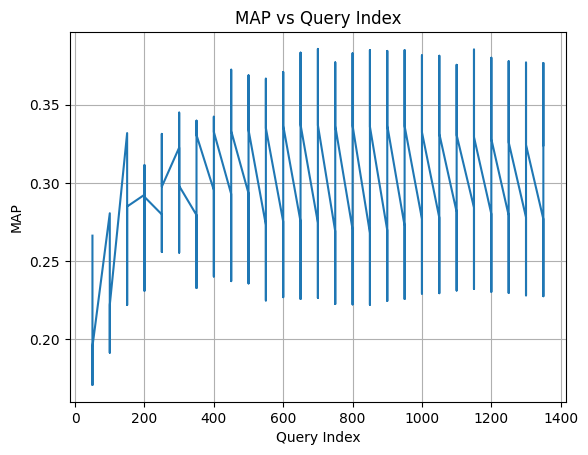

The i value with the maximum MAPMini: 700


In [ ]:
 # Plotting the line graph
plt.plot(query_indices, map_values)
plt.xlabel('Query Index')
plt.ylabel('MAP')
plt.title('MAP vs Query Index')
plt.grid(True)
plt.show()

# Find the maximum MAPMini value and its index
max_map_value = max(map_values)
max_map_index = query_indices[map_values.index(max_map_value)]

# Print the i value with the maximum MAPMini
print(f"The i value with the maximum MAPMini: {max_map_index}")